In [10]:
import os
import pandas as pd
import numpy as np

result_dir = './results/'
data_dir_1='../KantarData/'
data_dir = '../FullKantarData/'
figure_dir = "./figures/"
os.listdir(data_dir)

['Datos_2022.csv']

In [3]:
year=2022


In [19]:
read_able_columns = pd.read_excel(data_dir_1+'Explicacion_VariablesV3.xlsx', engine='openpyxl')


In [20]:
# remove culumns that are not needed
# TODO - put to other worksheets or something
# TODO -CodIndividuo should go to shops

def get_name(year,state,interval):
    return f'{year}_{state}_{interval[0]}-{interval[1]}.dta'

#codevf vs codproducto??
product_attributes=['CodProducto','CodigoBarras','CodVF', 'VF', 'SA7_BPL', 'SA4_Fabricante', 'SA3_Marca',       'SA2_Submarca',
       'X102_Aditivos', 'X108_Usuario', 'X109_Estado', 'X112_Niv_Calorias',
       'X124_Estilo', 'X127_Tipo_Bañado_Choc', 'X129_Tipo_Pasteleria',
       'X135_Uso', 'X143_Tipo_Corte', 'X163_Info_Cafeina',
       'X167_Grado_Curacion', 'X169_Cont_Materia_Grasa', 'X174_Despiece.Corte',
       'X182_Tipo_Queso', 'X188_Tipo_Pan', 'X189_Tipo_Viena',
       'X206_Tipo_Pescado', 'X230_Niv_Concentracion',
       'X314_Tipo_Cena.Entrante', 'X315_Tipo_Carne', 'X323_Tipo_Sazonamiento',
       'X328_Tipo_Aceite', 'X329_Pureness_Niveau', 'X360_Tipo_Verdura',
       'X366_Tipo_Postre', 'X383_Tipo_Yogurt', 'X384_Tipo_Cena',
       'X489_Como_Compro.', 'X490_Fresca.Congelada', 'X491_Presentacion',
       'X497_Tipo_Queso', 'X498_Marcas_Queso', 'X500_Tipo_Embutido',
       'X514_Tipo_Carne', 'X527_Tipo_Cafe', 'X529_Tipo_Producto',
       'X531_Info_Biologica', 'X558_Variedad_Queso', 'X571_Peso_Bebe',
       'X674_Tipo_Helado', 'X901_Localizacion', 'X902_Tipo_Producto',
       'X903_Envase', 'X904_Variedad.Sabor', 'X5_Num_Tot_Unidades',
       'X18_Num_Tot_Paquetes.Botes', 'X66_Preferred_Unit_Measure',]

purchase_attributes=['idCompra', 'CodPanelista','CodigoBarras', 'CodProducto','FechaCesta',	'PrecioCompra', 'Cantidad', 'Precio', 'CodLugarCompra','CodIndividuo','TipoMaquina', 'Promo_Folleto', 'Promo_Envase', 'Promo_TPR','promo']

shop_attributes=['CodLugarCompra','Lugar_Compra','Canal','CodIndividuo']


customer_attributes=['CodPanelista', 'CC_AA', 'Edad_Ama', 'NF', 'Numero_Gatos','Numero_Perros', 'Presencia_Niños', 'CodIMC', 'IMC', 'Ponderacion','Ciclo_Vida', 'Clase_EGM', 'Clase_Social', 'Habitat_Metropolitano',
       'Habitat_Municipal_Std', 'Inmigrante', 'Provincia', 'Region',]

tables={'customers': customer_attributes,'purchases':purchase_attributes,'products': product_attributes,'shops':shop_attributes }

In [21]:
# define mapping of types
type_dict = dict(zip(read_able_columns['Variable'].str.strip(), read_able_columns['Tipo Variable'].str.strip()))
type_translation = {'ID': 'int64', 'Fecha': 'datetime', 'Numérica': 'int64', 'Categórica': 'category',
                    'Dicotómica': 'bool'}
type_dict_new = {k: type_translation[v] for k, v in type_dict.items()}
type_dict_new = {('X' + k if k[0].isdigit() else k): v for k, v in type_dict_new.items()}
type_dict_new['CodigoBarras'] = 'str'
# TODO categorical vs int vs string...
# TODO check why it is needed , leave as categorical now..
type_dict_new['Presencia_Niños'] = 'category'
# when reading, should be given... 
del type_dict_new['FechaCesta']
# because stata cannot handle too many categories with long names:
for cn in product_attributes:
    if type_dict_new[cn] == 'category':
        type_dict_new[cn] = 'str'

In [22]:
# load data

source_df_test=pd.read_csv(data_dir+f'Datos_{year}.csv',#nrows=1000,
                           encoding = "ISO-8859-1", delimiter=";" ,on_bad_lines='skip', parse_dates=['FechaCesta'])

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/1070563730.py:3: DtypeWarning: Columns (28,42,45,51) have mixed types. Specify dtype option on import or set low_memory=False.
  source_df_test=pd.read_csv(data_dir+f'Datos_{year}.csv',#nrows=1000,


In [23]:
# transform 
source_df_test['Promo_Envase'] = source_df_test['Promo_Envase'].map({'No': False, 'Si': True})
source_df_test['Promo_Folleto'] = source_df_test['Promo_Folleto'].map({'No': False, 'Si': True})
source_df_test['Promo_TPR'] = source_df_test['Promo_TPR'].map({'No': False, 'Si': True})
source_df_test = source_df_test.astype(type_dict_new)

source_df_test['promo'] = np.where(
    source_df_test['Promo_Folleto'] | source_df_test['Promo_Envase'] | source_df_test['Promo_TPR'], True, False)
source_df_test['promo'].value_counts()


promo
False    6908404
True      675753
Name: count, dtype: int64

In [25]:

def general_model(df):
    if df.shape[0]>30:
            # for throwing out outliers iteratively if we like, to have a better regression  
            cleaning_rounds=1
            Y = np.array(df['price_per_unit'])
            X = np.array(df['t'])
            #flag=np.zeros(y.size)
            idx=df[['price_per_unit']].index.copy()
            x=X.copy()
            y=Y.copy()
            print(x)
            for i in range(cleaning_rounds):
                p = np.polyfit(x, y, deg=5)
                ps = np.polyval(p, x)
                diff = abs(y-ps)
                std=np.std(diff)
                mean=np.mean(diff)
                good =  abs(diff-mean)/std < 3 
                #good = abs(y - ps) < 1  # Here we will only remove positive outliers
                    
                x_bad, y_bad = x[~good], y[~good]
                x, y = x[good], y[good]
        
           
        
                if (~good).sum() == 0:
                    break
            ps = np.polyval(p, X)
            diff = abs(Y-ps)
            std=np.std(diff)
            mean=np.mean(diff)
            z= abs(diff-mean)/std
            good =  z < 3 
            flag = np.logical_not(good)
          
            ret= pd.DataFrame(index=idx, data=list(zip(ps, z,flag)), columns=['1','2','3'])
    else:
        Y = np.array(df['price_per_unit'])
        #flag=np.zeros(y.size)
        idx=df[['price_per_unit']].index.copy()
        y=Y.copy()
    
        std=np.std(Y)
        mean=np.mean(Y)
        ps = np.full(y.shape, mean)
    
        z= abs(Y-mean)/std
        good =  z < 3 
        flag = np.logical_not(good)
      
        ret= pd.DataFrame(index=idx, data=list(zip(ps, z,flag)), columns=['1','2','3'])


    return ret


odf1 = source_df_test.copy()


odf1['t'] = odf1['FechaCesta'].astype('datetime64[ns]').dt.dayofyear
# calculate price per unit of sales
odf1['price_per_unit']= odf1['Precio']/odf1['Cantidad']

x=  odf1.groupby(['CodProducto'])[['t', 'price_per_unit']].apply(general_model)
     
x1 = x.reset_index().set_index('level_1').drop(['CodProducto'], axis=1)
odf1[['predicted', 'z', 'outlier']] = x1


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 329 356 364 351 340 353  45 364 338 351 357 344  32  12 356 344 328
 361 326 365 364 357 330 326 354 365 361 349 349 326 327 356  29  40  25
  10 341   5 338 332  11 357 339 354  35]
[357 357 349 185 119 153 255 134 178  55  25 123  76 307 343 277 152 119
 208 306 137 348  82 115  34 244 321 333  90 155 258  42  24 294 364 302
 146  62 246 314  94 325 330  69 255 173 231 195 101 276   5 314 204  56
 185 153 185  89 234 358 346 354]
[243 281 241 162 262 290  32 143 234 264  38  22  73 362  27  88  14  18
  32  84 249 346 264 258 299 237 234 312 335 284 241 290 255 327 293 138
 277 290 264 347  64  66  69  29 273 298 252 223 306 290 299 262 258 273
 131 231 347  49 174 126 306 262 251 312 291  28 316 194 346 103 272 286
 268 313 351 358 279 300 279 365 304 356 314 350 312  83 126  67 106 316
 302 286 281 154 279 258 280 359  28 159 134 176 315  40 270 136 112 216
  47 228 362 354  10 354 321 278 276 298 257 157 343 181 226 178 213 229
 337 288 252 147 180 175 257  20  90  28 335 220

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[273  22 330 312 255 355 241 183 176  70  29  63 113 126  45  77   6 103
  93  49  56 132  70 309  61  94 147  29 214 168 330 110 116 213  24 136
 122  42 290 199 164 351 182 140 266 224 158  26 202 133 276 325  17  68
 147  74 103  87  94  92 158  80 183  81]
[329  39 203 216 246 287  26  91 315 226 348 343 271 147 262 156 227 354
  20  21 187  73  75 328 333 308 152 136  13  66 269 350 215 348  95 145
 220 105 351  36  66 122  42]
[ 10 120 109 318 196 174 318 145  90 125  53 293  66 299 129  40  52  61
  64 297  88 347 346 325 147 162 133 140  71  77  43 346 318 209 263 162
  50 117 318 265  90 321  74 161  24 242 214 224  77  77 104 178 189  70
  63 150 109  80 319 243 124 119 102 362 144  61 127  82 147 194 168 162
 153 164 106 344 360 223 110  73 341 220  48 297 134 319 280  70  74  35
  54 123 365 160 298 284  99 178  50  75  62 136  49  42  61  25 162  61
  99 130 213 101 144  89 108 138 318 249 126  31 277   4  50 117  56 255
 127]
[341 325 249 312 264 251 265 346 293 343 267 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[296 259 165 165 346 163 333 314 288  80  85 308 111 339 334 187 161 127
  97 174 164 164 164 125  60 333 362 346 137 166 129 162 292 321 114 140
 286 115 140 115 154 356  71]
[ 38 277 351 147 239 176 183 306 242 176  28 334 295 178 119  12 249 343
 165 362 271 329 292 312 189 183 299 321 125 278 282 275 293 295 179 189
 192 197]
[243 336 236 290 316 288 314 126 255 353 260  71 263 309 345 334 239 246
 249 295 292 306 197 301 259 328 321 288  53  26 246 280 302 295 118 321
 179 160 163 295  35  74 322 330 342 136 322 284 307 173 293  36 147 208
 171  26 158 148 162 169 330 163 146 117  48 161 306 128 270]
[199 157 142 147 173 332 185 161 335 177 281 194  57 192 331 316 168 309
 225 305 255 344 151 122 204 295 129 281 219 183 141 288 338 274 351 323
 365 242 133 212 269 178 234 358 156 197  97 228  18  52  26 246 212 163
 141 165  28 193  28 157  45 206 267 176 127 363  33 223 205 153]
[321 318 281 357 338 331 348 203 191 326 354 325 185 365  70 357 221  47
  30  30  72  12  84  72  63 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 47 206 222 194 209 204 141 138 155  11  75 344  29 103  84 123  67 152
 299   3 330   6  97 172 117  54 144 138  83  53  34  94 322  88 138 192
  46 344 228 216 190 137 165 146   9 164 206  78   9  50 166 296  72 133
 154  21 290  33  95  13  46  52  92]
[126 254   3  62   9   7 215 293 231 275  81 257   4  95  64 147 354 283
 286 356 132 248 232 183 241 349 355 301  24 343 143 275 321 208 336 343
 273 165 186 246 303 274 155 148 237 287 347 267 271  63  88  31  57 262
 263  25 265  48 120 192  27  17 119  67  36 130  92 264 278 266  13 265
 339 239  83 276  47 111 355  69  60 224 152  63 177   9 287  43  18 335
 252 289 332 108 124 113 150 335 223 179  89 277 236 362 225 132 124 131
 266 362  52  11 119 185 351  40  90  71 330 318 328 183 179 344 295 152
 278 272 277  19 351  91 343  69 338 244 224 252 322 280 336 267 302 315
 342 190 287 209 175 169 354 165 146 170  65 309 294  73  69  60 182 148
 134  18 131   8 106 118 348  41 119 288 227 232 350 136 354 129 208 276
 119 235 229 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std


[128 263 198 251 142 232 114 252  19 145 124  69 119  78 159  59  44  25
 327 319 284 279 271 343 265 360 365 256 326 163  24 352 166 260  21 214
 297 231   8 126  72 358  11  18 276 207 326  36  20  20 208 221 287]
[342 232  78  26 301 101 296 222 197 267  93 218  86  22  59  39  55 360
  99 311 241 302 254 309 225 131 351 236 202 298 229 364  49  37 153  78
  13 114 345 220  37 291 179 219 261 253 122 211  94 226 212  45 120  66
 146 237  26 133 228  76 361 199  50 245 248 294  77 290  56 341  69 134
 171 265 174  24 298 225  43 251  80 306 286 300   5 325 253 302  21  35
 343  25  38  50 148  85 357  43 218  63  22 295 339 197 190 281 284 360
  92  31 118 302 125 211 155  70 270 257  40 306 179 128  56 344 243 288
 263  74  63 364 252  21 106 164  89 353 145 168 322 154 315  98 196  28
 174  69 189 293  10 266  49 203 357  35 169  40  12 344 199 328 239 312
 120  70  20  57 256  90 215 355 262 147 290 244 357  49 295  17 267 180
 243  37 357 123  56 334 203 181 348  83  21 144 171  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[182 143 347  58 309  92 272 275 265 181 185 133 176 339 276  45 132 190
 114 268 262  92  70  20 365  80  23  88  24  11 126 171 279  41 269  45]
[132  49  77 109 108  96 230  14 239  89  99 112  95  36  32  47 251  71
  48  42  39  31  11  53 112 132 113  54 141 127 115 100  97  36  56  33
  35 139  94 280  55]
[124 241  23  42  83 112  85 156 354  97 113  81 140 361 143  45 238  37
 293 153 344 298 175 160  59  89 246 111  97  36 179 290 250 160 300 290
  36 339 243   7]
[187 199 103   3  28 148 235 231 190  12 190  84 112 257 222   3  21 257
 115 229 309  67 260 112 286 343 185 286 248  94  83 281 183  18 187 204
 213 228   1 358 296  13  20   7  27 293 304]
[115  40 364  13 264  12 339  54 315 260 308 313 290 346  42  20 358 306
 344 246   7 271 354 209 343 217  25  31 224 311 269 353 318 276 283 325
 332 305  43 339 256 192   5 260 277 249  22 285 194 118 278  20 349  48]
[137  59  41 126 265 122 247 245 243 116 137 147 248  59 337  96 209  10
 183  46 101  82  70 235 221 242 214

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[313 251 120 365 198 168 106 245 349 348  70  49 364  50 332 249 363 364
  19 210 153  42 279  12 327  91 357  48 137 311 318 301 208 130 120 122
 325 263 330  49 187 279 239]
[196 316 339 259 273  78 204 229 339 301 181 211 260 210 351 232 251 353
 140 111 249  83 157 217 356 176  67 281 357 168 292 147 330  49 304 148
 138 246 171 204 167 155 158 147 270 101  16  89 316 274 336 223]
[266 123  62  25  25 116  60 103  92  27 211 183 355 113  10 225 291 270
  21 351 208 190   7  17 171 354 252 336   5 218  60  73  78 119 133  20
 108  25  10  56  63  67 250  99 114  84 304 104 190 211 205 145  63 238
 353 335 325 335  90]
[304 184 218 253  14 102  88 230   8  27 363 234 337  63 277 291 204 244
  42   3 133  95 236 257 202  77  98 314 251  95 141 226 136 129  43 176
 161 267]
[ 75 199 106 272  51 245 239  36  29 156 308 152 250  15  50 120 323  78
 232 351 297 277  27  75 314 363 361 169 311 309 311 103 122 155  92 302
 345 183 317 147  71  22 309  73 219 311 254 200 256  14 316 130 309 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[172 190 110 299  34 153  41 104 274 174 361 134 310 207 308  83 113 193
  78 195 274 111  49 127  57  85  66  78 125 357  17 219 119  77 306  74
 189 174 195 181 104  73  67  84 357  56  50  32]
[ 78 357 349 349 118  76  90 129  29 294 209 329  14 119  35  71  57  50
  95 298 288 194 232  63 273 341 172 200 252 134 252 356 263 131 300 103
 199 111  99 288 134  21  32 174 146 279 299 149  64  60 348]
[120 167 337 288  85  82 206 319 315 174 203 332 255 322  14 259 276  54
 130 207 237 104 287  75  99 242 297 195  88 189 215 349  34  36 357 339
 307  74  87 241  88 337 209 172  32  43 256  22 235 315  71 236 262  94
  99 223 144 193  89 269 304  53 183   7  41 244 273 188 234 326 281 102
  68 165 118 111  31  89  50 243 298  47  14 129  75 136   3 151 144 306
 216 230 250 348 218 280 262 195 295 183 364 334 357 287 111 274 200  68
 234 329 315 336 266  77 154 299 196  56 277  76 141  83   3  26 143 225
 127  42  40 106  87 332  60  25  63  36  91  33  61 364 223 232 169 248
 234 102  87

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 28 141 203 324 306 253 197 199 169 248 230 238 253 231 182 162  86  17
 152 286   7 148 231 245 271 277  36 175 228 159 243 123 269 242 144 224
 118 175 229 130 343 173 135 118 104 309 119 231 155 304 137 145  28]
[363 173 257  98  87 346 106 338 351 281 183 322  46 274  19 111  67  29
 100 153 108  36 211 267 302 331 247 120 223 213 110 162 191  53  59 364
  71 296 192 158 134 149 270 321  71 307 242 293 112  35 254  79 198 246
 229 106 286 320 314  49 171 126  55 304 341 287  89   5 307 192 287 102
 168 150  76 171  76 117  88 348 250 332 307 290  95 343 186  92 215 133
 356 147 230 126 138 136  21 266 326 277 299 290   4 274 279  44 183  70
 152 127 295 364 217 266 248  43 309  71 344 288 256  36 362  92  50 106
 133 295 154 322  64 197 332 127 120  85 169 155 197 134 204 169 141 148
  11  25  99  28  71 112 153 302 292 132  84  27 264  53 170  90  39 164
  38 102 145  73  54 101  92 248 108  41 300 349 235  84 269  57 307  42
 243   8 106 211 182  60 252  70  99 166 143 304 308  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[110  73 133 120  64  92  57  42  77   8  29 151 113 180 176 125 142 160
 109  69  84  75  46 270 189 192 221 245  52  92  68 192  20 120   5 168
  12  52  31  82 214 117  38  73 109 185  88 229 206 209  94 258  62 231
 189 272 115 144 186 178  13  31  81 109]
[351 308 365 357 331  76 238 351 362 307 287 119 357 353 363 359 317  15
 358 361 343 309 305  30   5 169 350 350 346   5 356]
[241 304 181 ... 119  64 117]
[203 181 239 334 258 269 308 234 365 239 266 214 304 357 301 214 361 304
 300 292 295 185 319 336 341 241 215 346 328 292 294 300 299 286 292 300
 306 302 295 355 309 336 176 329 322 304 241 355 222 228 241 262 351 242
 297 291 300 314 263 236 278 278 348 327 306 318 339 353 207 325 344 269
 304 353 293 214 252 322 260 356 237 304 224 270 189 311 330 237 323 358
 223 194 189 291 302 311 192 363 257 176 250 362 316 281 270 330 175 341
 232 287 257 294 332 278 256 242 272 362 211 325 274 364 218 277 287 264
 364 356 257 336 362 193 199 220 199 280 266 238 357 350 259 315 286 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[354 100 239 208 341 323 186 186 136 174  59  49  91 248 275 155 108  63
 324 340 243 104  75  38  67  54 190 211 176 300 136 197]
[215 194 154  80  71 112 129 357  75 209 285 149  38  29 106  83  77 157
  78 236 295 338 110  92 102 126 128 131  68 131  82  87  67 211  81 121]
[176 157 214 299   7  87 151 178 311 346 286 270 293 213 218 218 140 120
 123 149 290 146 347   3 349  21 101 171  11 126 208 149 270 248  53 136
 299 157 312 244 270 267 117  63 294 262 301  67 287   7 333 302 353 292
 356 313 202 160  22 279 223 237 238  43 190  61 262 304 272 242 206 235
 182 234 179 341 300 332 236 308 300 132 315 335 274 243 262 339 244 237
 315  78 265 311 124  50  96 239 308 174 290 103 299 115 157 196 270 226
  88 355 286  63  99 127  59  70 298 176 119  49 104  94  85  95  78  89
  98  69  91 203  52  50   5 108 248 199 212  83 242 171 212 115 143 185
 146  43 302 260 194 125 172 136 181 335  64 190 237 351 337 306 146  20]
[151  81 120 214 258 195 224 159  56 199  34 288 267  65 194 100

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 41  14 147 319  17  88 232 301 133  99 284 155 357 309  77 322 261 325
 165 239 134 104 132 323 250 341 318 273 263 363 110 350 195 339  17 108
 105 293 302 300 151 326  80 323 115  42  35 263 256  76 230 236 362 338
  70  42 116 356  36 271  32 248 326 217 225 333 350 187 110 363  77 274
 112  50  21  40  89  17  76 117 112 184  37 308  10 267 273 270 343 357
 361 257 101 245]
[339 320 201 269 210 222 131 166 343 140  87 204 248 143  69  65 253 255
 206 253  92 218 206 139  18  14  70 136 204 208 185 132 164 204 222 211
 134 206 138 155 264 137 131 322 341 132  58 207  80  18 190 264 132 140
 132  63  74]
[311 253 259 243 139 153  38 212 315  79 246  36  77  76 333  50 195  91
  32 260  78  77 181  84 232 196  60  84 247  92  28  29 191  78   7  77
 338 165 188  90 124 308  75 144  38  84 160  50  90  28  64  43  78 132
  64  31  80  83 241  78 136  78 157 152  89 130  50 252  86 171  76  99
 241]
[266 308 316 351 287 194  92  52 269 120  34  98  28  84 362   4 199 230
 120 294  21 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[162  29 176 288  50  43 183 169   8  85 274 364 235 306 312 356 298 319
 213 211 130 278  91 122 127  48 178 141  28 199 243 351 148 267 288 102
  92  94  84 309 196  12 262 213 295 339 309  90  45 195  13   8  66 123
 171  59   3 102 151 187 180 110  31 158  96 130 136  25 141  38 116 288
 239 235 231 201 210 224 203 220]
[322 346 153 313 234 320 118 327 348  80  24 178 237 207 275   5 272 178
 216 265 320 307 276  91 268 162 144 129 124 262 274 152 306 357  92  88
 363 152 362 124  18 222  11  87 106 144 162 154 267 166 347 129 307 106
   4  88 172  47 298 246 168 262 103 252 321 222 180 141 179 264 249 225
 108  99  92 146 241 187 153 332 267 205 303 164 283 245 348 320 115 255
  33  82 350 301 245 306 241 108  47  54  19  95 209 242 294 241 126 140
 270 207 269 221 347 321 269 294 260 315 272 357 279 344 306 350 327  88
 271 130 125 150  82 263 330 195 204 127 283 361 273 288 270  15 345 113
  22  71 148 236  99  53 188 304  78 106 261 350 335 288 321 349 234 361
 115 301 172 111 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[294 192 185  70 178  22 185 300 236 178 182 297 175 317  31 315 330  15
  77  32  26 223 299 299 194 282 326 126 140  39 163  88 156 363 261 227
  60 355 292  29 343 117   8 249 338 301  97  73 297 276 270  54 193 318
  17 323 104 154  22   7 273 235 259 311 351 214 182 123 332 337  52  14
  97  81  12 362 149 248 270 341  86  21  99 129 344 336 159 301]
[ 28 151 133 101 283 291  74  53 130  97 165 292   9 297 295 306 160 147
 140 157  84  88  21 308 126  63 103  43 288  98 271  76  75   4  62  71
  68 273]
[302 125 141 281 234 300 135 234 141 274 304 358 249 243 145  71 106  67
  85  91 283 321 251  85 276 305 295  83  89  79 320 123 137 157 152 109
 303 100 136   6 211 291 358 123 272 207 322  76 127 330  29 117 295 327
 131 220 134 134 291  95  88  91 253]
[148 243 293 101 119  25 295 174 333 106 363 205 239 235 204 190 141 165
 210 166 224 243  73  10 125 252 329 199 173  91 172 201 258 272 225 146
 349 154 297 330  75 334 246 182 131  35 256 265 307 169 220 274 278 174
 363 267 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 91  61   3   7  34   3 164 192  68  60  58 160  32  64 181 337 194 253
 288 271  78 351 328 204 320 351 335  97 355 333 307 178  48 133 358   5
  31  52 146  21 357  92  19 214  80  69 134  56 348 328   7  63 217  57
 357  84  64 119  22 246 316 309  15  29  54  71 148  31 169 354  21  14
 139 123  43 350 326 140 363 301  98  17  25  94   5 248 186 269 196 125
  67 175 232 295 292  99 299 329  84 237  43 162 108 175 153  66 337 283
  28 336  25 113 154  21 316   8   4   4  91  12  35 355  11 283 365 262
  24  21  77  89 119  58  52  49 114  34 174 115  77  80 112   3  43  63
  52  22  50  35 159 274 262 179 286  14  38  28  41 211  56   4   5  32
 295 362]
[314 348  71  23  23  45 208   5 218 351   8 148  38 143  78 154  15 146
  80  53  18 232  81  99 213 104 364 136 339  12  92 341 362 130  77 211
 127  82  10 160 358 337 201 220 144 161 215 336 349  71 224 162 343 207
 169 110 223 133 221 210 350 339 353  42 222  90 220 120 358 148]


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[293 354   5  32 154 281 147  52 201  34  14  47  46 168 319 116 179 339
 283 298 139  80 143 189 295  49 286  12  28 271 242  76 300 343 307 294
  69 335 118 125 265 286  97 195 139 174 146  48 132  55 181 223 363 167
 350 230 160  62  90  23 245 216 328 237 314 322 280   5 126 256]
[332 228 319 126  16 106 106  84  56  92  11  17 113 165  46  11  42  28
  99 110  50 140  66 150 151 148  67 108  54  25 126 152 129  75  81  33
  91 144 102  56 136  94 123 168 166 125 134  74  76  84  77  68  69  98
 138 109 167  27  38  70  88 139  82 101 153 155 186 252  88 112 238  90
 265 286  70  59  63  62  94  99  15 143  67 108 162 147 108  70 259 266
  63 230  98  89 104 111  14  69  78   5  10  23 244  27  39]
[269 334 318  71   9  92 338 117 315 287 182  83 262 194 322 175 127 162
 140 281  24 134 329 252 283 265  12 311 148 260 123 332 133   3 177 182
  68 113  75  80 134 188 257]
[354 318 311 363 342  95 287 259  74  40  61  99 306 336 223 178 183 315
  50 252 364 215 347 298 223 314 259 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 71 216 195 290 190 272 234 292 176 293 190 297 274 207 211 146 327 278
  78 255 284  77 315 295 363   7 300 287 262 304 255 108 275 191 290 333
 163  69  75  89  42  21  35  13 209  77 164 327 328 361 315 309 333 322
  42 133 169 298 266 221 108 180  41  14 286  61 322 291 329 143  97  52
  85  26  46  67 171 349 215 119 116 148 168 273 130 339  74 157 200 192
 301 279 152  31  80 355 193 295 126 263  94 236 185 311 222 361 268 283
 295  15 225 176 190  99 288  77 179 306  81 318  85 203  41 358 147 132
 115 136 218 326 173  96 150  14 183  48 323 193 128 204 166 306 251 178
  31]
[297 203 109 134 260  36  64 132 311 175 133 279 361 139 151 144  38 278
 237  26 360 360 207 116 228  84 260  78 132  73  10 104 127 213 126  64
 130 354 206]
[320 201 136 115  87 180 244 232 206 211  97  73 116  50 260 336 356  44
 184 218  56  72 355 305  10  46  76 119 211 189 277 197]
[358  88 125 353 317  27  89 151 137  85 349 131  96 116 164 129  47 145
  81 173  76 286 155  29 102  34 244 288 350  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245 119 313  81  84 162 338 328 328 336   7 221 316 331 154 145 286 224
 334  45  66  38 113  20 172  91  50 334  45  40 212 112 337 146 276 147]
[ 97 335 296 124 101 344 103 127 293  97 335 294 337 295 335  97 104  99
 339 339 106 355 125  97 113 297  97  97 213 335 335 223 111 295 104 230
 351 108  97  96 102 213  97  97  99 106 339 101 106 101  98 104 362  98]
[ 45  15  99 295 112 155 106 127 120 338 294 101 350 337  35  98 144 111
 335 358 299 316 309 295  97 309 304 302 108   8 299 295 301 337 316 343
 309 330  96 342 100  98 349 136  99 185 125 336 330 297 102 103 103  97
 297 309 355 340 353  47  98  17 327  14 293  97 353 309  28 353 341  33
  97  99 101 297  99 118  20 356 114 100  99 325  97 342   4 101  98 356
  99]
[ 25  28 301 154 109 284 355 281  36  69  25   5 329  49 118 301 299 120
 329  20  54 346  55 253 313 154   5 213 152  41  18 161 147 230  27   7
  25 197  50 235 218  33]
[246  10 358  50  92 343 350  66  22 281 197 274 231 243 180 346 301 120
 309 113 149 313 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[209  49 159  34  17 252 133 341 348 277 187 339 346 223 209 258 353  57
 240 321 256  78 364 344 134   8 337 147 284 265 243 103 129 160 147 267
 224 157  63 160 298 334 186 194 300  34 333  27  15  50 101  49 260 250
  60 150 165 340 104  55 329 192 176  28 125 168  67  90 171 153  42 197
 248 216 174  68 336 229 179 295  66 130 332  88  35 179 259 153 123 357
  67 139 301 202 245 327 136  13  48 109]
[228 161 223 165 232  68 351 329 215 179 299 224  69 176 209  11 325 190
 190 299 281 291 298 273 277 179  21 364  90  55 332  24 200  42 355 246
  36 112 330 169 270  33 326 284 272 333 266 211 330  41 222 269  70 152
  27  39  81  74  41 325  12 232 304  67  15 316  34 150  71 319 300  63
 327 318 312 223  72 329 211  49 178 277 356 290 132]
[191 275 315 261 275 196 205 225 315 281 208  39 187 245 161 351 279 285
 318 356 334 166 242 350 290 357 328  80 334 287 279 304 105 276 168 314
 203 312]
[250 327  25 287 161  67 138  11  63 122  69  36 308 199 339 307 316 312
 266 311 314 315  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[322 246 358 354 237 263 348 321 291 199 133 273 147 348 301 238 289 274
 339  50  28  33 206 315 335 328  99 138 142 162  71 256 343 247 118  80
 100 283 155 357 107  82  19  32 321 305   4 239 132  37  50  23  64 210
 223  42  54 283  80 167 275 243 107 314  23  59 342  34 227 247 305 250]
[ 41  43 190  27  12 189  35  55 101  24 118   3  10   8  53 222  34  13
  52  21  11  66   4  32 293  17  22  29  20  42 168  14  18  39  25  26
  40  36  38   7  33  70  15  31  54   5  19  28]
[111 163 146 246 130 124  11 167  73  67 112 275 136 123 101 131  84  89
  68  88  18  24 168 103 132  10 118 109 239 154 136  95 125  45  84  11
  52  91  19  76 272 102  28  97  98 117 160  19 120]
[176 194 257  46 338 309  21  22  61  63  45 312  36 337 313 193 241 276
 211  94 312 314 111  93 210 166 189 181 195 174 270  95 277 255]
[248  88  40 270 220 181 178 171 225 223 218 217  85 312 346 348 210  88
 236 244 213 218 289 264 270 198 295 245  91  28  33 193 145 208 279 335
 252 249 348 309  50 218  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[321 236 317 309 275 298  78 305 141 101 130 332  65 361 283  95 361 155
 325 321 346  65 143 282 318 320 269 126  11  84  23 345  64  23 101 134
   3 316 104 182  17   3  92   6  99 292 144 352  63 280  70 258]
[328 172  48  64 214 162 214  11  46 200  25  18  32  19 314 203 266 147
  46 353  17 127 147  17 169 260 188 364  78 265  36  39  25 162  62 193
 217  21 266  21 262   7]
[176  85 341 346  27 114  95 130  48  46 202 108 112   3  46  38 109 129
  52 144  31  10 221  46 160   4  11  40  96 220 217 182  57  33 146]
[295 330 319  66  76 363 200 278 115 279 327   4 134 208  67  19  88 271
 255 146 129 264 126 362 340 346 305  17  70  84  10 229 262 274 336 350
   4  85  43 236 263 259 246 265 263 273 246 251 349 333 276 338 302 321
 355 291 248 349 279 336 317 269 349 302 247 362 299 267 293 281 313 325
 325 341 356 261 132 351 150 246  61 128 263 255 272  68 260 287  19 266
 137  20]
[339 299  63 288 148  85 278   5  26 197  43 120 265 125 157 360 350  71
  81 246 119 159 185 196 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[347  88 356 318  92 239 112 252 220 150  49  10 126 119  35 339 144 182
 245 259 350  56 204 189  63  73  47 309  22 210 155 191  57 224 361 354
  88  57]
[169  40  52 236 304  28 288 194 146  17  68 244 133  89 112  91 290 341
 162 295  12 271  91  68  92  80 292  95  28  29 173]
[204 229  85  78 309  25  25 210 215  15 159  36  59 111 298 116 347  96
 143  20 175 228  76 316 203 126  68 102 171  87 254  10 362 108 135 112
 100  51 100 178 116  34 311  16  77 343 241  98 173  81  99 137 120 169
 237]
[ 39  35 281 329 301 133 161 315 327  14 231  28  59 196 175 273 194 319
 304 280 245 189 336 246 237 331 237 185 330 281 332 192 326 271  82 308
  76 355 315 169 287 248 148 186 179 248 192 272 164 297 322  44 326  32
 195  56  69  75 140 133  65 266  88 342 246  70 325 228  32  34 341  82
 270  57 146  86 248 155  77 336  48 125  41 174 182  39  82  63 133  90
 104  97  51]
[129 273 263  29 236 142 109 307  54  29  83 139  96 204 290  33  76  95
 252  20  82   3  39 189 112 330 209  49

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[330 284 316 258 350  78 294 160  60  17 213   3 277 232 343 294 211 331
 145 232 276 365 365 103 178 293 224 359  76 105 290 212]
[ 83 120 154 252  64 351 104 260 300  41  14 319  55  91  47 109  77 333
 166 113  20  99 144  82  70 161 111  59  33 300  42 241 270 126 178 272
  49 244 162 304  79 364 118 179  25  96 342 290  20  68  57 133 218 311
 157  77 365  67  61 171  53  64 115 136  94  97 168 350 110 286 281 153
 102 238  73 182 147 231 332 308   7 301]
[121 274  31  81 228 164 200 111 202  47 344  99 288 331 147  64  13 343
 347 293  98 207 315  14 294 283 308  92  57  22 113   5  50 239 294 199
 133 162  28 230   3 112  91 356 324   8  71 244 109  47  36  95 217  92
 355  18 101  35 302 103 204  99 204 218 148  45]
[ 18 143  90 246  88 255 232  76  93 291 195 362 155  35 140 299 244 265
 204 238 322 283 337 265 246 169 141   4 169 339 247 300  81  68 256  38
 215  29  22 147 225 305 341  52  40 145  29 148 242 201 344 162 271  63
  87 244 152   6  21 271  50 249 298  81 235 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[132 144 161 143  75 139  30  17  71 181  57 159  69  33 237  76 166 174
 148 136 108   8 153 139 122  80  13  42  71  32   4  26  60 166  50  29
  43  64  22  36 118 109  53  11]
[148 312   3 274 291 254  53 292  48 345 271 183 158 278 263 333 355  77
 264 335 166 234 109  57  45  28  50  61  32 131  78 141   3]
[214 231 129 ... 281 320 318]
[195 199 309  29  78 308 134  15  64 322 356 256 250   7  77  71 321 260
 317 263 361 352 101 265 129 258 300 156 184 350   9  79 319  72 351  92
 331 260 322 186  88  71 277 140 235  46 123 298   4 362 161  21  95 273
 260 363 190 360 298 187 327 316 131  61 197 351 323   7 103 322 344 176
 284 351 352  91 175 190  88 180 193 347  54   4 229 217 112 287 337 193
 273 153 268 276 259 178  87 136 190  77   3 253 364 229 253 316 333 333
  81 291  14 329  77   8  78 144 274  69 148 316 248  15 246  91 139  71
   7 258  88  62  11 257 144  13  60  91  13  74  89  21 216 291 354  12
 272  42 131 136  30  64  43  78  34 357 256  20  21 203  21 341 218 12

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 98   8   5  10  35 153 162 138   5 101  10 108 127   8  74   5 286  10
  98 193   8 248   5 132  29   7 324 181 167 160   5 123  17  10  79 100
 177  16 208  16 183 288   7 128   8 162   5 118 309  59 165   7   8   7
  92  76  55  35   5   7 161  78  17  70 119 155 161  78 141   5   8  91
 182   7 102 181   8   7   9   8 160   5 161  32 147   8 148   7  55   5
  67   7   5 286  50   7 143   8 148 148 162  77   5   5  86  20 126 119
 133 153 146  92   8   8 155  28   9 160   8  78   8  75   5 138   5   5
 160   7  54  56  94 139  73  84  34  55   5   8  15   5 160   7 155 185
   7 160   5   5  20   7   7  24 160  83  41  22  63  56   7   8   8   7
  36 134   8 162 162 157   5   7 161   5   8 162 220   9 170   5   5   5
 172  70   7 286 202 131   5  95   5 160 119  95 130   5   5 272  15  69
  73   7   8   7  78 148 154  17]
[265 244   4 186 185 216 256 360  71 287 186 355 323  36 237  43 176 302
 302  15  70  54 216 216 128 216 119 288 332 234 272 348 233  84 188  64
  55 165 274 190 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[353 126 157  50 327 113 238 336   5 133  35 355 222 351 315 232 252 280
 182  75  42  91  41  82 347 231 341 213 319 274  33]
[143 250 344  23   9 321 151 110 281 188 290 100 334 139  22 313 106  96
 166  34 257  57 293 326 152 250 152   4  56 268  97  66 106 199 218 146
 139 242  54 195 356  17 240 260 279 118 312 256  74 168 151 124 220 325
 115 302  77  54 211 161 209 249  94 311 158 214  59   3  31 277 186  54
 199 265 229 216 330 108  74  74 192  42  85 190 195 267  85 124 118 183
 109 262  97 168  53 152 151  84  58 152 180  71  34 131 204 101 234]
[295  98  85 155  71 274 344  42  82 228 127  78  64 290 245 134 112 309
  22 176 260 169 274 148 239 281  36 103 337 190 203 323 211 267 232 351
 119 329   7  50 197  29 316 218  56 364  92 361 232  75 266  39  13  49
 204 330 160  22  99 141 211  81  49  62  96 117 125 314 237 106 174 265
 165 312  90 277 109  13  46 115 322 127  17 260  61 168]
[ 11 284 260 295 302 196 214  46  14  89  46  62 102 246 346 117 137 269
 348 348  35  4

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[185 188 337 359 320 171 144  25 329  35 117 336 249  17 304 269  68 298
 143 186 217 109 319 277 141 333  82 133 347 171 150 262 363 114  61 291
  12 312 203 220  95 235 339 165  75  89 102  40 197  68 295 307 195 278
 132 132 175 148  14 322  49 326  77 287 147 157 140  90]
[ 55 280  60 239 326  66  50 295 321 361 348 312 336 286 204 358 133  38
  96 173 125 146  52  67 115  70 192  21 160  25 283 341 311 257 210 311
 271  68 132  32  32 172  98  82 187 234 250 250 250 145 269 337 248  32
  84 258 147 155  21 192 308 272 115 253  69  42   7 143 119  75 224 168
  91 248 249 325 327  46 348 237 181 288 323  76 330 217 164  13 134 194
 108  39  71 152 319  73 339 348  45 115 234  60  45 203  31 276 213 144
  59  28  76  77 102  32 126 131 153 248 154 129 189 145  14  64 127  64
  22 328  52  94 308 197 347  60]
[111 111 246 224 170 239 253 233 246 220 239 293 119  67 354 103 295 360
 345  26  27 217 309  81 342 235  15 364 287 352 155  58 293 221 107 111
  30 134  22 235 241 364 229 301

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 89 269 306 287 354 158 181  56  75 318 343  42 250 235 146  19 109 127
 330 214 365 245 271 133 343 335 289 315  76  68  81 173 168 208 348 127
 164 322 167 280 259 166 361 222 321 170 330  24 153 248 195 263 344 175
 139 320 238 147  14 315  73 244 309 339 269 157 297  19  38 214  82 166
 264 122   7 284 258 157  19 352 241  61   7 151 192 245 177 228 310 271
 157 214 169  78 281 337 365 197  94 335 208 245 339 272 160 181  41 258
 340 307 216  81 303 205 260  13  45  75  66   7  32 270 336 162 295  64
 320  77 291 146  73  22   7 278 336 357  66  20 290 315 318 113  90 108
  60 126 113  76  91 192 126  70  50 157  66 328  75 109  78 240  67 152
 328  57]
[ 97 148  85  55 271  52 319 257  48 189 216 280 291 161  17 266 124  75
 245  71 218  73  95 159 313 185 261 313 255 327 361 103 276   8 338  25
 337 242 180  13  19 228  80 327  56 357 313  11 159 349 151 301 215  37
 315 210  64 118  70 343 316  60 365 129 329 273  27   4  50  99 122  66
 344 271  73 349 349  48 274 336 238 185 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[145 126 138  40  41 186 155 300 120 146 290  61 286 157  85  73  36  32
  68  35  96 321 290 341 154  67 283 325 265 293  79 174 358 319 300 365
  18  34 276 328 164 157 148 169 162 309 134 353  48]
[363 315 267 233 228 115  18 319 145 154 295  57 133 169  44 223  26 271
  73 326 124 201  34 243  24 236 196 116 311 153 270  71  30 344 126 233
 310 221 275  71  43  42  29  36 298 196 277 360  64 193 273 210 315 252
 266 182 137 267 297 271  19 312  56 189 125  88 287 223 258  88  42 174
 364 264 257 242 159 208 272 332 147 171 162 277 308  69 281 302 339 228
 186 306 162 215 217   3 197 265 259  33 257 298 354 234 176 207 246 356
 154 161 263 358 309 328 269  91 292   3 300 224 363 246 306 210 306 277
 200  26 301 281 298  20 306 194 131 327 321   9 107 263 312  89  99 101
  88 204  33 223 280   8 244 332 293 269  41  40 343 273 315  53 132  69
  83  27 150 273 333 331 312 203 146 138 311  66  31  98 255 230 174 269
 322 109 332 187 289 298 357  95  77  47  49 320 195 293 269 181 259  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[189 207 276 258 288 293 192 328 181 196 325 255 349 339 124 312 354 297
 306 332 172 318 290 276 265 185   3 235 241 206 283 151 311 280 319 311
 323 335 281]
[185  59  90 147  24 130 213 324 265 265 144  11 302  69 292  28  57  18
  42  20 299  10 199 245 245  17 166   7 212 148  35 308  32 149 159 111
 181]
[237  68 242  88 152  95 341  91 318 362  28  71 156 356 315  52  47  17
  14 213 217  87 219 243 108  98 337 103   6  22 358 325 346 349  63 277
 348 320 302 316 306 337 341 362 270 322  16 103  21 212   7 239  80  15
 241 242  99  77  77  77  64  61  81 358 103 243 242 247  69  83 347]
[334  90 258  60  61 160 128  43 358 336 123 142 267 120  22  14 294 112
 247 281 173  60 356 112 307  20 354 230  61 337  80 288 267 184 157  18
 162  54 157  28  99 274  76 174 125 133  62 360 118  53 192  14 324]
[310 256 334 141 157 150 276 304 205 318 314 260  97  52 288  18 157 234
 304 313  81  39 327  64  33  54  26 250 244   3 108 199 360 284 341  75
 129 262 222 255 321 186 334 139 123 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[277 119 225 293 293 133 116 291 311 328  83 305  43  94  29  58 225 342
 122 105 188 159 148  55 266   9 242 312  78 114 253  13 335 179]
[ 20  40  67  57  90  17  33  47  23  54   4 257  45  38   4 227 243 210
  25  62 108  89  13  45  43  81  13  55  84  28 203 304  15 241 197  88
  56  26  28 290 115 157 148 165 108 241  57   5  47  56  42  19  90  34
  57 263  92 192  46 157]
[ 57 333 217 327 189 248  49 322 241 231 286 211  81 147   8 259 354 259
 147  42  95 316 340 197 211 295  14 336 355 328 344]
[148  43 132  77 148 176  30  45  84 127   8  42 147 133  53 141 141  31
  45  66 120  34  69 162  10 162 115 111 154  15  77  28  85 136  36  85
 161  57  47 106  46  40  94]
[215 295 148 139 158  43 137 242 172 197 277  91 153 207 326 192 320 223
 273 101 113 120 246 103 196 200 111 160 155 270 256  94 123 214 130  50
  55  52 229  95 115 236 363 211 166 125 341 109 164  47 283 204 238  42
 183 194 221 155  98 150 251 144 147 174 241 311 286 118 244 141 132 181
 284 244]
[ 69 138 20

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[164 273 270 273  31  81 333  77  90 262 217 112  54 246 134 141  63 315
 281  35 273 333 333  53 164  68  49 282 269 119  74  62 270  54 126 277
 126  35  42  53 269]
[  7 157 361 182 150  70  13 172 203 179  22  59  91  58  34  75  28 317
 347 198 329 101  94  42 364 132  53 185 124 145 160 158   7  50  72 112
 132  83   9 338 158 319 100 104  53]
[277 111  90 148   6   3 179  90 130 191 232 108 278 349 252 176 146  98
 133  38 115 361  95 147 327 180   5 175 352 161 156 250  81 343 255 122
 256  22 181 277 138 116 159 163 142   9 170 236 168 243 329 248 272 346
 231  46 276 160 330  41 136  50 258 103  46  73 160 119  93 353 300 321
 341 141  58 113 147 121 308 221 127 143 293 249 286 112 327 363 167   8
 178  21  57 320   7 281 276 199 171  78  46 125 167 111 159  36 143  12
  18 119 138  99  43 229 169  93 325 241 316 267 338 276  49 296  46  48
  87  66 123 239 269  17 131 285  29 307 139 309  22 176  97  84 168 112
  84 179 147 190 115  24  22  68 134 325 245 132 139  90  63 207

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[160  62 281 315 267 197 196 269 176 280 328 264 258 266 299 363 262 346
 278 117  24 265  50  29 221 143 185 165 267 245 192 336 262  61 248 280
 102 196 209 169  36 341 345 268 276 182 276 261 182 218 282 263 272 220
 242 247 281 201 246   9 276 267  28  26  57 194 308  19 245 239 259]
[235 196 175  45 141 119 137 269 248 319 213 197 145 195 129  57 183 242
 225  89 221 338 243 143  32 223 180 142 350 262 332 312 110 116 237 129
  92 283 323 194 141 221 181 178  83  40 349 133  48 113 137 201  92 159
 127 298 283 208  91 115 210]
[ 13 316 111 251 334  60 204 333 339 160 308 357 302 134 108  57  57 328
  90  95  84  88 162 306 302 360 262  50 365 252 118 254 192 267 207  11
 131  26  47 269 313   4  45 136 150  21 131 292 340 236 250  75 101  61
  33 264  10 208  54 215 241 220 339 103 284  19 248  80  49 278 297 325
 145  98 256 166 138 353  52 213  24 355  94 290 122 262 327 151 332 159
  66  40 273  59 255 320 318 124  12  38  82 360 143 222 112  38  99 164
 256  54 205  99 112 273

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std


[ 47 226  33 ...  91 286  27]
[115 269 277 108 252 293  87 288  75 345  36 354 354 356 363 154 334 109
  81  70 290 160 329  67 257 127 144 120 295 303 357 236 159 339 346 353
 362 325 356 336 329 354 119 269 276 256 335 130 134  91 119  62 308  98
 160 339 351 325  80 347 325 138 356 267 351 341 142 160 315 154 118 112
  77 357 281 364 259  39 362 350 329 140 362 260 110  71  84 351 267 260
 260 112 252 236 329 318 313 250 273 332 113 353 346 108  80 153 325 323
 243 361 339 134 102 131  49 132 109  57 351 337 330 344 361 155 351 319
 357 160]
[167 315 278 ...  11  18 341]
[287 182 229 213 276  75 118 353 262 318  45  42  54 252 238 292 144 189
 314  83  30 295 260  37 235 360 314 197 281 164 238 119 140   4 270 258
  14 339 359 362 291 173 269 340  83 132 228  63  48 357 134  79 356  70
  60 335 340 339   3 175  64  21 309 193  68  71 133 295 306 282 250 340
 164 172 192 190  13]
[ 14 344 358 ...  40 234  66]
[245 336  39 ... 310  74  32]
[ 29 214  25 ... 169  56  89]
[253 321  62  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[300 314 300 314 281 227 235 111 308 124  97 269 210 253 327  71 347 311
 224 286 147 138 337 323 157 266 145 346 202 351  19 134 120 328 351 225
 364 339 193  85  89 341 351  92 314 361 125 232 236 360  97 236 348 330
 122  74 295 349 361 334  47  74  47  29  84  50 287 151 162  92  74  15
  43  74  90 298  23  86 112 102 185 341  26 322 201 307  27 353 282 118
 321  35 110  64   5  13 349 126 342  26  62 168 113  68  68 261]
[196  32 287 162 276 286 283 325 341 269 185 275  49 248  74  36 292 233
   5  57 150 250  44  60  33 158 103 365 353  42  92 153 123 268 287 365
 246 330   3  12  69  48 348 316  80  74  62  85  74 133 157 278 279 239
  41 323  81 245]
[ 64 155  71 193 189 283 154  63 175 236 103 323 302 364 362 141 155 283
   5 304 283 360 110 101 303  45  71 129 322  18  15 292 354 213 273 291
 276 112 196 355 352 140  70  84 343 175 159  70 362 146 234  22]
[275 336 201  66 336 238 346  78 346 279 349 350 348 347 287 320 284 280
 276 318 300 322 277 195 334 330 274 364 352 28

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[334 286 361 101 330 334 173 130 177 131 158 144 309  94 140 229 131  98
  94  47 180  11 144  74  83 131 213  81  46 156  76 110 299 145 258  65
 256 229 353 346 362 339 176 274 302 259 264 304  62 248   7 119  89 182
 211 252 284 135 135 122  41 302 171 312 273 322 327 133 288 355  48 119
 126 143 131 175 192 144 293  87 136  13 192 241 333 292 176 273 353 115
 322 256 287  46 346 133 324 114 362  63   5  50 314 312 122 183 195 196
 186 175  61 185 356  83 307 106  12 244 360   3 242  57 120  66  22 213
  35 208 364 151 200  36 185 291 214  46 270 242 193 298  95 305 284 353
 307 200  32 339 137 109  81 172 277  10 249 107 319 326  74 166 207  60
 333  67 179 158 102 189 116 221  18 235 256 358  26 347 263 123  53 228
  67 131  88 232 327 231 150  36  68  57  77 264 107 130 351  29 270 231
  99 189  31 351 123  71 112 314  94 160 160 131 164 160  37  98  12 342
 188  49 160  64 105 348  67  49 260 138 177 363  15 165 293 299 361  20
 187]
[273 267 252 365 250  24  17 146  27  53 153 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 14  42 102 213 269 357  80 358 341 186 133 112 152 108  54 132 159  20
   4  43 258  31 302  54 357 337 343  50 334 288   4 365 340  91 364 348
 355 299 207  71 180 162  83  98 145 103   7 131  36 339 216 179 134  39]
[ 81  36  99 170   5 119 341 318 290 111  92 154  11 145 250  76  95 238
 173  32  38  47 179 126 117  53 171 157 183 358 280 219 104 156 157 153
 186 164 144 181 162 155 174 143 178 193 160 167  85 184 198 248 304 347
 163 131  61 146 295 348 349  35 218 148  63 353 178 165 295  71 358 126
  16  50 119 123 300 255 266 196 277 143 151  99 255  38  62 296  79  66
 274  15 267 155  21  57 260 286 168 253 186 357  73 240 103 243 140 228
  53 350 257 334 260  34  54   5  75  92 154  52  37  53  63  98  91 103
 109 176  88  77  24 161  81  33  42  52 101  94  62  73 171 112  95 146
  10  23  33  69  54  50  33]
[180  54 177 103  43 203 253 251 190 272 195 237 196 183 189 228 252 224
 269 283 281 245 263 248 222 178 257 180 286 194 199 355 241 294 239 360
 215 209 266 336 201

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[300 239 258 ...  15 260  69]
[239  41 281 225 216 190 200 281 328 262 345 209 361 336 330 357 339 292
 321 155 329 313  14 160  90 349  35 206  48 158 160 164 154 262   7 119
 360 124 138 340 255 106 147 159 127 308 362  55  27  13 304 298  83 332
 173 348 318 277 195  42 224 144  59 109  80 236 104  56 151 302  52 161
 119  61 106   5 350 260 148  13  73  48  41 147  52 204 227 184  91  20
  70 235 225 168 260 154 295  19 253 211  14  50 141   7  22 242 218 119
 113  92  36 203 249 274 106 147  29  57 365 288  43 182 162 127  99  77
 196 280 269 119  15]
[ 73 110 236 337 152 111 134  27  62 284  42  64  24 287 332  62 127  46
  18 125 220 246 227  52 138  80 109  77 344 162  50 215  93  75 122  59
  29  76 141 120  30  64 125  71 120 127 193 346]
[344 293 218  85 347  99 274   5 316 280 241 315 210 161 101 343 321 308
 112 108 230 186 241 101 284 135 135  64 315 272 292  55  74 231 253  50
 204 194 218]
[313  63 140  42  91 212  22 311  71  89  46  26 220 213 298 354  38 332
  77 213

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[290 251 270 173 103 277 319 325 220 322 263  70 272 196 223 204 238 119
 140  25 308 357 260  70 111  62 102 136 351 202 267 225 211 257 257 330
 190 351 174 277 277 302  98 223  30 183 283  53 136 238 329  40 248 292
 258 304  35  81 300  47 233 271  80  94  94 238 258 325 325 179 159 158
  69  31  17  83  76  38  10  24  59  39  47 155 267 336 225  56  21  71
 237  90 115 157 344 104  17  79 160 104  97  33  46 306  21 158 150 136
 171 183  41 334 272 150  76 262 322 260]
[190  14  15 186  19  16  15  17  17  17  14  16 186 134 137 136 134 134
 187 185 136 134 132 134  19 134 133 133  17  20  19 191  15  13  15 135
  18 132  17 133 134  20  21 186  15  14 188  15 144 132 136 134 185 138
 133 133 135  15  15 132 185 185  14  15  19  30  15  15  21 133  15 201
 285 175 134 137  13  18 131 188 185  20  13 134  15  26  31  15 132  22
 132 133  21 133  14  20  21 193 187]
[ 36  57  78 136 104 143 162 145 116  39  66 102  91 127 104 133  40  36
   3  42 133 143 153 141 160 159  77  78  53

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[253 233 292 223 272 276  34 213 267  92 270 159 148 290 318 183 256 240
 331 155 190 251 339 161 248 242   3  97   3 313  58  71 114 217 153  90
 225   5 239  22 226 113 194  21 253 280 266 210 162 225 190 323 274 260
 316 183 288 238 232 175 218  65 265  82  36 213 151 118 243  14 344 330
  99  22  17 261  36 119 133 275  49 140 330 102  54 320 295 278 183 223
 245  71 270]
[335 350  35  50 351 260  54 283 339 364 316 334 349 164 176 230 160 300
 279   8 202  76 177 308 110 216 258 284 250 354 224  23  79  67  68  24
  33 279  32 109  88 305 154 270  32  11 339 257 160 356 288 356]
[286  91  80 266  64 255  46 103 356 312 132 337 341 236  69 244 343  34
 231 216 364 293  80 211 364 210 159 330 354 362 241 161 227 284  81 255
 349 260  77 281 297 363 230 328  57 343 319 346 346 294 152 262 312 242
  12  95 171 308 177 318 356 346  29 332 195 267 174  79  74 100 217  79
  95   8   4 140 225 211  51 220  78  73 343 122 252  63   4 154  71 234
  83 101 267]
[290  67   7  75 283  42 287  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[197 284 141 350 155  92 322 333 354 364 329 283 183 330 356 260 330 279
 354 201  25  35  21 218  36  92 337 161  29 302 267 323 171 143 300 271
 267 330 161  15 165 159 296 161 165 161 161 180 155 155 164 184  81 161
 295 351 207 236 183 219 170 230 151 153 171 159 164 182 145  15  61 132
  87 183  42  24 172 168 160 156 182 169  43  20 155  96 166 190 150  43
  21  64 133 196  29 253  71 204  92 183 164 166 155 146  81 240  75 278
 161 169  13  53 110  10  69  95 298  88 145  61 192 152 256 159 124  73
 354 301  77 319 287  45  11 161  77]
[171 358 334 323 309 316 295 365 330 337 333  53  83  34  48 217 173 365
 167 182  49  53 323 364  49 353 166 167  38 279 165 161 181 161 165 161
 161 161  54 164  43 182  70 194 121 183  43 355 182 345 217  76  36 364
  86  52  77 232  81 267 323  50  22 169 190  57 179  57  57  59  36 168
 161  81 235 160 178 282 252 168  49 171 166  54 186 181  43 172 179  70
 165 181 189 276  73]
[ 32  59 323 330 344 332 280 286 184 241 189 102 182 225 197 353

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 61 215  46 344 302  68   5 183 330  87 205 182 225 125 213  26 152 230
 109  16 120 220 284  13 320 315 329 356 286  20 289 325 115  80 201  41
 300  54]
[124 124 361 144  35 251 165  18  74 298 256 361  25 270 151 354 207 116
  67 319 250 102 228 172  53  46 235  60 326  88  32 263 291 333 214 284
 339 200 312   4  81 193 137 130 277 179 123 221  95 144 242 355  15 195
  10  13 197  17  61   5 162  15  42 131  66 119 291  13 125 183 238 280
  77 253 260  64 274 246  43  55 231 192 278 362  66 186 186  57]
[103 241 235 138 263 166 298 257 360 303  76 133 274 139 266  83 136 137
 173 196 291 290  89  93 149 131 156 304 294  78 112 284 150 109 145 264
 147 286  65 128 159 120 158 169  81 144 124  87 229 129 160  73 175 281
 200  66 357 168  72 113  86 118 199 108   8  74 125  98 110  71 121 272
  88  68  74   7  10  84 132 249  95 155 201 197  97 235 229 123 290  87
 323 230 225 146 258 164 284  88  15 123 276 284 145 158 339  94 309 213
 277 111  72  73  62  67  72 295 325 325  76  70

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[201 250 291 232 320 271 344  47  64 110 328 146  34  62  33  52  55 241
 362 247  49  89 237  97 139 281  97 139 151 165 160 309 176 204 194 264
 349 208 245 178 204 236 102  59 318 283 287 255  26 210  36 206 157 231
 346 292 255   4 164 294 192   7 260 144 272 167 161 192 236 106  59 158
  67 156 152 192 292  41 145 152 336 208 168 275 215 206 327 221 197 316
 129 160 119 176 218 197  90 280 162  12  26  43 239  45  21  36  38  88
  81  35 283  24 116 141  35  53  38  77  39  30  97  45 153 160 161  49
 103 139 273 362 109  13 251  35 271 249  47 347 249  54 110 291 181 160
 265]
[308   4  46 155 120  98  29   3  10 166 119 349  49  99  84  19 134  43
 339  80 344  61  32  71 155  17   4 357 109  84  24 328  13 112  45  71
  90  33  89  46 115 353  88  88  33 103  80 353  29  59 119 132 109  31
  97  41]
[358 104  22 157 210  18 165 138  31  48  76  54 307  49  83  54 343  78
 134 118  89 314 267 103  94 252 199 252 325 112 243 185 348 292 154 219
 230 143 188 174 210 159 141 258 12

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[353 238 113 168 225 339 145 258 256 254 225 259 109 278 341 341 259 230
 364 294 115 215 181 364 169 178 355 262 264 302 158 278 249]
[106  68  74  40  34  71 296 171  17  30 325  32 130 289  97  41  64  49
 174 363 354 188 194 306 132 244   4 244 361 178 173  64  42  53  34  82
 356  27  69  32  39]
[286 218 319 269 281   8  71 158 225 254 253 285 297 203 329 283 256 295
 294 272 277 327 221 326 279 336 322 313 334 361 296 228 123 315 229 309
 259 310 217 258 290 314 160 138 156 349 142 230 292 237 318 278 320 307
 275 222 274 224 234 348 308   3 253 269 284 258 251 300]
[ 80 115 228  60  42  98 263 265 241 173 230  71 356 357 357 365 118 329
 113 246 166  35 129  50  76 111  95  61 190 141  94 217  38 133  89  99
 103 365 132 351 122 269  43 152  78 137 333 271 221 250 211 357 154 230
 210 334 111 100 123 129 355 140 350 343 364 344 365 328 287 168 111 109
 348  57  78 160 322 350 350 300 365  39 364   5  30 266 311 323  59 117
 268  94  14 333 354 362  16  54  61 241 316  15  17   

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 76 334 247  27 234  77  46  83  76 153  80  77 286  87  87 193 248   4
 278 303  69  75 262 299  99  67  69  69  99  70 297 102 292 246  81 303
  69 225 300 273 100  81  91  68  75  77  70  95 134 263 246  84]
[343 307 232 146  19 323 168 223 329  90 163 350 137 214 122 188 271  59
  88 133  62 343  54 273 348 183 156 321 190 190  53 326 309 140 281 169
 307 273 206  98 228  38   5 159 200 258 186 274  70  19 113 344  10 316
  88 180 246]
[176 141  34  92 152  90  99   8  68 138  56 111  78  43  36  29 120 144
  76 104 104  32 118 127  87  48  15  48 170 104 189 148 135  87  83  31
 108 144 153  52 175   8 173 117  95 126 106 113 141  99 125  43  36 102
 103  71  84  97  26 122 110  35  32 126 116 169 110  39  64  27  11  15
   5 108  61 186  29  84 134  64 169 148  14  70  43 119  99 106  22  50
  54  13  26  41  18  83  70  97 173  99  43 148  71  85  64 127 113 158
 133 174   3 124 152  92  62  49  89  10 102   3  36 150  40 143  45  81
 159 171 115 130  27  73 164 123 138  52 179

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 33  84  34 ... 263 314 304]
[350 308 343 356 356 354 295 302 301 280  15 353 355 353 291  32  19  15
 357 307 321 337 280 353 355 353 300 334  39 295 292  23   4  36  21  15
 341  26 335 302   3 283   9 332 295  41  21]
[ 82 102 102  92 259  63 354  15 339 286 237 186  88 171 300  98  80 304
  66 189 133   4  78 357  11 326  73  46 211 196 168 273 140 161 203  90
 189 280 350 120 335 356  42 161 308 132 181  89 217 179 208 178 269 354
  59 217 252 143 206 186  11 152  95  27 341 315 161  22 112 210 232 355
  48  19  14 253  99  17 126 286 155  95 143 314  32 124  91  12  71 351
 253 152 253 309 136 110 128  36 334 344  31  68 200 117 223 300 243 159
  10  73 155   8 249   7 293  70 279 349 354 137 325   7 176 263  22 242
 271 101 130 214  62  80   4  59 147 146 153  63  34 104 119  92 263 140
 270 160 206 241 318  29 270 284  62 189 300  70 148 131 329 173  39 284
 270  14 300 306 104 232  11  29 125 125  36 295 330 144 343 344 241  94
 118  18 286 168  20 115  33 237 294  92  29 274

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 69 119  88 126 224 126  83 174 250 306 322 112 140 133  91  14 265 161
  20 258 318 255 262  68 257 161   3 339 236 273 230 349 279 328 293  74
  97 306 301 351 171  81 214  64 309  34 193 327 314 263 154 126 242 276
 239 251 292 299 245 325 308 339 354 134 116  40 248  67 115 197 206 334
  94 186 243 299 166  61 271 151 117 312 223 132 304 312 246 192 320 189
 241 208  68 295 275 156 207  27 235  94 330 344  89  82 263 115 314 203
 349 181 161 206 348  20  61 307 269 203 157  59  74 183 344 239 127 337
 267 112  70 101 217 134 192 336 263 128 315  82 116 218  88 257 131 313
 337 350 241 349  59 123 263 220 362 186 253 266 287 350 328 322 196 263
 248 180 362 341 271 253  81 155 355 321 250 293 229  66 301 267 304  43
  66 129 184 301 259 229 309 355 288 248 323 293 223 281 348 324 175 288
 357 294 182  25 213 297 272 298  93  68 343 333 304 333 129 185 140 119
 113 260 316 138  29  42  77 151  37 274 345 295 172  15 321 318 313 271
 294  34 341 364 337  52 152 187  64 222  70  97 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[176 191 169   4 266 327 187   7  40 183 162 168  66 275 197 203 208 321
  48 217  90  97 228 316 153 189 169  67 122 238 145  93  31 209 350 321
 322 119  42  63 299 323 339 352 133]
[246 345 329 323 309 266 134 294 257 215 361 141 335 211 200 188 133 282
 252 192   3 109  95 279 269   5 127  64  29  95 316 236 239 218 110 166
  14 217   4  97 190 222 160 252 117 106 287 312 180  63 171  69]
[ 69  59 220  31 300  66  22  77 181 108  95 182 201 319 313 220 241 103
 287 350  68 141 147 250 308 294 355 272 161 181 335 231 189 300 132 265
 154 241 216 313 238 303 324 164  10 362 278  90 249 321 326 246 183 297
  22 289 277 151 193 347 167  84  71  11 249 117 309 145 200 181 319 190
 127  57  55  64 130 184 133 181  56 161  71  54 171 198 333 322 268 117
 125 353 271 274 239  99  57 204 176  40 221 189 231 211 291  60 353 320
 295 248 315  45 274 337 316 288 183  77 293 351 106 127 141 225 180 130
 103 282 314 182 314 168  22  57 190 185   5  45 186 294  57 186 161 182
 205 201  56 189 248

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[336  21 354 172  33 151 363 182 276  45   5 262  35 230 301 171 353 270
 319 207 253 295 220 251 239 252 211 205 141 362 302 236 195 330 293  27
 288 273 257]
[182 286 288 275 288  61  68  12 361  57 350  71 178 311 139 284  27 192
 362  94  18 334 210  80  88 325  60 238 316 344 295 274 337 260 323 351
 330 179 229  96 279 364 181 162 295 309 190  36  95 178 237 190 171 220
 183 361 160 217 314 182 315 308 196 355 248 147 280 297 239 189 339 180
 260 316 228 234 287  60 142 364 284 256 355  36 290 347 249 213 256 361
 318 323 269 171 241 192 185 295 225 341 281 306 231 301 313 259 335 277
 334 279 273 363 206 210 300 200  98 119  63  48  27 140 180  63  60 165
 120 181 148 192 221 207 351 339 178 334 329 341 229 169 330 267  91 287
  84 203 253 155 112 106 344 239 103 193 175 147 320  64 311 116 158  48
 120 248 208 353 190  85 156 207 293 336 308 231 245 112 262 343 106 252
 287  70  84 315 357 243 141 278 304 150  38  48 327 159  35 228  70  96
 287  32 334  40  80 306 266 297 255 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 99 127  22 330 337  10  17  66  80  52  87  45   3 101  38  24  73  31
  59 143 120 101  56  12 176  69  42 174  10 176  53 282 112   8 274  36
 326 328  91  71  84 344  78  87 125 119  98  60]
[127  99 260 106 288 281 309 244  69  64  70 118 118 256  67  96 161 171
 306 154 300 335  10  64 133 148  82 125 140  21  75  64 282 258  63 230
 255 178 151 339  64  64 248  87   8  36  56]
[349  72 118 128 269 114  44  65 142 254 108 310  23 282 197 184 191 296
  51  37 232 253 194 188 193 306 361 174  98 103 119 340   9 125  70  45
 130  38  39  71 147]
[ 13  99 343  20  12  75 234 130 318  36 295  83 258 181 350 350 105 146
 111 131 294 241 339 364 242  44 190  99  28 263  38 176 336 257 243 185
  68 143 314  24  12  12  46 242 347  38  68  84 340 117 312  43  74  87
 267 334  35  84  27 318   3 297 311 255  73  54 361 286 325 320  47 349
 344 204  78 312 150  17  41 150  17  58  17 150  53 200   5 328  47  50
 238 334  19 181  72 291 356 335 269 162  91  44 294  66 239 164  70 230
 327  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[300 283 172 224  82  70 152 315 232 323 315 307 162 249  12 151 161 221
 134 141 355  85  20 224 218  50 295 284  69 364 162 284  35 155 253 245
 267 111 337  39 258 125 174 249  66 311 294  70 168  99 256 165  80   8
 172 196 192  89 221 123 154 280 332  75 173 181  52  69 312 130 326 132
 289 274 304 182  62 209 165  34 131 280  83 210 323  97 161 224 168 239
 238 235 160 216 314 244  91  55 179   3  34  20  11 165  14 271  79 254
 267 158 200 197  80 126  70  70 300 262 155  45 355 284 220 197 281 147
 237 294 319 292 307 318 357 288 168 203 140 143 154 182 133 273  97  91
 364  50 155 200  14 252 230 220 230 140 199 213 122 362 291  11 334  39
 230 103 137 159  52 130 271 286  46  85  21  62 190 274 292 306 110 281
  48 124 306  59 262 113 232 220 356 280 346 323  92 344 334 171 223 161
 143  43 169 164 203 356 180   3 245 239 260 133 199  68  90 111 140  92
  70  42  49 350 337 125  53 169 246 192  42  42  32  68  18 280  97 103
  71  68  82  70  10 237 294 246 190 176 134 354 16

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[295 243 120 328 253 130  82  75  55  63  23  40 232 355 225 356 204  18
 147  64 187 211 304 276 349  90  31   3  98  47  78 119 141 116  80  75
 365 172  18 113 161 175 350 153]
[295 118 286 275 331 178 309 344 120 335 285 212 238 152 252 252  11 190
 148 344 318 294  39 203  21 345 325 263 269 157  22  22 190 123 250  43
 178  42 309  48  32  66  50 178 192 222 166 127 194  47 129 188 302 245
 119 205 357 184 329 350 315]
[ 36  20 284 217 132 337 322 361 106 166 293  87 119 365 155 216 169 321
 171 314 246 258  45   7 183 350 264 193 281 273 353 200  71 208 259  35
 286 341 130  73 306  57 266 260 108  97 276  94  68  92 301  34 358  71
 338 274  24 255 101  83 339 260 293 330  56 220 342 255 291 297  81 215
 208 225  19 171  31  19 291 350 357  52  11  31  10  77 120 343 351 165
 305  26 341  34 304 274 217 160  48 162 114  44 306 260 117  20  68  41
 337]
[309 337 176 335 232 270 214  11 248 129  99 122 153 295  63  19  40  61
  77  26  12  54 147 108  95 257 249 186 286 356 313 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[143 327 130  35 117 343 175 129  59  15 335 355  85 323 224 309 323 129
 167 231 154 131 181 178  77 194 236 329 189 348  38  32 123 129 172]
[ 64 162 143 157 248 262  70 237 264 127 262 200 306  46  32 257 353  10
  69 179 290  45 234 283 125  94 269 278 291 297  28  95 260 180  32  95
  99 134 192 228  35  13  48 253  94  69  20  24  45  83 119 280  14 161
  35 133   3 341 155 127 341]
[212 201 243 354 126 133 196 136 125 343 196 249  22  57  11 253 211  88
  38 153 295 135   8   5 204 190 183 127 274 352 330 278 102 332 220 220
  29  93 361 141  77 356  13 251 246 148 226 246   8  57  42 246 200 293
 183 351  97 201 229 313]
[ 88  88 138 144 356  57 151 162  69 140 361 294 183 144   4 154 288 219
  16 122  51 157  23 234 199 261 163 241 149 145 319  55 132]
[211 354 271 144 173 118 102 134  59  46  55  53  33  91 140 295 120 204
  36 293 147 150 212 360  45 338 238  85  21 302 325  39 169 196   3 168
 314 337 288]
[262 262  32 195 144 248  22 103 251 186 126  82 196  18  55 199 183

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[145 115  97 179 136 154 161 126 109 273  47 272 274 176 169 127  22  50
 323 351 218  43 302  71 181 225 120 316 344 260 288 203 104 365 162 232
  92  29 106 155 295 204  57 304 148 211 253 190 197  78 337 281   8 134
  85 183  68]
[179 248  76  73 103 139 133 304 242 106 182 161 335 199 311 136  95 153
 293  61 214 210 310 249  99 157 119 175 341 313 285  55 231 148  81  91
   5 227 245 266 328 364  32 231 130 272 247 343 318 262 253 185 159 125
 228 314 324 122 261 295 168 251  46 284 243 287  86 208 362  70 351 111
 202   8  26 255 280  45 208 299  13 359 323  58 247  29 154 134 192 336
 341  33 207 251 301  86  65 327 342 233 253  59 230 250  84 186 143 237
 229 124  38 152 339 190 219  24 136  73 301  30 255 209  92 129 321  24]
[203 236 109 304 346 202 318 159 132  20 323 350 214  57 179  25  17  20
 117  64  27  54 288 283  99 178 196  78 132 210 337 172 228 259 282 234
 348  15 286 139  43 339 199 110 326 154 341 127 293  57 351  50 278 113
 237 311 243 225 330 250 297 189 315

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  9 292 320 183 253 260 188 245 262 134  55 170 242 171 268 253 289 153
 316 190 301  64 115 103  62 202  64  29  92 120  85 309  50  22 155 134
 188 165 194 206  73  37 119 276  83 119  68  40 131  26  77 115 154]
[283  69 103 152 300 361 301 220 317 180  90  53 156 299 361  39 272 272
 122 140 341 212 101 318 352 354 182  87 207  77 139 182  82  77  96  63
  35 262 190 174 238  67 272 143 189 256]
[ 49 364  78 129 316  83 228 321 144 301 326 295  15 277 266 330  14 141
 155 189 109 254 162 354  11 330   7   5  12  11   8 197 189  84 132 364
 237 209  69  10  26  64  81 188   5  75 221  63  34  91  20 193  69 311
 297]
[339 193 188 294 154 323 163  79 229 358 130 252 312 279 239 344  33 180
  85 181 320 256 217 168 190 304 206 291 229 189  61 239  85]
[171 152  61  39 295  32 298  84 240 138 319 102  77 300 309 313 314  94
 194 287 101 240 239  13 258 253 280  97  58 284 123  97 132 243  17  70
 278 276 210 116  13  13 177 260 204]
[293 262 307 346 330  13 153 313 314  86 343 292 325

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[194  78 204 153 162 127 189 210 194 115 217 265 261 228 201 235 249 218
 208 180 240 162 142 232 128 242 174 186 152 189  25 223  68  95 129 183
 178 190 228 179]
[130  50  91 308 237 136 224 197 180 337 199 131  66 354 187 143 102 312
  48 147  64 179 228 146 173 172 203 288 134 126 148 243 155 138 194 267
 159 122  61 208 312 294 133 311 168 103 126 112 119 106 189 222 202 119
  42  91 154 196  70   4 126 168 103  49 111 161 182 210 231 146 217 208
 202 197 224  43 112 159  71  92  99   4  14 218 127 120 137  77  47 140
 176]
[ 76 230 178 148  48 255  69 216 272 321  10  38 314   7  45  14  18 194
  62 302  49  73 185  83 215  35 255 313 153  96 334 179 204 129 266 357
 346  27 327 279 116 130  32]
[152 106 124 171 356 300 216 259 110 281 239 351 218  70 190 267 309 337
 302 295 323 225 197 143  44 347 283 211 130 142 132 301  75 309 295 107
 113]
[ 49 128 273 249  31 124  84 324 140  18  87  71  73  38  41 116 136 269
 129 361 277  80 188 130 143  81 116  81 122  93  22 130 127 111

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[158 173 274 153 172 231 193 160 214  22 210 269 255  10 338 307 280 238
 229 330   3 213  31  43 158 292 224 277 254 176 192  43 287 185 206 165
 310 241 162 349  41 298 302 222 118 161 168  76  33 252 306 119  68 177
 140 245 151 166  41 256 178 190  62 178 303  43 344 197 194 312 181  15
  10 315 175 110 188 159 194 205  64 222 280 192 188 184 251 215 161 337
 266  55   7  55 172]
[ 69 237 221 173 277 208 355 316 259 195 269 269 254  66 265 306 257 320
 278 341 361 283 201 326 104 197 108 202 339 171 263 250 155 128 118 320
 206 113 187 355 295 306 321 347 215]
[ 29  15 175 220  56 252  49  12  66 113 164 183  78 230  36  41  85  28
   5 216 179  53 364  40  42  11  50  57  31  18  61  63  46 280 151 254
 212  16  38 134 114 253 281 230 186 169  41  62 213 182 265 245 272 141
 309 239 115 127 251 109 160  13 153 294 144  26  97  18  49  34 344 348
 316 129 350 104  24 139  46  64  73  99 295  54 220 204]
[346 261 176 306 361 341  64 335 198 274 196 315 167 109 355 356  28  35
  31 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 22  36 358 195 323 104 302 238 238  71 302  62 103 206 104 143 143  90
  55 267 103 166 299 341 319 342 200  36 133 104 260 126  80 131 350 179
 242 218 116 198 340 126 211 106 175 326 202 178 218 222 265 357  91 153
  97  69 203 279 265  77 147 355 109 341 328 180 195 173 118 258  84 125
 322 357 336 365   8  87 176 365 349 341 158 357 363 126 131 132 356 340
 364 309 141 324 315 279 209  69  99 204 154  43  34  70 104  19  63 237
 271 218  18 283 251 153 106  39 226 204 287 354 286 156   3 234 351  95
 119  22 314 315 108  83 253  69 341 353 103 103 341 336 333 350 185  33
  67 207 138 323 280 169 228 314 103 301 291 308 311 352 327 138 106 165
 361 231 266 136 185 274 152 204 355  70  89 110 277  60 208   5 304  75
 176  53 160 299 276 288 321 118 103 106  29  29  92 248 361 227 200 149
 347 158  18 126  35 103 161 293 180   5 362 294 288 267 259 252 306 257
 228 335 293 281 297 174 169 274 209 329 309 323 183 102  45 286 346  13
  18 225 190 237 231 357 364   3 363 346 209 195 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 68 130 172   5 207 207 186  21  31 117 144  66 291 249   4 211 137 192
  68  22  18  12 174 174  56  27 119 174 181  32 150 284 200 197 328  32
  27 154  12  66  24 122 120 106  77 314 101 223  11 214]
[ 45 364 193 348 136   8 202 102 284 206 120 304  55 113  36  66 236 290
 211  56  85 152  82 204 101 154 111  42 161 271 190  67 272  73 145 169
 203  26 355 106 168 182 123  71 136 187 176 141 115 336 143  40   3 146
 221 302 134 356  21   5  77 118 124 131  19  96  18 243  63  38  29  41
  52 311 215 108  24 323  71 218 220 120 129 276  60 224 306 294 154 187
  41  80  98 302 329  92]
[ 97  84 333 202 257 319 306  35  13 181  34 327 320 335 124 152  55  53
  73  39   7 203 335  82  43   7  62  90 166 115 115  38 143 305 292 286
 322 351 189 242 267 256 322 259 249 207  28 294 162 117 262 253 236 290
  97 126 319 283 197 274  29  15 252 108  80 133 223 169 207  89 158 272
  84  97  73  63 199  26 337  14 124 185 278  46 288 228 262 137 318  42
 231 188 208  63 234 168 322 132 301 350

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245 220 248 273 212 288 318 343 204  66 118 132 357 273 229 280 333 301
 188 353 348 316 250 133 125 322 294 259 144 364 182 139 279]
[ 92 148 273 113 109 342  77 221 174 176 118 104 229 111  87  24 256 197
 276 110 252 116 192 122  92 130 281 290 204 136  99 109  63 218 162 229
  76  35  48  85  88  46 196 355 154  53 145  94]
[ 82 157 257 ...  40  78  68]
[ 14 336  60 148 101 160  97 293 132 150 355 333 134  97 356 354 256 343
  59 141 344  98 350 335 102 351 126 171  99  97  97 113 131  97  97  47
 288 295 208 172 360 159 140 293 156 301 329 340 328 104 106 152 266  24
 123 193  98   7  38 102  99  12  99 242 251  53  99  98 355   7]
[ 40 162  96 330 238 297 230  32 197 339 346  33 318 124 161 106 151 265
 220 112 147 168  95 242 232 126  42 242 249   3  85  64 141 186 219  10
 185 148  85  94 215]
[153 239 326 349 116 252 183  25 276 273 281 260 330 325 343 219 232 245
 218 134 328 139  70 300 290 217 115 332 171 192 141 108  39  26 118 214
 269 169  18 238 237 337  69 200 140 238

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 43  77 344 305  66   4 125 253  33  52 146 178  45 279 101  74 295 239
 332 255 284 361 203 124 336 126 172 316 231 260 118 124 120 220 307  56
 264  11  13 348 348 277 293 244 144 306   3 188 363 213 303  20 357 267
 344 274 253 266  24  40  19 339 271 128 228 357 335 150   8 201 211  91
 109 180 329 307 267  94 239 281 173 150 150 284 272 139 118 230 192 272
 241  63 331 144 311 326 243 297 133  69 243 357 354 312  19 289  24 155
 363  31 118 106 298 353 290  22  26 365 302 339 222  35  96 237 129 124
 236  48 103 141 358  45 321  16 347 267 311 123  25  18  89 145 220 278
 346 131 152 188 131 297  26   3 247 236  91 199 120 206 280 316  66 276
 156 332 248 287 319  57  67  46  48  69  25   5  98 334  36 228  82 108
 242  74 183 294 324  28  21 263 332 267  18 226 245 245  20 271   8  78
  75 339 259 229 189  25 127 283 102  13 126 288  42  77 265 194 262 123
  93 329 135 212 176 253 189 211 267 138 162 314  91 153  69 289 105 199
 120  43  77 264 344  21 214 275 241 227  57 129  6

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[308 357  96 350 140 238  56 273 364  28  85 147 168 211 356 202  82 130
 187 264 138 194 344 262 343 267 329 355 354  10 203  71 100 339  69 308
 162 357 327 169 216 364 329  87 348 358  85  66  57 339 291 245 291 273
 281 210  92  38 136 145 112 143 285 265 219 354  67  57 210 309 197 288
 210 357 320  78 197 244 213 182 307 335 275 271 165 263 301 312 173  34
  46  18  50 132  74  41  99  17  73  67  46  13 228 266  60 220 253 125
  29 351 218 186]
[264 355 304 257 272 292  56 270 110  68  69  21 217 112 348 314 278 209
 262 176  70 343 153 321 125 187 264 174  63  58 135 169 192  40  11 315
 354 335 101  21 110  96 298 154 264 145 364 117 186  75 115 121 339 333
 352 350 227 166 159 360 343 316 197 169  82 296  36 292 312 189  84 154
 252 266 231 119 211  85 335  85 219 267 339 341 315  73 232 254 297 330
  78 276 124 213 182 152 307 141  88  23  23 177 149  81 114 164  40 177
 110 329  91 187 208  41  56 228  95  71 152 172 106 126  17 288 200 150
 195 187  80  43  53   4  28  54 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[113  81  20  38   7 138 110 138 270 150 159 190 192 317 194  76 267 267
 280 300 234 315  95 145 320 255  34 161 182  15   5  29 280 213 239 110
 164  42 326  84  42 210  71 228   4 208 362  64  21  98 104  74 154 152
 348  67 304 217 264  96 294 239 288]
[204 218  69 285 148  92 193  85 363  76 127  91 338 137 259 214 103 286
  13  76 187 332 276 235 225 298 329 216 158 353 312 250 225 351 267 197
 224 259 176  69 288 161 351 323 347 181 218 260 249 235 147 274 309 334
 336 192 290 257 284 160 194  92 113 204 343 301 309  84 232  81 353 258
 221 235  94 230  40 279 133 116 262 303 344 348 278 327 316 350 260 198
 308 225 273 204 337  69 272 323 277 241 201 323 249 238 176 321 195 228
 343  74 116 119 146 209 189 238 156 330 258 223 176  96 336 246  14 245
 139 116 116 168 283 189 301 266 336  70 154 119  36 231  11 122 184 251
 200 200  56 355 184  66 209 318  84 203 195 234 322 209 284  46 283 119
 134 172 202  46  56  25  61  70 303 123 264 247 122  11 137 304  87  78
 127  99   7 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  8 119 194 214 301 189 295 125 134 351 159 143  46 129 157 274  60 189
  22 182  42 306 189  41 228 228 224 232  25  46  29 284 150 139  21 218
 323 234  38 132  95 127 280 171  70 253  42 288]
[362 205 150  50  31  21  15   8 294 354 363 126  38  38 168 168 133 235
  47 273 323 342 363 261 183 275 332 253  68 309 243  89  22 270 222  82
  50 164 251 243 162 177  78  22 365 288  15  82  46 264  55 353 192 292
 260 346 309 193 319  80 213 182 101  57 360 257 188 281 251 266  30 365
   9 221 135  92 239 281 316 249 260 190 288 112 330  30  15 324 352 357
 227  57 117 353   8 106  88 204 176 134 348 319 363 255 207 300 211  91
 267 288  76 255 329 147  57 237 266 358 351 365 330 323 218 351 141 187
 243 164 232 362 313 355 284 320 299 248 234 283 258 228  91 233 174  66
 202 318 318 273 260 152 361  25 123  80   4  43 133 196 260 301 286 274
 288 325 280 295 290 304 279  70 120 290  36 295 281 288 302 358 259  48
 133 322 355  17 192 217 164  36  98 228  72 316   7 288  64  92 239 358
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 47 144  71 179 324  58 211 256 193 231 290  78  39 262 189 270 209 126
 326 283  63 353 244 248  88 113 202 230  68 215 153  22  43 288 131 360
 333 336  67 232 101 169 154 306 204 319 252  50 249  26 213 178   3  77
 132 311 266 315 146  64 234 309  47  80 346   7 276 280 235 160 145 242
 363 322 349 297 186  71 307  13  52  36   8]
[149 325 134 352 334 149 315 104  44  65 225 108  89  36 278 219 290 139
  51 228 211 172  28 181  10 114 169  60 155 193 165  81 249   6 188  56
 161  97 123 128  70 271 331 297  14 200 176  21   3 145 239 339 103 316
 137 169 144 187 190 176 287 348 202 177 324 327 103 276 211  87]
[154 323 173  43 103 176 332 298 284 134 190  74  22 143 290  48 274  60
 353 235  24 343  11   7 266  71 152  41   5 154 348 196  35]
[ 75 267 293 318 307 291  11 194 281 148  35 265 131 115  96 162  31 298
 155 312  81 115 163 202   9 188 153 355  87 288 326 155  28 140  31  54
 287  17 269 284 166 234 280 116  10 223  85  54 294 328 290 101  34 363
 341 158 207 181 327 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[106 363 117 147 193 242 314 267 341  60 185 312  94 302 344 119 363 159
 287 203   5  54  99 162 244  99 148 102 215 231 106 291 139 115 263]
[ 47 144 160  36 294 299 343  31 222 257 110 137 134 169 216 326 287 243
 124 308  76 297 234 167 258 325  60 190 348  19  31  47 178 101  61  49
 232  63 162 197 309 135 127 302 176  67 277 240 353 335 144 145  71  33
 274  75 153 243 150  99 341 248 139  64 341 335 179 343 131 239 174 294
 312 199 117  60  12  73 213 136 132 192  13 182 178 318 255  55  44 254
 232 249 308  18 165 194  54 260 232  62  67  13  18 195 172 266 209 248
 165 176 147 183 189  49  10 161 199 150 218 307 103  30  99  13  33  97
  70  49 355 355  99  27  69  54  48  15  42  35  27  13 329  21  13  64
 365 356 322  92 287  75 348 254 230 113 122 102 164 208 333]
[ 22 339  45 353 185 217  96  17  28  16 286  40 246 239 310  27  81 319
  63 267   5 356 301 118 334 349 166  39 301 264  27  17  24 126 252 356
 224 238 313 264  19 278 248 110 250 210 264 161 351 265 270 246 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[197 131 320 334 326 363 179 362  33  60  49  42 249 349 314 304 339 230
  13  48  87 164  34  67   8  71 149 248  85 162 190]
[204 250 236 255 291 160 217 252 127 278  15  53 281 276 339 280 200 264
 119  64 155 251 279 287 265 295 322 281 280 145 261 268   9 124 281 278
 130 294 134 251  34 271 292 278 273 256  11 165 320 278 223 133 151   9
  15 269 176  98  66 180  63  28 309 301 113  56 309  42 336 244 188 119
 325 293 333 351  98 133 242 279 127 129 169 279 279 294 299 266 278 270
 125 293 265 250 297 125 348 308 294 273 255 316 316 288 279 364 266  88
  17 329 298 255 213 250 147  21 293 250 127   5 269  53 180 255 256 279
  61  97   4  20 279 283 124 284 353 265 230 203 284 307 118 151 174 125
  14  34 111  83  90 141  69  48  79 267 111 279 313 111  17 284 125 122
   3 321 169 280 306 296 324 278 282 267 255 281 296 254 255 148 295  52
  14  93   3 278 307 264 277 278 250   5 281 265 278  20 250   4 269  15
 161  18 284 299 292 283 167 226 266  55 281 252 284 158 346 129  87  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 80  36 346 ... 182   3 276]
[281 239 253 321 288 218 260 274 330 232 260 136 224 229 243 276 205 322
 258 216 273 247 258 264 332 140 280 192  22  38 162  22 183 169 141  77
 155   8 215 115   5 234 229]
[172 194 237 358 115 320  75 299 327 309 171 245 238  50 348  83 344 294
 140  27 193  90  13 341  90 234 341 288 272  25 256 198 346  64 134 329
  28  75  68  31 130 112 186  70 273 123 295  82  67 270 315 300 188  98
 258 241 132 253 109 188  63 174]
[260 364  64  62 333 263 326  55  96 273  36  24 266 351 250 321 328 349
 354 299 145 154 326 334 263 200 195 166 151 339 253 145 168 284 315 256
 307 269 269 169 183  50 270  84 246  10  15 150 202 299 253  71  93 288
  14 288 284  85 232 193 209 174 304 223  97 202 237 345 218 343 312 346
  55  74 222 276  40  55 112 136  38 141 365  29 113 101  46 228 129 159
  86  97  43  33 126  47  27   4  78  82 108  40  89 195 241 112 112  40
  95  77  39 145 315 355 178   8  29 231  79  90  23]
[169   7 196 225 148  64 343  71 288 251  75 161 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[232  92 361 106 300 127 103 189 252 278 263  87  61  49 279 284 304  21
 316 266 229 198  89 352 126  56 279 129 323 258 350 362 294 329 304 339
  83]
[159 334 215 229  29 136 194 176  84  53  97 202  68  45 286  84 189 202
 229 208 236 246 334 307 273 214 141  35 295  96 112  39 326  42 197 182
 312 210  49  53 307 147  55 333 206 210 176 290 266  41 266 325 337 161
 210 330 155 238 364 126 196 179 357 149 113 341 315  56 235 365  12 297
 307 353  97 162 155  91 169 127   3 197 141  49   7 302 134 190  36 253
 316  43  85 267  71 175 288 229 351  98 148 274 330 113  64 204 253 207
  54  64 306 269  71  55  64  34  55  55  63 168 213 299  50  82 199 316
 148 242 112 215 162 174 364 307 230 281 166 316 204 195 166 211 176  18
  92  49 102 298   5 127 152 347 312 165   7  31  14 194 182 195 242 136
  91 232 281]
[  3 147 362 131 364 221 172  95  28 181 208 145 108  43  59  64  60   8
 166 239 132 304 225 154 260 326 196 266 101  95  31 155 130 112 332 337
 284 278 141 116  78  57 277  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[213  90 330 117  81 217 309 223 192 358  19 234 167 306 249 274 328 291
 259 230 243  84 319 281 273 106 229 294 255 343 194 109 213  12 136 119
  43  99   8 216  41 257 300 283 172  70 127 259 130 152 116 180  26 162
 210 231  81 159  46 223 286  32   3  36 234 236 330  48 322 125  90 301
 336 339 133 118 230 364 267 279 334  49 341  96 178  73  53 139  87  67
 186  95  14 361 112 140 124  35 187 264 195  89 319 346 171 225  56 224
 174 102  63 256 253 166 120 270 318 344 200  92 154 119 231 203  15  55
 292 101 132 278  90  41 208 327  69 145 188  12 267 267 181 224 310  72
 254  58  16 163 359 135  23  44 261  65 104 194 264  87  37  80 117 212
 223 341  53 224 201 212 263 160  92 148 243  19  36  48  13  56 133 186
 124 253 211  27  71 173 141  76 274  35 340 327 306 102 264  92 283 143
  35  23   5  72 184 141 310 302 330 198 122  23 149 195  14 244 271  80
   8 292 241  68 150 318 295  29  15  82  78 108 102  64 330 309  88   4
 262 145 283  96  24 165  26  22 201 219 339 182 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[308 210 246  80 365  45  85 176  57 129 101 337 270  15 264  35 355 260
  43 288  81 221 119 119 294 225 355 357 181  18 314 356  58 362 356  69
  78 127 357   3 301 256 354 194 309 194 172 159 206 357 179 330 330 321
 294 363 217 260  28  13 308 355 286 210  64 364 286 238   4 186 204 356
 174 354 335 256 361  39 190 221 330 155 351  15 141 316 341 167  71 211
 248  29  55 329 353 165 355 150 365 364 200 304  65 180 325 259]
[176 166 153 109 191 175 134 293 253 126 271 323  14  47 308 341  87 194
 234  94 154 277 329 264 102 349 173 222 207 161 144  73 285  40 217 284
 197 113 323 134  29 106 241 127  88 194 282]
[357 157  96 302 348 353 353 349 329 329 353 291 353 362 358  99 350 355
 332 362 350 288 349   4 290   5 353  95 351 290  80  80 348 352]
[345 253 343 116 185 316   7 343 119 253 322 340 352 164 234 315  63  67
 327 316 352 268 145  13 289  28  86 343 354  50 220 188 292 354 292  34
 134  26 148 310 120  44]
[148 102  56  70  32 124 139  85 155 102  69  78  57 145 145 101  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[311 192 283 171 185 236  47  12  19 145 131  40   4  33 110 117 173  48
  71 113 127 162 334 364 283 217  47 362 341 312 260 131 281 169 290 214
 325 159  10 309 222 304 200 187 176 211 152 152 334 160 176 343 351 322
 329 337 306 313 357 120 155 293  71  78 112   5 148 104 123  40  16  96
  50  65  83  19  32 192 143 161  69 181 179 264 288 126 333 301 209  92
   5 194  64 162 183 308  43 148  76  43 250 281 157 129 155  61 155 306
  66 294 102 148  97  53 169  49 167 169 216 197  74 274 227 204 103 287
 245 301 327 278 287 302 319 336 243  92 109 274 203 288  18 189  81 278
 214 128 152 356 316 307 287  36  40  63 147 276 354 122 287 147 214 205
 243 265 231 267 223 349 284  35  59  77 358 134 165  70  15 109  21 244
 235 356 174 334 179 150 158 167 143 246  78 148 339 182 341 333  26 158
 124 166  64 164 308 335 339 238 243 241 216 195 168 288 188  28 157  46
 151  11 161 174  91 116 123  75  60  25  24  71 183  22 169 192 208 214
 183 154 131 222 154 138  18 164  80  35 113 257 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[202 123  82 276 211  90 343 174 314 145   5  90 116 338 223 232 365 206
   5 185 192 341  57 276 129 304  43 127   6 112 362 361]
[ 91 120  60 101  85  91  46  97  20  85  45  28 119   5  71  55  87  99
  32   3   4  68 148  92  54  21  39 141  22 111   5  25  24 101 133  96
  90  80  36  28 188  85  14  49  33  67 111  89  48   3 132  40 130 145
  34  76  71  69  14  27  54  91  15  40  29  17   4  32  88  67  24  99
 106 131 131  25  52  99 109 141  29  85  36  54 106  35  47  83]
[338 338  96 229  36 119 106 322 106  41 181 251 139 123  90 222  39 147
 120 269  27 131 100 147 337 281 322 286 247  92  61 197 298 318 181 132
 249 202  20  55 341 199 334  80  73 365 111  34 356 252 118 355 124 342
 131 159 365 274 329 183 319 327 233 204 354 274 288 144 155 106 337 308
 230 315 322 349 364 338 336  22  41 272 363 351 274 183 353  88 125  29
 158 103 150 113  24  36 330 307 256 277 360 346  24  60 112 280  95 189
   3  10 206 192  33 139  14 271  14 253 351  92  53 301 190  48 123  18


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[244 365 199 187 112 304 106 129  56  45  22 148 154 270 262 270 300 132
 154 351 296 300 309 358  84 242 242   8   8 363 213 216  97 356 106 259
 357  56 224 299 362 315  66 252 295  99 311 326   5 224 330 350 120 104
 316  57 358 166 286 269  69 241 351 323 330 188 324  79 157 362 215 201
 155 190  78  99 111 120 117  59 103  33 203 259  18 232 358 257 103 228
 316 328 323   8 119 146 141  97  39 204 186 109 113 110  12  72 358 301
 103 301 307 299 297 257  41  44 102 163 154 312 351  85  29  22  50  64
 358 109 306 355   4 299 329 315  50  64 123  84  25 218  53  84 115 147
 353  14  28 112 210 295 108 103 299 151 179 113 111  85  28 124 214 301
 307 330 316 319 190 183   5  35 113  57  21  88 221  33 152 112 164 109
 102  42 349 194 342 298  59  91 295 190 127 185 197 173  64 239 259 106
  22 288 246 148  50  69  36  92  99 162 120 139 274  73 256 126 199 145
 294 159 152 355  47  43 148   5 189 155  23 165 222 215 133  73 316 270
  45  50  76  41 266]
[140 327  50  29 290  55  55 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[266  57 146  10  39 103 332 276 178 193 355 269 150 143 287 259 290 272
 362  74 165   4 217 344 116 126 165  94 131  81 123 347 109 306 290  28
 126 327 150  50 208  35 288  98   7 211 335 330 311  68 328 280 344 204
 101  19 113  92 110 148 315 280 164 171  35 161  52 182  94  34  27  39
   7  17 111 228 284 238 104 343 132 146 167 209 307 174 350 251 237 160
 355 223   5  27 363  25  13 221 281 144 110  16  37 287 315]
[246 348 284 134  72 225  17  81 318 328 337  88 150 150 149 363  65 171
 269  62  64 364  50 292 209 224  32 284 210 221  64 145 264 211  69  76
 193 220 241 362 243  54 250 147 168 108  59  52 326  94  17  31 164  81
 249  59 176 351 244 136 255 337 124 190 154 257 308]
[122 147 180 223 194  67 215 350 176 253 228 234 153 257 134 252 279  57
  96 356 337 138 181 207 230 306  63  60 228 344  20  63 256 328   3  78
 308  26 217 341   7 341  15 109 246 322  47 133  28 259 190 348 185 307
 323 304 346 259 327  73  38 143  94  59  17  11 260 272 260 355 308 330
 150 151

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[259 275 148 288 117  88 158 212  71 326  84 127  38 283  35  78 175  69
  33  43  77  12   4 332  56 112 280 196 308  49  67 266   8 112 211 162
 204  71  42 213 185  61  13   8 245 204 168 162 263 274  81  63 187 165
 243 159 191  13 322 138 123 100]
[248 290 262 325  47 109 250  99  81 286 188 288  33  27 180 253 311 358
 232  59  99  38  18 175  89 206 266 323 258 271 363 125 310  15 246 313
 231  34 276 305 358 348 290 101 173 333  10  61 321 222  44 255 272 300
 196 364 356  16 181  66  64 137 223  74  53  17 279  64  99   3  21  57
  39  63 243 183 247  65  15  10 343 267  53  97 132  15  49 339   4 245
  84 215  66 213 341 166 277 103  29 196  46  25]
[218 136 206 169 176 175 330 229 330 330 187 280  97 109  60   4 217 316
 252 110 307 228 334 152 333 183  92 212 204  71 102 231 227  74 192  35
 288  26 120 195 260 309 213  22  49 146  74 215]
[245 183 162 327  50  90 230 225  63  56 121  56 236 176  98 200 248 122
 290 289  96  73 134 162 169 226 153 288 156 110 148   5 118 30

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 69 118 102  28  20  39 124  56 146 331 211 217 246 164 147 302 200  20
 175 119 176 128  62 332 180 318 194 354 132 344 197 335 328 297 309 266
 349 203 230 251 251  62 190 330 288 127 246  64 331 349 325 347 351 348
 342 323 342 297 356  69 328  35  98  11 124 267  26  71  76  13 112 361
 323 190 183  59 295 271 337 310  55]
[123  39  43 339  52 236 154 253 168 271 103 339  64  29 358 271 291  45
 344  98 280 358 335 354 365 330 247 357  29 176 108 129 332 299 269 347
 144 241 293 265 355  24  27 325  99 173 228 357 357 220  47   5 146 167
 236 218 223 341 351 238 358 113 150  15  36  99  80 223 185  24  52  63
  70  33 279 335 314 301 356 265 259 130  56 325  76  32  34  25 162 138
 348  62 273  49 258 139 356 297]
[358   7  92 192 353 236 354  99 222 170  57  32 104  75 151  92 221  31
 287 265  84 228 253  64 301 158 216 182 136  18 190 244 124  43  71 306
 143 176 284  52 106 117  81 314 210 315 167 325 277 337 356 281 166 354
 343 231 342 280 136 106  69 337 220  42  24   5  88

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[266 201 294 327 284 320 302 355 294 313 234 222 180 341 355 136  32  67
 110  82 124 145  12  18 117  30 134 351  92 209 160 357 311 332]
[110  99 110 200 266 199 241 133  64 188 344 213  35 194  21 115 224 253
 147 328 234 182 315 251 326 266  47 127  41 348 344 220 356  74 325]
[158 148 113 252 312 165 144 137  50  81 123   4 359 315 305 287 323 332
 264 284 344 352 274 293 343  94  66  97 183 274 161  28  17 159 317  97
  18 235 300  94  10  15  62 153 106 110  97]
[  3 277 292 340  87 245 255  38 137 141 188 265 283 318 343 337 339 335
 172 326 202 223 137 286  85 110  27  89  33  60  69 220 245 160 176 364
  46  15 182 363 357  49 158 291 226 134 123 337 260 322  89  57 166 155
 344 195 113 158   7 143 239 190  96 350 115  34 277 101 106  87 219 147
 283 349 178  20 193 240 332 173 269 322 152 152 263 333 336 363 148 155
 253 319 231 200 195  49  17 312 152 151 321 173  66 115  80 254  82  10
  11  19 109  66  46 168 357 343  64 144 155 132 146  19  84 333 249 257
 220 207 173  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[266 112  69  69 300 348 353  13  91 242 348  85 176  22 259  34 218 290
 186 283 316 228 248 267 297  29 164 116 211  90  69 249 119  92  70 280
  62  47 312 334 238 118 189 279 333  70 152 253 253 154 253 150 157 250
 230 215 165 289 143 142 308 288 318 318 253 152 323 281 243 344 259 204
 253 185 257 180 272 250 290  53 253 287 323  28 153 231 302 295 253 258
 188 160  92 231  35  29 125 253 190  69 330 141  51 260 106 178 361 241
 309  69  15  91  68 302  92 169 281 120   8  43  99 148 295  85 225 197
  15  71 155  64  78  29 204  75 267 213  78  71  92 157 113 189  70 349
 286 218 253 254  68 156 255 297  34  94 283 354  59 311 148  22  71 228
 112 363 340  56 217  42 183  77 162  64 253 239  98 147  84 281 104 154
 260  29 190 322 330   8 288  92 140 269 336 302 309  49 316 169 215 223
 351 119 176  36 351 361 183 136  85 339 103 109 141 303 122 177 216 228
  96 240 268  18  48 257 194  63 253 248 309 274  22  71 124  48 322 258
 216  71 339  36 119 152 170 128 276 255 133  69 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[160  20  13  27 133 166  20  70  42 106 237 262 231 232   8 192 278 313
  19 257  99  62 175 355 145 162  22  69 333 322 318  67  54  63  82  70
 262 236 209 190  95 127 108 246 276  38 364 243 152 139 272 208 311 329
 314 157 292 264 355 334 319 291 355 242 284 356 145 330 141 343  28 237
 348 306 364 215 278 336 314 127  14 162 157 164 171 250 180 139 147 129
 112  90  98 122  91  64 314 279 274 169  11 135  43 225 253 293 197 244
  33  86 202 336 328 251 284 284 158 347 150 358 363 229 133 288 188  84
  34 279 265 119 286 332 166   7 194 181  49 249  62 300 258 153  21  29
 192 364 334 365 288 229 339  91 295 225 276 172 318 263 252 348 223 120
 127 197   8 329  92 162  48 286  83  39 241 318  78 280 338 223 365 357
 168 259 343 182 136  25 238 218 315 274  13 252  69 307 276 159 165 208
  14   4 241  32 321 353 182 182 189 302 266 224  53 137  82 186 244 364
 330 223  98 213 192 176 301 162 302 344 364 339 298 229 179 172 337 126
 311 336 320 328 147 223 238 172 190 327 322  22 28

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[259 349 127  50 148 189 176 113 134 351  15 125 218 196 153 181 147 253
 362  78 230  82  22  64 225 206 189 178 296 331 118 284  40  12 295 189
 159 182 241 281 341 260 141 127 197 169  35 218 364 294 237 175  83 239
 277 175 328  71 303 334 364 143 276 358 200  56   8 347 339 201 285 350
 272 285 108  90 117 196 262 343 299 158 306 183 315  93 259 248  25 307
 277 125 287 361  66 315 123  12  92  40 235 195 223 248 263 155 291  25
  74 120 227 278  59  11 242 337  42  49 256  75 287 163 178 190 356 143
 307 271  24  18 101 314 203 353  21 329  98 119 364 106 112  92 138  90
  64  27 257 107 290 278 347 224 202 308 287 137 149   7 263  40  97  85
 119  29 360 343 350  36  64  15  43 190  52 243 247 307  86  15 350 344
 360 155 119 298 253 239 182 322 162  92 175  62 108 365  60 357 310 147
 323 357 343  16 190  99 214 146  57 164  70 210 355 256 266 134  35 106
 152  47  83  98 344 189 328 209]
[308 280 321 295 185 242 185 350 276  87 179 313  75  78 144 334 241  83
 265  78 277 214 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 66 333 265  91 251 202 295 281  27  85 358 129 348  69 127 315 189 169
 287 246 266 322  99  28   5 154  56 126 252 195 177 271  48 251 308 280
 274 158 126  52  98 245 261 164 294 218 331 203  94  49  57 128 170 119
  51 103 350  94 208  75 179 339 294 257 115 177 349   3  64 274 260 295
 288 200  48 162 246 344  58  36 155   3 216 335  99 133  96 173 117 151
 182  91 111 158 315 278 315 139 271 294]
[190 246 246 320 184  33 330 348 192 365 221  99 290 216 166  42 239 205
 143 216  83  78  35  38 237  50 283  29 259 245 218 299 349 174 258  15
  52  78  95 325 234 333  80  75 364 294 364  39 196   9 103 330 323 183
 288 190 297 103  69 232 322  28  33  45 288 216 364 244 356 222 295 190
 323 288 190 345 220 324 103 276 229 344  47 126 327 113 222 146 355 192
 221 190 190 342  32  53  35 288 144 246  20 324 232 289 216 240 283  40
 344 364 176 288 218 302 190 192 232 232 168 363 347 241 312 319 111  99
  24 104 302 304 182 216 364 223 304 309 281 267 344 323 288 190  85 302
 289 316 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[250 220 253 249 118 292 197 188 169 167 215 255 171 184 216 167 337 253
 186 172 254  71 165 255 217 215 167  28 169 116 150 117 143 152 168 254
 141 108 184 184 171 199 145 201 126 126 176 211 214  36  14 171 220  81
 162 155 166 169 171 167 207 269 197 124 245 196 205 165 246 185 176 168
 246 200 153 221 176 219 271 291 139 168 208 224 216 170 246 185 217 166
 207 309 126 166 290 252 181 198 215  17 217 181 218 150 218 218  87 228
 249 210 210 204 171 327 242 167 166 147 269 192 216 218 141 216 126 189
 133 210 224 140 245 218 224 220 274 168 203 168 189 196 248 168 170 254
 166 157 160 218 129 172 218 159 174 216 244 161 171 304 216 138 162 154
 165 151 176 195 217 215 260 203 218 213 209 213 152 166  97  98 130 167
 221 168 184 151 244 176 129 138 181 295 211 214 182 315 196 280 277 264
 201 297 325 144 211 165 195 162 169 218 225 218]
[ 60   5  20  45   8 104  95  33  43  82  28  15  69  89  15 133  63  88
  13  28 110 152  45  36  54  39 129  85  47  27  76  69 190  66  11  28
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[329 273  12 326 297 207   4 319 261  11 303 320 217 186 304 237 321 183
 180 203  12 302 140  69 256  49 342 322 213 213 110 322  15 343 341 140
 130  71 134  16 298 140  84 225 295 274 206 258 245  12 214  63  61 158
 234  51  65  16 152  49  70 291 123 129  36  83 141 211 172  36]
[ 43  21 220 217  18 330 131 271 339 185 297 211 272 196 350  14 167 286
 266 144  35 126  63 231 111  85 150 260 131  35 331 306 148 119  81 318
 303 359   8 107 293  97 273 115 271  87 260 120 289 249 301 306 150  82
  17 284 207 141  59 111 164 194 291 232 339  54 181 162 102 244 237 178
  15  92  42 248  63 241 287 132 183  80 211  15 323 200  32 291 126 336
 363 309 139]
[ 40   8 259  69  29   8 349   1 281 295 260 113  43 323 162  92 183 239
  71 358 159 196 259   7 168 208 181  75  84  56  35]
[143 295  45   5 246 293 195 356 183 120 339 144 265  18 134 196 209 168
  53 173 174  53 274 344 217 184 157 202 220 287 242 311 229 281  74 176
 164 231 344 220 136 278  70 353  66 265 281 211 182 274 325 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[152 246 249 315 254 239 271 250 304 127 315 270 330 284 295 225 219 230
 282 298 351 136 274 308 233 106 337 337 345 291 265 291 145 303 274 317
 259 284  35  94  75   8  29 211]
[ 81 341 298 125 356 196 318  74 124 152 284 150 355 123 234  12  34 208
  90 260 179 290 211 249 307 328 195  45  24  78 290]
[364 221 119 196 145 201 260 188 167  61  75  61  99 308 264 239 234 279
  49 276 356 238 253  12 242  41 332 113 182 285 134 168 126 314   7 176
 110  74 326 277  94 242  66  89 237 321 144 269 218  12  32  56 248 187
  45 230 160 208  40 194  17  26 153  76  50 317 323 171 107 349 212  81
 181 188 292  94 148 101  40 302  26  71  47 357   5 257  57 200 241 112
 185 306  56  21  54  42   3  21  44  14   3 364 354  80 178  63  71 197
 327 280  89]
[ 99  24 156 342 145 343 284 284 116 238 301 268 320  12  28  20 293 344
 182   8 303  89 288 114 239 216  67 333 298  22  31  25 330  18   5 132
 347 131 300 113  92  14 215 132 255  93  53  66  75   4  82 129 195  20
  68  60  76 279 257 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 69  61  15  26 250  39 256 104 106 335  21 325 127  67 242 313 344 250
  35 274  63 208 162 181  91 252 228  80 363 231 266 283 345  24  97 279
 267 302 248 243 192  34 225 363 322 166  14 229  33 260  73 362 334 365
 225  18  51  22 336 228 110 173 276 361 250 163 165 228 306  25 257 117
  13 111 266  29 323 273 333 357  43 364  85  14 295  75  13 268 346 221
 101  78  50  14   7  15  79  73 204 358  84 160 357 174 246  84 312 300
  69]
[137 250 210 254  28 135 127  30  13   5  34  13  27 101 101 350 160   6
 312 286 326 337 304 321 343   5 264 210   7 345 102 242 250 169 354 247
  35 123 167 193 201  67 262 192 229  42 118  50 361 298 203 253  33  34
  34   5  15  15  28  31 230 106  54 274 204   7   5 309 259 256 263 313
  64  59 183 238 264  32 173  71 271 161 180  90 360 339   5  32 252   4
  64   7   8 122   7   5  40 251 185  43   5 161 101  32  18  47 106 266
  26 266  50 302  44  85  16  10  20   5]
[273 273  48 110 286 166  78 120 354 161 252 125  32  39 104 293 333 319
 30

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  9 117 150  17   5 160 316 171 304 327 284 265 315 222  28  31 256 330
 307 329 129  26  86  23 163  35 194   8  28  67  69 271 156 330 306 297
 283 257 179  31   7  15  27 143  28 173 125 185 179  53  35 330 204 108
 328 256  47  26  50 312  27  88 245  69  38  27 266  33 178 333 330  28
  50 348  96 214 159 250  27 262 313 136  73 350 253 207 193 284  68 276
 318 348  27  26 172 154 256  28 293 330 110 150  68 124 332 262 314 311
 138 265 117 279  88 257 288  29 215 127 365 131 148  54 270  26 238 144
 299 248 306 213 110 197 315 276 333 159  89 209 221 349 365 196 271 333
 341  27  60  27  35  92   7  47  56  50 353 302 335 280 210 263 328 244
 295 288 313 238 252 312 255 313  78  60  92  99  32  50 323 253 148 330
  24 304 344 152 329 231  27  11  28  48  63 127  56 294 123  37  26  26
 151 333  52  38  28  85  26  70 329  29 335  33  63 346 258  19  26  36
  27 173 140 257 272  94 179 263 132 174  96 326 232 260 162 106 197 148
  96  61 249 187 236 328 330 215  20 315 138 294  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[361 202 187 252 349 344 232 363  27  18 228 241 347 100  75  82 267 302
 103 168 234  95 107  86  70 207 269  68  89  99  14 155 197 148 169 217
 220 266 187 251 221 242 216 204 152 119]
[103 213  74 169 109  57 313 310 173 249 192 218 350 362 210 171 102 363
 269 147 237 179 134 157  15  88 179  90 248 315 204 253 218   8 265]
[ 81 126 182 213  49  68 322 276 187 300 176 316 304 287 130 296 315 157
 290 362  78  36  42 271 186 292 127  40 292 248 154 188 263 100 261 241
  29  50  20  98 145 249 175 111  96 156  37   3 326 222 255  26 134 166
 148  34  41 187  12 166  11  95  36  99 323 187 122  10  81 302 218  40
 298 334   8  22  34 329 314]
[250 149 138 299 128 149 217 261 276 176 300 249 187 120 200 273 290 333
 333 283 116 292  42 271 275 101 177  35  12  68 261 128 100  16 324 249
  96  78  16  71 108   3 118 148  34 109  12  36  95 122 187  10  96  45
 185 248 199 257 215 343 225 235  73 329 314]
[ 99 207 176 120 180 364 160 133 126 144 150 169 348 143  74 237 136 355
 103  81 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[148 358 102 193 244  71 262 103  88 314 269 160  76 255  67 136 244 197
 175 154 154 252 192 356  84 237 291 251 217 248 228 153 132 241 240 134
 334 210 255 201 260  19   7 255 127 106 257 291 186 197 171 355 216 218
 327 103 231  95  67 246 264 120 104 325 273 116 341 263 280 230 221   7
 270 287 221  49 129 229 274 221 186 165 365 230 284 147 155 176 134 265
 320  38 238  59 187 245 251 324 221 297 152 294 230 178 241 196 308 288
 166 255 348 182 155 166 244 280 255 171 129 363 214 304 277 162 343 346
 279 169 245 226 217 294 349 213 161  89 187 273 176 266 304 288 330 323
 335 152 320 139 171 148  87 318 256 241 301 125 144 159 133 312 106 175
 190 113  38  73  27   5 116  49 108 147 168 306 221 323 180 295 270 246
 283 190 253 265 312 263 256 124 158 161  53  49  60  52 274 328 243 218
 293 312 223 135 241 211  92 109   8  57  90 265 209 248 215 321 248 242
 218 332 175 287 314 137 216 169 327  96 124 355 215 127 300 119 207 192
 271 284 228 304 237 334 114 157 248]
[293 273 279 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[197 288 167 290 231  84  68 307 161  41 351 287 121 170  51 170 226 303
  93 240  57 359 281 324 309 303 254 114  30 288 135 268  23 177 352 342
 197 324 100 141 156  44 246 128  93 332 229 269 117 208 218 357 269 168
 213 207 245 140 217 151 306 141 267 260 148  45 206 264 209 181 241 123
 108 295 222 244 119 244  82 204 302 316 108 321 348 235 329 251 299 222
 196 334 361 228 285 336 223 309 343  15   8  20  36 112  78 126 104  28
  22  46  53 163  59 119 152 242 271 148 197 162  10 204 287  64 167 153
 196 153 146  29 364  48 158  85 283  70  21  49 169  78 330 188  98 258
 155 221 264  26  31 161 146 341 133  22  63  29   7  90  37 329 342 146
  36 336 109  98 143 250 172 130 164 131 302 325 256 318 241  45  38  38
 211 229  59  84 229 295 280  94  98  88 189 117 249 238 364  59 207 342
 190 234 236 280 231 176  60 129 196 203 209 127 140  50  22 186  13 347
 141   4 172 196 179 309 179 143 237 176 179 333  64 201  13  70   3 364
 276  20 130 108  40  73  89  92  31 346 328 111 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 36 112 324 365 140 117  49  99   8 147 295 334 239 202 211 350 316 266
 154 277 110 222 159 217 125 347 195  83 151 145 224 168 335 141  27 319
 308 349 338 339 315 318 178 199 147 153 169 214 259 129 101  74 136 280
 358 248 109 231 341 137 118 130 179 138  89  35  41 357 155 354 338 358
  42 134 112 101  35 176 128 168 223  35 295   8 130 277  74  94 195  27
 216   3 133  97  42 300 149 166 119 297 295 241 235 231 159 146]
[ 12 115 365 211  90 295 104 265 127 353 103 202  19 302  69 321  81 218
  22 125  97 358  48 173 319 358  95 331 357  18 363 273  48  54 159 216
  47 269 155 362 264  22 250  67 277 124  80  43 331 155  82 119  33  70
 220 358 259 301 190  88 284  83 246  11 347 345 213 194 302 260 188 364
 302 148 358 207 178 293 344 134 301 355 304 297 354 329  89 307 183 120
 110  45 281 291 267  85 302 279  85 102 322 364 119 183 168 147 223 358
  42 255 148 349 224 126 302 123 362 350 120 230 195 361 332 314  36 339
  29 356 357 334 274 106  54 363  99  27 350 351 298 357 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[298 248 269  49 182 174 330 146 218 264 271 278 134  97 246  70 329  93
 232 126 217 109 316 323 302  21 128 222 291 255 339 269 314 193 139  59
 162 167   3 155 231 202 231  81 291 151 215 118  59 118 217  28 234 173
 180 220 271  15  59  59 263 147 150  12 336 281]
[327 158 308 112  56 327  33 323 113 203 155 120 183 216 293  45 332  11
  78 127 191 278 325 222 287 143 364 229 286  49  53 124 143 147 160  98
 188  63 324  18 234 308 186  92 309 174  50 134 351  50  99 316 217 262
 295  29  43  85 267 140 263  20 115 362  27 327 138  60 217 352 240  43
  85  67 296 241 143 309 350 320 193 252 349 333 149 103 200 318 283 305
  22 247 134   8 186 136 240 344 115 241  12 176 197 192  81 190 148  45
  24 189 243  22  78  31 172 235 364 166 250 124  84 335 308 153  46 279
 339  17  66 293  97 133 171 353 178 199 192 223 108 203 312 348  33 187
 189 150 301   5 123 258  76 182 122  57 194 327 299  20 299 225 160  52
 125 265  32 120 172 237  69 287 335   4 194  97 160  80 143   5  76  20
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[356 273  50 101 252  74 119 266 248 284 207 333 153 315 129  74 322 309
 211 293  64  42 313 274  34 330  46 159  61  91 155 123  97 298 169 246
 215 230 273 294 315 258 207 221 301 278 308 283 187 329 332 144 213 357
 260 204 181 288 164 158 350 251 363 308 225 172 166 148 329 200 292 186
 151 236 241 193 337 266 182  72 320  18  89  83  83 117  15  11 295]
[231 266 140 240 275  41  28 327  46 356  76 332 104 108 137 273   4 164
 171  85 260  36 292 341 322 127 176  77  96  26 338 122 158 295 114 263
 258 327 215 356 131 276]
[ 45 270  51 209 142  23 268 103 290  45 283 202  57 182 222  87  93 147
 350 126 316 299 251  21 216  78  42  13 103 217 356  39 298 364 146 202
 103 278  61 132 103 236 242 333  67 151  90]
[ 40 350  19 162  55 116  24 335 220  73 344 172 350 262  42 140 118  31
 271 238 195  10 292 325 301  54 311  80 110 357 159   3  91 214 180  85
 164 304 247 231  92 333 276 341 322 127  48  69 315 276  36  10 138 295
 263 236  72 146 177  49 205 133  90 261]
[312 318 168 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[125 274 214 312  78 174 353 171 354 350  43 182 312 348  47   3  29 185
 172 355 354 356 348 365 361 341 364 364 362 307 364 315 149 361 261  41
  41 188 357   3 354 260 331 322 344 226 365 100 323 309 363 356 355 137
 363 344 322 364 363 301 344 297  78 120 360]
[353 303 106 202 307 251 308 251 224 357  17 298 186  98 217 301 267 239
 287  37 351 118 224 164 365 302 337  19  21  45 119 218 342]
[ 69 171 250 358 301 260 202 358  24 364 327 361 343 289 190 155 357 269
 309 295 178 182 330 335 339 253 304  64 119 343 364 365 358  20 351  50
 364 316 358 113 357  68 345 354  76 281 175  63 365 301 106 310 206 234
  67  79 133 281 345 351 104 109 169 259  66 334 319 328 347 326 268 339
 332 151 232 357 264 191 245  24 356 294 312 349  99  48   8  34  62 120
 244  50  62 133  90 209 355 173 148 271  78 208 343 287 145 286 307  43
  57]
[344   8  64 308 364 113 162 308 113 214 169 187 134  92 246 309 352   5
  90 241 218 243  16 148 230  71 272 105 128 315 188]
[277 189 176 207 142 239 302 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[228 223 218 143 115 164 221 228 280  79  97   4 109  60 213  15 293 140
 143 360 108 290 205 209 101 109 307  77  27  40 112 271  81 342 151 174
 178 139 329   4 235 277 333 227 283 246 245 241  45 241 188 132  13 256
 271 312 230 241 256 308 119 299  82 134  39  25 348 168 154 146 112  76
 314 321  32 285  72 229 136   5  16 277  68  11 304 274 262 362  11 293
 293 112 285 117 171 253 109 158  73  79 102 190 101 361 281 316 176 270
 237 186  46 134 150 192  38 129  66]
[139  82  59 151  31 119  35 251 190 197 208 211 200  78 344 225 365 103
 204 174 155 103 118  29 106 132 111 162 358 242   7 185 352 176 109 147
 179  56 324 124  29 210 273 338 312  11 195  54 295 237  43 290 365 117
 222 277  71   8 172  53 130  36 209 172 188 232 216 176  13  69  46 134
 106 244 221 120  39 145   3 199 193 169 314]
[237 235 280 322 139 242 106 198 242 280 145 259 169 252  35 221  24  66
 136   5 195 290  36 357 185 147 252 104  71 218  81 354 218 281 274]
[242 354  80 188 148  30  19 123 302 358 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 31  38  19  52 325  22  10 154  99 222 253 364 162 138  35 118  69  45
 157 223 239   7 138 216 275 173 273 286 255 243 209 299 333 118 247  56
   4  39  22  49 340 219 324 309 215]
[ 28  15  84 354 159  43  74   8 183  52  29  85  22  57  15  36  87 197
 274 281  81 211 183  15 225 110 243 255 341 311 332 280 113 217  92  28
 119 112 335  68 124 140  75  70  41  17 353  25  31  59  21  56  44  64
  22  40  87 143 269  64 136]
[231 196  76 186  17 330 171 335 214 251 200 119  73 310 309 300 167 340
 164 264 165 130 143 172 210 180 250 241 139   3 276 269 111  20 365 291
 361 208 318 362 337 134 206 353 200 244 328 311 109 118 288 298  98 326
 333  62 321 258 125 151 345 207 151 144 223 108 117 115 256 140 203 279
  11  60  40  21  95  68  75  80  73  67  55  55   4  88  52 236  18  28
 295  26  85 156 102 248 212  41 345  57 350 156 115 259 303  84 249 292
 306 209 263 218 246  99]
[307 202 300 228 157 201 190 168 192 103 120 147 213 197 206 229 355 190
 172 215 161 172 255 228  43 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 56  50   3 197  97  76 139 167 330 304 304 225 135  19 114 247 173 199
 167 328 208 150 267  17 281 218 301 225  78  50 271 286 209 185 151  88
 235 180 228  71 225 318 316 154 330  68 365 216 117 248 364  39 160 167
 148  53 145  77  27 109  18  21  56  50 150 138  71 362   4 178  83 201
  19  13 145 271  36 358 124 322  10  54 344 274 316 171 222 152 157 191
  52 241 346 292 335 298 330  76 363]
[ 94  28 236  78  70 228 333 354 344 284 294 362 189 310 334 303 285  77
 117  93  12 290 263 347 106  25 242 218  69 113 196  17 148 130 173  71
 362 235]
[293 316 147  61 183 244 110 167  60 300 363 121 308 280 126 154 210  84
  14  35  98 231  56 336 182 299 344 183 357 316  64 348 343  75  19  75
 329 263 346  81  42 309  80 218 344 147 262 193 293 124 210 307 270 308
 350 273 117 161  76  14  35 238 306 354 298 214 145 262 127 334  64 302
  99 179 309  44 202  20 309 225  72 101 131 238 180 353 209  34 327  84
 148 316  91   7  62  41 326  56 134 251  29  97 348  77 329 211 112 155
 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[278 176 293 250 271 193 229 225 195 267 194 166 152 155 171 159  22  27
 279 153 294 252  34 363 164  70 233 310 282 328 271 169 155 134 304 179
 345 167 246 127 199 273 260 288 361 197 150 325 286 273 168 294 294 265
 282 273 305 165 257 319 361 173 321 290 165 273 171 165 141 214 252 102
 280  94 361 158 109 170 303  70 165  77 199 241 148 290 309  55 336 161
  33 156 172 102 179 108  69 169 281 120 278 151 329  34  29  15  13 108
 185  51  59 135 182 136 260 318 171 253  99 260 322 336 206 352 346 223
  71 329 204  24 115 115]
[171 146 224 237 362 192 242 331 294 352 133  87 168  34  12  63  97 344
 295  56  38  83 154 242 183 267 262 129 133 119 136 191 352]
[335 355 201 279 123  79 206 336 271  33 246 255 284 284 267 260 259 269
 252 276 215 201  82 168  91 186 256 287  69 287 349 125 195 252 257  81
  62 245 251  64 288 257 208 202 172  81 347 216 290  38 193 306]
[214  94 302 290 232  62 295  95 319 329 217 348  96 176 222 103 322  36
  80  92 329 188 104  53 242 101 336 171  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[131 187 126 154 195 308 335 266  10 362 116 172 164 306 116 269  19  49
 155  37 218  16  44 242 279 266 323 360 353 312 291 269 332 337 305 311
 294 355]
[168  29 304 126 234 203 158 312 320 348 328 341  74  20 153 356  39 333
  54 158 106 301 291   5 305 123  41 365 196 220 139  83  24  12  46 133
 298  60  63 178 194  91 112 102 164 208  97 158 141  84 196  14 134 147
  17 364 251 336 152  54 313 141  25  85  43  36 113  11  15  25 127 183
 148  99 134  64]
[ 11 280  20 ... 168  77  82]
[106 287 362  71  31 329 211 245 292 363 235 306 222  99 127  76  12 348
  89  64 174  77 134  43  96 200 357 120 229 194 323 260  74  83 250 115
 365 270 104 269   8 152 290 164  24 281 214 109 169 354  19 185 199 326
 235  38   5 263 365  14 151 164 177 354  22 173  41 104 133 356 306 121
 127 140 343 154 168 356  24 203 322 140 329 280 181 120 127 308 315 132
 161 194  66 148 134 192  40 232 307  36 102 183 278 213 203 365 348 141
  22 302 220  64 252  21 280 278  27 106 104  92 252 144 125 150 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[242 356 179 248 221 237 165 326 200 144 186 151 284  26 346 252 138 297
  42 129 111 316 139  66  80 271 324  13 217 260 202  42 103 264  77 205
 229]
[ 32  20 139 110  99  99  34 124  67  27  85  38  97  84 130  73 124  98
  24  57 118  68  87  17 136  46  89 125 141  59   3  66 113  27  42  31
  43   4  74  70  32 112  57  22  81  46 109]
[266 176 362 294 308 307 182 252 248  67 297  15  46 295 269 195 241  77
 188 151  43 182  43 182   4 273 173 292 196 154 126 358]
[ 93   4 362 358 141 196   7 363 141  15 134 305  28 189 246 262 197 149
 182 312 264 269 169  68 123  60  77 343 265 151 270 332 190 306  36 127
 303 115   3 347  59 143 361 136 165  32  81 220 102 109 353 262  24  40
 327 333  70 207 278   3 228  45 318  87 129 297 192 151  52 122 185 171
 234 242 179  58 141 209 357 110 187 123 248 249 209 217 187 156 229  80
  15 335  50   7 343  30 188 203  50  26 109  70 290   5 265 130 132  21
 336  11  27  18  35  52 133 140  22  15  13  50  42  78  38  11 152   3
 298 267  15 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[101 281 360 184 213 180 185 104  73  70 356  71 337  97 112 334 222 361
 334 272 177 190 106  71  71  37 355   3  46 252 175  40]
[ 96 220 138 343   3   3 103 294 134 155  98 355  47 109 328 287 148 339
 281 138 336 101  15 103  20 109  57  98  77  23  28  23  77  72  14  21
 271  97  50]
[225 358 150 234 353 178 155 266 218 346 350  82 211 330 137  63   8 169
 184 360 277 262 104 350 281 250 152 334  77   5 215 144  34  94 263 354]
[ 22 267 245  43   7 197 361  28  50 155 237 103 343 336 168 120  64  29
 323  69  43 362 176 346  63 243 225 251 200 190 117 281 186 281 120 132
 214 332 347 258 227 202  99 246 200 343 168 114  79 225  56  70 103 129
  60  48 340 133 183 125 186 173 143  68 136  63  63  28  70  12  42 358
  80  87 120 182  18  34  56  99 171  15 178 187  39 137 318 291 300 350
 141  85 344 104  99 260 162 311 255  45 209  15 153 131 117   5   4  10
 274 259 104  28  19 357 143 341 167  73 180 307 154 350  82 312  71  59
 106 109 187 325 124 292 159 344 134 132 284  32  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[170  70 145 201 124 174 112 221 225  22  66 161 308 318 150  11  67  67
 162 176  15 236 341 122  73 161 259 106 162 197 158 306  10 182 215  47
 234 110  17  27 260 194 207 239 169 134 324  97 237  89 129 329 119  20
 228 144 206 316 142 171 174 296  59 122 137 283  18  81  38 234  68 148
 126 117 160  36  26  14 161 146 124 157  67 154 159  87  74 239 133  92
   1 130 144  80]
[ 83 212 192 154 208 259 161 170 169 161 281  22 242 171 266 318 364 339
 251 314 138 197 165 122 259 161 162  92  27 260 194 169 152  11 133  89
  20 168 272 265 144 123 262 296  16 249 137  59 122 161 283  81 234  83
 330 234 144  42 204 148  26 220 167 161 124 157 169 211 239 351 159  74
 187 160  87 195 239]
[199 363 174 218  25 190 182 306 186 137 229 325 353 301 262 166 223 346
 308  24  62 183 197 260  14 256 129 329 363 202 252  96  22 249 267 321
  78 203 160  89 140 320  20 125 140  43  13  96   8 159 307 356 266 286
 264  68 146  34  51  78 365 176  78 191 191  61 337 270 231 202 280 234
  24 171  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 41 259 185 241 323  64 337 204 327 306 237  63 349  71 266 340 215 196
 206 190 365  71 231 271 195 196  24 243 325 306  64  50  57  15  22 314
  64 173  58 301 146  66  22 314  48 237  66 169 204 341 245 298  75 116
  45 243 202 202 211 280 351]
[274 295 351  46  71  43 307 357 286 343 330 322 203 207  55 286 336  82
  26  68  28   7  63  71  75 245  56 160  27  67 356 298  18  42 314 307
  61 269  62  41 269 334  68 252 292 264  66 197  33 244 281 306 303 317
 315  31 146  66 334 162  34 141  13   7  68  36 239  20 271 129  80 186
 364 339 358 350 288 199  78  18  67 277 181 111 284  67 148  43 309  56
 217 364  13  71   8 252 333 323 203 294  50  33 251  71 323  19 246  75
 207  51  72 315 344 337  12 332 335  20  70 323  54 258 290 343 262 178
  63 264 240 319 180 172  26  24  46 276 266 278 336  40 280 214  68 295
 175 155 162  76 337 222 318 154 259 336 194 231 316  77 282 282 236 229
 300 308 364 300 152 287  87 326 341 309 167 273 341 298 127 294 361 306
 347  71 278  35  42 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[208 248  68 209 284 248 138 110 145 343 215  58  67 109 327 173 275  64
 242 312  22 297  77 308 120 116 227 110 283  19   8   8 183 333 172 288
 299 332 171 248 333 283 143 168 211 258 173 259 246 125   5 299 258 112
 333 154 299  93 155 275 175 208 152 151  21 113 260 210 253 178 113   3
 243 143  97 350 182   7  94 278 304 178 173 104  71 119  66 271 159 186
  44 116 117 231 365 210 214  13  42 343 290 328  24 164 113  70  52 178
 170 275 344 125 152  54  64 113 297  66 342   6 320  38 138  57 155  42
  34 262 185 340 264  65  94 110 253  22 252  70 306 120 356  21 178 208
 160  69   8 203 364 299 307 130 260 222 272 320 116   5 202  77 330 232
 287 128  11 301 312  44  73 364 246 119  71 330 321   5  31 158  92  29
  16 115 136 192 232 126 158  22 209  74  12 138 253 143  60 178 280 141
 302  50  74 198 133 188 160 189 263 124 235 235 124   5 156 342 230 260
 134 325 110 295 355  81 176  76  91 332 237 284 111  63  27  36  99]
[169   9 111 190 171 224 201 112 358 351 338 333 308 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 56 152 315 244 231 276 103 192 107  47  93 170 134  24 141 186 162   8
 169 177  91 193  45 146 144 364 312 302 295 264  47 284 227 306 358  64
 266 246 148  50  99 154 155 319 221 138  61 141 231  70  78 111 239]
[129 185 302 ...  22 120 271]
[113 199 185 129 308 185 270 222 241 246 279 318 161 290 247 214 298 283
 297  52 189 245 172 266 230 146 139 270 202 194 284 272  41 258 200 294
  67 168 228 182 276 153  61 118 111 255 243   5 236  46  21 248 298 343
 350 357 308 323 220 273 175 300 183 161 154 168 298 283 290 270 202  59
  45  63 302 292 271 295  20  10 218  12 136 309 348 321 321 308 140 272
 293 321  63  81  15 111 113  48 269 148 184 245 197 232 295 301 309 239
 329 175 113 119 144 315 294 119 253 298 328 104 208  50  56 154 190 304
  66]
[207 236 172 225 328 314 260 281 323 151 260 351 243 300  61 189 313 145
 159 224 350 353  14  85 180  63  65 195  94 250  72 120 187  21 290 328
  31 206 305 322 309  80  17 268 343 274]
[120 141 173 354 341 333 319 122  21  14 218 122 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[137  22  83 156 222 134 143 202 124 137 132  90 188 167 157 161 175 108
 117  95 146 193 171  33 113  66 142  78 156  92  43 189  75  57  29 169
  87   7 132 122 128  51  63  15 161 182 147 149 151 158 204 179 150  99
  49   8  18 175 193  59 156  87 139  34  76 160  80  76 147 111 169 109
 147 169  43 199 190 163 155 159 168 204 217  27  32  49 168  52 218  93
  22  72  57 100  51  70  12  10   3  44  38  23  77  52  81  78  70 108
 123 206 153  64  44 111 161  14 186 100 171 222   7 159 153  91 119 209
 166 101 146 129  73 157 164  10  65 187  79 184  23  86  52  28  64  37]
[251  43 113  65 238  71  21 224  85  13 332 229 239 243 347 280 341  91
  98 200 322 112 211  36 353  77  92 337  36 165 277  20 137 290 122 139
 175 250  20 231 299  63  57 322]
[316  36  99 360 293 213  16   8 338 311 259 119 321 321 149 354  21 278
  86 152 202 187 337 144 111 271 350 149 343 249  14  86 279  43  70 216
  32 332 200 119 315 321 122 163 253 215  25  46  40  13 108 192 115   9
 183  66 177  91

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[307  12 228 288 280 362 297 329 302 336 273 314 277 334 262 116 161 207
  33 220 160 147 335 133  15 264 150  80  71  71 295  53 191 227 283  51
 183 234  65 298 290   3 276 195 222   8 241]
[ 71 288 100 288 245 104 222  38  38 130 113 218 364 246 176 195 309 259
 286 294 220 311 241 287 266 116 316 253 158 257 159  70 111  25  73 129
  11 285 344 329 351 128 351 324 266 103 299 314 287 266 329 217 353 239
 122 327 207 255 236 110 145 299  98 188 123  90 276 123 186 174  40 239
 247 351 289 159 220 338 260 185 196 296 151  64 228 204 311 280 267 337
  70   9 239 260 351  36 336 134 267 238 288 169 302 127 162 235 290 315
 294 267 338 351 295 260 343 240 343 297 326 320  77 266 280 271  98 155
 220 129 193 246  36  64 169  31 148 274 130 146 159 167 186 148 242 313
 336  39  57 314 298 255  14 207 294 104 176 278 168 192  95 318 148 148
 125 120  87 169 223 155 220 154 243 246 140  70  57 143 146 111 236   4
 299  40 270 129 184  59  70 167 230  89 262 193 132 114  87 241 106 283
   8 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 92  57  43  71  77  85  64   5  50  15   8  29  22 171 259 124  21  45
 207 280 102 242 223 153 302  64  85  28  43  14  81 107  35 364 316 280
 357 295 337   5 333 210 218  61  32  21  46  28  43   3   5  39  13  36
 173  59 140 174 230 133 154 158 266 118 258 117  15  37  60  14 357 225
 196 235 302 172 267 294 335 119 307 217 218  15   5  43 304 304 107  15
  43  35 151 211 132 231  31 102 229  36  15  56  63  77  70 126 147 130
  11  17   3   7  32  24 139  26 293 134  43  39  12  67  10 136  86  22
  43  29  40  35   8  15  22 309 312  34  15  24  14   3  43  50  15  32
 355  97 145 131 242  65  66  79 126  50 171 162 115 321  85 274  73 348
   4  27 152 295 343 357 363  20 339 365 298 323 113 341 211 301 180 365
 262 294 197 190 259 237 231 239 166 225 246 253 120 271 148 204 183 286
 322 315 335 360 131 343  99  49   7 182 112 203 159  14 168 147 210 190]
[280 343 330 ... 109 128 190]
[123 301 217 326 344  42 343 260 291 274  71 195 147 110 120  32 258 186
 215 194 173 209 222

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[295 216  46 204 262  32 291 117 247 324 320 258 126 122 117 284 223  59
 210 259 175 196 283 237 174  26  78 158 193 299 348  25 302  50  50 158
 306 260 181 190 158 193 162 129 259  20  71 221  95 258 150 351 330 324
 257  87 356 104 261 197 239 122 181 260 341  57  45 256 262 184 257 258
 263  97 142 190 336 291 244 356  85  20 237  18 260 332 261  40 258 257
   9 258 154 176  77 192 123  29 265 131  43  50 117 236 154 168 284 221]
[275 131 158  38  93 256 324 249  82 236   3  10  85 286  92 210 245  71
 363 102 211 225 225  17  38 363   5  96 256 173 220 164 202  84 140 293
 274 354 328 270 132 245 123 316  65  74  14  83  21 200 173  53 125 188
 346  70 292 117 229]
[256 307 225 339 174 365 331 218 249  52 276  99  70 363  97 330  95 247
 276 161  60 119 349 195  25 221  18 117 258 179  75 297 157 223 257 229
 265 216 361 319 342 125 244  94 203 120 264  42 155 336 178 130 229 254
 193 277 258 279 265 335 199 157 124  90 251  36  91  81 363 267 282 201
  44 178 315  35 302 286 225

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 28 243 249 223 215  49 343  89  61  48 259 143 332 300 215 103 356 193
  89  14 162   7 136 170 328 174 117  90 222 176 336 270 222 269  68 237
 183 113 104 123 266 266  67  67 248 238 158 157 268 124 167 262 356 155
  61 279  73  43 316 167 130 343 138 122 324  81 346 318 241 207  95 137
  12  72 232 166 348 146 158  90  76  98 304 289 344 171 297  80  82 329
  50  63 243  65 199  82 184 187 246 218 211 252  74 221  40  65 124 304
 223 142 193 183 116]
[ 57 337 358 365 316 288 274 295 330 302 309 344 309 287 243 215 332 208
 302 295 270 311 132  29 302 286 364 302 273 107 322 246  61 155 336 330
 321 110 225 312 347 313   7  83  52   7   4 201 223 309 139  35 180 277
 143 329 348  70 314  88 146 349 167  63 326 138  40 116 292 103 267 129
  57  48  97 311 242 330 291 266 256 365  50 270 242 266 317]
[ 58  71  94 319 308 334 326 110 358 239 268 260 202 162 341 100  53 330
 333 175 112  35 103 133  96 238 246 365 126 302 266  53  41  62  85 354
 134   7  22  50  41 230  21  46 312  94

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[355  75 195 263 349 147  41 119 182  26  66  97 339 363 245  77 189 280
 276  10 291 313 204 322 333 302 339 158  14  48 320 130  67  28  53  35
  21 100 289 107  81  74 310  56 170 314  88 109  50 330 294  66 357 270
 216 274 174 286  55 262  14  50 158 341 258 193  20 291 298 179  40 349
 190 281 315  90  71 208  29 333 293  70  83 106  81 139 328 274 334 225
 267 190  88 335 298 246 332 326 287 353  74  55 200 127 154  17 164 228
  33 220 209 363 252 274 330 294 185  39  94 183   5 365 144  91  53  49
 300 278 273 355 301 273 301 187 284 350 351 257  76 297  10 280 362 263
   4 348  63  74  79  56  50  11  19 125  28  98 134 260 222  14  42 148
  36 344 364 344 343 223  57 205 364 326  56 350 162 133 111 272  11 355
 174 273 354  40 118 211  35 160 134 202 290 113 330 126 176 147  39  48
 143 106 207  78 189 230 182  91 235 241 217 193 313  73 131 167 213  55
 325 155 363 215 234 260  10 176 199 364 246 266 307 183 246 318  79 325
 244  94  66  87 164 256 357 136 277 232 264 273 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[143 144 148 281 159 296 297 155 139 268 239 218 285 223 188 180 288 202
 167 293 174 153 307 301 141 167 139 288 185 286  83  96 133 151]
[265 332 270 271  12 274 207  94 244  87 152  21 206 337 309 169  64  68
  77  36  36  35 126 302 131  13 125 234  17  29 253 309 365 115  31 147]
[135  61 110  46  66  91  46  82 271 186 273 343 269  31 118 143 136  65
 263   4 160 217  22  37  81  48 221  45 144  36 135  11 174 111  11  27
  37 339 174 129  77 294]
[111 344 111 364 362 133  97  97 351 111  98 274 113 280 322 292 165  98
 113 102 329 101 126 250  97 341 109 112 335 349  96  97 154 101 344 336
 348]
[158 183  32 335 196 167 166 242  77  56  88  35  22  36 146 154  55  70
  22 141  49 125 111  80  95  63  34  17  91 218 179  70 287 284 249  83
 122  89 110 145   5  10]
[178 157 150 186 171  69 144 134 156 174 174 197  18  98 154  49 159 152
 147 188 145 169  69 174 197 174  70 171  69 143 145 112 134 106 151 171
  64  71 194 160  17  10  74 189 196 166  98 143 145  41  71 186 132   4

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[120 176 149 173 186 147 264 303  92 236 255 197 230 303 249 336 259 131
 255 341  54  53 347  40 291 162  84 129 323  31 339  90 270 139 166 151
  75 277 361  61  69 154 102 298 114 356 321 262 319 336 343 267 332 175
 138  48 314  23   9  91  35 189 166 196 201 288 358 277 266 291 269 137
 146 293  76 203 274 232 269 280 223  33  40 297 318 287 304 311 330 297
 288 314 117 310 115 108  17]
[179 363 137 206 143 239 274  71 155 208 146 365 239 308 247  51  56 279
 290 339 299 311 211 205 264 280 316 243 222 120 118 141 116  91  18 306
 321  64  22  63 179 173  55 149  82 270  25  32 211 182 204 279 136 127
 309 286 159  99 113  69  47 271 134 221 147 180  75 336 273 319 329 283
 298 326 321 152  26 197  22 300 334 188 339 183 167 286 337  86 167  71
 195 134  12  46 129 146 123 255 293  31 218 272 291  75  69  62 283 159
 279  24 308 344 336 356 210 327 312  53  14 257  75]
[316 322 330 280 295 344 364 357 350 252  78 230 192 300 306 237 361  14
 357 182 105  56 238  35  21   7  49 301

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 50 138 338  50 314 139  35 146 119 109 258 111 286 167 245 126  90 241
 252  56 112 228  41   4 294 217  28  83 307 161 203 196 246   5 194 115
 200  71 138 264  50 155 187]
[ 61  13 128  66 150 263  73 345  45 156 182 162 308  39 254 212 239 173
  69  68  70 246 216 303  37 239 280 215 334 236 236 327 320  85  91  23
 289 131  78  71 102 265 131  94 197  70 339  43  43]
[ 89 234 306 179 333 258 179 241 278 132 335  73 319  91  12 285 182 124
 319   5 280 139  94  11 151 165  53  62  45 357 348 332 316 345 323]
[120 200 210  13 227 131 208 216  49 281 281 263 141 155  53  14 210 210
  28  62  36  24  45  78 204 204 132 180   8 245 132 190 148 141 129  44
  66 108 201 148 108 139 294 146 242 263]
[ 64   8  70 183 125  78 343  52  34   4 259 223 353 339  39 337  39  39
  63  64 273 185  40 213 182 337 117 185  66 320 161 166  68  64 104 258
  53   3 310  66 271 221  64 158 181  64 257   4  67 184 323 221  32  69
 181 189 185 329 336  53  69 183 182 269  20  63  64]
[ 40 201  27 165  67

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[199 347 201 135 174 152 209  89  68 157 220 186 231 264 166 273 116  81
 363 152 140 209 355 143 222 155 337 141 139 238 237 223 231 290  15  22
 352  87 261 209 150 126 188  64 102 287 290 116 307 362 321  67  68 146
  81 347 256  24 352  39 162  61 130 235 360 265 103 315 192 117 253  71
 306  17 102 350  22 116 279 195  98  17 182 123  80 283   7 316 189  88
 141 264 118   3  78 316  58  74 237 272  43 194  85 125 127 141  50  88
 175  36 272 255 130 322 146 103 295 199 316 132 265 220 167 123 333 153
 244 232 101 276  48   4  63  87 270 245]
[279 351  64  34  10 242 160  69 350  91 205 200 356 276 308 257 146 265
 223 321  39  39   3  71 283  46 144 172 341 327 350 110 138 197  90  59
 211 350 139 322  62 154 273 315 336 354 336 155 349  98 118 285  46 243
 112 201 328 243  25 186 133 165 318  45  98 282  45  20 211 124 361  21
 181 112 343 204  18 270  83]
[262  20 255 244 320  75 255 260 154  85 133 255 290 308 127 101 187 153
 264  98  75 192  66 365 118 210 218 272 199 138  85

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[271 262  82 313 126  35 349 365  10 123 354 148  21  62 230 364 344 159
 215   7 300 151 172 278 354 256  14 322 329 336 343 339 225 239 322 272
  97 159  27 300 361 266  39 194 153 175 112 348 329 158 193 364  35  47
 328  27 130 263 311 262  39 332 200 304 179 130  53 109 144 347 325 116
 123 363  32 132 103 283 242  94 279 339  60 290  46 193 319 146 249  20
 269  67  13 207   5 186 255  71 271 246 127 168 206 300 115 160 171 322
  70 364 119 119 231 343  55 295  98 263   4  63 112 173 153 330 266 221
 205 353 123 281 321 111 164 116 103 155 309 288 343  99 174 169 106 190
 181  74 239 325 286 314 365  48 178   8 157 174 228  68 119 287 211  36
 308  95 103 176 259 335 301 308 350 266 343 273 288 280 329 130 124 290
  43 179 336 264 349 225 217  77 341 311  18 180 315 126 182 237 280 252
 295 174  70 265 103 123 251 161 252 154  87 356 231 351 244 236 339 208
 185 229 336 356 365 348  47 255 228 178  36 335 364 329 192 265 242 280
 220 249   7 169 211 173 334 257  75 125 176 364 26

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[282 209 259 176 235 353  89 235 351 244 343 269 155  88 337 178  50  46
  48 364  24  57 185  43 159  53  43  22 353  97 256 328  33 158 168 193
 132 120 353 325  11  80 257  94 167 123 141 153 272 131 242 165 234 356
 172 264 361 353 332 107 333  39  11 252 232 330 134 238 209 236 262 237
 155 119 354 161  46 207 154 194 361 210  91 154 274 138 357 176 185 341
 279 333 264 341 244 263 336 168  27 141 182 147 133 148  25  36 354 182
 325 238 273 218 311  98  45 311 347 322 126  32 116 104 196 260 161 171
  96 110 230 186 239 165 218 169 260 173 248 333  52 207  61 131 306 341
 137  53 193 144  88 257 165 294  28 250 110 355  17 257   8 245 176 301
 192 168 217 361 322 312 361 208 332 173 309 245 286 253  10 204 312 280
 357 294 175  81 345 341  27  20  49 134   7 211  15 309 253 256 319 231
  67 109  49 277 173 244 185 103  98 344 295 122 165 139 238 113  36 274
 218  10 183  13 358 257 335 230 335 337 333 293 308 190 244 159 271 209
 141 246 280 316 245  69  91 194 304  36  19 230 27

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 67 327 277 319 332 239 154 339 248 214 336   8 166 330 161  12 152 321
 209  24 330 349 313  64 118 344  26 125  95 276 106 245 316 262 208  63
 269 239  41 123 280 244 171 175 350 349   3  50 260  12  20 210 346 246
 182 127 348 319 165 346 256 168 330 232 137 211 321 180 341 329 124 357
 327 355  77 273 351 274 168 116 363  74 176  61 234 315  42 215 323 108
 344 287 330 236 155 347  31 314 265 361 188 159 241 204  31 342 129 202
 104  96 136 145 339 250  38 211  91  95 143 255 336 306 197   8 190 239
 182 287 281 158 250 257 255  83  97 231 279 328 299 173 343  45 343 292
 151 341 308 232  48 239 129  89 256 318 318 304  34 312  42 260 323 127
 357  15 201 158 321 139  77 286  33  84 120 286  81 201 321 316 248  57
 306 189 343  84 263 228 353  34 130 131  90  33 214  10 152 276  36 246
  31 354   7 318 230 249  89   3 361 272 264 241 333 215 139 244 125  26
  68 116 181 259 299  83 301  69  50 189  68  82 262 118 292 231  94 218
 343 351 354  39 220 194 201 278  41  70 147 140  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 68 187 357 293 329 343 311 350 220  76 351 251 271 285 319 350 308  11
 175 290 100 354 358 344 363 292 364 257  85 343 343 169 252 327 346 346
 189 223  46 358  63  26 351 352 307 351 344 344 353 350 283 267  49  38
  26 283 218 304 343]
[ 70 218 169  94 135 121 357 292 192 111  11 325 311 223  27 104 131   4
 158 153 126 365 123  10 110 110  96 203 125 159 162 250  58  99 193 248
 316 165 309 274 155  49 214 190 257 229 129 108 259 147 315 305 294 132
 158 134  74  15 296 336 247 181  62 316 136 109 207 293 351 355 281 238
 164 332  45 246 341 316 274 326  83 139 110 280 144  81 168 270 304 123
  28 259 224 353 117 186  62  63  71 307 138 355  71  77 197  42 102 276
 334 257 164 157  33  80  54   9 127 130 253 231  54 274 190   7 345 114
 109  77  94  50  32  32  39  26 212 191 219 156 124  98 139 280  29 173
 210 248 175 127 267   4 110 291  68 160 136 364 350  41  28 349 178  90
 252   8 131 337 302 126 132  49 351  80 208  59 274]
[356 329 312 354 343 320 326 288 326 206 270 208

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 50 307 347  28 111 241 231 158 239 114  44 350 309 302 307  61  98  82
 339 313 347 272 236  48 334 186  27 217 213 102  67 159 255 190 337 250
 358 174 312  20 137  32  52 123  91  78 110 116 243  66 260 260  39  49
 318   9  18   4  95  69 143 125 108 190 161  89  85 221  48  61 127 281
  41 136 103 259 242 322 215 224  10 101  10 281 241   7 356 189 202 180
 166 113 222 249 234 265 108 237 115 243 119 110  81 308 234 210 101 348
 252 288 274 344 224  37  85 211 134 273 132  26 311 302 274 341  81 162
 311 158 333 209 207 112 167 165 158  93 117  17 279 115 309 146 237   7
 311  86  97  59  49  10 173  89  56 204  20 101 168 201 276 307  43 118
 179 307  10 242 276 116 127 199  98  29  24  84 119 109  14  59  36  62
  36 184 152 166 145 230 334 344  50 237 122 297  29 193  87  74 129 288
  14 120 239 141 311 157 312 251 110 138 291 263 274 334 311 237  77  63
  22 309  94  42  45 110  20 306 110 214  13 181   7 154 207 199 113  65
 306 283 108]
[186 149 180 ...  98  29 172]
[259 28

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[119 348 273  69 321 196 265 363 231 341 358 276 259 277 333 165 316 314
 278 178  27 149 318 142  32 154 255 212 240 166 308  82  95  64 193 336
 271  16 292 323 130 183 187 163 261 235 243 326 119 266  10 300 164 316
 336  71  43 113  50  36  64  89 127 123 230 271 320 264 266 264 160 187
 111  46 190 141 215  96  23 109 188 190  71 227 328 153 299  66 312]
[153  60 148  19  88 123  28  49 106  33 260 187 267  15  97   5  52  17
  34 125 109 190 242  94  64  59 260 171 254 117  71  60  50  64 160  48
 249   7  82]
[316 181 272  50 103 284 133 201 244 238 111  76  41  46  59 271 298 176
  57 263  46 124 166 210  70  59 214  15  22  50  57 169  72 115  99   8
 314  96  75  81  45 144   3  36 298 174  98  27 124  71 169]
[197 331 125 197  14  69   4 287 220 315 195 350 357 207  21 291 165 236
 218 343 230 291 217 329 153 357 237 175 273 222 230 194 230 316 302 295
 220  36 274  15   8 205 227 362 225 225 348 306 196 197 176 328 179 210
 239  90 210 214 228 150  50  67 234  55 228 217 24

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[215 155 288 357 307 336 200 291  74 132 171  48  61 120  27  57 242  36
 280 361 264  60 347 103 250 179 127  54 256 344 300 193 330 252  99 174
  74 106 190  49  91 336 277 101 353 129  68 159 302  78 101 290  10 150
 115 256 290  38 353  73 318 216  33 356 163 140  64 239 189 182 294 225
 307 341 312 164 335 216  81 256 313 125 329  70 264 166 243  14 179 347
 153 137 315 286 265 335 297 213  61  78 169 187 320 348 276 332  75 281
 313 113  36  15  71  99 221 265 243 193 292 330 214  85 262 228 148 270
 202  32 273 255 151 304 295 309 281  32 238  46 298 339 358 302 116 270
 166 312  48 284 187  81 332  26  24 322 280 346 192 264 168  22 362 214
 276  93 226 105 296 128 240 336 105 170 357  80 286  84 260   7 224 315
 230 316 316 204   5 127  99 242 264  92  81  58 193  69 354 283 217 361
 217 267   4 335  19 139 344 315 256 325 123 143  14 238 288 256  90 146
  95 174 341 217 265  24 127 201 173  99 164  12 133 332 332 297 357 192
 253 222  63  35 113 179 133 255  56 284 214 111  6

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[170 134 121 273 293 286 278 127 182 263 262 273 260 194 319 358 286 351
 344 224  78 229 160 220 197 311  99 302 183  97   8 188 189 176 335 293
 300 184 163 275 148 191 198 128 303 170 177 317 331 310 107 219 324 197
 234 199 125 294 171 192 112  84 243  69  83 328 264 364  78 320 299 318
 235 361 155 248 290 174 262  92  29  62 169 152 158 210 176  50  92  64
 173 109 145 135  84  21 351 306 241 220 118 124 102 281 188 171 228 173
 364 186 231 136 113  15 245 308 148 127 157 146  84  56  28 157 249 110
 223 316 248 301 129 307 290 220 150 328 185 283 262 311 122 276 143 192
 353 136  87 202 269 111 230 228 334 210 227 222 228 333 174 238 152 133
 251 273 267 290 316 124 181 269 235  78 104  29 272 140 218 197 325 260
 183 178 274 337 155 253 130 106 356 335 365  91 272 264 350 115  71 103
 232 354 313 364 281 346 327 318 363 266 142 259 294 231 200 210 184 325
 286 314 131 251 145 207 225 253  73 286 253 264 362  92 272 321 258 120
 237 350 223 127 281 102 312 293 248 245 255 134 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[146 258  13 ... 297 106  95]
[217 119 196 210 238 168 189 231 154 281 252 294 364  98 189 161 182 330
 357 341 318 308 244 261  55  35  41  84  14  70  28   7  49 304 251  78]
[150 118 239  43  25 234 174 217  32  41 236  47 176 154 126 136 116 257
  74 145  64  60  52  24  71  32 184   5  66  83 143 294 365  54 167 257
  76  74  68 229  78 235 208 243  29  83 287 203 236  71  79  85  92 109]
[152 265  34  28  87 138  22 211 218  71 232  57 190  29 363 244 163 156
 168 255 217 330 302 271  70 233 134 233  96 307 274 347 259 281 333 182
 182 195 311  66 186  96 179 283 153 109 242 331 320 239 250  43 251 238
 257 239 354  92 148 306  96 347 200 263 150 245  87  90 105 356  55 319
 195 112 277 210 286 265  97 246 158 246 217  43 166  94 116 108 124  21
 309 300 244 210 328 258 161  57 239  78 294 150  21 278 298  55  68 182
 175 174 252 209 181 167  49  91 335  11 294  26  81 322  58  43 345 357
  67 299 123  81  63  71 165 102 177 175  36  98  57 201  95 124 272 336
  94 189  83 124  9

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[287  76 227  66 301 353 297 221 182 286 216  47  55 250 232 209 160  95
 246 175  81 272  15  19 238  53 109 238 153  27 179  22 344 166  75  33
  38 188 363 265  43]
[173  46 123  52  35  52  17 140 245 312 167 221 328 256 144 113 223 179
 251 252 320 349  92 256  87 188  43  85 309 363  26 102 332 318 256  59
 360 241 144 243 344 164 246 343 208 242 243 239 222  18  33  74  81  57
 341 258 349 344 364 109 286 330  27 211 291  53  35 313  63 356 185 312
 344  63 316 351 243 134 330 131 151 145 300 231 163  62 124 273 278 234
  32 188 306 312  63 126  40 207  49  22  67 357 250 288 306 201   8 154
 162  76 340 257 250 309 116 193 313  36 301 145  46 227 231 181  63  62
 306 249 155 185  90 225 176 329 347 251 288 321  32 309  25 350 256  21
 274 308  91  39  94 215  13  71  71 337 106 197 169  49 114 337 103 127
  62  36 314  81  24  20 160 188 148  90 169 297 288 341 350 284 267  84
  32  59  46 290 321  98 115 193 295  22 111 292 231  87  56  81  49 297
 131 265  74]
[ 48  60  69   

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[334  62  77  56 238 141  70  42  17  21  32 319 129  60   3 120 260 316
 291 172 270 269 347 240 343 349  57 141 133 220 127 127 279 164 244 277
  73 214 267 287  17 190 273  77 112 176 322   4 222  61  91  26 308  46
 141 278 102 313 326 326 358 136 248 258  78 220  92  69  81 182  68 195
  82  76  70 262 216 357 186  84 181  62 132 341 167 251 165 139 202  61
 179   7 102 278 146 181 174 167 332  35  57  22 141 315 155  45 312]
[337 234 314  35 153 112  40 139  10 360  81  31   3 133 137 148 152 281
 335 185 189 192 348 133 126 294 146 348 325 315 269 309 346  53 196 334
 284 194 286 120 280  45 104 271 155  13 364 131  25  43  75 274 232 332
 308  50  49  39  39   8 276 154 278 344 166 192 273 118 110 246  59  70
 288  81 155 253  89 126 197 133 108 342 290 222 120  92 297 108 251 164
 262 151  98 264 270  20 111 157 309 292 112 336 339 234  71 344 151 286
 308 306 295 326 102 223  70  50  14 278 278  55 294  20 336 301 320 111
 138 237  50 162 153 295 287 173 109 356 235  57 319  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[188  14 319 319 163 196  69 274  47  55 322 228  26 302  83 127 306 148
 301 277 329 242  88  60 236 165  94 112  22   5 292 229 349  96 338 275
  23 115 148 181 312  87  12 134 308 337 276]
[337  43 120  72 287 319 328 365 267 347 260  85 357 112  99 198 281 295
 365 155 261 109 302 179 276 234  50 274 284  99 316 260 183 232  57   3
 246  87 227 263 283 298 238 347 312 294 253  10  17  58 307 301 313 248
   8 328 309 316   3  22 176 248  33 339 267 129 333 274  99 234 221  81
 256  33 155 154 231 168  33  64 139 288 332   3 192 143   8 225 326 217
 116 266 270 221 127 168   7 343  82  76 199  25 145 189 119 136  28  48
 181 125 155  53 299 329 217  22  20  53  22 311 159  17  66  78  93  44
  12  61  64   7  69  92  22  64 361 267  49 113  10 127 248 152  21 360
  71 103 299   9 340 147 249 176 148 176 231 249 316 232  67  70  68  92
 132 271  26 247  16 219 314 189 298  39  73 111 164 129  78 290  95  94]
[266 346 341 313 335 311 315 333  24 113 126  87 263 341  52 134 298 183
 284

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[257 248 343 300 278 349 334 341 234 337 337  67 311 222  56 185  55 174
 351  41 355  67  32  90  62 251 360  77  82 119 133  92 103  85  32  88
 179 126 243  47  57 141 266 273 203  88 201  71 178 180 192 102 117 104
 224 187  76 288  46 130 164 158 122  99 294 106  83 111 103 133 214 315
  91 196  97 265  35 174 131  46  96 365  35 259  15 144  35  63]
[ 10 106 101  13 125  49 144  66 144 140 140 118  81 140  53  18  85  82
  38  85  40 139 120  76  80   5 134  39 119 143 102  22  52 130  29  88
 102 120  94 123  36  56   4  58 115  99 124  61  22  53 102  71 111  21
  49   4 115  19  14 125   7  10  83 106]
[ 38 357 246  22 262 324 344 246 274 171 358 351 317 303 121 127 260 232
 310 191 134 173   7 291 294 279 337 295 252 329 266 259 287 343 302 231
 308 273 250  17 279 326 290 207 211 320 310 225  83 312 230 146 147 146
 335 276 323 323  53 274  35  62 169 260 204 232 246   8 364 125 288 343
 139 325  70 251 124 333 318 258 272 319  59 143 197 134 260  14 315  79
 110 169 330 234

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 88 153  85 286 307  80 353 110 270 116 228 225  42 155 343  57 285  63
 117  13 188 127 168 281 288 209  43 347 159 218 189 155 365  13 159 309
 162 315 212 319 224 224 200 173 260  51 300 272 209 339 305 164  34 199
  58 220 314 187 225 318 330 331 263 289 257  63 345 287 365 260  35   9
  94 336 331 301 345 342 260 360  57  92 336 280 309  78  91 356 236  61
 229 274  36 351 267 277 170 297  29  93  99 174 329 314  19   4  74 239
 184 304 267 229 169  85 259 269 190  16  33 306  36 260 183  76  39 181
  21  47 188 100  96  31  82 333 150  99 307 329 183  78 260  43  36  99
 277 289 362 260 140 232 104  42  57  75  27 126 273  21  18  42 134  47
 213  49  73  69  58  70 217 280  49 108 146  59  49  98 281  87 333  26
  69  94  71 273 316  71  91  50 183  70 325 351 351 252 211 194  19 257
 271 311 154 315 148 274 114  63 256  65  30  20  62  43 280  85 352  39]
[210 141 230 216 314 280 146 188 147 223  77 168 181 238 217 130 192 122
 173 180 145 257 120 166 236 187 234 169 211 166 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[357 161 364 272 356 349  84  36  15  94 248  82 307 162 103  58  82 238
 116 141 204 344 265 364 126 102 167 125  69 161 129 234 273 357 155 351
 365 260 197 173 332 144 167 264 231 190 290 117 178 124 134 346 300 253
 314  22 152 355 120  36 316 119 190 232 302 197  77  88  70 102 249 210
 225 323 202 257 280 188 178 264 316 273 339 323 343 244 327  27 328 363
 208 106 166  13 311 323  60   7  29 242 252  77 231 353 301 214 202 350
 343 357  53 199 332 358 358 365 361 343 281 320 218  22 140 357 325 173
 147 248 210 221  69 293 272 284 335 188 356 364 112 290  41 250 231  89
 337 348 348 181 214  53 231 188 309 362 356 117 278  28  62 269  55 109
 356 297 262 364  54  99 291  13 347 284 160 208  63 355  43  63 272  31
  29 181 347 335 358 234 231  14 124 180 101 253 337 244 349  45  90  57
 335 349  73  87  94  60  18  32  99  46  87  59 108 134 228 154  80  91
  92 130 147 210  21  53  36 224 323 162 330 348  10  45  98   4 129  14
  77  50  43 150 341  83 120 157 166 112 141 229 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 94 280 265 311 110 169 302 119  87 292 353 339 276 311 336 230 100 273
 147  70  31 245 293 234 280 315 361 350 269 242 322 287 300 274 354 145
  43 351 336 329 190 183 339 347 307  61 357 259 300 354 232 274 323 272
 236 145 343 348 298 349 308 153 364 343 169 295 309 350 334 300 356 347
 325 294 272 315 293 329 354 316 297 279 251 251 352 174 196 300  99  22
 245 291 255 323 316 285 258 294 339 315 301 251 355 267 232 284 344  81
  27  20   5 295 253 243 309 295 281 312 231 284 335 284 307 318 281 354
 308 341 323 126  56  84 315 260 308 327 236 266 250 301 274 281 246 323
 267 288 330 316 232 239 336 246 332 364 166 272 228 162  28  61 242 224
 211 125 363 244 354 316 313 347 132 246 256 313 346 363 335 272 356 293
 308 258 300 328 230 364 290 361 336 318 299 269 347 344 284 237 242 287
 314 231 288 231 315 302 260 243 229 329 326  20 249  97 279 286 336 245
 308 323  76  10 168 330 326 365 256 304 328 322 354 316 337 311 322 325
 160 319 239 253 274 247 281 267 232 321 349 326 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 47  12 172 354 161 291  67 256 179  27 209 130 302 196  49 149   3 258
   4   5 141 188 208 220 119 119 138 309  64 244 145 301 294 355  43  43
   3 209  38   5 313 201  48  63  25  66 341 251 154 155 276  36  29  32
 315 327 340 308 182  56  28  64 147 322 187 361 263 200 116 277  56 250
 267 329 290 307  70 329  42  13 136 302 259  64 302 267 147 310 145 304
 155 227 343  36 260  70  62  56  18 134 353  62 326 291 267 214  56  40
 287  64  32  11 304 269  53 285 150 176 204  67 159 178  52 132  65   4]
[365 110 255 185  39 224 260 146  91  98 112 122 165 344 143 115 300  54
 209 186 267 215 173 273 201 215 341 326 284 306 194 326 186  87  89 208
 266 113  75 131  89  35  36  61 221  68 117 158 137 145 272 250  10  17
  34  27  53  47]
[  5  57 190  76  58 350  70 320  76 357 294 260 140 111 224 183 322 102
  69  21 219   7 312 278  47  74 307  22   5  31 328  33 273 131  67  61
  71  36 189  12  78  57 122 333 279  48 117 167 290 244  49 215]
[174 166 209 193  59 102 239 216 181  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[204 202 135 133 133 135 204 134 204 207 136 206 205 204 132 197 143 204
 132 204 204 202 217 217 205 133 203 136 207 143 132 134 203 140 281 204
 206 134 135 213 284 138 206 132 207 133 204 207 132 132 206 132 204 274
 290 220 204 158 134 134 221 204 132 132 209 202 139 202 210 206 132 264
 238 132 131 258 204 263 203 136 133 137]
[329 321 284 316 307 154 138 225 118 299 235 337 357 201 315 292 277 174
 232 209 208 180  94 157 262  70 224 235 131 128 203]
[ 10 120 127 319 341 188 234 336 176 306 298 330 313  37 341  22 148 120
 113 294  53 281 345 305 275  18  74 279 163  29 114  61 350 123 154 318
 109  45 141  56 190  28  10 321 222 339 308 353 264 115  77  71  77 355
 323 245 227  50 238 150 329 230 287 281 360  63 134 197]
[218 211 189 196 133 211 172 181 189 173 208 202 208 166 246 232 223 172
 160 188 195 187 190 167 160 165 176 209 188 194 148 161 205 218 171 178
 152 160 225 215 187 188 211 185 185 238 173 197 178 221 146 143 178 218
 143 191 198 167 208 225 213 160 172 193 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[205 173 207 221 229 245 137 102  21 274 188 222 211 141 189 170 217 301
 152 166 211 186 180 241  54 185 125 224 217 133 193 203 169 214 186 288
 330 239 255 267]
[360 223 253 102 167 196 351  21 253 318 330 217 194 119   3 262 123 154
 287 276 153 235  43 197 201 204 213 131 237 192 267  93 158 134 157 161
 162 190 144 164 199 175 140 260 338 162 319 221 159 123 235 125 161]
[130 276 302 220  97 262  64 321 349 279 195 209 173 325 356 328 130 309
 267 246 272  43 247 344 344 223 151 221 361 332 363 237 356   4  48 189
 201  56 226 103 167  82 153 141 215 157 250 260 302 309 245 328 119 327
 313  42 323 311 315 109 348 155 254 259 166 189 151 120 171 157 154 120
  73 300 116 273 353 255 304 316  84 281 313 304 232 309 364 250 329 343
 323 357 336 288 242 298 312 253 234 207 293 189 181 168 223 307 341 322
 205 104 157 201 238 174 318 318 175  66 206  39  12 129 164 302 248 103
  56  25 133  15 106 112  34 193 102 209 136 364  88  68  18  39 274 234
 113 109 118 131 206 211 234 144  71

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[206  10   4  11 273  85  12 271  69 196 121 309 295 333  21 161 271 146
 220  98 132 118 139 167 251 334 284 224 264 231 113 152  95 121 117 115
 137 108 102 222 110 180 119 213 164 341  21 107 265 335  47 198 295 253
  78 275 275 261 344 337  69  98  32  10 109  87  99 279]
[153 149 339 195  69 103  35 364  28 199 318 153  76 184 274 281 288 351
 264 323 365 330 361 274 343 222 201 250 153 336 244 182 196  84 143 169
 210 160 182  96 239 174  38 182 170 246 110  70  99 129  60 170  49 122
 143 153  43 118 322  92]
[325 145 155  52  25 155 242 124 355  75 332 299  24  71 234 259 124 154
  50 175 361 278 192  98 272 127  99 168 120 294 214 196 166 209 315 120
 316 123  87 302 234 175 168  49  53 138   5  50 281 170 113  89  97 168
  94 124 342 257  92]
[288 297  30 242  25 355 304 332 272 124 155  52  75  17 116  69 311 160
 160 341  10  91  55 328 105 274 321 265 337 337  67  42  68 141 170 280
  60 131  75  90 346 319]
[337 315 356 335 297 329 288 310 280 268 357 312 344 320 351 290 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[181 197 270 300 208 144 301 335  87 283 318 300  15   3 122 295 102 351
   3 167 329 298 174 192  42  27 288  92 161 214  61  68  26 134  93  82
  63  24 302  49 187  66 103  39]
[183  89 173 249 217 357 241 262 301  65 117  70  21   4 262  24 230  41
 206 147  80 118 171 167 131 222 177 141 185  50  92 127 193 281  17 214
  59 237 288 344  26 106 143 179 183 153 224 246 271 355 304]
[256  66  40  68  20 344  33 137 174 268 268 276 197 344 143 126 301 253
 292 225 309 116 281 131 166 141 185 229 334 300 134 309 341 181 150 137
 124 131  78 100 319 292 216 337 265  29  43  57 127 125 150 234 112 102
 262 125 281 289   5 158 357 255 106  71 197 246 159  12 102  53 234 206
 112  17  95 312  33 145 257 111 143   5 228 122  82 344 240  64  96 117
 344 243 155  13 286  90 238  97  42 237  31  83  73  10  19  56  26   4
  99  85 125 157 194 106 131 337 183 299 301 341 131 325 229  38 313 250
 337  89 306 353 307 119  14 153 271 335 263 158 348 326 304 277 174 234
  72 286   8 102 134  36  64

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[250 162 176 365 278 298 306 336 103 154 328 184 248 241 260 260 213  91
   9 290 194 208 246 253 148 158 322  76  96  89 293 129 151 148  99 226
  71 136 208 164  88 188 148 210 312 179 175 243 213 339 152 123 288 199
 132  91 106 246 166  27  12 228  99 138 162 154 192   5  53 120 141 255
  32  36  43 145  34 190  62  75  82 148  10 102 243  18  50 316  21  48
 110  25  40  89 112 176  67 245  15  55 224 157 182  46 186  97 111 196
 160 166 171 179  13  52  35 132 180 187 236 252 246 155 273 285 130 138
  24 290 250 255  18  11  76 341 315 218 183]
[250 158 236 243 186 287 118 172 162 186 302 141  70 141 213 186 189 318
 329 141 337 204 221 176  66  48  82  17 300 143 258 138 273 335  21 160
  64   8 186  61 200 202  49 126  14 285 130 155  41  55 147  53 265]
[172 192 237 190 158 317 263 243 230 213 148 145 182 309  48 250  97 234
 132  89 215 288 201 106 158 264 138 102   5  87  67 152  15 196  10  75
 185 136  32 160  12 123 120 223  53 274  55 209  36 225  82 176  43 154
  40 125

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[182 162 213 250 174 235 153  21  33  72 147 188 204 157 145 187 223 204
 187 197 245 214 310 132 234 168 343 249 292 146 150 182 238 188  72]
[307 292 272 319 291  11  71 253   4  25 104 229  50  97 129 277 216  39
 220 314 132 173  28 106 169 162 281 295 140 232 169  52  10 167  59  41
  17 269 146  22  60 189  71 288  78 146 171  68 132 286 264 250   7 180
 259  36   3 131  69 174 152 220 267 223 229 228 265 230 214 242 239 138]
[127 283 318 182  40 166 244 139 135 246 357 320 347 127 357   4 336  41
  26  14 113 322 147 168 344 260 215 168  45 318 363 190 204 362 203 281
 126 213 253  43   8 249  61  10   5 155  24 260 162 127 337  33 176 134
 166 132 161 234 183 115 168 144  39  12  94 245 152 125 316 301  46  48
  18 183 240  87 165  89 161 274 195 250  74  75  39 176 195  83 158 235
  22  26 231 278 182  10]
[164 327 293 148  48 174 365 185 225 299 213 355 343 139 266  41 358 202
  50  60  32 231 358  50 112 133  31  36  38  17 241 339 173 355  81 202]
[327  91 199 330 148 350 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[150 245 228  48 118 259 146  28 335 306 122 202 209 178  50 353 322 201
 248 259 305 319 340 138 270 104 295 218 346 235 321 143  42 134 337 150
 316 342  64 312 175 113  94 253 335 183 204 228 126 155 190 289 301 129
 162 137 262 274  32 346 272 242 316 320  70 137 319 245 166 314 214 357
 260 137 286 274 298 307 281 353 173 161 118 321 173 187 216 279 351  97
 185 262 364 154 168 235 249 200 276 314 293 126 325  29 134 309 278  18
 113  24 304  88  49 129 286 266  61 178   4  97  10 321 343 164  73 256
 259 303 309 263 341 344 318 318 110  63  12 262 348  96  60 133 323 211
 183 127 337 192 249 280 344 315 239 261 155 106 201 115 267 232 225 287
 351 309 148 357 364 253 197  91 302 169 162 176 112 203 330 231 350 347
 120 141 155 264 256 114 279 346 273 158 277 101 177 116 327 341  28 156
 358 354  54  34 315 269 353 169 164 179 243 231 263 221 185 333 304 323
  25 299 350 284 256 318  15 363 292  24  10  31  67 262 337 208 196  77
 361  36 355 360 223 185 345  82 357  42 269 236  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[269  17 118 220 241 255 291 145 328 330 148 341 341 266 210 344 293 332
 211 115  77 141 242 339 277  90 308  57 194   3 204 290 129  29 176  89
 184 292 109 281 245 181 165  26 242 343  74 183  11  53 118 194  41 101
 226  92 178  87 103 186 313 287   5  95 272 165 220]
[243  63 128 256 288 328 169  91 350 272 108 121   7 259  38 192  48 102
   5  50 328 277  59  54 150 310 172  20 138 341 186  75 346  64 183  81
 349  20 307 131  62  50 153  84 143  90 112 134  78  43  71  22 220 167
 248  88  42  75 196  95  41 129   5  19 323 330 351  71 288  45 339 101
  39  99 306 355  48  53  84   5 180 219 101 259 244]
[288 281 220 318 328  56 197  18 229 153 179 234  69  31  85 227  69 274
  41 353 153  91 322  54   8  25 108 281 155  41 230 241 262 298 259 134
  77 363  31  51 302 286  61  52 206  52 173 222   5 307 120 275 131 299
 198 206 187  13   3  56 251 171 132  88  75 356 288 277 358 259  43]
[259 138 138 256 162 157 194 131 224 231 243 162 194 202 341 254 106 274
 201 211 252 192 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[143 210 292 362 116 311 178 152 322 253 206  58 337 344 197 274 361 330
  33  40 297 343 253 218 268 115  60 231 306 287 291 323 361 231 203 166
 301 270 151 328  55 145  33  77  68 133 116  94 274  99 155 120 158 168
  34 228 233]
[165 141 302 307  53 174  90 121  77  68  32  76  76  67  36 103 118 112
  29  75 363 112  50 115 109  56 124 136 129 176  15 129  48  94  43  46
  25]
[320 302 273 197 357 355  56 222 323 120 352 203 164   5 344 133 103 167
 134 228 333 192 204  91 330 127  64 204 155 309 247 260 182 343 260 249
 316 274 272 309 345 199  64 255 136  96 154 263 338  11 355 166 321 273
 160  66 206 260 125 276 351 344 271   7 303  81 364 204 197 223  83  87
  29  14  18 184 361  70 273  76 186 309 271  14 169 230  92 297  52 168
 254 136 173 280 312 221 294 113  57 301 238  85 214 245  99 351 147 349
 225 131 204 182 264 302   3 344 207 354 354  92 233 181 327 265 260 106
  57  94  76  88 157 309 356 353 274 132 195 347 341 204 311 204  92 176
 201 172  43 252  69 292 339 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[259  22 339 260  80 340  57 201 257 300 271  68 313  35  39  15 166 252
   7 146  63 356  15 301 190 222  78  58 294 148 135 245 164  35 328 362
 217  59 191 127 106 266  85 313 315 300]
[120 271 160  96 332 276 168 271 274 277 293 309 322 159 293  34 293 273
 293 319 297 273 272 295 276  43 272 261  22  12 208 160 250 124 210 109
 303 298 280 279 228 295 357  61 283  80 171  60 337 198 235 273 183 347
 292  41 295  56  50  28 271 271 271  76 176 154 274 363 276 272 350 363
 330 335 220  67 273 144 101 134 104  64  91 173  94 174  89 168 117 272
 175 132 127 169  95  92 126 101 103  90  80 176 172  63  66 179 118 108
  94 271  12 273 348 296 271 120  62 293 298 211 288 240 145 271 292 132
  94 276 353 302 271 339 246 233 316 182 195 234 327 269 176 213 328 273
 113 147 179 214 127  93 182 280 271  31 294 249  41 180  17  13 134 293
 272 118  28  21  78  49  76 220  98   4  50  68  21  90 132 292  78 252
  33 273  59  13 192 152 173 115  32 119 147  54 134 276  97 272 273  96
 155 112 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[103  15  91  55  12  56 136  69 309  36 334 201  38  43  92  36 341 308
 152 251  63 346 334  40 309 103 187 190 351 337 127  68 365 335 364  11
  17  96 362  31  76 144 148 310 288 358 335 287 308 143 108 129 348 354
 314 188 301  66 186  98  46 311   7 306  59 336  17  40  71  89 114 114
 286 150 143 179 311 280 143 299 115 328 276 343 284  29 189 190  52 328
  62 134 200 313 351 288 284 185 200 295  95  62  49 326  14 344  36 152
  61  56 190 145 320  48  13  18  26 206 328 300 189 295  24 347 137 328
 205  98  40 294 124 143  38  29 291  47  62 112 335 143  33 313 298 308
 283  75   5  60 202  70 313  74 327 185  52 288 277  76 318  60 346 185
  97  38 265 336 311 281  49 316 185  39  45  64 148 323 333 315 265  85
 132 115  35  52 318 343 315 333 314 321  92  71  29 313  73 115  75 297
 347 308  96 353 201 318 283 297 326 347 143  24 357 109 290  90 191 140
 119 300  34  76  21 283   8  34  34 201  84  97 317 302 281 343 337   3
 291 118 318  24  38 354  42   8 195 304 363  15  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 59 214 243 255  16 259 222 353  78 106 197 316 252  68  77 187 346 101
   9 307 309 318 185 276 297 332 304 290 353 346 262 297 348  77 202 187
 323 264 178  80 104 181  24 308 249 108  69 209 133 216  82  67  12 355
  38 127 129 346 298  47 155 132  45  60 102 170 178  75  87  94 157 116
 241 137 247 320 274 142 256 139  27 119 206 134 133 342 230 357 350 293]
[178 328  98  12 208 348  31  55  13  41 326 105 250  43  11  10 304  18
 355 112 134  19 190 125 236 160  88 319 339 343  24 165  64 363 237 100
  48  84   4  85 220 131 332 332  76  63  17  97 273 278  49 189 360 344]
[270  71 143 355  25  25 345  91  61 137  11 287  37  95  27 133 286   5
  55  94 330 346 131 323  36  99  63  40  28  47 133  71 148 360 256 248
  56  67 123  24  47  67 344 123  50  47 101 109]
[349 309 173   8 314 330  11   6 150 176  49  71  63 334  63 279 277 255
  25  70 121 258 271  21  54 338 178  90  81 150 238 129 106  50 112 148
  29  50 167 318 310   4  68  77 274  33  23  43 295   3 185  48  98  26

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[349 337 306 357 326 316 364 354 304 287 361 332 349 326 350 329 327 314
 300 328 307 335 321  10 340 312 302 327 330 346 357  14 327 339 327 330
 357 336 353 302 334 343 337 334 361 328 281  10 323 309 355 326 344 307
   4 304 284 294  15  13 300   6 308 347 337 298]
[332 330 361 353 266 345 309 330 288 271 330 287 283 308 274 327 329 301
 266 329 292 364 329 331 302 346 332 288 352 322 271 300 353 344 365 330
 101 329 362   9 355 342  29 350  13 330 358 316 362 363 331 359 333 331
 354 345 340 294 329 286 286 303 344 329 353 350 330 351 323 315 295 309
 330 283 357 348 340 325 314  22 329 347 330 302 299  10 362  27 317 287
 330 329 305]
[ 67  46 256 123  32  74 264 349 203 155  19 162 102 272 212 164 125 159
 150 168 294 242  41 341 329   5 267  52 365  51 339 106 115 339  92 156
  68  71 232 288 283 152 323 106  49 106  39  11   7 243 354  77 351  55
  74 312 300 316 295 330   4  83 203 262 242 215 343 209 253 146  20 353
  74  12 158   4  17  23  42  53 116 230 120   3  48   4 318

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[307 176 173  74 297 281 327 253 150 298 259 203 252 124 260 185 263 237
 284 327 355 251 134 330 320  92 169 357 295 134 259 161 350  34 255 214
 265 270 123 201 326 302 351 351 280 319 223 334 200 228 154 183 174  15
 284 224  96 207  57 128  96 102 102 249 329  43 291  71 169 284 352  73
 335 111  31 204 327]
[132 169 253  56 241 283 259 346 304 319 313 347 273  11 255 330 115 270
 242 145  16 259 148  40 185 148 272 322  48 300 197 111  71 313  14 298
  14 257  51 151  32 341 302 328  99 151  92 168 134  67  55 103 229 182
 243 332 265 307 279 295 348 353 283  47  66 305   4 142  16  99  15  78
 323 337 103  59  11  81   4 330  15  80  25 107  53  63 347 311 183 103
 231 320 349 126 351 351 201 154   3  43 306 310 289  53 222 138  80]
[ 21 274 220 ... 323  81 328]


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[336 114  70  96  71 146 120 214  91  49 302   8 103  40 231  57  78  63
 189  35 270 254  82 270 287  70 306  15 356 280  39  41 103 124 117 244
  33 119 111 165  42 235 308 317 104 323 264 356 297]
[ 27  42 327 288  56 327 322  42  14 166 312 361 361 185 246  93 204 339
 330 151 322 245 238  50   8 298  36 362 192 267 319 297 228 244  22 320
 307 357 102 272  20 151 343 284 348 332 332 274 300 337  70  42 318 288
  17  15 299  81  88 288 197 290 147 330  26 269 306 278 326 174 191 200
  48 201 213  75 154 344 295  24 365 330 308 302 321  17  66 145 165  82
 200  91 346  38 126 150 109 159 280 307 171 318 293 272 102 126  70  77
 206 211 194  98 147 109  67 161 365 327 294  56  18 203  27  34   7 203
  99 162  76 282 280   7  25 116 221  43 176 188 134   4  12  48  35 269
  24 298  68 151 278  77  17 321 146 178 143  42 283  21 312 224 272 182
  56 132  60  12  25   3 288 348  63 106 130 178  32 214 115  40 200 186
  33  32 286 301]
[  4 118 297 204 221 344  10 148 253 222 228  75 131

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[322 196 171 244 160 266 215  20 181  91 139  87 167 266 311 291 337 144
 106 199 249 181  80 207 297  51  63 294 349 307 163 344 337 122 272 285
 285 362 224 229 319 218 254 344 314  71  23   6 230 257 251 330 267 295
 274  71 225  49  63  84  70 149  49  68 162  81 286 343 220 301 329 235
 169 295 152 157  14 287 327 364  35 234 306  61 245 193  35  85  17  78
  28  29  55  33 175  94  12 246  99 155 185  22 309 337 357 346 141 266
 187 224 358 351 210 115 197  49 208 104 253 182 363  64  15 323  99  69
 311 132 330 360 147  43  22   8  57  36  74 274  54 237 193 130 290 160
 180  31 210  76 131 328 217  24  41  35  50  13 227 183 189 132  15  71
 279 138 159 123 151 157 143 355 173 310 137 175 213  11 208   7  15  66
  73  45  49 363 116 110  40 235 227 222  96 214 167 168  80  22   5  55
  20 329  39  68 349 174 288  76 357 309 238  14 328  35]
[293 270 300 257 283 292 291 249 164 249 252 256 289 249 249 254 261 269
 248 251 293 171 252 289 297 255 235 298 304 258 281 242 304 223 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[167 274 302  15  16 115 203 291  54 272 180 269 266  64  69  10 276 330
  20 199 204 271 114 239  67  27 272  26 337  28  49  12  11  32 347 230
 170  24 175 343  18  14 193 344  88 165 249  64  29   8 120 120  71 298
 120  59  22  19 101  59  50   7  17  10  71  17 111 148  75  28  85 112
 253  15  46]
[  8 160  71 304 270 301 286 286 208 333 269 312 353  28 183 257  57 242
 103  68   5 309 280  44 254 158  26  21 241  73 200 252  50  20 111 119
  34 351 349  54  77 126 346 103  67   5 316 294 364  45  27]
[ 64 155 242 208 290 267 173 228 259 189 140  83  45 283 134 144  64 273
 298 157  71  67 326 223 220 113 347  56 129 131 335 284 271  57 111  26
 145   9 322 314   3 252 104 200 101 358]
[155 363 118 162 272 161 313 353 218 155  44  59 256  50 173 109  16 136
 192 101 115  54 107 175 175 175 133 181 181 122 258]
[141  67 102 332  13 273 266 291 346 343 245 258 288 330  20 287 315 166
 311 321 255 256 333  60 115  25 353 313 145 354 297 343  90  82 105 358
 327 307 319  11 360 329 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 27 303 311 268 293 297 264 297 236 125 190  94 159 356 297 101 231 299
 132 299 299 297 274 222 103 302 319 321 364 316 273 291 242 297 237 297
  16 136 322 178 141 126  47  47 308 274 279 349  72 105 298 299 176 269
  42 231  71 298 146 308 113 106 307 171 341 330 215 118  24 134  24 312
 168 178 287  70  71 297 323 298 235  41   8 200 120  92 118 109 297 300
 167 327  89  18  63  87 322  24 221  71 349 171 287 237 273 267 237 286
 281]
[ 48  92 307  88 213 267 252 236 271 188 350 210 295  91  67 229 356 229
 322 172 313 179 161 143 194 246 288 238 262 230 164  84 295 300 344  21
 284 351 257 254 192 179 204 302 293  92 172  76  77 304  54  76 249 343
 343 103 167  87 164 102 271 203 259 192 288 248 300 213 269  13 302 355
 299  99 325 166 255  15 111  28 323  78  45  22  18  39  70  12  21  94
  71  78 148 238 140 261  46 152  82 322 316 324 123 321 290  12  64   4
  52  33  69  22 272]
[189  75 301  50  85  60 120  72 344 145 255 276 268 145 336 277 179 145
 245 133 272 336  73  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 92  33  11 274 279 255 255 303 274 274 222 329 302 280 287 216 341 111
 283 193 260 104   4 148 362  36  50  92  18  38  67  63  57  58  72  32
  56  65  71  62 156 138 102 144 207 249 265 153]
[ 64  71  54 145  97 278 176 185 259 266 301 316 155 277  43 286  62  36
 224 247 187   3 273 334 161 161 242 276 307  67 140 166  28 132 291 313
 232 178 133 233  29 199 338  20 186  84 174 218 302 316 347 221  47 185
 335 176 295 309 143 189 273 229 119 295 257 307 333 236  64 318 355 204
  77 276 343 215 269 161 134  50  43 203 318 262 339 328 154 297 217 130
 280 287 179 242 214  91 316  80 302   7  54 223 149 336  17 306 246 284
  32 114 364 270 182 250 328 271 223 278  56 160 252 269 238 323 243 280
 299 234 220 270 213 281 247  91 230 236 343  92 184 158 174 302 347 186
  45 124  28  96  64 191 288 309  64  82 260 199 120  31 329 337 155 165
 158  48  97  28  53 233 145 101 176 239 148 194  48 315 167 243 183  36
  63 341 208 257 261 275 235  89  49 365 154  19  78  62  35 273  21 306
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 96  96 155 185  71 106 136 104  35   5  25  60 149  65 101  50 116 180
  84  98 140  98  77  35 125  67  44  65 141  13  50 126 127 135  59  20
  70 117  15  57  81 124 172  80 147 104  75  72 102  54  36  82  54  75
  80 163  64 140 103  29 136 159 122  12  43  64 120 127  92 106  21  78
  29  77  64 171 136 174  77  41 132  89  32  50  36  71  92  61 187  94
  63 180  80 120  92  56  92  77  15  90  12  68 165  57  56 104  40  46
   8 133 148  35 111 249 155 169 154 119 130  76 120  37 180  25 139 136
  64  63 135 127 155   8 131   7]
[341 166  77  22  64 274 134  56 216  80  92  29  57 362 120 232 273 287
 271 120  49  42 273 152 316  36  99 339 134  36 183  92 236 339 248 261
 292 348 316 222  60 361 214 246 343 316 207 187 188 161  90 286 267 141
 192  85 213 296  36 120 246  98 150 241  78 199 193 179  49 243  40 298
 301 196 181 234 349 223 271 302 344  39 294 344 260 322 230 114 129 119
 239  26 230  61   5 328 132 190 267 245 218 349 114 215 309  70 137 308
 321 271  32  63 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[235   3  81 361 191 304 162 340 293 273 265 271 322 340 351 131  89 246
 213 148 130  24 130  60 293 214 239 253 225 263 235 174 269 213 100 160
  36 214 249 280 272 228]
[175   7 105 162 222 137 290 246 344 187 284 364 224 357 230 365 342 342
 343  25 106  71  94 200 309 263 168 245  98  10  36 176 197 217 288 127
 216  90  63  35 117 239 274 111 246 187 217 364 223  85  61 251 252 202
 136  42 252 332 162 321 290 361 307 343 264 246 179 196 116 202 330 242
 113  62  86  66]
[110 110 176 169 161  50 217 211 213 364 363 336 288 336 288 108 341 174
 214  42 253 166 196 249 175 111 202 358 294  68  77  89 214 211 112  35
 215  62 214 110 155  29 111  72  38 137 270  13 297  32 171  14]
[  8   5 314 256 266 290 313 152 359 197 231  42 318  44   3 198  30  60
 297  67  32 152 281 273  82  86 258 262 252  43  24 301 103 281 318 193
  31 171  21 315 292  84 182  56  11 216 158 246 285 291  89  13  76  23
 125 134   8 194 300]
[264 325 343 299 174 362 333 255 276 354 271 319 252 309 297 128 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[104 152  38  46 211  76  63 181 161 124 253 166 241 246  29  77 115  45
 213 171 257 176  36 123 225 221  74 120  67   5  20 235 106   5  90  22
 120 125 169 150  50 247 174  24 102]
[307 206 151  95 102 326  39 131 256 118 242 281  22 228  82  43 139  83
  78 252 297 204 167  49 145 201  87  80 158  57 111 134  83 225 206 265
 106 111 295 194 185 181 246 141 274 293 129 165 281 119 213  38 248 129
  80  94 296  87 191 216 247  65 198 282 283 112  92 289 179 112  47  40
 170 133 119  53 188 101  27  25 218 204 113 279  35 294 277 240  21 272
 324  57 279  91  78 268 252 291  67 111 130  44 137  76 279 278  18 306
 174 272 175 157 193  52  39 265 268 217  43  90 264 129  80 309 258  78
  80 194 117 143  68 292  36 274 196 102 297 231  45 211 314 239  43  29
 153 134 155 140 259 191 216  38  82 115 153  38 199 320 203 280 182 207
 190 307 294 302 282 111 132  34  76 276 117 260 307 257 249 131 294 231
  78 202 302 333  34  42 113  65  85 121  37 275 289 230 223  94  44 212
 315 281 198 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 83  70 118  49 148 163 113 132 182 154 166 153  62 194  41 181 188 161
 174 111  76  34 119  97  90 125 139 132  77  31  52 117 127 108  60  91
 147 104  35 168 200 131 146 193 140 192 158 165  99  99  48 144 183  98
 166  32  95  74  43  78 186 127 114 111  82 157  59  72  66 164  64  41
 182 175 147 189 203 168  47 160  95 130  53 147 196 175 131 182 168 125
 154 133 161 189  43  50]
[260 147  36 229 148 260 225 215 186 122 171 265 112 364 129 115 362 258
 122 267  40 309  81 298 260 277 253  85 161 333 302 250 302 354 148 232
 148 311 315 112 277  89 279  34 153  41 111 300 119  55  90 188 181  62
 249 307 169 326 353 330 353 242 304 146 244 320 339 336 243 240 337 318
 264 295 244 281  73  84 274 306 322 166 274  94 315 343  57  71  98 216
 238 309 151 178 143 124 260  62 160 155 277 174 152  70  47 270 256 245
 180 291 292 330 246 309 321 358 148 234  35 329 333 256 288 260 266  52
 262 231 321 172 178 265 333  88 260 172 137 268 248  82 255  84 125  43
  35  60 245 259  51  94 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[164 189 244 122 207 306 122 208 316 350 307 248  35 239  64 288 301 155
 255 191 250 301  54 341 249 180 336 104 293  47 361  57  94  32 136  98
 192 262 273 255 232 174 155]
[ 81 357 111 145 330 264 278 298 290 168 151  97 340 168 218 286  39 308
 201 159 116 122 139 301 164 308 181 125 325  36 138 157 176 112  47 164
 358  59 151 224  43 191 128  74  49 168 193  77 160  92  55  38 137  35
  36  69 138 158 147  60  67  58  71 265 245 181  64 241 157 131 294 274
 230 283 246 206 284 246 286 200 323 159 175  49 210]
[ 62  43 178 165 145 349 272 327 279 339 235 280 118 345 166 271 187 159
 101  77 147 151 203 171 180 246 239 288 325 220 197 141 126 364 133 119
 245 297 302 295 211 337 232 152 302 168 125 365 360 365 230 239 273 207
 210 337 273 172 273 330 295 193 236  66 246 227  54  36  49 344 242 124
  57 303 265 140 252 280 330 103 180 242 189 226 154 182 206 202  60 315
 225 161 134 281 354 138 184 149 209  91  71 156  78 183  91 306 102 109
  90 125 209 132  91 344 337 351 115  91

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245 237  62 302 260 185 358  81  60 123 102 194 149 276 296 345 254 331
 266 330 162 121 278 286 279 162 168  85  95  87 337 323 155 169 246  76
  50  36  55 228 198 266 350 288 264  62 270 286 340 179 348 337 214 342
 123 113 310 331 210 305 324 345 204 319 169 353 321 187 216 316 102  64
 238 259 134 120 253  78 106 264 355 281 257 169 224 220 255 229 323 280
 332 332 243  35 231 121 253 152  67 104 302 242  46 285 131  70 344 314
 215 231 109  95  95  76 134 239  87  82  57 209 361 230 259 207 284  53
 165  32  88 364 102 295 137 117 351 311 339 189 263  31 145 295 253  99
 146  80  39 176  99 330 126 232 289 309 211 183  54 118 158  47 126  31
 218 137 270  59  48 274  49  50 176  83  31 329 176 188 226 138  64 250
 339 274  68 208 154 103 102 137 239 237  33 361 243 248 148 161 242 266
 223 138 190  67 183 330 325 320 257 349 160 149 220 349 322 104  77  91]
[249 202 194 148 343 327 183 195 276 350 200 184 251  72 353 312 365 303
 328 171 306 258  99 300 318 330 195 115 338  59 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[334 299 258 143 150 169 362 108 237 278 130 151 103 154 316 242 232 140
 253 273 134 117 288 330 228 169 260 161 354 273 316 241 323 280 111 335
 330 364 155 170 306 220 127 137 170  95 356 341 102 325 246 320  46 174
  99 131 327 125 132 117 243  36 332  36  82 122 306 325 349 334 312 132
 285 122 160 258 123 137 116 105 141 299 323 160 291 333 362]
[249 193 283 248 287 307  75 207 197 185 189 122 104 308 161 356 325  63
 196 210 246 188 225 232 120 235  44  79 250 278 253 243 252 132 171  82
 237 115 189 262 231 365  83 220 210 363 111 243 297 250 112 151 192 350
 158 219 152  64  85 323 155 195  62 350 267 218 190  85 199 141 160 122
 200 214 130 225 221 137 277  42  43 164  50 273  49  35  53 248  61 354
  81 120 218 192 321 346 270 253 356 191  71 248  78  87 206 187 247 211
 167 165 124  38 220 118  42  97 268 123 225  69 122 224 301 187 118 319
 144 314 273 232 287 213 200 159 341 276 200 173  40 323 225 183 302 234
 156 362 138 199 239  85 250 345 207 232 127  70 155 124  52 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[358 354 283 356 238 358 120 302 272  90 153 276 311 230 272 185 299 265
 147  73 229  89  96 124  90 155 307  66 131 200 120 239 308 265 129 178
 218 301 272 252 315 307 134 295 141 260 158 290 362 218 315 322 229 230
 248 344 357 260  80 137 321 156 260 345 224 189  98  94 341 126  91 329
  94 136 307 270 293 259 309 169 155 273 280 202 153 210  84 103 255 215
 182  70 269 239  36 174 153 341  59 272 321 244 209 125  62 210 211 273
 148 168 281 195 353 195 322 232  97  80  61  88 218 298 350 316 281 260
  92 144 322 259 277 278 306 193  73 241  88 106  94  40 185 220 165 287
 322 131 281 196 288 209  69  83 253 280 252 266 273 231 353 112 186 125
 337  92 238 286 332 143 168 336 294 364 209 139  97 235 325 283 350 355
 339 229  71 120  71 211 116 164  57 274 186 235 248 262 242  81 319 127
 261 335 185 201 169  97  62  76 125 222 182 344 232 330 301 125 133  87
 309 215 244 154 109  68 360 103 180 311 138 175 252  87 155 213 126 141
 190 321 281 141 124 102 150 273 346 176 251 266 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 35  75  61 203 235 251 197 164 180 153 191 119 144  70 160  43 126 144
 118 147 173 146 145 173  88 155 192  64 112 190  95 143 146 166 174  61
  52  82  63 123 112  79 134 145 159 136  69 242  73 185 154  85 127 134
 210 172 161  55  67  77 132  84  98  69 182  80  98  64 119 170  51  96
 160  97 146 115  57 120 186 174  93  68  49  40 119 111 169 250 142 331
 155  97  76 213  43 169 145]
[300 344 337 351 245 225  38 244 193 207 164 362 354 294 187 235 147 172
 286 276 333 215 257 232 179  62 250 171 253  69 182 231  48  99  83  66
  98  36 180 195 320 260 274 332  42 213 241 188 150 113 122 248 178 125
 193 137  35 297 162  48  64 315 364 326 122]
[ 50 120 214 332  63  33  49 257 187  60 270  59  68  67 199 154 264 147
 321 161 262 152 116 344 103 251 216 290 288 306 188 337 337 253 148 339
 132 273 273 171 119 110 337 328 286 260 347 345 193 192 180 171 300 326
 173 117  39 280  42 272 168 303 327 100 300  47  75 307 283 283 303 292
  90 241 334 257 253 358 181 354 334 201  94 111

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[120 325  49 121 193 246 220 241 222 313 332  85  96 286 334 215 113 303
  65  70 133 169 323  37  85  44 176  84 339 364 111 132 325 257  91 350
 200 299 302 248 207 166 132 328 334 306 233 263  36 209 140 225 349 230
 153 335 215 351 348 171 334 279  98 348 358 169 106  36  57 131 357 256
 104 355 273 110 178 257 158 178 346 229 270 220 326 244 147 252 337 351
 323 276 140 216 136 102 153 208 160 138 160 211 236 116 274 327 188 256
 355 300 354  36 190  81 280 112 106 202 300 220 277 309 354 258 168 150
 145  87 300 154 205 297 183 279 257 298 133 327  97 178 157 287 309 323
 215 143 270 295 174 232 155 329 328 347 131 244 214 287 248 321 356 103
 204 263 286 350 103 110 314 216 162 280 263 251 169  70 354 258 225 140
 188 256 127 183 306 251 316 136 157 290 129  46 125 112 171 146 110 326
 294 328 287 111 276 131 137 196 350 206 122 344 123 363 334 358 334 147
 346 322 253 364 185 267 237 237 243  95 159 278 138 102 229 320 159 168
 295 214  68 363 364  99  50  77 155  98  46  46 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[173 253 260 223 271 277 365 223 223 221 257  99 174 171 237 299 238 251
 327 168 174 236 268  83  93  95 117 301 244 364 281  95 334 213 245  91
 330 118 150 276 245 215  80 110 176 226 271 309 329 229  62 178 159 171
 172 178  87 309 312 308 103 278  88 172  41 151 174 195 296 106  66 159
 329 125 311 266 267 302 249 254 263 215 201  84  71 287 270 177 104 109
  67 176  89 146  92 179 262 171 172 172 339  91 172 172 241 173 171 210
  92 246 174 218 200 262 308]
[ 92 315 242 355 112 350  47  71 298  77 266 134 270 174 316 221 350 277
 108 150 272 340 278 202  95  63 220 272 323 248 138 178 203 238 224 140
 126 214 354 316 161 133 273 322 179  78 270 304 302 328 180 234 190 134
 257 349 215 349 362 315 119 182 119 103 224 228 131 108 192 217 189 208
 235 223 160 286 259 347 215 335 300 286 256 353 174 165  71 357 314 256
 260  82 290 257 304 116 143 276 277  68 204 166 361 315 341 108 183 221
 127 154 321 132 132 354 313 277 337  45 182 195  84  42  63 168 148 322
 123 197 347 309 267 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[318 347 286 287 216 284 109 224 297 216 119 280 253  70 154 323  92 355
 120 350 147 132 352 309 344 301 162 260 144 275 315 238 344 179 290 241
 322 322 143 289 260 336 173 124 356 269 150 168 347 295 239 284 183 295
 181 330 157 271 318 280  71 363 108 220 277 276 282 344 229 174 188  99
 175 134 284 190 157 189 189 238 364 159 248 103 357 364 217  97 160 289
 173 141 353 234 193  96 235 360 255  63 354 234 185 223 290 309 157 217
 293 120 163 209 270 361 179 361 350 330 216]
[ 73 111 274 274 329  94 210 258 329 160 323 232 325 215 220 346 293 293
 290  61 259 234 336 287  62 221 286  84 259 274 301 318 287  88 232 148
 256 258  89 304 338 117 353 239 284 238 226 266 327 235 251 320 276 339
 308 215 232 239 312 189 346 241 323 323 163 167 321 220 168 273 260 256
 333 297 318 354 195 314 293 308 363 356 273 137 294 354 303 325 223 185
 143 128 347 209 281 197  82  66 333 230 276 231 225 162 364 191 123 250
 266 323 326 273 362 326 322 348 294]
[189 339 109 154 283  75  82 287 247 103

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[194 187 283  25 146 297 196 341 108 325 165 123 207 150 350  95  68  80
 241 311 278 228 235 346 297 311 290 325 318  42  66 352  76 141 110  82
 178  12 126  59  59 302 179]
[  3 143  12 348 302 194 315 288 277 168  78 364 245 193 322  54 165 154
 253 196 327 235 235 264 264 271 296 285 310 359  14  14 161 323 308 329
 165 289  61  66 181 262 105  40  27  31 288 332 213 169  49  60 354 281
 209  22 341 223 246  44 149 164   4   5  53  32  63 307   3  77 120   7
  68   5   4  10 202 263  41  81 207 111 258 139 321 223 125 291 179 267
  46 127  94  99  92  36  11 117 329  56 308  91 119 176  98  36 267 331
 215  82 299  26 329 322]
[355 335 104 181 129 355 161  57 290 120  80 313 147  20  51 220 196 243
  21 103 122  94 329 355  43  48 299  29   8 103  35 245  87 119 326  92
 341]
[ 46 128  70  94 140  13 222  36  11 268 349 119 119 270 213 267 305 181
 221 112 172 335 349  63 309 158  19  80 207  67  70 319]
[133 202  48 264 351  50 273  99 196 141  47  53  30 141 344 162 280 229
 141

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 81   4  96 166 189 117 286 306 323  76 118 190 246 120 267 306 330 115
 333 300 113 269 271  49 188 270 230 301  89  31 172 115 150 122]
[111 115 172  98 151 116  85 167 136 266 244 277 326 346 158  13 134  49
  35 115 185 221  39 299  91 294 188 100 169 116  97  46 353 320 228 300
 137 278 326  52 280 103 145  99  96 143 112 347 188  37 169 153]
[338 293 188 295 178 126  99 146  64 139  59 288 154 343 273 302 160 234
 277 290 188 279  61 179 244 213  96 117 207 242 239  68  34  62   7 164
  17  55  80 106  46 241 218 246 157 246 144 204 190 178 219 162  68  75
 199 271]
[123 242 189 159 126 340  99 115 225 169 118 280 153  92 352 256 309 189
  22 108 338 352 322 257  85 280 155 181 347 312 214 225  24 312 192 257
 325 356 255 138  35 148  57 104 252 230 244 162 293  45 332 343 237 183
 348 110 257  78 144 315 127 286  34 189 340 234 315 176 182 246 361 259
  70 280  68 110  35 304 287 311  75  92 232 264  26 110 143 274 117  34
 113  96 288  39  67 274 193 145 101  46 139 231 174 15

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 75 253   7 302 273  88 196 203 306 196 164 237 215 363 141 185 315 238
 187 353 147  66  36 310 157 230 223 146 176 300  70   4 239]
[ 21 213 329 272 346  78 208 145  12 307 233  26 214 169 131 285 332 304
  74 178 221  59  45 281 204 141 231 301  91  63 343 266 172 191 312 300]
[223  69 315 281 210 237 258 291 258 246 281  31 354 161  41 236 355 274
 337 146 138  52 222 354 295 307 222  84 313 143  15 118 108  33  20  77
  66  24 331 217 207  96 339 238 266 314  94 214 221 190  46  41 302  39
 137 106 241  82 287  21  35 155  43  49 232 260  47 153 253 129  10 325
 327  93  10 228 154 110 204   4 124  95 357 330  57 178 325  11 236 247]
[ 15 172  40 143 314 292 329 127  64 134 154  22 337  25  88  79  70 195
  47 155  27  34 242 343 281 267 295 316 343 138 349 312 327 332 360 343
 184 274 304 203 365 131 208 243 213 255 293 276 209  59 291 229 270 228
 346 326 245  50 341 293 327  40  82 190  32 169 273   5 116 349 337 214
 224 355 185 299 143 206  70  92 284 246 150 306  15 283  69

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[274 218 120 218 303 266  92 127  78 249   8 181 231 159 124 325 102  59
 354 290 166 193 186  69  64  70 197 160 230 246 274  29   7 323  50  29
 176 365 127 198 198 148 347 244 157 271 280 311 315 194 181 348 337 295
 339 357 183 220 208  47  47 131 140 255 273   6  36  29 354 146 252 248
 101   6 341 211 319  66 126 259 211 315 231 272  45 269  42 179 181 171
 326 135 239 309 188 356 299 283 101 344 315 212  31  67 200  99 133  46
   8  91  29 239 115 211  35 344 335 357  26  53  19 263 228  86  64 146
 146 124 257  11  83 113 155  49  22  63 183 230 209  60 203  85 119 146
  66 310  14 358  85 116 162  16 137  97 203 165  44  81 181 110 238  26
 227  67  69  53 103 208 224 189  63  35 288  48 352 166 112 242 343 320
   8 301   5 152 357  91  36 334 153 132  37 216 285 349  70 204 138 152
 324  60 224 357  61  28 233 183  19 133  92  48  89  46 149 331 190  18
  92   8 116  90  37  23  30  99  83 247 244 100 355 355  29 222  44  36
 261 273 243  45  25 219 325 139 213 246 104 330  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[315 266 182 298 249 263  80 242 309 211 220 351 267 295 243 323 281 339
 199 288 170  87 178 103 139 319 339 264 153 283 153  89 333 195 272 242
  66 362 119  68  36  19 148 186 132 176]
[180 332 327 251 280 241 160 103 214 324 249  78 359 330 298 298 298 351
  73 339 274 187 281 102  78 155 339  43 236  36  42 140 273 152  49 308
 121  71 217 197 104 216  35 362 206]
[138 231 189 116 201 227 259 325 348 335 233 216  49   4 127 232 127 147
 147 221 339 176 189  15 203  12 118  80  21 214 342 350 350 197 351 183
 361 265 309 197 215 230 152  59 140 129 364 192 173 282 188 277 254 282
 230 219  77 168 119 211 232 232 179 249 207 256 284 171 293 137 244 239
 157 157 154 195 344 318 159  57 261 129 230 171 192 322  99 119  50  15
 192 199 154 182 200 131 274 212 295 106 216 175 151 255 193 147 222  77
 149 208 217 204 154 119   7 221 197 218 151 232 355 187 239]
[325 260 283 153 314  80 343 213 112 176 194 274  78 362 204 362  24 155
 169 148 350  65  85 267  44 133 303  22 278 325 354 27

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[283 362 119  56 312 364 283  32 282 284 239 177 183  45  28 117 273 242
 148 300 207  59 117  95 253  97 356 207 165  70 355 241]
[ 39  73  62  21 104 104  55 104  33  28  77  12  49 101  75  35 102  57
  78  48  92  78  21  49 106 102  32 102  46  66  91  80  87  56  76  42
  62  76  27  22   8  56  82  91  56  55  50 111  42  70 103  87  61  56
  80  63  94  29  20 115  15  31   7  91  72  61  32  17  54  74  48  32
  11 113  60   5  56  22  26  28  90  40  19  47  48  18  98  71  33  50
 115  92 117  49   9 110   5  49 102  27  37  21 100  17  48  54  84 117
   5  76 124  64  75   8  77  56  42  47  88 109  38  26  77  46  31   3
  35  85  43  39  92  58  53  82  71 102  47  36   5   7  53  70 120  60
 116 109 101  83  70   5  74  59   8  15  36 108  88  21  15  49  75  57
  27  77 113  49  10  73 118  96  83  58  71  18  99  25  39 103  20  16
  97]
[245 311 279  91 294 154 343 115 168 182 134 194 345 186 357 284 118 221
 343 304 200 248 337 309  21 114 274  42  85  19  81 328 326

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 35  70 302 281 141  33  52 274  93 134 115 130 274 125 104   5  27 167
 189 138   9 119 350 308  69  48 232 253  55 328  63 342]
[196 245 141 134 336 242 232 127 229 183 125 317 218 100 352 324  89 122
 130 347  46  84 269 112 288 344 301  63 142  92 186  83 144 189  83 208
 200 217 235 145 307 208 341 218 270 176 239  88 333 134 144 130 113 284
 210 248  64  59 205 268 175 341 221  84 309 295 274 237 305  15 339 302
 287  85 218 142  42 356  23 157 274  55  78 133 206 337 246 206 136 302
 120 327 134 240 172 214 297 196 308 330 294 187 175 183 208 232 293 304
 343 343 218 163  81 101 115  89  78 190 119 176 250 246 183 243 191 255
 212 189 196 139 176  76  27 179 337 221 272 120 361 350 230 177 347  17
 158 352 329 195  45 341 183 342  99  71  35 205  64 173 257 272 286 362
 193 187  94   9 288  88  17  91 211   7 260 260 125  40 140 260  42  42
 249 131   8 209 164 208 238 250 325  63 218   5 190 134 225  18 143 222
 218 197 274 274 274 139 312 192 218  54 147 309 212 188  41 160 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[134  87 119 314 350 176 308 357 356 112 118 205  36 170  58  54  17 358
  94 187  35  55   7  77  10  70  62 140  41 172 231 220 169 308 355 274
 210 170 319 333 346 213 110 249 325 274 336 230 250 194  18 358  23 346
 348 295 119  40 267 286 267 336 312 267 191  64  67 102 270  80 123 207
  73  63  52 162 143 206  38 280 341 193  99  78  88 144 320 329 273 245
 231 253 265 293 358 179 141  39 335 361 263 257 319 286 287  69  82 301
  94  38  89  59  76   8 125 113 134  26  47 108  53 145 173 132  77 144
 274 238 164 118  52 167 330 354 169  54   3  20 221 154 265 183 291 133
  25 326 244 341  83  17 202 171 230 252 263 354 217  98   3 214 115 365
 314 119 321 225 302 347 286 280 239  60 361 336 298  64 109 277 197  62
 273 327 224  26 139 174 160  35 231 355  34 243 152 161 357  64 245  97
 343 140 147 113 132  24 124 161 181 288 321 169 307 220 253  53  81 208
 267 276 235  49 134 113  33 194 318 307  85 124 301  18  97 262 290  46
   7  60 346 180 280 267 204 189  50  98 220 355  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[126 102 363 134 298 304 291 312 277 284 167 183 363  77 176  57 266  99
 103 133 155 341 230 224 130 223 349 344 335 360 113  49 188  83  94  46
 159 219 267 238 309 294 253 329 196 245 336 287 322 231 182 224 280 330
 232 232 274 201 351 126 243 141 353 139 136 230 175 358 161 234 141  95
  57 154 153 282 150 364 219 190 119 216 355 356 230 329 248 259 231 291
 313 276 128 357 305 168 263  92 335 162 215  55 213 323 210 203 176 295
 198 228 235 300 364 277 357 308 329 358 217 354 250  52  10 119 260  33
  21  17  26 193 364 345 193 224 235 353 315 231 234 145 284  38 239 169
 151 347 270 155 278 133 126 118 336 288 356 263 164 145 332 278 218 224
 215 284 113  28 105 148 253 194 210 215 173 197 267 351   7 172  50 140
 159 169 108 199 300 348 203  49 238 199 146  74 245 266 365 186 232 193
 210  21 112 234 234 361  68  15  74  31 288 365 232 216 182 365 118 248
 225  35 211 228 302 328 213  71 364  14 127 305 141 330 164 325  62 349
 363 134 324 302 229 150  39 194 201 123 216 228 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 63  71 259 ... 113 179 125]
[ 32  15 263 280 351 190  46 278 151 157 281 323  52 344 159 269 190 225
 337 321  91  71  64  50 179  32 168  89 196 117 218  82  24 267  85 129
 152  69 134   7 263]
[230  71  57 104 228 356 281 216 198 300 251 344 245 139  69 237 155  85
 209 307 255 346  14 211 127 176 231 313 236 302  25 334 223 330 325   7
 235 341 202 252 281 209  21 298 287 339 274 305  94 111 340 351  76 264
 203 191 300 300 196 210  84  13 204 311 248 319 292 221 182 307 299  52
   4  14 267 309 217 129 180 272 159 284 108 238 337 216  60 216 111 211
 239 335 225 304  96  55 219 236 271 280 326  86 335 330  96 256 213 127
 158 136 196 234  78 317 308 185  10 266 293 228 279 165   7  22  57  99
 181 242   8 259  35 160 209 237  26 179   5 244  61 173 350 214 151 244
 236 162 333 211 302 242 214 280  34 145  25 200 344  98 278 281 288  11
  42 127 162  75 189  18 213 270 197  56 139 357 115]
[118 125 101 243  89 292 258 306 332 266 293 255 276  22 162 238 290 143
 225 344 295 102  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 29 218  22 294 330  28 126 154 228 129 165 109 112 133 164 238 206 325
 197 365 351 205 358 250 209 172 235 286 160  71 183  92 334 192 288 348
 164  73 304 307  14 119  77  68  63 231 191 141 320]
[220 237 349 262 274 150 212 296 310 219 275 167 241  92 263 281 239 335
 205 112  97  24 190 312 209  99  22  48 153 124 245 176 130 169]
[267 322 167 216 190  87 331 241 237 178  91 134 326 154  83 183 243 244
 237 234 236 156 199  85  89 148  64 114 114  84 236 104 355]
[218 309 138 269 241 319 169 349 294 201 331 283 131 283 188 119 258 291
 155 314 183 160 294 287 312 302 279 333 327 339 346 122 127 271 155 180
 258 248 140 103 181  67 331 258  42 193 329 232 195 123  45   5 332 313
 167 155 228  74  69  11  18 213 149 254 254 254 205 339  73 326  17 124
  40 320 109 252  12  36  61  49 313  26 130 343 238  42  46  13  35  10
  64 127 326  82 167 187  29   8 241  38 213 134 297 160  45 221  81  63
  42 271 231  40 298 146 271 333  26  17 223  47 145  89 152 125 292 320]
[179 334 261 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[112 307  82 169  82 358  85 316 336 221 200 341 110 332  41  42  85 169
 265  13  83  92 113 116 323 331 339  18 339 172 186 339 337 340 343 141
 308 307  88  42 171 170 356 294 362  13 122 145  68 164 141 102 352 352
  93 170 146 221 147 189 165 339 274 332 119 109 181 144  82 220 146 362
 243  15 162  47 172 266  47 266 280  41  11  99  56 354 309 295 339  69
  89 166  17 130 141 350  70 350  27   7 100 281 331 163 199 210 148 159
 204 152 214  48 281  20 304 290 151 143 198 265 151 151 356 257 185 353
 279 353 324  82  16  84 110  24 174 165  91  95  37 172  25 263  28  34
  58 211 211  76  84 171 361  40  77  42  55 162 341  71  85 119  32  53
  63 181 197 162 149  97 167 195  61  32 171 143  31  31  10 145 333 130
 250 339 299 172  98  67  50 192  36 115 148 142 204 112 263 270  73 117
 328  41  14 213  62 137  17  31 165 281 115 102]
[311 318 330 318 318 103 125  71   4 247 169 340  97 181  35 356 362 178
 292  54  45  34 322 218 269   4  82 307 173  33   4 165 172 238  28  84
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[108 334 362 350 123  45  83 174 238   4 183  75 211 174  17  40 316  99
  64 316 316  22 295 166 204 316 325 357 273  89 248 147]
[284 351  69 295  71 156 336 348 327 272  28 189 198  71 265 240 277 190
 315 265 231 186 287 250 127  68 134  95 348  62 146  52  90 270 365 149
 129 152  18  26 311 113  68  88  76 160 153 250 322  12 117  74  50]
[347 321 311 226 119 288 197 281 203  25  24  67 335 266 152 166 158 343
 342 354  45 288 162 153 204 330 125 313 162 308 242 188 243 143 214  46
 291 344 299 244 145 254 241 337 177 189  26 127 279 339 241  38 263 147
 353 316 361  75  40 299  68 260 103  43 261 313 242 177 143 308 349  43
 243  91  67 348  39 288 250 341 365 282 317  26  90 120   8  57 106  32
  32 110 300 272 213 266  91 244 332 194 220 360 306 251 362 277 307  92
 281 267  17  28  53  64 300 180 214 186  34 354 313 140 159 321  49 256
  97  61 203  54 361 178   9 111 145  34 300 255 116 142  90 154  56 315
 351  99  38 252 267 330  24 248  81 143 129 246 101 148 213 172 102 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[277 305 210 238  92 220  70 311 231  78 344  98 119 116 145 321 109 102
  54  19 210  81 110  71 138  21  66 280 357 316  84 166 265 270 215 243
 193 323  15]
[196 239 281  17 288 350 294 229  24  87 234 262  73  71  45 276 318  59
  12 302 328 284 265 299  61 315  76 335 106 266 186 304  14 255 307  20
 151 306 287 323 344 316 243 231 279 164 228 287 343 218 134 189 183 155
 267 351  97 234 179 197 252   3 357 295 306 339 325 293 116 276 314 350
  59  45 130 146  27  73 192  35  88 123 265  17  66 255   7 283 192 250
 328 362 353 336 187 231 350 169 204 199 243 271 284 220 307 152 330 272
 175 164 274 311 330 292 341 140 211 364 127 337 295 357 165 356 199 306
 258 251 339 129 259 263 164  51   8 290  83  50  22  95 350  78 239  55
 256  25  39  32  29 224  78 292 321 299 302  10  22 263 139 307  61 291
 328 315 339 271  20  19 299 315  73  82 312 297 272 350 290  38 275  63
 309  71 294 325 237 300   6  76  70  27  41  34  17 140 284 251 346 313
  50  67 266  10 147 245  62 314 192 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 55 252 302 301 176  48 131   8 166  81  96 102 328 168 364 159  61 170
 259 187  53 152 274  74 125 214  99 212 194 143  15 269 160 292 272 258
 102 267  71 329 197 189 265 150  50  98 201 115 115 106 287 224 364 265
 293 145 186 355 200 152 314 199  94 235  12 123 339 251  56 256  33 173
 316 130  60  85 238 179 336 106 218 236 306 291 299 248  19 211 154 278
 113  87 207 113 113 101 214 295 354 294  28 257 257 336 195  47 278  25
 154 336 169  67 165 167 271  99 276  87 258 196  75 208  29  45  66 145
  36  43  69  41  96 134  11 176 333 244 186   3 144 221 238 176 272 321
 318  63 339 301 179  31 193 271 146 274 199 257  64 286 154 199]
[310  76 125 125 202  82 294 223 343 334  70 131  34 217 224 277 155 155
 272 202 172 259 181 131 148 252 361 113 274  35 138 344  21 266  32 251
 308 245 361 115 117 133  12  62 106 146 262 248 315 327 190 161  82 134
 228  53 299  92 339 228 195 117 231 279 251 184 336 235 102 167  94 313
 245 318 270 281 362 246 280  10  97  16 133 270  11  56 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 35  77  47  21  67  34   7  28  17  27  83  10  41   7  36  63  14  19
  66 108  19  41  52  28   8  82  87  17  12  69   5  14   7  28  35  13
   4  45  42  35  17   3  29  49  24  17  45]
[146 236 333 321 302  35 118 216 116 225  39 319 330 210 176 262 262 348
 213 311  54 229 352 361  22  22  67 350 354 131 306 306 102 215 256 150
  21  71 213 339  63  39  81 357 173 171 293 334 111 234  75 349  98  87
 154 253 334 132  96 362 312 284 335 123 189 157 189 124 117 364 180 129
 341 154 235 154]
[ 27  28  12  31 358  71   1  23 350  67 109  25 137 246  43 111  74 119
 182  15 337 327 363 294  90 242 313  36  48 237 237 266 297 281 264 195
 330 190 260 360 360 122 183 139 251 286 274 330 290 353 364 125 328 276
 273 199   3 279  67  21  45  69  92 192 176 313 109  41  24 346  95 106
 162 260 314 290 180 176 273 210 245 223 102 301  51 213 290 134  55 213
 344 263  27 248 316 148  98 106  71  92 166 134  57  62 171 110  32 166
  78  99 143  89 119  12 192  43 181 321  81 130 277 230 330

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[132 179 221 284 259  69 195 230  70  67 201 189 189 210 147 204 216 190
 188 185  86 337 272 190 274 302 222 183 183 189 144 155 180  75 191 124
 120 176 186 196 259 198 189 249 110 102  69 132 188  95 188  73 194 137
 150 209 162 122 255 178 178 199 218 216 205 143 132 190 225 232 187 221
 194 230 138 206 179 272 203 145 245 187 222  76 188 203 145 156 160 188
  84  99 159 146 243 181 235 153 166 120  76 191 187  60 194 134  67  68
 190]
[152 202 253 364 290  92 274 260 222 182 269 290 348 309 202 284 321 363
 364 203 257 237 278 277 242 346 250 348 312 194 255 222 297 334 138 270
 221 312 242 235 256 281 218 300 196 255 266 253 294 113 270 197 302 309
 203 238 154 242 214 168 192  69]
[338  49 129 281 193  77  69 187 147 323 223 145 347 146  34 275 308 264
 148 330 284 203 291 175  14  91 145  13 145 284  68 131]
[339 322 197 281  36  43 154  56 242  84 132 248 244 251  52 298  54  81
 328  81  99  71 330 293 273 280  66 144 305 127 321 302  83 270 307 341
 339 112  62  34 252 146 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[117  97 167 209 265 125 276 230  90 168 178 231 157 278 127 195  99 112
 237 120 168 260 295 209 154 106 223 284 158 299 204 134 293 176 321 171
 286 234 132 270 154 110 314 291 196 175 127 154 101 115 134 126 159 308
  75 199 263 152 125 148 283 120 120 116  92 179 111 216 107 117 181 272
 272 157 315 172 192 179 192 168 221 120 180 159 143 117 223 144 154 171
 171 138 126 313 280 183 204 225 341 267 182 108 295 202 132 291  99 286
 173  64 201 137  98 175 259 213 156 169 207 127 135 182  96 145 118 101
 119 101 269 143 190  90 127 112 147 116 298 329 228 213 250 112 248 245
 357 309 200 227 145 126 161 228 119 181 160 179 185 148 152 178 176 244
 181 111 117]
[295 302 244 267 260 214 234 281 336 266 217 210 350 269 222 231 344 290
 207 238 228 288 280 313 323 274 343 252 237 311 136 301 328 207 210 351
 356 179 249 264 284 364 232 354 354 143 203  70 306 236 219 281 273 189
 237 357 304 253 143 240 220 288 338 320 327  83  75 325  67 188 148 220
 304 173 113 343 277  97 125]
[235 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[137   3   4  13  55 123  76  70  21 308 301  18  41 248 240  71 259  25
  52 353 301 341 260 273 123 320 308 184 281 201  18 221 322 299  43  38
 241  57 287  24 121 119 123 361 353 247 246 327 327 157 278 357 316 322
 350  84 238 309  42 336 126  98  49 147  74 267 119  19 280 214 281 302
   7  16  25  10  98 161  84 291   4 357  85  32  88 327 312 347]
[109  88 162 152  96 127 200 287 297 270 346 321 158  74  67 249 112  97
 140 301 308 113 269 319 320 314 126 224 110 302 204  89 318]
[119  76 303 279  63 321 189 132 356 297 273 124 228 230 313 288  68  87
  91 123 111 113 343 354 281 300 334 262 301 134  81 341 115 356 334 336
 131 213 106 182 133 311 195 186 353  82  96 120 355 364 181 358 351  98
 257  99 361  76 173 223 253 169 351 132 274 336 301 203  77 337 291 301
 246 302  78 302 146 329  78 190  92 341 110  87  67  84  76  81  96  60
 246 137 349 302 187 271 123 106 341 112]
[346 243 215 213 276 325 357 232 337 337 235 259 322 271 304 280 196 316
 123 313 266 241 320 176 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[270 266 187 255 252 293 245 264 230 308 313 364 284 266 259 277 287 272
 279 300 298 293 272 298 333 351 278 255 151 318 235 271 304 309 308 267
 301 344 255 195 155 189 175 263 250 190 165 239 294 313 349 286 272 352
 365 234 281 253 290 175 280 236 206 328 301 245 257 278 207 294 255 260
 273 293 298 236 201]
[313 214 189 124 234 148 224  49 112 154 126  15 176 133  22  63 168  84
  56 267 200 335 360 240 315 169  35 327 161 186  77 117 312 291  14]
[278 169 141 339 237 174 174  21 239 309 329 310 236 214 237 171 208 206
 195 233  81 112 277  35  61 326 138 244  85 336  11  67 321 131  78 290
  80 361 218 296 261 332 263 256 310  85 220 140 157 304  76  59 301 118
 165 174 110 340  13 181  77 145 183 265  61 261  89 132  29 119  76 309
 146 174 184 197 108 228 144 231]
[ 87 277  39 279 179 195 295 234 141 154 102 316 195 174  77  98  63 252
 165 269 337 337 127  28 137 106  91 326 312  18 120 147 148 249  99  22
 306  92  43  64  57 234  84 294  26  68 304  67   9  87  83 160   7 28

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[288 256  84 174 138 299 350 269 218 200 139  96 332 274  71 112 347 353
 127 307 190 231 231 250  14  26 123 111  50  61  81   3  15 215 104  94
 136 304 155 148 161 169 183  71 152 141 134 160 104 205 116   9 244 211
 204 189 154 236 180 138 253 192 241 228  64 125 230 355 194 144 334 165
 249 312 304 266 183  60 211 127 213 346 194 238  66 235 151 221 259 209
 246  22 161 188 343 199 297 115 150 312 172 204 236 123 287 253 245 273
 323 309 266 357 343 364 301 126 348 207 127 323 309 166 101 273 215 131
 146 120 195 187 210 294 348 202 322 220 245 295 281 299 325 255 277 325
 287  15   7 175   7  40  68  47 203 260 353 185 181 194 253 309 228 181
 120   5 245  92  71  43  64 276  53  31 169 212 258 118 228 323 297 140
 209 244 302  17 162 356 279 167 343 328 321 195 237 363 146 153 258 251
 335 188 244 174 300 286 260 349 316 246 183 272 231 140 190 249 152 168
 127 197 357 145 131 330 238 281 302 344 228 204 279 154 178 218 224 328
 241 145 159 152  98 112 242 150 309 187 344 239 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[220 343 329 280 218 332 311  70 134 164 341  88 344 174 139 141 279 279
 201 220 237 281   5 325 298 253  85  61 129  73  35  85  42 154  78 104
  14   7  77  77 122 218 130 320 265  21 325 309 184 280  96 343 111 245
 140 183  14 278 143 319 174 197  26 294  84  95 174 251 141   8]
[318 239 246 268 229 145 192 212 175 259 329 252  28  50   5  14 123 149
 276  67 298 118 319 202  22  84  54  70 112  42 316  14  42 271 145 305
 335 181  94 252  61  31  81 283  53 171 241 259 311 126 192 158  59]
[ 88   5 145 293  52 327 278  49 333 276 364  41 294 347 293 288 304 343
 361 266 295 344 295  47 340 136 258 283 304 335 126 280 294  67  95 325
  25 280 278 294 295 356  69 262 112  50 283 355 133  38  11 112  33 327
  43  20 362 293  11 315 343 245 117 335 125  17 353 293 111  31 292  64
  75 327 285 363 294 326 255 293  75 119 351 299  18  15  61 136  18 365
  20  12  57  56 339   7  38  38 346 363 316 329  48]
[335  59 339 226 164 270 260 120 218 239 274 361 302 266 291 321 291  43
 143  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[236 129 309 245 100 118 242 331 200 136 274 251 123 150  63 119  63  99
 171  12  87  98 157  35  65  63  63 223  12 165  60 175  58  55 120  42
 134 159  40 177]
[202  99 198 185  17 229 218 134 119  69  55 116  84 229  61 154 110 180
 245 246  73 215  12 129  31 109 166 145  66 122  33 215  34 209  62  21
  96]
[ 76 126 185 284 151  91 262  63 218  35 112 315   8  34  10 154 123 218
 210 357  52 197  43  43 309 164 146 127 170 336 133 337 143 357 196 154
  38 180 257  52  35 211 333 364  68 158 119  56 286  42 278 292 212 276
 294 287 322  75 346  75  53 152  67  51   8 362  39 217  73  71  75 316
  36  55 256  19 192   7  56 162 293  56  36  71 218 124 334 220  56 192
  70 195 170  77 323  71  43  90 164  62 254 309  90 329 351  35  29 110
  84 183 250  50 104 184 172 228 104 140  42 176  34 206 245  35  91 242
 125  13 357 200 284  88 218 142  69  20  94  63 198  72 158 129  76 353
 280 308 216 288 329 199 199  35]
[180 294 281 220 357 338 144 218  45 196   8 146 281 218 211 162 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 10  85 187 260 116 249  50  12  77  18  60 181 102 291 318  82 277 167
  66  32 150 185 364  67  96 252 193  39 232  29 244 333 291  84 182 291
 273 110  15 117  29  53  81 269 214 276 236 220 262 139 287 189 237 161
  42  83  56 209 299  39 241 147  15 241  22 151 330 351  19 220 204 241
 360 326  56  73 202 283 300 333  38 213 309 311 101 109  52 122 290 286
 304 248 155 337 208 143  71 168  25  40  81  11  64  70 229 238 336 350
 308 150 341 256 119  11  17 259  10   3 224 232  59  64 307 103 260 280
 274 315  32 230 127  85 344 243 290 260 343 357 364 224   7 335 103  48
 106 258 110  56 344  10 309  33 292 326 280  21  49  76  66 264 136 102
   5 319  66 120 191 256 365 293 323 267  74   7 143 312 288 109  31   8
  38  66 158 102  10 354 270 146   4 303 125 303 244  99 125  42  12 294
 265 147  99  35  52 154  86 312 333  64 280 200 177  70 301  96 116 329
   7  49 119 200  43  47 173  12  13 124 266 294  78  78 174 238  29 112
 119 308 323 362 279  93 113  64  31  81 311  55 26

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[263 351 153 335 295 148 120 311 358 131 344 189 292  43   7  50 162 102
  90 189 339 288 225 134  64 134 316 363 218 300 217 159  87 111  89 188
 357 166 115 169 235  59  22 193 106 307 238 101 119  71 132 127 279 232
  13 311  88 139 157 117 357 171 236]
[149 166 315 210 260 153 102 289 259 169 320 320 235  62 256 251 263 323
 290  76 113 158  73  70 162 165 147 290  68 214 231 231 253 148 165 148
 234 275 277  97 155 347 288 275 213 282  72 113 117  91 245 104 247 157
 251 253 235 281 136  68 148 156 306 224 209 241 281 120 152 253 232]
[228  35  67 ... 251  34 118]
[ 80  99 151 123  91  98  81  71 118 133  89  91 120  87 104  84  88 104
 126  85  91 147 152 137  87  81  74  92 113 112  87 112 120  97  85 103
  69  75]
[267 195 251 269 269 267 267 152  52 242 270 267 149 241 270 339 276 267
 346 348 126   3 266 270  65 270 266 267 267  67 266 267 217 267 311 256
 260 116 349 267 248 248  34  43 210 266 266 337 267 267 266 353 300 110
 165  57 228  61  47 267 101 103 137 143 214 266 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[346 351 120 124 124 222 130 176  70 181 298  94 168 278 293 242 213 265
 251 321 190 204 236 257 260 239  52  78 290 229 271 213 183  63 116 144
 249 154 274 196 124 143 293  22 203 361  42 159 162 293 314 191 260 298
 169 113 326 259 341 244  66 364 208 225 269 244 278 218 253  33 246 356
   3  17  62 101  94 162 220 330 120 181  82 101  71 286 148  66]
[351  91 190  38  49 231 285 244 186 117 363 287  74 108 365 328 110  99
 358 207 280  67 132 300 158 228 193 283 265  50  33  76 332 132  43  18
 254  32 109 101 127 167 204  70 103 241  13 177 360 148  52  12 158  50
  84 166  49 110 344 113  80  26]
[204 363  39 291 349  75 150 316  47 128  22 120 187 305 323 344 365 302
 302 341 175 232  94 337  57  57  31 103 274 134 110  61  62 298  88 168
 230 123 355 255 180 314 341 136 172 272 114  29 306 217  11 115 283 190
 201 242 216 255 298  48 205  13 212 251 141 146 240 195 335 321 323 328
 219 174  41 227 356 286  55  27 188 132   5 167 118 307 256  34  90 233
 111  69 344 349  83 213

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[334 161 347  71 242 120 183 203 165 361 333 182 272 279 190 129 332 357
  20  11  14 322 333 326 294 308 302 270 294 238 232  20 130 284 150]
[206 177 216 259 112 302  57 217 133 338 232 225 196 162 119  78 150 271
 287 260 188 150 322 337  68 251 187 146 159 161  85  43 144  57  40  14
  84  11  88  50 204  14 186 116 328 175 175 234 174 101  60 241 157 314
 271 131 297]
[100  20 189  15 304  61  76 119  94 276 192 148  26   8  17 249 353 161
  43  78  19 126 314 187  83 349 361 337  57 316 151 315 319  99  61  15
 219 116 103 236 167]
[318 355 119 307 329 140 175 291  99  84  14 245 147 322  50  68  94 298
 119  62  28 190 186 124 266 281 214 260 328 218 355 129 315 179 108  53
 172 327 190 216 137  38 148  12 157 124 230  92 265 239 281  99 113 264
 341 230 180 203  81  56  21  28  14 320  57 117  63 148 249 228 349 217
 286   4  40 140  95 308  31 325 111  48  83 349 251 272 150 125 167  55
 294 328 225 188 301 260 288 191 162 183 127  56 234 332 202  98 224 210
 197 273 350 301 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[225 168 258 ... 118 147  35]
[230 357 308 259  35 193  80  94 257 301  80 192  59 269 144  38 318 101
 248 122 290 220 164  17 339 344 120 169  86  44  72 249 232  80 273  15
 196 309 144 137 116 231 270 119 289 304 309 260  80  24 168 255  56 300
 175 218  57 105 365 325 263 158 339 201 252 337  80 286 195 200 169 273
 343 341  77  84 294  69 223 189 309 190 315 232 231  91 127 129 192  97
 145  36 296 221  64  76  50 260 232 246 316 288 211  83 113 122 304  14
   4 255 201  42 273  80 263   4  35 246  74  29  32  76  98 130  36  57
  29 106 273  35 243 123]
[151 202 138  97 243 229 293 256 258 325 179 292 134 238 210 148 258 231
 111 341 274 178 323 143 101  38 201  77  10 336  33 325 283 111 244   3
 134 144 256 203 218 118 185 135 335 283  98 353 211   5  26 337  36 304
 157  33  53 102  34  21  50 262 251 131 361 162  33 109  81 166  81  55
 261 137  87  98  89  29 225  92]
[345 357  78 343  90 140 281 205 167 213  23 355 291 297 343 341  19 333
 271 344 175 355  10 243  85  29  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[293  90 242 155 160 172 281 148 148 141 323 224 225 323 315 342 300 329
 296 207 309 357 265 208 320 276  66 250 235 104 318 271 302 267 270 249
 257 159 236 228 161 159 225 178 265 353 132 181 131 330 321 134  99 109
 150 210  80 311 327 298 246 311 188 127 295 281 273 231 193  98 313 214
 218 158]
[ 53 245 101  56  89  85 253 234 309 262 286 308 365 293 139  62 360  16
   4 355 230 211  26 293 295 176 173 256 127 132  36  25  29  90  77 162
 135   4  11]
[188 113 279 151 309 245 206 344  76 154 278 183  76 172 216 160 269 255
 164 290 353 238 306 179  91  98 299 309 196 363  77 331 153  90 125  76
 140 316 302 129 158 129 158 101 158 127  83  67 309 117 281 239 127 343
 197  92 147 123 207 165]
[ 97 252 281 172  66 279 102 173 204 310 239 147 274 102 172 174 211 211
 182 241 296 224 245 308 189 311 252 355 187 144 217 277  88 203 138  62
 216]
[138 346 217 174 281 160 260 188 207 294 112 224 364 224 271 283 323 320
 215 130 307 250 363 262 355 287 127 158 156  97 235 139]
[ 66 113 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[145  69 168 113 338 108 269 298 270 308 330 225 297 201 349  87 265 178
 197 288 328 101 156 199 276 202  92 253  68 267 311  91  64 146 297 186]
[155 160 169   3 294 348 260 292 308 259  13  66 206 122 162 365 124 112
 171  19  26 133  71  62  27 166 161 161   3  18  33  14 144 135 101 114
  88  18 344  15 288  60]
[190 337 155  91 259 120 253  99 162 322 239 330 104 147 121 126 159 181
  92 133  60  81  66  74 220 160 313 287 357 231 168 341 148  68 245 316
 193 167 185 355 355 141 275 255  77 133 204 294 309 330 218 222 173 121
 221 323 159 118 137 328 179 287 179 257 279 230 318 266 317 314 248 351
 199 276 215  71 114 111 304 248 170 298 127 132 153 167 273 352 281 355
  59 306  95]
[197 344 173 340 162  71 190 256 150 249 221  92 357 294 108 133 335 307
 244 182 152 277 123 324 309 151 208 276  65 337 274 138 287 348]
[216 328 270 209 237  97 174 103 240  93 337 342 211 229 280 110 110 216
  94  89 364 302 198 184  81 316 269 167 319 169 142 294 286 210 166 217
 176 271 212 160 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 94 239 140 150 204 266 143 214 229 286  66 349 320 120 299 333 167 111
 358 133  68 145 266 284 333 119 287 140 342 308 251 235 331  63 116 139
 323 233 164 364 316 211 300 113 350 300 243 355  83  62 141 337 340 344
 316 217 172 130  70 120 134 127 117 167 238 323 115 248 292 310 195 153
  69 247 342]
[207 221 204 152  92 148 188  66  88 148 224 211 175 123 197 209  89 155
  95 237 314 185  61 139 171  92 202 195  73 200 127  68 174 148 214]
[223  45 204 363 321 302 257 160 244 174 139 129  16   8  28 173  75 229
  95  75  26  55 159 184  13 202 133 115 194 120  71  22  75]


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[228  70  55  14 166 153  66 109  56 129 230 257 152 209 283 193  49 250
 314 298 284 256 150  68  15 286  89 103 182  18 151  27  45  94 169 115
 113 274 132 159 290 112  13 271  80 178 129 202 142 163   5 197 155 191
 241 168 259 269 173 281  17 157 136  52  74  70  59  81  87 143 230 262
  41 264  43  94  22 171 133 187 131 260  73  19 225  26 189   5  46 211
 151 213 232 152 200 243 253  84  63  34  82  71 183  55  77  47  77  14
  74  28 115  71 259 241 164 134  94 206 108 192 175 158 103 271 237 236
 265 213 189 174 249 160 179 137 110 255  60 166 174 148  75 115  82  89
  17  10 206  48 259   4  94  38 189  97 130 120 110  32]
[216  96 134 364 315 328 218 288  61 327 127  88 225 343 279 133 264 264
 354  57 269  21  82 321 351 278 222 228  22 256 280 335]
[225 266 245 118 245 223 159 167 125 132 146 133 281 316 249 165 168 360
 231 176 361 238 243  78 160  80 188 237 336 188 134  75 238 307 260 167
 181 109 140 312 228 205 203 159 168 264]
[ 14 128  20 239 225 260 288 141 155 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[228 357 306 231 228 169 280 266 310 253 277 154 154 126 196 115 237  63
  46  43  60 118  76 152  29 215 167  83 127 169 300 347]
[129 208 228 351 337 238 344 341  91  35 344 183 148 102 306 235 235 143
 153 167 141 103  89  92 176 124 128 185  92 162 120 174 302 118]
[  3  69 211 169 323 197  48  66  88  41 153  12  94 140  92  73  69 357
 104 153  54 139 202 221 348 166 320 297 297 320  11 315 343 190 152  57]
[140 132  91 262 304  73 134 145 248   8 232 165 326  41 343 348 326  98
 119 111  64  76 119  50  57 126 141  91 301 349 273 330 220  42 120  67
  14]
[232 136 126 168 293  29 309 209  15 170  38 341  46 157 188 122 161 150
 360 286 145 171 308  41 306   8  29 243 321 293  69 230 260 308 356 329
 273  28  17 136 102 124 225 109 303  42  35 341  36 127 330 361 183 178
 351 121 208 104  52  13  81 157 315 213 230 255 259 277 193 190 137 187
 120 208 231 363 123 330 144 304  45  25 199 242 101  39  11 122  43  43
 154 164 315  36  42  98 303  41 133  23 232  22 174  94 127 288  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[286 123  97 298 347  15 204 323 316 280 348 304 222 353 332  13 322 350
 168 217 325 103 104  31 351 243 241  25 123 292  29  97  32  15  70 176
  75 266   3  46  32  66  17  41 109  95 332 131 136 151 271 160  75 192
  52 287  31 178  92 186  24]
[234  97 316 265 176 333 358 155 148 123 298  81 313 187 274 344 239 252
  83 201  82 123  66 271 311 256 332 325 302 236 239  54  39 353 109 346
 311 206 298  46  59 120  22 182 218 206  89 192  28 108  81 102 177 187
 141 299 116 221  68]
[361 283 207 225 113 330 133 344 312 212 364  80  14  69  76 111 150 157
 101 126 207 185 220  98 273 300 325   3  57  41  66  85 103 175 245 133
 183 196 189  59  97 144 101 185 311 326   4]
[235  90 187 211 315 284 327 340 302 294 346 148 147 103 174  92 186 186
 306 262 244 350 164  95  29 358 309 326 287 168 265 274 112  78 160  15
  78 220 145 194 102 218  18 352 309 339  83 162 162 128 304  10 353 340
  70 239 246 308 119  96 301]
[348 317  92 187 322 342  75 314 116 249  89 118 300 335 321 354 244 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 28 303  22 155 143 308  18  39 362  76 189 145   9 157 123 304   8 259
  26  28  15  21 131 186 347 364   4  14  20  80 365  67  43 159  38   7
  25 242 312   3 185]
[271 169 273 302 182  56 147 330 211 119 238 207 328 318 325 145 170 349
 353 328   7 328 272 313  25 349 314 337 329 244 334  79 207 321 273 134
 335 181 218  73 169 339 216 109  22 246 111 349 320 127  17 338  80  33
 318  80  64 333 327 353 321  73 254 198 309 275 163 152 258 277  38 187
 326  14  68 124 294 330  57  78 344 227 351  59  75 289 308  44  12  37
 314 334 242 258 357 303 197  54  51  23 282 301 328 263 322  52 273 124
  76 109  45  91  66 292   3 336 282 162 305 120  80 113  76  39 136 127
  71  94  64  25 356 349  81 115 327 134 176  22 351 267  15 351  14 115
 143 199 270  42 156  99  20 173 306 208  72 238   3 292 321 111 354 336
 250 213 228 348 277 324   8 227 269 269 329 343 290  53 125 117 350  24
  37  15 142  50 148]
[176 211 262 216   3 192 315  17 304 330 364 350 239 243 143 194 284 231
 201 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[303 187 222 172 329 185  99 130 183 343 337 211 193 316 350 299 245 343
 256 140 189 257  94 206 351 358 168 238 222 201 242 202 257 299 301]
[ 97 238 166 297 315 323  89 246 250 260 330 171 278 175 297 128  92  91
 285 316 344 286 169 294 237 284 327 290 319 231 292 292 222 201 287 249
 349 312 288 295  90 243 294 323 246 133 110 204 245 266 301 280 308 323
 336 350 313 330 344 294 299 288 326 262 230 336 139 119 282 189 157 229
 315 102 124 323 251 360 146 331 281 125 319 214 256 224 197 347 253 287
 215 192 136 328 353 255 245 303 309 249 186 241 235 339 281 249 295 233
 351 344 157 263 237 361 138 351 270  91 301 117 236 102 204 264 315  87
 148 304 365 162 144  92 190 361 209 131 273 318  91 136 271 223 218 103
 125 147 251 115 111 101 347 234  91 171  94 276 139]
[244 119 270 259 162 273 252 214 251 356 307 272 328 257 292 154 278 287
 102 288 226 280 182 243 362 263 196 126 253 130  95 200 145 246 119 153
 336 143 123 265 164 187 255 190 274 336 308 356 176 154 109 123 249 183


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  7 237  70  97 126 117 129 303 317  42 328  69  91  15  14 355  49 277
  45  56 122 340  23  80  58  69  79 269  81  61 357 118 148  96 300 295
 260 133  50 210 308]
[290 249 101 137 157 169 238 143 256 108 132 194 277 256 302 214 106 166
 200 231 176 147 274 218 191 194 154  90 260 120 194 109 321  99 259 299
  99 338 197 274  91 213 245 183 278 318 162 192 250 295 260 239 129 288
 321 251 145 197 241 278 264 304 204 194 192 186 186 193 283 183 302 236
 200 139 209 279 133 246 119 248 137 249 270 237 272  90 204 180 278 320
 250 207 159 306 292 110 140 311  99 113 230 266 154 155 246 304 152 132
 111 207 232 158 309 165 183  92 190 207 113 162 126 151 259 231 293 203
 134 248 181 306 244 290 266 259 273 286 175 231 291 264 241 141 307 206
 246 120 315 220 122]
[141 169 148 155 211 127 197 162 116 142 268 208 132 118  89 132 161 116
 201 269 161 111 112 129 201 312 123 109 117 168 262 272 256 330 253 361
 204 178 350 168 294 280 288 140 139 102 144 186 206 272 363 197 337 182
 101 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[238  60 301 194 321 336 348 209  40 112  21 213  87 354  99 143 216 116
 257  88  27 302 272 356 347  48  71  57  39  32  20  24  95 181 239]
[154  18 105  21  89  47 139 341 194 296 288 264 176 321 356 158  45 269
 283 230  31 115 341 249  32 258 280   3 235  57  40  74 150 157 301  23
 276  31 201   9]
[344 161 319 244 241 238 272  66 346 277 248 159  31 337 351 350 308 168
 315 322 323 161 295 216  56 131 325  91  31 102 223 252 194 314  22 332
 192  10 195 209 202 363  36 197  77 114 176 273  35   5  99  28  20 103
  11 180 126  74  40  47   5 133  92 141  42  14  95 185 220  19 124 265
 218 255 138 312  26]
[119 133 279 320 224  66 339 355 350  70 328 138 104  45  95 282 318 296
 268  31 162 168  59  63 311 358 226 253 247 247 275 231  63  85  22  49
  29 113   3  42  35 231  90  97 258  76 103  68 125 182 145 203 269  15
  67]
[ 34  37  59 134  22  57 238   3 340 319 166 183 193 161 214 340 127  73
  64  60  66 313 313  29 178   5 335  63 133 295 278  27 330   8 290 129
  99  97

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[329 225  71 ... 263 143 297]
[316  27  13 119  32 307  92 204 297 344 138 347 157 173 346  71  42  16
 209  77  59 164 286 339 313 313  81 349 349  63 221 356 318 308  75  68
 130 318 308 175  91 301  84 294 280  35 154 168  63 133 238 336  98 266
 217 189 126 146 196 231 308  21  14 112 140  42 273 245 153 179 197 117
   7 295  86 192  31 150 322]
[108 139 234 184 357 152 261 327  99 344 323 337 106 125 260  22 109 267
 329 272 245 363 291 362 301 329 277 362 286 236 288  28  77  21  35 351
 109 268  91  73 172 101 293 253 357  39 166 177 361 104  21 337 290 267
 127  45 108 109 103 102 168 334 147  14 223  42 182 341 280 126  63 258
 299  27 363  35 349 101  76 109 168   8 153  41  47  21  53 108 108 207
  67  40 122 167 266 210 307 213 102 123  92  10 151 188 103 185]
[303 116 217 115 115 169 147 285 334 323 358 158 192 120 256 150 298 266
 101 254  97 118 195 172 130 263 209 307 183 325 256 138 101 194 213 313
 228 320 341 269 346 120 273]
[279 364 213 210 299 318 299 316 290 263 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 10   5 190  43 110 153 312 334  71 284  90  47  19  28 295 262 293  83
 341  10 107 308 332 357 339  73  80 167 200 136 132 137 173 155  27  31
 176 246  46 141   4  72 195 355 161 270 306  81   5  69  62 154   5  39]
[235 350 124 272 241 134 302 337 223 103 231 337 365 201 284 138 344 192
 300 262 245 258 318 218 218 301 354 133 254 118 353 351 250 164 138 364
 239 355 163 178 265 354 228 277 253 365 293 237 210 120 343 133 214 304
 245 279 343 152 230 175 253 257 197 229 341 168 143 204 129 309 346 286
 257 180 171 227 175 321 166 200 252 283 155 340 351 236 240 150 323 325
 252 222 313 234 220 349 357 351 353  88 170 258 136 117 362 171 169 145
 138 125 270 126 323 244 337 271 364 273 349 213 165 306 199 213 313 256
 118 166 336 223 302 168 148 353 176 269 357 108 316 109 311 312 291 344
 320 248 184 269 144 206 166 355 249 155 361  89 101 256 213 347 221 238
 270]
[239 258 266 185 246  91 243 278 196 154 224 120 210 112 112 228 255 178
 130 110 270 258 253 212 221 249 137 174 108

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[254 102 138 335 112 248 133 269 196 237 225 287 270 361 129 316 224 186
 248 365 308 291 147 362 193 179 302 171 347 178 262 119 140 319 349 165
 259 165 242 311 188 173 193 154 274 175 151 341 162  91 274 302 248 180
 328 216 313 228 146 274 337 295 194 179 328 294 161 302 239 290 325 244
 207 274 130 363 349 280 168 148 267 330 161 357 175 238 352 257 351 171
 235 299 353 167 222 126 288 133 145 347 231 361 323 256 276 207 347 151
 176 315 228 336 211 126  97 157 363 169 300 136 316 257 304 211 132 146
 339 311 314 277 128 287 192 204  90 236 304 151 274 195 150 309 271 127
 259 259 337 259 159 308 208 335 136 134 239 290 212 258 176 175 214 253
 297 343 104 116 243 172 130 270 190 152 308 148 322 301 200 272 120 246
 228 210 172 126 139 287 312 133 354 218 168 109 253 102  92  97 130 106
 273 103 225 300 164 181 229 146 264 144 144  92 241 152 203 357 221 147
 272 354 356 308 175 269 362 259 209 153 282 347 153 207 306]
[148 297 330 293 190 316 325 160 306 242 222 291 350 343 232 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[364 332 271 335 160 316 322 336 319 242 169 274 115 326 274 204 239 335
 127 269 336 214 351 207 263 333 306 210 341 355 120 312 176 259  89 180
 219 302 230 187 363 119 276 307 174 239 148 129 280 104 330 131 327 207
 306 249 137]
[310 280 259 287 270 267 251 311 101 101 152  96 199 214 364 207 273 202
 207 360 220 208 204 363 211 216 365 217 215 202 201 209 218 220 247 264
 239 135  93 176 172 183 159 189 167 101 157  94 140 144 236 126 216 108
 135 135 174 135 103 288]
[165 173 241 176 190 171 103 189 116  96 209 186 245 211 213 190 200 119
 136 210 225 160 111 173 216 116 237 191 243 126 164 238 150 211 134 116
  99 218 129 245 103 253 119 211 239 190  99 120 127 211 190 190 189  99
  98 186 241 144 238 206 234 106 260 154  89 171 124 258 120 187 190 155
 190 188 121 133 153 112 118 146 139  97 207 120 195 150 157 116 165 133
  88 102 164 146 141 125 148  96 189  98 115 153 109 173  88  98 133  94
 164 108 120 176 187 126 266 159 144 112  98]
[181 106 256 132  69  46 157  97  68  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[157 347 216 144 328 314 267 251 339 343 364 274  99 278 312 187 339 335
 292  90 112 154 189 263 173 138 174 126 140 167 263 160 194 118]
[ 49 245  77 120 187 159 146  57 123 147 252 176 288 189   8 309 189 326
 246   7 215 257 183 256 211 108 143 258 115 110  59 202 187  21  12 147
 300 322 134 168  82 260  32 323 132  90 255 262 122   7  34  68  99 326
 146  91 148 186 119 120  92 112 162  22  71  78  99 145 165]
[  8 161  56  28 129 117  58 119 104  64 132  41  17  17  25 122  47  92
  56  81  97 106 113  67 148 141  17  61  15  74  14  21  34  73  93  99
  38 152 116]
[242 196 300 330 279 358 323 209 351 239 339 166 312 113  89 229 182 171
 120 224 203 260 112 248 253 151 236 228 138 355 103 223 155 247 241 341
 114 225 273 157 240 240 242 314 328 155 218 229 239 362 116 244 330 279
 224 328 210 144 146 258 257 117 215 181 159 159 243 336 201 215 187 194
 254 343 144 362 260 242 211 332 288 334 316 298 239 288 224 125 139 118
 102  97  90 363 322 130  92 323 309 127 301 176 274 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[179 335   4 118 237 104  15  66  91 322 139 343  38  28 356 282 126 274
 233 166 265 185 262 294 357 365 301  78 131 118 349 207 158  43 190 251
  66 144 258 358 178  24 262 282  17 252 165  31   4  53  55  20 152 327
  25  98 198 226 302 274 259 173 292 139   7 110 164 365 362 188 329 249
 266 194 298 356 181 269 354 358 364 348 333 335 288 282 305 328 282 309
 337 295 291 272 159 125 303 106  60 283 241   5  74 286 353 210 155 146
 161  92 354 248 260  60 120 365 273 307 101 260 108 333 339 267  17 138
  70 240 304 254 283 340  64  50 172 157 252 159 102 300  20 248 141 214
 355  57  13 250 311  55  59  43 277 171 237 342  24  69 139   8 307 100
 317 295 229 324 144 348 131 155 262 288 201 351 135 153 145 279 328 172
  88 189 213 307 106  28 206  87 221 338  57 303 205 226 350 115   5 136
 287  17 289 287  52  35   7 353 173 258 207  69 182  95 315 283  60  80
 274 111 222 309 344 173 306  62 131 325   7 244 242 349 361 206  21  26
 347  13 303 281 330 307 338 106 127 337 148  16  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[326 260 319 337 319 120 246 223 128  28  60  91  45 121  99 148 136 221
 344 197 157 320 346 325  96 217 175 143 249 185  87  11  35  59  52  46
 192 234   5 188  97 312 281 162 120]
[299 153 204 183 140 204 309 225  70 304 265  64 267 116 274 234 238 298
 339 280 248 167 207 300 265 265  69 311  61  80  35 300 252  21 159 284
  67  18  32  49 136 119 111 140  75 351 174 229 335 318  26  43 277 286
 143  28  13 115 286 132 330  20 136  66 208 145  12  18 118  24  66  36]
[357 362 158 298 353 290  84 132 186 245  25  70 356  81  45 227 343 350
 297 215 224 239   4  80 234 230 220  77  48  87 322  15 165  27 131  56
 204  10 224 175 310   5  33 154 253 236  24  76]
[267 333 217  68 163 182 293 161  64 306 222 327 278 145 242 174 159 304
 187 258 245 134  85 288 148 309 316 125 177 234 205 355 265 335 256 237
 336 231 203 277 173 162 189 118 325 249 214 255 134 162 183 162 288  57
  57 274 120 301  41  80 307 147 223  48  77 271 332  63 182 216 287  12
 355  33 269 334 285  97 185 186 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[320  67 222 164 269 283 286 280 306 161  63 123 354 288 351 301 301 343
 343  91 299 165 190 256 276 364 136 279  91 168  36   7  13  48 267 194
 130  91  18  25 116 270 277 186 259 102 176 351 155 119 288 187 174 289
  85 130  93 109  36  29 172 345 337 252  69  20 248  57 218  73 131 245
  26  38  68 246 354  92 145 175 155 270]
[ 96  87 272 108  97 237 246 248 333 120 315  95 275 125 220 279 279 266
 238 175 302 272 322 336 309 251 127 302 311 301 351 264 287 156 160 288
 103 260 208 136 171]
[274  18 301 112 188 363  98  63  48 287 200  66 259 314  42  66  64 312
  15 222 183 112 212  46 295 330 218  42   5  64  35 133   8  42 132  95
  11 287 263 231  80 124  90]
[341 269 227 232 334   7 182  18 116 255 344  13 172  50 362 291 354 330
  60 208 174 103 197 237 134 354  94 145  28  96 195 160 350 127 161 189
 155 210 273 266 231 202 245 125 223 119 134 237 253 204 298 274 358 312
 154 180 336 252 259 209 280 173 350 273 167 104 316  42 178 231 120 207
 140 223 260  98 365  77  84 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[164  71 117 250  15 202 152 115 143 152 155 351 333 181 137 266 297 159
 164 143 150  82 250 336 256 197 103 148 101 101 172 358 133 133  99  36
 200  63  76 112 316 315 255 136 171  48  38  35  74  35 319 262 110  14
 185  78  66 206 145 185  61 280 111  56  33  57 147  50  71  99  67 126
  56  39  91  49  68  59  26  52  92  26  61  33  40 255  56  70 162  49
  69  27 178 182 171  88  21   3 118  62 329 173  11  49  28 197  43  35
 120 315 277 199 228 106 360  18   8  69  22 328 187]
[ 14 293 297  59 362   5   5 161 232 290  88  26 200 309 338 313 306 123
 263 332  59 136 257  77  99 182  52 179 183 278 203  38  31  43 109 176]
[ 28  22  15 304 224 263 343 140 284 101 186  54 363 310 126 311 110 326
 276 300  91 150 286  70 251 348 201 201 119  17 146 284  34 290  99  76
 246 353  62 335 329 279 316 126 304 122 125 313 117 284 125  40  28 263
 271 266  14 270 123  67  22 127  30 159 119 328 134 126 169  69  27 313
 102 264  22 147 350 365 265 194  55 138 262  19  60 264  67 268 279 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 85 141 197  40  76 242 286 296 345 338 312 362 265  21 353 241  49 140
 251 280 292 260 347 228 337 260 251 198 116 313 322 274 322   5  69  15
 127 211   4 120  50 245 159  32 325  55 306 328  80 123 172 151 324 362
  35 348  85 267 239 295 242 191 313 150 224 209 155  15 125  53 255 334
  70 213  32  70 180  37 111  90 245 360 259 103  60 364 259 353  89 146
 327 121 114 278 262  64  70 133 206  78 328 320 285 195 132 187 356  64
  35  17  33  20 152  88 110  91 316 251  64 192 206 108 175 248 134 192
 165  43  79 211  67  11 162 103 145 160 152 182 165 135  13 164 120 143
  22 230 147 287  32 294 187 263 311]
[251 234 199  17 160 283 272 275 346  56 166 155 209  20 330 274 243 231
 223  22 171 278 286 246 361 237 120  85  57  36 134  71  43  50 127  22
 113 141  15  64 148 225  78  92 106 308 166 313 252  56 151 150 221 318
 316 180 169  21 149 216 286 209 228 222 255 269 117  21  25 350  54  71
  74  29 228 260 304 266  43   8  69  50 238 210 294 224 245 145 334   5
  27 238 253 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[150 283 114 ... 311 230  51]
[ 34 241  95 294 302 158 233  76 245 217 196 231 175 177  52 188 147 124
 138 154 181 287  47 300 197  32 201  26 172 272 238  40 189 223 294 231
 132 161 250  27  79 129 143  29 150  69 112  46  87  13 144  81   4 133
  46 168   4 248  13  24 164 167 109  48 271  81 237  48 150 186 127 183
  11 125 103 211 217 157 267 211  97 196 185 130 255  91 103 262 136 190
   3  14  75 207  35  61 119  12  71  66  66  51  95 234 264  75 178 139
 161  54  12  99 143  67 157 126  76 235  91 127  42  67]
[ 22 353 179 164 295 285 314 159 338 233 253 146  83 243  96 131  61  41
 103  20 124 257 110  68  75 264 147 353  14 291 341 287 159 171  75 263
 304  68  85]
[183 354  59 212 103  65 287 190 329 256 229 259 349 113 294 343 112  76
 343  70 267  78 193 159 192 255 337 287  98 321 123  73  92  55 263  33
 184 108  55 362 336 134  35  77 179 276  22 136 304]
[351  94 245 118 239 217   7 165 325 270  76 112 153  28 279  13 287 259
 140 172 182 314 190 348 129 304 162 358 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[292  25 194 127 297 174  19 228 286 318 273 245 246 202 289 158 363 246
 258  36 320 290 360 140 276 239 360 220 311 215 130 234 264 280 194 179
 282  40 288  92 223 314  73  28 309 349  16 131 271  78  99 274  13 182
 219 187  80 280 268 346 260]
[288 251 148  71 192 229 119 258 332 354 217 138  55 217 238 278 292 334
 208 147 354 314 334 197 115 284 320 180 203 295 211 118 334 235 340 267
 342 261 322 253 132   3 317 156 216  58 261 184 364 233 350 232 240  49
 276 141 209 335  94 213 362 159 357 250 252 304 111 232 288 172 231 175
 175 194  84 209  47 216 256 355 335 346 134 260 361 355  62  19 187 322
 130  67 260 168  60 179 123 183 269 249 221 256 148 343 225 190 341 129
 236 327  21  28 269 312 292 215 195 364 341 333 243 255 243 176 339 364
 288 356 187 302 337 309 330 232 190 155 262 225 127 253 274 208 316 166
 134 347 123 286 312 200 244 358 244 188 183 357 148 347  81 328 209 293
 210 191 167 335 237 314 278 212 308 287 237 329 245 348 304 205  40   3
 204 138 218 104 116 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[169 249 250 301 147 157 296 267 173 172 168 169 171 316 331 155  49 238
 265 340 189 139 111 195 165  84 176 125  73 173 167 198 161 167 155 169
 136 222 215  91 310]
[ 71  21 137 145 163  46 173 194 301 236 160 136 124 271 216 244 209 179
 341 328 152 262 117  21 350 252  65  89 104 312  91  35 241  11 222 152
 120 137   3 127  17  45  99  26  71 123  63  27 144 131 131 181 290 201
 231 363 312 291  83 274 298  73  21  74 148 103 171 317  18  25  82  98
  74  59  46 288   5 124]
[210 186  40 171 112  74 283  33 241  42 349 291 302 127  55 293  64 241
 104 328 137 327 337 216 232 287 218 363 249 222  74  74 350  33  18 171
  85  19 141  72 151  41 183  36 210  15 313 116  60 197  88  13 277  15
 149  50  86  52  77  34 134 274  15 124 156 353   5  29 119  85  59 246
  33 172 274  60  81 125  41   3  29  74  13 247  62 152  56  25 160   7
 214   5 356 173 320 197 278 278 256  54 144 363  15 300 219  75 120  85]
[  3  21 216  48 162 237 350 235 272  64 113 117  89 364 353  20 142 119
 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[155 208 181 250 134 313 162 312 274 175 206 267 296 330 261 221 261 109
 352 184 235 241 254 156 248 153 277 246 351 321 329  88 252 140 207 271
 184 272 329 275 238 125 249 242 305 145 134 164 300 178 295 266 304]
[221 115 162 319 292 258 125 286 147 178 237 138 235 207 262 166 308 248
 312 246 313 158 280 145  99 116 192 137 179  87 112 143 209  99 165 117
 279 143 140]
[273 176 246  78 351 141 107 204  80  94  80 356  64 344  91 207 318 271
 126 325 136 350 182 318 323 296 269  34 328 350 280 311 186   3  56 152
 110 133  29 330  19 106  68  64 335 262 258  49 296 117 192  46 319  84
  64 128  62  13 171 353 116  40 167 263 236 145 129 115 354  17  26 259
 168 306 322 106 288 113  84 153 123 347  41 202 312 287  64 179 231  60
   5 119 344 166 183 188 258 122 122  55 295 163 253 154 291 183 246]
[182  69 131 ... 318  55 213]
[ 81 224 356 295 357 354  18  54  20 349 276 209 111 347 186 137 319 203
  63 297  86 234 138 283  50 218 138  61 285  48 176 217  14  33]
[356 222 346 228 141

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[333 266 224 115 277 111 284 196 245 344 365 169 244 306 251  47  71  71
 348  18 354 245 128  93  84   8 312   4 170 102 287 129 348 274 240 280
 330 279 288 191 162 118 123  50 129 316 256 148 103  10 103 284  32 228
  50 211 206 153 332 217 225 122  37 168 313 288 181  90 117  34 286 279]
[209  13 260  91  43 322 147  88  53 104 121 246 302 323 162 200 346 322
 223 215 176 307 262 211 356 185 258   3 295 347 140 169 146 348 122 248
 185 210 251 266 288 314 364 224 146  88  64 343 346 284  66 336 311 168
 337 309 332 364  91 278  85 267 200 271 195 355 335 355 335 342 351 253
 326 311 117 348 286  68 349 225  66 337  85 133 171 276 333  66  10 119
  81 315 347 133 214 290 102 245  41 343 244 309  66  78  99 295 361 152
  66 157 259 172 351 134 234  29 169 165 279 208 288 122 215  60 144  79
 365  80  94  50  86 353 357 318 343 280 326 244 204 342 354 260 293 355
 349 314 323 363 248 188 265  76  97  50 327 211 329 302  70  44 260 150
 222 334 104 134   7  37 281  61 109  70  98  66  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[204 239  64 225 257 129 109 199 169 199 178 253 346  76 260 108 151 259
 278 348 348 162 178 217 161 201 346  32 229  63 108 217 217 186 166 214
 103 220 152 353  83 164  75 297  50 309  57  85  40 337  67 152  73 311
 252 313  87 343  38 264 206 189  66 208 274 310 352 282 169 176  47 197
 170]
[133   7 257  91 183 140 192  64 162 246  64 116 147 161 140 179 273 252
 189 119 202 245 273 189 210 126 209 131  21  19  90 145  93 199 143 125
  14 139  97 220   7 169 270 222 196 252 266  63 141 119  78 112 161 254
 193 141 203  25 258 209 228  79  21 210 256 183 218 255 245  94  73 145
   8 258 271  80 263 193  41  49  18 106  76  97  46  99 271  67 174 165
 201  14  20 143 231 216  69  39  56  63  74  26 130 161 236 234  78 162
 249  24  61  35  22 141 178  43 232]
[195  59 185 309  68  25 154 179 248 344 342 127  56 341 297 225 234   8
 260 339 316 353 291 160 161 133 363 330 363 278  93 103 178 276  55 143
 265 191 299  57 115 317 199 209  42  94  49 172 276 123 150 153 122  78
 244 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 71 301 311 239  97  71 162  13 260 330 330 341  29 151 349  32 152  57
  47 306 294 125  69 234  88 205 140  54 114 278  27 167  36 354  92 214
 294 336 173 204 365 365 260 333 276 200 286 203 343 189 266 278 244 340
 295 294 195  57  23 193  39 184  11 120 256 264 238 267  20 111 364 113
  15  40 301 336 345  36  73 197 238   4 269 245 280  18 112 173 363  49
  89 250 262 147 112 323   4  45  14  28 283 241 129 302 197 255 255 157
 325 190 280 115 237  62  75  55  94 106 123  39 350  81 271]
[144 281 293 341 349 306 221 220  63 317  72 124  15 125 272 170 295 338
 140 252 126 213 356 320 272 311  47 136 316 167 244  98 229 281 365 247
 287 339  20 248 183 252 350 308 342 168  50 143 129 182  38 258  98  15
  62 152 289 317  29 137 162 281 296 281  71 238 254 258 228 364 267 347
  79 323   3   3  78  99  28   3 167 172  64 180  52  35  54 296  32 277
  61 181  80 284  53 145  79 316 335  77  96 161 298 125 258  10  40 347
  20 118 332  96  79]
[304 326 266 303 323 337 302 316 155 318

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  5 298 151 266 197 113 258  29 356 320  10  34  58 161  96  92 260  96
 278 348 136 158  12 307 228 238 220 111 155 321 145 246 278  61  56  66
  25 349  47 109  75 351  11  52 330  88  22 341 144 328 102 313  42  42
 207  78 101  70  98 273  94 145  60  73 167  85  40  91  12  28 173 193
 349 269 160 364 140  92  75 274 144 119 302 183 336 263 127 186  77  19
  38  82 155 312 108  46  29  71  46 295 316 179 144 112 127 245 136  91
  31 131  22 159 132  11  55  67 257  33   8 158 336 166 146 214 216 234
 133 241 206 295 326 297 214 196 230 152 315 164 235 152 253 349 302 319]
[260 223 176 364  72 277 196 284 180 208 141 255  55  38 232 353 174 218
 269 248  94 326 239  31 181 282 157 129 318 358 360 262 219 276 166 202
  35 122  47 311 186 192 120 365 344]
[ 46  28 163 346 201 332 258 118 293 293 267 274 266   7  55 355  81 329
 192 245 122 122  92  77 298 147  89  32 192 101 146 267 247 355 341  76
 130  92 146  74 132 144 341 361 180 208  64 138 150   4  25 304   4 217
 362 244 252

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[195 175 228 188 209 165 231 225 225 302 223 208 167 238 160 266 143 193
 269 211 217 160 239 127 172 267 203 243 195 148 252 182 211 164 157 172
 125 136 271 130 191 141 154 217 195 245 253 259 301 287 214 237 210 201
 189 196 225 199 231 213 194 206 225 179 214 172 216 258 199 267 200 165
 222 169 220 168 190 144 173 193 140 182 214 189 225 189 221 169 239 204
 225 188 183 274 232 185 150 195 260 190 223 180 231 146 190 179 280 165
 274 264 203 169 248 286 267 260 182 203 194 234 196 197 301 243 192 216
 239 270 248 214 239 190 261 214 187 143 218 199 246 217 256 203 236 150
 186 217 148 203 174 221 222 199 245 228 210 179 199 109 151 115 166 199
 235 155 230 255 216 150 207 148 193 155 199 215 283 277 250 195 254 171
 248 159 206 228 232 190 210 155 200 193 239 138 217 182 209 195 232 168
 206 190 243 265 199 234 221 244 218 232 171 171 169 193 193 218 147 133
 248 195 173 230 218 220 188 227 172 211 193 193 186 171 223 242 197 205
 153 239 214 257 268 249 188 140 208 173 256 190 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[318 286 322  12 228 174 209 220 239 321 204 161 262 176 314 111 104 262
 287 133 140 273  28 182  49 250 258 161 202   8 280 315 236 168 329 196
  42 126  21 119  77 209  14 112 154 329 308 264 190  50  50 251  47  10
 269 185 196 210 128 226  80  80  57 246 151 220 228  80 150 107 178 304
 279 245 313 329  54   7 287 259 266 231 207 360  98 138  57  50   9  53
 199  87 163  72 199  51  70 155   3  92 206 183 276  12 309 210  49  21
 147   8 248]
[283 276 251 286 160 279 363 272 146 123 266 290 158 283 263 267 139 220
 280 364 266 347 223 181 288 169 292 122 123 290 217 154 223 171 361 117
 233 274 258 185 141 134 155 125 171 136 170 151 357 119 143 360 274 138]
[326 168  12  22 140 354 168 235  98 156 211 235  91 203 216 271  12  69
  84 289 273 246 137 317 182  73 136 299  69  83 309 165 256 179 211 280
 353 351 272 166  59 337 205  78 164  21 268 108  35  89  13 122 193 308
 342 341 251 190 287  37 134 267 253 231 149 311 362 190 128 148   9 329
 253 120  29  90  63 217 133 175 244

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[365 143  18 104 106 168 119 188  10 315 203 122 300 337 320  10 256 202
 334 295 225 239 274 160 283  76  97  71   3  87 294 313 244  32 284 284
 262 101 361 192 277 265 217 294 202 213 207 334 318 304 325  17 258  70
 301 115 171 238 341 129 174 273 287  18  24 249 363  18 236 161 206 319
 167 298 309 258 346 115 299 238 169 361 154 117  17 228  29 137 111 131
 113  14  46 246 242 143 276 267 236  98  20 201 165  67  71  38 157  88
  48 238 138 192 232 269]
[267  22 235 242 315 220 266 321  46 235 110 261 305 195 140  69 295  29
  50 295 295 322 248 236 260 361  35 194 176 120  17 325  42  77 207 347
 239 207 333 314 281 204 303 162 329 230 157 145 207 169 295 204 235 169
 157 189 138 279 349 343 357 230 184  70  98 297 183 189 246 161 167 103
   5  26 340 274 255 167 109  78 329 158 136 136 335 288 229 349 250 199
 285 272 349 354 342 122 281 101 125  45  15 253   7 134 136 260 281 239
 283 344 164 253 291 133 228 363  38 260 323 316 351 280 238 345 253 241
 336 318 189 129 104 162 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 99 315  84 332  68 279 285 322 245 315 357 363 365 362 283 231  82 364
 357  90 181 132 199  89 244 361 351 337  50  68  26 154 196   7 133  35
  72 363 146 332 148]
[119  22 196 190  95  71  26 144 228 180 167  88  95 103 215 176 225 119
 159  92  55  14  75  59 180 192  15  61 102 181  22 208 223  80  68   8
 229  69 186 239  32  83  56 144 223  80 225 183 127 200  25 131  84 115
  88 158  89 175]
[ 77 153 160 303 254 275  12 322 362 309 344 337 124 262  29 176 179  69
  64 182  85   9 365 260 120  30 323 302 357 148 295 140 147  77 336 252
 168 133 350  91  63 238 301  56 110 109 281  29  41 146 281 349 265 259
 344  40 190 205 272 171  32 192  66 301 189 358   7 281 203 308 343 259
 280 217 175 266  49 325  17  45 205  74 113 332 259 286 284 295 364 202
 328 294 107  64  33 359 275  43  50 266 189  56 329 250 298 311 327 253
 340  81 357  38 152   9 217 145  68 238 200 162 199 217 245 225 184 162
 124 347 202 188 316 274 344  75   7  73 364 125  43 329 302 256 213 231
  57  99  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[171 137  12 151 193 179 196 255 156 228 251 237 190 224 204 165 217 192
 244 167 156 238  34  76 183  43  69  99  43 252 155 132 200 117  22 233
 223 260 185 236 166 139  54 209 203 224 236 211 168 154 232 250 221 216
 200 200 146 146 265 131 160 111 243 195 250 207 168 203 155 195 222 216
 186 175 237 160 255 171 267 141 231 239 216 192 216 269 213 189 168 200
 276 228 180 204 236 175 280 243 204 185 185 175 182 186 220 169 194 162
 148 168 190 155 287 186 182 270 173 193 306 245 217 230 252 192 158 183
 162 210 178 180 197 144 195 260 195 188 134 193 209 239 223 269 254 295
 198 260 262 196 127 224 238 168 212 239 216 281 232 209  60 146 193 264
 164 186 190 183 201 220 195 251 211 257 223 221  54 104 171 164 188 208
 299 207 221 167 207 190 113 148 195 194 161 210 231 260 248 243 223 215
 148 127 207 155 136 120 218 241 230 199  14  81 116 155 242 249 252 194
 239 252 187 262 238 295 255 251 168 143 228 155 276 179 173 125 248 251
 162 295 166 274 290 264  99 162 245 224 235 258 13

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[207 131 151 309 148 283 306 212 273 355 298 365 119 181 135 211 153 290
 134 205 139 304 209 169 142 329 305 158 167 244 159 363 258 316 152 333
 252 127 157 151 148 125 201 262 330 140 122 204 332 321 123 228 357]
[141 155 312 148 150 153 321 315 321 316 162 146 146 314 145 150 141 287
 295 152 150 174 318 313 160 162 148 119 325 324 173 152 152 322 152 315]
[ 12 316  43 106 272 281 211 153 148 356  70 162   6 295 141 361  88 308
 291 362 153  49 190 259 136 287  95 355 127  33 270  43  99  21 223 357
 365 235 169 340 362 296  76 212 328 350 238 168 215  85 121  23 100   5
 246  29 309 298 362 230 356 335 314 350  83 136 101  89 116  91  35  49]
[356 244 238 269 239 117 216 325 312 148 245 230 274 364 351 135 364 220
 215 155 203 255 307 351 365 263 274 205 158 361 350 239 227 183 117 288
 302 171 133 286 196 210 353 351 290 361 321 247 283 294 124 220 313 236
 288 351 332 274 256 326 306 334 327 273 266 228 122 257 189 132 127 146
 171 139 118 248 272 116 221 123 213 123 348 214 160

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[138 138 183 119 219 119 159 189 122 242 195 185 150 169 246 180 198 128
 190 201 158 221 124 203 202 161 193 188 140 182 218 156 160 145 119 118
 160 185 142 142 144 165 218 203 216 153 181 119]
[334 250 288  63  64   3 312  43   6 326 314  29 336 243  57 304 116 187
 152  70 225  17   4  38 232 205 230   4  72  13 131 271 322   5  53 269
  13  25  54 277 266 260  14  28]
[169 356 350  81 109 190 158   5  97  34  84 213  67 267 341 270 277  33
 307 195 188 327  21 120 309 337 104 267 141 281 268 266 193 211 353  18
 259 290 322 112 173 318 102 130 116 215 136 180 272 157 222 196 259 188
 140 339  34  49 258 344 316  23 287 301  77  36 210 147 154 217 199 235
 349 322]
[ 41 264  92 351  77  46 318 120 208 308 267 133 196  96 109 339 153 264
 165 263 136 291  59  13 244 101  62  69  45 312 248]
[341  97 301 155 248 213 213 176  34 123 360 252  77 293 293   7 184 350
 277 284 115 238 161 206 118 130  21 195  81 216  11  88 179 127 321 329
 322 361 343 315 277   6 231 123  82 353 108  75 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 99  34  93 220 168 221 180 166  26 278 245 180  63 154 221 246  18  94
 120 141  22  94 133 101  27 102  90  63 225  43  21  75 213 145 138 152
  71  17  47  77 108 111 165 111 162 109 111  36 206  31  49  21  29 208
  98  77 178 101]
[192 330 118  35 179 244 332 330 328 355 318 329 353 264  19 343 313 236
 328 357 121  51 355 192 333  83  66 328 277 328 328 329  36 175 294 238
 189 158 253  78 323 136 161 337 119  88 134 299 252   4 365 279 188 232
 150  98 291 242 273 295 306 110   9 110  57 339 178 143 196 187 330  98
  41 110 129 286  41 152 278 162  39  19 172 197 329  77 116  63 314 211
  90  96 344  34 109 351 334]
[123 145 313 276 213 280 150 267 332 167 275 260 249 242 295 276 315 232
 232 187 284 165 267 213 318 241 168 117 136 272 144 281 322 175 298 237
 219 189 217 176 273 123 272 238 362 307 166 162 227 302 225 156 316 315
 325 117 312 232 117 169 300 288 157 302 284 357 343 234 213 325 189 289
 171 256 290]
[360 172 247 159 329 355  90 220 333 228  28 364 355 182   4  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[158 281  61 112 271 171 302 355  60 122 340 245 204  78 208 246 309  78
 323 150  59 293 337 247 332 327 242 299 276 318 299 247 155 336 240 334
 344 344 214 263 335  78  95 158 274 111 346 250 132  80 123 112  18 271
 168 190 267  19 159 172  80  94  15 288 153  58  36 152 109 274]
[ 54 232 302 125 173 169 241 288 229 197 312 211 295 307 221 221 316 241
  18 343 126 264 221 155   8 232 322 246 351 269  26  43 304 286  68 263
 322 115 124 145 274 259 324 294 141 328  18 231 230 283 320 286 115 321
 349  34  24  67 364 266  12  40  10  99 260  27 138 336 353 157 185  67
  38 126  28 294 168]
[ 47   9 242 188 318 194 250 214 336 301 350 106  52  28 103  18  24  54
 132 172 306 312 291  80 123 139  69 263 151 178  42  21 224 323 287  28
 141 288  32  41 243 103 232 289 247 254 296  49 232 142  85 156 191 324
 365 159 292 220 327  89 306 106 204]
[343 153 259 261 290 246 237 225 299 333 214 263 255 171 211 271 198 305
 308 245 309 291 333 209 203 241 269 258 137 193 164 238 304 318 161 13

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[118 167 207 120  22  65  10 341  11 154 315  78 235 134   8 329  94 207
  24 213 255 119  26 302 350  33 141 328 293  22 173  96 363 302 288 176
 186 127 232 116 150  90  55 104 171  45 274  56 126 134 210 301 199 110
  28  28  50 259  28 269 359 167 213 336 361 168 265 120 361 295 143 316
 112 218  55  87 283 144 336 266  95 266 235 250 215 348 273 293 245 196
 180 343 272 150 321 234 307  47 325 103 302 341  25 278 347 304 344  49
 201  48 224 180 119 313 297 269 295 154 287  28  41 301 273 203  14 238
  28 357 178 306 171 336 245 329  19 301  61 215 339 106 176 131 260 287
 299  18 167 243 216 251  82   4 125  21 277 102 348 335  66 206  66  22
 175  57 251 296 358 155 302  58 309 144 293  85 284  96 112 193  60  10
 112 279 148  77  18  46  47 348 354 113  91 133  14 212 258 294  82 335
 242   7  29 141  56 120 259  72  97 257 255 306  27 110 318 255 266 323
  28 144 255 207 298 200 225 243 263 195 229 267 353 267 236  66 301 242
  92 335  38 160 133 180 133 346  40  66  68  43 20

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[164  71 209  79  54  59  90 127 176  18  31 158  50 221 365  40 297 214
 281 136 187 204  22  64 104  53 228  45 225 216  70  87 145  82 246 311
 208  17 124 182  34 179 351 155 229  75 323  27  71 339   5 339  61 315
 141  14  43  57 148 351   8  22 358 176   6 267 279  15 280  29  10 207
 101  70 331 358 334 363   7 172  13  18 272 344 286 141 116 350 255 154
 365 235 357 155 190 168 129 336 148 282 323 322 356   7 245 217 190 314
  24 270  28 293 140  56 304 341 104 259  76 165  65 284 299 314  13   4
 140   3 158 225  56 333  24 190 280 259 217 249 322 231 202 197 316 365
 215 174 288 337 131 200  11 223 202 176 192 358 190 309  78 352 289 273
 316 253 365 229  81 259 176 141  47   6  99 103 344 168  15 363 222 365
 244 133 160 197 327 292  89  42 235 226 111 123 106  31 179 102  89 344
 138 339 259 213  39 255 258 301 173   8  79 103 161 334 119 292 343 175
 151 217 309  92 203  67 293 217 279 214   6 102 358 214 208 127 337  79
 242 168 168 192 109 362 250   3 185 338 103  22  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 25   8 171 361 311  53   5 131 171  36 319 355  43 183 259  20 351 308
 362 316  50 159 263  63 246 309  56 333 217 124  50 158   5 273 273]
[311 358  81 312 265 325 334  57 314 286 349  64 276 140 309 314  77 256
 299 235 187 256 315 322 115 272 131 137 250 322 267 317 340 286 270 102
 114 305 324 341  60 155  31  76 347 276 269  55 320 144 326 160 335 327
  73  80 162  97 278 283  15 216  57   8 210 193 284 266  98 348 311 346
  45  67 235 263  53 322 150 124  47  82  55  48  97  70  63  54  28  56
  18  10  60  33 215 295 211 110 180 269 320  69  48 133 167 346  13]
[336  18  87 364 339  49  96  49 255 210  96 166 306 313 290 364 302 279
 267 365  52 315 278 245 315 365 101  28  49  63 137 357  36 312   4  45
 102  89 231 143 209  99 119 166 176 162 155 126 207 141 106 235]
[249 274  28  64 236 313 253 172  47 318 309 363 255 344 116  25 246 298
 190 134 245 108 112 112 287 256  96 223 120 130  24 196 293  92  32 350
 250  95 232  95 229  80 148  70 193 134  70 226  34 182 354 186

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[183 327 231 363  74 164 255 304 251 131 139  11 291  43 103 146 119  64
   8 231  20 274 155  91 161 299 154   8 102   7 313  66  95 364 161 242
 249 192 258 176 194  64 301 123 304  33 231 322 276 252 106 322 127  39
 280 283 349   7 114 319  40 120   5 158 353  75 106  34 102 239  35  32
 237 363 262  70 279 355 287 145 199  53 274  24 295 290 122 339 341 188
 365 261 284 298  26 298 304 341 290  15 210 194 201 176 169 273 235 255
 159 325 335 350 334 317  29 293 193 355  88   7  36 267 169 121 225  88
 225 347  24 339 127 330   7  18  25  29 179 133 212 262 317 321 312 280
 353  76  21  69  69 152 127   7 131 252 244 201 320  76  43 277 200  24
 267 311 309 308 315 290 331  21  42 269  28 273 245 346 263 245 265 301
  43  71 315 266 348 171  22  31 115  66 257 142 309 234 216 365 178  91
  12 158  75 304  88  40 281 132 351  15 333 280 358 354  54  21 321   3
  25 102 330 308  22  88 327 217  27  96 103 361 187  17 276  49 297  38
 334 208 271 351 160  85  26   5  14 326  35 141  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[265 224 354 242 255 171 298 146  84  42 128  58 266 191 232 319 328 162
 315 263 252 315 301 241 233 294 284 321  64 148 183 211  83 263 312 291
 339 239 109  84   7 322 168  38  70 229  98 167  77 150  95 219 333 363
 259 207 278 259 119 126 248 139 188  90 131 115   3 306 259 251   8 172
 344  70 297 154 166 328 322 109 188 194 149  57 187 180 231 337 206 280
 352  92 176  80 364 210 346  96  64 129 362 195  85  64 115  70 159   7
 193  88  63 150 185 128  91   7  85 231 284  44 130 122  60  73 260 206]
[123 245 316 178 118 181 212 177 254 142 198 226 275 308 170 359 289 329
 336 331 335 144 355 364 340 259 128 152 228 192 200 222 223 144 199 319
 231 365 339]
[270 199 137 199 204 311 260 301 209 248 272 141 330 183 358 267 364 295
 312 318 351 277 193 364 288 201 115 167 174 301 250 160 314 217]
[196 204 136 179 196 206 144 202 252 185 239 290 198 142 335 337 163 298
 343 192 140 132 330 351 122 199 116 116 203 176 322 185 348 349 173 213
 283 141 147 347 195 145 354 258 246]
[182 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[357 193 344 353 302 308 320 284 149 160 183 257 205 221 272 224 360 193
 129 151 353 356 119 214 116 364 308 348 273 309 315 336 350 294 318 339
 161 171 349 311 182 333 251 308 182 138 215 352 363 201 223 349 287 223
 246 124 353 208 322 184 115 217 132 153 357 278 194 310 140 134 342 322
 143 274 251 254 170 352 323 141 358 152 197 155 317 281 295 260 162 274
 337 183 200 325 306 215 341 291 196 270 343 134 190 365 220 351 123 347
 285 167 315 252 356 335 300 360 177 347 136 349 356 192 202 216 132 330
 343 304 166 311 214 193 323 257 347 292 224 362 216 279 291 314 194 342
 344 126 265 304 211 199 356 287 182 329 302 134 364 244 126 157 325 148
 297 364 351 332 349 217 337 272 187 357 362 143 152 180 178 160 353 352
 346 344 253 340 171 304 351 162 193 141 210 332 245 344 353 220 159 152
 168 253 130 311 323 150 173 195 217 307 350 148 295 206 116 320 122 189
 333 259 356 287 212 303 180 342 355 326 144 306 159 290 300 258 166 354
 365 167 291 308 248 344 357 313 134 136 363 316 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[205 115 316 239 311 225 204 210 352 185 343 329 181 231 348 118 118 213
 294 238 215 294 336 248 285 339 330 182 253 260 309 363 328 271 252 235
 277 301 279 330 351 214 344 212 334 337 285 272 345 277 343 332 365 354
 313 207 343 351 269 285 293 219 210 295 221 305 168 120 267 210 156 124
 236 133 363 249 218 309 331 244 167 292 350 232 246 340 307 347 292 214
 224 284 333 184 170 142 218 184 291 341 273 295 269 344 279 187 238 176
 148 355 231 168 298 196 146 283 155 203]
[349 349 145 137 309 339 351 316 344 237 195 253 288 270 144 357 239 235
 344 357 365 175 308 190 133 231 246 322 343 343 299 280 306 279 365 204
 256 343 351 136 208 365 273 141 342 300 126 312 253 309 272 301 302 188
 190 148 227 288 274 292 209 197 242 180 196 189 291 364 184 191 245 134
 181 211 185 280 154 255 329 362 356 337 322 155 163 162 355 332]
[131 211 288 260 261 130 130 138 289 302 313 274 267 290 257 260 137 251
 122 136 203 131 280 306 215 212 165 290 313 236 362 122 260 125 164 186
 164 174 193 326

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 41  29  66  70  57  69   7  69  69   8  50  64  22  15   3  33  29  18
  66   7  43  29  56  28   5  64  40  33  66  17  35  19  40  43   4  53
  35  19  20  29   5   4   4  17  15  69  14  36  24  66  21  27   5  41
  13  36  42  68  63   5  87  60  14  11  79  34  14  14  56  33  69  66
  12  36  64  17   3  19  54 100  24  70  52  48  35   7  14  56  15  33
  36  19  20  70  25  40  15  11   5  34  14  14  29  71  50  21  63  52
  34  11  64  19  15  43  63  42  12  42  36  16  74  53  45  33  68  43
  53  17  22   4  26   7  49   4  26  47  35  34   8  12  28  31  39  78
   4  24  63   5  29  14  31  35  25  15  46  43  50  15  34   8  53   3
  54   5  21  63  14  18  34  65  58   8  21]
[ 50 323 328 102 279  33  14  47 293 349 246 230 328 266 177 211 174 317
 211 281 174 106 129 332 258 106 363 169 147 281 101 145 174 350  20 211
  48 267  52 101  21 119  63 343 173 181 320  39 147 209 353  56 140  87
  62 258 309 130 344 204 113 298 351 326 174  68 304 102 174 244 178 319
  87 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 34 140  95  76  64  20 129 116 102 144 148  92  97 113 133 124 118 104
  97  56  10  32 106  98  67  24  17  71   7 140  49 115  94 106 133  73
  91  81 147 133  98 127 140  91  64  57 124  82  51 150  63 102   3  76
  87  55  52  22  45  35 129  81  58  90  76  98  58  34  19  39  70  12
  15  39  32  50  11  73 102  92  35  69  63  73  49  35  56  41]
[161 111 314  91  27  42  97 301 307 335 294 154 286 266 245  55  62  69
  13  48  76  20 259 125 167 279 341 175 329 118 139  83 273 349  34 104
 308]
[276 171 281 320 280 339 289 294 313 269 259 248 234 295 312 346 246 154
 216 244 195 202 292 286 233 233 110 348 216 288  96 353 306  35  45  63
  57  60  69  87 115  57  36 104  99  85  22  92 251 315 129  36  64  52
 222  73  36 126 150]
[174 174 287 182 210 266 302  91 316 260 308 174 109 140 297 151 241  92
 234 354 246 280 242 271 213 235 224 201 147 322 315 273 343 189 119 179
 273 154 133 196 329 168 140 238 210 202 245 252 110  91 189 209 197 130
 229 137  77  55 249 341 187 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[189 239 161 304 252 273  61 237 270 155 220 363  38 260 329 196 171 115
 244  73 292 127 309  50 165   3 120 329  21  77 157 294 208  11 335 243
 139 299 270   3 175 136 224 207 312 116 103  78 161  49  57 319 355 161
 131   4 240  50 199 186 159  10  48 326 253 350 294  67  74  82  39   7
 109  60  25 130 288 101 266  43 295 208 243 171 341  60]
[ 15  43  49  29  11 127 218  22 288 154 168 266  82  71  57 211 288 249
  69 341  12 356 203  61  97  45 320 223 307  49 288  39 115  60  85  43
 189  10 129   8 160 299  38  52  13 245  29 273 193  39 291  15 249  50
 160  49 119 104 270 312 195 299  61  70  28  70   6 192  75 279 300 155
 137 273 175  70 264 346 222  80  10  10 267 151 119 291  11  42  29 114
  72 304 205 327 182 242 295 321 173 252 267 283 304 247 269 193 282 326
 282 305  55 301 132 319  94 189 205 301 110 304 304 262 332 168 180  63
 345 323 256  75 240 270 171 311 310 220  29  41 316  11  49 134 179 349
 294 290 319  25  96 313  10 206 209 278  27 178 171 288 185 154 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[211  54 307 272 281 129 164  36  70 154 354 153 175 277 238 349  95 308
 351 241 234 334  67 352 229 321  62 224 244 363 111 202 258 146 307 195
 265 230 286 328  48 335  85 118 349 272 314  41 209 188 340  97 356 125
 177  76 160 132 237  34 293  27 216 279 153 251  10  34 287 108 174 125
  81 127 325  47 232 172 306  88 312  26 298 361 320  98 347  19  60 301
 284  38 270 332   4  25 228 237  14 337  71 141 299  70 361 239 283 302
 245  90 302 130  82 240 259 162 271 191 240 211 117 152  32 277  97  71
 257 277 164  17  63]
[245  68 291 263 154 241 275 197  90 290 323 141 258 280 183 356 152  57
 179 337 273  50 137  12 288 265 344 302  90  54 134  99 194  20 237 178
 229 144 271 238 344]
[207 141  78 ... 346 290  53]
[327 333 290 243 243 147 343 300  16 246 133  57 218 134 199  34 159 199
  69 185  98  70  91 233  48 134  12 224 175 246  73  22 307  68 266 318
 330 330  52 272 152 307 236 145 349 286 307 279  82 218  29 194 242 110
  13 237   3 323 286 185 211  49  84  27 187 225 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[185 318 286 354 302  13 218 145 266  50  41   8  85 215 159 196  33 318
 183 315 309 273 360 347  77 316 192 234 111 152  16 303   1  66 275 236
 136 136 211 249 309  40 338  91 110 279 347 125 335 114 333 288 364  36
 304 294 343 271  81 308 190 104 356 357 245 302 234   9 242 242 176 340
 333 254 171  49 300 185 149  37  79 285 218  76 179 364  44 326  28 131
 108  57 123 288 337 330 288 327  75 326  28 199  15 274 183 281  98 232
 189  69 270  85 179  48 253 118  36  49  85 136 239 322 112 267 280  12
 119  45 166  12  69  63  75 241  61 337 274 125 215 190 101  64 260 103
 155 173 167  24 341  45  77  92 270 102 276 300 164 141 148 115 160 343
 258 284]
[360 231 336 298 197 276   7  40 145 127 218 355 141 260 120 126  56 126
 354 328 235 237 351  98  98  55  51 271  99  36  57  28 161  99  70 267
 234 355 202  77 326 306 360  70 204 332 295  78   8 183 274 243 193 183
 165 293 235 186  11 298 307 271 230 357 214 322  70  81 339 295  42  58
  57 206 232  10 117 214 362 165  17  79 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[332  28 213 ... 286 260 343]
[240 245 220 259 155 225 253 306 208 199 234 218 250 238 287 187 162 187
 228 228 175 217 182 203 239 203 231 139 146 251 236 248 146 293 151 158]
[337 294 159 181 325 211 211 180 196 179 182 364 129 147 162 288 155 189
 166 119 292 312 126 325 276 241 183 215 255 271 295 312 173 192 176 157
 211 204 225 364 175 144 287 245 280 128 337 154 201 325 151 174 210 301
 276 316 337 158 154 137 119 295 127 127 358 197 153 152 315 336 121 314
 335 358 361 294 341 203 295 293 336 253 162 173 183 116 141 163 136 128
 177 290 213 133 133 211 203 302 351 302 176 340 125 155 232 347 336 332
 178 311 210 301 210 346 346 172 118 242 267 295 132 272 355 234 221 154
 183 274 116 129 234 239 225 155 146 328 300 337 294 122 259 175 162 159
 190 293 130 143 239 315 336 311 115 209 293 147 155 161 306 221 175 200
 210 311 153 176 252 244 337]
[161 154 171 190 123 203 206 160 188 169 264 222 238 228 245 260 343 258
 264 215 196 175 260 206 193 200 232 183 143 143 172 235 337 30

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[291 135 232 196 329 362 257 236 188 301  82  27  97  49  57 295  42 330
  64  95 364 354 253 357 111 148 339 256  74 363 333 272  97  61  97  70
 291 365 341 341  53  75 237 115  82 124 257 144 139  82  34  26  92  21
  38 151  90 104 225 186 302 243 213   5  28   4   6  57 304 230  59 136
 248 111 203 180 355 176 229  77 115  14  42  41 117  14 130 278 291  71
 334  93 174 236 235 142 130]
[ 59 331 179 176 361  36 274 302 255 183 349 183 222  13 314   4 202 302
  57 323 225  29 272 202 252 323  21  42 120 177   8 316]
[ 68 357 333 291 295 186  60  86 364 356  31  91 200 175 245 343 278 295
 257 271 175  68  94 155 352 136  66  11 130 246 220  80 134 132 328 298
  78 101 217  17 327  42  74 102 236 280 149  42  81 285  31  38 112  10
  53 299 161 102 147 189 332 351 124 313  82 319  45  62  21 217 182  15
  77  50]
[123  48 153 356 287 246 266 266 280  92  81 222 319  64 309 135 259 282
 203 230 126 202 166 141 202  99 129 197 190 145  57 343 162 299 123  10
 236 134  95 207  55 225 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 97 203  57 348 283 336 362 311  31 139 116 329  38 128 297  73  87 341
 272  17 218 186  64 274 239  85 312 197 109  11  39 155 169 351 127 304
 117 314 178 126  14  76 316 343  97 271  48 356 200 315  11 310  46 123
  68 329 281  11  49 328   8  22 345 330  73 152  29  67 116 272  90  46
 106 173  34 328 217 152 348 145  56 119 339 311 277   5 274 180 118  50
  19 178 172 154 284  92 211 111  14  47 111 312 358 355 278 207 101  78
 294  49 131 112 173  66 144 185 329 141 216 176 286 252 323 104 336 137
 257 228 269 180 147 146 337 361 273 174 242 192 159 140  57 115 293  19
 320  13 363 270 207  52 145 123 238 320 267 351 216 250 194 203 219 279
 353 265 292 322 306 262 336 246 343 266  87 225 183 181 327 189 343 157
 214 228 294 304 148 347 320 301 169  70 202 308  48 168 244  11  95 365
 365 211  27 252  18 286  83 189 165 319  42  94  13 292 151  81 155 347
 355 257  19 154  47 145 111 188 159 159  95 143  83 269 312  24  24 283
 343 222  67 102 273  45 259 299 113  36 311 150  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[229 214  70  48 356 176  90 147 131 234 226 228 230 306 153 217 159  11
 133  57  39 129 288  85 269 224 161 223 217 174 140 106  98 293 309  94
 141  20 129  88 252  66 129 308 244 318 120  87 164  12  82 197 215 174
 349 194 273 152 308 339 290 358 349 228 209 272 347 236 334 313 186  48
  89 365 171  19 351  36 148  92 215 125  70 136 313 147 111 364 326 228
 235 187 102 168 326  63 259  91 151 165 238   7 217  55 274 233  22 208
 237 168 228 346 223 347  15 348 276  27 194 311 302  94 291 347  35 103
 280 354 190 103  96 174 152 350 315  67   8  39 226  39 260 297  11 141
 169  55 237  67 179  19 357 273 308 357 350 358 210 234 322 315  38  25
 316 222 185 260 189  38 223  74 353  15 220 287 354  87 136 110 364 315
 202 331 209 322 327 311 347 216 362 228  66 215 147 208  34 341  25 111
 230 222 160 361 237 323 335 357 320 341  74 153  63  50 113 292  76 356
 314 249  27 138 334 341 296 228  48 223 362 297  71  98  70  77  70  28
 162 148 222 268 365 295  57 211  94 328 103  49 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[120  56 316 179  80  78 303  28 279 308 287  74 224 256 299 270 258 306
  92  64 120 313 253 346 169 353  58 340 365 337 302 337 279 218 267 277
 263   3 361 285 363  33 116  77 233 310 127  51 254 342 186 154 315 253
 213 165 139   3 197 141 338  75  74  38 312  43 318 132  91  75 132  28
  71  50  57  68  32 115 212  71 207 119 139   3 148 336 104 227  43 303
   9  61 253 185 150 346 115 309  58 122 251]
[250 304  12 265 262 252  10  77 242 266 245 216 127  62 159 278 296  71
 344 232 281 251 263 333 195 161  76 144  84 312 203 316 308 141  88 258
 174  81 261  64  88 125 172 301 141 309 246 220 196 273 150  81  68 252
  15 222  68  36 234 116  97 145  64 252 343  12  14 178 104 318 234 294
  70 188 301 211 140  31  10 247]
[221 152 199 235 253  19 339 274 329 191 354 336 298 214 267 174 238  84
 181 246 246  89  99 339 183 166 357  35 105  17  82  32 120 219  68 118
 103  90  28 108  92 308  33 131]
[ 33  63 148 315 289 183 343 162 277  36 179 332  30  71 124 158 336 304
 145  17  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[253 293 306 204 244 280 301 272 113  97 125  81  68 338  81 326 354  10
  24 293 326 341 334 280 357  76 320 292 309 308 259 327 108 100 237 265
 216 244 141 190  68 276 252 195 168 178  76 299 307  35  21  10 221 229]
[252 196  73 185 185 109  97 223  14  48  35  28   7  21 199 353 148 215
 246  22  46 189 232 291 264 241 295 212 193 201 288 270 302 340 162 281
 245 183 147 183 306 209 206  49  15  15  15 236 191  78 200 129 249 171
 249  94 159 226 166 294  19 193  34 305 125 115  12 295 295 243 153  14
 358 234  92 260  29 322 208  84 202 237 183 232 120   7  57 358  64  50
 113 309  64 302 302  55  97 274 146 196  64  78 241 216 146 192 148 221
 239 148 108 148 339 187 230 213 196 284 200 295 208 189 180 357 169 162
 109 276 155 295 116 319 165 315  69  79  36 258 228 222 173 276  43 164
 325 148 189 245 124 165 244 325 361 127 203 315 217 225 236 250 186 344
 344 354 168 204 343 321 208 148 120 340 207 138  34  12 332 243 218 292
  60 349 357 259 232 221 162 167 273 229 140 190  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 67  68  19 239  99  85 323 295  33 120 365  22  29  57 196  74 245 303
 168 176 350  17  94 279  22  57  85 172  71 120 176  18 242  13 256 102
 347 347 347]
[ 28  33 316 181 362  28  63  99 162  49 277  71  43 270 139 124  72  28
  85  22 266 297 363 327 346 251 280 267 304 270 301 280 223 279  27  15
 152 143 136 289 286 253 164 116  55  82 342 299 187  38  34 134 148 207
 222  12 122  21  60  18  23  32  42  57 249 252 150  92 138 172  10 271
 267]
[ 61  69 333 354  54  19  88 362 345 332  75 277 184 285  72  22 295 302
 281 277 356  39 278 140 323 292  59  46  77 165 228  28 336  70 202 123
 353 193 330  20 279 255 167 143  77 126 220 201 332 293 301 313 253 116
 164 303 299 210 223 187 160 327 362 339 343 207 304 311 115 332 258 264
 260  16 284]
[286 195 340 302 362 354 330 290 318 354 150 143 167 320 350 324 310 297
 349 134 356 309 320 351 322 293 364 302 145 283 225 288 307 349 336 341
 326 319 337 308 170 140 304 350 118 365 167 201 337 134 164 164 132 183
 337 120 183 127 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 16  42 362 318 362 362  14 165  52 261 342 157 241  63  26  19  73  10
  59  71  59  74  66  58 326 279 231  21  61  55  45  61 305  66 279  60
  35  47  75  77  59  68  63 294 271  50 188 138   7 124 278 308 330 301
 321 298 185  73 299 194 175 151  98 161 235 333 349  96  74  48  41 129
  54  92 325  40 123 335 358  66 258 313 117 322 288  77 108  46 356 164
  69 165 181 180  17 237 178 238  33  47 103 137 154 328  34 134 343 350
  35  68 273 143 126 293 332 336  24 171 266 291 140 145 339 341 257  13
  61 139  62 109 248  12 311 189 158 306 326 144 283 264 130 318 272 176
 195  38 353 132  80 196  56 327 146 334 329 270 131 157 241  49 103 118
 179 304 242  18 265 186  52 279 309 348 182  70 125  31 147   3 245 287
 110 200 102 223 246 356 176 116  36  14  56 287  17  32  76  50 143 110
  68  20  49  47  35  57 262]
[ 56 279 292 259 137 152 158 122 157 343  53 228  78  13 254 338 338  60
  95  28 146 148 178 339 176 185 294 355 290 265  97  10 124 331  33 274
 286 239 250 207 230 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[129 152 241 260  99  33 273 239 171 165 319 161 146 159  64 108  38  54
 280 264 150 167 113 343   7 208 276 215 162 273 245  97 173 172  96  62
 181 130]
[158  20  33  26  87  12 341  13  61 116 362 332 134 307 112 332  97 144
 304  50  98 148 125  41 318 152 333 181  21  88 291  45   4 131 122  20
 140  83 103  66 308 186 200 318 178 340  98  35 178 344 166   3  64 349
  48 196 364 352 358 201 173 357 180  55  75  88 300 334  62  71  42   3
 153 122 139 127 173  73  27  41  70 115  12  48  63  97 127 139 152  15
  26 147]
[291 322 101 271 300 228 336 203 113 363   8 229 153 260 312  18  16 250
 158 203 243 120  75 180 270  20 193  14  40  11  15  64 134  50  91 143
 300 217 235 157   9 286]
[192 327 292 346 150 328 221 204 195 251 262 351 267 122 150 222 273 358
 182 152 141 228 315 104 209 336 323 316 222 136 126 291 273 284 287 210
 182 245 123 183 343 294  71 304]
[293 130 336 204 230 289 260 141 316 273 348 162 182 309 153 258 153 362
 300 207 362 150 256 312 120 176 344 255 350

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[133 181 195 150  71 127 262 168 208 200 189 293 218 365 306 336 278 266
 321 236 351 142 188 168 172  13  61  41  80 124  46 165  12 151 336  38
 127 279  90 318 193 348 140  60 335 171 246 139  77 187  57 101 249 242
 101 114  19 136 174 322  71  38  64 167 285  96  66 288  19 169 295 117
 124 169 188 281 325 281 164 169 152 229 231 338  21  34  41  49  97 119
 139 211 112   5 203  96 176 186 358 344 334 140 162  88  41 309 208 192
 149 346  75  62  15  62 274 243 297  97  41  50 211 124  87 114 223 231
 292  63 284 248 160  84 169 286  42 195  37 308 220 204 232 117 269 252
  19 169 225 348 127  57  13 273 190 112 120  87  67  67 173  22 284 123
 167 311 319 354 199  39  89  31 125 339 167 159 130  82 145 105 342  14
 115 122  34 269 136 192 307  34  70 364 209 192 217 153  85  68  91 114
 240 198  50 333 138  33  46 126 292  91 153  39  82 175 251  71 182   8
 130 120 281 171 132 284 337 364 349 297 273 263 132 153  34 343 119 191
 213 144  64 328 204 319 110 165  29  69 171  69 27

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[181 218 210 221  60  74 109  70 238  73 134 267  43 143 334 284 306 281
 311 133 209 260  59 286 182 313  81 133  42 182  18  25 203  60  76 182
 181 222 188 339 217 336  26  70  97  77 267  48 221 225 214 150 235 286
 172 127 147 298 226 226  97 187 133 217 266  75]
[134 132 152 361 274 241 185 238 361 320 227 233 126 158 308 273  64  97
 111  17  60  62 264 118 330 333 338 330 217 181 263 294 186 125]
[239 176 240 304 319 172 304 265 271 358 352 282 176 249 259 305 238 334
 336 273 227 162 205 176 184 169 313 176 307 162 234 220 314 270 302 253
 180 202 166 166 341 337 361 362 166 191 245 287 295 242 178 174 168 158
 252 249 273 291 160 178 176 247 361 169 148 165 225 155 169 179 177 182
 161 179 250 277 235 286 262 272 348 341 289 361 334 324 322 339 182 286
 292 236 306 357 337 295 301 224 267 218 182 203 232 239 344 259 197 288
 175 281 253 322 330 350 189 168 245   1 211 316 309 273 164 168 220 161
 179 176 167 209 181 178 222 247 157 281 184 161 169 185 173 238 188 180
 246 221

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[154  81 235  30 362  77  87 183 337 239 341 337  78 265  60 322 301 337
  80 284 300 329 308 227 101 313 338 216 185 308 358  17 295 302 239 263
 169 136 325 290  71  26 174   5 199 301 259  47 106  71  50  11  42 116
 161 271 196 348]
[336 212 247 151  11  65  50  87 307 225 258  99 231 339  22  35  28 349
  81  99 129 124 115 119   7 199 215 129 228 206 194 304 294  14  54  61
  10  14  90  59  59 284 147 264  47  80 223 186 320  99  38 297 290 315
 222 316 161 278 309 344 260 225 330 246 281 294 329 235 228 117 155 195
 167 317  35 334 295 308 274  47  40 145 221 213 115 115  24  38 115 316
 122  83 176 115  64  87  76 284 301 336  10 306 320 320  92 309 216  32
  82 126  63 253 197 353 169 113 155  83  71 225 111  29  92  57  80  59
  64  94 239 323 183 101  72 131  82  47 133  29 363 320  81  66 162 118
  13  32 246 186  49 111 301 262 111  79 185  67 106 329 126  61 138  73
  14 123 140 111 165  80  52 182 189  29 200 151  15  24 253  85 153  48
  62  52  67  56  73 220 155 269 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[102  45 224 228  18 278 365 231 284 319 170 353 219 234 271  54  70 155
 133  75  35 161  77  59  67  17 167 257  56 232 274 216 199 133  14 161
 207  63 252  50 223 285 301  36 192 257  76 119 323 319   7 157  70 113
  56 362  53  57]
[343 124 356 363  51 117  11   5 182 332 228 286  44 340  65 150 304 123
  60  56  60 155 189 294 155 328 153 162 133  39 213  90 195  89 151 338
 322 211  28 123  45   7 259 248 181 344  71  68 338 257 195 172 246 332
 298 159 200 364 242 155  43  54 242 288 283 164  71  78 263  12  77 364
 234 255 158  67 356 321 276 122 232 303 329  56  78 286  62 341 204 134
  68  60 230 129  17 186 181 350 227 115 258 357  99  50  56 349 321  16
  69  63 355  11  77  50 111 133]
[ 76  78 186 215 232 308 295 354  51 348 283  69 224 302 326 204 271 255
 343 295 190 176 262 279 343 329 320 211 273 294 154 231 187  43  43 228
 344 157  41 221 200  78 337 128 284 228 270 208 236 296 202 166 272 188
 181   3 326 239 320 365 120 351 125 110 108  69 209  21  12 298 188  57

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[332 190 246 185 265 176 214 269 233 189 182 171 157 167 146 212 145 176
 157 171 143 178 178 187 326 183 332 186 175 153 347 176 182 187 181 179
 175 204 255 255 191 183 187 311 333 160 158 151 301 280 242 146 252 178
 211 155 179 187 187 185 167 146 180 180 162 175 185 178 178 179 306 176
 181 189 177 185 159 148 189 145 177 301 280 309]
[195 208  17  64 360 143 319 202  22 232 347 333  64  33 179 306 114  62
 216  43 151  78  98 240  72 343 344 249 316 288  49 130 110 174 293 357
  83 327 295 348  20 236 137  85 304 281 331 239  64 253  85 169 287 364
 120 187 230  69 171 333 205  79 220 256 274 295 175  20  99 301 335 182
 116 274 211 225 186 137 336 130  73 308 249  83 315 284 194 165 336  22
  98 308  13 302  20  70  88  78  35 144 172  87  89  81  29 110 133 147
 228 287 306 129  67 175 163  28  29  22 218  78  21 155 302 157 141 287
 106 330 207 243 337]
[284 341 327 350  71 336 364 123  96 365 358 232 312 223 266 246 228 237
 272  70  47  12  24 129  31 299 126 132 328 161  97

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 81 111 102  39 117  26 104  52 298  95 144  81 336 354 151 259 256 291
  53  27 350 209  74 111 123 172 325 161 179  95 162 267 166 224 302 235
 148 220 231 148 201 223 165 160 143 293 221 159 148 200 251 173 134  14
  99 211  92  54 349 223   4 167  78  61 116 217  24 253  71 237  84 357
  48 141  29 332 344 243 215 220 225 109 357 274 221 192 157 171 199  45
 348  31 300 206 165 246 343 251 189 294 272 279 266  27 228 175 221  66
 203  16 263 221 210 207  77 146  27 116 137  74 265 171 248 158  11 265
 211 144  63  87  11 141 307  14  28 101 306 148 265 271 197   3 111 343
  60 291 291 197 311  38 283 123 161 287  76  46 319  95  60  53  82 353
 337 309 286 299 332 190 330 337 327 364 350 332 320 355 345 339 263 215
 200 351  17 108  63 339 119 232  92 130 209 103 159 223  34 203 189 172
 154 182 213 333 147 197  69 246 153 315 288  81 197 203 131 120  13 281
 174 141  92 239 232 194 344 182 162  64  59 222 357 232 246  75 267 214
 225  99 301 189 148 358 247  59  48 343 365 223  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 90 192 302 124 151 211 246 208  37 154 281 141 202 174  65 271 264 101
  41  41 347  31 231 221 307 269 223 327  19  61 274 213 283 143 154 108
  87 155 264 180  99 358 146  82 271 353  64 287 224 172 158 192 154 200
 215 362 286 143 109 202  31  69  12 287 176  31 241 219 201 231  78  50
 300 113 278 133  84 126  93  67 243  74 126 216 281   7 138  79  46  54
 329 234  70  41 139 200 351]
[334 228 174 120 351  71  36 147 120 104 242  95 323 237 197 240 312 349
  83 272  92 351 216  60 343 139 303 357 111 315 336 280 183 329  63 104
 337 176 204 316 157 264  55 297 202 301 178 322 313 355 191 202 224  56
 164 248 302  76 186 213  69 337 140 159 186 244 173 311 330 281 144  85
 169  15 155 190 300 288  99 297 302 347 181 337 174 224 335 252 298 362
  50  62 297 337 286 168 100  19 128 115  91 312 306 103  68  23  51 354
 185 276 174 241  26 264  18 230 355 166 120 150 301  79 238  26 348 110
 327  30  78]
[169 166  50 349  31 124  33 211 230  32 123  15 325 246 362 344 355 119
 133 36

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 74  46 330 155  63 250 272  49 284 320 174  11 339 353 287 216 103  66
 203 327 308  56  76 362 252 290 172 200 112 336 283 361 284 183 148 270
 357 242  50 356   5 240  36 163 141 303  82  18 268 122  56 177 136  64
  96 115 106 203 325 349 337 302 327 321 339 309 197 176  50 275 279 323
  55  47 211  92  15 340 277 157  92 337  74  55 257 121  50 286  34  89
 130 103 193 332  40  75  78 284 112 118 112  76 147  60  33 207 112  16
  58 117 331 126 205 174 357 118  62  11  87 295 194 118 302  10 214 143
 284 117 298 312 178 264  21 337 295 233   7  89  48  26  59 321 156 139
  78  46  22  36 155  71 292 242]
[ 57 180  57  32 131  13  48  95  28  20  27 363  31  59   4  48  38 150
 180  50  26 126  99 234  36 129 101 119  48 101  33 126]
[216 209 170 204  42  76 196  74   8  31 271  12  41 255 109 275  53  53
  66  24 235  27  72  21 101 136 104 120 238  27 216  10  22 171 193 155
 143 194  99   3 243 250 214 271  66  35 148  85 250 279 264 216 273 178
 243 112  41 111 231 242  28 263

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[258 257 283 128 137 208 253 333 288 244 111  19 245 262 173 103 131  21
 255  11 228  49 125  87  97 365  15 336 351 140 279 208 232 242  88  42
 117 179 267  75   4 309  66 228 316  70 220 292 265 298 157 335 161  39
 314  96 117  12 153 214 304 185  61 362]
[347 164 130 155 190 162 134 231 118 356 262 252 263 225 256 351 168 182
 364 269 116 334 325 126 341 111  53 134 139 349 190 214 197 318 277 294
 238 209 209 308  84 218  97  49 138  56  15 300 356 164  56 336  70 185
 209 350 152 270 274  27 214 293 298  95 216 178 194   5 224 324 235 362
 320 269 281 252 301  15  68 245 122 199 315 298 321  17 242  28  77 278
  52 322  59 133 158 179 333 140 343 319 101  66 262  42 364  10 165 147
 116 298 287  98 270 234 308  84  35 126 256  34  38 273 348  75 195 336
 304 162 127 295  57 325 220 183 280 316 154 263 322 350 200 290 147   8
 154  77  11  25 109   5 342  77  71 308 221 339 147 316 174 327 311 362
  39 224 112  18 278 251 138  84  78 145 305 264  65  92 348 248  98 234
  21 160 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[240 158 272 353 284 278 308 272 222 362 333 215 169 178 161 180 192 179
 195 182 218 239 258 180 192 155 355 281 153 188 155 241 209 214 328 246
 178 297 294 337 273 231 193 213 350 237 214 217 322 178 234 341 328 164
 209 183 271 197 167 180 212 204 228 322 251 234 164]
[270 322 253  87  82 358 355 255 222 229 295 231 286 316 302  57 294 104
 271 116  15 328 136 316  94 206 110 158 295 190 353 120  72 141 354 296
 156 276  56 350  69 184 260]
[196 172 219 228 195 160 173 217 201 209 172 235 241 181 208 200 211 172
 229 173 162 190 169 190 197 148 245 246 215 209 196 167 204 190 228 168
 172 193 160 244 228 168 207 162 167 217 201 160 175 167 178 187 186 192
 172 214 183 211 160 183 160 162 216 210 267 162 162 207 165 160 160 276
 196 258 255 215 177 191 202 170 163 183 164 184 211 154 239 167 173 162
 245 245 197 215 262 169 190 148 179 172 161 243 162 241 162 161 232 186
 242 249 199 196 193 160 191 200 254 208 163 181 161 202 232 248 213 150
 190 228 179 217 162 195 163 222 225 166

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[357 189 209 153 225 299 201 298 241 188 308 286 190 188 144 279 333 145
 192 283 192 243 195 198 197 192 318 242 251 143 235 195 196]
[281 186 259 279 145 150 312 164 284 344 302 246 266 174 194 291 155 168
 280 246 157 248 356 288 214 157 180 280 353 160 256 277 351 267 362 297
 364 281 350 314 204 360 272 315 265 346 179 321 290 304 313 349 325 147
 314 325 160 340 347 353 283 293 279 286 155 312 349 165 283 284 165 344
 171 313 292 276 284 281 250 208 166 279 231 344 213 243 243 247 329 330
 267 280 287 316 190 258 155 252 344 204 280 190 265 311 207 153 284 182
 291 284 244 192 266 151 267 341 284 193 280 306 360 281 333 284 287 154
 279 185 330 344 187 295 190 335 316 253 262 182 358 153 242 276 214 206
 354 315 326 354 357 341 342 186 164 283 290 281 290 181 223 195 238 262
 253 157 344 250 211 297 332 174 308 260 314 250 356 228 334 291 361 300
 314 283 165 267 283 171 273 308 160 209 335 286 202 153 272 314 258 356
 181 341 328 349 321 221 242 224 210 310 301 298 241 280 321 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[148 207 318 133 257 320  60  60 155 133 110  80  47 162 125  19 269 103
 154 209  33 200 339 304 328 119 179 356  73 169 258   7 102  24  60  47
  81  74]
[194 363 330 ...   4 302 232]
[249 145 350 203 190  31 159 194  97 266  91 217 330 304 258  42   4  42
  21 355 295 253  88 106 362 268 182 182 365 284  59 302 274 102 236 102
 353  15 178  39 330  85 364 265 110 255 362  68 119 314 150 269 161 224
   4 161  42 140  95  77 271 348 116  81 238 210 108 137 176 189 157 294
 351  15  43  84 357 174  76 236  50  40  17 207 264 161  61 321 297  90
 220  76 150  99 122  20  22  39  55 335 103 287  76 173 101 341 124]
[297 244 237 304 204 266 341 126 291 215 270 325 279 253 350 362  29 325
 175 281 111  26 323 364 124  11  24 120 228 187 314 316  20 189 273  98
  20  82  28  91  81  16 341  35 194 108 145  60  71  98  17  17]
[102  18 102 151 351 302 125  18 263  16 306 298   6  15 273 291 249 306
 232 333  29 264 179 237 228 172 214 116 277  95  74 347 116   4  25 102
 193 158 333 193  46 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[302 309 344 341 284 187 262 243 178 301 272 334 298 269 297 213 243 225
 322 246 315 357 237 329 291 198 264 272 249 206 258 342 314 336 180 361
 178 176 259 283 334 250 236]
[354 119 246 222  61 266 187 151 151 283  67  74 244 323 228  57 282 148
 213 246 112 201 119  20 111  71 323 309 273 246 332 118 293 293 232 111
 155  17  75 272 267 171 218 322 314 326  66 291 271 175 122 341 122 158
 225 270 365 120 327 151 113 277 248 355 210 353 274 188 302 351 304 153
  77 342 307  98  43 153 314 127 127 355 120 350 315 349 275 188  68 315
 297 275 217  92 224 273 350  22 190  60 131  85  72 155  99  69 150 231
 246  78 321 277   5 297 201 120 142  62 195  67 253   3 186 293 222 311
 253 180 127 252 273 246 313  36 104 252 189  82  38  69 279 121 296  46
  67  93  17 259  67 262  18 306 200 166 294  42 256 256 345 329 234 201
 152 284 300 172 315  34 139 185 308 328 281 295 316  35 119 336 336 315
 294 158 112  92 196 138 232 143  61 187 112  78  27 316 304 355 321 337
 252 351 302  14 326 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[344 309 186 252 341 364 223 140 243 167 259 115 329 271  39 217 214 204
 117 209 306 152 117  75 221 119 315  55 242 291 284 214 151 228 288]
[274 326 341 134 201 259 160 224 129 255 152 152 271  94 155 104 143 254
 273  70 118  92  97  28 261 143 101 278 267 239 205 104 155 101 190  98
 262 238 190 158]
[349  94   3 312 361 109 297 292 302  32 315 308 330 364 360 302  92 335
 361  98  90 347 364 341 119  91 350 364  29 299  91 337 365   3  92   4
  11 300 294 330 326 293 363  11]
[326  25  33 214  19 204  47 133  70 322  57 270 300 210 350 325  91 165
 269 309 176 145 291  83   8  72 320 306 330 208 329 171 341 270 126 215
 291 325  88  22 237 212 321  19  89 248 234 186 171 320  80 115 115 334
 211 119 211 123  36 316 141  89 337 148 325 258 339 323 326  68 357 325
 239 242 176 272 351 328 323 134 214 315 266 281  77 190 148 103 211 115
 279 202 127 165  85 118 242 151 232 179 306 169 186 311 341 284 221  26
 206 333  71 248 185  34 318 354 211 125 210  47 321 117  33 214  70 119
 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[336 269 232 213 216 141  41 344 186 172 274 280  42 329 132 217  76  60
  80 117 213 157 199 210 195 249 164 192 183 193 357 244 253 288  26 209]
[276  57 274 256 290 111 291 258  94 321 269 250 284 266  43 106  15  64
 153 208 300  25  74 151  14  92  20  16 286 278  62  40 266 259 273 269
 326  50]
[  5  15  57 167 134  45 124 203 356  39  56 266  91  26 169  15 359 258
 303 138 230 113 341  25  35  13 341 354 349 362 192 200 256 169 119 207
 216 247 203  95 310 292  76  25 134  76  68  50  65 190  27 104 128 335
  10  40  97 362 154  40  83  97  21  22  76 346 307 200  20   8  90  26
 126  18 115  36  74 287  22  13  35 138  13 351  38  49  43  95 130 215
 222 361 166 220 124 344  43 265  98 250 246  97 202]
[300 300 335 314 361 307  97 299 136 140 333  99  37 344 237 130 126 183
 158 221 284 107 352 108 355 217  33 312  74 306  40 283 127 276 109 282
 271 244 270 224 162 343 298 132  57  45 121  37 129 161 153 283 293 260
 297 339 127  64 228 330 228 332 266 165  47 179  41 111  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[336 165 164 274 281 312 166 175 162 222 333 213 357 292 286 220 298 234
 228 208 216 355 192 336 355 323 222 292 181 329 229 207 292 259 271 154
 245 190 274 182 223 182 186 322]
[279 304 356 228 334 175 142  68  63  61 290 209 169 309  69 264 207 150
 357 357  20 347 116 326  70  13 204 267 130 304  71 218  22 204   6 123
 265  38]
[329 154 196 273 308 322 350 364 301 343 294 315 106 336 253  21 263  42
 294 154  50 334 343 190  77  12  94 352  40 293 274 146 302  92 356 122
 227 325 248 173  48  26 124 276 348 354 285 301 357 165 356 353 315 323
 162  48  20  55  55 257 160  73 337 278 109 241 250 301 311   3  83  10
  91 129  49 106  99  38  62  26  41 265 170 310  29 134 147  98  92  36
 106 333 271  96  83 141   8 313 350 100 330  88  97  97 316  18  29 272
  50 266 122 135  77 341 349 316   7 109 323 326 156 116 167 137 257 273
  13  57 250  83 307  53 146 274 301 328 311 335 314 257 149  73 190  80
 265 314 358 343  43 356  41  65  10 113  83  94 149 279 335  85 265  55
 292 13

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[241 241  12 260 314 260 218 306  20 103 344 256 140 323  12  11 264 256
  92 105  49 272 129 157 162  21 347 123 152 140  90  77 148 238 157 309
 255 169 320 326 272 295 245 133 231  89 316 153 266  32 283  53  63  82
  50  36  65 125 333 260 316 186  38 113 362 176 178 332  18 165 156  62
 246  77 117 248 108 348  77 330 337  31 232 166  22 262  72  93 347 281
 337 109 250 190 259 232  71 145 224 143 316 327 134 158 182 207 238 172
 129 179 169 176 220 256 213 263 154 146 246 248 139 184  92 161  12 271
  66 357 350 246 143 308  71 333  52 116  87 138 193 102 223 302 229 273
 224  89 196 232 231 327 169  93 329 193 294 252 143  28 159  42 307 347
  56  36 176 329 154 300 141 199 185 262 245 341 284 291 330 308 141 155
 262 241 238 148 312 288  78 333 276 162 262 306 139 132 351 362 193 120
 241 281 157 250 326 339 211 208 320 314 315 214 278 127 183 153 325 272
 185  92 250  35 164 199 167 156 188 267 168 151 260  84 281 264 335 150
 118 228 270 173 292  57 198 319   4 168 281 256 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[255 273 315 ... 179 202  43]
[255 261 267 ... 221 202  43]
[304 303 287 295 283 234 202 323 252 277 228 272 297 236 211 200 291  29
 151 273 244 236 216 211  15 134 155 162 141 197  29 185 218 176 190 232
 246 335 365 173 189 192 198 193 182 309 281 262 201 252 307 255 143 128
 100 166 263 297 337 184 291 169 221 299 163 161 178 195 203 283 344 235
 280 302 178 286 346 182 194 281 194 131 138 308 123 259 271 228 218 199
 165 187 163 181 250 186  76  99 320 311 271 264 253 284 304 194 154 214
 307 242 183 211 197 202 281 127 358 155 272  32 303  71 361 249  83   7
 288 286  50 231 274 245 291 257 191 210 199 270  48 270 188 223 198 246
 204 181 192 234 221 187 237 176 169 198 218 204 265 257 230 202  67 342
  44  56 192 199 230 252 225 297 337 311 234 213 286 293 178 311 234 291
 325 255 207 192  41 296 210 205  73 227 230 257 231 263 132 140  62 126
 111 154 116 333  22  91 272 189 187 207 265 207 189 293  73 226  89 243
 295 226 248 179 293 308  43  45 209  88  20  31 111 144 302 101

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[326 277  77 348  24  16 315 183  57 260  95  14  49  61 195  76  35 323
 275  94 130 120 350 358   4 243 347  75  35 336 130 265  74  30 351 301
  92  14 328  58 292 277 335 328  38  29  86  60 334 104 272 281 211  32
  69 325  48 252 300 357 309  88 249 295 312 338 221 199 350   7 346 288
 308  98 233 125 359 357 301 350  47  29 176 251 238 182 280 316 308 316
 330 306 297 307 262 172 286 348 334 281 101 265 280 258 272 363 295  15
  57 284 306  95 166 266 331 321 283 212 183 302 357 365 141 258 202 183
 127 224 284 246 335 124 125 341  53 317 281 309 320 312 316 330 232  21
 186  20 297  31 132 243 333 316 306 349 311  56 316  70  84 357 155  14
  42  28 251  63 288 355  13 110 102 313 206 301 325 335 241 286 361 362
 257 301 249  12 353 354 321 328 255 365 346  47  39  31 358 218 189 320
 314 281 351   8  82 302  24 134 202 141 264 153 245  32 183 169  81  49
 117 138 117 217 268 340 289  57  19  81 165 137 324 281 197 309  46 258
 321 112   5 350 338  78 103  89  47 347  81  74 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[358 258 238 229 327 333 292 350 238 327 308 328 349 308 343 213 290 258
 356 355 302 351 339 221 336 364 335 266 287 294 328 263 300 276 255 245
 307 336 215 277 356 240 316 348 344 326 217 186 209 228 299 280 292 356
 266 302 211 281 353 356 220 363 350 329 252 294 245 273 259 301 343 300
 365 241 302 237 347 358 330 288 274 309 334 306 295 307 258 221 277 321
 339 284 333 350 229 286 364 302 294 325 299 292 302 364 293 288 266 350
 350 259 281 232 312 344 364 319 337 263 241 231 259 355 315 231 309 330
 341 339 363 274 253 330 308 362 308 349 255 263 309 281 302 288 229 217
 364 307 325 272 308 220 265 335 277 309 295 232 323 287 343 319 283 365
 361 320 254 341 241 329 229 215 329 259 243 191 328 320 255 248 304 288
 281 352 338 364 264 320 264 298 348 335 272 335 222 271 297 255 327 238
 290 315 329 190 241 301 328 353 348 256 276 333 339 308 276 241 333 274
 359 269 356 313 246 362 290 214 244 279 364 273 194 330 270 224 264 329
 306 242 250 340 221 326 341 330 260 292 278 364 26

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[139   7  38  53  70   8  44 344  60  12  61 304  66 278 178 351 325 127
 364 341  78 134 180 203 169 358 176  17 261  46 188 125  91 305  13  22
 137 135  39 196  15 147 364  27 117 116  46  36 346  71 356]
[253  25  22  19 358  22 240 255  44 331 344  70 117 323 351 309 364 341
  60   4 352  81  32  81  32 364 362  14  68 350 132 298 320 364   5  20
   3  10 336 350  57 348 296  39 354 356  48  76  41  90  20  69 363  62
  34 307 314  27  53 275  82  18  71 287 259 273 200 207 314 334  56 332
 341 365 344 298 277  53 311 260  98 133  21  77 358 113  60 102 273 299
 312 209 342 282 287 348  15 160 103  66  36 261  27  22 354 348   8 150
 323 245  56 365 164 362 126 153 357 110 239 272 252 356 358  49 296 336
 252 343 210 267  35 364 351 330 362  42  52 295 168  67  77 281  42  28
 154  14  56  49 120 147  63 289 364 119  75  23 342 234  86 253 211 351
  29 244  15 364 316  33 322 339  34  88  59 172 131 185  15 116  80  91
 168  52 328  32 102  28 239  29  20 351  39  55 363 329  99 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 41  95  78  66  38 174 135 239 110  58  86 295 232 255 317 275 240  23
 331 185 149 344  51 303 112 146  36  78  70  15 225 333 347 124 334  71
 225  70 263 275 302  25 166 157  42  69 137 336 357 350  98 113 102 314
 362 210 305 162 130  91 319 357 313  21 274 278 153 160 161 202 336 153
 226 224 176 217 261 258 325 333 270  24 343  64 361  54 216  43 337 120
 364  64  84 322 350 294 308 287 280 274 344 302 331 184  77 139 207 225
 197 309 337  57  29 283  15 348 348 125 127 131 124 362  35 321 312 314
 354  53 305 164 339 109 268 134  84  78 200 294  26 257 168 258  64 302
 313 270 357 110 191  74 185 130  26 350 173 130 115 214 298  36  39 190
 278 212 263 178  65  88 216  99 272 280  35 297 322  13 120 186  61  28
 117 321  42 119 147 245 133 189 154 350 140 259  77  98  63 203  70 168
 336 315 112  21  79  66 314 361  60 365 330 344 120 157 171 224 273 155
  75 288 352 329  22  72 328 113 307 274  38 120  87  55   5 157 341 115
 304 234  46 205 337   3  27  40   7 358  79 176  9

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 56  10  93 129 323 116  17 329  18  81  21 165 126 160 116 311 141  20
  41 108 332 103  78 312   4  26 313 323 137  40 137]
[ 41  69 124 213 202 257 281 296 308 162  23 109 256 278 270 229  63  84
 140  46  82  48 107  96  75 200 202 195 270 304 117  70  73 131  65  33
 135  55  68 293]
[ 43 206 357 329 321 292 230 154 294   4 295 189 311  25 310 201 261 146
 346 140 294 194 246 272 242 199 277 155 166 239 319 364 232 364 284 236
 164 304 234  21 245 308 147  56 325 139 112 279 361 356 139  64 102 271
  23  97 155  27 336 318  64 355 225 356 315 215 164   7 206 304 253 335
 252 230  70 325 329  42 287  77 239 358 344 365 358  96 242 166 266 327
 204 229 255 104 313 302  62 215  73 194  96  83 334 127 315 162 253 295
 341 123 230 330  80 207 124 274   6  55 111 322  97  48 265  42 118 294
 167 189 120 358 219 282 227 187 153   5 207 119  43 126 204  49 162 281
 257 113   8  68  98  21 138  84 236 208 112 180 107 246 297 357 148 223
 299 120  92  28 284 147 106  50 246 218  77]
[202 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[298 266 245 295 272 270 280 190 235 267 164 226 320 178 168 304 288 270
 306 280 196 157 229 270 313 267 300 279 299 298 280 281 273 298 296 210
 353 278 280 211 169 232   1 299 315 303 275 243 147]
[ 95  48 160 232  47   4 138 241 355 330  57 231  44 337 337 363 150 315
 271  51 271  12 146 351 117 268 162  64 119 210  14 210 128  38  73 172
 287 294 337 239  49 201 158 120 286 252 160 241 129 162 339 357 363 241
 154  96 292 140 190 361  35  98  70 161 273  41 150  87  12 298  93 111
  37 113 237 288 338  98  92 234 164 336  99 253 220 190 156  31 243 146
 332 300 339  44 205 191 152 246 144 250 288 350 192  70  59 161  91 218
 277 228 329  49 120 190 150 182 271  78  17 131 260 194  49  50  18 281
 244 125  95 218 321 187 195  69 154 243 227 197 343 122 145  81 284  89
 201  73 102 133 138 185 258 222 240 173 268 207 132  60 218 216 181 270
 103 244 158  73  59 166  60 133  70 364   8 230 220 183 145 162 246 281
  41 265 302 318 120 210  28  61  99  15 189  43 294 119  29  57  60  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[194 136 186 194 223 190 169 187 211 214 147  89 143 215 131 194 203 267
 172 202  93 163 315   9 171 195 157 140 210 215 252 151 281 245 237 180
 231 142 168 148 237 234 277 159 215 109 186  14 172 129 137 132 202 199
 173 212 232 212 163 247 288 301 138 356   1 234 252 167 223 252 257 131
 203 196 241 161 306 245 280 194 271 256 235 124 143 160 164 244 244 206
 245 315 206 250 172 207 290 211 143 185 204 183 214 167 209 213 180 169
 251 185 144 230 222  49 215 225 253 342 215 174 235 197 190 126 178 160
 239 160 155 164 263 204 204 251 263 255 216 198 205 173 214 206 217 216
 187 168 265 228 230 190 256 272 209 236 217 174 172 166 217 201 175 206
 229 164 222 234 202  65  43  48  83  22 211 175 234 175 170 237 176 232
 321 158 351 288 309 267 127 274  85 232  15 302 358  43 246 253  78 281
 239  71 134  92 316  50 260 158 265 162 199 145 199 224 217 171 148 116
 178 174 230 235 235 223 321 283 146 220 104  99 147 308 166 176 167 166
 176 188 216 205 165 262 163 191 176 199 192 342 31

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 20   8  14  11  70  76  21 204 351 284 148 102 208 155   7 150  31 341
 306  90  11  11  34  28 168 214  76 124 350 276 252 308 337   4 134]
[ 76 286  62 186 216 143 300 118 323  27 288 323 188 250 204  99 208 150
  97  75 300 201 251   4 111  20 113  85  35 246 249 151 208  54 120 243
 290 257 190 174 159  26 202 127  15 279 269 225 242  39 181  64  81 103
  39 281]
[ 48 152 225 239  97 315 197  60 277 129 157 123 109 141 265  28 116  59
 253 197 155  48  12 314 257  73 348 292  88 343 203 152  71 132 123 109
 137 173 237 118 151 292  93   7 230 182  89 103 161 207 175 138 355 244
 262 241 320  52  46 263 219 188 117 166 220  83 325 194 311 196 362 297
 257 217 252  53  61 302 101 334 264 200 192 362 225 347  60 165 267 322
 362 320 263 252 330  99 103 250 194 173  55  49 174 159  17 197 257 335
 333 350 341 312 343 266 261  89 311  69  19 333 354 135  26  26 189 167
 192 141  66 239 328 237 357 204  54 281 360  39 299 157 230 344 157  20
 276 134 288 223 105 127 104 270 267 114 220

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[111 290  35  43 330 119 348 200  60  86 352 271  40 231 337 309  39 118
  47 272  89  99  81  76 136  56 136 155 191 217 279 308 324 244 254 131
 155 225 188 151  81 300 103 238 142  80 346 161  31 224  56]
[344  29  10  17 266 143  32 129  91 108 160 151 243 329 233 348 357  21
 215  41 272 184 332  20 309 218  31 246 349 125 178 364   8  57  92 260
  68 158 274  40 188  88  66 321 364 252 154  84 150 162 311 169 279 337
 150 136 347 265 134 256 221 232 218 306  50 197 169 248  31  78   8 196
 220 325 179 201 307 277 217 244 260 280 209 343  48  27 119 327 246 197
 249 308 336 143  89 132 157  15  15  14 255 179 298 297 102 351 143 229
  77 106 258 109 284  18 362 248 124  99 361 112  50 361 280 329 347 179
 242 239  20  83 287 343  29 245 192 198  71  98 167 189 346 332 358  46
 120  71 322 258 347 271  78  28   3 308 259 215  70 141  20 183 174  96
 292 230 123  35  50  29 222 173 200 311 217 208 333 138  27 343 127  69
 118  48  34 304 217 218 304 281 203 144 319 226 195 257 319  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 54 296  74 328 153  20  29  80 291 155 284 302 246 147  50 316 292 267
 330  92 161 221  34  47 292  45 355  41 323 279 349 284 349 356  91 176
 273 245  35 297 325 167 280 259 327 267 362 362 269 250  42 281 271 157
 362 125 313 236 363 136 179 136 286 167 182 304  96  66  62 266 206 236
 226 117 181  97 154 299 187 263 274  41 355 363 129 325  19  91 295  26
  57 147 260 274 109 187  25  19 272 301 217  17 133 313 247 196  87 278
 217   5 321 164 104  60  60   5 164 323 297 276 178 171 110 131 166 145
 214 316 112 339 165 306 260 154 131 170  55 258  10 306 184  34 217 261
 288 141 355 200 111  34 270 363 184  35  92  57 120 255 330 290 103 111
  49 269 117  31 150 193   3 302 270  60 242 349 291 304 304 338 153 273
 189  32 309  48  26  34  53 178 316 127 352  22 189 358 332 182 188 267
 245 294 267 167 154 187 342 114 328  18 313  62  65 176 239  92  78  23
 348 164 243 161 246 293 323  76 171 237 337 283 285 294 197 295 147  29
  83 303 214 324 126  70 259 294  77 292  29 162  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[129 146  62  20  83 247 260 279 276 106 301  80 289 266  95  69 259 272
  91  56  14 103 112 196 360 141 328  28 262  94 300 180 361 269 171 297
 160 293 272 182 272   3 356 332 237  87 363 302 339 267 160 343 139 166
 279 168 190 302 358 246 302 146 223 188 250  47  82 188 336 358 342 280
 350 242  83 241 243 273 272 316 330 253 302 348 280 293 337 267 365 210
 153 139 173 157 257 297 364 243 287 144 211 182 288 302 267  39 253  67
  17 206 113  38 272 188  42 155 238 141 340 254 198 364 326 301 162 293
 295 268 139 274 344 319 260 250 295 362  77  47 102 222 314  28 309 243
 243 249 278  17   7  22 236 120 346  25 280 330  50   8 341  28  99 355
 349 283 270 276 116 118 124  31 103 274 220  28 361 252  84 126 193 279
 363 336 351 315  15   6  15 336  66 365 269 123 242  77 146 238 109 295
 284 130 130 232 350  33  97 133 241 246 273  11 252 297 330  92  53 147
 133 121 229 117 133  70 277 197 352 183 339 246 267 238 308 253  52 130
 200  99 341 228  71 276  87 116 332 363 349 138 12

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[209 134 113 302 213  57 360 128 304  35 341 302 185 311 181 341 156 347
 323 200 195 332 165 175 364 167 192 358 172 350 152 299 161 153  49 186
 316 127 179 329 312 178 330 323  32 295 322 336 102 356  60 133 309 182
 187 278 107 199 161 300 291 186 331 326  99  46 115 134  95  64  15  82
  53   8 120  89  73 140  56  34  85 108  24 106  40  60  31   5  43  50
  22  78 167  13 142 311 358  69 283  33  40 316 139 322 311 283 290]
[172 133  92 127  83 176 298 272 179 341 235 295  43 362 311  25 228 126
  28  21 173 106 127 264 316 169 330 207 274 342 148 225  42 113  91 318
 295 241 266 215 320 190  61  92  43   8  36 127 143 190]
[314  31  48  69 146  15  36 112  77  49 323  56  22 174 145 272  37 158
  15  80 294 158 173 245 102 129  87 253 302 335 299 119  92 119  42 183
 271 165 365  71  43  14 283  69 111 295]
[271 276  27 213 267 281 301 250  35  13 298 153 114  58  38 164 356 313
 206  25 320 183  25 136  74 158  15 118  43 197 350 318  20 220  77  82
  89 190  31  33  98 211 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[141 113 291 336   5 195 361 361 228 190 330 284 221 274 110 287 350 304
 338  53 261 301 135 224 214 205 210 231 298 298 354 141 365 158 242 133
  13 250 144 340 354 364 235 162 200  13 153 153 284 341 238 330 150 271
 227 324 106 156 274 151  11  25  39 267  89 237  18  15 233   9  42 124
  77  61 165 362 336 143 148 235 110 215 341  10  55  56  10 348  45  68
 142 345]
[ 84   8  59  45  21  27  37  61   3  33  77  38  56  49  61  54  47  80
  75  67  84  69  41  37  34  42   4  49  74  78 103  66  68  19  78   8
  74   8]
[312 299  69 121 205 106 143 179 315 363 252 353 131 256  26 357 318 140
 106 223 244  73  70 110 180 270  53 255 130 152 339 243 173 278 208 161
 304 204 323 232 337 288 211 175 222 110  64 203 247  71 131]
[ 54  68  22 288  19 282 131 160 221  36 113 356  97 230 262 223 307 298
  23 341 214 286 101 241 358  70 221  54  61 319 215 295 266 339 245  63
 217 301 354 327   7 283  78 316 337 307 218  61  35 262 250  15 260 365
 339 267 281 171  78 251 245  55 164 157 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[304 157 312 ... 139 102 127]
[ 71 321 118 223  12 238 113  33 133 133 304 252 271 106 122 197 185 116
 214 315 209 258  62 273 358 276 207 175 148 194 152 171 161 252 252 168
 211  36 363 189 150 178 266 225 173  77 204 267 151 255  25  62 278 348
  46  18  18 212 268 315 127 133 314 293 267 118  78  31 127  20  20  41
 363  19 244 244 226  45 340 304  31  31 172 252 276  97 122 230 305 263
  55 286 134 281  78 189   4 223 143 326 123 239 202 102  87 250 314 300
  32  45  62 153 287 214 260  40  31 152  69  22  41  50  15  22  59  30
  93  38 102  57  36  66 133  28 126 126 119 238 220 123 246 148 108  52
  17  66  86  12  43 120 131 113 166 185 193 215 170 123 145  49  18 189
  95   4  91 143 251  52  25 343  63  39  21  91 193]
[ 87 144 261  24 299 357  33 237 218 224 329 200 335 358 283 207 284 335
  76 197 357  78 162 260 260 119  83 133 197 103 273  91 188 231 304 125
  15 327]
[235  21  19  55  25 118 309 301  18  56 132 230 164 131 257  50 162 244
  80  19 271 272 252 302 194 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[304  15 196 107 136 150 159 191 191 335 347 365 309 329 310 177  44 243
  27 349 232  81 201 284 239 199 339 284   9 122 139 252 161  77 182   3
 177  81 279 183 287  91 147  75 302 356 357 230 143  98  65  51 183  29
 281 205 349 240 364 179 274 322 277  33  10 281  64  91 339 241 253 294
 306 281 288 230 146 319 110 319 281  19 180 134 101 284 339 357 276 316
 267 267 284 139 175 278  34 226 316  83 349  63 309  20 236 207 126 172
 272  94 100 189 258 336 112 151  19  13  34  20 136  47 139 120  88 120
 272 272 171 102 146 273 291 290 174  91 245 314 115  30 244 109 341 274
  87 272 341 361  12 210  62 343 334 308 348 360 278 341 314 209  10  84
  57 304 351  13  13 293 220  80  67 330 281 210 144 201 315 251 134 150
 355 172 273 196 253  52 301 236   4 215  95  47 169 185 348 176  96  12
 190 296 341 331 286 294 102  70 249 363  62  47 306 101 324 243  25   7
 182 249 193 204 230 351 356 138 342 123  90  40  39 151 290 346 314 309
 357 279 131 284 304 200 115 300 299  73 186 277  4

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[207 169 249 283 220 228 149 235 281 134 169 152 165 168 190 181 203 191
 177 232 194 259 196 173 295 242 195 246 253 134 262 211 229 246 125 231
 170 274 216 215 208 242 169 190 168 153 195 132 169 133 134 239 190 155
 246 211 179 202 138 213 155 197 158 189 171 134 262 130 210 122 282 178
 145 255 128 167 190 176 196 167 200 175 188 228 195 201 128 173 170 253
 148 151 244 120 236 191 216 216 160 168 195 190 199 292 151 158 211 217
 190 193 201]
[195 286 244   7 280 326 300 355 326 272 274 337 315  69  54 162  46 292
 213 136  87  31 109 229  60 216 123  35  90 105 105  64  49  83]
[126 235 176  26 217 118 106 323 190  81 337 195 280 250 203 251 132 226
 275 252 199 101 319 335 308 315 119 185 320 320 340 303 119 300 222 264
  72 300 106  57 328 165 237 261  25 103  70 249 239 167 134  15 248 300
 238  18 284 364 199 327   7 251  42 339 343 122  55  77  68  33  59 196
 189 211 126 144 278  84  54  53  63 277 242 272  61  88 274  71  43 113
 263 293  11  57 283  21  69  27 270 106  40

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 54 238 301  68 321 328  74  87 115 121  12 335  32  93 165 335 356 198
 303 198 190 238 362 331  63 316 307  18  33  12 102  62  68 344 119 344
  96  31  34 136  70  56  70  75  85  91  83  64 146 222 138  91  84 288
 341  81  81 307  55  47 292 224 154 139  29 261  75  37 237  36 358 174
 310  36  98 111 356  36  33  40   4  22  50 133  29 183 216 248 112 364
 167  69 102 181 148 162 325  64  56  47  69 145  93 149   4  39 245 250
 266  92  99  45 158 238 356 124 143 321  57 225 343 362 340 130]
[164 206 168  49 344 274  96  75  52 112 159 288 356 306 293  19   3  69
 245 126 127  98 180 238  49 119 265 235  63 203 272 133 206 250 349 263
 131 119 274 150 276 237 355 246  80  81 228  28 259 194 292 287 174 245
 267 194 152 221 119   3 339  85 110 220  92  53 287 286 179 346   4  14
 202 159 292 314 192 290   5 216 134  10  81 255 323 138 151 173 204  81
 232 323 190  35  96  96  12 335  48 141 179 348 260  19 214 270 279 256
 319 159  19 179  48 353 122 144 193 244 201 122 286  89 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std


[183  17 101 199 209 216  21 339 222 214 208 137 362 315 291  73  22  31
  84 109 118  53 320 286 249 273  83 230 225  42 215 356 116 277 155 213
 290  30 146  42  45  25  29 354 119 101  33  88  75 263 203  36  62 112
 258 208 323]
[360 112 125 288 168 209 332 152 326  14  24  14  98 152  85  69 136  49
  43 293  18 141  55 151  31   5  52   7   5 177 117  17 200   8  11 155
 152 330 322  49 119 134 122  95 285  55 154 129 168]
[249 259 269 289 214 193 260 208 262 217 281 259 154 290 273 159 260 119
 190 244 213 173 256 244 267 203 159 277 269 276 244 169]
[201 182 231 176 261 205 186 210 167 274 160 165 216 255 143 147 196 230
 237 167 192 176 207 155 197 242 200 192 248 180 188 197 174 200 253 286
 211 249 195 233 255 211 178 252 222 260 140 129 161 238 183 267 231 211
 180 196 242 167 147 243 190 275 197 202 196 154 252 259 263 207]
[180 137 356 181 209 213 159 344 362 149 181 189 147 160 171 172 183 155
 181 164 183 196 168 169 172 144 160 172 203 172 211 155 164 143 173 171
 153 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[334 316 273  50 302 250 304 351 301  60 287 165 256 160  49 235 134  35
  70 216  62 141 195 166  47 312  61  53 123 119  72 309  56 144 227 188
 184  55 123]
[281 302 120 211  42 213 295 361 306  22  14 148 196 156 335 188 186 314
  52 186  18 235  85 340 334  95 316  77 346 136 326 287 260 154 206 343
 195 354 239 151 316  99  99  13 104 157 310 187  85  57  64 113 126  98
 312 355 300 151 166 278 181 268 142]
[ 90 111 117  38 244 211 260 250 108  13 213   7  15 278 102 246 239  56
  71 258  74  43  19  85 145 121 266  99 234  98 176  18 255  73 106]
[202 257  25 322 365 157 136 325 305 165 230 316 191 212 300  85 119 119
 146 141 294 312 154 179  53 209 349 168 265  74 255 109 320 292 125  40
 334 137 209  19  25 118  62   3 154 106 307  50 142 145  25 258 169 280
  22  64  24  52 259  55  70  57  61  90 130 182  43 290  36]
[ 97 179 153 358 328 147  98  31 218  74  29 265 276 200 266  88 182 365
 344 363 354 236  70 288 259 218 168  98  85 267 308 241  60 153 252  84
 358 171  52 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 40 220 252 289 258 296 307  21 310 338  16   6   3 277 333  73  19 327
 352 299 176  62 356  85  50  22  57  29  60  11 336 323  97  15 291  57
  54  45  45 323 343   3  85  24   8  63  26  42  43  19  71  69 344 320
  50 294]
[104 190 306 113 123 111 117 258 199 246 284 125 134 140 127 291 171 299
 272 284  68  56 303  23 278 264  27 257 319  21  92 274 267]
[253 262 253   3 161  40 257  31  43  57 313 334 283 327 272   9  36 183
 273 339 160  66 326  94 311  20  35  47  50  43 162]
[298 138 237 354 347 341  98 110 200 318 348  92 131 318 157 309 221 353
  55  28 294 269 336 224 329 350 220  35 189 119 182 154 280 259 322 133
  98 266  84  71 168 231 287 147 203 315 245 252 355 246 209  77 129 162
 298 298 315 124 324  52 253  21 312  68  50 109  91 274  80  61 301]
[185 346 120 312   7 294 204  63 218 269 246 332 286 304  10 348 327  81
 108 297 122 339  31  59 312 249 179 286 281 116 252 355 155 311 221 202
 262 344 242 115 153  91  71  61 270 256  83  34 212 138 110 301 119 249
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[193  49  42 173 119  18 168 102 214  64 319  39 112  67 273 109 197 280
 252 212 189 154 211  11 316 263 108 244 273 293 170 173 243 124 193 157
  13 130  83 142  11  83   5   7 358]
[  7  13  96  19  32  49  14  18  46  33  57 202 256 280  43 327  13  83
  16  17  12  35 123  67   7 209  18  32  73 362 117  68   3  15  47  48
  76  13   8  97  22  55  20 193  28  70  17  32  39   3]
[262 257 248 279 281 249 264 277 258 264 244 265 259 270 246 258 272 294
 261 276 244 245 255 244 269 249 243 260 290 267 295 301 263 274 324 249
 252 244 273 286 267 282 257 246 266 264 278 305 296 247 288 255 257 337
 260 314 291 267 274 266 245 286 294 253 246 258 271 263 246 288 262 285
 263 269]
[ 67   4   4 184 187 154   8 259  14 335 339  42 176 211 283 234 134  83
 259  33 306 251  55 307 267 291 271  35 277 288  71  92]
[255 129 321 308 187 296 152 210 184   4 127 309  20  15  48 265 280 286
 258 151 302 346 338 329 315 236 271  75 188 296  53 313  67 197  74 129
 260 308 165 352  84 146 256 322 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[311 311 315 310 307 319  17  28 308 310 301  31 301 325 321 317  25  28
  26  17  16  16  34  31  20  12  34  25 306 302  40   5 312 309 321 318
 301   5]
[176 181 331 330 324 232 172 218 253 247 270 323 337 274 302 339 250 265
 332 301 313 290 356 230 343 336 301 357 259 364 266 322 357 309 311 347
 313 309 265 353 260 356 183 275 299 354 255 195 337 300 316 356 248 174
 177 316 269 281 344 286 274 362 265 225 238 281 314 235 218]
[218 338 175 345 195 348 183 202 347 218 260 299 281 253 195 196 258 272
 186 350 274 339 337 250 201 265 275 190 266 357 274 171 311 187 299 229
 313 271 235 353 353 276 313 204 211 253 277 197 302 211 324 282 233 197
 224 351 189 208 330 281 288 261 276 252 320 337 218 328 232 260 337 304
 171 293 204 176 251 270 354 344 309 329 327 225 238 221 272 321 362 284
 225 288 218]
[171 304 358 315 245 338 196 300 259 204 329 227 208 242 309 358 196 365
 356 357 343 203 210 216 299 253 306 202 362 176 330 299 323 175 358 297
 181 362 358 244 304 280 357 360 174 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[316 143  76 318  95 287  41 117  68 322  15  68 355 206 103 154 276  10
  18 220 148 121 175 267 347 236 295 252  44 199  61  73 321  35 222]
[354  33  12 264 110 168  56  26  28 329 319  29 353 190 309 124  94  83
 309 175 193 301 213 325  95 230  14  36 317 274 323 235 154 302 225 252
 231 119 140  64 273  91 138 255  48   9 163 127  70  26 350 111 147 203
  55 246 350 254 148  94 301 139  55 282  81 163 344 307 204 102 116 206
 297 195 188 252   8  33  98 248 231   5 355 103  92 206 356  36 278 248
  21 104 120  21  14 167 103  50 116  67  87  17  85  92 104  21 210 291
  92 314   5 141 108 263 356  90 239   3  32]
[251 236 319 190 341 250 127 230 229 210 343 322 235 199 199 316 103 243
  11 307 351 232 255 201 270 140   4  57 267 281 364 204 339  20  56 103
 201 321 323 109  70  29  69  59 350 242 120  23 337 103 251  18 328  70
 208  73 215 320 166]
[363 120 145 189  61 300 125  49   7 192 363 341 189  87  24 102  38  63
  32  78 278 263 117 365 290  47 272 244 174 218 159 347  6

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 31 179 188  98  64 330 357 239 182 191 119 352  66  77  40 126 365  76
  62  59  24  17 101  10  31  46 172 356 203  67 161 342 357 342 219  81
  74 212 321 147   5 102]
[123 175 259 344 288 152 234 339 274   3 197 223 272 202 246  45 346  43
  63 291 297 196 168  35  11  45  17  63  63  40 159  24 221   6 216  43
 217]
[ 15 325  94 ... 211  74   5]
[ 75 246 109  11 307  56 192 209 334 362 363 127 197  48 286 278 271 312
 320 326 356 239 357 156 268 220 190 127 201 207 175 134 231 239  50 281
 266 119 204  14  19  99 162  28  66 165  52  94 171  60  78 274]
[112 353 138 139 288  96 312  84 174 127 274 256 213 213 152   5 172 150
 330 270 120 228 203 294  33 323 281 341 199 227 273 343 328 287  81 165
 353 104  24 323 139 129 120 304  78 299 336 182 175  36 208  96  25 190
 216  18  67 301 138 350 192 246 260 157  12 126  31 244  49 222 341 166
  40 166 299 299 126 102  76 259  98 178 327 313  56  77 343 337  87 318
 279 155 283 164 349 302 362 125 299 319 364 344 321  31 273 306 318 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[164  82 281  75 148  50  79  81  85  74  60 362  10  45   4 363  55 131
  52  14  73 123  48  41 112 172 361  66 125 103  45  60  10 134 168 149
 104  53 318  81  39 147  96 110  64  84  76 120  99  57  71 134 165  71
  94  85 148 127  99 141  91  98 322  70 125 146  50 358  31  93  37  98
  75  94  92 112 106  99 107 129  49 130  88 134  85 168 162  66  80 123
  59 120  67 140 124  45 120  23  45  92  82  71  93]
[166 322 125 208 291 336  27  88 274 351 299 331 288 201  46  55   4 145
  31 125  63 314  69 348 311 103  15 320 358 364  14 105  98  21 354 111
 329  19 357  34  19 100  14  21 180 270 269  98 301 271 169 332 357]
[309 225 190 206 257 186 293 125 160 253 204 243 183 180 161 204 265 169
 217 206 231 245 176 190 244 155 223 221 166 232 271 144 155 248 244]
[146 165 245 237 191 176 281 223 213 145 163 215 176 117 246 185 143 172
 165 162 187 223 161 242 143 224 210 170 237 175 221 164 224 245 267 230
 204 154 207 155 174 161 217 237 191 161 190 192 263 203 174 127 195 194
 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std


[192 297 232 239 252 255 323 217 222 333 225 283 260 295 275 277 289 269
 212  41 320 357   5 253 238 223 217 290 217 230 256 193 231 217 205 243
 286 239 245 217 194 212 180 233 281 253 190 232 225 169 217 183 176 211
 230 258 210 272 342 286 253 222 276 259 228 171 234 198 290 301 290 273
 286 216 222 252 248 212 281 213 200 260 215 267 206 195 266 219 248 212
 298 331 203 236 240 237 185 222 323 266 301 278 195 250 299 266 252 353
 281 252 207 190 238 257 220 290 178 227 236 257 269 224 215 239 235 230
 199 257 206 263 192 244 285 236 229 267 273 253 310 342 283 242 232 255
 218 272 252 212 235 201 246 187 363 213 280 340 197 254 270 211 219 196
 169 203 310 303 257 218 213 179 243 204 263 252 271 255 277 274 256 243
 273 325 287 237 214 282  89 263 140 116 180 203 286 251 306 235 198 257
 300 232 276 227 195 187 242 206 361 263 211 210 254 217 318 209 172 293
 301 214 238 329 259 195 206 257 226 213 284 319 304 252 334 243 249 300
 317 248 309 184 302 175 162 224 216 287 233 336 30

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[141 140 183 208 330  58 243   4 226 284 166 289 356 138  43  77 225 239
 249 329 230 241 287 162 242 225 218 273 112 148 127 200 152 130  12 106
 350 261 219  99 101 133 134 124]
[ 42 321  35 141 225 168 319  87 335 177 120   1 118 315   5  26 249  91
 125 352 244 196 224 115 106  79 151 168 159  76 160  85 346  92 219 287
 275  16  21 362  56 127  32  84 152 357 339 355  45  57   3  16 233  16
 129 256  51 193 281  81 112  45  22  38   8  64 168  69  98  13  31  41
 259 238 113 229 218  20 352  32 145  50  45 168  49  43  49  38 176 357
 266  36  73 365 210   8 291 244 106  54 353 339 104 112]
[339 330 317 219  56  41 214 350  99 171 329 183 185   8 246 259 130  60
 262 116  14  18 257 102 184  84 183 120 109 305 133  50 121 347 221  39
  78 346  45 162 174  42 291 195 250 187  12 283 278 102 125 281 281  30
   3  45  32 202   5  39  99 188  25  25  45  42 272  96 132 163 131 284
 256  43  42   7  22 306 216 138 318 327  97  90 104 147  43  25  14 279
 141   3 277]
[316 339 297 363 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 55  11   4  82  92  51  69  98 161 146 155 339 238 326  49 281 122  17
 155 258 298 334 176 276  50 189 192 255   8 114 206  37  22  85 135  51
 154 197 194 255 130 183  78 344 251 237 101 273  60 120 330  14 277  88
 322 238 267  56 264  82  82 231 252 349  32  73 343 126 277 245 151 136
 136  36  28  18 324 120  71  33 148 205   8 269 120 121  71 363 123  93
 127  50 141 155 260  13 113 120  71 123  49  60 329  42 245 329   1  35
  74  65   4  76  66  83  73 135  31   5  22 125 118 192 299 357 143   3
  19  10  96 164  81 163 247 274 114  69 145 215 361 148  90  18  57 188
 267 328 220  53  15 216 356 311 245 348 180 140  19 222  44 280  49 153
  63  66  89]
[164 273 220 252 301 256 334 189 192 199 266 117  25 215  29 136  91  94
 322  26 351 354 343 330 321 174 307 214 276 242 179 123 266  70 265 253
 339  72  65 331 280 352  37 289 165 120 323  78  92 269 144 129  76 146
 288 311 293 304]
[330 309 355 242  55 286 138 120 299 140 213 151  60 260 337  38 315 217
 171 157 261 302  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 98 195  74  56 188 160 244 151  66 272   3 235 204 217 250 112  98 124
 102 220 213 227  78 187  96 111 151   7 155  59 114  49  42  61 230 274
 130 167   7 258  63 357 185  43  36  33 256  26 221 221  36]
[297  35  47 160 143 327 354  35 343 274 104 320 353   5 153 244 295 309
 162 329  76 218  99 233 299 317  49  67 215  64  66 273 229 304 161 292
  82 155  21]
[365 221 232 288 328 350 279 334 354  50 356 161 335 365 357 355  53  64
 174 158  76 120  42 315  21  62   7 102   5 358 355 364 352 344 332 309
 217 169 260 314 365 104 186 203 147 179 209]
[ 95  63  26 195 277 275 110 281 256 213 269 239 222  35 219 103 142 160
 173  78 153  99 262 258 203 183 129 206 136 153  54  29 263 253 190 183
 176  17 259  55 123  21 273 191 155 261 286 182 271  92 218 118 130 144
  19  33  64  85  64  73 115  53  15  34  31 108 190   4  69 167 129 267
 260 203 155  25   5 231 248 127 183 214  98  80  41 150 113  71 134 132
 129  31  41 257 168  48]
[332 336 311 364 316 160 224 224 328  42 295 308 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[211 237 244 174 229 319 262 325 278 225 225 357 301 315 322 357 340 240
 212 258 348 320 171 181 305 192 245 249 304 263 279 230 223 293 315 288
 320 182 288 173 250 346 271 289 319 220 196 318 239 253 183 280 362 258
 263 349]
[183 284 274 178 315 189 306 266 300 283 281 309 295 319 274 300 197 182
 358 208 222 300 313 344 344 278 232 281 315 299 253 328 279 251 312 273
 315 273 301 297 328 348 223 223 181 267 339 336 234 239 185 208 332 246
 287 206 222 218 180 287 302 355 251 330 258 267 284 299 195 336 190 232
 202 267 274 326 365 183 240 199 348 314 256 266 288 358 357 187 225 244
 249 281 343 180 295 315 350 264 232 253 238 330 341 213 230 263 259 252
 346 306 279 273 294 300 314 284 329 189 175 183 288 337 229 276 245 267
 295 239 290 323 176 290 183 291 204 203 225 357 316 287 271 349 209 339
 214 256 292 284 207]
[129 195 185 148 273 363  66  10 286 318  71 190 176  56 135  84 127 352
 295   5 183  35 253 274 201 171  68 141 120  96  69 207  65 184 254 245
 262  57 269 321  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[180 340  80  68 118 122 109 112  17 117 151  26  62 160 110 152 322   4
 302 153 106 106 270 256 106 164 179 309 354 351 337 103 120  55  48  39
 116 112 258 273 132 120 155 139]
[361 288 269 140 255 119 263 162 141  22 130 130 140 357  35 112  11  95
 315 143 309  26  56 330 139  21 193  24  33  34  45  19  32 150  90 162]
[270 126 311  22 346 223  44 189 308 276 336  64 312 234 123 120 264 110
 292  12  25 278 158 311  69 294  42 314  91  64 335   8 110 270 230 287
 273 242]
[213 304 236 125 158 179 231 248 241 225 256 265 170 343 260 177 132   1
 239 162 273 268 323 306 191 337 254 280 205 359 184 141 289 198 331 349
 316 301 118 165 130 220 252 327 298 124 279 167 145  55  44 268 187  65
 181 190  99 223  27 320 190 290 329 324 207 234 245 157 228 188  10  36
 100   9  51 113  23  85  44  16  79  65  30  58  92  72 354  91  26  61
 169 353 207 293 141  12 256 156  40  15 128  93 360 105 112 155 211 265
 168 162  99 204 183  85  77 148 306  46 100 156  23  65 114 237 122]
[279 337 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 92  85 176  98 127 270 339 292 202 293 293 273 188 158 307 186 300 349
  18  96 296 281 158 346  29  80 329 286 343 355 348 336 350 156 246 318
 130 206  88 109  55 111 346 333 200 260 300]
[117 268 348 167 160 259 171 330 283 270 196 148 136 129  92   4  38  18
 120 260 267 135 141 112 182 127 176 358 287 230 266 273  63 188 306  47
 272   3  61 119  89 252 286 349  73 203   5  73 168 137 193  28  57  45
  95 157 240   4 252 220 232  25  80  59  99  97 196  63  69 207 148  11
 234   7  14 312 217]
[ 69  92 104 270 104  33 346 106 241 145 214 286  19 362 307  66 265  21
 286 311 132 297  61  82 103 261 259  11  96 307 346 208 104 103  21 333
  95  62  62 155  89 187 209 363 208 221 152  91 130 155  87 104  53  59
  50  50 190  70  80 189 115 273 297 297  50]
[122 313 351 319 293 316 140 263 145 248 234 255 269 265   7  61 164  18
 344 349  42 131  25 137 148  57 290 167 182 126  39 333   6 145 253 312
 358  31  12 362 235 245 307 121  91  96  14 145 199 159 319 220 284 313
 306 165 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[266 287 186  56 266 322  29 292 347  14  94 321 115 166  12  27  61 210
 307 138 263 281  54  25 315 287 223 240 112   3 285  66  63 314 115  95
  44  10 312 348 107  36 332 164 131 157 312 346 264 267 237 119  10  56
 199 104  88 270 274 160 345 365 251 221 177 178  21 182  80 178  26 203
 360 238 179 302 325 309 218 211 204 270 238 330 221 106 326 357 241 234
 158 269 290 123 318 276 341 332 179 311 306  90 263 221 294 336 257 186
 361 350 230  35  21 281  21  61 253  11 277 203 208 248  15 113 158 213
 140  48 127 130  54  62  92 202 203 190 351 310 363 332 112 263 253 284
 204 326 281 339 287 340 244 256 337  87 291 129  67 338 176 315 294 238
 196  22 302  56 336 224 266 252  15 119 280 154 133  49 161 185  70  18
  62 336 108 158  48 199 357  18  14 332  13  55  15  54  99 238  89 182
 272 305 288 133  18  24 123  69  83 273 147 298  35 228 364 299 171 241
  89 103  53  73 339  75 173 209 349 152 257 281  69  26  56  59   5 254
 238 173  24 221 282 308 310 348 361 298 138 270 30

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 20 209  91 355 251  64 192  96  46  93 294 243 141 268 351 361 304 234
 179 309 193 126  29  80 193 183  11  21 129 269 146  71 364 104  74  57
 241 214 300  17 102 273 221 141 150 182  92 201  62  63 160 314 115 115
 204]
[199 181 199 123  10  38  71 131 224  75  62  71 234 295 335 266 144  12
 157 211 257 212  12 228 179 334  17 117  19  39 138 199 246 307  91 229
 244]
[ 55  77 295 330 147 234 274 362  55 281  57 313 272  88   4 187 349 112
 299 267 200 186 323 161 147 357 157 296  59 264 197 157  31  92   7  70
 298 291 249 227 295 229 293 274 274 256 188 311 256 357  28  84  15 252
 168  77 278 207 228 238 157  56 314 325  46  55  58  26 196 353 210 234
 330  14 297 255  52 126 191  34 290 130 254 233 224 337 274 213 293 333
 278 208 258 238 136 357 292 279 337 267 155 354  71  16 355  69 110 107
 162 203 253 288  37 241 273 197  56 186 153 173 155 179 255 313 240  59
 176 304 203 284 127 131  29  66 226 180  50  56  43 173  59 127 190   8
 120 334  89 129 298 193 112 299 281 31

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  8  83 111 145   4 286 244 182  82 217 321  50  71 224 326 287 120 199
 195 134 134 201 155  33 274   3 337 158 167 227 116 330 197]
[249 169 204 169 355 330 341 202 161 147 321 361 356 339 272 278  59 113
 122 278 247 336  85 165 306 127  68 343 218 135  33 251 167  57 281 209
 323 237 258 141 358 119  22 225 330 316 294 288  82  96 118 252 169  17
 266  27 168 321 221 174 238 253  78 361 235 192 179 308 209 197  26 314
 101 197 277 207 178 255 326 168  76 130  35 344 328 284 272  19 182 186
 319 141 171 266 124 200  78 315 131 211 312 224 218 288 173 263 334 222
  35 171 262  25  61  22 118 244  97  12 288  73 259 319 101 361 109  63
  13 164 228 209 199 225  74 297  33  54 235 241 283 306 122  70 141 348
 326 185 302 173 179 339  49  28 327  12  81  91  33 139  38 117  76  95
 101  70 174 134  41 148   5  69  56 229 268 131 315 224 190 291  68  29
  35 106 349 218 173]
[330 330 288 307 344  13  19  66 154 141 106 211 141  92  78  71 162   5
 106  78 304 358 340 290 343 158 189 176

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 95 214 235 246 248 326 173 272 278 313  56  74   3 126 228  25 301 339
 197 332  43 333  34 139 203   4 360 172 292 111 264 249 215 313 344 148
  73 341 358  48 300 337 161  74  21  72]
[ 27  21 181 198 158 161 116  42  15  35  70 119 158 140 175  92 108 141
  71 104 112  15 125   3  94 106 116 136  34  50 151  85 192 111  41 159
  25 185  67  59  71  78 146  31  92 167  75  18 111  92 151  76   3 109
  77   3  82 119 124  29  34 109 134 141  66 113 157 132 138 160  96  85
 127 131  98  78]
[196  71  17  29  75  63  12  50  25  47  19  35  34   3  18  51  52  26
  38  54  46  18  26   7   3  47  20  38   3  43  15  28  56  73  39  11
  10  15  19  67  25  62  52  18  46  61  18  24  45   5]
[267 358  71  48 169 134 155   5 162 183 134 153 220 124 222 161 365 316
  36 204 138 174  39 120  96  84 257  11   5 244 229 178 248 183 115 357
 308 228 239 358 205  99 245 330 329  14  50 307 279 230   5  63 183 189
 265 298 297 189 189 109 126 344 198 264  23  93 193 166 199 216 181 144
 194 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[176 179 124 308 132 300 361 361 323 236  61  90  91  98 326 336  81   8
 170 165  75 260 217 126 362   4  39  73 110 118  56 102 108  39 239]
[120 110 331 166 126 168 258 356   5 306 333 262 240  71  70 321 363 293
 328 349 356 341   5 314 307  13 227 304 298 237 237  55 236 153 146]
[333 143 175 ... 362 328 272]
[265 131  99 325 256  42  12 363 364 123  96 195 319  78 315  98 151 272
 204  28 323 133 194 337 215 159 243  61  18 224 144 155  36  85  15 211
  98  36 203 116  46 283 316 281 155  62  41 139  66 357 242 208 274 143
 173  88  61 204  11 132  32  68 224 102 108  15  38 313 343]
[307 316 269 343 339 356 183 323 357 302 267 250 314 298 220 327 214 300
 327 321 350 351 258 312 276 301 256 325 308 298 287 361 313 322 354 295
 262 351 297 321 203 230 356 333 339 276 362 234 355 341 343 343 335 322
 264 306 265 361 256 284 316 343 260 288 341 309 301 333 272 319 348 347
 330 332 272 307 297 278 304 316 318 318 333 266 363 302 339 310 292 351
 364 287 362 271 296 290 278 307 343 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 83  94  41 244 195  48  34   8 291 307 355  67   7 128  48 137 340  94
  26 320 120 154 185  39 175 102  54 243 292  43 300 158 154]
[109  37 130 327 169 253 182 337 112 316 302 231 213 288 273 161 168 154
 281 295 140 260 267 133 246 127 177 269  57  77 221 204 329  25 169  59
 128 329 162 162  61 171 153 263 137 325  42 221  39  14  96  14 118  64
 109  49  35   9  72  56  42  21  78   3   9 102 253  66  49  26 312 245
   4 117 187 215  84 144  36 190   7  69 328   4  78  24 160  71]
[119  69 202 127 315 354 160 118  88  13 206 273 351  29 110  70  85 218
 123 152 304  66 269 132 329 284 151 362 316 246 270 288 162 316 225 337
 348  93 205 310  67 224 240 135  30 282 356 128 286 313 365  97 314 185
 119  41 270  15 306 259  78 136 353  64  91 193  64 137 204 224 238 266
 211 293 260 281 224 314 363 304 353 364 323  81 174 301 329  43 281 253
 120 134 190 165 309 326 336 319 347 252 299 333 269 344 311  97 251  71
 336 141 203 341 343 110 332 245 220 193 319 328 238 300  97 341 145 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 98  11 162  91 312 235  73 222 301 245  26 297  47 220 148 220 355 264
 350 207 314 236 308  36 270 263 240 336  99 316 186  49  42 114 164 184
 135 157  11  46  15 222  18 365 248 277 311 341 234 169  98 245  38  38
  47 341  18]
[323 350 260 211  87 288 131   8 293 280 294 184  54  94 257 365 305 212
 282 310 297 127 113 141  27 245   4 106 288 169 258  10  81 266  40 266
 133  49 210 357 133 252 275 312 351 240 196 212 240 128 292 228 266 194
  99 120   7 234 186 306 347  93 146]
[231 139  41 329 347  46   3 298 225 337 157 167 115 286 239 284  48 132
 348  95 234  49 300  95 283  28 286 190  64 106 322  43  77 148 241 260
 266 112  91  71 355 162 143  85 127  15  51 364  71 281 295 309 190  60
 293 123  81 216 185 212 231 162]
[155 309 188 346  73  67 176 151 137  22 327  12  90  35 189  43  84 112
 155 263 280  77 179 270  44 138  20 250  99 187 206 323]
[ 79  43  97 314  41 153 143 337 166 348 356 272 284 267 160 241 257 223
 322 108  38 141 355 261 196 129 104 154   5 147 202 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[228 292 260 222  22  15 303 241  80 164 311 140 117 196 261   3 133 235
 245 363 154 119 198 339  80  51  78 179 252 256 222  31 326 304]
[175 232 121 361 165 167 223  84 333 250 204 218 288 281 143 157  53 258
  91 160 232 238 318 178 273 199 304  61 210 273 259 103  59]
[126 265 236 300 250 100 310   8  27 220 266 313 169 126 186 244 247  33
 257 361 154  48 137  31 341 148 189 189 234  56 311 351 291  80  92  22
  19  64 279  13  27  25  88  75 219 102  21 147 322  29 155 237 275 162
  15 269]
[226 198  77 354 270 218 228 309 243 119 335 261 188  68 122 283 293 293
 245 276  89 110 140 263  91  26  14 141  66 231 211  22 322  98   7  22
  18 237 313 181 147  56  25  61  14 154  10  15 188  92 330 267 123 177
 102 259 117 115  24 199  70 135 128 209 267 236]
[319 335 295 277 260 226 308 202 225 214 220 290 332 274 362 253 325 302
 358 287 306 217 261 253 353 353 269 266 274 228 284 213 260 248 204 341
 279 348 264 214 200 354 273 312 262 353 315 210 214]
[241 213 210 216 218 203 283

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[331 347  20 351 228 104 147 260 104 336 353 298 286 341 179 172 312 291
 127 352 148 127 104 333 148  78 128  18  13 260 228]
[111  66  77  95  48  40  22  17  34  19  12  17  20  73  37  13  27  24
  29  27  54  42  34  20  32  35  13 119  17  14  43  29  44  66  45  10
 125]
[ 48  27  38  53  11  42  36 106  29  21  14  32  10  79  12  12  59  20
  22  29  17 150 108  17  20  21  34  49  14  28  68  20  42]
[238 221 245 358 240 354 355 234 253 248 351 201 209 330 262 353 302 221
 286 348 341 258 215 215 246 237 339 251 213 249 249 355 288 298 304 364
 304 222 365 236 344 234 302 257 302 235 309 311 243 291 281 343 294 274
 330 358 315 358 308 328 314 237 302 321 291 330 309 201 234 291 354 316
 224 224 335 349 334 238 288 342 288 356 209]
[ 57 174 311 287 243 178 133 358 172 364 158 147 276 288 264 181 242 179
 218 290  60 348 245 208 152 136 169 241 154 165 261 230 217 199 204 118
 168 255 140 246 153 215 193 123 246 129 309 272  92 118 222 209 143 348
 226 347 151 184  64 180 361 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[331 117  90  43 158  71 188 304  41 125 355 147 112 363 347 230 332 163
 312 294 159  88 239 256 205 264 207 246 357 153  69 161 227 302 306 136
 136 179 336 336  82 183 244 197   4  66  66  12 103 339 283 165 152  21
  92  92 222 341 304 164 128 148 152  42 303 104 114 110 122 148  49  47
   3  33  39   5  15  32   7  27  18  41]
[320  14 188 104 211 313 354 223 239   8 176 148 131 340 195  65 288 297
   3 141 223   3 216 357 322 139 315  64 271 351 225 348   3 246 286 294
   8  96 168 323 357 358 272 357 319 326 351 326   5 195 238 358 203 301
 274  64  99 243 243   3 286  62 220 242  52 361 106 363 336 281  95  64
   5 354 269 276  15   7  83 355  82  72 361 175   8 351 237   3   4 277
 202  48 278 211   8 258 222 196 182 287 344 351 364   3 357 357 119 286
 238  99  10   3 333 358  67  67   5 102 344 267 112 114  74 275 111 343
 281 332  70 314 342  61   7   8 362 341 267 264 104  92 221 265  29 102
 322   5 354  81 216 350 307 189  13 274 120  22 323 286 345 365 355   5
   7 343 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[101 237 308 225  55 132  68 115  50 159 294 208 138  10 312  35  74 124
 187  43 219 287  83 321 332 244 270 283  73  35 209 323  55 146 117  29
 256  28 109  94 225 347 272 272 168 323 215 266 316 182 313 249 315 129
 336  99 277 283 271 264 201 292  64  24  11  43 133  99 325  49 147 123
 122 271 303 112 318 312 237 256 228  15 299 349  68 120 171  52 187 116
  92 160 326 179  66  26 185   8 355 167 134  40 259 308 287  14  35  98
 175  70 133 106  79 122  92  71  36 104  44  78  98 273 127  58  60 273
 299 257 197 197 230 280 165 290 363 306   8 306 153  64 320 283 190 309
  43 281  64  99 162  15 106 127 351 204 176 148   8 218 330 364 286 227
 355 290  61  60 130  91 171 119 282  32 165 242 292 299 284 187 146   8
 256 328 272 278 265  34 263 298  94 210 221 193 279 132  49  10 120   4
  73  38 284  92 109 138  63  14 163  14  74 263  43 122  51  93  65  40
 109 262 275 166  81 212 162  80 257  18  42 123 105  71 323 180 278 190
 364 277 133   3  93 235 249 309 245 241 268 346 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 95 243 269 292 308 352 143 158 284  94 288 147 337 309 213 345 347 347
 152 142 301 146 309 304 304 137 301 309 119 157 365 246 168 360 179 203
 311 144 302 298 353 335 133 195  73 179  78 350  21 213  29 104 130 281
 354 124  91 293 144 363 201 119 135  48 265  93 356 162  42 209  21  48
  18 301 198 167 287 358 115 301 238  22 320  41 115  47 293 190  59 115
  66 123 113]
[221  20  41  34 244 228 250 253 150 188  18  47 167 137  90 131 201 266
  98 119  72 138 234 156  22 157 208 249  96 111 143  73 146 122   3 158
  39 208  20 160  99  71  18  78 182 127 143 156   9   9 174 120  54 153
 240 260 110 207 246 172  92  89  52  38  46 169 174 121 140  75 173 106
 252 174 252 233 125 139 231  90  27  76  18  42 127   8  54  62 194 141
 258 249 182  52 226 203 213  78 182 119 158 171 117 230 126  49  75  77
  36  80 161  62  19  15 120  85  98 123 159 101  54  89 129  78]
[133 299 162  82  12 250 203 259 251 255 237 242  78  63 150 256 265 183
 241 102 155 126 300 224 304 309 158  19 298

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[260 278 246 291 322 257 260 280 302 281 236 295 259 261 257 301 323 245
 260 292 278 217 256 295 326 315 356 328 354 244 295 280 256 339 232 272
 346 334 318 306 325 307 281 339 280 363 292 272 251 315 263 274 358 344
 291 332 269 255 249 365 326 322 230 341 224 253 341 284 222 335 273 307
 237 339 323 326 316 302 288 304 328 260 242 252 312 253 309 267 252 344
 264 246 361 283 277 337 323 288 336 265 299 232 293 273 259 362 344 351
 343 241 250 335 277 309 355 284 349 252 353 325 312 306 344 262 302 223
 320 278 262 286 341 358 314 286 221 267 302 241 244 361 329 273 256 313
 307 334 325 357 291 336 234 262 357 319 332 274 239 228 271 217 249 263
 272 343 220 357 310 284 322 273 235 350 334 315 349 320 339 349 299]
[ 68 141  56 125 301 174  57 274 309  87 137 357  24  24 334 176 259 313
 358  56  85  20  95 342 364 197 360 103  99  29 177 279 322 359 357 246
 169 328 123 337  24 161 131  50  50 295 353  17  67  13 201   5  78 106
 127 216]
[333 297 272 353 230 321 279 351 317 317 223

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 98  82 120 350 321 301 236 186 278 234 217  64  21  92  84  55  80 154
 284 154 119 323 144  54 122 326 324 195 181 187 222 302 155 290 235 124
 164 226 343 327 335 318 312 349 356 328  13 112 183 267 351 218 211 148
 284 316 120 246 169 291  99 260 141 204 252 147 136 217 176  26  41 232
  57  85 116 341 158  69 222 141  70 155 193  52  36 228 234 180 363 341
 162 171 136  80  21 249 129 176 302 351 218 211 309 302 337 197 281 354
 214  83 201  53  19 146 160 179 249  41 154 137   4 355 110 118  89  29
 308 244  40  83  52  63 103  76  70 207 158 117 238  47 124 230  38 222
 207 118 145 213 167 123 206 271 137 117  39 230 297 256 263  74  95 197
  54 109 189  20 103 241  67 180 221  80 280 154 160   7 154 131 206 136
 193  11  77 127 106 150  45 239 134 217 329 294 301  92 252  71 315 266
 322 210 259 111 258 291]
[332  82 333 250 145 186 203  28 260 341 154 309 262  48 272 183 322 214
 214 286  99 174 336 302 211 364 173 234 267  50 295  71   4  92 217 222
 161 197 286 341 103  41 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[121 228 121 222 339 319 127  94 203 155 176 200 117 237  99  71  60 120
  91 259 363  11 262 258 210 279 270 250 311 243 266]
[162 277 165 263 208 236 363   4  61   5  93  40  27 172  12  63 238 104
  57 101  25 243 153 209 181  89 320 140  63 168 238]
[ 71 117 300  62 356 218 181   8 213 118  47 150 112  13 204  36 222 207
 286 249 173 189  71 154 232 337 197  42 325 111  34 165 314 350  62 209
 106  92 266 260 204 339 306 279 263 218 253  71 180  81 134 312 287  64
   8  28  76 169  15 298  17 309 181 131 281 260 295 318   8 286 104  21
 274 350  41 249 190 176 172 271 117 341 343 148 220 206 201 362 266 306
 323 102 246 346 290 200 322 147 228 350 154 292 168 355 244 316 344 316
 190 298 276 313 213 270 244 341 183 229 236 358 320 259 332 293 251 364
 266 207 306 200 176 347 264 309 286 148 167 115 132 355 302 288 279 178
 216 168 252 266 323 281 295 263 158 327 241 217 358 293 130 200 248 312
 362 276 262 174 293 321 188 343 362 215  19 197 126  64 224 308 237 314
 238 350 189 288

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[264  36  76  78 328 269 253 203 184  15 281 127 301 272  14  46  84 318
 248 210 355 181 270  68 213 336 223   8 236  61  96 115 269 148 123 107
  11  74 236  92 357 175 326 208 124 269  17 178 339 145 117 330 266 322
 169 252 146 210 265 267  34  42 187 265 208 251 186 200 259 253 273 183
  52  35 204 319 165 308 281  76 216 250   3 329 199 355  28 335 250 115
  73 201  59 266 309 280 136 294 237 181  21  63 269  78 153  64  22   7
 335 262 272 138 255  57 287 183 262 346 276 228 121  31 279 328 361 311
 304 248 326  47 122 269  19  84  85 137 106 164 158 319 252 162 192 179
  47 295 280 284  43  42 331   4 239  29  11 211 216 308 307 139  42 264
  42 274  59 148 312 266 232 189 168  36 178 253 243 224 356  50 326 279
 209  13  97 265  13 236 203  38 214 291  52 297 256 148  64 209 323 252
 202  97 120 217 172 255 310 303 255 256 260  10 298  59  43  80  71   6
 166 112 139 115  90 115 117  19  10 197 162 260 113 199  69 251 145 153
 129 190  15 241 159 244 144 104 110  36 260 152 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[216 223 279 221 200 214 223 267 224 215 214 243 228 228 220 220 245 203
 230 216 224 227 223 201 200 240 213 228 217 253 228 239 223 210 200 266
 201 210 218 209 202 230 226 285 218 213 230 200 215 284 208 240 217 211
 225 252 255 208 211 286 206 216 250 204 211 199 243 214 230 211 256 218]
[225 288 330  99 273  43  61 325  11 293 298 174 148 145  42 357 133 112
  84  24 315 166 245 292 328 234  18 362  57  77  22 106 344 224 364 256
  35 284 158  85 313 284  69 118 134 174 125 154 228 333 353 117 181 265
  11  78 183 131 286 294 362 288 337 307  27 138  89  88 362 327 327  84
 294 243 169 316 238 260 150  83 213  12 215 274 103 255 223 190  49 125
 187 109  50 344 210 301 239 357 120 264   4 255 335  12 344 346  11 355
 182  39 257 214 172 172 333   4 306  95 123 284  67 231 328 304   3 145
 131 248 309 222 118 351 237 174 316 153 223 272 197 141 274 308 130  49
  21 176 252 280 349 133  34 313 153  77 257 316 179 189 108 353 108 265
  94 294 266  56 104 339 213 315 227 279 337 250 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 21  50  43   4 232  33 239  15 323 332 130 242 117 257 198 343 251 136
 211 200 255 309 172 155 220 202 228 283  50 300 263 307 158 143 283 283
 332 313 144 140 189  70 335 174 127 274 253 211  13  21 321 351  92 183
  11  33 329 300 352 293  43 102 217 190 232 200 284 238 293 332 365 313
 210 221  88 110 102  22  53 151 102 265 358 323 236 337 301 353 276 365
 281 262 264  19 239  26  75  70  91 161  40  52  17  14 102 234 127 193
 158 308 210 297 213  85 265  87 127 106  98  57 231 288 270  81 192  94
 200  67 207 175 221]
[196 341 182 350 297  68  77 364 245 279 322 125 319 333 306 291 364 347
 273  37 264 130  74  81  22 145  78 147  25 182 103  90 252 168 238 158
 224 200 214  11  74 333 115 353 330  42   4  25 132 274]
[186  39  80 209 188 199 202 188 332 228 120 245 110 322   4 171  45 165
  52 304 319 179 158  35  13 255 133 123  32  31 193  42  85 171 335 364
  21  63 326 102  50 243  50 260  60 259 308 252 103  36 196 129  59 238
 160]
[356  58 311 298 194 149 200 242 170 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[231 221 226 216 328 344 269 257 337 357 351 295 274 323 302 364 332 293
 286 257 279 289 292 231 242 332 337 244 231 249 262 238 228 256 332 356
 255 257]
[333 333 295  84 329 168 266 225 341 355 321  70 138 345 206 330 267 286
 163 102 184 296 187  77 315 138 344  12 255 291 250 159 283 241 185 164
 318  13 291 336 238 210 238 183 329 302 287 151 153 172 301 197  91 176
 288 281 225 295 183 218 302 274 211 193 332 276 133  31 175 183 254 232
 106  52 155 183 171  68 193 357 111 146 141 155 278 181 272  31 300 345
 154 328 222 231 312 111  56 252 337 220  29  71 215 301 269  71 112 152
 215 234  12 259  86 253  71 234 182 173 232 141  57  97  48  84  51 192
 270 150  49  83  50 246  78 134 280 174 187 111  84  53 288 119  34 297
  35 220 249  74 270 299 239 349 211 232 118  70 147  42 258 298 320 232
 106 298 290 158 317 109 257   3]
[313 348 328 216 363 302 309 347 293 216 291 336 360 319 294 314 297 253
 286 335 221 337 323 199 230 207 223 353 306 364 325 362 213 345 318 280
 243 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[262 153 263 333 355 256 335 239 281 316 272 286 327 160 201 250 283  12
 181 341 103 112 151 343 335 155 146 168 222 346 302 144 152 300 173 190
 123 211 138 204 144 166 158 160 136 182 287 196 336 364 238 224  99 141
 317 268 242 310 346 123 157 319  19 341  83 136 255 309 283  94   5 228
 325 225 127  42 344  28 256 262 182 134 281 207 243 358 276 181 236 204
 146 336 208 280 232 276  91 194 171 196 119 224 251 143 196  34 270 239
 309 295 237 250 202 207  17 194 237 174 306 326 294  25 363 119 200  98
 307 180  78 292 224   4 264 344 176  22  53 232  22 262 192  87 238  11
 265 236   7 264 279 133 336  29  42 258 175 198 322 167 326 206  56 251
 139 188 237  62 341 146 272 209 321  41 314 265  52 115 328 322  69 180
  46 113  62 161  35 357 269 181 127  22  42  64  83 193  53 188 150  54
  41  81  81  89  39  68 344 206  90 281 165 255 278 287 226  60 304 171
 246 248 112 161  96 190 337 138 179 311  83 101  83 243 202 131 187  22
 337  99 263 103  19 202 169  62  40 248 302 263 30

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[220  89 293 ... 353 213 297]
[259 273 304 361 361 220 315 257 266 280 252 308 204 259 231 350 246 239
 240 202 199 281 303 264 275 266 276 316 257 318 213 211 225 239 203 236
 218 263 213 207 244 204 220 227 208 279 201 293 233 229 211 211 202 226
 250 257 236 237 228 233 248 206 260 199 203 224 259 216 230 257 272 225
 295 210 230 207]
[ 91 258 329  76 209 131 337 124  14 187 139 150 209 330   8  49 236 221
  52 304 122  35 325 118  40   7 294  41  40  17  32 300  71 120  34 123
 199 194 203 159 124]
[354 216  77  43 312 188 284  61 104 234 107 224 180 190 182 262  37  44
  93  72  58 254  65 363 324 305 345  86 194  81 172 179 101 186 180]
[ 82 168  75 168 125  99   4 143 120   7 258 110 330 268 352 359 122 113
 101   5 319 188 341 257  69  36  43  68 349 156 147]
[222  96 150 361 283 333 297 157 339  70  76 172 284 239 258 156 245 278
 335 164 120  54 209 216 237 224  34  20 258 356 286 279 244 173   4 139
  49  69 129]
[347 176 333 357 217  27 310 257  30   6  97 311 232 171 343 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 43 252 208 283 319 300 283 147 123  79 114 341 214 245  50 228 353 245
 145 163 271 188  80 292 143  20 181 261 283  86  34 313  57 328 238 125
 198 150 235 323 276   8  68]
[176  92 343 277 319 158 277 131 329 159 235 339 130  81 339 159 123 114
 186 210  12 167 269 257 131 332 139 325  42 335 361 357 130 364  55  82
  66  12  20  78 190  35 358 126 202 158 180  40 362 145 172  71 109 319
 179 229  42 151 116 270 217 287  44 120  81  97  94 120  66  75  72 151
  89 137]
[155  50  15 169  85  99  90  62  13   8  29 112 298 275 257 272 309 292
  48  17  39 117 168 225 233 212 197 260 190 182 286 252 281 273 169 162
 227 162 317 276 206 353 183 247 256  53 126 343 210 113  17 347 314 133
 291 217 114 207 247 143 188  32  93 242  81 273 186 132 145 298  40  68
 324 196 306 150 134 106 300  20 113  74 295  66  49 153 201 207  53 269
 188 225  80 330 350 302 231  64 267 260  95 219 294 141 280  78 120 239
 225  92 192 154 126 287 327 300 288 103 331 296 112  31 295  99  74 278
 166  26  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 75 326 101 350 155 187 229 272 222 217 179 236  53 189 287 133 161 343
 161 266 287 322 329 119 222 115  26 315  68  46 207  99 265 194 270 293
 303 275 335 269 262 228  38 181 321 351 333  14 269 308  53 290  17 256
 327 144 102 343 119  56  34  21  49  77 143 262 192 319]
[ 78  82 113  78 362 343 243  90 113 307 322 313 163  11  24  19 199 161
 102 274 146 308 125 153 133 175 106  19  64 126  35 103 113  14 187  21
  46 203 195 101  41  89  95  35 241 247 129 346  94 217 339  61 144]
[ 60 113 119 126 146  87 133  70 136  69  26  47  73 125  71  90   3  14
   3 124 120 124 117 148 148  76 102  71  36 140  39 119   8 112  97 136
  87  56  42  61  93  61  73  50  22   8  29  71  10  92 125 116  53  91
  12  83 149  45  37  98  89 139  71  31 130  80 109  98 102  57  98  84
  66  46  81 108  36 127 122 110 118 148  36   3  27  15  55 148  90 106
 115  14 153  14  77 113  18  36 119  32  94 137  88  98  62  41  21  91
 125  11  39 104  88  95 116  12  28  74  34  27 110 118  77 116 143 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 32 272 349 144 234 337 230 229 250 178  24 263 280 234 137  17  70  68
  97 115 161 142 123  26   4  76  42  18  54 172  78 155 250 194 263 192
 164 178  25 245  55 223 181 162 127 229 127 301 281  21 250 215 152  96
 300  57]
[307  69 290 148 334 263   1 222 176  28  15 120 141  36 328 305   8 127
 248 326 218  49 308 302 259 303 250 220 273 294 168 311 202 334 207 299
 319 191 312 208 198 142  62  33 349 175  33  52  75 225  25  92 105 253
 339 253 212 285  24  10  69  31 141 295 142 176  25 130 103 333 251 362
 347 273 144 232  67 165  91 329 183 185 297 299 243 273 337 259 199 271
 224  72  72  29 284 306 140 242 349 188 209 249 238 311 320 222  56  88
 295 266 363 147 269 108 260 330 183 284 295 351 317 190 112 279 229 177
 259 314 363  32 116 172 251 320 200 203 329 147 161 308  21 343 252 168
  54 320 143 221 238 105  13 141 329 322 141  35 267  88 201  59 112 146
 274 358 140  71  57 287 178 328  47  71 270 204 294 361 273 252 364 345
 154 124 266  18 245 175 343  63 217 322 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[294  35  73 364 365 155 252  70 351 162  93 108  54 120  92   7 111  50
 360 360 234  27 188  43 138 273 321 348 351 296 206 284 120  98 353 183
 341 239 290 225 322 182 322 183 356  18  34 351 323 279  66  21 290  25
 300 119  46 102  25 294  20  13 358  25  10  20  84  73  60 225 228 221
 322 178 364 232  63  63 318  69  76 164 224 221 132 103  81  16  40  38
 168 134 161 148 124  71 294 134 171 304  92 283  42 140 186 147 151 214
  92  81 103 134  67 168  55 229 182 348 265 243 252 279 203 186 161  84
 280 258 298 283 313 337  69  29  52 147 204  24  94  71 351 340 282 282
 255 185 210 100 189 228 206  56 122  17 137 294  63 237 147   4  19 210
 239 191  17 119  70  62 297 209 161 112 103 356 189  96  68 106 180 132
 145 124 157 150 216  70 350 201 168 152 351 126 253 291  28  25 123  96
 270 344  31 117 300 220 294 123 256 236  18 159  76 159  42  36]
[216 153 326 286 301 210  63 308 126 287  56 280 147 190  34 241 294  42
 140 161 217  76 154 225 182 196 111 119 140  49 146 156 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[22 22 22 22 19  5 31  4 19 13  7 20 14  7 14 15 24 11  3 12 22 17 14  5
 22 13 27 18 18  3 10 11 42 13 10 21 34 11 15 20  3 10 12 10 39 24  8 12
  3 17 13  4]
[302 207  98 105  28 350 189 225  15 360 299 322 224 316 199  36  20 297
 334 322 325 123  99 300 131   5 169 139 342  24  90  61 285  11 190  83
  27 159  85 295  19  50 296 148 311 332 119 144 349 122 106 104 330 127
 271 159 134 290  92 134  80 102  82 304 129 154]
[259 347 334  11  34 154 229  10 196 271 362 349 357 346 180 262 343 351
 259 238   7  48 354  13 161 362 197  15 183 276  96 333 334 270 271 353
  92  10  13 270  64 216  27 228 270  10 308 265 206 251 251 270  41 356
 341  90 228 361 123  70  28  35   8  14  64 299 166  78  91 209  10 346
 267 339 283  86 227  75 353 269  12 252 228  10 211 272 133 220  81  54
 211 271 142  12 270   7 295 269 306  10 200 125 187 147 129 207  69]
[ 96 260 165 244  13  21 210 330 123 153 260  74 143  90 148 356  32 337
 347 228  94 164  59  80 313 140  26  57   4  53 134  50  43  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 81 310  22 319 228  89 189  65  72 230 323 237 239 166 255 248 241 258
 235 262 168 264 167 171 196 209 256 164 242 262 281 220 221 250 238 243
 349 287 308 252 259 246 264 252 322 328 118  78  67 125 207  22 138 237
 214  48 277 110 133 255  91 199 125  17 353  11 165 360 181 243 215 252
 260 189 214 222 197 222  23 103 137 109  55 161 142  10  74  38 341 230
 251 306 308  99  47 126 325  43 313 136 264 264 265 129 218  88 278 328
 257  82  79  60  33  59 142 184 156 226 191  71  93 199]
[234 210  27 239 204 308 162 250 365  84 188 238  82 250 250 321 164 147
 288 314 196 262 179 125 294 217 251 280 269  81 222 250 243 199 262 220
 129 195 238 136 197 145 119 221 134 132 123  32 276 220 304 134 248 187
 270  97 252 308 278 292 259 264 349 311 104  48  62 350 304 274 117  14
 195  29 249  91  70 264  76  32 363  27  35  27   9 299 339 246   4  14
  75  47 217 302  64 259  79 340 261 205 268 285  57 219  65 184 331 275
 126 320  86   8 170 149 254 274 299 249 129  26 187 249 295 152 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[136 334 334 337 136 136 339 221 234 354 330 211 138 257 214 330 137 217
 209 330 211 332 336 140 332 148 144 138 339 220 330 211 143 336 210 279
 330 136 362 334 330 334 330 213 140 362 210 335 136 137 210 337 330 333
 209 330 138 138 136 209 332 136 209 332 209 136 215 138 154 212 332 215
 209 138 330 214 136 330 330 337 219 330 211 328 275 330 214 330 136 347
 138 331 332 138 210 332 213 136 211 330 333 334 228 330 362 334 225 211
 330 210 146 209 349 211 137 234 219 217 228 136 223 139 136 138 211 238
 333 352 218 137 330 136 330 209 237 341 335]
[343  36 239  77 257 120 295 350 164 304  92 312 134 364 274 161 183 226
  77 309 119 280 263 154  19 127 245 204  54 176 148 246 120 141  50 147
 195 318 246 339 132 180 260 334 229 138 294 252 339 257 117 300 327 169
 239  56 148 183 260 120   8 315 335 282 357 113 330 141 288  85 253 351
 174 162  22  36 337 274 318 302  24 211 320 316 210   7  21 316 295  75
 344 356 307 302 339 225 218 101 277 214 304 245 111 295 210 288  85 337
  57 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[356 124  59 138  74 353 189 241  15 174 351 150 344 341 231 334 312 167
 350 217 144 151 109  28 258 168 251 157 341 174  83 110  64 123 131  76
  31 276  38 361 330 208 164 290 124 156 182 229  88 154 145 155  71  78
  40 306  33 262 115  67 207 360 228 132 181 266 215 322 329 152 337 181
 215 363 355 167 252 343 159 148  36 354 310 301  45 350  12 243 343 348
 313  54  41   8 124 168 248  71  49 241 151  43 157 333 312 281 344  54
 147 200 311 124  94 323 339]
[225 337 343 362 324 291 130 308 122 351 200 328 130 178 334 286 211 248
 330 321 192 148 228 296  47  12 182  63 243 362 109 144 295 365 325 316
 309 286 263 116 192  67 283  15 325   3 144 255  41 136  78 223 365 287
 320 316 293 349  70 182  69  15 123 201 201 189 361  47  13  49  24  10
  78  78 166 211 262 221  66 245  34 151 215  19 270 159 113 162 271  18
  32  41 270 134  70  51   7 144  53  17  42  64  33  13  13  27 262]
[251 314  34 136 157  54 292  52 155 332 348 248 311 196 350 316 348 153
 343 122 176 247  64 111

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[246 271 217 210 306 267 277 302 255 267 281 236 253 308 299 343 357 250
 320 277 337 316 361 358 287 243 346 265 284 239 207 260 263 313 272 292
 242 334 302 354 319 263 314 225 218 270 273 287 322 357 245 294 332 318
 302 270 213 252 286 199 269 225 283 249 290 236 279 222 258 323 351 283
 228 276 321 300 214 315 343 339 327 323 355 347 328 362 313 214 315 361
 356 301 294 267 234 339 322 353 329 284 315 312 304 357 222 250 328 341
 320 284 266 297 326 279 294 250 336 244 263 236 256 322 299 267 292 241
 221 288 313 321 349 343 286 307 306 290 238 271 232 262 230 201 332 246
 235 278 295 315 204 314 299 307 202 309 339 268 240 357 320 339 234 218
 266 243 300 264 279 228 246 301 242 330 234 286 325 215 308 291 361 223
 351 278 300 265 228 204 312 217 281 259 315 202 350 252 239 236 271 300
 228 292 290 271 230 243 251 299 266 281 262 264 323 264 209 236 248 330
 286 334 260 298 281 277 211 309 353 241 325 332 350 301 259 280 266 326
 300 363 333 302 355 293 221 337 287 242 290 350 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[164 362  90 162 138 116 148 124 159 157 312 316 283 343 297 263 180 278
 115 204  26  47 293 281 255 363 247  39 300 269 231 109 138 145 110  16
 113  71  29  37 274  82 242]
[240 287 254 325 355 311 146  68 129 271  76 203 262  40 282 182 263 270
 150 314 126 169 288 176 262 329 133 304 330 293 333 361 365 270 302 282
 311 131 304  40  70 205 204 323 288 179 356 332  28 356 338 305 186 365
  36 336  83 299 211 156 162  71  50  64  85  57 330 162   4 166  26 309
 258 360  35 208 110 216  74 249 306 145 251 166 314 141  28 271 343 132
 249 113 140 154 182  75  98 352 171 183  14 108  99 252  25 128  12 155
  14  99 246 182 223 276 326 345 157 157  63 205  63 278  21 112 324 136
 148 253 253 301 197 320  57 330 248 150 146 228  88  34  56  15  74 119
 213 125 165 361 288 340 186 209 328 269 173  20  64 341 271 196 109 163
 307  20 284 329 284 112]
[ 79  70 161 329 238  48 202 198 299 344 230  22 119  28 191  29  49 206
  31  26 318   4 110  49 167 235 134 201 244  19  57  76]
[348 113  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[321 309 355 288 302 337 279 310 324 317 357 242 353 362 252 238 256 350
 300 284 254 308 344 314 319 335 336 265 272 292 278 322 245 361 356 328
 232 238 259 260 365]
[264 302 174 174 207 306 256  34  54  20 265 125 206 106  15 133 287 224
 343 189 252 346 271 112 297 140 180 220 227 155 262 318 252  70 102 285
 228 145 361 329  52 133 278 250  52 124  62 301 148 330 358 253 316  76
  97 292 312 188 348  39 166 229  31 356 274 316 325  34 203  62 177 213
 262 244 358 129  43 164  43  62  97  56 157 143  26 141   8  94  71  46
  57  85 120 341 159 112 201 343 322  63  97  52  84 158 139 343  80  17
  39 335 103 349 234  69  75 147  14 325 313 145 243 258 222 322 291  56
 341 361 161 119  28  46 279 210  94 260 156 253  23]
[330  99 119 159 353 146 169 131 145 250 318 141 281 112 266 133 179 256
 364  61 167 306 356  54 145  95 201 264 314 173  81 195 116  50  63  14
  64  84 133  85 116  92   8 268 127 155 190 226 106 233  31  70 218 325
 310 134 148  78 337 245  44 169 281 183  43]
[3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 46  45   3 246 148 248 176  15 228 290 259 218 139  50 221 302 148 246
 361 206 213 218 173 246 154 149  55  13 246 230 336 254 243 169 124 149
 246  90  91  46 193 148  45  81  20 196 297  48  42 329 165 218 172 246
 182  48 119 124 189  43 286 344 135 162 216 179 125 265 223 115 295 252
 364 181 119 265 270 256 235 260  15 322 295 364  27 223 365  54 363 188
 173 354 217 112 100 247 152 323 287 152 146 314 265 181 260 246 148 117
 302 291 284 356 340 309  80 261 174 198 284 246 157  43 185 123  39 165
  53 271 110  36 174 203 298 148 173 200 160  13 223 118 111 159 241 304
 291 191 302 298  36 148 120 316 274 266 253 343 309 280 288  35 218 123
  71 122  71  47 365  90 246 112 122  99 219 347  45  71 330 124 360 341
 298 148 173 156 354 161 102 113  99 159  70 234 312 119  91 356  33  45
 189 214 258 326 326  28 363 274 241   8 117 177 141 172  65 151  24 255
 126 189 262  42  75 157 164 213  59 112   8  70 112  53 231 265 204 253
 260 217 238 210 238 287 120 315 278  64  97 224 13

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[340 347 269  94 308 322 188 293 293 132 363  73  20 337 322 158 354 201
 349 291 158 357 344 327  28 115  60 137 309 175 238 276 298 344 146 203
  20 277 341 323  74  96  20  76 109 266]
[340 123 347 307 283 308 341 293 300 284 298 329 355 351 294 308 264 277
 327 333 279   8 148   8  50 333 299 153  70 178 274  14  14 311 281  29
 269  50 253 346  10 112  70 242 252 314  20  74  20  70  11  63 123 232]
[340 347 123 272 287 116 293 293 297 292 153  70  71  28  80 285 274 257
  29 162 311 244 346  13  20  70  20  76  24  11  63  89]
[123 116 132  98 292 247 219 349 185 134  80 257  98  68 346 186 146   4
 302 365  73  20  74  70  20  58 291  11 119  63  89 201 178  81]
[351 304 161 164 314 140 125  49   5 141 335 215 364 302 162 193 323 365
 207 315 301 257 238 306  19  34 110  76 136  34  62 101 119  55 124  20
 147  70 314 111 215   3  20 354 309 274 301 230 267 126 264 199 143 252
 287 136 297 290 102 326  38  66 165 151 341 147 264 306 277 236 248  99
  97  43 354   3  19 310  75 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[175 267 245 276 198 139 361 212 209 365 198 119 194 344 344 349 329 192
 360 222 133 215 342 269 247 209 189 278 309  70 271 238 318 297 290 187
 297 288 176  85 323 364 125 241 309  36 235 134 235  21 355  66   8 260
 165 227 290 339  39 254 354  43  96 361  14 198 331 280 329 304 345  85
 300 341 206 314 242  82 206  51 127 175 218 266 295  71 337 157 222  15
  16  51  23  37 332 330 210  86 113  71  70 112  12  73  77 344 118 360
 164 140  99 313 241 256 239   7  57 122 217  28 242 288 322 115 245 280
 315 363  30 328  65 303  91  87  61  61   3  59 160]
[329 252 355 323 259 327 361 284 333 314 251 313 308 320 235 242 245 307
 309 308 251 286 330 246 250 304 315 315 362 314 330 365 332 316 306 327
 323 308 312 309 230 237 321 302 246 329 323]
[ 79  64  90 ... 118 343 286]
[169  15  60 265 175 321 318 299 354 323 213  22  19 117 241  33 242 284
 353  89 327 266  52  12  77  75  26 131  34 333 353 293 199 110 168 329
  42 256 237 188 201 256 150 208 131 153  89  68  81 206  42 174 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 47 239  63  17  69  62  61 248 283  79 302 266 322 162 292 106 194 304
 337  43 130 246  81  30 209  81  55 229 249  78  85 193 255  50  69  66
 255  28  69  46  42 219  35  56  15  77  56  48 141  71  61 202 151 158
 139]
[ 45 136 332 290 304 157  87 360  21 345 181 255 213 238 267  33 300 131
 150  82 325  85 232  25  74 264  70  41  96 269 341  49  10]
[160 259 293 202  49 314 337  74 129 110 232 235 151 286 267 177 199 164
  29 217 291 354 322  87 328 209 289 245 301 102 104 152  84   3 229 267
 173 293 319 165 137 362 309  70  24   4  90  82  12 122 124 188]
[ 10 295  39  70  90 250 228 211 354  69  74 118  77 287 208 115 274 182
 115  94 102 256 283 320 246  64 101  71  33  67 332  82 139  76 299  12
  44 245 122  37 326  26 341 189  90 207 230  73  41 328  13 353 123 174
 265 343]
[ 69 316 216 193 287 193  81 272  75 134 118 166   4 320  17  53 290 134
 179  42 120  60 297 185 334  27 123  99 150  35  63 153  97   4 274 302
  93 119 166]
[ 85 355 355 304 200 235  81 148 277  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[101  73  18 174 272 269 189 269 159 216 171 143 270  94 260 210  13 217
  81 186 262  33 259 232 154   7 210 182  35  91 242  69 185 195 238  74
   3 152 229 234 132 166  98  19  34  56 230  82  99 101  85 108 150  73
 193 218 190 256  47 178  73 161  15 241 176 208 161  99  16  91  57  99
  14 152  77 262  28  13  34  36 103 225 256  75  20 267  99   5 204  50
 121 114 141  47  84  66 104 153 152 230]
[115 111  27 207 102 200  54  72 158 119  31  88 146 126  81  88  18  15
 119 145  80  69 182  58  49  22 170  67 161 214 104 125  37  58  41]
[255  87 320   7 180 274 350 342 231 113 292  34 335 363 347 357 312 272
 199   4 351 133 323  57 210 270 361 348 230 225 202 363 188  97 130 208
 302 241 357 321 325 273 164 132 255  35 343 217 123 159 334  31 350 181
 341 119 280 183 363 280 265   7 351  12 344  81 218 238 114 169 111 109
 339 319 362 280 336 200 335]
[202  27 123 158  66 146 350  71  54  47 132 169 126 139  26 123  91 160
 183 211  17 302  88 316 311 168 314  97  24 172 222 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[147 189 171 235  88  76 129 298  33  63 112  59 244 113 180  69 137  61
 161  18 211  81 113 154  69  53 120  91  88  91 144  17  22 168  59   9
  64 205 143 163 306 119  15 120  71 122 210 287  63 175 147  96 127 110
  84 147  32 124 273 150  71 124 112  41 132  76 139 126  92  92 139 130
 246 241 171 218 312 133 128  31 130 332 183 246 229 188 148 307 216 248
 200 234 262 337 106  48 127 110 114  50 155  15 148  45 260 330   5  43
  60 190  76 307  57  81 127 215 136 166 150  45 136  40 115  55  80 332
 178 129 185  38  23  34 337  48 241 199 146  87 131  36 140  43 155 307
 333 242  95  27  86 130 243 168  65 166 274 131 183  95  36  40 108  56
 295  31  50  29 225 131  85 239  80  98 127  45  60 208 250 165 228 227
  29 132  86  15 134 153 130  99 313 182 280  78  37 102  66  84 145  28
  43 112 168 277 348  75  28 283  81 176  15  50  73 112 129 206  99 199
 182 104  95 145 124  55  40 183 187 263 122  43 326 146 153 199 165 114
 134 132  46  27 113  67 122  49 355 179 165 187 12

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 19  13 201  97 136  52 115 186 244 127 253 181 257 241 164 174 195 336
 347 355 325 353 188 333 208 262 328 229  18 337   4  84 330 344 358 253
 102  18 157 241 221 258 241   5   3  50 147 180 259 152 304  48 224  36
 350  92 246 350 110 271  40  82  54 207 197 225 267  62 259   7]
[ 15 135 325  22 276 160 132  65 306 365 131 139 257 125  41 265 144 225
 204 106 248  52 291 130 202 193 183  49  17 169 344 157 279 115 287 358
 125 344 206 159]
[307 312 351 299 295 338 267 316 357 350 333 348 294 354 264 364 355 343
 300 287 266 350 321 274 322 255 305 316 330 266 330 239 240 314 351 357
 354 309 266 351 365 356 346 302 245 292 343 357 302 282 315 362 256 270
 337 271 350]
[252 267 322 232 262 298 246 312 332 330 327 298 295 303 332 293 326 227
 227 311 297 333 266 265 328 232 253 274 246 253 238 330 313 288 331 248
 249 319 314 228 266 259 319 320 293]
[344 336 365 231 321 338 351 311 348 325 325 312 288 333 330 300 327 330
 362 313 354 321 356 327 314 297 348 325 253 337 249 345 273 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[147 148 337  35  64 239 151 200 341 208  48 145 182 316 147 330 344 207
 194 270 239 287 182 217 104  77  27 116 293 199 257 106 148  74 202 269
 364 202 160 252 343 242 348 133 153  88 201 144   8 118 145   3 267  46
 172  39 242 332 213  24 209 179 125 269 217 197 232 209 241  48 316 347
 127 139  26 270 162 319 185 190 281 281  32 257 274 232 196 159 231 263
 279 279 128 352 176  10 101 134  69 333  41 298 272 134 103 300 189 192
   3  29 257 252 262  56 228 225 293 164 222 252 323 189 109 211 228 271
 124 115  56 358  71 120 255  18 108  13 188  95 162 204 286 302 302  46
 188 188 171 206 335 363  39 185  48 220  14 229 159 268 249 171 150 158
  15 155 248 186 115 259 196 139 150 254 218 134  20  91 248 109 259  92
 267  80  21 203 159 185 353 192 205 174 125 361  52 250 217 161  17 262
 180 151 214 241  31 353 165 307  74 343 101 232 266 200 241  10 269 221
 154 363  18 183 141 187  15 281 326 279 312 356 273 207 154 253 325 301
  50  67 323 104 110   8 140  82  87  27   3 183 20

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 62 134  25  13  40  91  42 141 143  17  84 173  68  57 102  42  55   5
  33 132 133  53  29  77   8  90 128 134 144  78 133  34 146   3 131  73
  39  28  18  31  98  71  21  43  43  57 165  92  90  96  89  14  67  67
  50  68  18  11 132  40  81  19  39  89  71  61 103  43  52  36  43  73
 160  96 143  92  77 141  13  26  74  29  97  61  28  92  73  72  63  24
  15  39  20   3]
[270 286 245 228 326 329 362 304 311 337 244 245 335 283 361 332 323 246
 328 353 295 322 301 343 316 293 309 265 256 307 314 288 320 239 325 344
 351 256 227 308 284 346 335 295 236 343 330 337 329 301 364 256 290 316
 344 293 242 309 346 293 260 350 294 267 341 341 312 328 361 308 239 295
 259 322 347 354 303 348 244 341 301 294 319 251 237 274 279 293 304 308
 244 244 346 357 276 355 252 252 363 229 258 280 244 301 273 293 278 291
 232 236 357 352 364 235 274 353 334 294 341]
[346 253 316 355 257 307 314 232 227 264 294 274 356 344 301 308 283 307
 353 257 348 290 279 325 282 350 281 352 288 291 355 364 241

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[271 308 224 286 183   4  49  36  94 316 237  77  61 279  94 351  27 177
 311  87 258 278 308 346 251  50 280 271 292 298 339 130 237 277 225  24
 291  62 312 188 336 144  63 204 320 215 299 241 162   8  42 148 218  13
  14  15 150 344 145 176 328  78 353 122  42 245 315 140 302  97 267  45
  41 250 271  59 348 306 228 214  45  74 131 132 102  67 309 278  15  29
  63 322 111]
[301 265 314 223 117 203 227 153 247 203 234 210  22 281 139 248 332 356
 161 173 208 264 122 363 334 193 209  64  83  69 288   8 267  60]
[322 301 336  48  27  28 279  66  29 120 243 193 310  67 293 257  97  69
 249  62  54  56 294 264 336 303 163 361 350 202 301 328 181 216 140 336
 199 252 273 223 133 286 315 112 208 355  39 281 244 129 174 203 187 132
 147 137 103 178 195 134 110 174 161 175  46 139  72  15  28 124  40 356
  11 252 245 194 218 246 278  90 242 133 260 228 166 279 167 258 256 245
 155 283 322 180 302 117 341 322 353 316 166 131 108  87  62 343 234 322
 308 243 339 329 262 173 273 299 148 286 314

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 87   7 131 102 166  31 166 161  42 199 148  32 355 189  99  99  36 295
 302 172 120  17 322  90 158 126  92 106 125  45 234 249 300 153 293 130
  31 183 116   3  57  88  35 173  98 314 115  41  95 172 250 322 295   7
   7 173 320 315  64 364  20  12  12 196  39 288  30 147  38  52   3 194
 245 127 291  13  59 298 104 241 152 172 319 299 117  11  41 123 327  90
  99 187 292  66 306 172 214 265 354 239 357 106 138  29  92 354 341 332
 189 314 304 204 300 123  71  14  21  47 140 318 295 292 267 344  98 341
 241 300  18  19  19 309 150 350  64   3  71  81  25 185  92 189 326 118
 311 145 186  56 337 178 360 323 302 113  28 169 251  31 272 328 316 111
 143 358 196  91 192  62 166 166 208 146 115 152  45  21  41 172 297 311
 195 123  83 164  61 364 286 361 349 327 325 365 250 239 245 287 294 314
 279 175  32  32 337 213 118   3  63 253 179 251 216 237 132 314  92 315
 134 311  29  21 356 335 143 157 178 122 242 276  94  80 271 164 179  99
 252  95  88  62  32 180 318 294  43 117 116 238  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[246 344 277 274 330  84 287 284 103 278  70 323 246  70 302 346 365 323
 218 257 349 358 336 330 267 281 211 239 344 351 288 316 253  97  63 263
 246 346 221 363 287  90 210 256 232 283 355 325 309 339 271 364 349 255
 273  96 352 303 364 303 203  36 218 211 199  84  43 193 267  91 203 326
 337 355 181 237 309 253 274 292 295 197 203  87  15 284 337 288   4 364
 235 277 312 309 316 249 312 357 182 193 230 358 248 199 364 354 304 365
 165 179 229 301 231 148 242 277 176  32 118 316 237   1 272 365 358 329
 210 193 358 273 229 262 263 236 122 347 197  84 357 282 218 210 155  83
  53 326 173 302 358 333 259 199 269 359 330 303 323  64 322 309 248 106
  26  32 304 273  33 118 259 272 229 344 273 237 308 330 259 301  35 245
  28  49 266 292  14 281 281 243 201 293 288 274 229 300 351 314 148 335
 309 248 330 344 277 349  76 115 283  29  19  78 138 274 344 316 295 211
 358  11 288 172 161  81 259  49 217  35 172 279 252 183 329  66 350 256
 284 343 337 323 365  82 293 200  98 256 312 364 36

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[201 230  70  24 276 298 148 120 323 277 263 333  47  31 118 301 342 215
 267  43 238  31 295   5 186 118 175  68 264  99 230 253 288 291]
[332 171 304 139 267 343 304  56 299 334  38 239 216 354  71 358 358 321
 157  38 246 137 358 119 152 171 137 221 355 273 234 164 231  65]
[234  45  50  41 300 314 279  76 146 328 118  43 268 247 101 307 274  96
 278 304 297 332 117 316 253 311 325  81 134 280 266 112 195 207  42  45
 169 126 288  46 194 314  94 225 190 280 231 315 294 161 252 301 308 154
 175 245 322 273 147 182 168 133 224 343 238 112 329 287 357 217 126 203
 272  47 181 151 165  42  43  41 213 161 218 210 174 262 174 250 197 182
  54  43 151 349 173 276 215  43 171  41 141  63 292 251  34 118 279 349
  42 171 330 207 363  42  78  15  71 279 146  46 314 356 118  42  80   8
  34   8 154 171  18  57 342 183  22 133  92 302  42 109  64 347 284 255
 339  81 339  45 146 183 123  48 360  29  57   4  36  15  71 176 112  88
   5  68  47 108  57 113 222 145 103  46 181 318 171  41 345 356 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 96  69  68  22  42  77  84  49  70  11  69  18  57 117  91  35  92 101
  64 193  47  48  17 101  28  15  85   3 125 158  61  45]
[ 33  14  51   4 126 322 121  70 336 270 266  22  35 111  26  49 244 114
   4 126 350 348 263 316 209 165 168 216  96 214 312 341 235  53 223 309
 328  17 278 245 144 109 192  48 128   8  63  68 116  29 264 361 276  80
 260 253 134 196 267 206 190 181 141  95 156  59 214   4 311 265 123 172
  44   9 296  23 217  77 129 234 274 291 182  90  45 129 138 324 331 268
  79 136 310  23 192 157 255   1 205  16 163 100 237 209 122 132  71  98
 229  68 251  18  67 137  33  46 116  11  67  54  73 266   4 129 111  71
  71 241  24 211 174 174 190  16  63 287 208 133  55  15  26 152  97  78
 323 279 256 127 100 163 357  36  50 267 234 263 115 302 141  78 120 155
 179  64 228 134 324 276 173  44  15 351  22 247 241  20  81]
[126 126 124  80  75  75  76 125  74 126 130  82  82  77 127  73 127  78
 127  77  87  75  77 133  74 127  78 126  83 126  73  84 133]
[119 113 140 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[173 142 315 304 169 145 309 139 204  68  63   8  46  76  31 118 112 143
  43  74 180 157 300  27 298 159 298 137  89 172   4 109 182 174 167 154
 114  61  41   8  50  11  91  46  24 300  66  55  31 115 123  89 182  39
 207 316 322  40]
[ 88 163 154 219 168 137 175 276 234 296  11 326 353 311  16 219 105 124
 114  68  57 340 218  77  64  72 104  38  80  18  70 148 188  71 245 329
  43]
[300 291 299 271 308 309 345 271 297 272 358 336 315 260 303 343 228 339
 264 269 272 344 341 317 306 272 262 271 300 270 269 356 273 290 270 263
 281 288 263 263 308 271 288 248 344 274 284 266 288 331 356 309 279 289
 341 278 262 276 277 260 270 298 278 343 263 289 270 239 274 287 266 235
 270]
[103 351  54 294 350 258 218 167  67 101 164 165 258 346 263 325 245 273
 266 134 239 354  32 204   9  23 270 335 329 213 119 197  55 334 228  40
 265  90 299 129 110 316 204 297 150 329  84 267 262 268 198  71  64 258
 274 146 147 258 258  18 152 213  49 117 264 144 150 228  77 265 262 101
 279  98 271 259 263 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[355 137 187 175  80 208 302  26 132 273 363 180 203 322 312 295 127  68
 307 336 215 349 346 356 175  70  12   7 260 147 286 362   4 162 243 334
  91 364 287 308 356 308 249  62  68  87 351 264 279 301 178 259 336 244
 210  60 116 116 326 299 270 220 353 339  24 155 101 361  57  60 271 316
 151  63  71 314  75  45  21 130 326  47 339 260 302 102  45   7 154 182
 119 301 273 210 355 142 297  77 179 148  42 347 265 346 287   8  87 122
  27 242  67 307 119 183 335   3 301 112  88  60 204  14 351 333 154  43
 230 119 138 249  41  53 176  90  63  96 113 158 243 194   4 207 176 225
  56 245 151  71 117 148 320 284 249 117 347 101 110 188 274  53 362  59
  36 147  76 176 304 354 291 189 306  90 104 337 316 123 189 203 131  74
 313  36 230 293 269 330 337 140  91 291  12 119 286 194  98 169 294  47
  10  89  64  35 254  46 297 213 160 266 242  38  18  60  22  78 169  96
  32  75  35 182 119  96   5 164 304 120 123  32 131 110 123  53  74 157
 132  43 270 134  94  90   4 164 120  64 215 106  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[271 184 154 301  33 260 197  21 265  40 119 350 337 350 231 286 185 301
 181 238 197  22 294  43 105  28  84  14 318 312 147 323 299 259 169 164
 318 161 332 173   7 237  63 283 145  53  29  62 194  34 215 201  60  53
  67 165 331 261 296 317 289 329 216 165 314 127 274 316 328 136 314 157
 331 291  48 155 110  83 171  46   4  74 101 192 274 363 261 364 160 350
 103 288  77 104  21]
[276 244 307 344 319 283 311 350 295 309 349 320 297 283 269 329 363 361
 286 234 342 331 346 310 363 323 271 246 242 255 243 329 254 270 296 241
 339 316]
[355 342 328 330 350 252 304 260 293 287 260 284 290 276 334 361 353 326
 341 284 241 346 307 354 281 330 295 286 260 308 321 314 278 351 277 232
 273 330 315 267 344 274 295 309 253 263 252]
[349 337 358 349 346 332 353 343 362 339 265 323 248 302 290 335 328 346
 339 362 344 349 364 343 364 334 349 326 365 294 316 334 353 349 337 357
 288 306 341 235 271 333 327 329 343 357 332 336 357 347]
[160 316 176 351 162 297 126 189  98  10  21  53  92 155 363 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[117 117 117  55 126 172 291 330 197 258 343  36  31   8  39  32  53 101
  61  19  76 358  91  77  73 130  85 120 134 123 139  50 312 243 165 203
  81 172]
[335 135 242 309 271 260  98 165 193 166 209 299 269 308 124 346  73 174
 179 323 174 116 171 254 279  18 285  47 111  40 122 348]
[271 155 302 130 125  97 117 108 145  31 309 355 249 325 309 189 209 203
  47 305 339  78   6 308 124 154 188 171 319 259 280 300 294 131 148 162
  36 185  28 111 155 348 265]
[346 208 307 103 145 333 346 353 131 169 113 167 187  31 288 339 131 279
  83  76 258 328  34 230 132 146  69  27  48  20 272 237 103  90 349 188
   8   8 342 351]
[316 299 307 245 109 102  80 297  76 258 345  93  88 103 110 145 155 161
 113 140  96 102 239  78  85  99 235 155 201 201 143  62 189  87  76 178
  68 277  53 309 322 104 287  67 316  70  35 102  67 301 169  52 106  71
 267 175]
[232  35  70  30 199 203 202 234 222  62 221  64  21   4  47  50  53  19
 211 215 225 235 223 225 232 229 236  60  53 217 207 232  10  71 214  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 33 301 315 119  18  48 119 336 291 208  61 141 364 253 336  52 238 344
 156 184 216  19 303 111 259 326 269 248  84  87  31 143 304 262 115 276
 109 256 299 286 137  22 365  12  56  17 235 207 252 364 263 187 228 241
 262  25 155 334 139 108  73  73 333 276 283 355 272 354 327 231 234   7
 356 251 267 306  64 327  59  38 316 103 246 120 320 141 337  92 118 328
 113 144  26 312  59 172  24 133 138  59 144 289 337 118 102 162 123 188
 200 341 364  22 147 245 267  70 272  80 364  14  21  44 137 271 358 134
 169 141 106  12 102  69 109  34  40  42  17   8 209 181 180 180 194  40
 361 294  47 119  59 319 262  54  49 168 109 280   7 302 323 224 161 204
 252 108]
[356 127 174 208  73 196 357 267 270 326 203 346  82 299 263 292 286 358
 344 267 183  85 220 162 134 349 315 246 171   7  73  50 250  25 115 337
  94 253  67 160 214  85 102  58  76 202 216 230  53 353 200  71  62 253
 210 295  15 281  64 243 252 210 257 258 257 145 266 101 306 145]
[301  83 115 350 266  24 348 181 129 255  52 214

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 55  54  38 362  67 162  47 110 224 115 249 357 321 364 110 344  43 132
 161 351 302 292 245 329 216  75  22  10  43   7 175 360 343 144  40  36
 328 323 160]
[ 27  17 106 162 120  91 169 155 141 317 138 132 259 132 146 139 132  15
 343 249 315 336  28 232 126 339 365 181 101 196 241 299  87 265 112 328
 140 162 203 321 262   7 251 349  52   3 283 154 315  80 168 248 306 344
  42 279  50 132 361 148 174 189  36 218  56 213 118 291 209 273  96 196
 362 166 246 237 275  68 266  48 313 223 172 165 231 180 178  49  11 193
  74 151 293 244 181 113 173 336 143 162 333 147 288 180 327 312  15 155
 362 155 259 181 315 159 172 342 330 240 193 175  94 120 120 137 217 124
 255 263 203 127 137 134 266 256 254 183  12 126  99 349 321 278 139 132
 278 232 120 131 175 181 323 336 304 315 353 355 257 350 323 250 264 325
 297 281 301 295  73  50  42 266 203 250  36 138   4 298 307 238 355 267
 364 323 113  64 167 334 199 126  40  92  13 293 248 134  28 365 309   4
 277 264 276 316 302 337 281 288 127 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[347  95 274 190 322 316 259 283 152 118 101 118 132 169 155 335 263  57
 270  45 183  39  19 290 136 284  57  57  27  70  17 139 288 144  84  49
  70 308  80 330  56 182 189 255  70  94 175 193 332 175 143 146 112 117
 154 187   3 153   3 162  57  29 216 316 220 357 307 289 133 357  91 147
 326  46 348 279 295 335 270 315 126 244 145  59  82  76 318 315 314 297
 342 313 308 204 326 208  97 195 160 114 185 300 244  45 135 124 306 346
 181  33 319 315 307 334 307 320 170  57 134 316 253 197 287 302 323  50
  98 106 148 274 236 148  24 316 234 276 283 322  56 185  84 111 280 126
  64  76 172  99  66 308  57  29 199  57 276  56 315 112 190 176 250  77
 163 122 122  73 302  95 137 148 248 281  68 339 339  57 187  42  64 315
  54  62 294  47 140  95 364  67 348 332 222 284 259 103 253 218 260 267
 287 233 158 144 274 304 314 310  58  57 276  57 294 171 242 113  39 229
 347 297 276  88  63  57  58  94 125 204 244 303 123 262 237 120   5 169
 357  85 265 151 288 263 245  45 327 172 298 131 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[285 353 264 261 277 334 295 362 342 355 364 335 334 313 272 321 318 281
 319 354 349 354 351 255 304 280 274 347 304 302 361 325 276 310 315 295
 347 349 337 242 349 238 287 335 249 330 316 256 239 281 343 231 287 351
 322 295 353 319]
[287 364 334 245 279 287 333 266 287 264 332 279 318 231 264 248 294 311
 256 253 347 255 277 328 290 306 308 351 343 238 333 344 251 337 248 282
 312 318 274 300 273 249 260 281 252 296 328 307 335 356 319 281 333 260
 338 252 330 279 269 288 274 271 291 278 251 353 299 301 291 330 283 234
 264 271 236 297 300 250 235 234 339 269 240]
[ 26 131 315 291  45 358 197 189 182 141  92 150 108 119 232 133 290 346
 330 358 316 213  42 178   5  70 115   3  31  28  43  39 172 123 192 158
  54  45  15 267 337 206 194 364 365 339 143 159 138 279 336 321 362 284
 264 294 350 341 261 280 124 294  26 215 166 251 231 202 330 122 115 222
 201 158 234 147 208  85  73 252   7  13  67  11 260  82 117 162  76 224
 334  10 200 127 112 153 332 241 183 234 176 322 304  31  82

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[130 139 119 260  78  17 148  36 134  71 113   5 243 235  64 213  43 141
  25 143  32 165 157  45  19 146 188  64  77 158 122  57 169 127   4 239
 260 211  99  85 267 246 120  22 183 176 232 148 155 145 137  92  52 137
 103 243 118 274 168  82 218  22  43  26 127 197 190 204 225 218 253 176
 211 217 246 259 183 101  38  80 194 223 301 273 127 260 153 249  59 210
 281  27 255 194 235  33 166 295 145 203 315 168 189  96  40 231 171  83
  27  95  42  48  99 251 137 162  17  50 231 182 172 125 106  96 192  14
 137 176  81 206  31 190 110 140 213 150 207 255 182  60 276  64  68  92
  31 155 168 125  75  98  43 189  95 273 287  18  53 252 153  85 171 148
 249  20 271 116 266 151 133 186 178 260 174 141 136 160 196  71  10 192
 239  88 131 109  83 165  59  27 197  24   5 122 246  15 131  20 241 179
  31 146 239 235 246 150 140  24 133 116 147 173  77  37 103 179  49 113
  92 134  50  78]
[ 78 187 272 335 346 325 294 127 125 131  91 153 184 131 231 104 229 248
 170 263 293 141 250  32   9 357 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[231 218 344 315 302  98 351 314  57 190 242 203 350  92 131 295 357  64
  43 161 216  11 276  78 330  73 337 258 253  97 102 253 192 130  21 165
 201 257 239 130   3  73  26 116 259 212 201  90 123 241 248  87 130 157
  56 165 192 359]
[117 344 234 171 229 134  26  42  68 316 193 253  84 248 337 301 257 351
  71 112  90 315 118 234  35 323 119  15 242 279  22  52  81 302 130 346
 161 244 201 327  14 259  14 284  81 130 118 329 117 333 301 293 346 350
 161 175 182 140 154 147 362 355 216 203  84 336 126 232  55 351 253  13
 159  98 164  17  43  22 134 361 133 253 288 117 106 120 334 311 145 293
 151  92 289  85 113  22  42  18  95 312 279 333  64 148  92 260 120  36
  45 117 262 230 244 147 141  24]
[178 171 321  71 336 236 148  29  72 260  93 174 120 188 309 226 267 274
 245  28 140  14 162  71 287  83 262 135 242 194 199 117  48  81 334  53
   4 244 213 127 228 337 243 339  52  17 165 345 251   4 324 288 104 235
   8 158  32 197  74 255  31  11 220 112 194 308 162  78 280  91  49  73

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[297 292 257 279 286 269 351 326 256 274 313 327 288 337 353 330 287 276
 291 256 279 332 316 275 296 350 295 365 326 260 266 294 328 328 357 327
 329 345 341 271 274 267 259 281 273 322 325 270 260 258 330 316 266 345
 360 345 308 281 330]
[272 355 264 280 307 294 297 258 315 323 295 322 315 327 341 313 349 353
 292 292 260 265 346 336 284 361 273 299 297 309 293 328 293 302 322 346
 308]
[259 293 306 273 294 280 322 272 274 292 276 271 300 341 297 330 283 299
 334 336 273 306 256 337 323 288 306 271 313 258 278 298 328 267 279 295
 278 276 330 329 337 333 322]
[354 224  90 186  14  18  88 333  74  53  38 346 174 348 270 343 284  87
 151 232  61 336 315 316  19 112  45 344 356  21 361 238  92  27  69 168
 311  50  57 131 245   5 348 314 171 185 323 344 341 221 273 174 253 364
 298 365  82  84 328  28 328 106  18 347 120  57  75  14 286 209 125  77
  25  53  70 162 130 349 180 207 347 363 160 181 240  85  54 307 332   4
 119 269 364 328 173  51 365 311  14  57 116 213  36  81  62  84  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[301 327 266 295 255 297 303 313 263 321 301 301 274 274 341 266 304 294
 313 302 288 260 294 335 295 256 281 267 263 325 288 342 260 332 364 340
 304 295 354 261 340 281 337 328 329 294 288 259 319 276]
[351 333 300 363 264 313 362 220 213 119 266 307 316  70 169 256 291 270
 325 133 325  41  27  10 140 136   4 341 321 276 356  43 232 147   3 194
  66  74  35  74 289 311  64 332 308 151 328 335 306 354 298 321 158 348
 129 232 165 180 210 203  97 335  18  71 206  89 133 301 344  77  88 349
 316  92 148  36  18  60 102  67  83 290 145 251  81  75 343 127 139 183]
[258 175 363 154 352 363  95 164  25  92 179 256 148 183 232 269 230  17
  61  38 270 101   7  82 290 186 249 129 112 156 287 189]
[134 153  13  54  63  65  12  61  63  34 102 256 222  64 173  90  92 277
 342 164 331 255  89  19  61 267  14  62 104 342 318 329 343 255 102 329
  61 330  17  48 171  67 357  98 358  66 155 112 361 349 263  71  88 267
 175  69 301  18  43  63  70 161  69  99  63  77 230 246  67  67  63  13
  85  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[311 336 286 342 309 312 336 320 328 338 309 337 349 347 278 335 326 293
 301 358 264 354 303 275 334 259 334 302 288 344 315 293 331 259 337 310
 342 259 290 337 336 316 355 294 355 325 350]
[339 361 266 293 276 335 354 323 352 312 264 308 343 269 291 291 307 318
 270 308 286 302 362 365 274 262 292 256 295 299 365 330 255 352 281 274
 323 328 307 272 324 267 302 276 295 263 330]
[ 92 129 181 ... 260 132 103]
[320  70 235 102 115  15 125  52 258 145 341 208  76  82 126 349 288 112
 365 354 211 302 229 313 110 122 347 134 116 253 155 337  32   8  95  92
 136 268 271  84 176 273 181 350 148 263  92 326 358 323  29 232 290  90
 113 126 288 341 117 234 283 293 283 365 202  22 290  36  41  95 346  94
 284  88 287  20 172  63 309 349 272 236  83 126 207 298 291 266 146  89
  20  76 139  48  90 153  62 204 102 224  75  55  78 102 115  89 154 182
 337 101  60 290 134  38 155 185 255 209 284 272 167 271 271 238 171  90
  27  44 225 164 180 225 131 102  99 332 167 175 309 330 363 363 295 278
  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[350  73 137  98 210 165 165 290 103 160 182 103 169 188  60 177 265   5
 117 161 160 168 165 148 249 326  94 334 115  15 308 179 157 111 273  90
 144  39 181  55 123 346 361 246  52  63  38  76  75 283  17 194 260  49
 109 172  13  64 147 140 151 190  61  19 321 124 155 330 268 152 197 293
 205 299  25 186 333  39 178 278 265  67 304 116  78 258  81 348  56  75
 223 110 337  71 242  39 307 362 148 341  34 259 249 244 140 190 132 251
  14 323 348 244 162  71  42 330 272 334 262 335 133 119 141 325 122 266
 201 308 301 264 336 245 238 120 163 278 292 344 344 364 138 140 245 307
 314 113  38 260 330 312 320 357 290   3 236 350  13  36 141 354  12  43
 110 117 229  91 178 117 279  53 165  62 307 234 297 318 138  82 294 309
 267 234  30  17 336  41 176 256 157 344 348  83 301 110 136  40 350 350
 334 314  78 281 244 190 259  81  27  63 178 138  69 320 273 245  80 111
  26 202 137  10 174 145 120 174  15 314 356  76  38 171  45  66 208 186
 258 351 295 267 274 281 323 302 109  18  55  50  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[297 287 278 318 282 288 287 284 292 288 270 302 297 333 316 343 316 302
 269 355 281 295 319 343 283 330 356 326 364 311 295 298 306 323 284]
[301  98 182 353 266 207 207   4 362 345 316 261  29 150 317 123  35 122
  97 344 162  57 293 141  15 322  98  29  98 154  32 115 279  82]
[ 69 161 196  75  46   7 162 309  24  17 172 284 217  77 144  32 339 112
 112 235 236  99 352 119 356 247 359 352   1 238 264 295 264 115 195  57
  64 230 234 202 114 279 283  95 151 299 293  31 106  87  68 316 225 106
 353  26 202 357 170 341  78 331 227  43 155 109 283 113 301 228 323 169
 231 306  59  89  89 249 213 364 251 159 154  80 343 362  22  22  36 106
  69 119 119 119 112 114   8 148  78 138  91  60 323 295]
[132  81 109 354  95 102 144 229 341 110 318 294 276 112  76 131 292 198
 277 164  15 139 266 199 143 100 236 339  23 301 109  64 273 162 141 288
 203 150 301 196 125 315 172 266 257  26  43 161 198 349 185 158 204  98
 272 137  60 115 343  17  38  31  10]
[199 292 248 321 352 182 287 154 315 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 61 120 261 342 343 242 332  55  10 178 159 300 283 283 327 297 335 154
 202 180 316  47 328  52 327 334 176 301  50  25  67 316 246 287  98 192
 346 362  17  93 287  21  70 116  21 291 334  35 147 190 315 324 231 277
 356  42  91 312 276 362  71 267 233 342  46]
[175 189 123 129 193  83 108 143 136 186  63 165 251  47 290 244  99 126
 206 210  96 258 119  42  94 154 264 146 234 215 223 203 126  76  49  12
  14]
[281 323 225 109  69 221 287  34 106 344 272 361 281 330 266 271 299 239
 139 204 187 151  20  88 344 340  99  17  69 248  40 225 249 299 151 284
 280 249 242 335 290 231 283 274 292 126  96 256 180  28  10 356 364 232
 127  71  45 241 244 225  83  89 168 191 100  45  69 135 194  39 303 343
   5 122 296 245 338 301 270 326  21  14 304  95 140 203  77  15  69 146
 111 176 152 120]
[323 323 239 245 260 316 306 331 254 289 337 273  81  22  17  29  50  29
 165 289 341 300 126 273 315 140 272 164 306 332 269  89 315 183 175 215
 280 351 252 221 268 316 191 276 252 283 234 191 309 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[120 318  42 101 287  45 113  98  94 221  59 174 354 223 192 270 117 112
 278 244 161 326 125 140 319 109 271 137 189  88  20 137 254 158 343  27
  12 106 157 184 128 177  52 346 246 278 136 211 205 148 174 163 214 148
 350 358 221 126  95 203 137 110 323 228  81  91 139 182 172  73 306 166
 172 158 343 167 174 188 179 165 189 246 165 345  15 291 151 178  82 231
 146  11 307  69 116 320 346 314 258 295 138 248 243 178 171 178 346 249
 200 263 220 157 332 332 250 103  25  53 137 189 297 188 292 220 298 206
 306 133 132 287 167 148 193 150 145 186 178 158 290 217  34 175 140 222
 237  41   8 138  36 235 179  95 284 102 229 172  63 211 111 111  56 351
 149  23 318  45 166 213 204  15 302 292 181 347 210 249  51 211 347 230
  12  62   4  25 299 290 316 218 257  74  12 284  36  50 217 260 117 183
 136 180 211 211  31 287 147 343 116 116 127  34 126   5 125 192  62 328
 335  69 131 133  39 131  11   5  18 129 344  13 144 124 180 129 315 287
  42 113 303 113  26  94 247 145 286 213 249  13 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[316  99 351 196 256 309 206 220 287 280 326 193  10 201 139 178 218 288
 232 189 263 294 311 299 292 279  50  57 225 243 133  62  58 148  50 101
 140 153 207 150 319 120 288 223 364 262 283 303 337 152 195 262 345  56
 146  10 237  13 314 239 320 252 223 262 263   4  42 117 129  17 178 232
 155 130  43 147  27 269 135 181 216  16 361 343 286 218 284  13 154 149
 143 131 146 129  34 146  25  62 159  12 138  10  50 161 304 165  20 259
  32   5   9 168 235 119  53  11 344 185 148 279  13  13 153 119 182  46
 325  15 239 150]
[ 85 295 176 216 257 271  52   8 339 253 354 196 348 239 146  14  27 206
 290 111 175 274 341 218 188 343   1 140 251 330  69 361 167 361 101 301
 249  10  66 126 355  99 343 257 342 119 236 326 288 139 349 363 215 168
 244 238 147 154 196 179 268 318 222 160 148 247  94 136 241 186 136 347
 241 179  52 361  35   5 250 190  56 240  49 210 202 330 330 254 309 365
 152 220 209 264 293 215 327  91 322 185 218 300 112 315 241  60  47 281
 176 204 318 365  34  13  21 159 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[147 363 239 256 117 258 258  67  11  33 306 115  14 280 236 322 266 263
 328 247  91  89  67 249  72  91 115 246 312 148  24  22]
[286 335 302 289 344 261 261 322 281 275 350 315 365 330 315 287 279 298
 256 315 349 283 332 340 265 309 302 322 279 323 266 271 365 325 295 365
 340 365 342 342 336 328 260 283 257 307 298 361 261 325 318 341 297 304
 301 364 345 323 329 335 279 307 266 347 273 266 336 336 323 295 344 309
 357 288 357 336 363 361 273 326 346 273 314 260 259 255 270 311 265 302]
[218  22  71 288  22 351 241 335 174 228 271 251 202 311 152 192 253  64
  56 301 286 265 231   4 349   7 133 361 279  31 277   4  65 247  18 154
 169 318 222 256 117  15  67  20  25  73 138  73 110  36 194  72  33 111]
[ 40 286 171 182 251 357 101  70  11   4  31 203  97  97 108  61 156 256
 246  57 213  59 259  77 307 348 113 250 181 135 217 166 144 171 259 188
 162 106 320 322 178 200  81 330  89 217]
[ 35 364 310 281 358 275 118 134  50 234  22  29 338 356 304 218  27 339
 313 129  82  34 306 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[293 333 349 356 302 357 346 347 305 319 259 346 319 364 347 334 343 318
 325 316 301 263 364 347 326 349 364 358 313 346 361 313 312 354 258 339
 297 285 257 331 302 299 347 353 325 318 333 339 362 341 336 328 322 306
 362 325 300 348 311 353 333 339 365 302 337 266 356 364 351 344 316 323
 330 337 302 305 316 308 316 298 322 322 337 357 350 343 284 315 348 306
 338 323]
[176 321 291 336 139 108 232 348  58 277 245 187 110 257 363  20 198  55
 176 348 306 257 353 111 202  53 308 157 307 353 259]
[304 323 297 267 318 299 274 325 262 281 292 273 355 298 290 360 336 335
 361 319 309 365 290 363 295 344 306 290 364 361 358 323 308 281 332 349
 286 350 286 339 256 272 276 315 319 300 336 294 350 344 267 319 280 277
 300 270 327 309 329 339 334 356 335 316 280 309 302 330 339 270 260 309
 298 287 308 329 315 280 301]
[354 358 348 362 335 326 344 351 316 323 362 350 329 279 349 273 318 323
 346 364 336 315 354 316 350 364 322 333 347 322 343 323 343 337 350 343
 335 315 339 334 344 361 365 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[137 125  70 341  21 362 302 286 228 306 209  10 288 103 266 272  60  53
  46 165 294 187 164 214 158 351 287 346 243 356 185   8  26 362 297 288
 351 295 303 182 322 357 323   8 236  74 304  99  24  21  21  67 266  41
  76 286 203 166 347 232   5  34  45  96  52  71 126 266 269 243 131 106
  14 225 199 294 142  64 192]
[213  21 167 283 160 286 228 280  35 167 258 211 176 187 278 270 127 241
 271 203 117 173 279 101  92  91  14  57 166  27 232  28  28 232 306 141
 203 157 248 111  46  27 160  17  90 220 234 278 304  50 263 206  67 274
 276 287  91 253  70 199 235 294  49 197]
[138 242 211 127 224 225 159 106 113 235  85 113 113 161 203  35  31 172
 145 200 115   5 224 108  62   7 136  68 146  91 232 151 136 234]
[227 218 241 283  61 341 329 175  68 181  54 278  95  12 119 323 161 203
 192 140 345 260 292 182 243 224 271  56 168 329  15  99 347  32 152 355
  57 361 312 180  80  43 110 151 281  78]
[ 85 364  66 326 349  28 207 292  74 222  54 215  38  15 115  97 343 353
 319 230  84 335 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[349 301 157 312 355  22 138 339 322 253  18  36 210 148  85 274 197  29
 323  50 239  41  83 162 363 162 302 229 139 244 293 251 237  93 148 130
 165 164 172  19 231  35  98 308 239 356 301 197 343  14 363 120 348 265
 315 362 293 332 244  55  34 218 133  64 323 192 260  57  89 336 114 122
 363 242 351 365  96 192 347 225 315 129  70 161 245  10  74 258 294 225
 344 115 321 193 337 245 228 208 217 190 204 148 171  97  60 297 246 235
 153 327 303 154 330 358 287 321 274 166 351 204 192 304 332 255  42 257
 136 339 134  59  79 236 228 363 360 360 241 227 357 349 145 176 113 269
 336 350 294 146  72 364 175 247 232 219 160  46 298 281   5 239  15 233
 320 326 106 283 363 350 329 301 347 251 140 258 284  13  34 307  26  66
 357 358 116 323 363 351 319 343 337 358  44  41  55  63  34  77  22  83
  97  14  50 186 220 329 241 131 181 263 283 160 211 286 181  70 349 158
 223  96 234 185 202  27 195  64 241 132  70 343 335 349  90 251 315 160
 270 130 158 346 332 313 297 143 171 206 248 186 22

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 65 246 181 147  95 139 125 118 102 140  97  93 155  36  44 224  11 148
 169 200 144 213 172 113 141  85 151  15   6 103 216 127  88 221 202 187
 173  60 133  71  91  73  73 124]
[270 152 298 147 204 328 127 214  84 239  88 132 127 301  88 214 343  98
 185 181 103  48  28 347 150 154  25 152 343 337  43 248  36 113  64 127
 148 183  98 131 136 339   4 257  59 355 297  40 235 195 264]
[330 126 183 173 139 169 139 157 170 253  18  25 108 197 184  53 241  14
  21 101 158 339 327 140 175 292 221  86 145  71 235 213 220 246 264  57
 270 282 290 334 133 193 162 242 133 271  50  47 113 134  27  41  28 187
 155 129  45 151 347 347 270 245 251 257  91 250 106  22  12  35 134 169
  25  78  37  22 107  65  83  42  10  92  43 108  68  36 283 228  85 313
 348 218  71  36]
[235   9 168 294 210 218 210 245 134 253 141 333   5  99 192 193 189 282
 245 134  71  67 301 267 275  48 123   9 128  95  43 218 188]
[271 253 255  36 155 171 155 130 104 267  76 249 337 148 169 161  85 253
 269 297 339 253 313 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[282 132 213 311  88  66 169 292 118  20 174  90 330  80  83 160 104 256
 354 189  76 314  60   5 343 139 238 278 344 344 190 238 234  36 113 189
 246  85 112 125  45  50 244 186 229  36 244 161 302 230 318  36 166  74
 349 283 148  53 106  83 152 316 214  55 117  83 364 255 300 174  24 342
 180  68 124 362 123  91 316 267 155 175 242 140 172 320 356 271 152 269
  84 126 290 182 147 237 217 203 196 273 168 302 309 259 237 274  34 237
 255 229 365 118 291 213 139 294 243 286 341 147 192 187 169 214 239 282
 356 231  88 127 297 252 234 183  94 236  27  57  29 319 228 192 234 140
   4 307 250 221 260 176 186  60 283 313 343 307  78 119 200  63 315 222
 210 189 341  64 281 295  56  70  15 138  29 168 151  99 181 287  68  98
 246 219 111 169  88 248 188 109 217 249 113 314 147 195 280 183  40 130
  27 304 328 291  95 307 292  29 315 243 190 276 144 281 361 365  63 120
  67 253 116 225 337 144 113  42  78 306  55 343 337  29 309  57  85 120
 288 178 236 286 333 307 339  22 126 225  76 353 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[308 274 228 356 179 318 256 272 182  20 174 109 140 173 158 161   3 129
 363 257 126 293 206 153 196 229 222 244  57  73  18  40 271 289 339]
[262 218 159  91  63  11 190 164 234 356 134 323 169 264 304 291 258  84
 120  95 147 271 320 325 249 332 243 244 137 180 257  91 263  68 362  73
 232  89  25  83 259  12 306  38 346 270  18  62 153 213 254 318 115 318
 315 234 279 295  13  33  95 252 237 332  43 242 308  85  52 307  96  42
 287 315  77  12 229 154  53 230  54 343 288 298 312 326 139 210 144  69
 244 355 217 115  21  31  20 129  84 130 145 162 344 280 133 357 203  98
 351  52 312  19  95 301 263 108  60 235 143 178  88 196 245 290 318 255
 357 277 132]
[130 187 168 196 131 149 209 230 230 182 161 300 187 363 323 249 223 115
 167 132 294 171 315 174 182 131 197 199 196 245 267 137 141 350 249 176
 348 238 196 259 200 164 190 330 176 237  64 120 131 111 189 104  55  17
 283 304 171  91  67  38 265   3 112 124 192  49 110  80 257  10 263 137
  22  45 118 165 252  89 293 349 349  11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[182 322 222 168 267 264 133 155 144 141 274 166 140 280  19 222 196 197
 246 276 137 238  49 137 213 192 146 155 205 161 166 255 188 227 160  26
 187 340 361 152  61  63   3 133 176 228 146 204 184 309 204 260 351 300
 190 105  30 263 151 175]
[120  70  92 336  90 147  19  42 216 334  30 346   5 365 249  57  28   5
 309 246 147 233  39 350 217 270 161 293 243 248 206  88 298 129 172 321
  29  90 305 182 197 265 262  95 287 326 348 242 120 302 185 353 220  78
 334  37   5 118 328 222 173 234  68 258  82 287 287 117 286 230  91 348
 228 204  17 276 249 307 290  76 346 129 311 323 330 346 248 253 297 304
 299 112  98 117 110  87  53 137  37 312  78 128 209  19 124 140 237 152
 234 171 256 297 277 281   4 363  69 188 354 302  97 159   9 100 336 193
  98  56  41 306 175 218 337 323 251 196 188 139 168  56 146   7  70  28
  98  84 245  47  36  51  54  18 161 212  31  36  87 145 107 243 280 365
  87  13  22 109 202  39 144  68 243 154 263 351 297 119  92 335 273 174
 326  76 274 169  10  67 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  4 127  43 140 197 110  38 260 103 300 327 332 304  19 301  90 168  10
 196 110 203 339  31  52 337 192   3 348 140 155  35 271 337 309  18 300
 175  28  90 193  31  17 110 351 156 117  41  10 280 270 237  82  92 215
 109  84 341  98  69 278 192 132 157 271 290 210  89 304 136 208 234 293
 117 127 162 339 110 155  34 248 243 118  32  62  57 143 294  42 276 218
  50  29  40 265 162 197 234 129 318  78 211 290 229 293 265 225  29 304
 287 284 361 361 252  92 304  88  53 118 200 341 312  71  50  22 339 341
 351 113 267  10 323  21 295 124  64  77 193  12  59  52   8  74  33  77
  13 339 161  99 325 200  35 224 106 178  17  31  28 301 128 287  71 119
 316 197  82  29 140 154 244 229 192  75 140  68 301  41  52 114 219 331
 351 317 341 316 197 330 279  88 153 309 309 306  84 178 243 229 253  46
 204 256  69 133 253  67 329  63 334 288 319 355 308 328 361 299 355 263
 183 291 234 315 214  85 174 349 173  27  15 143  31  74  11  66 304  24
 308 335 284 330 201  43 169 193 213 345  43 133 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[357 169 242 334 119  94 311 102 267 323 120 343 302 211  69  45 148 183
 239 110 166 292 264 321 248 352 242 159 222 306 145 257 294 364 301 273
  28 231 280 238  78 147 322 210  14  98 259 189  49 224 217 343 161 266
 223  84 253  74 173  85  40 148 189 304 336 174 350 144 280 173   8 190
 357 221 292 332  63 123 344 130  38  19  89 341 306  68 124  35 119 276
 146 351 351 182 155 307 182 173 336 234 260 260 210 355 146 159 144 308
  80 225 193 196 187 150 119 358 343 169  82  85 194 358 236 155 174 190
 141 169 172 165  41 154 215 259 284 131  54 341 327 316 207 210 234 154
 282 148 162  78  47 182 281 162 189 134 252 204 232  90 106 309 115  83
 355 187 221 255 244 244 210 209 179 281  57 136 243 197 103 202 197 249
 253  43 160 278 215 161 357 253 130 196 186 333 363 194 239 216 239 188
 161  50 358 262 235 291 311 328 346 341  70 256 196 241 274 159 179 243
 243 123 151 229 194 196  91 316 123 188  64  78  36 155  22 351 243 193
 292  46 156 348 142  24 203  75 192 335  20 243  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[213 332 311 ... 316 274  89]
[254 128  95 103 273 250 220  82  71 351 159 362 271 113 356  21  96 197
 150  21 101 133 161   5 276 159  28 229 116  47 269 291 156 253 293   9
 106 141 332 329 144 150 144  11 256 196 258  66 259 323 362 351 265 287
 187 325  49 140 109 165  39 174 125 290  67  95  53   4 253  35  24  50
 325  99  72  65 300  57  43 293 100  79  95  91 151  36  73 286 228 127
 218  15  36  92 323 169 269 165 308  65 107 255 128 110 138 217 220  95
 235  85 318 200 126]
[102  74 318 336  94  91  29 297  35 249 360 178 213 182 148 354 106  95
  67 321 195 164 220  59 312  77  87 207 155 307 222 185 255 238  68 304
 294 252]
[230 253 314 264 271 301 348 215 246 193 283 265 301 299 223 214 242 229
 278 330 232 293 146 304 190 184 357 307 278 107 125 190 111 307 236 190
 148 358 346 337 334 295 177 246 184 276 251 322 269 260 227 291 280 291
 206 346 255 143 360 158 186 358 188 158 194 262 161 202 120 120 174]
[204 260 233  42 267 320 116 284 165  70   7   7 196  28 266 350 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[113 239 260  22 110 147  94 265  71 336 323 320  68  25 231 264 270 257
 295 118 186 272 229  15 157 230  74  31   5 249 157  13  36 302  33 246
  80 320 259 299 355  94  17 115 174  28 250  35 283 256 133 327 336 190
 260 225 262 152  99 276 295 138 197 211 206  36  55 325 206 232  30 301
 304  34 284 116 316 249 295 117 322 350 300  31  18 273 330 307 301 260
 116  14  63 192 291 118 109  25 218 304 222 309 341 118 257 175 172 175
 262 302  60  10  91  74   5 242 328 332 237 189 178 295  50   7 260 138
 127 262 251 299 281 181 325 319 262 224 234 178 322  64 357 238 166 260
 183 332 260   1 160 245 302  45 265  69 319 201 333 242 263 113   7 137
 129 339 103 363 141 111 322 304 116 269 346 319  87 183 309 357 336 363
 239  38 323  36  87 325  22 174  61 315 288  56 266 197  61 176 246 243
  33 101  81 130 113 215  60 309 162 337 279 150 144 320 262 256 263 301
 283  25 318 157  97  19  60  38 223  76 277  36  77   8  69 343 302 365
 350 357 336 354 283 238  59 103 232  39 119 238 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[358 363 353 343 339 296 258 281 322 331 314 281 260 292 313 316 281 283
 294 319 327 284 335 258 321 319 338 302 283 286 265 301 333 314 318 295]
[ 11  84 153 242 122 195 287 146 343 356 170  99 339 223 258  75 250 131
 219 239 337  97 188 112 151 232 258  46 281  16 292 195 154 317  13 218
 305 271  26 332 134 202 286 270 267 309  99 302 260 274 286 126 129 278
  27 330 126 183 290 334  19 127 349 126 196 318  80 352 318 324 322 140
 130 235 256 239 336  12  70 115 178  97  10 273 239 111  15 125 209 327
 185  84 181 247 281  54 220 335 239 353 127  13 336  57  93 346 346  87
  52 223 174 125 202 239 129 243 239 244 162 162 211 333  12 110  62 327
  66 120  20 330 225 253 262 216  21  13 205  84  88 118 257 215 131  38
 129 124 243 346 258 319 126 271  64 280 204 125  84 190 269  89 139]
[239 321 131 287  95 232  57  11 157 243 175 294 126  13 305  26 271 351
 101 176 202  85  57 131  72 174 274 267 260 127 126  20 336 330 233  73
 280 334  55 138  36 140 130 238 217 190 253 315 225 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[143 241 112 124 281 167 326 311 295 343 124 147  11  29 270  73 165 250
  15 235 185 115 229 203  38  91 300  59 124  32 126 175 151 357 117 203
 254 170 151 233 147 162 237  86 176  62 255 241 334 179 153 229 166 266
 279  60 284 143 283 269 116 127 284 363 306 162  39  72  97 128  68 192
 325 181 283 339 166 131 246 133 190 148 288  85 358 106 294]
[274 208 110 199  95 120 138  95 157 274 196 157 186 213 266 215 224 197
 203 209 190 209 146 153 193 217 220 179 185 234 140 210 176 237 193  81
  41  54  99  19 217 251 165 227 231 215 174 238 178 209 193 189 149 224
 204 252 197 146 200]
[313  68 313 265 337 165  98  96 209  59 154 338  87 140  57 264 253 115
 102 270 300  38 250 266 308 206 254 306 222 228 343 208  26 278 201 250
 257  19 194 273  68 261 238 311 335 297  94 279 270 283  49 249 235 185
 361 266 315 252 194 350 280 273 231 224 209 295 331 357 270  84 262 308
 144 287  63 267 337 260 284 325  84 329  25 236 297 326 273 347 273 193
 217 331   9 234 322  54  54 103 216 354

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[139 315 253 ... 122 167 106]
[186 244 246 109  78 133 141 111  12 170 150 185 246 244 201 250 299 297
 244 124 276 115 347 185 119 202 177 199  46 124 316   7  71 316 141 328
 132 300  41  98  21 150 346 332 332  10 270 291 307 334  20  31 336  26
 344  15  59 116 125 144 306 151  71 283 267 171 122 181 111  14 115 201
 351 314 130 278  84 244 195 123 297 104 241  14 283  95 301 157 351 238
 170 344 286 122  54 254 185 113 307 274 250 130 145  59  48 250  11 355
 347 113 158   3 109 223 230  42   3 308 151 122 309 304 124 276 260 122
 274 130 129 244  35  81  50 202 113 225 265 185  29  97 262 363 246 337
 186 186 277 241 357 287 336 273 357  39 299  12 115  25 112 125  10 283
 312 297 124  91 164 246 274 271  22  68 190  36  86 150 123 244  66  80
  10 335  69 265 209 111 139 307 195 321  80 125 361 252  41 167  52  27
 101 181 297  92  78  98 162  41 242  50 274 151  11 119 109  29 185 123
 228  94 106 288  70 244 184 139 293  79  43 248 208  80  48  57 306 150
 127 247 188 108   7 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[271 234 257 186  67 318 273   7 204 155 182 351 243 207 178 161 173 165
   4 132  45 151 168  17 245  92  49 106 176 351 160  94 162 169 151  71
 155 183 176 111  76 129 109 166 180 162  76 217 211 295 299 217 180 155
 204 183  45  45  45 132 179 171 192 157 152 309 343 337 176 281 266 173
 178 287 333 341 104 155 182 176 146]
[225 274 348 195 103 117  20 153  43 188 315  11  68 145 272 283 295 365
 245  40 213 321 139  67  67 103 357 179 106 111  28 150  81  78 314 204
 197 218 322 256 361 126  76  35 152  69 209  52 361 269 158 192 235 207
 101  69  83]
[212 271 231 231 280 145  98 208  50 123 361  27 292 125 307 202 348 257
 337 229  15 330  87 131 341 108 192 178 112 311 326 312 226 101 267 111
 306  31  17 173 266   3 210  70 176 283 206 320 110  34 189 231 161 330
 306 276 347 126  63  31  25 125  21 271  68 175 157 103  94 124 231 299
 159  94 361 241 277]
[239 307  33 ... 318 297 260]
[148 197 194 290 348 329 111  89 178  96 297 197 149  27 316 319 298 239
 239 306 157  78   8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[225 245 199 167 230 192 239 221 343 195 166 293 215 224 169  97 156  70
 230 192 162 241 274 175 168 266  29  77 218 140 190 272 172 220 158 172
 136 158 171 156 138 244]
[260 214 220 304 159 159 140 271 231 209 292 258 125 356 343 158 242 259
 282 237 161  43  69 263 150 145  85 171 178  29  42 280 203 146 159  10
 125 295 164  83  39 274 356 177 283  35 357 168 294 211 217 287 252 273
 148 258 192 220 227  31  74]
[185 148  99 155  22 141  86  92 365 134  79  79 344  12 197 243 231 196
  84 162  99 332  96 353 125 265 276 269 276 318  33 180 196 208 252  55
  85 140  13  15 311 102 125 133 200  77 108 154 257 241 333 131 337 346
 346 356 346 123 127 308  62 164  38  28 273 162  71  36 241 176 126  15
 258 346 197 120 147]
[197 190 259 155 207 225 197 190 246 213 228 213 206 242 150 167 266 189
 140 146 255 182 217 174 180 189 224 231 196 238 202 217 245 178 169 155
 255 216 128 195 167 207 177 165 229 217 187 150 123 135 207 152 244 216
 232 146 160 218 267 238 241 213 230 112  96 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 45 259 241 177 262  50 204 183 241 241 113 303 149 325  79  93 282  65
 133 245 307 349 252 120 168  35  71 362 251  12  12  56  71  10 264 281
 327 249 281 144 230 150 244 267  88 238  73 249 332 356  97 174 188 188
 161 341  50 129 210 126 255 111 210 120 167 249  15  22  50 308 355 307
 264 346   8 295 157 330 227 175 270 326  30 118 136 129 196 124  99 124
  42  50 305 331  77  87 110  39 198  87 116 307 176 345  24 211  71 166
 333 144  66 122 245 116 196 296 220 241   9 292  33  54 264  45  24 291
 351 262 242 166 335 228 258  35  38   3 210 348 214 108 353 162  59 112
 133 363  66 235 295 190 183 176 301 255 127  70 113  85  57 134  50  36
 321 149 361  71 249 260 158   4  20  20 164  31 322  61  83 130 147 311
 143   8 349 293 364 117  24 339  70 343 337   4 251 314 257 327 244 300
  26 285 303 175 243 112  87  61  41  18 102  68  34  11  54 109 257 251
 108  13  48 117 183 160  32 332 208  73  24 304 162 234  50  66 192  60
 256  64  45 154 103 350  17 125 232 302 295 344 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  7  11  80 103 152  82 139  46  55 229 229 260 245 308 106 192  64  29
 288 246 120   8  85 332 183 146 363 138 311 243 320 200 194 172 125 194
 354  92  29  22  58 113  77  36 280 286  29  23 166 102 313 115 137 255
 213 328 278  71 360]
[226  21 300 239 271 351 175 203 351  64  29 246 136 161 127 106 155  51
 190  14 115 123  49 103  77 344 154 120 124 120 194 175 271 260 167 249
 109  98  98 183 351  67 223 143 183 244 213 215]
[300 183 278 326  97 106 209 287 164 236 229 186 344  67 349 211 126 164
 167 336 339 150 309 210 207 145 171 195 287 345 206 169 293 276 320 304
 323 224 256 260 234 308 297 279 237 344 273  94 140  99 279  57  45 301
 203 232 187 129 308 154  83 314  63 357 224 195  46 131 322 297 154  66
 270 300 181 334  61 127 217 291 100 325 200  31 328 177 168 211 183 174
 186  42  67  90  55  21  33 203 227 176  69 223 169]
[ 64 336 188 342 328  21 197 275 292  11 357 347 141 110 265  31  53 336
  19 304 278 322  80  88  13 346 255  35  31  71  36 239  82  85 258 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[273  38 267 190 194 299 361 211 218 229 123  91 119 165 109 115  94 279
  62 253 167 157  14  60  82 139 116 106 299  42 307 117  48 132 307 110
 110  69 125 199 211 143 152 279 189 119 155 270 127 174  81 250 282 344
 330 274 260 317 247 351 301 316 325 118 329  21 236 208  30 192  75 117
 141 196 162 181 273 175 139 117 279 134 364 123 336  80 302 139  26 278
 298 290 332 362 246 101  81 276  84  35  57 187 180  27 279 264 298  28
 279  81 229 267 256  59 109 129  73  97  84  92 348 292  85  22  70  48
  39  59  84 307 185 309 323 213 311 183  61  63 274 299 157 116 273 249
 328  62  98 112  42  49 159 165 357 298 313  43 262 201  64  26  92 136
 288 279 298 333 181  85  68  15  21 249  31  60  98  92  66  17  31 144
  45  93 124  93  52  62  14  31  73  41 133  20  84  55 287 180 297 262
 116 253 129 264 322  53  60 118 137   8  57 276 244 308 256  27  11  19
 191 318 303 153 150 147 327 262  32  66 266 158  40  66 358 120  68 187
 260  64  87 183 318 330  84  52]
[ 88  98  63  54 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 59 290 270 274 266 231 308 329 115  54 353 337 289 165 166 169 131 284
  68 308  97 304 272  37 274 102 110 354 187 361 161  39 350]
[ 74 334   4 220 245 151 337 270 333 332 299 348 316 361 253 362  90 165
 320 126 349  91 297  43  59 320  19 145  89 313  50 278  76  68  40  47
 133  71  42 197 291 138  45 157  81 361 297 174 159 292 320 327 318 152
  33 271 166 263 245 250  36 306  53 241 276 287 200 242  71 146 199 359
 129 299  76 101]
[360 185  89 182 196 287 332 341 332 228  82 200  68 216 232 279  39  74
 365 176 285 286 220 234 251 348 341  32 124 305  64 343 140 202 251  15
 260 316 120 339 134  28 339  19  98  98 172 211 224 204 327 357 316 223
 132 206 187 299 253 167 326 202 295 271 250 347 161 246 295 174 138 323
  94  69 120 288  56 361 315 187 355 147 287 343 313 204 253 193 321  49
 245 312 252 260  17 150 273  15 329 274 216 223 337 332 126  42   3  49
  45 339  99  89 176 354 243 220 192 153 201 184 215  14 308 308 331 329
 279 182  83  34 274 345 327 279 347 266 360

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[341 238 355 362 281 140  20 343 365  10 237 328 120 218 341  68 138 173
  97 277 284 363 354 162 206  87 237 217 271 365  43 358 106 362 186 194
 364 196 190 265 204 287  55 312 119 365 333 309 153  39 357 264  85  24
  76 364  73 154 146  10  10 150 199 118  27 238 316 226 245 362 154 183
 339 231  32 298 218  85 134 182]
[246 322 316 274 283  98 259  47 246  14 192 217 221 173 158 332 225 320
 224 316 325 293  26 231 321 318 302 189 304 286 246 176 189 209 341  78
 344 239 213 216 243 190 134 168 232 141 319 319  10  25  71  78 127  64
 309 172 120  36 120 225 364  57 162 330 287   8 140 303 176 266 251 176
 295  71 330 267 225 274 269 236 168  84 190 246 302 178 129 211  69 280
 263 118  92 246 330 169  22 169 155 284  55 135  20 162 281  46  19   4
  53 269 355 300 232 223 343 232 329 189 148 187 187 279 242 133 131 143
 143 130 152 252 224 176  15 169 231 246 291 229 161  80 242  20  36  43
  22  57   8 284 277  68   8 165 123 273  45 147 108  53 134 189 172 294
 194 204  14  28 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 84 354 297 168  95 124 336 347 358  10  24 145 190 214 194 279 184 208
 168 101 197 238 301 272 143 214 309 346 350 122 150 269  47  31 335 264
 188 213 213  11  91 243  62  82 218 330  84 133 203  24  18 360 120 230
  41 281 239 238 259 160 209 216 108 260 117  84  96 270 110  84  84  84
 123 134  31 166  91  82 341  68 131  41  90 125  50  47 260  33 133  22
  38  85  13 137  89 127 136 234 106 350 215  92 313 278 292  33 326 120
 187  84]
[152 313 154 145 130  62 316 272  29 315  19 138 287 307 298 322 248 277
  68  77  57  88 125 212 188  69  80 128 154  56 167 178 161  53 119  96
  96]
[163 236  61 254 136 158 180 245 168 174 182  49 228 201 261 193 236 210
 104 214 195 228 145 277 148 160 135 194 181 356 242 190 144 216 232 130
 154 138]
[108 148 176 222 217 225 285 347 343 343 152 337 353 198 343 313 271 266
 136 126 236 162 133  92  21  43 155  50 150  64 246 140  12 140 141 237
 195 250 196 176 148 235 135 353 294 224 150 232 250  20 175  16   9 204
 281]
[ 55 250 349 327 23

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 64 148  71 199 322  35 203 317 148 264  22 218 216  84 328 267  28 354
 284 187 196 314 272  47  49 210  57  46 218 155  49  83  48 314 207 207
 111 298 245   3 286  38  71 259 223 184  16   6 299 242  18 244 132  39
  67 299 254 301 150 300  15  35 179 256  22 269 204  13 150 148  92 155
 256 245 215 311  18  81 365 234 347 270 112  39  51 297 127 294 168   5
 178  60  81 192 204 262  51  34 213 284 292 148 190 222 236 173 299 192
 251 253 275 281 292 244 245 248 299 248  26 264 249 292  89 281 243  94
  83 217  78 237 223 182  48 222 218 251 306 153  89 147 250 247  61 353
 213  58  14 241 175  84  40 303 248 241 131 334 363 278 246 267 204 238
 252 267 204 218 176 246 134  19 320 319  52  85  83  88  84 290 189 154
  22  31 327  42 189 277  84  39 204  71 189 310 266 189  88  24 141  43
 186 166 318  48 220  61 278  82 171  53 298 242 301 244 244 123 217   4
 141 196 162 153 287 294 174  84  84 146  49 190 204 183 229 337 100  77
  29  33 211 221 249 145 267  73  41 224 242 248 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[203 208 241 331 107 182  76  25 183 239 304 307 335  15  45 193 193 243
 354 136 290 271  92  85 365   4 259  96 318 146 156 156  22 345 168 269
 187 326  85  50  10  37  87 320  62 103 110 108 355 221 238 194  96 138
 183  46 338 244 297 270 236 119 101  35  48  90  17 116  15  36 273 154
 343  37 278 341 145 201 127 189 292 320 168  16 206   8 114 164 301 344
 208  62 100  49 158  75  50  61 361 196  61 181  35 246 272]
[ 94 106 249 316 234 206  49 348 201  45  68 332 266 323 203 239  62 338
 140 343  60 145 222 197  94 341 120 231 231  56  88 146 248 164 329 183
 338 127 195 147 141 168 197 204 194  24 126 190 267 309  71 114 337  14
 313  93  92 316 232 306 206 194 344  80 365 241 351 226 257 315 154 236
 209 346 197  29  78  91  69  71  18 125 322 290 267 149 138 258 245 252
 344 358 238 126 192 209 295 150 342  99  89  56 252 209 190 337 306 262
  41 342 129  55  17 101  53 236 176 281  64  41 224 279 335  54 225 330
  87 209 321 124 324 316 346 295  36  91 182 316 350 172   5 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[354  94 311 ... 298 211 178]
[261 178 126 119 102 215 109 188 224 336 186  18 125 157 117 172  97 132
 175  56 341 335 323 278 357 245 182 238 265 365 176 141  49 106 344 362
  43 330  23 315 199 301 102 103 273 297 327 218  44  11  47 133   5   4
 124 164  11 109 141 191 264 178 302 117   8  21 357 199  43  68  39 355
 204 238 228  15 174 119 152 330 102  83 132  82  69 155 325  74  99  91
 203 336 266 103 174 125 188 335 154 256 123 157 354 270]
[144 279  14 184  83 249  42 215 353  80 140  92 176 274 238 238 171 136
 127 365 358 154 361 322 298 116 243 340  11 258 182  63  41  28 106 344]
[ 90  91 304  55 175 188 102 214 333 123 231 273  11 124 112   3  75  81
  43 103 134  75 186 356 256 241  49 308  68 356 283 310 319 288  25  87
  60 217  62 271   7 130 186 250 314 364 237  27 242]
[183 236 180 253 209 277  62 124 216  85 190 294 180  36 105 289 158 222
 341 302 333 302  81 167 339  63 256 260 235 213 351 182 319  48  64 191
 208 109 206 218 239 104 244 340 239  69 322 341  83  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 35  13  77  17  33 105 364  64  32 113 127 294 165 267  97 197 106   8
 127  23 103  46  36 126  75 152  42  97 201 127 215 159]
[153 112 363 301 245 267 343 350 281 260 294 216 316 239 252   4 216  46
 312 117 355 299  83  22 168  59 141 147 320  74 300 271]
[ 78 276  58 251 339  87 258 330 286 151   8 318 310 144 356 328 202 196
 176  14 184  41 178 242  97  19  81 150  95   7  64  71 175  69  92  31
 101  71 211 190 170 182 228 328 187  76 177  71 328 177  27 209 363  97
 286 307 146 244 243  19 213 116 292 128  97 177 330  44 223 288 215 337
 350 125 255 122 168 187 360 311  72 198  86 168  11  45 197 176 343 243
 323  63   5 245 290 307 238 261 280 249 328 182 174 122 209 218 119 195
 155 332 241 168  96 119 158 145 362 187 364 260  45 197 193 144 181   4
  51  15 101 183  64  84  57 179 180  24 216 270 127 202 298 185 344  13
 203 269 150 361 325  78 344   8 280 250 116 134  89  40 129 328  13  27
 300  84 355  71 178 115 147   8  91 285 268 337 181 337 177 144 156  18
   4  80

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[290 292 294 207 290 299 280 288 303  93 299  98  43  15 288  71 102 292
  64 207 197 295  49  39  70  78 342 202 298  84  84]
[335 336 301 277 132  61 334 127 363 338 323 197 309 276 239 101 200  83
 147 169 216 320  93 213 248 202 302 181 183 297  26 356 325 298 214  92
 312 281 164 176 189 152 270  92 133 322 189  70 299  48 342 319 218 290
 321 124 312 362 344 315 322 260 294 217  69 113 304 141 187 292 256 333
  84 208 143 350 299 281  17 160  78  81  28 349 153 115 139  17 188  78
 322 211 162 232 211 196 353  71 315 357 331 157 255 325 260 323 155 161
 336 197 321 353 298 315 313 297 241 365 270 327 253 291 154 115 332 332
 211 193 228 202 330 195 211 231 108 351 225 211 330 274 239  80 274 344
 213 156 148  49 183  15   5 152 347 137 132 211 364 280 351 307 119 157
 246 115 357 133 284 256  12 244 344  96 214 294 244 173  45  89  54 250
 364  67  59 269  92 136 286 322 330 301 316 299 350  13 364 228 319  15
 161 325 320  29 348 340 316 108  99  99 351 230 214  34  23  90  13 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[308 363 312 283 298 339 325 333 354 323 292 357 314 314 312 351 297 336
 290 326 336 361 351 330 350 334 344 288 309 306 331 303 319 311 321 298
 347 351 357 304 353 297 292 344 314 328 320 325 362 312 321 301 299 344
 333 318 326 295 316 350 288 309 316 290 362 286 298 318 356 346 326 329
 312 289 283 339 361 307 332 316 325 346 354 283 350 321 328 361 300 284
 292 355 364 320 355 339 287 307 325 304 318 325 314 328 343 335 349 300
 362 361 302 315 356 339 325 365 354 357 328 315 343 311 308 334 316 344
 302 319 341 350 312 288 312 295 302 290 295 363 344 327 304 361 314 322
 351 288 297 286 322 311 351 348 300 293 315 330 339 341 319 361 350 288
 330 288 321 293 320 332 312 306 322 341 290 299 292 293 353 325 284 344
 343 341 327 358 364 363 298 341]
[287 347 337 291 328 348 362 355 364 341 346 350 328 299 348 306 337 318
 330 357 326 283 311 361 361 346 304 362 297 307 329 298 327 309 306 292
 348 326 358 302 299 361 358 343 347 328 291 287 298 341 301 297 334 288
 335 348 350]
[14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[148 222  21 309 218 178  84 151  58 182 253 183  28 133 244  40 269  61
 259 300 281 285 301 356 315 273 146 293  47 311  56 181 343 103 109 123
 143 126 155  17 145 145  24 150 165 362 356  73  74 291 321  28 178 183
  90  27   7  40 353 300   4 351 274 296 330 252 157  61 269 133 228 280
 157 174 111  82  99  83 148 236 157 146 130 293 142  34 250 284 264 320
 214 133 277 133 288 234 306 327  60 101 117 148  28 316 291  15 354 124
  36 241  46 257 109 148 276 186 347 139 293 298 238 203 196 222 246 144
 284 274  70 190 208 175 196 335 146 341 279 270  13  98  34 158  68  69
 168 145 228  76 237  35  35 180  69  28 335 244  34 146 157 108  89  40
 229 255 245 149  70  20 168 145 147  80  53  96  21 187  48  41 183 196
  41 347  19 351 145  63 134 246 120  33  40 249 306 161 115 314 174  69
 264 148 161 210 142 230 234 102 118 137 151 139 161  26 259 150 211 314
 181 266 265 146  45 187 259 225 178 173 167 175  35 153 266  68 110 313
 194 215 229   3  78  13 239 146 264 106 125  71 31

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[221 279 164 192  81 132 264 159 186  37  58 253  24  91 309  12 243 362
 309 232  27 323 188 358  57 174 172 129 166 150  29  63 311 190  64 224
   3 302  92]
[ 12 152 225  31 172 321 148  62 147  29 132 273 294 154 127 282 171 355
 263 331 265 346  51 332 354  52 168 333 130 239   8 254 274 313 233 222
 356 213 191 290 248 112 293 356 240  38  56 363  61 179 207 325 165  54
 332  94  56 107 124 185  56 208 189 332 197 341 104 279 137 115 122 218
 306 204  36 298 186 124 322 255 234 343 200 263 136  35]
[347 298  76  87 341 208 329 189 182 268  29 227 354 153 267 299 236 126
 154  56  49  67  39 140  19 347 111   9  56 159 210 259 124  69]
[224 321 169  87  20  35  69  28 157  97 140 113 334  51  43  15 349 101
 162  21 119  71 181 218 333 123 229 199 134 134 339 201 197 153 269 222
 144 267 321 259  40 341 203 263 280 221 193  91 218 218 255 229 313  21
 311 349  45 131 114  68  97 192 239 309   8 127 346 357 185 160 264 258
 309 126 172  74  38  85 198  96 281 354 267 113 192 276 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[337  11 109 297 259 308 249  82  60 143  30  88  22 148  49 148 140  78
 124  85  59 133 121  41  28  40 211 203  84 122  97  13 306 245 255 244
 269 248  36 295 357 203 140  74  39  46  26 104 244 288 258 218 268 226
 274 281 361 348 323 247 210 331 191 269 176 256 112  34  71 138 173 218
  56  54 228 141  64 195]
[ 43  38  84 312 352  99 109 302 307 302 347 351  62 284  57  85  83 301
 307  84 302  85 300  72 120  83 307  83  50  83  36  70  55 304  83 302
  70 339 330 321 117 323 120  44  56]
[294  62 316 196 362 294 308 356 353 293 316 315 166  87 140 279 200   7
 274 332  67 319 350  57  67 327 101 143 261 309 316 166  47 312  14 137
 339 325 168 322 282 124 156 311 246 330 162 155 323 364 236 344 264 323
 311 334 154 260 316 302 350 228 197 112 252 228 120  99 134 330 281 329
 146 251 218 311 279 125 249 333 272 298 202 339  45 322 343 328 328 102
  17 115 180 143  40 288 353 141 344 179 306 229 103 339 351 341  80 339
 323 229  75 250 256 252 165 125 112  91 176 277 192  56  43

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[156  58  47 249 218 148  98 152 144 132 182 125 205  67 131 315 361 197
 105 116   9 247  28 311 351 274 180 204 334  24 357 337  20  60 146 354
 318 132 217 335 311 160 186 222  89 345 156 112 339 313 232 271  15 300
 123 174  77 327  52 334  41   7  89 128 185 311  39  95]
[ 90 165 244 152 234  45  10 262 290 306 306  83 175 284 265 312 211 211
 326 228 241 249 151 165 263 190 348  32 294  78 148  61 246 269 183 235
 278 361 299 272 168 273  54 106 271 271 363   3 266 119 172 304 274 271
 343 283  28 224 257  63 125  39 337 218 181 172  61  39 138 242 332 284
 133  10  25  70  64  24 256 167 356 224  63  19 273  28 125  43 182 220
 157 266  70  63 267  67  74 363 132 270  44 116  38 146 278 263  92 298
 199 131 166  74  61  61  94  45  15 166 312 215 190 268 269 171  12]
[328  90 147 235 258 141 333 122 251 128 262 214 214 206 351 127 349   4
 266 269 343  48 148 290  35  97  63 148 115 100 279]
[ 25  53  20 116  55  22  21  29 118  12  77 126 126  95  94  25  69  88
  53   8 115  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[113 127 127 115 113 223  98 162 104 203  52  42  14 232  11  75 209 230
 113 178  56 174  84  81  24 234 199 181 168 218 157 171  36  70  36 119
 235 113  71  42 175 288 102  55 113 119 309 115 163 122 189 195 188 113
  72  59  16  70  61  88  45 114 113  84 116 245 119 120  81 127 119 113
 113 189 118 115 234 120 185 150 167 134 115 129 203  70 109  27 179  41
  66  33  81 193  90  60 139 103 122 159  20 206  52 183]
[167 168   7  64  77 100  82 165 337 274 347  77  64 271 273  25  90 341
  81 303 254 165  42 364 208 185 278  47 160 167  52 322 252  12 197 206
 356 304 339 290 108  66 294 314  94 297  73 351  71 354 245 355  91 308
  47  14 325  90  88 308  54  87  21  58  17  43  63 299 281 290 327  48
  88 327 230  20 151  63 356 285  64 281 256 319  50  71  67 196  73  10
  70 351 191  89 345 153  89 292  71 341  98  26 327 179  21 339 158  95
 179 171 291 277  64 104 239  92 349  70  85  66  91  14 274 189 290  92
 315  74  91  76 306  47  90  31 354 219   3  63  64  67  82  25  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 69 178 178 ... 230 213 304]
[ 42  14  19  52  20  60   5 108  75  21  95  47   4  17  14  64   7  28
  25  92  40  33  36  70  74  35  17  13   8  11  77  34  62  99   8  58
  79  51   5  64  29  33  10  15  59  35   7  85   4  19  24  71  75 109
  70]
[274 298 208 311 277 230 265  88 178  91 157 120 171 185 220  26 101  23
 223 228  17  70 144 134  34   5  41  62  48  41 233 281]
[288 259 217 288 161 172 196 264 133 166 338 141 224 214 215 252 202 246
 239 126 168 112 294 162 150 277 171 264 263 270 151 124 215  53 118 132
 211  47 116 156 267 309 206 246 186]
[183 232 213 110 147 334 363 328 349 138 201   7  84 300 333 233  34 236
  57 287 321 253 162 300  21  99 224 202 174  71 104  15 134 120  69 115
 347  14 244 123 145 287 354 280 245 309 211 225 199 172 260  66 195 181
 356 349 341 189 325 308 302 110 204 223 249 309 301 330 173  80 330  91
 148 243 304 169 141  17 113 189 148 218 344 120 225 141 358  99 316 192
 332 248 263 226 237 257 144 197 357 323 309 295 344 148 134 311 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[352 311 350 326 311 344 358 311 354 325 343 288 298 333 358 335 336 315
 349 343 313 363 355 307 349 315 327 343 313 308 357 339 363 352 323 365
 303 342 303 323 346 357 323 295 295 313 335 288 297 343 284 365 346 361
 343 339 320 354 286 331 357 328 319 364 302 344 315 304 297 319 294 294
 351 337 313 357 295 309 321 336 288 315 343 357 358 295 309 363 335 356
 349 356 363 349 341 332 321 315 341 319 318 334 314 306 365 318 335 347
 358 301 337 315 344 299 297 346 327 287 358 328 365 308 299 335 311 361
 306 363 365 341 350 364 306 350 363 351 350 327 336 308 309 295 311 313
 330 357 327 355 355 363 357 290 357 304 330 318 349 321 361 339 363 307
 327 295 321 330 298 314 329 337 293 349 319 322 309 319 335 326 347 308
 335 341 320 319 346 364 337 320 309 364 339 323 355 364 365 300 308 299
 320 357 286 307 314 343 315 335 315 353 365 358 295 318 343 364 326 341
 321 325 351 316 353 363 325 347 319 355 334 325 349 308 322 349 336 357
 364 315 308 333 302 350 357 344 292 333 288 321 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 74  57 128 346  22 128  22  57 181 181 255 255 246 356 263 158 223 232
 346 289 273  70 180 152  84 125  96 111 268  24 341 215  71]
[ 68  43 316 267 165 271 179 186 188 192 297 354 246 169 274 141 276  82
 186 253  98   5  19 290  48 287   8  42   7 237 297  50 272 315 231  42
  66  67 316  24 173  85  28 156 316   8 118 362  97  54 140  43 308  40
  70  62  79 241   9  61  43 148 336 303 104 271 227 253  62  12 325   4]
[283 246 231 335 308 350 343 322 364 295 141 298  94  73 203 192 172 321
  29 214  99 166 183 225 282 302 168 202 258 237 337 364 276 224 287 341
 241 312 266 302 356 183 147 243 260 120 332 112 328 136 283 224 365 219
 339 357 186 221 269 260 318 297 199 174 344 112  92 174  14 320  56 130
 116 167 243 195 208 285 122 109 164 197 339 329 334 238 235  47 175  83
 294 329 103 127  63 155  77  69 145 120 161 132 315 220 273 330 193 339
  78 110 318 308   3 327 313 356  69 203 304 234 332 364 309 344 153 232
 365  24  38 267 238 357 281 210 197  62 103 308 256 315 133 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[333 259 336 150 341 179 232 155  15  39 265  34 363  15 301 148 127  15
 106  77  56 169  28 119 148 246 339 173 341  74 332 308 297  63  77 357
  69  82  74 355 224 104 196 263 167  98  31 267 350  21 268  67   8  44
  76 134 221  70 299 339 325  47 353  42 209 180  49 116 330 350 201 318
 250 337 132 244 293 214 127 276 141 333 169  97 260 273 180 364 178 319
 307 337 170 352 163 170 191 208  21 290 354 355 318  81 162  83 103 125
 137 158   7 284 214 325 150 194 349 117 328 146 106 132 144 174  76 165
 321  97 256 237 351 316 342 299 266 238 273 352  54 126 329  32 307 155
 127 148  85 309 266  57 357 343 273 342 353 292  74 307 357 240 365 114
 361 165 328 206 316 278 327 222 307 295  35 355 228 334 321  80  50 316
 331 310 338 305 350 357  50 141  52  93 307 166  36 287  87 345  29 116
 211 333 198 110  90 220 323 189 115 358 260 364 252 135 260 112 114 117
  92 196 364 150 281 330 327 228  62 176 320 355 313  75 213  85 357  97
  46  77 241 313 341 258 355  34 360 333 120 299 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[213 190 229  34  10 250  21 174 276 288  55 297 208  25  56 349 136  42
  77 291 244 290 203 260  45 130 192 348  38 291 204 135  23 245  49  55
 284 355 125  22  81  47 143 199 304 255  29]
[149 164 218 239 234 241 243 153 220 184 166 218 335 214 316 225   3 229
 263 255 127 327  34 150 208 238 221  90 351  91  76 202  82  38  29  41
 336 216   7  17 110 298 194 180 178  98 137 164 153  69 180 168 146]
[ 54 123 315  62 185  11 255  73 150  31  96  41 327 326   7 123 166 301
 294 266 337 222  78  91 155 162  85 273 187 252 175 182 106 217 210 225
 266 168  10 277 127 329 224 118 146  43  28 112  77 145 246  39  55 206
 147  34   8 201 154 130  21  99  10 332  66 178 129 308 175 273 262 101
 120 328  39  17 228  31 243 154 210 340 250  26  67 108 351  59 128 137
 196   7 220 175  48 315 185 244  83 126  70 287  28  42  14 341 299 101]
[314 318 155 337  84  81 290 316 337 337 139  78  15 336  78 324 103  78
 316 316 313  77 301 323 323 337  57 314 337 333 337  73 306 114  97 337
 304 36

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[208  73  11  55 264 273  40 131 165 150  69 111  28 189 300 159 273 263
  66 244 259  88  38 167 230 272  52  69  26 256 157 250  66  84 145  56
 131 171  63 207 178 104 119 129 288   5 138  54  33  17  16 212]
[339 353 322 339 316 355 355 351 363 356 353 355 351 346 351 348 344 313
 354 361 344 364 350 341 358 316 364 299 336 355 315 348 321 321 354 290
 346 358 357 302 288 360 343 295 365 358 347 358 326 316 312 350 351 306
 361 315 313 364 354 319 283 311 356 297 354 306 358 351 361 321 341 364
 350 334 354 364 341 311 362 339 354 353 365 347 357 332 346 365 327 355
 314 334 350 357 358 357 353 300 341 297 365 361 363 363 358 312 343 354
 308 356 319 364 341 318 295 363 344 363 306 357 321 356 297 353 357 286
 362 321 355 341 350 308 360 343 298 312 288 306 329 349 309 364 326 301
 354 307 327 355 355 346 304 304 346 361 362 357 332 325 357 346 365 315
 355 309 347 334 346 351 341 351 338 357 357 325 346 324 362 357 349 301
 335 354 365 320 292 357 318 356 364 356 321 362 351 357 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[101  91 242 136 127 157 179 155 356 209 267  63 316 350 337 231 123  94
  32  64 198  27 255 225  39  45  66  32  81  48 287  92 148 262  88 243
 111  17  81 191 122 168  42  21  36  63 134 170 124  26]
[362 237 232 257 221 298  46 200 284  32  11 361   4 336 209 171 311 246
  36 330 340 255 242 330 325 262 306 237 171  91   5 106  17   8 263 339
 307  76  27 199  12  61 263 109 145  48 334 318 299 236 164 242 120  77
 186 328 249]
[334 278 334  85 292  46 111  39 319  88  73  75 312 323  58  82 283  26
  27  41  68  46 133 129  95  53  85 112  55 316 343 294  64   7  64 330
 113 330 268  62 333]
[354  17  10   6 356  34  48 331 356 211  15  57 260 357 364 343 363 365
 358   4 179 365   4  11 356 356 331 357 362 189 358   5 332 358 353 351
 345 357 308 340 351 364 353 348 139 332 364 354 161 355 354 363  15 350
 321 321 347 358 351 356   1   7 125 276   8 352 355 134   4  55   3  41
 351 362 357 354 358 358 148 262 231  62 343 363 355 354 358 315]
[ 92  13  91 112 315 322 133 156 301 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[176  34  15 294 118  69 162 272 316  56  11  50 169 259  84 334 153 182
 225 309 351 365 280 245  34 209 322 127 104 238 288 230 141 353 134 267
 195 339  41  78 253 287 132 299 283 344 270 279 283  40  31 263  54  53
 341 232 190 106 299 311 107 183 125  19 200 275 221 321 231 209  96 168
 270 153 113  70  22 196 355 293  50 114 101 282 156 335 130 175 301 115
 263 153 311 262  81 302  92 295 106 183 202 274 306 216 195 333 126 218
 344 146 323 176 279 300 157 148 250 243 224 119 288 190 328 159 295 339
 276 321 332 350 192 356 154  35  74   7 183 215 241 118 106 151 131 258
 169  85 106 297 301 202 248 282 292 153 292 330 283 302 271 333 322 182
 134 338 158 286 304 362 354 137 271  75 260 274 361  96 126 106 248 143
  62 241 258 297 171 153 185 213 122 290 251  84 344 308   3 136  59 333
 118  20  70 279 246 273  97 102  55  33 288  92 204  99 274  88 119 151
 133 112 172 225 276 297 209  89 294 337 256 165 277 263 179  39  77  64
  71 139  89  66 279  98 126 112 216 263  19 193 24

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[302 313 363 351 353 350 115 328 355 323  92 364 307 365 349 342 356 363
 364  81 358 357  26 316  32 320 308  22 293  63 304 355  19 343 125 106
 351]
[316 113 176 ...  35 112  54]
[337 328 316 321 362 349 350 325 344 316 316 314 352 358 330 338 316 315
 337 338 334 356 329 333 315 342 316 314 339 316 354 347 314 329 343 350
 318 349 320 321 337 320 319 339 353 333 316 322 332 349 349 341 354 315
 315 350 327 314 353 314 316 347 322 343 339]
[250 318  54  40 329 322 362 252 315  73 172 273 174 230 335 277 295 217
 355 161 250 348 355 355  61 276 216 123  99 179 351 267 244  81 221  92
 248 291 271 341 350 171  55 298 151 218 210 329 308 252 216  95 280  48
  97 158  78 227 346 183  30 339 285 356 161 295 160 327 308 241 298 315
  76 276 206  83 222 255 336 102 355 269 215 346 362 172 136 262 129  66
 143 199 175]
[282 291 193 133 306 270 314  53 186 124 355 242 118  48  34 318 360  80
 255 190 179  59 271 348 222  88  47  19  71 115 361 349 173 355 255  14
  43  15  83  20 106 328 104

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[176 322 281 267 355 207 298   5 204 288 335 172 312 132  80  59  46 260
 146  22  98 327  79  62 160 294 125  46  82 306  62 316 246 319 287  70
 290 329 260 182 115  41 329 108  86  78 316 350  89 292 172 204  76 224
 146 182 135 239 127 111 288 159 110 143  16]
[159  23 260 171 157 301 312 194 263 297 162 335 345 104 358 218  93  91
 213 288 172 298 220 294 235 138 353 189 179 118 260 230 174 150 314 239
 199 155 197 200 144 155 126 325 312 316  34 322 143  10 249 347   8 237
  76 203 323 361 343 118  13 100  67  20 267  33  90 148 355 196 354 293
  52 171  14 127 296 284 164 104  85 362 258 202 330 225 155 267 182 176
 364 349 246 144  92  79 287 230  81   7 118  21 357  61  84  19 363  36
 140  68  47  54 103 166   5  89 147  75 202 173 215  68  41 228  15  64
 156 133  52 319 103  43   3  35  72   9 336  54  39  67  90  80  27 110
 195 240 194 178 141  69 197  98  72  13  78  42 119  40 115 315 241 217
  96   7 188 284 161 221 108 294 143 179 147 209  46   7 143 330 262 344
   8 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[330 224 168  87  28 192 301 166 286 304 316 157 262 278 178  75 312 257
  52  51 294 165 168 186 178 180 180  74  45 137 267 167  66 108 136 156
  51 274  44 129 122 105 143  84 155 280 180 163 166  34 174 131 287 294
 140  56 281 262 171 101 261 280 261]
[ 35  82  40  72  48 277 241 220   9  87 101 136  80  94 119  82 157 116
 241 236 206 160  42 200 247  81 124 106 100  87  94 304 195 115 240 263
  88  63 251 190 249]
[143 183 113  52  27 306  48  34  97  21 111 328 185 245 340 212 122 108
 276  24 183 256 215 145 277 109 344 121 348 306 288  63 346 263 135 178
  91 230 337 112  76  46 130  70 362 357 333  71  69  20 223 205 203]
[288  52 344 164 176 126 157 106 129 117  91 183 200 301  38 168  11 120
 190  42 343 265 274 243 235 183 159  68 259 132 332  34 312 116 209 314
 357 304 246  28 318  92  54  59   3  36  21  71 232 143  35  14  61 328
 137  73  37]
[304  24 200 322 281 210  47  68  11  58 104 273 120 165 337 313 333 116
 255 354 123 308  68  21 145  10 341  42  81 264 133 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[330 311 288 287 315 353 306 319 334 344 326 346 329 306 327 286 355 290
 356 346 302 292 329 330 283 299 312 343 343 349 321 348 334 321 304 357
 309 297 287 335 295 355 312 326 330 355 298 313 312 363 327 347 355 343
 321 291 283 330 302]
[144 328 279 124  97  20  33 223 133 294 146  62 216  48 199 256 271 266
 159 356  12 227  20  20 228 202 109  15 218  50 141 273 344 113 323  43
 211 232 260 316 246 288 148  99 225 155 281 204 239  22 253 176 309  29
 337 161 169  74 353  66 255 334  87 318 297 290 326  10 283 346  72  28
 240 104 235 353 267 321  29 329  22  22  77  64  57 272 314 293 188 259
 268 343 279  98  13 202  67 283  69 313 174 314 145 179 123 241 129 348
 298 152 223 115 160 277  60 207 143  82 293  95 237 347 119 270  74  61
 110 246 284   3 342 361  21 182 337 195 169  53 115 153 161 293 138 145
 284 130 125 333  99 113 309 225 141 134 106 111 241  48 189 109  35  69
   3  18  41 327  47  22  84  18 292 161 175 242 271  49 266 141 101  73
  96  91 241 253 342 104  88]

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[120 204 309 207 280   8 134 354 275 322 339 280  25  97 312 325 110  77
 102 256 281 120  14  35  30 224 109 255  51  60  75  43 280 137 315   8
  49 157 252 351 196 192  34  15 150 162 101 193]
[ 97  26  89  70 320  35 136 304  92  20  52  76 350 292 272 312  73 256
 228 168 144  57 291 227 219  38 265 223 171  41  81 344  14  66  25 284
 155 244 167 247 199 214  57 105  25 196  75  78 271 185 213  95 265 199
 199]
[ 96 316  80 108 321 311 124 348 335 355 335 349 336 321 321 319  77  83
 315 349 304 339 155 119 339 343 315 335 333  92 315 328  76 349  77 335
  75 111  76 113  14 357 363  59  80 333 333 127 349  36 321 351 106 322
 295 351]
[157 302  28 330 357 279 355  53 130 200 277 342 227 292 306  53 228  95
  84  88 125 241 183 365  50 159 138 258 178 145  56 181]
[288 351 292 351 328 341 347 287 320 335 364 308 343 311 341 334 291 312
 329 342 331 339 301 309 335 315 357 354 355 357 342 290 360 323 351 353
 286 350 322 350 320 345 363 339 312 343 288 342 328 316 295 314 334]
[ 7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[362 140 204 355 325 249 157 298 102 354 120 220 322 358  70 330 309 300
 177 364  40 117 168 235 207 237 102 229 162 358 357 365 140 242 179 292
  36  14 337 198  16 361 131 176  31   5 364  76  73  92 158 365  36 134
 232 177 244  90 244 356 286   5 333  15]
[168 239 228 204 251 199  85 148  60  32 193 200 169  38 158 234 209 137
 210 223  87 104 234 176 208 153 106 205 213 125 183 106 110 218 196 132
 235 147 253 236 203 210  54 216 222 195 133 160 171  15  42 171  66 162
   7 197 161  50  71 106 208 239 113  53 189 216 193 144 132  99  29  48
 192  46  18  39  29 117  39  24  69  43 155 151  74  28  11  35  57  85
  36 197   8 151  66 180  49  67  55   8  40  24 186  24 186 146  92  50
  22 200 126   7 174   5 223 127 218 113  15 183 144 116 200 228   4 238
  40  76 141 103  96  39  17 209 158 192 248  66  41 129  73  94 153 173
 193 241 243 196  43  43 111 234 230  24  14  45 188 102 158 171 160 189
 195 220 204 197 211  40 221  71  90 119 258  69  26  15 148  36 141 131
  32 155 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[348 320 315 353 322 314 355 350 332 326 358 332 350 349 355 349 351 357
 355 354 315 362 353 362 354 355 315 365 354 364 341 354 353 342 346 345
 346 341 350 357 346 356 327 335 353 346 347 353 353 349 344 340 353 333
 311 343 348]
[126  42 306 218 306  41  75  80 260 126 115 236 218 253 117  42  84  63
 147 168 111 260  52  73 227 246 192 302 348  26  22  76 232 180  70  61
 259  43  43  14 188  73]
[147  14  98 106  29 295  64  57  47  51  57  85 119 184  93  26 287  28
 144 160  41 103 321 276 227  57  63 200 355 337  63  42  18]
[358 351 356 322 314 365 341 336 336 346 355 365 319 341 365 342 329 347
 356 336 311 361 364 332 335 343 314 319 357 336 360 346 357 311 348 334
 357 344 337 340 349 361 349 346 337 355 333 333 354 350 357 363]
[ 28 223 130 364 189 315 341 152 229 278  56 124  14 250 314 276 236 298
 226 132 242 207 353 332 164 192  18 190  82 159 289 266 222  30 153 360
  15  70  35 347 133 174 179 263 281 143 319 112 363 322 185 143 175 237
 129 265 321 343  29 352  98 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 357 320 353 365 314 346 356 341 334 321 347 315 358 314 315 329 362
 343 330 346 341 344 341 341 326 329 357 329 312 328 362 343 328]
[160 271 147 189 298 245 192 172 321 219 164 294 245 353  68 197 153 281
  87  22 291 195 309  91  92 144  73 249 239  25 172 123 264  47 183  41
 231 189]
[356 349 357 359 361 339 357 349 330 363 364 359 361 361 351 354 365 358
 354 354 358 357 358 322 322 346 328 330 328 354 358 326 362 357 357 341
 335 339 349 343 316 358 314 323 330 315 360 356 337 358 349 358 348 355
 364 355 355 351 362 312 355 347 358 337 337 336 349 356 364 361 355 351
 358 348 316 351 348 316 341 353 357 357 337 362 354 346 363 317 357 322
 362 363 346 337 356 321 360 341 354 344 332 365 361 358 357 339 361 360
 341 365 356 313 365 328 326 357 358 355 317 330 354 354 362 339 354 335
 358 341 349 331 357 357 365 357 316 335 354 357 350 356 354 341 353 343
 356 325 348 351 362 311 335 315 355 364 350 361 362 343 363 357 332 325
 311 333 318 363 322 343 348 356 363 321 356 339

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[137 291  59 299 179  42 199 225 213 320 117 219 312 309 204  34  68  80
  95 275  94 133 202  75 131 117 311 202 281  22  81 343 253 218 320 200
 178  22  36 104  31  19 190]
[311 260 334 327 250 292 286 299 173 321 180 215 293 187 320 286 243  75
 203  36 265 333 221 274  49  34  76  49  38  31  40 217  95  18]
[344 288 147 165 364 287 281 323 356 170  71  82 196 269 349 139 253 353
  40 277  46 333  87 292  97  92 117  94 363 104  38 213 205 207 290 239
 155 148 225 358 321 317 140 116  18]
[328 152 338 232 246 100 125  94 217 234 183 179 192 224 156 325 202 242
 267 237 224 256 126 309 269 331 230 199 255 221 224 188 235 337  33 118
 346 112  49  36 110 160 141 126 171 148  32  41 244  48  18 221 273]
[315 245 200 174  76  47 223  84 140 284 110 261  83 335  65  15  58 269
 174 176 227 313  23 303  19 188 264 199 218 322 345 193 281 278  28 323
 131  98 209 326 244 314 126 134  14 131  21 183 294 293 332 166 134 183
 144 127 328  41 314  93 188 332 333 343 214 272 165 256 256 351  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[124  81 127 131 133  92   5 131 110 109 115 120 113 103  21  78 117 108
 134 133 106 125   8  97  97  71 120  77  15  99  43  56  69  28 106 124
  70  39 108  67  88  76 116  41 132  22  69  39  94 121  19 110  11  50
  69]
[111 171  59 ... 130 246 138]
[256 332  66 260 250 239  40 284 307  82 203 148  69 178 206 144  88 325
 236 215 241 122  33 174  81 274 294 202 195 186 274 253 103 209  10 111
 178 221  17 277 206 192 214 226 199 234 280]
[203 102 310 224 199 212  64 253  46 243 112 183 255 217  82 312 117 125
 337   7 206 109 251 231  15  51 322 325 312 196  67 102]
[270 288 296 304 270 228 313  44 286  70  64 329 288  48 232 238 286 302
 347 340  83 119 287 120  52  50  43  69  18 301  83 363]
[180 248  63  43 209 235 167 178 340 182 364 271 120 174 363 339 300 325
 127 137 162 228 109   7 169 196 210 348 109  21  31 361 167 225 140 216
 110 276 146  44 186 308  97   7 280 197  21 336 357 154  19  36  50  15
  37 356  56  68  54 139 236 116 298  63  77  94   8  81  32 341  28  91

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[119  57  77  41  71  56  50  67  89  63  81  70  75  78  33  43  84  53
  31  64  29  88  39  49  60 270 180  61 162  62  42  71  53 297   3  90
  17  88  63  39  69 113  67 160  47  70  46  10  33  67]
[100 100 181  92 174 263 148 314 326 268 291 302  17 203 132  40 337 238
 347 313 328 134  80 190 143 272 131 127  54  53  32  28 274 202 274 265
 283 306  97 103 138 256 319 118 143 262 148  76 192  89 197 233  32 110
  93 115 351 327   9 127 141 115 127 343 114 222 246 308 313 290 139  48
  51 273  60]
[ 20 246 231 310 253 180 186 127 236 238  88  38  82  62 241 163   8 337
 308 131 346 248 217 328 234 237   3 223  66  81 233 244 229  69 342]
[260 304 295 163 181 286 255  69 292 290 340 107 234 365 261 201 179 125
 239 190 183 294 217 267 229  94 273 288 308 212 242 127 134 283  62  78
 214 128 280 239 196 294 232 308 118 144 225 139 270 306 308 173 237]
[306 102  40  19  47 234  33 116 270 257  36 151 242 327 298 278 228 106
  69 322  41 164 102  71 333 363 252  87 307 259 257 122  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[362 220 237 239 218 148 169 339 286  92 284 224 207 299 196  18  47 154
 111  75 205 221 251  17 165 314 348 363 153 337 242  56  27  77 215 292
 264 137 193 283  26  70   5]
[115 330 255  67 215 323 344 350 176 242 268 345 224 214 330 171 287 278
  83 201  12  54 245 286 160 176  11 215  53 255 182 179 172 316 265 245
  67 161 179  32 341 199 343  21  56  25  44  70  19  60 193 312  68 288
 283  15]
[106 191 344 351 348 362 363 199 215  92 363 116 129 291 291 312 102  67
 319  51 110 103 319 191 357 211  99 259 211 115  75]
[ 83 321  45  64 224  26 184 151  62 164 156 337 150 166 308 251  10 164
 202  46 344 355 210 190 112  34 208  62  35 302 251  48  64  27 307   3
 294  88  19  12  40  96  13  16 241   7 204 192   5 284 109]
[113 341 119 302 217 266  12  22  71 112 149  31 131   5 244 321 120  45
 314 235 111  67  47 116 297  42 279  95 148 115  62  74 126 147  70 115
 288   5  56 117  39 169  78   3 119  74  61  85  63 302 283  51 299 122
  73 169  94 133]
[ 71 137 255 308 101 12

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[109 348  18 132 173 115 238 166  42 235 228  14 259  76  61 290  62 358
 112  15 140 133 281  83 144 299 306 251 325 326 278 133 334 154  77 315
 246  77  74 353 104 187  19  83 203 127  89  61  95  70  72  73 327 239
  38  95 101]
[250 144 316 227  54 240  91  49 172 215 257  13   5 311  66 218 288 334
  12 313  22 361 255  47  79  85  76  76  69 230  45   5  89]
[213 262 155 154 344 353 336 326 355 349  22 143  63  55 355  97 316  32
  25  13  33 357 113  49 125  37  57 162  57 260 223 203 272  42  47 171
 218 117 274 311  83  55  80  40 332 257 284  15  57 267 326 244 266 298
 195 106 318 294 276 258 220 147 316 259 278 214 263 299 340  27  27 313
  57  78 264 328 346 183  39 139 280 197 307 326 160 167 328  34 350  42
 349  64 103 309  70  42  42 267 347  31 201 103 229 197  81  46  52  13
 122 120  90  94 116 101  22  36  97  66 140 106  83  55 263 163  38 279
  28 138 273  74 178  77 275 220 253 201 193 153 130 189 215  95 116  12
 223  28 143  11  50   8 211 232 239 190 259 133

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[147  32 345  13 211 218 236 217 176 203 182 296 308 140 144 315 292 263
 309 211 246  80  70 197 154 245 231  57 160 256 135 146 252  59 187 302
 190 287  92 134 365 248 325 152  57 155 230 150 155  24  15 157 210 242
  29  69 346 339 313 155 174 218 249 237 231  76 129 162  62  35  54  68
 207 322 116 357  52 155 142 247 135 116 205 169 185 186  85   3  20 176
 127 122 174 157 324  50  41  34 300  43  31 119  75 136  48 175 212  12
  54  22  65  81 120 116   3 323 210  63 301 245 234 250 350 196  63  59]
[ 78  57 240 266 188 168 137 349  42 131  49  45  91 147  35  98 133  14
  52  94 159 112 154  61  63 140  56  24  70 103  77 119 126 100   4 124
  59  88  31  15 102  74  64 127  21 226  76 285 141  80  55 160 234 178
  22 304 197  98  68 340  66 137 302 337 119 173 242  52 231  34 181  82
 102  50 182 133 128  36  69  28  78 138 183  60  55 123 308 224 227   4
 217 129 123 338 138 107  62  50  36 302 147 120  28 119  89  22 227 155
 302  26  26 318 333 309 302 260 148  53 329  70  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[280 323 239 183  39  53 250 308 193 279  72 357 146  58 341  82 115 361
 353 217 291 132 130 111 161 148 200 302 272 279 209 347 201  73 212 240
 341 221 192 353 326 139 109  12  40 141  33 102 349 236 102 353 241 280
 112 239 139  76 230   5  69 341 197 115  84 234  68 127 315 113 116   6
  64 127 176   8  93 292  35  75 234 301  28 126 295 363 108  95 365 214
 115 256 157 208 293 353 147  52  55 154 244  49  95 248 231  64 173 339
 189 136 204 103 176 155 264   7 284  26 261 319  29 210  25 110  13 302
 304 364 136 242 125 168 265 298 322  43 354 262  93 293 177  57 168 190
 351  82  61 244  78 200 123 108  21 125 184 284 230 119 120  39  47   4
 131  61 210 292 339 254 355 125 262 144 229 138  47  90  67  66]
[302 355 315 364 324 169 161 125 188 127 134 171  68 115 201 234 202 189
 162 192 117 246  52  17  66  52   4 288 271 269 203 169  66 307  13 127
 104 322 322 330 264 334 141  12  59 175 336 336 346  76 129 245 356 284
 120 229 190 260 207 211 155 301 266 259 239 216  14 187 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  7  11 329  49  69  27  67 187 299 354 298 347 327 104 184 206 255 343
 304  35  63  84 311 202  46   5 341 140  51  51 242 365  33  77 124 143
  81 297 272 295 202 323 332 314 356 328 353  25 354 342 281 280  94 287
 133 290 166 224 171 289 311 172 185 238 246 229 257 351 337  43 178 220
 333 148 232  95 155 300  50  76 143 174 343 160   1 128 308 334 322  88
 260 343 265  14 230 187 160 294 266 264 208 346 271 281 299 299 309 321
 174 302 290  96  77 178 266 344 341  63 124  57 304 258 311 313 119 353
  10  90  12   3 323 361 347 122 323 146 144  50 173  16  64 100 172  46
  30 277  95 224 300  14 336  86 344 314 308  82 124  18 137 312 341 233
 126 305 188 341 155 252 167  69  28 344 354 204 277 281 191 195 132  85
  12   4 154 161 162 267 323 140 179 102 199 110 178  69 168  41  36 206
 153  88  43 312 175 323 332  70  24 242  55  14  64 262 183  83  43  29
 267 137 190  62 280   7  25 194 288 147 229 257  70  87 205  20  60 294
 304 304 354 186 193 137  20  39 126 316 302 172  4

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[365 297 282 296 364   5  14 242 330 201 270 110  50  81 109  83 343 222
 312 284 263 364 236 258 120 161 313 277 265 262 308 119 298 286 206 217
 180 250 228 355 208 334 236 299 271 348 243 327 278 343 313 292 257 264
 187  26 150 278 364 241 237 272 353 249 295 303 259 319 301 348 341 238
 103  27  53  82 143 120  90  96 134   8  70 103  81 302 308 194  54 207
 325 297 101 213 233 362 269 299  59  61  83 144 340  60 211  18 166 267
 280 111 231 331 320  70 178  68  13  44 201  36  54 150 259 213 108 350
  91 338  52 108 322 280 267  89  34  74 365 207 220  13 243 222 155 116
 141 239  86 341 235  95  17  97 139 302  35  35  55 317  64 157 263  83
 311 237  31   8  61 137 148  55  57 234 213 169 146  65 143 122  68 160
 363   3 168 130 178  48  95 362 116 186 194 347  67 165  35 139 328 202
  75 281 299  48 146 306 213 283 346 283 137 134 300 166 123  75  73 361
 202 139 172  11 332 284 291 126 311 301  59 108  82 235 195  85 131 208
 101 113  41 293 309 176  36 140 234  22 263   3 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 22  50 162  21 350 152 257 208 213  75 235 201 301 209 344 273 133 358
 137 209 104 301 319 339 167  58 355 208 221 200 214 211 285 140 302 220
 329 274 321 166 333 336 311 314 354 312 347 334 326 298 190 346 267 119
 127  23 350 355 238  48 292 252  69 335  97 351 113 341 297  52 328   5
 168   8 120 225 361 258 278  53  28  15 211 200 238 193  57  92 134  99
 285  14 123 202  45  81  77 159 176 353 174  12 112 313 132  96  97 287
  71 243  75 118 136 107 173  93 129  68  53 283 132  71 256  50  64  44
 345 341  60 269 155  92  68 127 355 275 273 229  18 115  78 200  70 120
 127 258   7 337 335  72  59 315 143 201 257 204  95 186  47  53 255  56
  81 321 237  10   7]
[ 18  27  16 ... 155 340  99]
[137 345 169 343  75 299 157 274 162 116  20 358 133  19 297  26  74  94
  27 274 346 216 218 255 254 178 263 206 144  60 176 192 350  29 134  74
  36  21  24  57  24   8 192  61]
[ 15  72 193 257  44 154 357 343 252 273 337 239 306 172 145 318 283 180
   3 354  46 195 213 101 257  59  39 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 43 155 343 315  88 190 148 201 117  69 274  52 119 298  12 154 260 228
 150 111 339   5 213 270 186 301 314  61  13  80 284 115  57  73  99 306
 150 144  87 231 143 295  56  56 332 143 266 327  35 148 186 197  50   8
  12 362  71 262  36  64  29 344 157 115 174 297 239 115 284 350 313 164
  18 311 259 186 229 339 115  14 361 127 330  64  71  34  92  61 115 252
 101  32 229  28 279 269   7  49  68  28  56  35 112 350 330 256 287 319
 237 273 362  32 257 290 330 263  88 257 176  95 168 238 201 238  12  57
 320 236 263 335 316 351 281 361 361 276 323 192 304  91 351 166 329 181
 202 302 146  55 257 170  64 201  19 298 279 256  43  29  26   3 184  52
  32  89 181 252 193  45 281 126  45 162  83  15 148 322  21  91 113  70
 336 161  43 255  43 335  53  18 355 207 221  14 318  27 133 106 138 335
  37   5  68 295 203  15 176 192  35 172  18 158 255  17 316 100 230 209
 298 313 291 278 284  34 139 235  31 229 277  31 363  13  85  20 229 293
 320 162  36  13  57 264 328  60 229 101  22  98  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[356 208 343 314 344 162  50 267 267 141 127 330  99 295 134  63 351 260
  43 148 337  22 265  36 127 253 106 211 174 337 260  15  22  50 183 294
  70 351 232 155 197 141 330 309 316 281  92 323 283 253 172 174 291 221
 307 348 253 333 276 332 145  64 273  31  69 346 306 354 238 339  27 216
  13 139 326 125 192 101 255 199 350 329 308 203 256 304 344 139 304  21
 311 306 285  64 297 357 266 315 284  62 279 191  64 223  25 312  59 298
 265 234 141 248 353 297 211  52 315 276 225  77 332  18 266 280 177 356
 125 329 340  48 272 235 292 355 315 205  70 222  95 191 181  36 192 129
  83 147 180 203 102  57 301  50 295 271 280 218 104 236 327 348 364  61
  74 127  83 104 132 246 172 350 344 245 295 267  71  74 218 229 288 204
  67 152  14  37]
[ 25 225 194  41  29 148 339 361 320 189 262  64 253 271 161 325 281 275
  67  58 114  41 114  73 128 156 203 303 222 244 341 130 263 307 295 263
 184 181 267 321  29  89  81  17 316  32 363 276  70 155  84 214 335 238
 315 266  91 341   8 326 172  15 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[136  71  99  91  69  64  41   9  75  89  98  94  45  59  50  32  29  91
  77 106  17  17   4  31  34  28  34 104  81  79  40  48 101  77   7  21
 115  68  32 106  92  61  15  91  24   7  99  65  10  94   5  64  52  38
  64  94  71  88   5  68  77  27  45  66  24  52  35  75  31  50  31  34
  20  81  53  34  24  66  87  73]
[ 91 104  69  72  64  90  41  67  75  85   5  89  60  31  85  45  47  80
  61   4  44  90  34  55  91  43  71  71  28  73  62  89  74  76  28  83
  62  32  56  95   7  38  68  53  47 101  34   5  99  10  75  33  46  89
  35 120 133  38  40  91  84  71  71   5  91  77  83  48  70  20  32  47
  61  73  68]
[ 40  76 260 364  44  54 190 351 215 202 137 118 331  34  62 319 333 284
  30  57 115 330 321 239 208 187 164 146 324 153 139 175 193 305 313 169
 181 274  90  26 363 130  60 189 345 159 264 264 363 316 362 331 326 333
 344 286  73  66  12 113 221 279 128 280 356 227 227 305 196  43  78 141
  57 107 226 131  14  35 193 210  22 321 246 136 214  22 314 287 211 337
  2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[334 291 174  69 228 152  12 349 280 307 271 325   5 300 114 179 239 209
 359  29  34  70  75 300 298 353  94 309 144 275 288  71  57  76  50  66
  10 114 339 173 291]
[308 295 330 300 301 160  22 332 349 153 258 246 279 321  25 316 364 126
 356  22 293 283 296 358 338  55 351 335 355  69 125 343  67  85  61 323
 311 337 346 332 314 329 321 308 315  34 137 335 328 351 312 114 114 221
 333 300 188 192 183 164 362 301 319 152 341 356 180 300 315 313 294 188
 306  15 258 197 356 355 311 339 295 182  70  60 136 337 356 343 357 288
 356 364 346 328 318 354 334 339  20 114 225 365 319  15 337  43  27 301
 339 325  25 162 350 130 348 339 249 341 343 120 358 320 312 339 344 330
 365 351 316 323 320 328 316 119 143 316 312 355 330 133 349 325 365   7
 143  11 113 190 365 316 207  54  44  62 318 193  42  32  82 314   4 336
 281 341 353 293 358 329 341 320 335 347 112  76  62 336 335 329 307 363
 362 297  50  88  70 125 300  71 306 357 109 103 287 314 293 265 341  22
 287 351 311 353 322 166 141 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 67  60  46 136 255  25 263  15  13  49  83 113 344 175 166 116 256 134
 140  36 267 213 162 323  64  76 259  91  18 325 282 220 150 286 339 192
 141 252 165 150 172 343  24 343 267 330 316 165 295 150 351 120 328 222
   5  98 353  62 340  70 263 356 123  53 112 325 297 264  99 308 171  82
  70 100 337 271 364 348 318 292 148 119  94 341  66 330 109 211  87  98
  50  57 357 267 355 124  14 331 207 213 255  85 255]
[162 302 140 206 161 126 323 267  68 274 344 167 216 234 353 316 304 158
 224 104 145  35 337  68 274 255  16 181 243 317  67 174 321 311 343  74
 222 114  60 213 283  77  64  91  35  25   7  54  98 231 257 135  15  84
  35  36 213 133 192 120]
[334 316 148 254 207 350 179  88 344 204 229 176 322 272  67 248 179 284
 197 245 188 146 286 251 177  97  55 216 230 300 132 363 335  76 265 321
  34 202 111 160  39 174  91 110 101 261 127 176  26  35  58  13 158  69
  90  18 126 138  53  62]
[365 287  64  30  62 282 288 197 140  42 176   3 333 300 298 187 207 269
 330 321 176 322 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[218  75  41 126 154 162 258 302 118 102  21  84 112  77  42  91  56  70
  49  28 343 309 323 335 164 309 355 241 271 281  13 300 136 145 246 233
 119  62 199 258 364  27 344  76  47  94 106  34  28  78 284  38  10 300
 243 325 137  83  51  43 179 359 172 344 352 165 328 189 113  78 251  42
 241 178 165 263   7   5  66  59  99  50  45 255  35 202]
[ 90 339 294 137 353  66 183 174 159 219 299 178 151 255 244 356 346 358
 358 259  62 113 267 193  85 148 364 152 249 334 353 234 239 211 225 260
 134 168 259 294 277 320  98 343 253 203 119 225  96 225 224 238 176 186
 265 150  67  88 148 143 195 222]
[313 330 333 344 320 326 312 351 326 355 328 337 347 344 316 363 355 332
 363 364 327 321 357 314 326 328 353 311 336 353 348 350 333 364 323 318
 354 356 365 332 336 328 362 329 343 335 311 357 315 322 325 318 333 335
 313 346 351 344 344 316 336 325 364 344 357 335 341 328 333 339 327 354
 348 327 318 317 320 343 318 344 356 348 317 364 318 358 351 363 361 320
 319 312 316 312 314 337 313 339

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[199 300 176  18 318 263 358  76 217 198 324 135 246 272 206  52 112 340
  96 336 259 129 295  12  73 295 146  50 139  95 213 213 244 204  24 201
  55 109  17 167  19  94 302  21 215  77 273 206 225 222  16 288 216 294
  53 349 204  92]
[282   4  63  14 318 353 344 349 336 185 338 300   8 168 151  97  90  46
  90  99 302 323 196 272 287 287 265  28 283 350 179  42 211 312  91  19
 319 290 176 311  70  83  95 112 306 269  99  29 338]
[ 12 174   5 226 177  12  14 271 284 200  35 134  87 222  95  88  60 135
 308  69  31 192  94 138 148  77  84  15 355 191 161 343 169  98  85 293
 339 225  94 278 358  97  61 271 290 151  47  26  66 257 116  98 164 137
  72  24  85 164  36  18 136 109 120 350  80 202  67 222 300 109 111  13
 135 299 255]
[ 94 192 129 136 152  43 171  73 185 143 115 122 164  53  87  61  77 103
 246 302 294 308 129 363 343  90  90 337 361 139 313  21 199  87  41 111
  41 250 350 292 126  64 178  91  91 309]
[270 178 332 262 150 213  36 141 174 351 189 138  77 332  24 127 191 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[133 104  59 269 323 106  50 302 290 265 329 202 136 148  83 129 203 162
 139 271 159 111 197  19 279 253 304 309  57 229 357 308 348 171 140 360
 211 137 235 283 220  17 148  22 218 155 286 337 353 239  66 348 339 242
 197 348 160 229 176 208 315 274 278  38 141 309 134 127 155 302 113 214
 162 158 118 133 358 325 304 106 160 217 102 326  41 327 133 130 304 173
 267 158 257 203 200 147 306 232 344 355 159 190  71 169 210 195 225 183
 243 224 262 301 299 180 209 244  73 117 138 319 318  84 113 361 288 334
 136 251 158 237 164   8 320 301  97   7  21 129  50  65  23 104   9 251
  83 190  99 155 211  39  94 179 116 332 348  17 190 155 246  67 196 116
  71 231 232 103 244 160]
[ 98 146  12 168 124  29 116 222 197 293 154  63 162  78 309 146 208 316
  90 334 189 234 271 155 204 207 183 337 236  76 259 249 363  44 275 260
 340 191 219 250  14 191 153  11]
[103 330 237  14 269 277 156 316 243 170 298 232 238 316 286 121 203 104
 119  42 343 188 364  81 322 158  49  14 347 104 164  46 321 279

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[287 365 232 253 267 108 239 148 288 271  64  35 237 161 161 164  77  70
 319  44 206 146   7 128  36 204 188 298  19   7 250 313  39 169 130  77
 123  75 170 168 168 162 117 139 226 300  64]
[ 22 295 351  31 252 293  83 113   8 265  25 171 286 168  48  69 265 343
 147  14 321 117 346   7  94 194 297 145 180 246 188 118  99 185 258 365
 109 102 275  33 273 364 195 225 300 343 104  80 259 209  21 110 299 363
  26 353 316 166 363 295 103 166  87 125  83 246 225 314 222 246 222 150
 274 150 316 356 286 129 262 329  45 195 258 153 349 252 225 180 330 222
 332 277 293 362 283  75  34 188 244 210 302 274 360 175 104 143 225 329
 280 124 151 166 222 306 360 295 116 363 125 351 186 269 333 312 236 157
 288 158  61 299 271 155 264 155 325 116 306 189 294  27 248 298 274 260
 272 350 211 262 160 123 290 311 103 277  25 186  59 306  74 146 329  62
 202 255  87 171  53 276  31  76 174  43 254 272 316 162 284 200 301 355
  35  90 119 356 228 178 322 232  24 159 131 203 136 297  60 242 311 270
 350 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[356 312 345 302  89 333 155 361 353 188 190 288 147 344 337 117 336 144
 136 365 222 167 298 145 290 236 329 159 180 222 211 162  57 281  36  22
  99 346 319 272 355 364  84 102 249  85  50 323  21 266 120 155  94 294
 364 134 188 188  56 136 280 300 150  36 351  36 231 140  99 211  96 229
 213 276 270 116 361 195 313 138  98  31  23 147  36  94 134 117 200 146
 129 250 217  34 101 355 285   1   1 252 285 151 147 197 218  84  91 109
  90  15  28 120 116  48  95 341 204 278  61 303 363 227 216 182 295 192
  46  33  36 188 176 340 134 307 108 171 185 116 269 277 339  73  38 135
 146 207 214 319 150  10 129 353 332 101  45 170 181 354  31 207 156  72
 181 101 346  93]
[180 101  12 270 310 269 171  46 101  17 171 356 136 153 201 288  46 281
  81  42  71 344  13 127 213 325 150  45 145 210  41 301  50 184 112 227
 267 146 153  52 101 309 111 226  20 351 252 231 159 200 301 218 315 333
 203  30 147 261 156  64 300 262 287  93 236  29 342 326 120 109 200 183
 354 300 308 162 265  82 203 111 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 59  75 265 357 119 127 202 137 239 119   3 322 175 248 294 252 110 239
 308 172  91 180 232  87  48  31  36 253 185  51  69 241 196 229  38 286
 332 125 118  56  46 341  39 258 348 313  53  50  78 135 313 248 146   6
 262 299 141 103  71  63 253  92 133 128 322 277 355 110 322 217]
[302 321 100  66  59 346 326 308 285 287  21  56  99 225  49 315 344 271
 294 173 342  89 293 182 128 308  34  29 259 286  23 223 181   9 239  71
   7  13  14 269 264 232]
[160 223 199 304 175 204 152 212  46 293 290  82 364 245 210 154  40  97
 153 287 221 246 365 357  35 223 128 334 124 210  88  75  47 309 343 286
  85 225 150  23 252  78 270 216 154 176  47 269  32 139 323 131 139 186
  98 313  66 146 218  85 302 230  57  66 161 267 239 274 320 320  33  25
 211 218 210 227 260 122 236 161 159 130 127]
[322 347 321 325 336 336 339 353 363 336 322 316 363 336 316 339 362 347
 325 356 329 364 321 322 364 354 333 321 358 337 361 344 335 323 344 336
 346 364 337 330 323 348 339 350 326 330 341 336 349 350 36

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[322 346 341 346 316 330 349 322 339 348 355 318 339 319 357 315 347 364
 318 356 350 350 343 315 330 341 349 316 355 355 348 339 363 320 358 333
 358 320 341 323 344 335 326 355 331 343 320 328 315 346 356 320 329 341
 337 320 348 329 339 323]
[172 351  57   8 293 284 308 109 223 238 197 264 327 323 162 305 277  45
 151  65  51  38  76 105 115  64  87 163  11 278 333 251  22 237 192 168
 204 267 210 197 115 114 259 181 119 288 321]
[ 92  12  91  93 217 264 321 203 175  77  84 112  43 306  74  98 309 167
 166 169 178 125 115  66  70  25  82  28 320 246 246 216 153 167 223 231
 161 237 209 130 189  91 143 255  35 213 200  73 184 189  82 131 179 190
 330 325 251 192  33  22 361  71 333  95 132 137  99  54 141  66 265 277
 118 248  64 349 333 300 160 284 210 190]
[337 346 365 355 358 356 354 364 365 337 356 322 363 365 356 345 347 333
 356 359 344 358 323 365 354 353 363 328 363 354 351 364 353 364 356 313
 353 364 356 363 316 358 348 358   1 332 353 322 351 357 358 322 326 337]
[281 246 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[265  46  88 312 102 133  56 208 337 327  58  90 294 122 127  20 306 206
  59  24 262  57  10  28 316 183 232 301  62   8 320 142 350 345]
[316 323 362 362 311 312 349 361 341 357 357 316 347 358 325 316 314 362
 364 364 313 354 316 326 343 315 326 357 349 348 349 337 326 330 318 339
 325 325 320 315 339 318 328 335 346 356 354 313 334 316 357 339 346 315
 313 318 315 341 334 347 363 351 348 328 323 364 365 314 337 356 357 344
 333 341 349 325 355 318]
[145 260 188 201 179 112 164  22 216 171 302 253 316  46 109 357 279  41
 261 341   8  97 173 181 122 178 190 174 228 269 264 295 364 353 259 314
 284 123 334 279  62 120 230 209 162 332   7  28 355 116 265  40  35  64
 341 364 229  87  20 257 167 152 191 138 130]
[ 55 168 246 364 355 297 245 348 363 123  66 316 286  19 172 202 164 241
 143 223 148 322  55 196 168  91  24 315 134 116 260 177 140 281 175  50
  14 224 120  84 211  76 241]
[ 61  21  87 190 234 165 301 355 263 228 365  91  53 221  43 183 201 274
  31 310 335 178 347 250 151 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[307 344 301 333 319 348 300  30 284 347   8 246  29 183 190 239  15 152
 349 332  59 181 356 185 113 248 183 147 276 279  25 193  67 200 140 181
 117 258 154 113 135 149 353 190 322 263 111 134 273 180  75 300 103 167
  50  78  85 300  26 101 344 308 148 268 358 342  19  65  46  64]
[ 48 150  14 293 253  28  35  56  71   8  43 206  18 185 341 203  14 328
 350 262 274 312 297 320  30 183 292 260 260 288 274 232 323  41 113  92
 141 281 120  99  85 274 134 167 159 143 248 153 143 102 112 351 244 174
 295 253 330 288 180 280 266 293 274  82  69 283  33 309 245 244 339 336
  52 176 293 104 295 130 168 294 284 276  73 235 187 326 203 286 204  85
 107 326  99 304  23  39  67  48   4  73  89 111  40 113 355 206  45 358
 313 335  66  78 128 350 335 103 178 172  12  96 298 300 288 290 310  46
  63 249 284  70 280  14  17   8 231  79 123 304  70 318 206 144]
[362 351 332 350 326 353 319 344 362 351 320 339 325 346 336 341 365 349
 347 363 334 351 363 330 332 346 332 363 341 349 353 339 337 341 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[196 272 344 112 214 121 302 218 322  66 217 250 280 335 176 360 200 339
 269 145  34 346 155 238 168 214  73  65 142 257 361 351  69  70  83  42
 210 188  87 119 188 228 128 267 267  88 260 235  21 353  68  43 111  20
 137 323 133 223  54 203 357 179  83  70 118 131 364  98  78  41  21 124
  74 171  18  32 268 225]
[ 20 115 207 171 260  82 186 306 199 260 258 199 305  52 346 308 273 279
 203 168 232  56  22 139  57 329  29 274  96 122 201 123  36 356  90  42]
[150 340 136  46 291 126 281 102  57 331 337 173  48 304 182  11  21 314
 294 155 120 148 133 259  88 248 281 262 308 176 322 221 227 323 159 152
 171 268 146 277 364 214 200 178 161 197 347 274 182 193 225 218 309 333
 341 313 364 131 272 360 176 330 284 272  98  96 252 210 282 309 226 324
  66 294 169  31 242 297  76 227 115 258  43 302 365 341  75  17 127 241
 332 353 122  22  22   5 172 183 293  89  63 357 201  56  22  39 201 358
 151 227 210 175 168 238 202 189 323  27  92 251   7  61 342 318 137 221
  80  97 195  66 290 304

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 64  94 239 124 126  65 150 304 340 129 181  66  68 272 124 246 127 318
 256 290 242 231 197 232  60   7 325  56  93 342  76 296  90  55 168 126
 129 345 125  73  68 157 146  97  28 133 222 133 112  78 346 356 276 244
 283  55 127 125 284 118 197   3 101 178 152 260 330 214   7 349 279 335
  94  16  17 322  88 308 181 241 228 199 103 172 126 323 162 127 259 225
  57 206  42 207  89 210 321 330 248 130 123 115 200 120   7  85 249 240]
[139 329 240 110 105 236  39  25  88 302 125 322 159 231  98 181 287 230
 286 252 193 258 306 103  13 284 113 258 278 227 113  44 293 222 154 188
  47  48 304  10 125 206 194 197 111  98 154  95  20  29 182 263 260 257
 323 118  98   3 274 119  21 313 108 142 171 193 137 157  94 137  50 301
 200 176 136 214  70 111  84 148 207 141 168 270 143 145 172 320  94 307
 217  62 309 134 204  36 154 137  57 227  71 122 102  81 174  20 167 133
 160 132 188 242 145  81 251 320 207 235 149  72  33  61 309  78  22  54
 141 172 287 249 293   3 113 281 150   5 311 214  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[348 348 350 341 353 350 350 350 365 362 350 351 348 339 347 353 349 348
 344 351 362 339 339 344 350 349 353 361 341 343 340 343 341 355 364 353
 351 339 340 344 354 341 354 354 354 355 355 347 343 347 351 362 355 355
 339 344 355 355 357 349 350 351 344 347 353 358 344 346 356 357 364 344
 341 349 353 341 352 362 354 344 356 341 341 344 361 343 364 341 351 339
 351 353]
[ 65  10 248 218 140 250  53 339 287 326 362 304 315  73  28 133 352  50
 299 333 215  12 275 218 283  64 281 108 290 288 210 287 340  47 155 196
 238 108 256  87 296  93 261 135 317 325 123 364 306  15  75  50 315 268
  78 288 184 162 120  58 330 113 238 344 102   4  12 320 354 231 124 257
   5 110 173 320 164  68  36 134 358 253  22 344 113  15 127 290 288  43
 260 337 323  19 255  84  73  82   4 284  62 341  64  22  19  57  50 129
 291  50 208 201 196 343 307 345 297 353 355 160 214  51]
[239 203 156  65 125 131 173 326 106 311  69  14 337 273 252 170 235  35
 233 323 337  98 325 316  10 297 272 117 181 273 269 136

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 36  36 165 316 328 257 323 350 201  83 181 181 154 250  48 139 311 347
  89   7  31 232 267 204 269  73 134  18 178 192 103 124 162  47  47]
[357 258 290  28 250 332 209 190  87 115 243 178 349  60 162 279 155 218
 140 295 169 298 339 269  99 237  18 274 134 126  35  74 183 307  49 314
 281   7 323 302 284  55  62  29 259  66 211  22  67  28  28   7 157  81]
[256 104  50 203 195 176 323 270 113  85  71  64 155 298 244 363 252 288
 162 235 227 260 133 147 190 103 346  78 272 238 208 307 280  61 357 112
 154  40 183 318 337  43  68 284 267 309  98  92  29 119 291 202 127 299
  48 257  58 299  97  14 257 146 337 300 189 127 130 145 160 146 146 330
 111 287 284 241 172 252 238 132  96  17 316 127  66 162  59  41 201 307
  74 236  49  21 127  98  47 181  56 327 231 330 323 316 351  63 196 176
 345 333 247 247 191]
[341 356 341 362 354 339 342 343 343 347 364 348 356 341 357 364 353 339
 349 353 364 350 339 346 355 341 346 347 360 347 341 361 354 365 363 352
 346 364 354 362 357 344 353 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[347 352 356 353 349 350 355 357 346 353 362 344 349 353 363 356 358 363
 341 351 353 346 364 350 350 349 351 362 354 347 346 358 344 346 363 356
 345 349 339 339 344 342 343 349]
[363 363 353 356 344 356 357 349 356 357 356 357 354 342 356 362 364 341
 356 342 363 361 354 346 344 344 347 358 356 356 364 363 344 358 363 364
 353 353 358 353 350]
[106 243 243 ... 125 107 351]
[142  55 197 116   4  49 333  42  66 361 328 362 280  62 349 292 157 302
   8 309 140 302 115   7 224   5 231  97 329 162  76 109 241 362  83 243
 263  99 196 183 106   7 351 246 174  59 269 346  91 365 146 315 232 183
  74 335 239 171 363 102 204 214 364 293 195 327 302 218 130 358 107  81
   7 353 155  32 196 253  85 172 216  56 280  36 337 309 260 220 208 317
 336  56 351 253  89  20 216 286 263 279 363  44 133  13 252 362 173 134
 360 328  75 246  59 232 203 169 318 161 142  62 250 294 133 217 279 343
  43  91  36 314   9  35  91  77  21  30  14  45  78  50  85  22  99  56
 312 214 341 106 337 301  55 132  18 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 84 360 248 266  49 320 222 168 284 278  68 337 124 257 244 188  76 183
 333 287 262 336 287  30  91 159 291 341 271 207 202  78 323  36 260  64
  15  83 297 322  36 232  98  15 274 127  39 236  73 273 174 157   3]
[342 340 356 344 365 349 345 339 353 346 350 355 347 354 353 356 345 343
 351 364 356 348 358 365 361 351 348 354 350 347 354 356 340]
[351 341 356 348 356 352 343 347 354 347 347 350 349 344 353 347 347 360
 346 352 364 358 351 360 354 345 357 356 361 361 355 359 346 341 361 348
 362 344 343 364 350 343 343 349 341 356 346 341 353 342 364 345 348]
[361 353 339 340 344 345 352 357 347 344 351 351 340 341 343 351 362 350
 341 341 339 351 363 341 354 354 363 344 353 349   1 347 344 364 350 364
 339 354 356 355 345 361 339 361 362 343 346 344 347 342 357 346 348 344
 358 355]
[153 227 335 232  53 218  43 154 347 352  28 284 277 331 364 274 269 306
 302 358 293 252 324 345 132 182 118 101  88 235 210 200 115 161 307 167
 147]
[358 360 346 339 353 355 344 365 347 343 363 358 357

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[253 323   5  53  76 171 352 128 313 160 134  95 273 171 361 357 163 109
 115 183  92 142  29  15  50 337  99  57 204 176  22 353 304 148 347 110
 354 140  60 225 104 300  69 158 157 364   8  77 223 341  57 130 280  77
 124 212  92 144 146  83 329  45]
[ 55  40 250 287 111 140  78 201 365 110 341 343  26  78 171  33  70 363
 214 207 166  87  25 323 168  67 209 283 122 280 343  57 269 255  74 168
 249 236  61 116 189  21  36 183 224  45   4 150 215  49  74 152  93 199
 295]
[299 251 357   3 271 213  63 172  29 140  58 311  28 119  85 232 104 171
 274  46  70  53 339 111  83 276 313  41 183 123 309 281 344 231  45 228
 247 148 292 295   7  57  41  62 116  26 351 302  22  75  42 344 311]
[291  62 174 309  63 333 269 108 316 343 286 180 119 315  50  21 274  95
 354 221 182  91  65  17 339 176 124 174  71  91 104 192  20  78  41]
[336 313 123  99 356 361  57 161 195 177 212  66 313 287 129  57 269 219
 205 205 190 113 193  82 350 177 189 267 267 322 267 283 271 284 258  60
 288  29 333 199 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[223  60 310 143  60 243  94 164 239  99  80 230 202 293 182 279  66  53
 178 248 146 231 353  64 133 308  59  31  12 179 265  73 259 316 146  73
 106 357 295 241 215  76 308 255  28 235 356 188 299 152 101 122 150 204
  69 282  12   7  93]
[ 18 154 100 154 301 176 308 205 239 345  37 274 142 314 266 118  14  84
 131 223 168 208 332 361 200 211  68 133 339  98 259 200  12  69 260 183
 358 146 295  31  69  50 113 222 122  89   7 346 313 158  87 176 337 155
  50 295  90 365 135 225 131 268 304 138  54  69 270 344   7 112 364 335
 154 239  33  90 110 210 281  69  28 113 323 199 306 265  74  58 215 100
  28 192  86 303 243 197  11 290 181 238 132 182  72  11 304 153 308  54
  52 130  55 315 286 140 244 241 181  93 125 281 299 213 106 288 102 349
 330 188 201 181 273 153 208 105 150 319 356 181 315 278 296 191 138  59
 179 346  32  94 115 206 101 255  80 144 151 290 325 130  24  17 306 273
 229  91  55  83 341 141 315  44 114 128 251 174  89 264 139 139 170  87
 204 252  55  55 273 134 344 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[270 340 273 323  35 146 243 351  94 118 314 327 353 198  36 344 313 177
  57 154  20 313  70 211 353 161 351 192  16 287 146 185  77 295 215 104
 248 337   8 288  95  19  25 211 255]
[274 140 161  56  78  91  41  13  24 112 354 193 265 109 277 270 174 165
  46 256  28 200  89 249 307  87  79 135 322 365 346  35 325 321  22 232
  88 246 143  50  57  77 329 169  84 245 301 211  36  71 315  22   5 280
 259 308 189 206 248 347 245 276 319 328 267 351  50 126 197 347 274 168
 320 123 112 237 234  90 217 134   7 158 179 143  54 109 236 321 117  52
 339  35 194 208 150 281 348 165 124 179 136  60 186 150 354 321 314 336
 327 291  28  47 181 339  70  97 159  81 202 202 106 315 343 262 117 283
 229 209 260  56  26  90 319   7  78 162 245  80 348 206 208 298 353  38
 361 333 319  82  77 248 346 187  67 343  74 214 218 144 319  18 115  40
 132  34 341 256  14   7 150 307 255 242  43  69 281 157 325  77 272  61
 228  49 234 337  14 356 258  32 292 327  25  88 211 144 129 169 173 302
 118 266   3 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[246  94 171 234  63  43  50   8 162 215 288 114 184 219 156 198  44  16
 149 289 148 307 344 287 134 147 277 364 142 126 298 145  69 122  34 214
  81  62  60  18  80 134 155  64 155 288 286 158 294 344 274 217 150 329
 362 141 266 176 191 161  59  80  64 274 112 266 232  76  60  67 340 328
   5 296 230 124 118 196 251 244 293 271 153  83 209 265 217 134  70 332
 167 325 190 173  62 147  35 314  28   9 184  17 115 275  44 305 219  45
  64 217 274 175  71  88  96 337 186 232 248  76  60  76 130  29 200  28
  43  78 113 124 162  71 248 295 274 154   8  62 253 133  35  55]
[229 270 279 187 255 262 337 319 350 355 333 223 238 321 243 217 344 329
 361 276 235 365  11 204 272 179 314 326  28  50 218 148 316 288  21 309
 294 251 227 262 307 269 139 315 320 213 281 223 243 274 298 217 126 297
 333 353 311 290 276 346 336 126 298 360 336 343 253 293 257 180 243  83
 129  60  55  21  94  22  96 218 130 101 123  22  87 151  67  56  31   7
  96 358 328 103  43]
[339 357 344 354 357 351 353 361 343

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[153  64  36 241 321  34 345 198 333 347 327  72  62 133 362 350 286 357
 290 334  34 311 363 248 239 175 189 341 304 207 265  43 294 288  57  99
  48 167  22  40  23  23 302 120 217 264 281 309 351 274  46 252 292  84
 197 262 274 218 338 344 211  21 141 162 239  88  62 320 350  42 164 186
 146 181 168 157 251 164 221 173 187 152 267 118  36  27 106 348  84 351
  23  98  61  71 155  43  36 161  42  76 181 206 192  17 134  21  74  77
 127 111  64  34]
[339 155  92 211  43 162 155 157 309 315 196   8 251 119 136 123 179 158
 322 306 355 134 293 117  56 332 323 343 307 244  21 298 299 223 297 262
 112 281 217  38 109 302 294 287 132 280 249  64  57  88  81 155  92 363
 102  89 297  47 145 196 239 136 253 288 291 346 201  63  52  81 217 185
  13  21  49  42  10 102  60  69 127  13  78 147 203 137  54 126  63  48
 164 150 312  73 187  60  13 266]
[358 341 365 344 358 358 361 357 364 363 364 344 351 358 344 364 349 348
 351 364 358 344 365 362 351 343 357 343 355 363 350 365 344 339 344 346

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[352 362 362 362 357 361 352 356 364 352 364 357 355 352 358 354 353 364
 351 364 350 361 364 350 361 355 364 355 357 357 354 356 365 354 362 365
 354 364 363 364 357 357 351 356 362 355 350 363 355 351 355]
[231  53 304 190 246 238 328 206 237 360 134 140 223  28 334 266  79 168
  90 329 186 197 236  21 134 308  53 198 266 262 168 299 272 259 136 176
 333 336 319  26 271 159 204 117 337 235 231 257 304 186 321 234  17  33
  89 286  97 155 269 231 229 109 223 213 257 362 197 214 190 343 228 246
 226 226 170  36 281 121 137 302 341 157 267 267  93 219 256 103 243 215
 164 256  33 178  32 153 364 161 222 346 249 224 321 319 243 348 181 318
  94 138 178 365 268  29  15  52 164  67  90  34   8 133 179 159 267  13
  42 313 357 323 335 235 320  50 271  38  98 300 322 171 179 190  63 194
 237 292 193  85 213  90 294 188 217  31  50  88 323 323 248 218  85 164
 298 302  34 120 332 327 124 158 116 190  77  94  11 337 239 158 206  33
 130 186 108 286 347  68 325 159  67  57 277 333 156 355  42 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[335 197 363 300 184 190 183 313  46 167 340 296  49 277 325 287  99 181
 174  14 108 150  21 134 330 158 111 274 229 222 127]
[ 80 104 237  99 166 266 280 352  78 223 252 351 208 349 298 270 148 339
 345 311  33  92 361 329 350 355 350 215 357 323 354 344 316 255 190  29
  31 211 352 274 253 319 336  11  96  68 209 124 291 188 341 361 349 344
 356 339 341 317 334 253 355 267 328  57 316 322 104  95 345  43 323 337
 316 336 332 349  71  92  98   8  98  21  87 152   9 167 351 322 240 134
 244 349 324 320 310 349  48 352 318 321 325 352  33 341 244 326 145 287
  55 327 330  12  99 347  56   4 345  35  72 109 215 274 350 344 339  18
  97  54 253 304  64 324 295 127  61  25 284 143  87   7  51 183 112 147
 263  33 353 132 154 178 316 119  74  41 344]
[262 229 190 313 188 245 271 269 194 250 176 222 244 266 245 211 280 216
 277 232 239 291 239 349 263  68 178 312 283 283 277 304 308 255 265 298
 227 206 202 254 259 286 239  71 277 281 284 190  60  37 219 261 225 280
 329 216 217 193 294  58

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[299  10  64 189 106  90  45 265 202   4  24 236 244 329  69  68 124  13
 252 150  24 225 251 301  70 307  74 312 188 197 171 161  17 195 168  21
 228 171 321 159 108 347 344 176 304 239 258 315 353 144  46 225  70 230
 122 278  54 250 304 299 304 294  69 274   4 304 354 337  22 308 109 292
 111  68 187 132 355 157 228 277 136 127 122 364 193 278 120 204 302  78
 267 148  71 169 295 154 106  92 260 137 150 284 281 255  63  75 117 166
  70   5  70  99  33  74  71 302  51  78 211 258 263 274 139   4 241 174
 228 322  45 301  55 323 172  27 232 190 307 293  71  71 302 174 123 246
  68 274 283 154 176 111 301  89 217 123  19  75 158 284 248 339  34  52
  36  68  40  74  28 272  98 190  70  60  41 108 232 240 138  68  71 164
 192 150 299 279 221 178 321  33 250  69 117 260  69 278 203  68  87 211
  22 230 287 355 165  55 255  45 168 147 124 347 182 323 344 265 351 204
 199  67]
[127 363 292  80  63 274 146   3 183  38  43 329 255 341 248 213 168 145
 279 313 263  32 263  20  95  67  47 123 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[297 284 250  15 294 279 306 159 363 302 245  36  34 332  61   8 250 316
 234 301 148  74 169  11 195 216  81  56 194 241  19  35 161   5  67 304
 340]
[319 301 129 120 113 259 250 139 143 140 357 351  49 238 290 134 119 161
 129 252 216 328 141 210 270 180 238  97 193  31  73  76 253 232  42 252]
[111 220 181 323  12 155 328 125  99 145 260 295  10 185 231 298  77 217
 347 335  45 326 248 243 236  88 230 313  80 199 223 258 207  92 273 276
 245 181 202 238  98 119 273 329 279 176 187  35 220 129 356 193 139 150
 112 201 155 312 108 272 249  91 347 126 245 202 116 183 234 252 162 257
 209 103 222 141 269 306 323 213 299 192 133 344 174 327 333  75 259 188
 225 183 189 231  54 288  20 179  78 228 132 265  17 326 244 186 269 246
 281 248 244 321 189 237 187 183 154 250 261 290 189 284 144  88 328 157
 286 229 302  12  71 273  52 358 154   8  41 120 136  66 112 182 136 154
 154 106  84 140  13 188 274 253 301 127  87 335 300 116 115 315  54 174
 197 176]
[152 158 301 290 292  79 300  44 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[116  29 185 162 361 152 189 344 273 199 119 224 193 265 199  35 242 320
  50  73 209  75  17 126 103 134 213 346 290 172 315  57  45 136 222 139
 174 196 336 245 140 134 196 196 343 204 248 138 211 255 179 203 224 167
 334  35 218 228  12 112  40  73 185 343  78  55 275  38 308  14  64 126
 172 277 315 144 250 209 192  70  35  71 148  11 197 222  52  83   5 168
 183  43 201 245 249 256 109 288 255 182  36]
[ 54  88 161 201 236 102 265 320 171  83  76 304 336  29  73  19  94  54
  59 351 251 256 332 291 270 308 143  40 276 269 314 129 116 307 181 140
 258 355 174 284 225 196 110 291 279 216 314 210 167 265 248  53 307 211
  49 179 166 189 270 208 248  53 245 301 235 355  72 355  55  75  50 139
 183 111  53  70 181  43  11 134  42  70  21  50 148 168  39 213 120  15
 148  36  20 283  27  54 202 237]
[215  55 216 332 350 351 249 147 148 252  21 113  95 332 109 351 202 280
 131 160  50  48  31  92  56  73  61  18 234  42 133 322  74 330  71]
[112   5 143 168  32 188 259 199 239 358 350 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[211 146 155 187 189 162 182 204   3  82 294  60  95 303  39 178 265 251
 274  67 328 130 308 123 318  97 103 101 249 247 191 208 249 179 179 254
 329 355 244 339 238  10 308 294 197 131  46 280 198 232 221 192 290  53
 197 169 189 147 204 173 259 238 262  96 112  81 109 182 141 161 119  98
  42 126  66 179  15 160  49  33 188  69  71 190 276 224 162 269  53 255
 164 102 201  57 242 210 246 302 291 299 268 184 159 159 260 225 281 119
 147 137 319 341 231 345 187 171 280 233 218 236 211 245 245 104 144 344
 314 266 336 259 275 246 308 321 184 283 294 306 322 182 276 201 280 269
 295 264 336 332 351 312 180 180 161 357 196 224 301 218 266 189 224 254
 259 239 204 169 199 229 198 116 202 298 274 232 260 104 148 225 302 295
  57  99  50 162 134 309 239 351 253 113   8 169 308 238 278 190 315 244
 259  64 211 106 345 358 183 115 258 341 279 318 245 312 140  19 307 309
 201  29 150 146 284 355 274 295 318 306 291 297 355 332 302 288 365 362
 361 344 351 267 204 128 363  73 288 361 331 269 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[183 302 228 253 221 213 271 343 196 248 154 362 302 327 148 313  26 320
 288 199 141 135 119  65 106 145 254  92  51  33   9 154 285  64  99  79
 347 102 283]
[349  26 229  11 241 280  98 263 129 321 299 236 155  17 250 304 270 350
 132 280 272 272 298 179 236 297 133  67 298 262 223 248 263 166  66 117
 190 304 189 238 161  59  38 333 291 271  63 270 193 143 351  59 116  47
 332  43 111 244 189 231  91 134 147 264  45 354 267 280 286 194  77 301
 241 264 210 123 216 102 213 322 143 326 243 266 162 237 281 178 209 267
 243 290 321  13  96 365  73 299 292 328 346 286 321 262 180 306 336 270
 281 323  27 253 159  94 222  21 188  43  33  68  92 197 274 231  32 333
 316 328 334 288  62 354 336  18 192 262 230 263 157 240 302 273 196 358
 326  31 272 351  41 304 294  62 263  81  68 236 356 157 248 201 136  37
 118 208 186 225  70  45 308 230 238]
[126 294 315 206 327 188 286 355 140 322 153  18  27 306 354 342 361  95
 236 227 320  59 157  88 117  31 349 296 188 265 217 324 201 145  78 103

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 22  83  23 228 264 276  39 113  40 125 278 299 118 256  88  50  10  77
  81 304 154 201 125 273  11  33 122 362 113 361  73 348 322 234  56 262
 260 335 335 278  54  19  47 286 209 302  62  75 165 165 185 362 221  60
  71 355 155 119 244 279  98  28 349 332 328 285 346  73 329 271 314 287
 256  35  61 221 331   7  68 308 245 109 277 150  32 155  27 127 302  22
   3 347  15 246 133  64  23 279 204  31  41 158 201 253 102  56   4  29
  54   8  78  17  39 294 181 120 125 198 109  55 148  71 253  25 109 132
  22  99 332 162 100 271   3 291  14 174  21  63 363 160  93 188  89 165
  24 113 262 163  80 335 335 106  56 315  64  50  68   5  61 298 335 283
  52 174 330 190 333 192 299 295  95  48  67 193 351 351 122 108 133 267
 195  43 172   5 188 211 127 113  82  15  58 271 330 147  83 115  56 269
  25  77  50 344 166 348  76 336 229  17 150 160 362 284 269 218  41 329
 274 127 351 346 112 164  17 182 101  65 285  99  61  10 263  56  15  49
 343 267 349  36  27 323 347  56  91  70  12 118  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245 161  67 357 333 164 273 217 228 218 157 140  52 192 111 355 223 152
 218  82 238  62  83 104 129  35 153  49  96 116   5  70 126 125  32   5
 218 292 124  42 227 164  43 259  14 157 250 221 195  22 203 202 175 330
 344 301 294  42 316 111 103 351 291  41]
[  5 232 139 123   5 202 202 111 271 120  97  11 264 172 230 231 270 213
 126 163  22   3  36 112 269 357  50  52  31 243 234 176  27 194 120  96
  68  89 316 267 255 118  84 257 347  10 357 302 336 219 315  15  10 126
 137  34  94  77 353 263 116  89 124 183 203 329 139  18  99  22   7 134
  11  82]
[266 144  18 106  84 283 273 119  36 150  77 365  70 358  91 326 165  63
   8  20 255  98  56 312 126 270  42 301 113  49 334 302  18 115 186  56
  78 253 127  83  99  50  22 104  63  13 153  43 141 147 153  84  77  92
 156 246 138]
[138  96  27 286  89  26  90  64 130  51  83 101  87  71 109 365 316  57
  70  99  46 104  41  45  69   7 355  78 109  42 355  60  63  73 206  85]
[ 78 316 253  49 224 297 336 283 349  22 112  80 351 287 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 83 148  22 334  65 220 328 174  13 195  55  35  26 294 287 266 252 315
 311 314 323 120 316  12  63 127 314 223 307 237 267 281 362 191 273 285
 344 190 197 164 112 222 266 127 304 127 222 131 106 129 259 271 129 332
 258  49 280 339 271 186 298 248 211 332  58 281 106 239  29 148 120 213
 169 341 154 272 248 141  12 190 253 226  78 235 273 319 119 183 183  80
 330 256 300 290 158 364 329  57 253 165 288 119  50 176 337 274 260 155
  89 190  78 309 148 325 248 131 125  96 123 145 361  70 183 323 302 162
 169  62 166 332 148 201  76 229 269 136  17  54 336 118 170  54  50 216
 162 250 109  63 157 165 341   8 104  64 104 133  18 268  64  81 136  24
  27 203  80 333  25 283 182  68 160 341  11  90  36 161 200  13 177  11
  68  52 285 165 136 123 318 270 210  23 165  28 334 223  52  92 162  15
 351 127 351  64 275   9 115 144 236 361 267 175 206  83 297  24  56 169
 311 267  88  60 176 114  69 244 260 364  73 163  46 111 158 244  66 109
   3 117 164  87 113  72 128 102  14  65 265  48 13

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[297  42  21  70 315 266 151 187 222  61 238 245  70 271 332  13  20 256
 238 273  57 210 245 363 183 347  42 183 183  35 275 363 294 287 273 297
 201 252  78  95 143 113 201 363  66 345 255  15 362 229 179 265 344 270
 356 337 221 179 298 149  93  67 224  73 121  30  17 344 291 363  69 230
 356 344 355 355 335 312 312 227 189  14 232 302  45 289 144 259 270 147
 322 161 266 238 140 266 235 167 189 344 362 166 323 179 295 316 276 253
  57  50 349 300 204 102  70 348 301 307 304 304 138  71  50  96 337 297
  29   9   8 131  43 309 309 311 118 217 258 334 290 201 273 337 295  40
 125  22  78  10  58 162 173 241 202  75 213 108 343 189 224  48 109 201
 252  15 328 194  85 278 238 197 277 141  95 304  42 350 161  22 209 244
 273 314 110  54  85  41  38 230  75 301 215 194  72 350  39 211 152 249
 134 127 167 250  67  22  27  13  43 181  61  63  98  38 283 209 287 260
 205  43 118 140 155  73 130  56 153  96  62  55  70  90 103  21  49 197
 309 141 295  69 207 126  42 147 276 311  70  32 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[348 171 360 ... 225  78  59]
[358 282 330 275 224 124 119 148 174 172 301 271 316  70 220 282 315 315
 253 315 267  54 220 229 258  21  36 236  35  55 127  26 211 119  59 288
  99 288 330  70]
[125  11  40 299 353 350 214 118 290 189  66 201 207 249 353 248 201 158
 179 336 356 140  88  15 318 299 208  71 236 132 322 259  97  70  65  99
 248 314 222 125 348 140 343 288 251  31 144  28 120 176 166  17  28 316
 234 297 271 168 244 203 250 216 318 284 144 326 201 138 281 319 119 269
 355 134 304 137 345 308 365 271 126 314 190 106 315 211 173 161 106  49
  55 237 360 288 318 150 364 214 140 319 333  34  25 336   3  11  20 350
  40 248 323   7 206 143 276 206 106 144  31 273 322 132 149  96 262  49
  19 118 278 133 221 267 209  47  75 140 119  91 132 104 134 270 315 244
 347 126 154 148 241 256 255 357  20  70 306  45 215  29 295 211 200 108
 257  35 263 281 111 139  62 202 300  48 349 265 279]
[284 172 319 179 127 146 157 133  56 169  18  66 255  62 102  17 152 104
 262 220 179 213 245 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[279 279 357  28 169  42  83 273 231 140 217  63 267 269 258 146 182 156
 234 134 124 229 352 211 170 364 155 169 197 288  80 126 225 197  46 174
 190   4 213  17  29 211 204 216 236 187 227 171 203  35 155 259  22  64
 120]
[358 196 154 ...  46 362 244]
[ 35 213 322 ...  69  34 213]
[182 187 240 325 313 270 162 246 262  52 110   4 141 159  90 311  80 221
 222 255 314 136 146 178 182  46 274  56 329 288 193 153 339 206 238 250
 199 267  35 234 171 283 316 246 176 215 291 213 178 165 111 280 211 165
  26 157 162 238 195 186 258 210 316 242 118 124 360 341 364 258 145 172
 249 346 239 152 222 356 318 162 272 206 266 361 213 266 308 329 181 199
 290 301 361 244 336 347 311 196 127 201  60 315 243 178 218 260 332 221
 361 353 361 190 217 217 189 347 225 361 295 262 288 335 202 309 313 238
 249 253 274 298 242 239 217 248 219 134 129 229 127 325 108  70  50 328
 320 171 146 109  80  88 171 104  99  15  18  22 355 321 252 298 218 232
 350  36  50 342 206 334  43   5 138  28 188 194   8  75 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 343 319 277 351 332 292  53 160 173  63 185 165 306 257 101 153  45
 286  27 328 351  96 265 245 125 202 115 277 248 223 252 228 225 185 266
 319 287  42 311  21 157 292 353 287  94 161 343  31  50 241 332 264 123
 321 306 203  42  98  14 133 363 112 161 175  76  77 168  92   8   5  56
  49 238 217 210 130  21 182  35  63 245  18  88 322 301 189 266 350 126
 343 138 104 252 308 259 280 224  34 231 286 336 166 332 294 356 291  70
  28 280 329 365 355  47  55 197 235 359  41 315 108 151 209  70  46  26
  39  48 113  78 355 146  39 276  71  28  95 292 260 344 318 330 346 357
 302 288 272 312 266 362 323 335 354 136 123 157 228 208  50 131]
[ 46  67 300 246 243 358 343 345   4  10 362  18 201  49 308 239 120 302
  69 126  80 339 322 228 207 148 117 103 274 132 263]
[160 209 153 ...  98 190  47]
[ 59  69 182  84 335 145 318 284 360 119 347  70  59 311 330 129  35 315
 137 104  71 126 196 294 196 153 130  22 287 328 364  49   3 353 362  60
 358  32 321 235  40  55 339 126  50 351 299 36

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 337 301 231 364 104 159  22 325 293  35 230 287 103 132 279  26 164
 274 337  43 120 269  14 341 252 252  13 164 365 333 363   5 302 232 326
 137 245 358 349 364 348 308   8 223 364 135 113 357  42 245 280 207 199
 286 349 328  85  80 191 204 210 168 365 323  15 253  63 224 290  91  20
 290 208 344 355  15 257 153  13 172 117 281  43  66  77  78  50  90  98
 224 336 182 350 293  15   5 249  54  61   7 157 214 211  48 303 135  82
  26 119  10 197]
[260   5 294 355   5 174 346 346 350 237 237  63  26 350 304 252  38 365
  53 231  34  47  26 351 310 245 127 103 263 112 300 249 361 193 195 247
  99  84 272 294 216 364 252  42 346 346  43  48 304 236  34  96  36  11
 351 294 342 328 347 309 245]
[ 17 155 112 183 129 120  27 162 253 141 197 323  64   8 176 148 232 127
  29 351 295 246  57 302 211 361 192 112 245   5 154 147 189 329 168  42
 126  77 308 323   5  77 174 297 150 283 333  88  14  59 310   6 141 172
  97  15  15  99  42  64 271 110 232  11 323 355 355 289 260 280 264 145
 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 87  61 280 244 103 188 286 208 307 348  25 194 283  19 316 131  74 349
 292  58 261 110  43 157 349 158 263 258 243  67 221  57  36  76  17  45
 123 188  73 108 119 316 162 355 316 247  26 249  62 168 147 217  39  61
 197 316 262  76 294 242 173 239  71 207  31 337 250 312 220 234 225 316
 187 141 159 203 274 173 280 220  35 236 195 188 278  70 126 194  87   4
  57  41 322 293 164 164 292 160 313 199 258  82 323 238 295 362 277  39
 330  66 239 253 325 293 214 166  62 236 278  46 243 259 190 210 248 288
 201 238 273  67 181  55 273 341 203 180 224  27 118 159 304 309   3  81
 329 269 154  57 196  68 231 273 295  96  42 158  27  45  94 306 183  74
 253  91 274 206  74  26 311 353 228  77 237  60 314 151  36 124 220 113
 353 291 312 281 206  54 228 183 218 288 185 288  39 293 300  62 243 110
 215  31 335 216  73 277 151 333 243 245  39 115 347 287  35 238   3  11
  81 119 299  94 190 157 299 284 113 102 218   4 112 361 260 279 292 222
  68 266 336 294  78  68  87 241 112  47 333 350  8

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[235 289 335 311 118  69 154 270 344  14  28 154  41 126 320 275  78 255
  31  64 281 316 126 312 171  27 341  43 120  36 197  55 103  45   4   7
 295 161 125  42  56  63   8 153 106   4  83  87  14 248  32 329 129  11
  43 267 182  56 132 127 132]
[279 319 256 341 337 199  38 172  36 295 315 322 241 102 295 266 280 193
  57  35 349  36 258 244 365  16 177 145 246 120 281 115 266 277 344  63
 113 270  46 209  87 196 196 349 295 257 280 285  90 188 152 110 204 288
  15   7 295 272 318 161 325 218 351  78 320  28 319 140 274  46 283  43
 308 251  34 253 358 246 260   4  41 223 173 339  93 183 318 218  29 174
 243  40 180  81 204 189 146  11 313  92 283 326  74 169 103 109 114 355
 216 231  97   4   7 260 215 322 321  66 285 116 237 127 365 105 216 175
  77 117 309  36  85  24 290 186 209 112 189 222 118 280  49 110 264 119
 132  87 161 300 252 326 254  22 242  60  78  15 353 127 147 334 250   7
 315 263 106  17 163  96  24  28  42   5 187 262 103 171  96  90 173 159
 202  60  54 315  83 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[315 316 294  94 238  28 218 193 236 249 351  74 288 270 239 244 281 337
 325 180 192 334 298 327  53 116  27  87 316 335   5  32 250 113  22  96
 200 154  75 265 322  75  63  10 295 218 355 356 222 344 287  88 178 127
 150 325 288 197 347 239 189 274 134 257 274 183 119 175  20  78 197  20
 141 220  78 148 231 298 253 134  61  61 141  70  29 353 198 319 239 166
  96 110 288 116  27 316 246  55  55 234  78  52 349 197 327 150 281  59
  12 361  78 144  29 239 183 328  35 275 323 208 237 330 330  36  40 138
  67 336  13  20  62  53 224 117 218 257 188  91  25  29 295 165 341 336
 319  27 206   8  63  18 132 237 232 314  65  10 169  22 310  82 259 262
 273   3 174 152 125 162 270 255 214 252 138  34 190 102 151 164   3  24
  62 222  25  97 288 192 151 131 153  81 151 298 284 253 248 188 290 286
 315 145  49 199  80 258  14 323]
[358  99 360 186 348 355 202 339 126 243 222  29 352 268 336 248 192 329
   4 341 199 144 197 357 335 298  14 169 110  78 230 351 127  91 162 334
 104 347 286  36 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 27 137  85 116 295 205 123 112   5  28 115  84  57 112  57 137  21 101
 116 309  36 356   3  28 211  52 235  43 341 315  11  35 190 162 307  36
 357 182 344  99  46  14  50 353 298  96 210  21 205 262 106 101 101  46
  26  45  40  92  22  92  87 101 137 251  18  19  95 245 287 142  20 173
  12]
[ 15 272 127  67 185  33 258 129  70  88 276 308 325  84 167  36  63  91
 301 132 246 255 337 213 174 218 202 292 228 182 249  10 341 119 147 302
 234 255  50  36 185  60 264 177]
[123  48  96  12 293  14 153 157  15 214   3 339 261 238 126 196  26 145
 191 335 122   5 153  21 206 174 354 157  96 188  37  90 136 106 187 169
 160  84 141  99 129 274 346  83 136 169  33 225  78  88 135  28  75 185
 215 159 108  64  99  46 211 328 123  87  33 203 137  68 175  48 315 171
 179 129 154  70 123 130  58 268  24  47 330 174  78 117  13  49  35  21
  69  70 152  69  10 131 225 161  96 157 125 144  71  80 346  64  92 171
 242 362 234 332  83 298 120 192  55 208 140 116  59 167   4]
[238 139 224 243  50 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[330  81  12 256 133 270  31  19 306  77 167 249  85  62 203   7 335  96
 120 145 182  57 341   7 225 221 148 136  60 170 324  78 323  55 138  22
 256  28 365 241 155  94 116 297 279 307 204  69 273  34 323 278  62  35
 216 125 294  20 220 207 151 292 154 351 151 145 103  28  54  14 159 283
  26 126 299  56 319  32 193  74 208  77 339  36 346 246 139 350 145  58
 245 252 309  91 144   9 138 306 307 253 171 161 331  62 258  68 128 197
  21  22 159  68 138 347  43 295  54  90 112 307  49  82  28 329 118 345
 273 208 271 147 339  54  71 177 100 152 282  47 103 278 332  56  21 150
  82  12 245  33 104 162  73  22 228 302  66 169  44  65  12  65 109 216
  55 348 315 306 201 309  35 278 217 154  70 110  50  61 162 306 123  80
  18  69 262   3 245 143 145 324  43  54 153  35  23 325 336 158 333 171
 197]
[330 108 162  98  20 242 159 348 188  49  69 299 236 145 118  84 223  55
 133  10 159 184 176 330 322 334  86 323  14 316  33 150  78 172 330 179
 330 242 174  39   8  68 146 169 141  99  91 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[178 164 284 302 268  71 115 239 323 108 299 288 169 247  65  12  37 131
 344  50 169 287 199  36 310 334  62 340 180  33 269 147 296 102  47 348
 310 205 362 298  96 267 284 277 312 299  45 216 160 155 343 329 195 174
 147 301 266 250  61 146 126  96 336  83  34  13  48 362 329  69  26 228
 144  37 204 303 192 287 202 256 347 227 164 169 168 308 281 343 301  89
 216 176 202  42  32 301 159 229 308 237  57 232 204 335  48 346 220 237
 299 159 111 265 287 273 345 344 204  35  24 294 162 250 288 125 109 316
 222  43 311  54 358 358 166 296  46 341 141  61 160 283 130  69 273 268
 318 262 343  16 126  17  87 313 345   8  37 145  78  57 159  17 236 333
 139 334  51 338 157 265  93 252   8 304 223  23 286  47 123 246 323 274
 316  68 294 187 160 172 272  42  98 355 242 263 364 272 257 126 181 193
 120 154  80 291 284 295 168   5 248  96  40  26  60  42 109 134 118 166
  82 270 113 339  37  72  24 286 142 129  55  15 118 339 267  23  50 120
 313  90 168  54 261 189 128 179  74  43 315  94 22

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[148 281 354 307 126   3 129  97 346 279 154 294 167 179 109 147 292 355
 202 179 309 305 236 164 332 204  32 249  20 305 355 279 237 269 218 352
  43 175 329 277  56 348 309 301 336 357 119  62  91 174 259 182  21 246
 246 207 311  56 353 281  43 231   7  36 357 101 214  28 154 348  38 198
 160 322 364 247 278  35]
[274 354 322 298 271 130 124 214 289 280 285  16 325 182  11 335  76 116
 179  71 129 343 293  11 103 316 141 116 178 196 200 313  94 358 183 134
  15  70 333]
[ 56 338 331 270 145 276 152  34  32 242 116  91 320  40  69 182  42 217
 153 323 302 264 308 334 148 158 219 341 229 126 324 359 310   1  85 161
  36  45  38 204 286 207 235 295  57 188 311 162 204 207 138  20  98  68
  90 230  33 364  53  60 327 145  12 301  10 334 183 275 351 293  81 109
  38   8 169  70 143  83 278  13 258  41  55  97 167  69 355 299 161 333
 181 241 288 317 336  36 343 309  70 291 260  24  76 308 209  73  73 202
 169 119  68 103  66  51  69 271  91  51 217  75 182  82 335  29  53  62
  20 338 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[297 274 159  78  29  43 295 302  78 155 260 364 287  45 207  71 245 203
  88 292 308  14 256 302  80  75 303 351 309 344 281 272 173 187 145 349
 349  97 301 292  25  42 290]
[295 118 330 221 363 199   1  69  50  19 334  89  29 182  63 356 277 126
 214  57 239 113 153  11 364 185  36 120  50 132 322  49  49  33 346 288]
[199 288  34 364 339 346  66 361 307  83 325  35 185 291 127 350 155 162
  12 266 159  42 123 111 200 325  83 159 189 300 154 250 272 213 224 283
  36 201 144 129 254 178 259 127 311  21 160 277 286 123  24 223 188  23
 221 276 362  78 139 290 315  79  76 189  70 173 216 114  71  18 281 238
  53  95 252 269 186 172 109 238  14  10  18 345 180 276  84 213 211  92
 132 337 187  52  41  21 218 247 348 155 253  58 114  16 169 224 212 230
  37 270 334 300  76 245  12  71  48 203 155  40  50 208 329 101  84 132
 123 155 178 139 306 162 148 326 361 164 297 350 216 200 215  84 312 145
  15]
[127 172 335  43 175 323 141 127 260 113  22  15 112 159 223  65  50 344
 169  39 260  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[313 111 176 286 264 313 364 273 335 171 250 350 242 216 169 189 345  91
  91  91  78 225 173  23  18 126  39 124 355 180 189 117  28 194 204 148
 225 131]
[358 134 162 362 365 183 355 358 143  90 357 123 363 273 357 134 345 193
 286 357 162 245 348 353  85 214 214 193 190 355 197 215  19 364 225 190
 217 231 153 213 251 189 144  17 101 344 190]
[279 187  94 209 348 264 291 151 320 125 277 228 245 117 328 104 159 145
 166 154  11 119 337 262 253  56 171  87 127 114  67  73 364  68  32 101
  53  80  40  98  27 108  21  29 100 364 159  66  91]
[228 284 169 137 322 328 223 223 364 297 311  17 351 364 348 221 304 315
 122 202 353  15  77 111 281 350 337 208  28 354 140 365   7 255 361 271
 145 123 326 348  96 241 166  47  97 316  50  29  34  90 349 130 160 152
  38 244 264 364 165 295 197 192 344 252  64 169 174 208 259 356 273  94
  20 267  35  20  88 281 197 260  91 264 279 188 151  63 106  32 118 178
 335 263 164  12 223 318 295 330 293 248 306 157 164 188 159 139 304 176
  40 346 112  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 17 198 175 321 163 224 162 111 311 337 162 155 141 129 264  92 187  57
 224 329  64 261  84 148  48 150  67  97 281  78  99  23  33 132 187 160
  52  15 224 330 244 154 157 272 185 181 158]
[125  41  31 302 265  33 208 257 236  91 103  12  15 279 344 341 131 241
 187 149 363 160 280 324 251 274 350 205 144 248 280 310  92  69 326 326
 207 291  13 252 183 309 159 156 330 330 176 245 211 161 209 304 333 269
 190 225 252 127 211 252 341  90 355 328 322  22  42  93 299 274 328 245
  17   9 282 226 214 202 266 111 214 248 271 333 353 364 216 320  29 245
  22 141 322 361 218 349 101 279 229  36 167 259 339 204 252 228 116  45
 239 329  45  14   7 260 225 150 271 351 168 185 164 344 145 302 223 295
  15  29 213 250 176 362  58 270 179  32 158  25 137  53 242 291 298 339
 144 116  95 333 364  12  83 137 328 217 269  82 165 320  13  40 307 243
 363 115  76 301 297 287  49 252 141  35 150   8 106  43 327 287 362 219
  18 112 132 231  15 361   5  84 328 330 129 192 334 307 339  40  35  17
  83 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[203 188 244 215 273 236  29 317 289 296  40 265 220 201 183 137 145 296
 278 269 288 140 211 211 185  77 174 288 200 203 154 162 179 186  29  64
 171]
[ 77  80 171 164 125  80 153  97 350 236 358 284 337 309 356  38 116 111
 115 127 322 363 339 179 287  60 293 351  35 259 232 133 301 309  70  70
 260 283 289 302 197 150 351 175  17 266 343 293 217 357 152 262 337 143
 168 112  36 139 287  28  10 252 307 336 266 323 337 301 197  63 144 162
 321 356 302 283 171]
[ 99 333 213  17 229  69 321 189  50  34 313 284  62 274  42  85  25 205
 253 309 174 339 122 358 286 273  80 166 328 270 137 120  46 214  57 335
 244 231 147  11 279 219  92 360 345 245 164 185 271 138 221  52 325 251
  98  29  18 301  12 286 301  34 304 361 253 272 287  28   8  71  39 123
 211 273  33  38  77 237 244  51 211 327 127 210 186 228 283 244 362  89
  76 245  57]
[356 220 255 364 364 298 239 255 307 203  46  78 339  40 295 260  11 249
 149 235  78 209  81 241 328   4 332 287 273 256  83 269 203 203 354 237
  89  64 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[202 231  11 ... 144  39 341]
[151  19 301 238 134  91 179  41  66 278 309  46 307 308 151 283 197 260
 237  25  14 344   5 126 308 234 195  70  68 113  92 272  82 321 264 330
 344 160 245 120 349 138 146 127 185  99 152 215 311 279 363 189 141 316
 165 274 155 295 242 337 248 260 346 346 340 315 300  57 294 323 331 104
 130  14  40  70 258  47 318 234 231 234  14 126 199 311  84 307 119 314
 284 125  84 253 239 225 169  71 213 295  83 155 267 353 213 281  78 127
 304 113 141 316 361 281 309 310 351 306 343  87 331 138 323 306 344 197
 217 214  71  75  54 144 250  62  35 321  18 308 206 242  39 319 207 335
  18  52 257 259 112  74 308 307 302 141 253 280 355 306  70  35 309 313
 353 301 316  69 321 325 274 204 217 280  72 253  36  98 309   9 156  99
 150  92   8  24 308 226 183 356 356 225  89 308 171   7  41  23  95 306
 148  86 183 103  64  64 243  27 118  66 307 130 112 263 159  64  27  13
  40 133 182  45  43 294  27 199 329 311 215  63 279 165 350 286  41  49]
[260  48 176 ... 295

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 28  97 271 116 140 343 196 260  51 120  70  15  77 221 352  36 364  80
 320 174 302 246 219 265 171  57 120  91  84 339 151 339 256 215  20 258
 365   5 112 331 154 227  42 204 343 313 126  60  11 277  76  64  68 294
  76 124 281  54 255 362  77 140 117 222 350 143 193 141 197 309 235  11
 311 361 339  25  80 136 315 304  91   9 317  70 335 356 262  24   3 221
 297  63 337  87 129 166 106 364 343 155 155 111  94 307 164  59 281 281
 155 112 336 127  78 269 309 202 265 186 132  36 318 262  84 155 336 162
 141 120 118  74 209 216 211 158 223 145 167 239 201 192 206 108 288 147
 316 131 165 176 276 217 173 246 136 297 162 151  91 258  98 161  75 280
 231 279 350 341 343 126 276  91 120 316  92  28 362 119 248 203  88 165
 199 225 328  32 288  47  25 260 298 214  18  60  77 193 292 157 104 209
 354 321  81  24 321 237  69 287 179  96 260 202 354  92 162 336 298 347
 218  75  88 180 250 288  13  43  76 314 293 106  27  15 137  81 355 363
  46 343 115  58  87 147 221  50  84 365 204  39  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 33 259 348 ...  17 189 286]
[202 315 294 141  73 236 154 129 248 112 308 341 228 241 104 279 266 234
 336 278  31 270 312 294 266 335 181 321 251  77  85 138 262 300  94  82
  73 109 179  32 318  80 190  96 364  49  39 270 355  12 130 153  55 259
 216 216 241 344 318 342 139  82 263  28 250 255 265 326  71  60  67  41
 238 349 355 362 329 268  82  64 132  83 155 206 197 194 147 328  49 269
  49 272  82  63 294  28  34 322  77 350 148 211 168 273 229  16   8 147
  84  48 328 272  60 123  14  74 271 216 343 290]
[ 17  66 333  42 218 329 280 279 365  41  74  81  27  47 264 252 203  62
 108 223 186 357 217 248 274 258 335 358 343 189 266 343 252 203 352 347
  61 106  63 230 304 316 221  77 286 152 152 246 111  10 353  50 221 176
 223  40  99 165 327 229 120 254  38  60  34 121 206  62 120  31 109 211
 276 332 159 301 318 144  29 273  61 117  19 151  87  12  76  61 197  97
 355  50 278 204 183  41  77 119  12   5  13 164  88  75  97  67  45   5
 155 248  20 117  61  70   7 321 173 236 211

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[201 180 167 ... 165  11 273]
[353 283 316  46  66 215  82  57 118  95 126 180  70 348   3 196 220 154
 346 192 193 200 154 353 183  18  13 306  47 309 169 268 186 195 202 271
 208 287 333 249 263   4 304  36 186  18 280 263 357  69 205 126 154 236
 112 130 319 145   7 126 235 362 284  29 263  45  32 173 153 116  67 258
  71  36  36 301  99 238  84 125 161 113 108  57 230 239 203 119 176  29
  82 169 113  99 127 167  74 132  99 259 283 296  20 176 364  98  82  75
 281 228 273 165  23 222 143  87 116 158  12 363 207 130  50  69  75  63
  67  46 136 108 161 190 108  87  23 304 279 181 189   7 129  56 155 120
  88 345 327 210  90 133 113  96 127 242]
[350  66 196 185 162 281 352 315 183 355 290 256 220 300 333  95 345 294
 255 299 263 326 198 311 336 357 129 210 257  63  99  12 216 302 358 246
 312 305 296  43  96 152 282  26 147]
[348  64  54  52 316 203 291 146 328 229 343 360 311 350 299 286 332 346
  31 134  78 312 186 131 194 303 356  85 102 242 120  69  14  22 155  75
 116  50 217  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[357   3  67 312 174 310 337   3 204 150 225 223 212 236 245 206  86 167
 128 267  99  83 152 262 286  83  42  33 355  69 167 237 265 125 223  48
 300 328 181  32 241 143 283]
[343 343 355   4   4 363 284 344 358 356 260 274   3 365 364   4 349 288
 339   1 274 364 352 354 272 357 365 357 315 328 362 353 358 300 364 344
 293 120 136 358  26 365  99 351 357 347 361 322 106 344 358 265 341 355
 356 312 343  43 315 363 356 357 356 350 357 343 357 356 364 363]
[362 364 337 351 365 354 187 330 190 354 363 364  29  57 331 338 362 364
 323 340 363 341 332 356 281 356 358 365 356 365 288 277 362  54 244 137
  31 359 348 343 336 365 361 357 333 365 148 119 211  91 274  99 363 357
 329 353 362 295 302 274 344  42  71 365 364 363 364 337 364 343 357   6
  98 362 354 178   4 204 363 356 363 349 360 349 364  21 363 357 356 359
 351 364 346 353 358 127 334 347 272 344 133 350 354 357   4   7 362  59
 332 123 126  40 354 362 356 168 361]
[241 356  11 102 328 350 118 270 297 346  94 306 249 109  53 16

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 72 160 118 132 267 108 144 312 215 236 144 262 150 110  70 138 299 222
 279 123 315  48 188 279 353 105 327  31  24 316  10 364 209 313 269 282
 313 232 239 103  71 114 123  58  99 106  61 329  69]
[303 195  97 135  36 133 277  59  81 213 156 301 150 281 112 134  28 234
  12 364 259  63  31 316 362  24  74  66  39  59 119 299  64 231  32 255
  48 193 187  38 335 279  57 126 238  75 357 330 299  93 118 102 189 218
  17 306 276 348 165 199 234 365  92 155 120 309 259 243 248 254 193  36
  32  56 178 302 236 193 114 361 127 291  54 327 354  89 149 334  41]
[109 168 134  75 113 150 316 194 173  78 298  92 176 338 302  22 299 304
 202 354  57 123 117 315 193 353 334 172  40 265  66  80 294 316 253 304
 287 337 267 331 127 351 163 135 156 120 136 304 246  81 255 203   3 117
 265  77  40 126 220 182 311 139 112  18  91 116 253 164 175 155  10 347
 311 304 311 350 299  40  53  50  22  36   9  22  36  84 283 264   7 354
 311 116 189  96 159 108 276  26   8 318 151 127 120 289  31 309 147 115


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[129 241 269 236 195  60 202 292 122 157  36  87  60 343 127 209 304 280
   9 290 235 325  47  81 355 346 115 294  42  19 244 295 309 281  22 218
 301 176 189 361 298 213 258 174 335 204  34 181  90 103 334  53 221  39
 113 349   8  14 130 160 265  88  26 295 188  24 270  87 143 307  68 242
 146 297 273 323 250 241 178  59  22  91 101   4  68 116 318  52 365 166
  18  71 126 312]
[ 94 130 246 210 182 350  91 293 334 275  25 334 101 333 155  71 337 204
 107 107 133  57  32  67 325 233 287   7  33 236 166  80 133 111   8  40
  28 312 118 330 356  18  59 114 241 267  90  43 108  52]
[306  90 118 270 200 255   5 130  33 102 145 363 161  11 228 130 213  28
  63 162 110 346 253  91 287 176 300 123 353 137 306 311 322 116 262 273
 335 356 287 236 344 123  22 251 151 102 113 255 331   8 129 267 308 336
 194 133  45 337  87 108 332 185   4 259  91  28 245 161 245 217 315 182
  63 357 189 329 281 189   7 301 210  85  98 119 161 238 141  25  99 113
 309 202 358 249  46 225 204 300 183  36  77 326

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[182  63 299 188  24  90 331 144 185  32  38 232 281  70 272 209 292  33
  99  44  99 350 110 363  99  86 270 148 126 347  11   4  56 217 126 307
 166 328  25 355   8  37  19 284 239 184 337 123 350  11 323  84  96 124
 330 190  39  73 202 182 111  58  53  85 143 295  84  56 196 333 207 269
  50]
[311 316 334 132 155 246 229  24  24  13  71  34  13  94  13 183 262 286
 318 337 218  50 292 103 140 326 299  24 177  42 195 220  71  99 330 218
  66  14  76 307 237 274 324 344 301 335 137 235 136 288 355 186  98 165
  90  99 362  22 203  38 337  68  55 112   8 281 187 278  84 324  53 264
  13 269  33 308  88  99 364 156 280 215 116 275 214  34 297 229  91 190
  73 115 192 206 108  49 133 103   4  11  49 217 299  56 126 307 215 144
 315 344 186 321 155 325 307 192 272  91 249 242 284  97 361 266 189 119
  78 162 330 176 246 268  50 260  58 288 184  42 238 302 281 309  64 315
 127 337 155 344  46 119 286 210 132 227 363  35 118 312 102 349 336  76
 224 215 312 239  11  98  85  50  75 208  10 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[116 239 234 196 209 294 262 286 356 206 270 125  78 351 302 231 259 287
  39  32  11 158 278 228 355 306 312 298 319 356 319 335 341 347 186 271
 206  75 200 248 196 153 333 220   4  11  14 307  76 348 270 207 111  76
 319  90 147 161  32 185 221 294 124 273 286 269 251 281 148 267 197 183
 218 319 333 283 258 130 270 183 239 150 155 228 155 278 211 243 234  43
 225 162 186 104 139  47 191  19  35 209 309 350  91 361 173 302 245 213
 288  45 209 209 169 344  92 267 223  99 245 210 160 283 253 194 266 253
 221 270 269 201 192 204 253 239 172 131 112  97 283  50 146 312  69 269
  60 163  39 117 318 274 118 311 297 322 350 327 233 288  16 179 213  90
 158 110  80  96 136 141 151  59 102 171 259 363 203 246 298 280  99 119
 290 168 218 183 295 244 274 164 268 278 124 177 308 156 146 283 298 103
 134 126  73 229  36 279 126 269 162  91 349 193]
[301 218 134  76  21  76 227 278 170  36 365 204 260  57 315 352 281 154
 351 307 174 234 134 330 287 333 168  58 253  32 352 138 303 281  12 177
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 57 278 235  72 330  91 138 123 353  46 171 190 295 281  39 322 195 237
 343 321 328  71 124 152 132 320 194 278 218 243 179  34  58 136 282 329
 146  43 195]
[236 278 264 362 274 215 348 151 307 320 313 335  56 197  62 324 120 182
 273 165 251 337 355 140 174 146 313  89  26 307 278 155 300 339 179 364
 291 118 152 327 282  99  91  94 153 197 138 306 155  21  15 295 302 148
 159  31 327 123 195]
[327 337 337 327 275 153 182 292  33 316 119  70 169 254 119  88  99 329
 122   8 354  15 112  76  52 225  76 125 274 234   8  36 253  70  15  12
 316  15 351 160 136 304  66]
[125 140  39  47  12 160 133 146  70 156  65 124  55  89  77 161   4  24
  68 150 154 138 161 119 127  15 161  66  35  91  26  17  55  10 144  39
 164  81 118  74 130  54 151 117 113  80  22  73 158  89 169 112  41   7
 154 161 127  35  49  21  56   4 134  63  19 140  89  13 112  42  94   3
  36  88  63 127 178 113 122 115 171 167  50  48  77  78  87  73  26  14
  45  24  58 104 118 132 151 167  90  76 160  41  32  99  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[228  14  92 126 168 157 183 130 112 133 211 221 203 144 118 238 229 217
 224  99 157 176 192 192 251 164 253  87 130 222 190 148 106 127 127  17
 235  34 158  69  59 195 207  21 144 117  82  48 187 185  15 175 182 188
 147 154 224 159 117 228 200 236 218  14  36 138 187  85  42  63 148  42
   8  84 172 166 228 209 143 200 245  49  11  35 115 155  55 169 115 147
 220  94 199  49 175 185 206 129  61  74 109  97 101 193 193 179  90  22
  80 146 176 187  64 248 215  87 213  62  97 153  15 101  19   5 133 123
  87  31  47 176  40 235 220 146 195 115  69  36  36  63 245  36 241  81
  68  45  15  21 206 185  25   5 249 262   3 207  66 150  52  45 103 242
  62 160  46  95  63  71  11  34  21  50  76  60  64  15  70  18  29 127
  46 162  71 155 134 148 238  88 119  56  14  97 133  83  45  42  77  28
 103  21 110  83 117  61 119 102  67  98  12  62  29  50  36   7 182  63
  34  33 230 182 206  96 111 185 137 246 237  81  57 255 192  17  31  91
 116  68  49 176 239  70 245  41  42 189 209 245  6

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 62 242 106  72 155 183 108  67 322  59 361 330 316  27  84  82 185  61
  46  56 174 199  36 320 348 181  34  15 323 102 239 347 301 349  21  28
  36 356 257 112 292  50   8  71 223 113  78 284  81 252  57 113 210  29
 352 125]
[267 307 185  70  44 148 118 162 268 178  37 341 354  14 365 148  50  36
  60 245 127 183  71  91 120 113  15 259 155 236 129 126 280 146 115  10
 152 207 295 274 323 164 232 295 145 239 283 267 253 260 126  76  42  56
  71 202  34 332 239 218 248 259  14 295 337 253 147 161 126 314 245 149
  35 161 133 281 295 132  88 109 320 161 145 287 253  74  21   4  31 102
 315  64 264 288 336 160 262  60  67 311 127 246 292 194 279 199 155 224
 283 302 276 239 169 241 206 253  67]
[357 176 326 155 236  96 237  29 138 189 362 117  90 258   7 273 274 235
 350 174 208 270  64 264 355 185 154 357 301 132 355 329  33  48 364 328
 321 179 200 362   7 274 213 234 144 271 102 229   4 330 190  26 113 357
 172 217 172 329 212   3 349 120 160  24 271 105 362 220 363 179 298 130
 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 28 239 142 ... 104 182  91]
[ 13 134  33 112 343  15 232 275 218 253  97  43 329  32  78  28 259 337
 102 323 171 353  45  64 207 223  85 242 153 123 189 362  82  59 165 113
 307 335 193 347  97  91 255 108 355 150 190 257 271  66 270 156  74  27
 119  14 325 332 333  82  11 190 136 234 346 276 206 220  94  23  66 123
 223 348  14 108 262 109 236 141 243 267 193  94 315 245 229 133 115 136
 272 168 180 316 239 134 328  53  57  21  69 329 117 358 282 361 334 330
 151 263 213 153 220 325  90 353 141 246 174 266 259 315 173 158 150 361
 277 127 304 124 194 227 163  29 211 357 169 274 310 281  64 303  42 239
  70 268  84 173  36 190 254 324 261 182 112 128 204 317  22 352  15   5
  91 191 358  27 137 354  92  26  36  31   9 109 186 253   3 150  28   8
 323 222 197 304  21 215 322 231 286 286 355 183  66 287  22  26 264 103
  69 196 221 129  53 346 197 120 211 209 204  28  85 151 207 116 294 268
 221 159 339 304 365 139 284 140 298 132 312 155 267 284 274 260  61  46
 217 277  52 355 265 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[244 362 290 344  14  35 218  78 346 332 360 357 119 321 293   7 315 307
  56 280 353 346  96 209 339  15  14 348 323 143 335 332  26 202  48 302
  41  82 329 125 322  74 277 263 185 165  45 356 343 280 358  19 328  27
 344  81  78 302 273 355 357   4 136 328 362 351 169  28]
[271 169 363  45  32  36 311  42 337 199  50 318  57 344 316  56 329 119
 298 286  96 341 319 313  29 359 141 268 330 363 110  70  70  14  34 104
 359  99 316  36 122 323 278  63  20 220 211  14 281 211  71  71 339 337
  28 322 320 333 315 316 343  40 333 302]
[353 316  90  95  32 235 260 357  96 307 119  56  78  31 276 209 346 309
 284 309 288  85  43  94 148 256 143  37  71  31 357  49 351 350 293  60
 288  85 274  42 257  71 281 279  67   7  35  16 189  35  53  68  61  38
 103 343  46  70   3   7 127 144  74 316 271 116  41 298 246 272  41   4
 264  78 154  99  94  42 113  34 306]
[ 88 347 252 127 356  22 327 248 238 221 319 147   3  46 150 267   5  27
 308  32 209 129 323  20 354 344 172 309  12 286  29 150 24

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[258 348  35 181 173 351 361  63 274  78 300 113 260  74 216 225 315 124
 276 283 288 357 206  96  71 100 186 199  62 158 267 311  68  48 264 331
 322 315 312  92 172 131 193  99  69 200 261  92 182 119 249 338  45 327
 300]
[113  40 255  15  27 263 213  90 303 260 337  21 242 291  29 193 215 182
 228 299 195 251 295  11  46 131 113 259 337 334 144 268   5 339 221 217
 210 350 182 274 253 216 165 300  74 113 260 179 294 256 147 182 173 267
  99 216 336  96 315  21   3 201 173 235  19 264 298 271 190 140  49 176
 145 148 224 295 280 210 343 238 308 168 312 333 352 347 232  26 253 300
 162 308 179 187 269 309 332 364 257 237 258 231 121 209 194  99  19  20
 130 100 248 313 255  40 298 241 179 153 173 218  32 291 340 192 193 236
 329  90 322 362  35 271   3 289 280  42 304 112 281  25 320 124 246 181
 134 279 140 258 269 149 311 196  36  30 210 265 318  99  91 337 320  64
 211  77 344 161  75 188 326  67  36 160  14 144 326 334 121 354 148 287
 148 326 130 201 120 268  16 322 211 245 308 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[213  26 252  15 125  36  29  18  67 232  28  51 237 149 312 348 333  96
 294 265 349 336  74  88 323  22 314 231  60 231  35 302 253  93 363   3
  27 242  36  36 177 364 272 203  97 138 183  95 233 288 281  11 278 290
 271 349 341  30 306   7  26 350  94  15  45  14 335 326 227 240  17]
[340 274  95 126 353 211 181 117  34  61 313 316 262 200 225 328 190  62
 101 101 220 309 272 234 245 148  71 323 103 259  14 362 206 119 227 207
 365  71  29   4 248 302 232 178 231 316 218 309 145 168  64  15  20 153
 335  75 259 302 204 207  39 235  43  27  41  34  90 173 328 112  20  20
  71  36 176 169  15 271 261 146  11  46 231 361 101  85  70 154  77 127]
[ 50 256 236 169 323  42 188 117 162 327 349 145  26 269 124  76  69  55
 318 171 220 179 165  96 173 186  34 253 331 296 259 134 282 269 350  58
 149 345  86 254 264  60 140 118 199 271  74  40 127 220  38 327 187 187
 341 286 293 302  72  35 132  45 335 341 165 278  52 255 241 363 263 192
 353  89 192 203 244  69 278  98 202 354  74 169 270 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 99 253 295 155 365 135  90 108 225  68 337 266 100 119 332 218 314 318
 330  74  43 210 119 136 350 335 144 114 232  78  57 252 239 148 201]
[252 234 109 166 235 213 225   7 353 271 137 112 304  22  94 207  67 157
 131 165  54 171  26 104 127 323 111  97 291  70 284  56 336  99 246 106
 215   8 236  81 190 355 103 228 208  69 353 334 204 347 129 337 214 361
 314 321 300 301 316 348 332 302 160  70  49 143 325  52 341 328 277 361
 311 249 173 357 315 353 352 349 190 199  98  46  40 316 186 249 140 153
  44 337  46 143 189 320 151 118 315 321 265 106 122 273 102 353 234 288
  18  18 251  17 190 239 138 211 238 220 138 346 216 260 139 132 147 288
  64  78 361 325  17  52  38 229 321 244  92 347 206 169 273  47  95 213
 126 312 271 150 299  79 334 309 168  32 358  50 287  32 155 316 341 269
 244  98  63 280 126  15 204  38 320  92 263 228 363  80 206 241 242 144
 174 296 192 249  22  28 173 282 362 155 139 196 252 152 201 160   7 313
 235 263 175 294 250 230 168 279 216 270 175  98 162 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[265 237  45  88 146 293 343 175 223  40 103 159 266 215 239 332  58 223
 175 200 299 175  94 158 279  56 140 244 108  52  11  27 354 150 263 153
 230 194 308 337 125 103 309  18 146 231  98  98 250  61 116 154 263 296
 204 148 338 126 225 245  92 297 170 303 149 309 146  19 177 295  46 179
 268  92  88 152 109 258  43 328  68 118 181 216 238 226 129 139 130 214
 214 207 364 165 204 323 312 138  99 191 104  73  89 154 175 168 300 251
 365 172 283 108  15 189  20 325 119 137 267  26 183 280 337 270  50 279
 343 225 248 166 121  99  16 238 187  19 188  73 251 136 356 144 204 280
 228 176 149  98  62 124  93  77  84 306 119  67 190 182 196 272  27 208
  48 219  27  25 313 280 311 249 196 299 225 123 266 267 244 228 246 126
 168 315 251 161   4 358 259 273   3 228 211 131  11 157 286 159 282 269
  18  63 308   9  47 306 287  30 225  17 123 190  29 132 302 130 335 270
 162  81 343 308  94 117 172 306 207 328  13 124 339 312 349 279  22 283
  28  21 264 160  37  46 340  62  71 298  80 243 31

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 343 173 127 146 315 325 284  46 265   5  15 125  86 315  41 163  42
  76 191 355 291 355  77 263  26  66  67 335 260 294 302 228 284 355  84
  68  90  72 132 116 306 273 293 299 157  99 167 119 282 173 139  25 301
 178 131 347 351  48 249  28 197  71 231 309 246 325 241 167  35  67  60
  81  64 243  73 136 176 298 132 306 325 185 343 144 152 100  57  80]
[ 91  81 168  42 141 128 352 104   8 170 162 268 267  98 275 165 151 162
 316 191  29 166  38   4 112 155 144  10  16 330 123 126 120 122 143  78
 255  39 245  39 195 155  76 127  60 111 281 177 233 197 154 221  24 287
 165 131 299 143 124 147  29   9 298  13  33  24 122 242 106 361  49 141
  90  15 295 156 133   8  71  51 132 166  24 108 276 104]
[325 256 143 202 136 316 256  24 218 148 159  24 146 200 260  20  20  63
  52  38 294 258 162 292 356 328 277 192 125 234 301 221 115 206  77 146
 159 249 277 145 271 292 305 302 297  54 203 119 150 235  73  63  72  70
  83  85 154 200 207  71 221  51 160  66 255 293 301 287 159 236  25 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[211 322 239 213 218 307 320 189  68  45 355 334 274 329 275 190 202 175
 217 236 326 249 267 155  78  76 238 220 273 337 147 307  83  81]
[267 248 334 190   7  70 339 130 263  26 232  61 165 271 327  78 303  71
 253 274 150 349 146 118 124 269 293 274 192 126  76  33 257 355 249 120
 355 356  11  62  71  63 160  90 228 249  26   4  15  15]
[356  41 350 287  47  47  42  71 179 194 127 274 361  97  97 361 345 337
 277 306  21 260 362 302 124 244 336  13 328  29 347 347 153  55 257 330
  18 290 288  46]
[178 300 245 223 164   9 305 244   5 268 252  79 294 119  28  23 132  35
 231  97  51 248  93  37  79 142  58 261 135  72 163 157  86 317 271 221
  59 110  67 319  67  62 123 253 112 341 315 284 315 306 138 102  18   5
 320 175  70 294  58 134]


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[246 147 162 330 357 281  56 302 265  73 133 320 353 242  89  38  38 276
 143 348 276 136 157 276 225 363 248  35  95 251 238 208  63  91 316 199
  77 329 279 341 265 237 129 179 210 155 117 147 155 363 150 280  85  64
 358  34  70 178 250  34 256 256 113]
[ 14 214 193 222 176 353 353  42  18 272   4  80 349 260  85  98 332 185
   3 101  66 357 173 280  32 347 269 169 353 364 175 284 133 274 211 354
  60  34 203 203 262  92 180 343  80  99 178  62  61 355 280 190 274   7]
[353 336 286 362 344 180 248 344 354 365  19 231   3 258 258 169 353 349
  84   5 342 158 258 297 154 280 272  11   5 153  32 339 362 365]
[293 201  18 113 257  28  70  43  57 295  61  10  63 283 275  66 308  18
  39 351  14  26 228 229 251 116  36 231 124 154  56 245 343 361 284  74
 355 235 225  55  35 363  35  49  45  24  39  54 136 123  77]
[181 314 152 286 328 335 195 251  37 257 316  14 140  17 175 252 297 144
  69 315  68  34  53 273  27 355  52 157 139  22  66  56 106 112  83 266
 134 127  15]
[120 299 101 120

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[346  69 147 307 172 300 267 260 245 235 320  41  78 106  36  73  53 123
 136 291 283 320 365 343 319 329 339 300 265 362 246 353 290 143 166 167
 283 333 130  73  70  21 236 157 151 279  22  87 201 203  20 180 267  88
 146 206 318 126  35  68 199 238 213 302  60  27 327  80 109 283 259  95
 151 346 346  94  82 103  18  48 260 170  64  31  85 341 333  57 190  90
 271  20 288  89 154 143 276 358 220  63 188 153 190  67  96 161 169 288
 267 256 246 254 317 145 233 330 214  50 197 155 353 277 177 204 214 238
 339  25  76  80  99  64 168 279 275  35 154 130  76   7 109  42  62  76
 353  69   7  21 353 144  69  55  11 109 125 116  81  90  42  66  97  52
 165  38 138  21 293 123  70  92 339 292 224  46  22 164]
[115 159  32  68 111 181 343 211 157  63 274  29 327  49  27  91 162 293
 164 190 167 235 343 351 364 304 152 228 210 273 125 176 197 276 213 123
 141 178  29 330  64 140 363 283 210  19  51 264  41 252 155  83 337 208
 349  99 122 308  19 330 115  35 162 335 134  15 167 294 225 306 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[254 267 158 146 136 220 223 218 238 279 279  76 185  20 157 328 265 346
  43 145  67  73 346 314  46  75  32 166 106  50 218 211  68  99  71  51
 259]
[221 280 336 153  63  49  98 349 266 365 293 209  35 166 111 138  49 194
 287 188 266  69 258 272 113  85  28 176  10  56  14  78  75]
[189 328 262 192 110  20 178  54 336 206  63 188 241  13 264 204 112 329
 257 144  25 287 294 109  32 143  17 365 341  45   7 283 265 115 253 321
  24 263 326 200 141 228 339  94   4 353 183 106 127 167  25 299 313 332
 290  45  78  73  60 151 209 138  45   3  92  35 152 244  62 277 244 117
  24  35 180 349 267 280 336 148 269 332 187 134 103   8 330 293  68 264
 207   7 283 325 339 108 311 304 269  47 130 242 199 214  54 169  24  89
 182 205 281  99  50 145 161 274  11 274 218  69 248 319 230 102  22 165
  63 185 146  10 150 336  15  77 118  98 280  76  42 147 109  24 364  35
 230 293 365 361  68  26 176 241 264  82  97 361  32  62  62 329  84 137
 304 337 201 281 357  71 224 256  64 278 192 362 258 235

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[134 294 266 176 343 104 344 279 237  64  11 120 347 161 220 182  32  30
 237 182   4 335 278 113  63 239 346 315 347 262 232 279 292 156 114 307
 216  12 103 124  93 112 112  81 343 347  90 350  18  41  94 335 348 357
 243 314 187 174  18  80 194 126 138 314   3 202 131  84 214 283 273 146
 271 185  77  42 331  21  71  98  75  48 201  68  82   5 175 179 111 284
 312 123  46 283 249 180  67 178  67 273 273 353 126  92 211 209]
[159 356 356 102 271  55 224 287 180 314 131 336 193 265  76  57 250 172
   7   7   5  34 222 211 156 324 290 158 140 116 250 166 253 337 222 298
 316  38 314 339 169 205 363 126 270  66 158 145 258  63 110  89  84 313
  70 304 306 329  47 168 364 123 325 111 264 253 137 295 148 132 311 139
 185 347 339 281 248 351 110  40  27  91  20  49 124  19  89  54  28  61
 133 365 306 353 357 322  32  70 328 325 292 223   5  74  64]
[ 18  74 231  56 312 118   5  83 272 312  10 103 277 244 167 361 314 321
 297 329  43 352 255 134  70 278 294 274 241  42  76 258 137  62  69 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[264 266 101 200 155 274 354 267 192 146 176 194 162 260 204 239  50 267
 155 127 169  85 281 183 106 274 260 276 239  33 363 353 279 333 157 173
 266 313 189 186 320 220 290 179 146 294 235 138 362 145 154 185 276 308
 297 265 174 204 265 348 246 326 281 225 332 260 222  74 259 259  77 354
 118 350 353 302  15 351 328 183 326 122  48 136 354 222 354  22  29 271
 182 168 330 200  21  53 174  39 262  50 190 235  50 171 356  82 206 327
 190  27  41 264 145 269 269  64  15 176 115 328 248 266 266 255  26  56
 263 150 181  29  78  46  87  55 229 262  82  10  47 229 125 336  57  21
 283 293 353  36 120 239 179 299  68 141 229 336  36  56  13  87  75  22
 260  54  80  39  90  27  67 110  97  60  18  14  95 109  97  54   5  54
  35  49 166  13 206  75  36  14  63  87  91   4  71 141  40 337 250 295
 260 115  18  72 155 144 175  82 181 275 152 152  49 365 302  50  59  45
  21  99 120  71 281 154  99  76 259 178  22 280 141 246  14 350 357 316
 323  33 141  46 119  87]
[176  60  92  29  25  19 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 38  95  65  39 181 192 258 294 288 337  64 248 277 313  46 111 327  15
 139 174 235  68 189 163 264 164 132 350 155 236 253 199 269 354  28 358
 141 201  50 322 320 208 155 323 309 295 267  78  21  34  29 247  78 303
 252 288 362 260 330 266 337 300 325 144  35 103 124   7 102  31 350 322
 155  80  13  18  55 103  91  57 136  14  34   5 141  99  91 169 253  78
 302 127 143 358 324  42 290 330 221 236 264 172  11 239 309 203 249 335
 110 316 345 233 221 265 341 306 252 179  35 352 356  31 304 231 315 195
 253 288 197 330 155  92 113 351 253 295 204 232  39 127 145 119 199 166
 311 162  57 260  50 272 208  17  92  22  57  36 163 306  81  42  28 103
 246 120 309 134 337 106 125 313 318 330 295 191 336  52 183 298  66  92
 169 349 124  52 271  35 223 328 103  89 346 106 122 151 253 231 111 151
 319  91 245 112 225 277 171  64 363 218 144 343 115 243 217 315  21  36
 190 204 267   8 185 214 228  47  90  21  13   4  22 269  86 179 131 243
  74  49  48 316 162 100 148 166 202  78 183 204  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 56 286 364  66   3  66  28   3  14  74  36  84  34  34  42  71   3  76
  42  39  68  22  18  98  36  95 108  17  17  34 100 136  77  14  55  11
  41  21  62  24  68  26  43  61  18 110  33  91  36 110  60 102 102  91
   7  35   4  34  46  25  63  87  50  12  77  52 108  84 136   3  97  14
  24  18   4  24  43  22  21  81  10  91  26  47  69  20   5   4  60  90
   3  27  91  57  14   5  50  66  45   5  69  83 112  57  78   7 113  55
  42  66  56  50  99  83  57   5  46  21  52  92 103  45  70  12  15  18
 106  11  28  34  39  39  52  48  81  26  80  73  61  27  32  62  52  83
  60  94   3   7  73  43 113  38  24  24  50   8  21   4  92 101  87 111
  41  71  40  17  41  36 106  31  13 101  11  32  36  59  69  25  49   7
  18  63  11  35  15  94  10   3  73  21 124   5   3  84  22  24  45  28
  50  19]
[ 28  38  20  15  35  52  75  15  17  57  57  56   7  57  27  36  75  13
  71  15  47  53  57  81  62  32  38  54  10  63  29  26  26  15  78   7
  22  71  55  21  41  55  77  13   5  28 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 44  41 106 236 332  14 314 276 115 164 192 255  63  71 337 199 274 173
  65 127 120  13  29 169 225  22 216  56   8  50  71  72 345 340 277  21
  84 257 210 167 343 119  56 257 361 225 183 147  38  80 123 352 165 319
 223 290  42  56 117 232 134 364  83  61]
[363 102 333 304 178 265  67 200 248  53 315 287 129  77  45 162  57 102
 328 171  20 173  69 280 139 110  14  78 195 147 244 309  28 358 160  31
  69  15 192 102 145 286 316 260 353  96  69 314 248 258  81  53  57 158
 256  26 217 231 123  99 323 314 304  40  83 322 342  62 101 132 263 183
 263 356 279 106  70 238  12 158 194  38 265  31 190 113 220 183 236 321
 280  94 172 271 123 248 161  77  82 104  56  25 235 356  67  26 101  98
 164 185 256 136  14  83 230 288 246 257 250 272 126]
[272 296 330 306  99 320 364 334 263 353 199 258 122 301 253 278  77 315
  25 337 173 358  84 190 134 316  36  15  43 351 251  17 315 336 141  14
 207 319 118  63 357  17 178 139 195 146 252  19 110 234  22  43  49 120
  78 192   7 113 136  88 322

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[258  64  98 300 262 131 124  17 131 252 207  44 211 176 255  28  43 321
 115 201 260 155 364 187 153  66 101  99 193  12 322 271 143 263 196 354
 290 271 165 298 248 337 328  98 281 295 154 269 159 339  89 175 188 255
 183  77  90  39 321 365 358  65 114 256 353 307 167  27  52 181 300 262
 287 336  12 322 346 329 278 147 356 321 337 335 118 328  29  54 343 267
 127 251 120 308 153  41 332  64  97 341   8 194 179  64 295 157 146 197
 289 183 362 304 339 258 290 203 284 316 113 102 217   7 266 364  56 119
  21 154 171 243 319 364 137  69 103 186  47 288 266 119 159  74 115  31
 213  46 330 338 105 101 363  14 168 274 303 298 360 280 349  21 136  56
 116  19  26  29  82  98  14 277  76 276 106 168  62  87 131  11 309 288
  47 167 281 124 119 334 161  98 343 199  31 180 256 341 301  69 176   7
 134 166 340 162  63  81  17 264 278 201  32 111 100 295  56 147  22 208
  32 276 157 353  22  13  13 351 148  12 284  15 180  13 299 114   5 138
 108 302 111 126  11 122 183 197 112 139  36 330]
[

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 70  89  62 293 184 240  72 188 276 240 225 287 344  96 353 304 191 247
 312   7  44 313 109 307 350  67 192 255 197 316 363 165 140 311 244 173
 324 281 278 180 231 311 189  17 157 271 274  85 274 134 330 288 267  84
 235 125 260 110  91  66  74  26 338  67  74 279 273  60 364 259 183 206
 124 356  21 272 237 300 186  40 111 356  88 159  36 241 129 104  31 276
 168 290  84 159  60 261  15  74 137 133]
[182  43  75  69 201  77 111 271 307 260  29  99  14 197  50 169  57 211
 304 294 280 299  36 274 351 222  91 144 203  21 294 101  74 154  47  94
 251 173 220 154 207 138 334  10 120  32  59 343 357 229 144 291 185 162
 250 312 215 262 203 283 295 256 271 286 248 291 316 280  17 206 322 166
 248   4 253 334 321  49 169 246  70 171 334 186 203 221 134 239 306  57
 324  10 271 161 218  20  20  41 258 128 116 281  14  63  20  41  56  49
  74  78 259 308 162 238 291  73  16 129  51 359 287 343  49 274 216 294
 245  36 238 155  28]
[127   3 154 ...  38 273 155]
[256 218 274 134  31  50 160 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 75 146 223 239  71 155   8  77 304 355  11 193 128 282 248 215  75  52
 256  81  17  67 228  10 151  25 174 145 152 242  79]
[155  29 344 183  71 267 323 127  43  57 316 330 319 276 316 178 112 350
  81 341 316 256 189  25 138 123 263 152 145 126  91 336  35]
[272 286 299 288 295 215 232  71 245 284 252 241 209 258  14  42 168  36
 153 181 215 160 217  33 109 131 148 284 144  46  46  56  43  85 214 304
 159  44 253 208 298  31 168 133  14  45 264 162 168 306]
[ 92  28  91 112  98 154 133 225  69  56  77 126 195  63 174 237  21  42
   5 119  14 182  49 189 141 203 226 181 351 180 141  97  38 115  28 130
 101 138  41  73  28   7  21  52  36 178 202]
[ 71 265 118  42 287 307 279 258 288 215 146 189  42 280 300  78  13 146
  62 273  35 197  78  90  10  18 270 115  77  60  61 273 197  77]
[151 212  36  55 349 316 272 113 302  56  25  63 307 218 266  90 292 121
 310 140  52  72  90  69 117 336 157 299  49 173 343 209 364 230   4 239
 346 343 295 154 347 221 322  47 136 131 322 244  23 273 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 20   8  71 351  65 262 202 232 146 177  19  68  28 179 343 271  90 344
  61  27 290 318 190 270 278 328  27  44 132 133  57  27 170  33 238 167
  11  21 118 292 355 229 208 217 203 215 261 244 308   3 294  11  78 124
 132 364 102 357 341 154  36  87  68 197 335  14  28  22 246 175 103 346
 249 245 237 154 251 271 251]
[258 166  75 168 259 261  57 234 250  33 312 215 355  27 343 280 138 246
  47 242 175 186 148 279  46 111  35 282  52 161  28  63 300  76  29  31
 283  57 308 262  13 235  74 221  53 194 112  67  85  27  29 239 214 238
 232 157  32  89 273 101 250 224 160 111  24 302 262  85  71 225  73  22
  61 147  14 161  73  73 231 279 358 235  70]
[ 26  92 260 317 176 154 206 204  97  97 111 329 147  26  95 318 228 257
 167 228 256 147 104 122 206 111  30  29 139 146  95 189 169 103  56 141
  27 209 155  49 170 252 355 155 152  54  77 103 154  98 256 211 204  98
 123 147 134]
[132  55 112  54 101 158 137  29 185 187 327 295  66  66 181 257 203 289
 331  60  64 131 346 190  49  18 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[295 174 337 249 123 346 304 150 269 130 109 135 353 190 296 357 239  95
  26   4   5 284 248 151  94  56 158  22 104 112 344  64  31 273 197 245
 274 124 304 203 287 251 350 323 238  88 325 313 282 218 357  66 348 364
 356 203 104   5 122  52  36 148  61 300 276  52 276  15  47  62 260 114
 185 280]
[295 326 264 185 267  62 328 132 228  43  37 355 254  85 274 197 197 294
 304   4  52 247 344 344 356 329 183 294 336 307 136 282 197  66   8 127
 169 245 280  33  12 269 218 187 326 309  50   5 276 341  21 126  10  62
  77 187 193 304 329 166 134 364]
[119 278 224 271  71 163 208  97  82 363 147 283  22 214  46  64 295  33
 334 348 319 280 281 299 286 112 351 313 294 287 256  11  15 344 172 250
  31 254 288 250 136  31 316 264 149 246  64 151 154 355  68 289 312  89
   5  19  70   9  64 259  29  33  98 225 112 106  99  92  85 154 162 155
 149  10  17 327 235 289]
[283 261  66 337  25 318 298 207 138 171 109  72 302 277 301  99  29 191
 243 317  44 344 184 315  18 258 346 322  58 195  18  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[280 314  87 286 252 288 297 341 344 329 151  25 350  26 103 180 124 288
  29 302 348 151  11  63 302 115 276 285 264 116  14 326  20  46 341   4
  14 258  36 287 272  63 131 195  67   3 237   3 357 280 196 173  17   7
 344 137  10  21]
[186  39 190 204 299  36 255 255 273  62 270 309 220 332 361 136 171  46
 321 321 313 313 101 248 312 299 261 278 339 339 173 292  56 200  46  32
 110  89  41 299 286 301  24  25 272 353 187 154 197 214 187 174 221 321
  49 171 234 195 223  29 298 273 312  27  81 269 168 260 326 270 290 309
 313 104  88 187   3 267 298 129 144  55  71  14 318 227  29 329 336 290
 313 203  12 341 304   8 117 202 360  95  27 159  44 344 100  29 240 232
  22 288 295  86 259 342 322 165  64  33  35  96 111 217 194 252  34  78
 311  50 270 143 286  11 215 148 183 246 221 109 198 169  17 297  40 179
 183 295 185 197 256 103 189 172 126 279 304 248]
[137  63 316 340 313  57  56  78 315  35 344 350 335 360 279 192  66 139
  97 258 202  62 209 328 104 153 356 146 132 125 117  55

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 91 281  19  54  70 308 173  33 241  42 306 320 129  28 337 343 332  49
  68 112 204 225 320 304 208  94 246 188 319 196 179 110  97 230   7 276
 324 330 246  62  83 280 286 204 269 286 257 305 339 134 167 257 230 331
 319  96 133 211 365  76 179 330 279 326  50  28  75 261 358 256  56 222
  46  35 296  14  55  28 224 168 150 248 198 314 254  94 127  24  36  95
 238 287 183 281 162 260 106  48  12 182 316 238  64 186  13 315  50 202
 113 196  13  26 104 174 246  14 349 311  87 351  36  15 245 353  35  52
 284 132  56  83 292 228 309 320 184 177 311 113 356 350 161  27  36 362
 315 239 154  70  39 234 135   7   3  17  71 325 173 315 119  98  15  84
 302  19 311 333  63  81  49  83 337  75 333 277   8 208  11  60 156 273
  63  71 127 255  41 116   4 112  28  64  39  40  57  74 350  31 132 128
  38 155   8  83  28 212  99  95 193 274 279 263  87 295 221 181  98 108
 175 118 245   7 157 334  64 299 336 232 180 268  71   7 352 277  91 337
  64 117 284  12 242  92  45 172  98  67]
[144  77 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[304 169 161 273 155 174 228 241  31 147  37  56 267  28  22 159  31  63
 235 103 267 155  64  99 176  46  62 151  94  55 211 133 278 110  69 237
 321 287  33 260 211  50  56  62 193  70 238 316  57 181  42 159  59 145
  71  54  42]
[144 145 288 155 131 320 279 126 189 299 231 356 267 176 362 302  57 154
 329 187 349   7 178 106 328  80 344 365 171  90 265 292  46 178  91  77
 196 350 311 234 253 140 186  97 320 260 286 120 147 117 309  90  99 267
 147 321 315 169 316 322 252 215 251  96  83 350 104  84  84 117 243  68
   7  55 185 187 204  80 120 251  14 114 172 330 286 354 234 351 302 301
 189 189 187  94 350 267 257  88 361  50 283 306 313  62  73 262]
[225 228 295 347 127  43 343 332 202 119 112  56 216 176 190  63 238  15
  82  85  82 126 116  94  61 126  78 137 114 355 148  91 301 307 361 102
 132 119  59 330  75  74  69 306  41  74 200 237 276 362 280]
[ 88 262 217  18  75 318 336 176 155 201 218  64 260 119  78 330 190 245
 264 195 185  54 283 337 363 124 148 239 185   5 209 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[110 313  85  95 239  50  44 129 241  50 167 206 326  30 133 294 124  23
  19 258 131  12  69 125 125 312 297 325 289 330 158 260 339 176 173 327
  98  98  84 146  84  84 146  50  50 288 322 358 215 322 304 251 356 197
  20 137 125  59  89  57 348  88  47 339 319 275 326 340  64 239   8 353
  72 235  50 279 192 146  21 154  49  42 304 132  77 104 283 256  34  78
 341  40 277 287  19 129 160 221 188 183 337 199 183 127 145 124  19 131
  67  61 258 110 328 230 188 153 195 209  96 138 118 202 103 236 159  26
 216  89 173  47  54 166 265 300 251 286 272 180 323 288  36  42  10 204
 131 112 365  52  55 140  42  15  97 120 259  84   8 276 248 248 153 259
 126 112 277 315  85 119 125 178 138 130 252 228 304 278 255 203 216  42
  71 161 118 220 322  73 190  30  70 237 183   8 120 144  32  92 106]
[112 236 174 159  66 123  92 145 224  81  14  14 193 190 216 222 333   7
 322 183 200  89 218 290  99 348 274 246 353 195 348 200 173 332 287  74
 248 244 215 218  90 189  43  61 221 344  70  33 233]


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[258  91 294 295 158 192 315 302 248 162  10 281 141 237 251  42 354 326
 362 362  75 107 185 328 342 309 193  81  66   5 311]
[ 24 201 258  60 265 109 313 278 108  87  94  59 209 169 121 302 131 107
 331  16 197  23  94 191 199 242 362 293 266 294 200 171 127 234 242  49
 229 320  76 112 203 244 180 319 312 323  95 332 209  74 245  31  91 265
 187 331 240 233  93 204  81 101 246  55 250 288 302  96 169 197 183 176
 204 166  18 179 162 288 335 306 221 171 218   8   8 321 288  99  18   8
 114  19 176 242 287 250 214  77 166 143 106 123 336 323 288  72 294 329]
[347 335  71 179 260 151 352 199 351 338 321 161 361   3 120 202 266 235
 158 337 207  73 265 322 133 245  24 340 199 288 158 204 351 212  66 332
 302 225  39 267 232 127 309 347 217 148 214 274 365 117 246 151 315 253
 228 225  39 327 216 329 168  15 252 231 161 208 330 351 326 186 198 147
 337]
[  3 174 245 302  79 210 168 348 250 186 306 335  96 217 259 178 239  64
 342 177 188 241  73 166 158 172 171 292  66 290 185 262  70 16

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[357  55 172  57 148 335 245  25 332 261 252 343  66  17   9   7  24  71
  48 358   8 188 247 109   4 343  80   8  42 124 191]
[ 88  12 145 237  34 253 327 350 339 364 358 327 172 330 148 296  10 228
 258 146 249 350 174  28 304   7 278 147  55 309 219  15 284  86 349  62
 176 299  85 284  14 295 309  42  60  28 105]
[357 263 209 143 343 133 357  47 312  41 273  85 344 334 333 272  60 357
 341   4  35 304 112   7 345 130 210 144  14 269 256  12]
[113  20  28  14 357  49 174 133 287  85 271  43  39 101 129 116 111  38
 258 132 335 188  11  64 133 325 224 220 209   7   8 162 217 283 208 218
 302 148  40 203 300 107  28  92 329 203 173  96  52  27 313 203  99  43
 357 292 300  75  70 321  96 204  18 281 351 169 125 308 109  78  69  36
  92 307 158  82   5 326   7 265  69 279  29 264  94  94 168 192 127 242
 160 123   6  11 336  67   5  87  45   5  15 131  21 207 109 222 129 161
 153 207  70 169 196 112 213  20  61 128 117 222 314 104]
[299 364 266 200 168 358 250 284 341 357 259 322  81 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 47 274 102 111  96 294 325  33 238 190 283 193 358  11 120  33 253  39
 291 356  24  78  57 120 345 276  38 124  80 270  57 343 253 197  55  52
  54  78 341  87 140  13 363  68 283 354 120  50]
[ 20 294  33 109 291  94 317   5 193 152 116  56  59  95 332 123  71  19
  79 141 312 296  74 301 301 300 160 160 146  84  17 102  21 355 293  24
 339 287 325 136 308  34 295 275 281 300 356  58  77 123 192 334 334 160
 346 117 160 316  92 208 173 323 168 284  27 351 309 244 264   8 249 232
  43 273 162 321 132 290 313  34 111 294 289 143 120  85  22  50   7 103
 238 278  40  91 313 145 211 176  14 279  68 251 104 294  13  50  25  76
 326 193 333  97 141 344  21 300 343 168 312  29 123  57 148 361 267  27
  75 100  60 284  42 254  94  96 310  71 158  27  49  38 295 335  85  47
 279 115 269   9 294]
[120  16 330 295  63 203 313   7 365 193 112 343 237 298 162  47 127 150
 306  63  15  83  56 271  24 356  33 293 327 291 328  39 336 221  96 168
  64 189 309  98 301 323  10  29 162  47 336  91  49

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[182 196 308 208 225 256 248 231 162  62 120  67  55 337 302  87 340 172
  42 190 179 274 307 303  80 339 298  47 196 246 110 152 356 222 134  92
 174  43 111 225 204   4   4 125 325  27 301 336  43  50   7 148 322 127
 336  31 288 246 323 139 273 269 271 207 318  71  60 277 325 262  17 115
 330 238  15 248  66 104 300 119 217 319 190 225 362 316 306 344 323 358
  13 341 187 218 316 134  49  31 188 239 323  70 323  71  12  25  77 115
  80  31 165  38  82 129  10 294 294 147  94 125 343 257 133 154 127 265
 194 336 176  12  54  12  26  92 333 286   8 250 297 178  63 356  67 172
  60 138 343  10 175 364  49  56  79 244 315 206  15 235 314 250 236  62
   5  13  31  25 169 150  18  45  77 162  52 260 134  31  33 182 207 361
 323 349 339 331 210  92 204 127 134 162 155 104  43 288  57 232 308 323
 269 180 244 250 274  69 153  52  61   3  81  85  33  46 245 155 232 127
 141   3  34 363 212 113  70  45   5 147 106 195 136  33  34 290 124  58
 243 300 114  15 351 118 253 148 315  31  65 319 22

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  8 126  75 153 129  26 251 184  13  82  48  34 155  98  90 210  87 181
 341 141 251 171 353 188 360 110 301  56  38 311 174 283   5 108 150  27
 272 296 168 322  58 116 311  45 250 174 329 223 187 336 272 147 358 328
 112 322 155  27 197 146  57 179 322 265 126  49 271  89 109 165  33  12
 353  75  40  17 304 186 361 198 319  15  52 327  24 304  55 138  41  18
 141 218  67 281 106 255  85 293 250 171  84 157  64 281 173 230 363 203
 249  69  75  20 157  57   3  45   5  14  33  38   7 239 298 284 280 272
 345  36 180 332  42 333 136 103 144  28  66 196 237 125  40 232  23 144
 245 325 195 331 267 162  22 145 343 290 175  46 259 304 102  71  66  36
 117 365 284 330 341 341 172  97 284  63 154 249  72  56  52  91 192 181
  77 287 159  78 176  41 134 157  12  28 363  15  43 245 119 110  11  94
 223 119 327 168  90 281 189 181 173 217  38 159  15 155  66 153]
[ 97 171 303  92 117  62 183 183 187 179  78 183 111 176 238 326 111  64
 307 242  68  54 176 196  70 277 286 160 313 298  80 354 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[316 284 162 127 141 155  50 120 246 330 190 217  57  32 337 113 164 189
 168 123 176 124 116 133 138 127 150 244 341  39 119 311]
[101  15 141 162  88 225 283 235 166 106 306 322 291 288  62 251 313 106
 306 104 157 268 112 179 269  71   4 242  95 302 248 247 287  29 314 155
  21 245 119 203 158 202 253  78 153  92 304  70  99  71 294 238  94 283
  80 109 294 259  68 216 114 271 225  14  30 241  12]
[168  75 335 365 317 205 258 169 205 164 288  33 133 133  47 197 253 263
  36 293 201 355  19 166 364 256 166 273 117 200 294 360 141 364 317 344
 340  39 108 306 147 343 351 122 358 356  22 322  60  43 260 161  19 330
 330  56 138 104 199  40  17  24 337  81 133 204 112 283  97 329 241  27
 152]
[294 360 174  11 308 202 311 130 307 117 247 224 161  74 286  20   4 286
 225 281 189 229  26 264 103  15  66 179 203 357 195 281 247 299 358 112
 295 245 358 203  53  66 217  35  28 147  13 127 131  29  35 309  78 120
  70  71 145 345 185 120 283 237 304 159 260  15   3 106 113 203  26  78]
[304 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[206 157  52 201 148 143 164 271  80 123 362  34 216 297   9  86 306 270
  44  36 263 356 344 190  57 256  34  48  55 199 280 188 293 119 266 213
 199  49   3 353   8  42 280 304  95  40 350 223 113 190  81 355 165 215
 165 253  92 284  30 286  14  81 189 258 125 349  98  35  11 265 181  41
 165  43 362  45 270 247 108 157 343 224 111  82 327  42  49 140 203 212
  44 316 256 113 313 190 290  34 203 208 264  20 316 287  64 238 106 207
 203 339 134  53 104 221 354  42 119 161 222 162 136 182 181 150  78 270
 309  31  21  39 190 109  95  39 109  58 161  88 155  46 112 152 275  38
 258  61  76 362 262  32  45 131 213   9  50  55]
[ 78  92 120  90 116 337 295 231 246 356 193  14 222 176 214 127  52 338
  57  27  52 153 286  10 147 348 131 129 336  40  32 229  10  38 294 329
 110  78 120 147   9  38 288  10  60  63   5 304 136 111 119  91  71  63
 126  61  84 211 134   5   8 197  73 294 166  82 346 291  99  60  46 103
 103  53  50 124 140 109  70  76  42 113 113   3 166 327  60 127  93  93
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[327 285 200 333 270 304 147 140 327 132 175 243 154 267 270 320 308 364
 316  57 286 271 176 229 249 333 333 257 253  36 225 365  40 353 239 148
 176  54  91  33 288 343  42 166 253  69  69 183 182 300 154 260 295 350
  95]
[244  34 238  90  32  78 193 133  82  90 281  47 190 214 190 116 225  80
 270 138 218  75  43  32  43 305 273  30 297  28  74 157  27  52 210 234
 200 294  78  41 252  95 318   3  26 189 136  62  12  57  92 333 294  81
 120 171 220 119  56 261  77  82 169  71 217 362 230  61  82  39 109  76
 193  38  53 118 136  77  43  97 113 190  41 150  76 166 188  51  98 158
  28 140  76  78  78  39  77 351  41  92 101   5 143  24]
[279 176 344 286  15  49 208 266 231  84 222 100  91 118 160 337 120 209
 118 322 158 316 272 101  71 273 160 187 246 337 332 284 196  71 277 269
  92 271 299 277 162 252 215 334 131 181 343 140 232 353 280 339  59 163
 140  51  62   7 103  77 351 169  56 246 253 134 162  75 290 102 314 180
  49  49  58  42  28  70 308 231  23  50 306 134 274 186  29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[100 341 315 273 336  14   7 222 136 195  69 117 140  74 171 215 106 358
 179 171 225 155 344  50  99 284 207 155 307 112 329  70 297 313 316 304
  78   7  22  91 334 322 339  49  41 343  84 134]
[344  92 152 128 365 189 130  73 166 332 304 115  47 140 278 353  12  92
 299 348 237 250 362 264 153 274 167 336 343 189 345 147 360 169 155 189
  31 174 335 335   3 257 353  38 103  98  49  28   3 155  92  61  53  96
 129  69]
[ 20 279 314  77  92  52 312 358  11 322 291 263 344  64 306 280 364 284
 145 174 108 162 175 344 230 334   4 166 131 110  98 137  76 195 281 109
 291 317  36 108 109 147  80 203 103  88 216  96  68]
[157 150 293 145 288 129 169 169 152 265 298 138 293 311 143 143 126 145
 269 269 129 224 238 138 274 151 207 311 157 171 169 307 192 157  49 296
 296 265 152  22 266 230 239 189 220 248 299 169 147 147 272 291 146 302
   3 161 161 262 167 301 290 272 125 287 171 145 235 141 217 211 157 166
 129 283 147 136 151 153 297 161  34]
[130 146 145 320 127 171 183 130 220 329 154 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[356 216  62 125  39 291 313  81  50 162 164 230 284 190 243 353 269 302
 255 335 321 228 246 297 316  22 110 291 293  97 108 362 349  88  63 130
 168 147  57  15 333 349 286 310 127 263 277 126 295 145  37 307 347  71
 260 241  13 174  48 258  83 249 127  18 214   7 307 138 239 225  64 257
 339 335 344  98 102 148 208 279 318 257 278 187 330 180  41  83  24  90
 298 308 196  59  18  80 109 269  66 124 249  34 234 361  46 166  96 146
 201  69  27  46 117  80  94 112  36 115  50 291  81 106 273 228 234  18
 294 354 139  50 331 173 122 313 280 182 198 287  82 307   4 235  83  64
 125  85 251 224 361 295 231 190 148 165 249 179 221 242 319  81  18   7
  77 234 110  40]
[200 322 216 130 224 109 183 168 306 266 150  55 339 238  46 270 278 358
  11  77 288 316  64 228  22 347 298 311 283 315 301 269 290 281 251 223
 154 147 134 260 118 147 231 295 126 336 136 124 347 355 207 196 284 242
 146 295  33 211 189  70 185  53 267  53 311  94 328 148 185 284  53 148
 310 126  94  83 286 164 309  26 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[348 176 140  35 262 365  20 365 220  42 152 245 350  29  76   5 330  56
 335  35 161  70 314 259 343 251  64 223 140 103  97  84 351  92 154  57
 199 280 218 118  95 147 133 162  71 249 211 356 276 174  11 229 162 154
 176 154  11 116 228 336 146  18 199 241 259  56 255  43  17 270  31  19
  47  99 363  33  62 180 116  31 358  36 169  99  24 222 300 303 223 143
 232 129 229 224 216  15  21  38  53  73  29  82  47 364 272 353 315 337
 337 159 217 224 346 244 263 357  99 362 272 274 362  35 339 350 116 270
  15  71 130 343  92  92  98 119 288 190  47  41  76 102  71  73 351  73
  83  40 111 136  90  62  32  67  52 103  32   7   4  80 335 132 322 297
  62 122 112 207 224 244]
[344 287  38  40  11  35  13  54 144 157 364  31  40 111  52 239 275  85
  40  64 226  98 182 168 351 281  71 210  30 332 111 110  91 347  94 283
 276  26 314 355 180 332 202 134 161 280  13 341 244 355 353 320 127 278
 341 291  24  32 349]
[290  66  15 337  16 250 221 129 337 201 178 202 139 308 313 193 330 321
  6

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[321 152 175 202 162 160  13 173 202 176 130   4 354 294 120 201  70  27
 103 179 197  29 295 338 338 315 329  28 183 329 127  15]
[133 196 321  64 329  42 260   3 298 253 174  28 209  41  84  19  81 350
  57 239 232 147 140 183 294 280 308  68 167 314  98  27   6 103 139 190
 230 114 288 148 337 141 351 211 102 120 130 294 176  35  92 265 278 178
 341  85  50  73  36 345  86 100 287 139 151  60 294 117 242 273 168 238
 189  56 147 214  49 109  59  24 278  96 270 174 193 178 284 120 139 169
 210 233 141 333 230 326 175 309 301  64 113  44 209 283 310 163  63  78
  61 187 357 267 274 256  61  36 162 218  49 176 232 288  50 264 224 142
 178  85  38 309  56 266  42  22 330 127 127 327  87 181 204 363 207 357
 232 246 104  54 121 243   5 197 155  84 198 325  37  10  53 312  55  65
  77 196 134 152 205 131   8 251 109 258 350 238  75  46 237 126 262 162
 218 283  45 200 361 112 262 329  93 210 260 149 282 331  15  91 273 164
  10 268 295  43  43  22 216  64 175   5 169 339 203  85  70  39  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[143 301  14   5  93 218   6 295 344 120   5 126   7 174 186 354 274 143
  50 300 127   7  56 176  75   5   5 121 237 134  54 364 285 104 224  17
   7  96 358   7 293 179  69   5 145 335  10  68 150 124 240 241  91 314
  87 155 290 363 216 132 211 349 349 365 195 259 294 223 180 217  16   5
  80 296  61   8 176 204 181 344  31 207 270 228  41   8 299  71   5 148
  73  49 330 164 255   7  28 309 245 308 344 100  52   7 102  20   7 333
 115 335 313   7  54   5 151 140 138   7 365   5   3  11 345 176   5   6
   5   7 344 325 323 117 162 124 141  33 239 326 244 172 354 260 260  95
 154  27 218 220   8   5 204   9 119  84 190  43  83 185  32  45   5 355
 272 272   5 262 322 126 131  74  80  24 235 256 351 363 161 364  42  57
 133   9 195 139   5  17 331 267  99 357 163 350   7 151   7 243   4  91
 143 357 225   7 315 128  69  69 322   5 127   8 307   8  43 164   7  70
 115   5   9   9   5   8   8 332  99 130 109   5 330 202  97 319 364  84
  69   5 266 200   8 272  24   8 225   8 336   5 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[222 308 281 152 154 241 220 358 364 335 350 330 231 164 263 242 129 270
 354 104 255 107 111 286 223 230 201 135 217 286 162 176 162 323 129]
[152  52  61 ... 138 162 125]
[171 178  53 263  99  47 216  34 257  20 173 146  48 288 217  81 318 301
 272 357 329  76  65 139  66 353  66 238  47 118 174  52 308  52 294 174
 102  53 313  42 238 242 258 328  50 134 299  76  48  53 279  68 281 181
  57 243  50 259  19 278  88 189 155 150  85 148  11  52 252 312 326 278
 264 271 267  53 288  11 120 337 355 276 159  57 120 267  28   4 267 222
  51  22 316  53  99 104  20  78  49 238  53  49  47  28 171 200  51  52
 131 343  45  76   4  20 122 353  51  29 145  45  48 252  20  57 211  70
  53  49 127 166 119  60  46  68  72  50  68 312 279  49  31 199  50  35
  17  17]
[207 153  72  63  30 309   8  90 171 328 209 190 218 302 357 280 157 264
 204  41  67  25 153  74 284 117   4 264 258  48 294  75  90 262 214  77
 234 334 332  40 139 147 287  57 143 271 126  99 162 187 157  77  28 353
  94  24  66  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 91 286 108  37  30 153  98 365 203 301 346 176 281 333 169 198 238 357
 277   3 162 202 293  13 132 335 161  76 186  13 223 315 354 140 127  46
 330 292 204 113  67 224 168 355  22 145 324 112  18 363  88 327 213 348
  15 134 183  97 248 217 101 161 136 241 227 322 231 302 260  66 303 186
 288 248 136 253 333  67 142 302 350 155 131  44 139 158 330  15 260  34
  70  71 245 243  42  11 172 138  32 319  87 364]
[134  21 120 148 183 120  57  85 134  50   8  15  36  78 141 127  99 155
 120 111  96 146 163  68 152  74 153 171  24 112 150 218 175 183 171 145
  85 190 110 106 132 278  59 164  97  97  34  54 125  46  43  43  50  29
 176 124 128 126   7  29  42  42  10  60  42 123 112 133  61 147 124 106
 119  67  81  40 152  36 126 157 154  63  21 159  95  79  71  77  42 102
  14 110  30  61  39  66 146  60  98 119  18  75 138 146  10   5  78 130
 131 153  55  90  27 139  20  34 191  74   4 163 135 153 119 181  15  35
 186  63  70 109  78  15 115  32  59 134  85]
[  8 337 309  43 344  56  36

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[277 290 208 335 152  21 325 311  45 147 185 297  69 281 286 360 316 157
 129 213 220  17  88 171 322 316  89  85 228 317 360 165 150  82 333 277
 242 186 264 298 130 101 229  44  87 320 277 129 319  56  73  19 157 127
 339  13  90  97 221 152 248  93 295]
[347 112 234 213  17  46 126  70 154 120  88 207  11 152 133 180 302 289
 159 341 340  16 235 315  52  70  25  15  15  74 123  79  99]
[  8  25 286 316  45 297 325  21 311  69 360  22 330  64 176  43  71 155
 212  42 210 294 164 309 231  14 252 112  15 281 293 157 127  69]
[168 355 292  44  84  69  45 140 269 298 106  74 266  94 260 201  40  47
  61  79 329 274 144  28  40 329 294 270  46 344 331 322  43 302 141  29
  45  42 258  31 273  26 148 286 222 292  71 281 221 141  48 225  41 119
 246  43  41 333 255  62  81 265 124  90 145 125 214  45 164  40  67  43
  31  43  69 133  22 127  70  15  56  92  78  94  82  40  58  69  42  76
  34  47  80  40 243 213  49  42 150 132 125 186 241 339 278 327 229  41
 318 284 312 291 347 238 301 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[161 301  53 308 364 348 266 280 327 147  65 357 267 144 357 246 181 356
 200 119 199 347 353 357 181 357 132  54 313 316 196 110 181 229 195 259
 202 167 222 160 279 252 248 174 269 293 215 286 188 208 301 134 322 318
 230 293 171 301 206 225 237 193 193 106 232   5 228 165  36  31 132 108
 292  35 229 213 160  50 281  87 182   8 131 209 179 181 351  46  19 136
  15]
[218 155 120 106  98  35 344 106  82 146 154 215 239 265 356 361  16  51
  87 159 250 264  39  74 136  47   7 208 257  91 178 284 189 236 260 215
 230 301 248 199 226  48 117 178   4 354 120 120 129 180 185  69 244 276
 353 234 115 256 148 154 279 291 214 221 235 242 327 337 265 238 293 271
 175 326 161 347 172 349 294 315 139 274 288 253 336  53  73 346 190  80
 271 207 186 337 103  96 357 271 238 202 209 344  59 123 333 106  77  41
  52 103 224 258 341 230 341  90 341 334  92   5  87 293  63  71 104 301
 358 336 309 364 269  99 128  98 291 178  15 316 278 113 323 155 225 265
 292 108  55 339  92 103 357  70 273 211 126 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 13 222  87  88  54  50 228 174 119 274 182 332  49   3  71  91  98  73
  76  53 136 112  98 178 131 139 136  91 297 325 158 119 263 185 229 345
 173 119 145 132 167 179 210 161 200 188 284 209 267 228 350 239 241 245
  54 243 110 273 117 130 293 216 102 317 148 255 339 117  13  50  62 308
   8  39  68  73 320 186 253 289 348 254 305 336 279 249 224 192 237 166
 278 153 154 344  55 136 165 308 288 294  69 364 273 223 306  73 162 214
 264 209 245 103   8  78 228 315  14 230  38 292  76  90 106 311 339 228
 123 267 244  61 315 284 273 147 206  21  21  33  55 148  39  81 136 182
 358  71  48  42   5  31  62 125  17  10 199  41 127  12 216 204 162 190
  13 332 152 286  27 250 264  67 155 293 137 217 176 245  24 269 215 263
 288 308  74  17 150 302 327 351  45 235 316  90]
[ 73 299  88  91  92 231  78 183 239 220 302 103 131   8 229  50 328 344
   3 288 154 123 335  35 109  83  89 109 187 137 195 167  12 264 124  90
  32 301  32  98  38 330 136 341 185  90 109 203 276 304 191 233 337 349
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[288 309 248 256 271 337 251 323 344 279 316 308 365 231 238 155  50 141
  85  71 116 204 357  41 120   5 131  36 143  15 214 103 204  92 131 208
 231 217 363]
[266  63  20 308 341  63 147  56 162 141 306 153  67  53  46  60  74 264
 209 229  15 120 213 160  54 108  33 203 260 196 213 295 316 168 161 143
 309 297 336  22 148 190 202 214 281 119 112  57  64 194 152   7 333 180
 345   4 257 350 121  96 165 137 276 339 325 109 338 256  72 332 330 323
 169  66 103 219 350 287 176 227 252  99  52 143 336 154  55 162 203 115
  46 140 131  22 207 204 295  38 103 340 218   3 189 221 135 237 155 143
 106 302 313 147 307 321 118 287 182 271 253  56 300 102 144  15  56  44
   5  67  22  54 120  56  70 143 220 234  89 297 194 198 258 136 212 284
 304 299 162 152  64 225  56 299  75 361 350  76  37  15 194 163  63  50
 141  69 162  77 328 197 340 293 290 288  54 147 148 202 353 305  65  57]
[210 217 174  81 141 197 113 144 104 129 273 272 172 228 272 194 279 234
 248 124 251 276 211 276 171 218 218

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 29  71 202 146  13 279 111 335 265 311 318 235 261  53 294 252 139 344
 129 294 145  56  62 355  94 333  76 244 243 344 265  26 321  80  22  85
 290  10  17  25 304  47 361   3 330  22 241  13  34  12 349  60 357 297
 335 108  46 342  80  20  10 341 344 127 348 151 330  67  24 119  56  91
 127 283  90 160  47 171]
[229  40 151 172 207 181 313 250 162 208 134 193 307 290 323 108 158 343
 143 197 130 291 322 130 119 157 173 124 171 168 179 150  34 284 241 346
 319 276 219  97 184 192 265 143  56 193  66  18 203 264 239 236 341 228
 239 318 199 273 141 320 300 357 259 250 277 356 326 300 180 156 190  74
 117 236 188 245  18 268 259 244 275 224  90 353 279 220 153  35 267 199
 130 286 355 136  85  68  74 109 138   4  42  24  63  53 186  15  57 349
 176 249  10  19 235 295 298 226 112   4  45  26   5  19  84  38  64 363
 103 319 221 229 298 258 213 291 243 213 304 221 334 257 300  48 348 189
  27 322  12 346 263 272 203  40 206 176  69  14  77   7 126 105  21  63
  91  70  98 308 323  90 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[223 304 230 116 246 228 351 196 206 350  27 118 328 340  28 263 320 334
  15 241  76  36 259 349 276 364  17   8  55  36 196 355  48 323 294 335
 167 134 266  15 225 222 200  67 122 102 184  14 306 295 187 365 251   7
 106   4 217 281 237  52  54 243  73]
[150  15 332 360 304 311 346 325 318 220 339 353 256 266  83 243 275 246
 323 134   9 128 225  99 162  63  14 114 100 343 324 218 189 128  78 128
 239  63  61  78  27 351 365  46 272 309 199 273 318 239 231 176 236 306
 172  64 293 179 284  61 344  81 155 183 309 306 132 242 363 313 139 136
 267  14 337  47 202 115 139  34  96  57  22 257 326 106 209 199 222 271
  22 338 329 183 268 275 259 297 293 279 232  88 220 335 133 125 197 185
 154 363  61  39  25 214 272 168 155 225 185 140 298 350 146 263 199 256
 193 292 287 314  73  17  95 117  56 103 292 229 128 123 244 307 275  61
 182 213 335  91 152 176 329 355 302 300 339  35  63 357 315 181  13  45
  47   8  29  52 295 154 124 348 214  75 101 301 194 132 243  12  32 358
 273 234 287 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 19  96 319   5 364 238 307 103  24  15 193  35 235 194 201 159 318 267
 187 126 218 216 340 209 143  20   8 209 137 245 140  64 213 115 328 340
 237 258 327 300 182 306 218 244  52 147 247 172 166  42 253  12 271 363
 264  24 168 203 362 249 341 104 166 131 314 334 340  72 180 130 242 330
 155 178  77  59  13 271 238  80  11  22  78  19 332 332 318 316 255 309
  75 205 340 228 111  43  43 132 339 101 211 166  58  27 343  79 334  68
 188 215 156  25 254 197  76 162 344 346 109 128 186 237  19 353 138  71
  70 262  69 330 238 156 181 193 327  81 110 192  59  64 287 337 218 346
 162 122  84  63 217 255 271  56 154 294 120 160 167  45  95  26 133  51
 315  64 341 211 129 292  91  60  73  40  27 112 316 347  12 159 202 334]
[329 189 308  94 324  85 258 134 325 337 328 273 161  99 311 354 318 259
 266 138 133  92  98 171 173 162  76  91 140 147 156 312  94]
[290  70  33 133 190 346  35  84  36 182 276 260  24  79 344 276 291 295
 309 309  35  35  97  55  92  15 113  91 255 148  82 155  21 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[112 363  20  11  35 201 113  73 354 173 173 341 193 159 193 102 155 178
 357 183  99 136  39 187 328  70 117  50 181  61  19 141 225 120 111  25
   5  68  34  83  15  76   3 209 357 341  57  40  48  71  47  38  99  71]
[153 155 168 343 112  25 181 332 136  46 154 135  36  93 108  71 100  44
  59 141  91 343  27 364  19  47   8   5 118  21  29  57 174  49 137 137
 119 103 337 164  22  36 120  80 115  90 106 339  54 174]
[ 31 362  26  10 256 278 277 343  21 150 114 347 271  21 326 337 309  18
  24  95  43 129  12 246 365 265 327  80  17  26 346  94 126  30  67  33
 336 351  89 358 357  12  50  78  35 126 245  26  39  14 257 279 276  69
 118 272 306 300 281  84 340 283 330 273 341  64 280  94   5  42 104 357
  83   3  22  33  14   5  80  20 329 341  11  55  47 356 330]
[ 45 109  55  68  33  62 152  54 148  48 102 117 124  68  57 110  71  93
  81  63 134  42  47 124 120  68  68  68  75  63  87  34  67 160  35  85]
[277 358  14  45 127 343 278 333  29 124 332 159 223 173  52 234  90 322
 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 63  56 323 127 201 217 273 161 266 253 169 155 244 141 177 351 113 148
 237  41 259 168 264 164 361 277 313 195 316 236 207 162 222 106 113 284
 349  69  49  28   7 247 173 137 158 141 357  18 364 178  75 363 322  60
  43 110  24 158  39 101 332  87  82 283   4 271 337 123 127 134 147  89
  15  65 318 196 269 266 184 276 202 223 204 172 178 317 283 167 161 102
  99 259 262 295 145 226 230 232 238 259 243 254 257 201 295 249 230 284
 248 173 197  89 179 117 150  62  97  75  31  12  99 146 270 176  99  14
  80 216 159 161 162 141  49 309 197  21 315]
[ 36 161 330 222 315 274  93 233 324  92  81  47 320 231  82 212 211 348
  76 339  62 353 109 327 266 281 246  50  90 337  78  89  90 239]
[181 346 173 189  60 167 344 132 257 129 259  92  70 115 332  89 299 362
  47 152 115 211 190 178 205 187 204 118 193 355  95 180 132 349 115 154
 180 207  63  13 264 116 165 141 322 337  86 323 140  71  46  60 206  63
 160 126  77 101]
[ 40  92 228 242 287 224  41  69 358 133 103 130  88  46 222 251 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[347 320 362 274 169 167  91  66 351 294 271 307 140 315 287 181 215 262
 350 262 300 238 287 301 252 316  92  50 211 299 112 119  94  99  54 109
 102 106 103  97  80  66 224 210  85 335  56  24 325 214 179  16  83  24
 104]
[259 263 209  60 327  28 302 295 295 290   8 238 287  68 199 152 166 246
 303  49 301 134  83 181   5 350  11  27 116  79 286]
[ 63   4 157 321 164 245 156 151 181 305  85  21  42  68  31  71 179 363
  82 134  63  29 224 232 175 346  31  98  25 242 187 273 181 217 201 206
 204 280 321  68  91  98 124 125 132  50  91 232  36 234 118 146  63]
[195 153 160 344 264 323 303 344 186 140 211  57 177 193 316 258  39 309
 168 130 176  15  36  92 322 281 288 344 361 256 158 232 269  76 178 217
 101 333 161  60 258 286 342  35  57  87 261 228 220 269 312 302 235 309
 243   4 335  52 201 119 221 175   7 252  42 161 168 196 183 259 133 266
 245 189 294  71  10 270  87 152 256 152  21]
[127 256 256 230 234 208 196 226 233 273  63 273 120 333 242 136 350 231
 274 312 301 350 292 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[130  90  71  40 329  55  55  89 294 128 120 284  70 129 323  99 267 330
 337 158 298 285 104  71 326 270 296 166 206  45  73  95 303 243 132  54
  83]
[364 330 185 256  33 196  74 328 238 334 313 340 260  75 340  94 143  71
  60 290 308 332 339 215 344 249  68 357 155 101 125  76  83 113 111 106
  71  69 335 217 144 140 189 168 262 348 314  61 196 237 284  13 244  74
  28 162 230 176 162 351 187 335  63 364 197   4 244  12 140 260 132  53
 118  80 103 321 256 288  39  11  25  96 232 337 329 248 315  63 141 195
 171 158  31  66  45  59 187  80  13 151  64 155 155 260 122 106   5 134
 120 201  28  38 147  55 328 155  89 201 164 153 224  41  35  69]
[ 99 144 364 197 133  48 299  92 260 210 162  85 283 262 347 341 245 361
 183 244 306 320 250 284 299 200  85  46  53  28 328 290 347 308 287 217
 225 229 326 323  35 247  66 229 133 249 262 132  87 281 204 353  57  68
 218  74  21 257  78  64  36 329 265 112  51   4 116 210 323 338   7 155
 351  49  64  91  78  50 191  71 201  78  51  17 175

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[150 319 343 329 333 328 329 321 266 273 218 322 210 350 315 287  43 288
 186 134  21 202 139 112  11 114  83 103 188 143 211  26  31 100 133 112
  14  35  63  56 119  21  45  78 105  74 134  45 145  68  63 151]
[225 357 291 290  84 153 322 122 314 348 333  40  71  10 306 242 269  37
  27 249 364 334  53 145 318  89  97  70 188 139 122 139 307  62 185 282
  91]
[ 31 213  12 363  12  81  71 173 179 279 250 322 353 151 171 195 297 287
 248 103 267 211  57 237 249 124 137 207 322 279 173 335 343  87  28  61
 217 351 231 287  47 332 327 125 353  45 234 221  41 187 154 325 247 313
  33 204 261 211 279 124 108  60]
[ 57  56 326 202 111 356 112 140 307 313 362 111 204 208 356 246 106 122
  28 196  18  81 146  49  70 227  36 310 342 342 358 203  82  57 220 226
 358  60  77 356 361  57]
[246 176 332 123   4 144 266 290 218 186 140  67  59  19  46  52 249 202
  39 131 306 239 278 165  71  97  32 323  82 341 259 316 101 137 307 120
 356  68 341 236 259 183 358 136  76 316 238 274 166 365  85  44 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 18  57 277 228  43 154  47 260 260 244 224  91  63 197 292 161 316 186
 114  49 138   7  91 302 157 284  36 176 242  57 194  20  26 339  98 195
 304 321  53 274 231  68  62 120 148 217 365  70 347  50 309 122 299  99
  15 102 139  72 333  15 274  27  43   8 207 113 146 162  48 230 287 239
 360 355 120 231 336 104 246 260 304 120 322 316 256 273 346 248 164  94
  70 356  29 190 147 357 279 292 300 183 344 339 227 118  75  78 178 169
 174 146 171 161 176 150  95 230  49 302 200 101 357 304 281 285 238  98
 349 349  49  43 290 344 344 187  64  42 210 342  25 306 362 300 266 287
  44  37  23 202 301 276 217 169 313 283 202 153  71 109 245  29  52  26
  63 173 264 283 284 141 281 244 140 104 274 271 263 255 287  95 350 215
 316  99 288 358 278 341 241 264 355  36  54 339 211 189  19 111 202  13
  21  56  82  33  52 131  60  38 302 171  12 136  52 134 134 211 134 279
 253  51 218   5  88 148 133  36  15   5 198  21 239 356 309  26 169 168
 154 307 108 169  10 315  49  71  24 357 309 133 15

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  8  19 242 124 259 102 262 308 221  15 140 173  42  89  57  50  95  30
 160 161 145 211 281 250 183 268 252  29 165 301 298  26  32 238 158 273
 251 199 157 271 110 309 302 130 196 221 183 167 294 143 274 174  36 232
 258  56 168  28 279 119 223 152 232  89 274 231   9 244  12 308 102 114
 102  70 228  69  89 179 185   4 224  51  41 139 216 278  52 298 252 109
 192  34  21 159 285 139  55 189  11  31 190 252  64 287 141 267  85 253
 183 120 138  32 230 178 280 169 224 124 113  64 299 106  21 222 273 228
 294 305 120 260  22 283 114 127  95 129 108  60  22  76   3   3 127  29
 288  12 281 307 302 292  24  50 140  25 271 126 266 294 154  12  68 257
 161 139 219  50 111 119 193 147  67 194 229 113  99  68  15  48 106 262
 178 146 303 188  68 213 102 208  14 301 215 125 194 274 176 278 275 219
 169 281  77  37 308 147  39 185 216 214 209 103  96 229  39 159  48 260
  67 302 141 201 295   3 180  54 295  21 250 116  41 260 141  32 200  34
 120 304  89 284  49 202  36  99  47  41 243  52  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[355 363 272 144 148 362 351 355 357 343 364  28 355 214   3  54  54 190
 250 357 275 349 120 287 352  36 159 103  19 356  97 214 140 230 116  50]
[197  60 273 238 132 290  11  65 260  98  33 330 176 315 357 161 276 267
 225 153 326 230  17  22 365 270  40 101  26  90 145 120  94 286 323 337
 126  90  85 143 106 313  15 236 317 163 160 332 299 213 350 320 263 271
 302 119 109 110 330 322 337 127 260 134 344 162 312 234 112 260 164 183
 355  29  19 148 351 120 134 184 176 356  15  10 159  58 176 133 312 343]
[ 71 326 192 330 235 338 360 274  95  36   9 265 354 349 326 278 345 206
 139 327  39 104 330 348 346  78 286  17 119 245 171 139 291  13 193]
[339 182 163 318  69 246  54  77 311 148 168 197 351 100 201 351 195 182
  95 166 203 319 131 190 127 194 173 173  46 214 329 181  26 116 291   7
 312 332 302  76  34  94 102 129 176 343]
[259  47 129  92 172 182 208 134 210 206 172 152 112 267 267 152 141 333
 321  56  97 158 278 290 323 130 162 158 225 185 299 185 147 130 148 267
 182 166 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[293 306 194 299 307 242 212 284 295 266 258 263 175 244 185 182 299 287
 270 279 283 255 192 180  63  69 265 258 277 293  42 325 197 258 316 174
 260 130 255 264  77  20  87 327 277 159 186 152  69 202 194 165 179 144
 206  84   3 203 237 100 130 181 143 145 329  43 223 229 203 287 358 112
  36 143 165 145 234 108  53 272 136 301 130  48 330 286 151 166 180  27
 115 236 266 225 182 284 150 263 218 276 287 158 178 189 243 208 228 130
 250 232 139 137 211 165 200 117 230 179 136 118 257 226 205 254 305 156
 335 325 267 123 211 274  45  53 109  57 205 361 174 294 126 167 168 133
 339 325 175 148 227 211 138 298 150 225  73 344 280 315 259 237 350 301
 186 286 218 232 252 309 362  60  67 143  71 185 155  64 318 260 178 101
  57 120 239 267 318  50  79 185 316 298 183  90 225 315 343 351 178 188
 270  60 347  10 229 220 241  62 196 236 241  85 279  99 336 183 222 256
 286 277 298 334 288 185 309 346 295 198 332  74  97  45 112 118 260 259
 130 160  41 276 301  22  35   4  63  77  46  29   

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[224  98 182  15 287 341 126  94 110 186 362 264 112 185 147 147 159   4
 154 187  48 203  56 302  63 312 335  27  12  28 110   5 133  81 364 144
 151 125  16 144 270 190  20 302 165 347  39 332 264 181 136 358 277 255
 215 322  31  54 266 223  18 341 334 280  41  26 312 210 137 301 133 200
  19 158 200 148  76  14   7 221 189 158 206 216  39 347  80 293 141 140
  28 154 252 141  49  12  66 199 178  53 322 242 222 151  28 187 341  95
  48 218  75 309 273 284 273   5  95  18 323 143 152 167 290 171 286 125
 176 320 344 278 106 138 211  29 303 125 219  12  95 306 155 101 221 223
 240 303 266 320 307 299 350 144  90  53 353 214  25 234  22  56 339 207
 263 320 271 199 290 243 262 283 160 167 235 253 239 269 139  61 211  68
  31 311 192 150  60  81 116  34 199 296 225 157   3 346 287 257 258  95
  37 292 201 147 314 267 318 197  53 180 159 174 322  74 119  81 199 103
 153  29 339 351  77  45 118 335 298 286 351 168 312 262 351  40 125 297
 280 174 165 110 123 137  81 159 231 277 322 270  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[180 352 354 ... 329 294 214]
[ 70 288 274 301 312 354 195 147  74 255 201 316 315 213 191 259 187 215
 164  56 246 323 180 152 192 183 165 118  60  60  96 347 141]
[298 192 343 126 280 303 269  18 297 273 234 360 325 115 171 207 252 189
  76 162 284   5 272 220 138  68 361 225 287  41  82 130 250  36 119 292
 292]
[239 108 320 127  34  34 130 202 104 169  66 315 133 193 167 201 161 227
 221 234 215 239 210 193 252 344 267 330 309 120  24 262 312 322 332 355
 228 348  81 118  34  77 258 286 353 237 349 334  66 268 334 297 166  48
 168  94  77 304 274 282 170 159 263  68  83 132 333 211  31  69  12 153
 349 344 262 151]
[125 112 364 113 126 264 274 354 196 132 188 267  15 330  31 329 284 118
 300 275  46 119  28  97 307   5 120  96 111  74 197  22 257 291 169 328
 328 230 206 127 155 123  47 127  98 327 339 333 363 221 275 125 263  87
 164 339 229  64  50  50  25 241 270  68  78 181 124 144 273  34  52 295
  60 245 209 143  80 155 213 124  90  39  74 286 172 207  85  66 291 297
 256 265

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 34  82  25 358  31  24  22 255  15  24 270 288 137 194 200 257 116 249
 291 158 148 260 292 148 207 178  25 143 286 147  14 267  70 343  24 312
  71 341 143  69  27 362 258 181 269 335 283 321 103 147 364 154 238 332
 281 116 269 193 257   3  70 284 326 166 178 306  56  46  99 329 287 236
 223  34  63  67 125  63 288 283 188  35  83   5  68  47  26  11  59  96
  18  69 192  19 130 154 192  19 123  22  13  73 265 315  91  25 107 297
 273 184  69  75  10 138 152  31 122 315  99 346 200  59 143 116 213 208
 221  64 102 241 304 353 326 232  24  49 192 334 148 190 154  55 194 288
 125  40 312 249  14  84 323 286  91  35  34]
[251 208  91 274 313 250 162 181  63  35  64 241 360 117  60 144 192 150
  66  24 172  38 316 138  46 101 214  68  54 278 332  94 117 120  45  26
  52  17 129 270 258 338 108 312 106 151 123  58  85 338 122 112  26  70
 211  77 147 298 266 160 113 214 211  61 290 363 151 353 323 327 271 304
 295 316 283  36  14 178 229 252 187 234 294   7 161 190  25 339 341 286
 271 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[302 343 329 176 124 129 294 179 236 264 161  87 356 139  57  68  33 311
 356 227 206 257 241 270 307  15  59 340 207 230 265 133 300 328  36 321
 356 364 158 341 253 283 363  41 125 125 231 111 279  24 314  75 195  90
  54 189 318 332  11  27 260 172  92  59 287 202 318 327  36 221 203 220
 162 357  17 313 259 302 284  94  57  75 355  97  90 230 244 253 221 103
 274   3  85  41 250 315 364 116 272  76  69  15 228  35 220 284 341 320
 167 322  46   7  98  29 119 326 299  13  87 288 264 141 308 244 302 119
 328  84  48 132  62 235 314   9 303 123  69 158 131   7 101 192]
[ 64  76 174  46  38  49 257 144  94  81  54 272 340 316 270 345 270 221
 247  91  48 284 260  89 118 161 213 263 284 320 334 287 226 355 271 205
 335 343 215 181 153 363  13 139 349 314  98 356 160 328  77  99 316  29
  22 287  67  28 242  59  83 215 348 321 270 116 127 265  40 231 344 297
 363 174 116 304 352  45 146 117 186  93  59  28  21 132 312 101  53  10
  19  47 234 277   5 237 155  56 239   7  64 357  75 325 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[315 259 183 261  51 254  51  55  69 120 301 316 319 124 175 207 290 139
 271  13  23  95 277 105 122 287 146 146 263 252 294 159 284 266 204 349
 168  84 186 244  69  39 102 314 106 302 277 139 236 130  12 179 119 209
 186 253 218 239 120 127  40 237 354 183  68 270 259]
[ 30 136 364  51 330 299 320 339 362 334 337 198 301 323 231 357 361 215
 201 183 300 304 281 270 176 299 327 320 327 264 355 309 313 353 270 273
 251 138 327 351 333 101  13  58 201 194 358 277 113 148  91  94 338  61
 238  54 210 294 183 215 350 322 145 265 279  53 115 178 313 272 100 354
   9 299 193  92 288  19  55 261 199 267 301  11 153  32 188 163 128 182
 337   8 252  77 281 281 190 298 133 295 129 323 210  23 127 357 155  50
   3 260 288 315 346 138 351  15  73  24  85 183 283 155  55  66 125  11
  35 117 145  91 343 146 111 304  15  67 288 298 167  10 111   5  95 278
 242 127 297 164 222 336 120 242  43 275  29   8  71 316 162 294  10]
[ 88 126 126 169 250  99 244  27 319 115  21 321 230 125 265 307 195  55


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[281 112  87 284 273  28  26 330  56 251 356  87  17  21 342  96  94 116
 263 249 102   7 271 210 279  83 355 103 293 214 266 104 355  55  91 179
 313 132   8  70  69 250 319 155  86 308 339 168  86 207 250 207 163  77
  64  15 330 124  42  84 351  59 271  49 320  49 293  49 188  82 322 190
 362 271 305 236 240  35 355 294  68 234 322 358 363  19  90 273 322  74
 333  39  13 316 313  41 349 300 214 345  82  82  17 362 217   5 337 102
 302 252  36  16 159  12 118 324 229 266 317 241 363  72  99 333 223  84
 253 295 160 257 266 357 112 144  50  41 344 273 279 306  97  19 273 214
 319  49 162  28 108  28 339  66 171 152 244 302 356 331  19 155 124   7
 133 361 113  47 306 306 280 248  47 353 165  24  22 172 337  94 346 279
 166 220 235 237 112 205 299 160 216  28 135 146 130 362  32 278 151 224
 218  57  72 152   7 230  64 364 231 176 130 131  55 344 182  77  45   1
  45 365 119 264 228   8 302 365 252 248 283  43 313 124  42 252  47  97
 315 125   4 316 252  21  69 119 322 217  46  81  6

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 68 304 209 297 351 204 173 143 248  27 229 347 353 306 339 239 255 312
 248 332  40  81 105  10 171   8  15 143 130 122 180  91  21 211 157  67
 332 116 109 326 354  78  26 278 146 292 176 217 194 152 202   3  12 143
 215  67 302 239 292  95 130 126 312 217 147 189 322 245  49]
[295 132 326  97 217  63 124 248 213 236 270  76 195 119 350  48 279 263
 173 249 215 110 183 130  72 343 329 211 349 292 172 330 294 336 322 214
  71 306 106  52 165 346 113   8 243 297 315  44 297 214  71 157 326  84
 288 342 174 230 117 339 210 295 123  95  29 364 333 323 249 257 140 126
  63  63  12 284 213  89 296 343  81 241 271  56 285 342 223 249  46  31
 108  76 313   4  74 134  53  60 258 178 245 221  41 309  96 200 253 343
  26   7 262]
[123 148 102  46 204 199 266 315 245 231 329 287 165 208 320 264 298 228
 353 332 235 275  82 270 210 288  85 321 103  78   9 135  65  44  76 146
 155 273 250 174   3  92 318 182 351 276 302   5  83 344 173 248 350 302
 333 281 163  22 174 250 159 152 139 194 139  40

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[315 188 224  95 152 355 104  32 111  26  11  46 215 140 273 102  74  64
 123  18 252 117   7 131  81 257 171 287 281 181 187 189 102 113 321  45
 171  52 137 178  36 211 122  12  46 103 196 301  28 202 115 238  57 255
 234 349  34 133  77 147 213 166 261 248 106  35 120 274 313 208 344 223
 162 250  91  36 235 348 195 332 313 110 346 356 361  34 115 292 272 362
 110 201 172 116  41 237  29 289 263 123 326 213 197 158 152 259 327 147
 173 173 361 167 188 349 126 157 227 200 122 245 165 126  63 189 362 180
 235 326 150 232 183 178 250 182 171 274 253 246 357 337 260 295 290 232
 266 144 161 287 325 232 337 279 237 328 195 265 363 209 251 286 341 314
 223   7 106 347 276 214 195  31  71 238 245 325 171 197 181 344 293 238
 109 137  59 252 232 336 287 308 357 281 245 301 266 322 364 336 223  94
 115 166 299  39  68 145 313 241 197 244 294 327 281 106 353   7 218 240
 272  87  22 100 335 175  76  73  80   3 256 141  13  50  71  22 113 278
 262 322  32 158 357 300 188 306 118  35  70 106 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 40 353 125 229  97 262  49 180  45  27 194 301 145  55 363 271  69 181
 362 224 357  27  20 178 299 321 354 328 145 207 281  92 268 307 192 112
 127  71  14 343  96 300 255 225 337 185  17 111  88 231 125 217  77  11
 312 145 179 313  70  59 120  19 293  25  29 106 353 123]
[186 323  95 312 242 118 167 222 291 218 186 339 235 149 283 302 115  37
 294 293 341 349 313 208 201  99 291  89 256 192 284 159 141 278 124 250
 333 362  66  60  25  39 362  87  71 274 351  78 284 337  82 134 211   7
 159  64 179 358 146 102 106 106 143 341 283 307  77  49  65 130  73 292
 267 172 270   7 163 102 262 311 177 195  75 279 168 195 271 311  72 235
  77 148 253 259 143 129 272 297  20 242  43 118  82 209 178 194 190  27
 236 150  66  32 167 258 125 133  50  73 138  78 162  94 187 113  61  87
 101 274  30  23 113  44 218 267 145 304 274 174 218  69  18 162 104  53
 239  75 128 317  75 177 354 301 140 296 280 237  84  56  43 316 274 288
   8  15  22  57 176 225  99 239 316 274 171 192 162 154  94 247 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 84  76  34   5  20 240 160 220 305 214 160 207  92 318  83 283 358 277
 258  95 225 225 253 210 346 257 282  80 220 173 217 330 300  56 362 181
 278 189 173 302 288  56 311 274  80  10 361 119 362  71 324  75 337 337
 307 365 351 350 350 255   4 189  76 101 255  17  69  53 159 309 314 185
 237 122 330 289 162 118 324 317 289  92  85 299 306 245  45 353 206 246
  53 144 321 155 171 171  61 321  88 256 132 230 274 164 221  21 230  68
  43  73  88 298  92 220 263  10 293 322 355 300  31  53   6  83  78 308
 357  84  32 290 192  47 239  98 137  72  51  34 182  71 339  46 303   8
  17 173  26  66 329 311 217 152 132  98 154  13 190 109 120 239 190  81
 238 238 174 265 188  64 252 222 143 196  20  33 252 286 348  84 207  43
 295  74 263 272 219 315  26  43 252  66 135  85  65  72]
[364  88 293 304 243 362  28  17 332 251 139 330 295  98  29  43 304  99
 291  14 363 320 295  29   4  66 252 357  50 356 357 290 113  55 357 297
 330  26  87  98 281 351 307  50 343  94  18  43 245 258  12  75 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[251 116  53 291  67  73 160  29 194  90 221 181  57 297 339 327 285 283
 283  80 284 140 358 273 344 189  99  57 111  24  99  15  63 127 308 110
  22 102 176]
[ 56 293 264 248  92 139 103  35 245 280   7 274 147 295 341  43 307 206
 312 276 250 348  49  91 183 325 259 216 347 112  35 155   5 249 128 135
 309 235  57 339  22 183  80  41  95  97 337  78 330 344 141   8  40 297
 202 295 358 278 295 143 165 185 136 323 311 335 347 285  24 319 314 165
  57 112 281 316  13   4  52  25  52 335 284 129  90  35   3  15 294 187
 187  39  18 162  84 280 314 343  54  49  91  83 112 155  87 143 131 119
 117  26 270 148 234 311 271 150  49 336  56 338 240   6 221 346 207 259
 167 350  57  43  81  57  12 273 364 120 293 270 221 272 309  70 262 215
  66  84   8 365 145 152 242  24  42 127  55 112  43 124 117  49  93 275
 148  32 324 182  72  31 341  31 230 217  73 312 167  94 266  56 341  47
  46 279 270 116 154]
[352 292 145 166 287 315  42 280 161  91 325 143  36 360  36 332 268  15
  60 270 164 31

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[272 200 127 125 278 315  32  18 229   8 316  82 347  53 307  14 353 293
 323  82  95 348 291 306 327  90 249 109 290  87 286 159 301 243 258 250
 258 346 332  71 302 168  67  74  83  46 267 178 216 264 125  60  24   5
  74 221 330 203  61  14 191 165  42  96 320 218 119  33 353  77  69 264
 299  75 264 355 215 229 178 173 314 163 135 114 139 125 125 280 363 178
 182 182  85 298 280 243 297 210  78 231 303 163 288 321 225 243 166 159
 248 302 339 333  69 351  64 295 225 127   9 365 292 300 108 308 322 102
 292  27 189  90 318 300 335 300 298 298  58 251 120 126 273 301 341 347
 355 339 329 363 357 336 351 349 325 362  33 287 231  39 207 358 220 223
  45 109   3  89 333 363  61 305 313 318 311 330 119 172 119  20  98 187
 103  98 133  34 102 343 364  98 141  99  99 355  99 106 345  47  21  42
 192 244 109 337  50  10 122 342 266 325 350 330 331 120 339 304 164  50
 295  98 338 245  39  32 249  10  14  75 120 133 112 246 352 174 344 116
  84 175 322 321 127 274 345 277 116 321 351 329 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[270 148  50  10  27 266 349  64 341  61 232 133   5 232 179 259 316 125
 346  96  42  81 335 358 111 308  45  70 344 147 127 190 113 173 294 225
 202  78 324 151  18 130 234 272 354 183 329 189 188 315  64 127 329 344
  43 273 327 211 187 357 337  44 123 214  50  91 229 302  99 185  23 231
 204 190  21  14 225 134 106 344 221 339 117 317 197 351 238 251  62 197
  76  39 304 352 112 218 285 203 159 259 223  35 161  29   5 266  29  55
 309 133 140 119  63 274  63 210  53 172 294  78  98 239   9 235  94 209
  63 258  35 302 233 159  13 186  75 316  35  95 230 162 103  67 354 120
  57 304  50  37   8 307  92 209  29 218 112 284 129  49 259  73 333 306
 124 288 260  83  21  36 154 308 287  56 335 114 345 100  11 268 136 125
  54 173  76 302 308 330  40 136 183 330  51 337  70 253 222 321 357 192
 199 217 214 344 240 324 113  14  50 237  30 248 215 100 228 184 308 108
 260 323 356 152 288 213 354 153 141 249 222  86  64  11 295 320 225  29
 133 118 260 197 101 231  47  82 274 327  83 103 16

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 77 315 334  22 114 104  93 256 202 112 133  13 204   3   5  55 300  59
 259 110 274 273  29 287  22  23  37  42 123 162 116]
[ 99 181 241 322 284 237 270 134 181 235 179 151 125 316 157 341 214  88
 284 164  39  18  74 260 330 288 365 344 351 299 259 119 126 179 221 214
 172 165  39 237  70  81  88  11 137  25 109  60 207   4 123  74 130  18
  67 158 151 193 193  32 102  46 116  53 186  95 144 236 271 124 292 319
 312 117 182 163 353 302 206  19 137 145 131 263 363 217 245  13 123 298
 144 120 304 144 157 192 306  99  69 263 192  55  64 314 247 339 257 267
 186 316 243 358 320  56 284  38  73  53  45  87 297 337  14 356 349 265
 350 195 322 130 242 344 276 339 318 144  59 269 294 211 286 319 341 334
 120  64 133 190  92 239 244 316 143 155  66 346 325 290 324 299 309 153
 111 143  18   3 164 188 309 214 196 136 257 300 185 157 307 229 207 318
 344 169 246 203 168 173 344 151 190 251 145 327 312 229 181 185 130 332
 181  59 319 346  27 311 363 234 318 354 270 347 357 314 333 270  17 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[289 134 287 295 190 307 260 273 275 222 324 260 189 214 255  59 144 346
 353 242 364 285 212 150 104 168  80  80 328  63  18 149 269 212  87 307
 153 117  34 341 322  39 144 263 210 136 216 284 117 123 259  22 127  75
  87 131 118 296 168 197 364]
[155  40  19 304 197 187 172 179 245 364 365   5 110 334 240  78 315 314
 237 251  73 166 142  37  92 295 181  87 353 117 234 318 253 168 257  59
 185 235   8 216  77  60 190 257 155 184 119  14 148 273 341 291 176 255
  28  53 179 349 264 267  67 321 109 131  10 180 118 308 302 299  90  36
 124  74 178  89 277 258 108 183 274 175 303 173 312 259  50  27 185 364
 125]
[201 355 231 197 288 341 356 252  54  53 299 127 148 265 314 287  89 272
 231  81 206 326 254 189 141 113  91 234 133 176 362 354 250   5 215  76
 281  35 168 235 253  73 283 118  25  95 204 249 178  76   7 255  27 153
 174 324 250 119  36]
[179 192 221 176 297  32  70 248 232 204 353 183 252 347 165  20 234 264
 130 230  43 238 322 307 298 146  47 102 199 267  87  98 315 155 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[117 103  90 308 246   5 152  12 356 263 364 118  21 133 254 161 140 204
 337 337 230 129  96 283 150  18 164 101 135 272 264  87  27 267 342 364
 264 341 180  38 110  92 343  92  74  50 106 295  97 298 104 264 171 272
 291 278 244 144  88  38 234 130  55 304 322 227 274  94 178 355  52 154
 204 256  25 335 295 301 288 267  78  28  78  84 120 221 223 102 272 210
 251 132   3  36 232 135 168 280 361 152 189 109 185 168  29 166 285  55
  18 336 340  10 148 269 166 355  38 338  58 277 308 314  68 110  34 112
 110 287 143  93 266 241 329 197 273 141 310  83 146  39 270   7  28  91
  49  42 265 250 356 145 300 343  68  28  22 119 209 154  53 168  74 115
  91 266 265  46 183 332 268 325  75  49 242 294 137 358  96 287 116  95
 182  35 168 337 256 141 230 165 230 120  38  68 239  71  15 112 270 112
 124  26 287 309 246 126 169 103  11 188 143 256 316 144 164 101 182 196
 161  35  68 235 115 199 169 203 334 111 207 109 333 183  63  68 164 158
 255  35 153 265 148 276 301 243  90 228 273 281  6

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[111 290 148 209 206 126 126 217  18 349 125 111  22 295 340 317 119 196
 357 158 289  27 140  22 321 114 328 293 156 108 312  21 260 188 272 309
 189  26 289   8 322 183  99 161 272  22  13 117  23  59  23  22 210 234
  69  26 133 307  85]
[221 255 250  17 140 283 306 239 131 341 316 288 274 301 188 185 183  75
  39 101 341  18  39   5  55  83 281 143 138 263 248 255]
[361 254  18  62  81 249 298  96  62  52 266 362  14 132 103  69 315   3
  52 221 223 211 221 329   1 320 237 181 164 157 327  81  25 283 244 362
 139 257  38 325 197 300 112 225 174  99 111 256 221 277 330 239 211 253
  54 258 190 122 199 142 327  67  97]
[103 150 224 348 137 270 162 103 364 167 202 141 343  15 148 333 322  15
 284 153 191  92 245 325 172   7  99 348 333 300 225 109 140 330 363 332
 364 295 180 269 228 207 174 265 231 187 276 215 238 174 238 166 259  81
 323 148 163 176 254 156  11 238 279  49 268 232 264  52  74 339  42  52
  10 244  20 154 279 111 213 269 318  28 146  58  31 254 120 304 295 135
  94 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[328 274  62 307 315  77   5 161  36  92 172 251 284 171 294 339 266 113
 190 176 204 364 355 363 282  98  57 284 116 327 204 283  45  66  96  15
 270   4 312 268 101 169 113 112 280 321 119  15 341]
[116 286  41 101   9 304 325  35 274 197  97 163 111 117 326 204 354 364
 157 233 133  53 259 290 255 207 207 347 139 341 269  20 365 318  64 353
 269 327  91   3  50 137 347 226 266 255 283 237 276  11  81  47  73 106
 229 176 306 134 364 200 304 349  57 113  99 225 341 179  48 287  30 119
  33 148 270 355  22 132 294 361 272 249  67 258 215 157  75  11 237 329
 266 290   5  45  57 295 309 155 131  78 179  98  96  74  15  22  17  43
  68 291 306  35 268  10 246 124 241  49  35  62  50  55 116 125]
[330 176 246 148  36 362 316 103 226  15  57  71  92 197 344 274 168 140
  17 355 313 146   5  34 316 223 205 314 348 167 327 364 191 364  14 318
 277 332 349 217  13 354 202 219 134 320 361 333 244 343  57  35 300 161
  60 292  81 121  18 284 329 222 213  38  66 232  98  13 334 339 334 268
  21

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[365 103  70 276  42  39 113 189 320 348  53 159 152  74 182  33  21 119
 341  97 274 207  85  20  12 154  28 180 171 195 187 151 190 159 174  67
  26]
[ 95  22 330  41  97  53 284 321  81 313 281 195  94 192  54 119 264  73
  33 297 325 123 315 115  73  90  52 311  78 106 109 187  95 104  41  39
 173  76]
[299 314  17 287 365   8 353  41  60  15 306 310  45 144 102  95 313 276
 333 108 358   4  70 249 341 354  47 245 266 353  25  74 339 322 240 361
 313 321  78 339 311  47  12 189  85  82 262 316 284 109 328 349]
[ 19  75  17  26 350 103 365   5  95   7 192 231 266 267 242  41  49  63
 256 267  35  29   5 343 287  30 347 207 280 320  95 333 333 304 329 361
 337 288  14 313 349 242 347   8  74  15  25  74 165 339  99 252  29 148
 284 313  68  78  12 323  21  77 306   5  19  91 112  78  21  28 104 295
 263 277   3  51  46]
[292  84 330  80 242  55 348 273 314 128 147  20 332 350  24  50 108 348
  83 117 349  28  83 280 280 302 316 353   5  15  25  64  22  36  50 322
  84 262  91 204  43

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[343 307  32 314  11  18 320  90 281 334 321  63 106  63 258 314 298  17
 104  20  81  91 159 321 321 144 342 103 299 322 107  72  76  88 104  15
  17 260  65 155 302]
[120 169 160 337  98 300 314 235 154 141 330 307 320  30 300  89 197 189
 109 162 154 341  34  57 341 106 113 193 290 259 241 253 334 262 103 287
 179 256 113 179  13 164 347 213 347  26 341 267  54  82 265  45 124 162
 171 276 323 182 347 297 288 276 296 250  54 119 185 230   5 361  97 146
 355 222 146  61 176  87 134 277 302   9 294 238 217 148  56  69 124 124
 337 282 229 261 345 363 254  65 335 158 350 364 173 160  12 167 296 337
 126 365 267 166  24 350 153 277  14 152 137 164 316 266 296 191 286 287
 103  31  40 330 315  67 364 132 257  90 132  99  60 327  12 145 255 278
 104 151  90 273 125 129 271  92 161  12 203 142 352 331 217 180 306 115
 166 142 236  21  21 152  39 251 319 316 100  62 267  13  24 136 171  12
  92   7 271  55 135 112 312 119 144  33  83 258 263  28 155 294 162 282
 269 112 124  79 347 301 114 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[241 343  32 291  97  40  71 197 322 134 126 155  50 113 344  85 322 161
 182 154 306  21 200 311 339 147  35 295 336 320 261 283 245  47 287 144
 161  32 283  70 195  50 246  21 349 308 123  11 223 132 269 336 116 283
 125 152  28  74 171 132 102  83   3 295  46 338 265 212 164  25 208  47
 239  72 350  38  38  35  75  15 166 139  48 168 288 309  91 238  67  81
 252 157 316 322 127  50 167 162  75 312 190 295 129 346 304 150]
[  8 231 174 356 351 260  82 356 319  62 123  97 285 365 337 309  57  41
  22  70 308  91 127 264 271 252 280 358 210  99 297 355 307 334 237 264
 242 318  60  97  35  74 133 253  92 269 183  42  14 134 166 342  21  81
 355 288 137 152  88  94 251 206 158 344 139   5  28  73 101 104 274  35
  14  15 233 111  64  51  54  64 216  68 351 125  67 354  15 344  38  43
  99 141  35  95 246  34 344 229]
[350 299  34 132 204  49 296 287  73   3 311 101 257  84 143 210 133  84
 349 323 103  42 280 203 182 153  34 217 112 126 137 280  82 336 168 179
 298 286 189  66 308 197

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[226 156 134 162 283 229 252 159 175 209 212 208 160 220 294 162 178 183
 181 216 133 161 235 176 166  64 196 187 221 212 154 188 148 284 217 242
 239 281 143 234 166 189 198 150 150 208  61 149 151 223 146 157 185 160]
[190 218 272 255 204 249 263 272 241 217 213 235 259 171 192 224 269 244
 250 255 203   6  60 231 134 193 190 265 211 242 215 235 278 174 228 241
 250 204 263 228 270 351 276 306 288 210 257 336 261 222 197 211 228 256
 315 249 221 257 231 217  40 326 202 209 297 229 193 261 312 262 207 241
 220  21 215 201 225 236 237 238 185 196 283 123 263 237 196 231 260 183
 288 242 266 238 238 196 268 318 179 258 218 177  51 243 196 251 283 277
 194 202 172 245 207 272 273 182 206 142 204 169 176 183 196 163 150 254
 161 203 192 264 144 213 214 252 183 134 295 222 266 271 284 225 234 217
 218 225 203 239 158 228 243 281 178 177 236 200 210 273 166 257 295 295
 153 220 270 223 310 194 239 246 282 232 204 302 239 295 260 225 243 355
 346 289 254  17 332 267 280 314 189 124 263 293 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 70  95  34 230 327 364 243 210 140 259 336 173 315 333 286 343 268 218
  10  93 222 290  66 297  52  57 101 297 287 361  19 323 290  42 351 332
 345 288 346 126 266 267 129 286 211 112 196  75  28 132 364 249  66 123
 228 357 357 249 243 235 300 294 313 239 228 306 260 209 341 277 223 320
 266 350 217 273 209  46  85 220  33 321 284 126  34  75 245 306  95 143
 205 278  84 188 243   1 364 364 217 206   5  31 120  41 111 318 100  52
 234   8  38 241  43 165   8 109 141 306  56 309 124  26  48  66  43  15
 126 104 143 150 120 164 119 123 283 171 120 281  40  40 129 199  73 265
 313 255 235 108 349 293 302  59 117]
[189 186 353 260  76 358 302 328  69 121 203 196 207 222 225 185 242 154
 231 337  58  73 215 195 354 111 158 314 193  69 246  82 153 212 314 281
 217 344 133 326 146 313 137  88 197  52 219 233 261 244 298 148 259 259
 154 238 140 216 110 186 267 322 344 343 260 318 197 239 306 333 203 235
 167 233 175 204  14 129 278 343 330  70 267 176 312 178 277 215  14 250
 168 266 129 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[136  49 301 166 318 188 174 155 138  67 326 207 252 329 241 222 224 142
  40  25 133 104 265 316  43 123 303 256  28 146 112 347 211 123 350 148
 190 242 183  39 155 143   9 227  59 166 343 280 200 192 214 140 271 262
 204 250 232 136 136 179 287 273 241 294 353 270 277 260  29 204  43 133
 251  85 219 244 104 112 341 159 346 215 151  44 308 134  22 127 327 152
 123  57  36  82 151 119  58 220  75 119 157  32  76  67 219 252 276 300
  41 365  24 187  83 222 235 179  69  96   3 328 152 181 277   3 244 164
  67 116  75 303 301 331 144 133 140  81  74 312 164  66 305 323 189 313
 164 249 171 221 198  93  74 175 167 289 209 114 344  54  12  84 283  31
  84 118 299 131  67  62  32 313 244 231 284 133  81 242 214 164 118 199
  53 168 206 152 245  41  25 129 153  94  81  40 277  43  57 113  99  81
 139 146  45  29  43 145 264  42 155 167 109  54 117 260 309 204 267 323
  28 192 174  59  42 174 208  51  84 123  76   7 315  66 248   3  13 208
 303 148  43 253 252 219 325  90 293 154 223   9 28

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 34  77  74  40 246 320  47 312 120  73  68 314 299  91 207 229 182 235
 213 161  10 131 292 340 134 244  63 160  74  88 350 176  70  77  28 168
 126 173 126  12 183 150 349 263 255 133 154 134]
[115  28 188 224 338 258 315 245 301 352 281 161  14 215 133 294  97 126
   9 333 263 120  78 175 364 274 176  11 363 330   3  46  17  90 132  38
  11 257  93 362 134 235 188 322 219 235]
[290 315 328 263 349  70 172 299 228 257  56 258   9 326 172 234 117 180
 136 222 137 172 115 155 176 264 231 358 311 236  81 309 323 287 237  35
 355 238 242 183 282 359 127  59 273 351 178 135 316 153 125  48 351 149
 113 241 100  68 164 329 260 179 236 335 214 283 316 270 254 343 117 136
 148 330 348 280 162 253 302 155 215 197 190 329  76  31  99 352 109 146
 146 143  96 354 101 294  16   5  17  68 215 332  38 109 142 120 218 211
 218 215 233  26 109  22   8   3 226 149  65  48  77 294  15 169 213 112
 329 120]
[ 64 265 110  88 126 120  40 284 146 345  52 163  13  86  58  75 133  25
 294 345   5 306 320 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 99 234 351 299  76 155  35 126  84 144 211  71 362 290  60 134 325 246
 329 307 192 322 248 188 112 159 348 334  15 181 332 242  35 323 118  64
  35 146 356  83 329   4 138 153 189 182 313 215 363 344 350  32 351 120
 355 329 355 132 270 251 229  68 281  64 248  57  22 182 119 154 189 280
  70  59 246  63 188 361 217 125 147 193 210 131 194  49 194 179 179 210
 169 127 245 192 192 228 256 349 171 132 356 322 337 169 329 364 195 356
 136 147 159 165 172 360 250 247 148 244 304 204 183 220 153 174  95 272
  24 185  81 169 197 295 232 218 183 302 210 267 280  26 336 203 231 245
 196  66 157  50 302 364 273 284 356 260 351 110 320 231  42  90 113  84
 101  78 129 353 231 124 246 322  68  64 213 273 357 330 351 286 302 337
 175 168 196 154 319  77 101  50 217 341 182 175 249   8 354 189 134 145
 203 333 326 115 271 210 283 347 311 242 161 291 304 297  64  36 263  29
 127 256  92  43 287  43 106 204 276 223 146 174 189 231 250  34 224 225
  58  51  35 353 274 217 204 182  43  60  77 178 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 15 312  15  15 215 197 262 255 274 179 193 333  49  49 320 346   4   8
  12  34  23 169  22 209  12 175  17   7   7  39   8  70 119 205   8 283
  15  14   8 176 122   6 361  12 178]
[132 259 262 136 259 265 120  14 121   9  19 124 259  15 350  28  17  21
 322 264 120 117  10   8 264 135  71  11  29  11 220  46 130  19   9  13
 145  24 266 130 157 120 138 117 131  15  61 276  24  13 259 257 122 265
 260 123 259 300 120 259 259 259  33 260 137  26 260 266  91 258 260  14
 273  15 129 265  23 131  12 124  12 259  16 119  13 265   9 263 123 123
 265 127 120   8 340 258 258  19 268 129  18  15 265 275  18  18 262 123
 253  92 331  16 122 339  46 262 118 124   8  11 125  15 266 274 155 262
 136 123 129 121 129  11 127  11 265 266  17 260  17 272 258  18  12 279
 277 160 120  15  12   7 130 122 260 118 123 132  13  22 125 129 129 123
 236 258  13  17 265 267 125  16 125 279 130 265  14   7  14  22  26 309
   8 122  24 123  15  14   8 122 120   8 259 128 118 259  18 263 122 147
 262  24 259 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[267 235 309 337 364 287 216 265 217 154 211 329 230 259 332 358 235 226
 292 357 312 362 264 233 346 323 351 218 260 347 231 355 312 262 252 251
 265 337 218 344 277 326 171 251 171 222 244 178 241 283 306 251 344 157
 252 288 189 329 260 298 350 347 267 318 246 353 190 337 325 276 296 310
 268 330 281 317 253 261 351 365 343 245 289 301 294 358 287 329 322]
[ 74  77  67 319  61  77  98 189 119 133  76  69  62 166 225 210 220  77
  98  15 248 328 262  78  84 126  85  64 157 124 152 339 116 112 218  92
 223 323  88 165  94 335 104 231 145  21  42 212 103  84  32  70 160 358
  84  35  94  41 276 323  70 352  87 253  77  95 220  90  76 110 114  81
 174 100 218 121 147 119 327 315 111  67  57  43 214 111 117 117  77 157
 149 127  77  64 133  77 152 110  78 360 274  78   7 126 111 102  59 145
  70 119  71 236  15  55 103  82 253 147 246 341]
[ 35  77 246 220 257 251 132 253 160 343 183 326 350 313 349 364 234 347
 318 281 302 309 288 339 297 325 351 261 281 219 308 187 195 167 205  68
  53

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 302  42 314  20 307  94 354 362 323 295 318 343 365 193 231 318 255
 291 259 341 315 313  89 158 312  82 357 318  73 364  13  47 290  75 364
  77 355 328 313 325 351 351 326 304 323 314  24 334 343 364 345 295  26
  75  12 349  49 362  98 113 159 166  74  39 113  55 340  24  60  97 210
  17 337 351 335 302   5]
[260 243 260 170 256 193 203 304 298 146 303 307   1 342 336 200 357 354
 315 191 280 345 295 172 309 276  15  41  11  56 334 234 210 208 257 263
 228 284 297  25  26 101 139 297  10  60 109  92  53  25  82 133 120  29
  55 278 334 298 189  18 332 343  95 260]
[356 171 348  72 149 323 276  94 352 188  95 144 245 152 187 288 330 171
 348 353 108 188 253  42 313 281 231  19  73 155 308  23   8  78  12  33
 197]
[204  88 181 229 284 260  65  42  94 152 253 282 345 231  48 136 304 357
  76 171 263 203 194 208 192 253 233  74 287   7  70 132 351  49 187 248
 113 189  74 338  31 287  94  58 331 265 364  18  61 326 334 335 364 287
 323 185 122  80  64  42]
[ 35 346 357  73  17 316

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 31 356 241 304 312  22 334 200  62 313 364  93 333  98   5 362 357  13
 267 326 357 123 365 285  69  17 101 123 320 287 350 279 347 363 176 204
 358 114  15  63 323  82 199 347 365 175 344  18  34 191 351 334 334  27
  26 358 323  71 343  83  15 321 120 309 328 341 235 336  24  90  52  68
  40 102  83 206 314 246  10 241 265 137  46 176 103 318  89 148 267 253
  55 134  16  16 343 338  77 304   3 288 333 328 348  12  77  15  45  52
  82   5  99  24  77  31 127 256 276 358  22 316 281  99  77  29 351  64
  50 113  36  15 290  85  73 311 244  92 204  78  35  39  61  15 302 351
 267 302 232  66  56 337 218 281  62 301 364  29  49 140 204 169  84 115
 153 183 334 122 301 134 215   5 260  57 357 236 146  42  50 126 362   3
  22 102  60 351  70   5 330  64 116 253  78   4  27 144  22  45 343 353
 297  32  10  95 101  24  17   5  56  13 329  27  13  85  70  83 126  63
  14  95  42  12  21 209 124 113 126 119  70 309  67  29 181 272 300 158
  64 126 216  34  81 103  33   5  50 301 262 365 24

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[346  15 308 106  43 344 218 274 320 282 110  13 144  88  83 203 173  83
 143 300 284  34  19 237 291 364 241  14 217 144  74 210   3 253  18 251
  27  10]
[204 188 237 244 288 192 192 209 230 162 141 257 217 226 116 173 133 129
 199 174 203 222 222 200 205 242 229 202 245 159 106 166 196 168 209 133
 165 230 243 214  98 175 160 154 148 203 169 217 215 169 171 227 208 158
 199 176 229 220 159 153 159 172 152]
[256 356 307 159  62 295 154 246 281 151 163 135 156  22   4 124 160 242
 238 204 190 225 365 207 279 209  32 103  92 176 119 235 351 159 117 252
 253 179  76  91  12 186 318 128 345  18]
[290  21  80 225 182 239 193 220 241 294 265   7 190  21 343  35 147  47
 203   7  80 122 269 311  33  74  10 200 263 183 334 287 313 352 102 232
 207 356 221  62 231]
[ 15 252  65 125 330 326 216  48  64 260 137 118  27  36 193  62 110 125
 124   4  46 283  59  60  35  25 215  56 278 343  28  21 358 125 319  96
 259 181 294 326  77 133 110]
[325  61 270  35 333 157 186 174 136  46 357 132  15 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 44 102  18 235 339 243  92 190  43  74  70 106  74 148 337 287 280 213
 144 196 127 295 284 221 176  74 249  42 147  77 148  54  89  75 117]
[ 71 174 312 210 248 154 243 228  98 319 148  43  96 326 295 112 224 297
  27  17  71  13 309 274 286 337 337 302 173 338 272 209 118 117 173  69
 330  28 273 182 274  81 183 323 309  64  73  82  69 124 337 140 328  10
 210 270 166 328 315 294 287 328 221  27  99  68 223 212  45  71 168 265
 142 309 295  53 131 283  42 288 104 314 244 180 132 202 158 300]
[178 322  73 204 190 218 150  49 215 244 161  20  29 160 215 281 185 238
 188 215 263 113 140 143 174 161 264 179 201 217 224 189 190 208 230 168
 186 202 214 260 196 132 244 153 249 206 209 224 150 237 221 200 170 207
 178 243 223 208 301 222 164 231 117 255 227 214 189 234 160 193 122 220
 182 116 288 157 138 137 164  49 103 245 252 238 152  26 338 246 218 126
 239 209 264 284  25  50 246 238  53  91  61  96  40  32 290 110  21  62
  83 247 272 255 282 172 329 172 155 291 148 288 266 161 200 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 48  68  74  84   5  99  78   4  48 128 144  84  84  47  70  73  69  21
  40  62  14  54   4  67  28  73   3  99  46  22  39]
[209 192 176 209 250 236 243 215 195 197 248 182 195 218 143 192 136 251
 157 198 220 225 195 137 192 158 143 121 114 179 255 181 145 145 200 246
 197 183 242 157 213 247 161 199 126 182 229 284 235 251 243 260 203 212
 131 215]
[274 138 214 341 243 281 360 358 253 245 304 338 337 341 239 168 167  92
  48 175 210 170 170 183 204 188  70 228 249 188 249 229 264 211 200  69
 215 244 347  90  62 123 103 134 174 175 364 263 217 211 216 173  40  38
   4  48 275 229 171 175 214 151 230 297 295 117 236 239 117  76 215  66
 315 260  34  44  92 144 131 242 141 342 201  26 207 113 228 193 123 225
 220 210 103 168 217 125 139 244 246 250 228 137 122  32  27 130  88 172
  18  60 258 220 115  22 250 167 178 153 136 208 241 220 119 111 223 132
 162 127 199 173 282 304 120 199 240 288 142 145 204 238 165 276 268  43
  50 200]
[322  58 186 190 162 329 159  62 176 187  35 302  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[122  61 196  64 281 210 151  41 235 301 204  34 137  40   3 267 276 148
 322 239   7 195 223   7 257 281 271 238 231 161 119 110 274 290 132 325
 309 309 164 189 271 273 316  77 119 274 294  77 141 330 101 183   9  14
 189  61 241 203 329  71 245 187 227 234 163 183 321 288 208  29 148 247
 169   8 287 217 278 143 174 223 319  14 183 111  71]
[ 57  76  96  78  24  11   4  44  25 277 194 236 120 149 149 279 174 153
 229  10 197 323  38 137 351  50  67 143  94  38 128]
[179  91 279 256 278 297 263  25  64  38  21  11 333 133  61 108  81 189
 126  22  25 250 260 117 154  60  61 344  11 331 187 202 300  21  27 195
  43 174 103  49  82  74  62 131 333 249 258 209 221 241 129 168 311 245
  71 126 136  32  22 110 183 197 281 274  43 332 158 216 214 251 220 239
  74 141 257 263 274  99  85 220  85  12 134  63 199  78  56  11 151  92
 159 172  42 109 102  22  71 115 231 269 214  60 134  59 313 291 332 288
 325 230 272 119  29 281  46  10  89  50 361 349 355 312 204 145  85  91
  57  19   7 286

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[314 169 173 288 138 153  87 355 337 342 218 335 306 208 307 241 327  91
 263 145 214 231 221 311 300 194 290 278 327 253 221 109 336 291  46  25
 176  56 305 243 218  56 162   3 271 362 157 232 163 134  14 344 133 241
 267 236   8 360 236 221 110 206 349 124 163 123 166 161  76 336 323  53
  26 134 125 248 213  81 300 176 295 299 120 286 266 266 144 137 215  36
 119 252 100   5 240 132   7 101 146 322   7 122 111  99 288]
[213 126  78 180  25 147 230 234 182 320 308 107  88  34 248  46  15 185
 155  43 263 223  71   5  11 298  25 132  68  88 208  16 296 204 210 190
 169 308 132  82  73 108   7  24  91 169  48 253 279 295 148 192 237  39
 297  25  94 300 292 287 287 231 295  72 302 302  78  22 302  75 103 212
 218 132  98  85 169  71   7 299  92 246 273  90 166  82  75  66 179 209
  31  76 230  90 117  28  48  77   7  76  83 289  60  73 123 271 302 182
  18 194 175 246 331  44 113 162  23 239 323 105 309  15 295 127 299  92
 281 180 208 122  78 228  35  88  77 259 130  59 312  99 263 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[111 284  43 217  69  69 260 304 288 304 177 259 199 180 286 307 269 160
 215 325 280 309 344 314 330 351 344 252 140 169 196  65 342  56  87 353
 284 193 120  63 138 203 364 124 288 210 345   9 175 295 208 168 172 300
 314 307 231 245 131 137 235  38  96 293 211 321  34 208  77 300  52  75
  27   9 260 245 350  10  40 138 308  76  90  66  86 118  46   4  26 346
 309 343 155 154 353 259 295 206  40 344  52  71 260 242 253 238 316 344
  71]
[204 242 301 285 268 253 246 104 275 357 227 315  70  29  38  38 241  76
 120 344 322 115 129 264 340 199 357 112  11  45 102  26  91 119  54  57
 259 110  67 122 111 108 362  92 320  57 295 260 177  71  92 103 183  29
 111 356 203 133 177 344 281 133 161 131 290 311 147  42 352  50 214 249
 204 159 315 357 258 181 307 217 306 332 265 297 283 346 302 189 204 316
 176 225 287 277 267 320 267 233 285   4 184 110   4  78 360 336 257 327
 308 244 266 298 341 167 274 290  80 111  52  80  22 316 324 351 281 343
  88 298 344  71  66  17 272 223 310 122  57 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 33 179 250 272 325  24  19 348 305 330 288 162 286 363 136 305 154   7
 325 339 324 337 287 304 331 351 286 342  16 314 269 189   8 164 145  59
  42  66 258  75 355  83  16  23 337 221  76 265 168 315 226 270 123 214
  10 159 333  48 149 224 337 165 174 140 151 186 346  53   5 130 143  73
 213 138 131 117  96  68 333 314 355 193 123  80  28 283  42  67  55 141
 286 160 329   8 298  88]
[ 33  75 118 347 320 230 112 134 148  48 349 239 213 287 154 306 276 246
 339 274 306 300 290 283 265  71  55   8  80 132 277]
[ 40  57 363 298  19 207 278 346 316 308   6 213 102 186 309  31 229 229
 293  96 231 320 246  84 155  62  19  78 143 181 249 268]
[250  31 174  92 354 209 327  77  99  42  76 206 256 298 213 362 287 332
 306 282 307 166 311 309 294 273 175 295 104 294 138 350 345]
[141 128 323 354  33  96 252 263  42  61  99 253 185 281  36 263 231 357
 289 255 242  94 155 238 165 346 223 236  96 314  66  89  84 104]
[271 352  25  25  95  95 244 173 146 198 317 296 268 185 206  34  97 237
 350

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 74  97  94 314 304  73 213 195 231 257 259 347  45  96 328  94 119 165
  98  46 223 318  82 325 272  19 260  40  24  68   7 363 299 252 220 276
 349 195 300 248 328  20 153 279 286 146 181 188 174 139 125 293 259 160
 247 225 169 141 134 295 239 284 204 211 363 103 316  83 137 329  54  82
 109 321 275  77 250  55  48 320  96 166  68 300 327 215 176 197 295 253
 225 321 245 213  53 293 256 134 326 232  19 200 144 248 147 133  46 165
   3 304 134  92  56  28  78 167 239   7  22  36 140 322 113 274 203  64
 104 205 129  87 355  78 134 302 256 291 321 159 322 252 325  80  22 109
 125 137]
[196 224 332 307 126 321 336 302 340 241 190  25 205 299 152 120 245 256
 274 232 301  36 313  92  68 109  27  27  74 204  20 155 162  54 120 337
 309  43 288 260 351 323  85 239 294 316 176 309 183  64 127 274 330  22
   8  50 232  50 347]
[201 231  48  81  99 133 319 320 356  87 309  99  85  89 218 364 334 328
 232 224  45 206  88  83 361 314  89 230 120 190  71  64 155 297 211 185
 281 108 171 260  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[344 224  85  57  43  36 337 218 238 323  15  22 341   3 147 351  77 133
 109 199  94 213 307  87 264 246 327 254 155 323  27 298 318 126 185 127
 200 294 118 246 294 203 350 253 361 190 218 175 346 327 172 291 244  94
 364 180 125 206  55 306  96  21  77 356 348 132 259 309 344 274 354 253
 196 112 302 231 213 329 153 127 253  25 344  35 351 115 120 308 295  97
 312 360 348 270 277 312 294 334  60  42 111 238 312  68  93 346 143 218
 210 154 348 351 246 232 179 322 288 151  30 343 230 132 188  38  27 165
  83 125  67  48 349 106  64 347  69 188  42 102 120  15 269 180 347 344
  59 245  96 283  89  64 313  69 185 327  39 293 253 337 355 118  75 139
 144 348 276 267 126  98 103  75  22 348 326 274 343 147]
[323 225  72 167 315 223 328 118 218 343  57 119  24 354 354 354  87 326
 114 337 313 132 196 222 132 185 106 200  92  76 321 160 195   8  42  87
 147  11 218 354  14 357  39  93]
[312 169 299 261 128 288 264  78 273 103 194 140 129 106  45 122 272 167
 294 217 280 228 261 287 128 141

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[143  35 151 188 235 204 216 176 190 265 210 230 302 297 248 276 291 168
 195 246 255 180 299 199 228 246 196 187 178 282 162 252 220 289 204 154
 168 123 123 262 120 223 183 183  97 177 197 295 274 323 116 172 113 245
 137 256 190 206 276 154 250 140 171]
[255 238 274 309 203 336 281 289 313 275 346 196  75 184 275  17 242 357
 162 341 295 316 351  80   7  28  21 115 278 351  28 338 239  22]
[312 112 341 158 341 274 249 120 134 213 236 274 125 242 202 239 146  13
 147 344  65  32  56 148  50  21  67 238 363  76  46  36]
[131  29 344  70 127 338 318 256 189 284  75 169  64 154 337 265 179 237
 306 256 167  31 363  95 330 323 223  32 184  18 361 173 182 294 301  82
 315  28  28  87  29 182 206 326 300 145 319 176   8  28 215 245  20  60
 110 153  15  42 148  38  62  58  59 325 161 322 130  36 174 328   7 263
  87 162 321 125 230 316  66 100 101 169 162 323 148 176 337 231 253 302
 224 210 120 217 141 316 189 155  29]
[290 106 113 316 148 301 323 140 327 315  22 235  15 227 223 358 286  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[119 187 199 231 255 288 322 257 354 196  36 283 116 251  92  89 174   9
 152  50  99 332  41  11  27 186 181 238 117 128 279 119 235 255 141 184
 143  81 106 176 145  92  81 265 133]
[259 365 203  15 111  56 193 106  99 309 365 250 285 364 298 259  50 350
 178 309  77 290 228 200 362 214 357  94 300 337 312 363 260  21 133 357
 293 227 357  59  29 103  40 113 168 274 185 287 147 132 275 311 172  60
 194  43 284 185 144 298 309 172 106 106  60  53 193  39 162 136  57 172
 106  30 259  46 173  54 365 350 350 295 170 147  59  52  31]
[ 22  14 333 246 238 217 262  29  67   8  15 230  49 250  32   5 255  11
  12 332 218 253 256  17  32  69  21  15  52 213  54  67  11   7  22  56
 235  14   8  24   5  36  15  14  15  35   8 242   7  17  67   8  15 216
  13 218  18   8   7  46  15  40  25  10  36  28 208  62  40  56   8  64
 224 209  19 333  15  10  15   8 222]
[ 67  78  89  85  71  91 109  83 136 106  83 108  81  85  78 136  80  91
  75 103  78 105 132 143  52 109 119  97  68  74  56  85 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[186 137 145 ...  55  90  34]
[351 364 274 283 175 147 236 181 363 356 278 319 273  56 124 349 353  94
 228 255 200  52  70  57 336 183 258  66  73  54 129 351 253 224 270 193
  70 182  15 337 120 132 267 216 165 344 281  43 211  66 122  23 155 244
  50  83  67 211 340 251 173 356 272 290 106  57  99 349 115 284 113 272
   8 360 179 126 214 269 365 252 281 309 127  67  58  68 281 116 130  69
  83 278  72  89  68  66 253  67 351  90 335  38 182 363  68 178  47 166
 125 334 253 243 261 162 354  73  27 267 169 235 152 334 311 227 341 187
  24   5 165  92  26  11  42 286 328  83  18  66 274 240 362 357 243 358
  78 349  15 267 218 102 328 316 276  68 299 356  48 230 325 256 155  45
 308 230  52 222  64  36 274  27 130 246  20   7 341  29 157  73 160 141
 141 343 225 190  29 353 126 355  81 257 356 149 161 141  50 192 294  59
   3  56  35 321  66  71 328 143 190 164  92 119 134 136 102 182  68  36
 243  29 159  11   4  31 220 217  62  50 204   4 285 364  34 175  66  67
  41  68 117 228 306 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[117   7 315 217 343 231 294  84 259  98 301 189  42 161  21  63  28 280
 357 174 245 126 112 364 196 329 308 140 154   7  25  27 156  71 167 134
  99  15 179 146  27  59 313 307 134 230 341 260 222 214 181 349 288 113
  43 334 169 204 194 271 272 347 201 255 175 339 321 270 234 278 292 286
 298 160 187 294 355 118  57 188  24 202 337 193 161 137 246 228 165 127
  15 267  20 286 326 301  52  98  19 176 295 256   4  63 202 287 237 178
 325 214   3 361 110  74  90 123 292 241 257 298 347 228 212 189 249  17
 139 192 152  83  39 103  75  59 224  33  64 337  43  53 302 279  70  84
 325 293 251 286 349 335 299 314 255 176 238 147  14 162 339 116  70 189
   7 287 287 255  42 182  33 229 328 155 134 211   8 267 201 256 166  47
 116  45  97 172 259 232  74 145 353 179  73  14  84   7  33 294 197  18
  45  31 147  60 159  10  73 103 174 119 103  81 183 241 228  80 250  77
 195 238  67 239 323 141 249 151  82 273 252 300 356 302]
[276 329 196 281 281 106 148 316  92 168 150 279 252 129 249 192 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 20  20 250 338 351  84 322  82 273 266 245 336 322 253 154 347 191 237
 259 201  10 119 156 107   7  50 345 143 228  50 302 234 357  54 253   8
 216 203 303 247 271 239 326 186 102 221  28 364  12 197 241 233  32  63
 255 298 267 226 294 274 293 119  78   9  65  30 169 263 280 314 230  57]
[192 101  10  60  25  39 182 358 314 151 164 276 279 317 203 102  85 106
 169  15 238 271 228 211 276 172 144 274  71 134 165 183 182   5 178 243
  22  92 176 279 236 189 174  92 262 308  31]
[353  81  63  56 263 292  85  57  57 329 288 315  55 327 350 266 245 364
 232 315 336 301 201  81 265 289  80 324  71 193 353 161 266  57  63  57
  32  41 224  12  73  42  67  62  73  41  28  56  55  20 140  63  64  15
  92 120 148]
[130  57  28 317 117 152 105 166 166 166 278 162 243  15 232  52 146 178
  67 319 116 116  33  29  22  72  72 134 302  52  35  60  28 255 315  49
  42 304 154  51 358  42  11  35   3  15 173 193  62  66 171  29  33  33
 182 143  40  87   3  15  49  31  12  43 120  50  64  35  46 16

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[190 223 338  71 208  12  47  91  77 329 133 119 104 256 183 210 193 161
 320 293   4 343  31  54 287 309 330 141 239 365 113 199 110 344 169 114
  36 329  55  48 120 273 336 311 295   3  32 334 102 116 356 343 290  20
 253 362 232  87 365  13  25  36 147 188 154 267 113 238  64 218 339 182
  99 295  49  69 319 182 242 217 101 169 306  66 336 213 143 347  20  33
 276  50 322  96 118  77 287 313 248  14  47  33  21 251 308 185 112 141
 200  25  42 217 361 328  32  50 118 104  68  18   8 228  60 298 328 315
  26 265 188 146  34 189 319  56  31 348  34 147 318 213   5 297 260 286
 132  27 103 328  97 356 158 173]
[230 138 337 203 211 302 199  32 179 312 165 364 246  93 137 264 228  35
  84  19 364 141  92 263 220  36  35  35 337 288  75 355   8 232  33 321
 156 301 255 223  96  63 273 322  53  60 218  89  57 312 341 153  10 178
 211 214 306  61 135 256 192 145]
[ 20  39  66  39 137  25  78 177   9 311 344 130 263 168  52 181 230 307
 102 118  12 203  49 320 278  32 118 151 116 361 108 279

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 49  96  67 179  20 222 252 299 360 283 298  83  55 125 314 154  97  31
 180 172 319 274 301 328  29   7 234  18 137  46  34  18   5 102  82 327
 342 258 230 350 286 357]
[123 211 350  56 168  17  99 191  57 304 254 122  58 145 145 178 242 347
 159  60 252  73 320 331  93 149 246  68 316  96 314 356 169 151 249  63
 321 145 239 132  71  90  63  10 314  61 243  49  22  43  64 134 217 110
 254 131 351 123 193 241  10 269  67 148]
[222 152 249  20 111  50 334  42  24  31 151 243  29 149 246 241 316  42
 355  96 351 328 288 209 244  82  82 292 155  41 363  10  38  63]
[110 123  64  15  22  92 118  83 114  21  39  47  80  63  43 115  83  61
   5 110 100  72   8 139 113  74 118  71 133  31  67]
[241 288 187 364 108 221  77 138 309 314 165 203 151  15 312 319 206 276
  83 345 129 203 189 259 169  83  99 231 248 147 222 213 220 222 281 160
 337 211 139 302 203 320 260 197 126 241 259 349 361 351 353 335 244 190
 209 334 355 196  68  98 259 266 178 309 181 189  70 163 309 260 228 174
 216 120 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[218 271 295 169 280 253 132 239 111 137 208 321  66 337 298 249 333 346
 238 224 314 235  83 243 357 146  13 286 322  21 346  72   5 351  80  73
 220  97 172 221 362 243 145  82  31 244 311 137 266 162 132 343 244 131
 271 306 145  46 297  74 266 103  98  49 251  77   7 259]
[293 337 146 330 130 265  63 343 323 269 269 227 214  68 176 215  29  60
  95 316 260 344 220 218 148  47 202 202 252  78 306  34 331  66 176  74
  18 112 284  27 185  25  71 151 119 260 241 132  62  21 109 302 361  75]
[302  19 292  82   3 209 307 265 132 125 109  76  26  81 119 357 291 173
 136 214 207 164  63 213  80  82 318 151  74 326 339 109 172 297  43 206
 357  31 117 290 244 300 165 292 175 150 308 300  85 281 216 169 279  39
 245 245 224 109 334  36 248 159 116 291  72 220 313  70  48  32  24 171
  49 273 162 302  85 119  36 292  70 151 258  71 246  87 140  70  38 202
  61 346 295  64 116 120 351 339 124 130 361 151   4 144 180 176  98 176
 117 207 182]
[365 306 315 217  38  22 200 269 258 276 283 271 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[217 224 188 151 148 124 168 278 309 243  89 208 239 316 162 323 253 143
 266 292 274 197 284 117 204 215 334  71 329  15  64 215 116 195  68   5
 255 311 334 275  82 124 228  93 337 276 206 187 210   7 207  89 234 103
 246  82 351 162 225 288 294 321  23  71  24 190 272 207 309 236 126  20
  63  83 349 172 264 128  68 230 175 301 126 286  84 349 102   3 199 299
 272  97 321 225 276 341 302 273  50 114 214 211 130 237 133  46 122 259
 272 245 228 211 318 284 193  54 301 342 350 313 239 239 201  92 238 214
 112   5 287 109 189  40 300 220 280 327 106 110  83  56  50 175 356 239
 215  15  92  73 206 248 254 329 117  84 172  36 133 214 188 197  85]
[ 25   5  44 226 365 353 353 168 308 158 223  91 118 102 230 174 199 189
 108 183  22 129 122 120  85 274 155 150 235  84   9 171 139  63   7  42
  21  91 148 245 274 100  58  70  26 134 244]
[251 233 345 347  65 226 358  81 273 241 221 332  18 110 152 133  25 325
 242  55 325 241 251  71  18  89 279 210 351 179 119 332 134 312  14  48
 280  42

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245 351 344 308 336 365 196 287 228 316 190 356 135 319 147 269  40 315
 337 225  54 209  77 245 150 355  18  47  96   5  66 345 120 197]
[286 302 257 311  80 272  30 277  35 210  34 341 336  28 254 336 157  88
 101 190  56 112  13  31 316  78 174 260 256 102 111 327 294 145 301]
[ 34 286 171  15 118 140 333 314 182 270  94 245 293 104 350 236 224 316
   5 328 232 274 223 330 351 346 323 341 200 274 336 364 148 134 220 259
 141   7 203 112 196 180 343 266  82 248  77 277 283   3 116 101  46 349
 221  20 109   4 335 154 294  73 364 308 222  47  88 126 119]
[171 263  47 166 236 130 314 302 329 277 364 333 347   5 283 304 308 312
 290  64 337  29  77 327 320 349 343 346 304 276 328 306 339 287 349 349
 284 286 206 157 311  15 333 361 337 182  61 313 239 232 358 363 168   8
 275 338  15 162 339 335 327 277  40 301 341  81 301 288 356 315 268 330
 344 337 302 176 155 281 246 309 141 162 322 134 295 349 238 120 127 288
  70 202  40 131 326 301  59 312 325 342  62  43  56  30  69  93  63  68

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[334 226 276 317 230 276 209 351 220 341 356 276 234 262 252 271 341 355
 339 272 294 304 278 284 363 365 344 232 253 346 278 263 250 311 248 255
 318 309 335 211 251 262 198 294 246 272 249 262 344 327 284 313 338 267
 221 255 222 341 286 294 264 349 242 262 350 302 365 279 320 287 307 342
 220 255 312 259 244 322 269 192 209 361 249 220 286 357 339 206 302 258
 238 249 315 341 314 266 310 251 280 213 352 239 229 271 230 325 261 211
 358 251 258 288 244 351 334 251 283 333 319 225]
[202 153 230 139 200 210 166 215 152 190 217 202 211 201 185 211  45 207
 197 171 118 172 150 158 220 123 159 175 197 137 200 206 164]
[237 134 225 156 202 152 242 242 185 238 239  43  22 253 106 185 166 115
 199 130 123 225 239 183 175 177 171 218 228 145 150]
[177  58   9 128  22  93  65 100 233  86 120 219 198  72  44 107 135  51
  30 142  37 246 127 162  78  70  15  86 295 113 331 120]
[ 68  49 116  32 139 118 117 137 106  47  88 120 148 130 152  49 151 148
 103 120 141 159  29 134   7  94   5 126 110  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[153 250 293 267 283 346 332 353  88  35 265 253 277 271 269 270   4 256
 113 116 273  63   8 111  35  22  82  45 230   4  13 339  25  46  35  26
  11  10  54  27  63  66  40 218  29 260 154 287]
[ 60 365 306 245 111  98 291 168  19 197 345  71 246 280  71 298 298 270
 269 269 290  64 295 277 141  49 252 328 197 302  23  20 320 316 294 311
 363 306 286 222 231  17  59 189 309 192 297 172 172 185 278 315 343 122
   4 298 277 323 123  63 154 110 294  15 189 332  71  37  20  50 169 147
   7 152 166 188  25  39  12 100  77  67 176  73 256 347  33 159 126 333
 292  63  22 271 184 333 159 192  35 286 122 143  10 274  20 284 116 354
  35 115 308 326 350 122 156 352 228]
[176 189 208   8 176 161 238  96 273 209 365 106 267 332 365 362 358 314
 110 255 207 302 155 246 176 259 284 109   8 153 143 197 284  14 339 355
 223  14 136 363 238 113 169 106  57  13  22 264 101  40 336 157 120 120
  57  22 168 256 130 150 207 290 199  97 190 137 221 215 110 166 127 162
 262 169 311 269 157 145 276 335 173

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 10 302 146 313 198 284 333 274 153 197 304 207 135 209 308 361  71 298
 225  63 192 181 363 244  99  71 308 284 258 143 193  80  63 213 236 126
  60 174 108 137 130 144 220  36 176 297  66 323 306]
[258 250  55 112 341 150  69 350 178 255  10  59 207 123 297  96 341 159
  74 125 174 210  49 259  21  63  11 195 111  19  43 229 187 246 163 354
 199 148 348 199 132  89 341 141 219  69  53 322  39 179 201 350 350 155
 239 106 164 190 226 102 288 310  64 298 232 244  60 215 354 203  85 304
 231 348 361 330 349  78 144   7 167  11 158 302 131 350  77 356 325  95
 112 333 333  61 159 181  68 306 249  19 344  98  67 126  96 343 355 126
 284 270 175 285 200 258  90 223 270 148 197  77 323  50 120 119 238  80
 122   9  37 102  58 145  29  98  36 342 106 117  28 132 364  92 124 206
 339   3 332  77 277 262 208 326 302 217 171  55 125  35 214  68 352 110
 168 106   1 345 338 352 365  32 144 362 272  27 102 207 113  34 237 237
 269 131  26   8  85 284 284 215 145 132  71 312 297 130 266  15  82  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 11 141  57   6 100  18  53 183 299 157 115  17  35  60 225  85 141  85
 248  33 122  11 141  68  35 200 309 182 322 232 203  52 137  32  18  14
 158  78   8 176  15  15 165  32  38]
[313 114  38 193 183   4 266 327  81  63 144 292  26 278 333 355  74 101
  88  99 215 304 226 274 344  78  62 364 106 364 228  10 134 274 277 355
  80 348 355 348  71 197 251 274 126 299 245 229  68 209  80 304  99 273
 133 311  20  74 361 252 187  40  42 291 239  32 302 318  12  57 315 284
  21   4]
[167  10 291 242 208  28  81 158 176 280 259 284  57 363 266 209 307  33
  11 151 261 261 287 230 197 189 144 337 287 355 344 147 224 167 325 306
 271 295  10 149 318  19 231 162 298 203 325  17  32 353 356 145 178 274
 203 256  11  33  21 297 217 270 274 298 281 139   5 311 151  33  47 181
 178 189 277 207 323 181 310 262 262  47 150 153 196 327]
[266 298 286 353 145 308 186 220 242 214 329 159 217 147  56 295  60  75
 110  12  40  19  35 334  42  92 127 314 239 344   8  58]
[295 106 218 354 341 238 291 162 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[336 337 287 251 348 221 349 246 234 349 326 276 223 147 217 232 217 182
 173 117 308 333 142 219 289 147 259  56 232  56 279 252  74  25 138 124
 197 197  62  84   4  70  93 119  63  21   7  35  28 133 183  63 182 226
 109  36 188  62 127  69  54]
[272 295   9 292 225 225 216  31 119 211  55  27  56 148 332 141 356 196
 140 126 337 330 294  94 239 241 183 295 190 301 342 360 321  21 221 218
  64  64 363  60  12 364 311 341 299  50  99 141 120 148 155 113 144   7
 241 246 241  38 265 360 360 332 361 192 309 321 348 338 279  89  68 133
  74 194  21 133 309 280 214 352  15 246 324  95 156 139 161 133 178 309
 192 334 239 197  25 252 341  77  85 103 264 118  57 223 258 307 360  11
 328 118 126  98 133 189 104  49  77  50 184  48  64 183 245  43  99  40
 201  22  62 288 103 190 241 292 167  50  66  15 269  78  85 119  37  58
 135 207 125 103 170 157 149  69  33]
[131 143 133  48 106  92  99  78 144  71  94  76  78 113 138  42  74 147
 117  27  80  34 135 101 118  87 140  57  52 139  96 141

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[192 351 349  21 127 211 176 355 356 288 316 260 330 344  32  32 352 356
  17 120 290 176 175 195 323 174  39 355  84 357 204 227 211 245 353 216
 182  42  98 112]
[123 349  75  40 312  66 333  15 102 296  87  33 258 264 239 259 244 205
 267 288 213 337 115 218 260 245  56  77 332 234 259 271 195 316 284 244
 209 257 232 326 320 351 337  94 295 295 271 240 257 351 356 339 308 291
  59  85  39  39 242 108  35 103  46 350 290  22  69   8 272  56  63  31
  56  45  54  62 290  77 120 107 232 295  90  67  78 295 351  16 309 288
 106 345 365 281 324 249  88 129  63  70 280 289 223 257  43  33 351 319
 330  70  94  81  56  62 103 322  27  69 116 111  57 235 344  34 284 277
  33 293  64 204 123 248  18  36  96   3 109 236  96  82  33 228 264 270
  71  36 303]
[292 131 151   9  21 336  55 149 177  43  82 228 134 182 182  42  26 199
   4 235  97 103 118  92 315 127 123  63 223  79 229 242 217  78 314   7
 290  31 249 356 217]
[ 80 311  91 228 203 237   4 355  57  57  88  22 253  22 239  98  32 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[309  76 135 174 294  57 141 217  35 273  77 148  78 241 223 329 322 169
 315 146 292 236 270  74 213 313 287  60 157 356  49 263 183 126 329 333
 137 190  57 246  45  62 306]
[190 147 206 116 178 104 113  99 156 250  66 153 183 112  47 201 192 154
  10  52  11  46  80 195   3  82  85 113  60  33 154   3  71  51  17 109
 120  55  62  49 130  64  66 163  63 130  84  77  42 112  17 146  52  90
  68  33  46 129 115  78 197  73  85 165   7 120 106  77 218   7  77 111]
[308 250 112 228 271 210 124 197 196   7  90 283  84 180  31 274 223  22
 104  36 343   3 251  77 103 137  74  41   6  98 170 354 364 101 347 174
 343 266 140  48 103 339  69 148 102  60  35  30 224 183 190 183 321  45
 364  73 203 211 243 162  50 348  24 228 115 351 110 220 232 119 343  58
  23  93  79 299  69 225 179 138  95 144 204 255 316 236 178 358 337 330
  70 106  50 116  91  96  80 188  87 105  66 351 346  34 171 278 261 346
 346 178  33  32  62 343 364 244 294 197 175 353 283 325  10 280 165  46
  57 350 109  55  97

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 97 182 299  40 262 210 204 337 243 238  74 336 168 295 120 255 171 179
 341  21 101  13 232 147  87  66 127 209 199 185 115 350 143 299  77  42
  14  18 109  19]
[ 76 122   8 316 345 201 309 214  54  42  88 192  27 353 199 120 270 191
 133  42 173 327 133 245 323 245  73  28 226 238 257 122  88  36 197 242
 178   4 174  61  61 297 103 304 319 348 257 242 216 296 133 279  29 215
  74 127  10 252 344 220 120 240  95  81  18 154 182 322  73  88  53 307
 316  50 287]
[110  76  77  22 271 334 320 306 141 111 356 164 269 291 311 214 131 330
 252 153  58 305 109 146  61 293  46 259  60  16 140 281  14 197 190 318
  82 299 272  81  53 326 298 337 267 235  22  71 173 236  54  87  47  76
 328 274 157 133  47 316  27 215 295 104 122  21  11  47 343 323 286 185
 182 318  21 320 213  77 102 278 304 274 262 358 126  66  35  25  95 286
 250 124 101  40  55 118 277 262 166 336 260 260 148 155 225 183 211 190
 204 199 172  20 195 133 195 292 285  99  31 266 172 362 128 243 265 101
  94 165 262  74 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[322 273 185 219 316  27 234 183  10 226 221  49 338 180 270 176 214 201
 340 229 222 231 124 166 162 225 148  68  22 202 112 364   3 138 109  62
  76 117  50  28  82 298  96 204  80 263  64 106 242 267 297 344 293 350
  52 288 214 334 215 277 204 124 207  55  17 291  63 241 168 364 316 203
  40  32 262 269 206 117 185 151 358 150 132 137 158 262 188 269  31  39
  19  11  33  95 349  26  87  68  46 203 127 140 141 165 208 162 182 197
 125 361  97 127 344 321 356 268 310 138 157 361 176 365 214 249  93 276
 248 249 365 364 309 162 264 216 210 153 167 272 103 160 258 125 202 365
 341  76 266 231 166 142  59 192  28 164 154 136 323 102 216 343 357 285
 345  33 344 184 252 263 195 189 285 364 289 188 198 364 276 190  68 362
 206 213  19 212 226 361 178 129   8 274 185 336 341  36 134 246 287 295
 225 281 201 180 156 117 103 194 236 259 172 178  52  17 111 217  91 225
 344  50  20 118 127 185 165 129 162 149 286  90  60 356 218 113  54 146
 328 176 353  57 180 131 144 157 220 242  83  77  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[186 244 138 102 156  69 293  82 129 192  35 194 243 339  99 244 190  78
 228 207 284   8 258 313 250  24 132 112 155 132 240 149 182  68 223 154
 137 172 151 116 194 285 256 262 246  54 222 174  43  29 257 242  67  17
 266 202 167 190 277 302  69 235 252 140 284 221 126 188  32 178 112 126
 210 294 182 147  44 275 188 211  70 262  63 158  76 158 265 286 258]
[187 243  33 119 339 174  43 178 138 138 364 319 349 222 136 203 140  42
 266  39 136  57 363 355  98 311 221  95 111 135 292 159 328  11 269 162
 132 224 136 322  24 193  61 333  71  55 188 352 160  70 113  27  20 207
 238  70 119  77  42 356 357 275 211 353 211  99  63 330  92 294  69 125
 189]
[ 28 362 230 358 291  73 364  94 111  84 109 307 355 109 134  43 277 341
 143 349  15 330 106 267 335 298  97  71 215  88  80 281 335 308 180 112
   3 229 321 104 271 183 349 113  19  69 274 356   7 283 140]
[141 154 203 169 210 196 168 153 241 173 165 281 168 239 139 141 167 152
 208 297 194 194  92 141 195 165 167 187 181 246 186 199 21

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[134 167  75  99 209  31  57  30 143  17 125  47 140  69 278  27  62 176
 192 213 190 190  69 174 103 179  84 146 147  43  75  11  76 148  48  95
 113  70  47 130  75  12  40  18 129  19  89 208  68  63  53  31  14 136
  20   3  70]
[113  92  49 123  98 132 104 133  99  77  15 116  45  97 158  75 136 157
 101 172  35  70 158 167 115 113 141 174   7  67  10 157  82  36  43  10
 176  82 158 158 162 160 176 115  76  35  12 132 137   3 108  91  99  39
 141 170  18  88   3 137 123  87  11 108  53 143  43  26 158 160  14 157
 159  81  96 136  97  57  31]
[222 303 275 357 248 288 311 260 350 351 353 228 355 112 168 349 245 260
 259 119  62 335 133 334 146 306 126 242 174 254 354 354 361 252 278 297
 335 288 357 266 362 169 271 356 357 150 333 314 134 304 334 351 260 358
  57 148 327]
[233 278 147 252 267 238 203 220 224 321 365 133 247 350 108 106 183 292
 315 199 186 125   3 200 358 192 130 135 193 257 259 148 196 190 340 183
 103 197 253 358 194 239 297 162 327 224  48 152 267 340 354 199 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[225   7 343 288  64 251 148 196 330  99 104  47 241 336 364 302 250 321
 307  33 302 249  42  97 229  41  32 174 126 144 290 309 115 202 313  55
 183  81  11  88]
[306 196 231 293 280 207 229 288 347 302 322 274 173 284 304 115 332 264
 209  62 346 326 316  57  99 347  59 138 176  96 166 172 113 353  14 292
 262 320  13  36  99 361  35  10 290 347 332 300 321 273 277 296 290 266
 119 306 262 278 248 326 325 272 256 297 343 331 293 295 264 241 238 319
 356 334 313 276 280 251 283 321 234  99 194 193 312 322 294 190  71  21
   8  47  37 209  13  68  18 178 242 120 180 257 271 192 164 115 316 323
 235]
[109 176  45 272 299 342 223  32  59 134  13  68 223  11  15 286 110 126
 137 273 271 125 351 248 307  98  41  71 228 256  62  20 139 141 248 133
 131 249 145 131 273 283 102 148 292 297 293 206 196 210 191 255 284 179
 315 245 196 259 266  75 245 249 277 260 134 117 295 208 151 274 259 164
 308 112 117 234 277 341  81 131 139  74 147   4 304 350 129 333  49  95
 319 357  53  35 244 273 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[362 280 160  64  28   8 363 134  92 162  70  18  70  53  60  97 116 112
 171  59 144 161   3 164 252  70 155 194 137 113 280  42 252 207 231 266
  48 240  78 338 182  49  96 351  61 337  26 149 259 150 232 241 347 154
 229 220 358 125 237 360  17 336  34 110  74 124  10  98 154 331 195  82
 361 256  44 363  63 181  82  58 259  31 355 364  29 251 242 161 353  26
 358 197 130 116 164  43 190  66  96  77 133  46 165 182 183  70 245 118
 236  19 132 155 274 167  94 257  74 179  96  39 122  15 213 127 162  80
 201 162 134 127  59 178  14 265 204  23 144]
[295  47 217 130 113 127 246 211 176  91 325 207  98 248 256 330 365 351
 189 168 112 169 155 245 322  70 180  63  82 102 232  56  64 211 301 274
 240 246  40   7 152  80 104 126  91 241 259  25 161 309 299 314 256 221
  55 246  39]
[355 112 363 325 257 166 239 116 141 190 200 200 334 346 228 321 225 192
 286  70 137  22 339 177 281 140 189 174  84 232  15  22 237 294 178 294
  80 118 285  64 270 321 358 129 136 190 186 221  81 261 268 314

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 75 286 332  40  75  68  49  61 185 337 148 344 302 288 129 203 301  36
 311 217 245 320 264 363 355  72 146  14 297  36 130   3  60 215 174 300
 277  49]
[ 21  50  43  50 203 298  43 336 298 322  28 171  50  17 169  85 323  28
 141 246 120 111  92   4 255 239 334 316  99 119 168 213 246 154 273 133
 276 321  70  77 235 290 266 218 308 294 167 152   9  36 214  40  66 264
  84 362 292 264 260  83 228  98 175  26 307  82 309  14  64 301 252 169
 311 341   5  49 139  15  71  58 158 128  24 315 316 337  14  11  92 331
 288  90  68 143  71 124  53 292 344   5  50  36  43  31  91  28 216 270
 302 119 167  48 334 237 188 275  52 125 136  71  26 119  21 250  29  31
  99 148 295 274 245  53 144  34 238  14  28  21  56   3  42  21  13  54
 341  98 133  43  78  99  59  12 138  40  75  14 109 294  48   7  36   7
  54  79  81 253 155 136 110 271  69 184  87  84  85  78 117 313  14 297
  48 246 298  13  50 363  50  26  83  25 272 302  64 309 332 345   7 220
 294 248 300 248 336 341 270 346 322 265 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[246 229  26 109  20 194  82 126 278  70 138 152 172  35 188 315 240 162
 354 281  64 322 363 256 238 311 139 232 241 113 147 217  73   9 231 332
 332 148 147 109 251 181 272 256 322 329 218 146 358 214 330  74 323 252
 280 212 214 157 224 180 257 217 246 202 253 217 237 260 208 215 134 226
 239 258 210  39 148 322  34  41  54 167 207 294 354 258 260 215 229 157
 298 300 294 297 355 230 102  35 223 273 174 201 329 329   3 211 236 307
 354 165 204 361 278   7 176  42  11 279 323 277 343   5 167 347 258 207
 110 222 354  17 326  70 306 337 217 291 271 295 192 239 125  32 302 355
 207 166 358  96 237 264   8 326 358 318 281 276  67   6  71 145 225 314
 356 334 253 323 246 274   3 208 120  43 258 350 341 318 350 343  59 274
 316 350 187 239 183 232 196 304  70  36 208 250 351  15 155 287 284 365
 255 292 109 204 237 355 339 337 253 353  57  26 102 337 204 186 243 158
 220 339  52 187 169 267  22 203 249 321 361 273 210 346 185 209 244  20
 321 361   5  82 229 118 339 315 154 113 148 206 27

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[338 207 152 279 130 248  70 279 126 153 152   7 292   7 319  29   7 263
  88 106 131 140  43 243  50 253  21 328 300 245 299  49  68  84 151 140
 256 138 166 196 110 185 330 284]
[ 87 146 308 144 220 191 316 229 341 361 113 106 210 126 180  23 158 350
 331 220 271 326 301 153 180 301 221 357  91 214 277 162]
[350 118 280 251 107 176 312 361 102 193 168 179 148  50 288 333  59  91
 147 225 253 225  63 315 129 296 322   8  49  49  81   7   7  98 230  78
  36   8 215  72 133 113  22]
[292 258 213 190 157 208  20 106 253 174 362 354 119 146 348  29  97 182
 283 130 318 171 311 290 176 356 253 195 181 311  96 230 249 269  40 262
 242 133 218 224  50  55 115  11 127  33 207 231 230 326 140 174 166 206
 134  46]
[ 10 141 334 344 363 350 356 351  90 209 172 118 131 181 144  17  60 152
  66 284 307 172 300 135 151 143 137  96 112  50 235 259 224 106 182 175
 210  70 126 147 133 230 196 162 162 245  42 155 241 189  28  14 287 252
  21 266 280  92 203  56  63   5 273 178  71  77 317  95 172]
[30

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[246  81  67 171 272 267 206  78 309   8  51 336 288 232 141 352 197  12
 280 363 163 264 152 265  77 311 124  43 261  41 299 280  62 319 244  72
   4 321 357 234  49 243 308 209 278   3  91 335  28  56]
[239  46 148 204 351 284 218 273 352  97 281  45  91  14 355 126 203 216
 351 196 351  84 116 251  12 362   5 236 108 161 146 130 304 294 279 211
 188 145  39 315 322 333 262 328  30 272 308 346 322 271 236 299 188 353
  64 274 148  57 169  99 308  87 175 211  51   3 301 245 203 266 126  21
 343 140 332 231 211  70  45 211  15 172 215 176 311 294 309 354 191 188
 318 250  83  19 248 266 332 309 295 274 345  36  64 266 312 350 357 323
  41 308 274 336 347 337 296 261 333 330 212 124 312 355 352 104 171 186
 207 182  54 286 209 272 148 140 199 333 284   9  36 224 233  39 217 217
   3 362 120  70 115 127 147 287 101 294 154 127 329 308  91  22 128 170
 197 120 148  50 175 250  57 141  71 204 341  34  19  18 357 276 179 335
 153 307 126  35  66  21 134 203 166 253 271  39 323 120 357 217 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[283  12  90 ... 365 326 150]
[ 97   8  17  91  49  26  80  43 119  26  52  21 364  73 120 112   7  94
  29   4  27  81  33   7  22  36  64  83  59  99  92  61  48 103  50  78]
[288 193  84  62 124 321 203 154 341 106 362  47  17 218 344 223 126 237
 295  57  57 351 362 127  91 204 289 215  17 239 155 231  14  31  39 166
  43 262   8  67 252  23  50  95 282 119  17  66 272 215 133 211]
[356 272 272  32  22 284 176 206 130 350 294 150 199  94 319 284 115 304
 172  89  76   8  22 113 365 357  71  63 323 304 335 171 293 225 270 351
 203 318 344 274 162 313 204 329 295  22 136 344 302 273  14 190  60 164
 230  84 174 356 104 155   7  40 270 245 304 293 217 279 259 333 190 281
 250  76 231 116 220 173  46  56 258 146 209 298 319 267 284 341  41 136
 237 287  70  28 181 111 353 102 246  84 346 273 120  12 137 215 214   4
  55 264 139  76 169  29 262 341 358 147 110 175 178 110 365 127  13 270
  53 272 260 108 318 343  78 162 267 253 169 148 288 127 248 206 231 229
 162 311 337 331 349 217 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245 137 333 161 256 104 173 350 169 238 227 351  78 274 253 360 288 183
 309 197 218  92 211 150 330 113 141 341 357 312 302 117 315 236 162 328
 211  10 347 263 306 325 258 287 300 267 306 299 193 102 241 290 277 346
 346  27 155 151 168 234 215 202 180  39 165 124 308 295  28  94 150 172
  73 258  35  10 138  39 115 223 294 110 345 328 315 351 249  38 253  31
 183 109 162 222  84 143 110 119]
[124 132 262 274 274 266 265 262 274  22  20  13 154  67 127  18 258  27
 266 281 269 133 117 256 181 183   5 126 259 323 169 122 263 126 130 119
 263 271 124 120 264 126 276 129 119 257 260 266 165 266 125 184 261 133
  74 134  22 264 262 123 125  33 260 118 272 258 276 258 112 268 224 270
 358 271 138 253 169 135 297  16 265 122  13 137 133 267 263 140 265  19
  15 127 267 122 195 252  67 118 231 282 231 149 127 129  18 258 258 120
   7 260 122 262  14 260 106 266 336 262 265 134  12 331 273  23 133 260
 126   9  15 275 143  17 123 129  10  47 121 127  11  14  10 124 270   7
 129 123 126 258 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[178 178  76 242 271 258 144 265  73  95  95 111 231  46  61 115 287 245
  71  59 157  97  34 158 229 343  66  45 295  71 284  28 148   5 120  42
 143  99 147 145 185 168 161 169 253 214 195 200 346 214  76  66 132  96
 133 266  77 185 168 159 152 247 222 339 154  45 332 140 347  87 307 323
 297  67 148 133  70 341 298 306 137  27  33 250 264 260 266 273 273  42
 308 341 268 245 289  64 161  43 127 183  88  88 337  55  99 134  36  56
 179  49 336 263 101  13  68 297  22  55 160 256 103 150 103 257  23 118
  55  37 122  61 349  25 322  24 250 144 136 113 322 165 333  70 280 313
 325 165  48 109 103  90  57 126  18 182  27 161  43  74 346  47 154 290
 241 265 155 140 313 141 134 263 287 211   8  58 213 170  33 210  25 210
  45  60  50   8  71  71 141 143  42  62  69  55  28  13 134 301 201 351
  13  89   3 108 266  88 256  13  38  17  59 160 108  38  19  66 174 296
 134 181 222  51  43 157 320  43 302  91 269  33 286 166 145 130  46  12
  78  99  30 287 146  45  24 255 238 320 129 179 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[177 163  63  94 341 304   7  22  49  61  68 308 207 256  11  22  34  52
 167  36 156 311 364 198 213 301 345 104  77 161  77 210 358 180  15 222
 245  49  91 350 119 294 112 343 329 315 147 196  28 303 264  70 302 303
 110 216 221 117 158 230 232 129 111  89 249  69  97  14 114  71 130 132
  49  14  85 174   5  64  78 263  14 162  57 267 141 295  29 190 323 344
 246  29 284 328  70  12 109 304 334 260  20  83  59 218 111 133  77  24
 166  66 276 127 150  63  45   4 287]
[ 14 321 349 255 139 141 280 326  50  64  36 167 171 186 202 150  90  20
 238 343 356 255 103 336 333 256 350 284 284 357 364 341 228 199 211  47
  75 290 144  28 165 159  95 113  88 186 127 239 148  31 298 262 281 287
 326 251 364 308 238 259 277 273 333 231  49  33   5 140 350 215 314 266
 223  80 184  60  36  17 319  83  77  88  90  80  17 148  21 103  70  63
 317 323 265 258 272 211  75 171 150  30  64  68 334 315 328 321 311 300
 176 336  76 325 125 266  15 232  70  64 158 255  57 291 174 227 173  91
  94 328 364 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[213  91 361 198 237 306 222 346 346   5 145 249 307  39 185 281 329 311
 175 239 346 159 328 363 281 281 342 272 312  75 355 177  43 176 301  15
 175 300 244 248  31 265 349 336 330 356 358 335 214 329 213  94 136 326
   3   8 216 241  95  67 214 271 176  32 214 253 253 160]
[299  39  48 113  70  99  43 175 222 213  35 351 216 164 287 351 126 272
 230 314 319 300 151 293 276  57 140  45  59  95 109 200 150 333  34  69
 285 305 195 204 203 306 341 203 125 273 220  59 269 355  26 350 230 207
 140 267 246  15  44  24 204 200 182 164 272 138  80 291 178]
[125 183 301 324 341 213  44 154 118 301 332 341  64  38 238 274 238 277
 214 343 339 302 329 338  68 280 357  64 182 215 183 245  52  67 336  60
 341 311 178 134 154 314 334 123 139 246 358  90  17  97 146  45 278 217
 341 257 344  88  32 345]
[248 246 134 120 213 126 144 302 250 294 127 202 140 250  78 132 344 234
 274 279 165 162 284 258 248  53  83 297 134 169 306 124 122 122 232  46
 264 116 322 203 341 341  58 190 246 258 211 238 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[177 114  54 221 186 350 265 133 313 316 206 137 319 203 325 293 365 312
 181 254 312 353 153  43 141  85  57 148 316  15 323  64  85 274 249 306
 127 207 329 245 145  85 181  81 344  25  77 178  20  43  28  71  22  12
  64  10 298 302 219 335 322 313]
[ 22 278  85 141 224 363 164  89 166 323 363 194 102 320 142 173 326 267
 157 318 262  99  96  33 127 239 169  32  92 183  40 137 238 331 284 311
 183 271  28 271 204  55  83 362  32]
[157 222  64  43 312 329 165  57  89 288   8 190 260 168 351  43 302 274
 176  39  10  32  87 210 329 314  99 109  90 133  22  79   8 131 223 362]
[ 38 223  56 250 291 329 315 228 174 290 210 290 245 294  77  14 197  72
 284 258 232 215 265 241 297 362 334 260 353 134  27 259 357  75 138 257
 213 103 173]
[127 293  98 356  94 343 190  54  63 230 354 320 115  78 326 193  87 109
 160 347 124  71  80 132 316 330  76 293 350  57 228  60 218 357 133 123
  56  89 184  68  52 215 320 160  19 256  77 355 175 102 339 334 196 322
 319 154  70 106 134 120 174 362 166 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[161 151  33  50 131 283 248 307 269 341  67  74 300 351  18 101  32 129
  47   4 318 356 157 262 164  80 143  53  94 276 109 328 209 150 284 178
 184 151 246 194  30  61 276 272 215  71  64  50  43 113 174 306 102  22
  58 287 271  67 116 227  94 318  39 122 160 264  63 335   8 290 292 203
  35 157  22  64  70  61 110  21  54 230 357 200  73  64  78 139 155 150
 110 120  77  36  31 137  11 159 199 119 124 148  24  82 106 140 161 119
 279 199]
[243 117 319 341 329 188 238 315 272 288 252 236 353 178 341 333 113 336
  95  17 263 351 180 305 258 230 185  34  50  64  64 256 230 286 255  46
 363 290  48  55 244]
[ 22 187 126 147  11  43  91 276 208  58 190 265 304   5 294  77  53 192
  22  34 120  72  50 288  36 284 102 158 193 234 363 319 155 162  54]
[200 356  31 321 239  15 225 162  15 193 325 221  56 185 172 106  85 287
 178  45 291  71 213 150  43 281  69  15 356 209 228 132 266 309 137 365
 260 295 147 210 306  74  49 201 183  46 242 316 278 246 172 333  26 329
 116 263  42 326 273 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[156 206 200 146  34 261 139 172 210 172 266 249 141 204 186 189  56 133
  84 237 246 276 203 301 133 222 159 172 115 280  25 147 291 218 142 127
 302 294 246 293  64 220 197  49 357 242 259  94 146 267  73 299 236 148
  70 298  67 205 274 291  65 225 135 218 185 155   8  64 190 302 271 267
 287 230  50 253 245 112 106 182  37 267 260  86 287 308 290 214 110 213
  33  74 230  94 293  54 115  92 299 139 216 270 307 277 255 194 251 144
 126 274 276 234 269 294 181 206 270 299 222  99 183 215 295 300 129 196
 218 273 280  98  90 275  48 298 119 220  24 277  24 133  56  91 125 161
 233 101 158 265 144  27 361  98  62 214  15 186  78 302 226 217 259 160
 242 184 102 204 253  92 218  90 292  31 236  54  71 304  39  70 287  98
  56 102 119  21 159 106 177 101  46  94  67 138  41 279  55 183  75 210
 248  40  27 128  41  78 231 281  25 297 116 247 207 134 169 199 176 116
 123 145  95  71 109 295 252 255 113  80 126  82 237  69  45 271  77 241
  32  28  34 214  36 297 194 271 185 362 245  90 22

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[256 326 306 302 290 336 242 264 260 307 115 284 253 347 312 350 256  64
  11 340 278 143 267  92 267 311 350 147  12 350 115 288  99 319 358 277]
[310 190 346  24 208 329 253   8  21 190 178 274 174 343 159 237 215 302
 330 207 344 181 208 270  96 288 262 278 298 353 320 321 308 106  33 217
 195  27  13  77 272 194 201  45 313 305 259  73  12 312  50 106  35  18
 259 192 284 174   5  98 319 181  75 314 328 252 280 174   7  15 271  89
 257  38 327 157 139 242  52  36  60  22 300  74  87  38  82  35  41 235
  39 322 286 232  81 313 193 300 206  90 182 356 320 340  21 172   7 116
 112 136 222 272 306 271 161 335 252 221 283 314 312 353  43 135 360 174
 301 329  41  99 155  70 362  85   5 284 182  44  43 109 129]
[194 164 175 201 274 336 219 227 219 220 306 206 180 197 127 147 140  99
 182 154 139 144 121 149 134 200 245 127  74 101 199 167 284 172 235 195
 155 159 139 133 222 150 312 202 253 207 161 295 225 201 281 264 169 243
 175 241 145 199 136 173 185 141 220 277 234 294 148 181 188 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 106 204  64  57 356  57  58  22 280 134 357 204 351 309 224 351   8
 351 136 351  55  69 106 246 106 344  47 162 179 167 173 205 343  89 309
 162 199 339  18  75 155  87  25 339  66 172 204 148 353 330 246 185 160
  69 194 141 244 309 147 309 106  45 202 220 351 179  56 209 251 246 112
 225 309 248  57 120 330 246 170 200 188  55 272 329 263 288 219 344  59
   4  28 103   4 228 158 272 246  76  69 262 126 141  24 157 241  17  42
  88 107   8 283  75 242 347 245 169 284 330 204 271 102  34 330 246  15
  10 205 140  20  57 310 138 273 224 168 107  54 115 112 204 351 120 309
 356 344  89  96 200  55 244 244  56 330  57 206 309  55 330 354  48  81
  36  71 106 116  47 168  52 192 351 308 199 127 134 250  36  62  56 330
  57  28  13  55  70  69  85  56  70  90 304  13  69  55 120 133  92 148
 106  55  71  53  57 122 160 333   4  71 104  35   5  47 352 246   7 169
 249 200 244 194 197  71  76 132  11  70 112  97 158  67 237  28   4 234
 148  57 309 352 181 309 222 295 107 181 243 117 13

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[281 183  44 139  92  78  99 332 265 197 150 295 272 155 273  43  97  97
  46 130 334 261 181  48 260 123 228 328  70 131 103 281 189 169   8 288
  78 274 145 116 151  84 192 274 252  70  96 144  46  62  74   8 351 147
 158 176 115  19]
[176  34  29  47 275 295  24 309 203 139 337 302 263  43 129   8 164 313
 274 211 332 299 303 171 311 283 102 220 317 272 148 171  54 243  74 350
 172 265 125 246  78  95 259 274  90 304   7  97 321 172 218 273  70  83
 248 102 146 170 341 319 234 200 264  18 244  31 295 107 336 182  28  43
  14 294 350  56  91  35 140  32 155 182 237  29 278 162  71  22 109 351
  50 331 330 294  89  69 338  12  14 259 137 329   7 162  34 307 125 224
 355 269 211 287 101 329 209  54  89 302  57 216 109 189 159 251  82 351
 244 320  77 287 280   8 363 334 183  65  92  15 139 293 313 121 273 302
  64 216 152  77 361  41  83 316 179 166 256  20 123   5 265  33 153  77
 313  74 110 320 283 348  60 194  46 334 244 173  19 222 139 209 258 166
 300 325 232 299 143  99 363 288 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[231 333 197 166 341 192 306 303 207 341 304 258  11  56 186 283 161 189
 183 235 247 240 277 133 190 154  84 192 297 183 181 159  51 194]
[167 186 163 148 190 174 162 182 169 155 193 155 174 173 158 169 162 160
 167 195 166 157 196 178 182 162 182 190 167 184 180 165 173 161 185 182
 178 165 172 161 190 146 171 176 186 186 187 180 151 185 166 190 158 183
 194 197 189 188 172 171 192 190 186 161 150 190 182 154 197 157 189 180
 162]
[ 56 190 132 ... 132 284  26]
[266 249 249 174  64  57 204  49  91  22 136 353  34  24 341 321 158 216
  92 297 336 357   7 201 265 130  83 137 145  70 140 106 193  71 162 118
  42 132 201   5 248 262 270 271 249 151 194  76 235 255 140  86 148 279
 351 221  22 109 259   7  22  81]
[204 165 147 143 316 147 181  62 299  25 200 325  61 171  19 153 210 245
  31 104 106   7  27 202 304 306  76   8  63  22 161]
[272  28 104 109 361  39 286 319  60 209 132 348 319 250 339 269 140  48
  49   3 242 309 311 353 353 365 246   3  80 290  57 245 271 259 102 242
 194 10

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[281 360 360 234  76 183 202 214 225 293 154 205 126 168 221 226 207 196
 180 195 346 176 229 289 149   6 128 303 234 231 185 104 185 222 364 229
 354 295 182 189  98 110 222 146  13 295 259 175  67 281 122 312  48 319
 159 237 250  15 231 173 160 308  11  26 271 302 275 259 289 283 154 180
 257 159 172 264 190  48  62   1  55 228  67 119 101 217  20 144  88 297
 195 213 244 169 251 256 249 222 270 274 283 169  67  56 176]
[ 70 177 275 333 331 171  42 269 318  68  75 295  94 304  10   5 330 288
 120 155  77  90  56  76 140 233 244  78  98 325 293 271 325  50  93  76]
[161 232 153 223 325 297 213 238 252 334   4 154 237 280 350 211  68 154
 131 178  60  86 198 283 273 166  92 146  14 111  66 243 229 164 272 344
 309 136 290 235 297]
[177 259 346 334 312 343 340 122 231 113  81 231  80 197  38 158   9  82
 106  57 193   4   8 298  33 337 174  77  15 183   8]
[301 200 365 204 170 184 248  92  76 187 286 155 178 330 257  70 333 257
 133 183 216 292 152 346 322 354 239 274 260  99 176 295 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[102 265 118 308 180 168 223 168 176 132  48  83 250 264 267  50 302 161
 147 343 189 350 307 332 276 133 364 171 314 339 274 350 286  35 327 284
  13 298 199 178 136  97 242  52  13  32 258  73 195 168 140 346 159 248
 337 309 274 260 251  88 282  32 304 157 111 106 179 243  66 312 325 209
 169 106  19 239 182  27 361 158 147 150  12 330 323 362 331  85 246 183
 313 157 181 243 272  28 184 260 224  16 190 231 157 102 188  11  35  63
 275  34  68 307 362 348  27 208 180 110 131 243 229 164  46 132 284 364
 231  85  47 164 298 278 202 251 141 237 179  78 312 118  49 363 355  73
 258  38 120 188  14  83 123 160  99  31 160  69 244 185 252  15 101  18
  53  22 297  62  78  25  74 288 178  17  43  78 255 128 358 289 138  17
  49 130 262 163 111  62 155  66 182  98 255 179 281 135]
[ 96 323 109  92 323  19 297 314 298 222 309  41 309 190 206  60 132 262
 312 217 348 110 218 287 295 298 298  83 173 195 297 355  84 110  60  64
  19  87  90  56 112 148 148 228 217 239 280 352 179 365 246 356  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[165 353 241 ... 361  34  39]
[314 310 245 119 333 363 363 253 195 329 242 214 340   7  20  88  19 176
 333 288 261 225 284  56  81 341 139 215 263 195 199 315 288 330 188  29
  25 295 260  98  11 336 270 321 361 365  99 330 150 302 224 260  60  60
 210  66 338 247 125   7  33 143  83 119 159 230 197  42 130 362 283 117
 170 338 306 355 200 322  78  41  81 294 294 251 207 281   7 236 301 305
  70 141 140 276  94 262 330 266  24 139 118 330 336  74 125 120 173  50
  66   5  39  77 315 294  84 194 339 293 332 258 127 313 192 245 362 160
  52 312 342  78 148  12 155  24 267 176 351 309 218 190  57 293 337 259
   6 104 360  83 306 134  33 108 159 295 118 363  83  29  29 162  44 121
 117 335 141 271 119 325 270 298  82  70 120 137 240 230  36  92 362  23
 227 136  91 209 319 249  39   1 314  62  51  17  73  62 314]
[236 229 299 349 358 332 231 181 270 252 353  21 217 231 323 346 242 232
 225 218 239 211 229 311 239 351 332 362 279 273 211  32 211 244 204 220
 298 281 363 309 237 362 327 321

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[330 193 125 335  80 145 109  47 307  68 213 230   8 168 283 357 113 217
 335  84 324 104  36 357 264 136 145 347 256 110 329 183  35 330 179 253
  63 109 109 139 356  47 365 323   3 193 190 145 111 322  57  59 334  59
  61 344 315 172 269  80  14 335  88  32 362 362  63  46  97  69  90 305
 364  39 289 276  50 162  76 195 284 317  96 155  99 316 309  74 256 112
  42  82  57 362  47  69  75  11  85  36 336 312  10  22 246 159 353 155
  99  24 273  57 169  34  49 190 329  95  42 363  48   7 330 182   7 347]
[246 364 131 250  90   4 284 341   7 283 274   7  70 157 189 133 199 197
 167 101 158  57 172  35 154 243 273 199 227 291 183 232 210 365 308 196
 243 229  39 319 307 334 274 213 157 178 134 328 280 279 249 304 270  88
 145 360 312 246  37   4 245 150 358  85  31  71 264 304 325 304 363 176
  91 155 120 307 134 267 243  75 311 243 294  71 182  48 322 346 122 132
 291 332 221 147 279 248 363 194 314 236  63 355  50  15 162 117 312  35
 278 115  81 273 259 309 244  90  17 157  89  10 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 52 102  50 217 171 176 207 360 336 295 297  64 214 141  92  79 103 130
 309 239 270 314 250 229  61 313 343 355 201 300 174 286 209 259 106 222
  81  72  67  66 157 343  78  93 141]
[355  35  84 231 175  15 172 337 351 199  37  94 246 200 353  52 313 283
 327 144 364 316  36  10  49 188  33  81 336 315 248 352 155 210 295 176
  64 191 364 223 274   3 168 348 300 330 183 145 242 217 340  69  78 353
 298 229 243 229 307 264 255 229 174 220 297 283 223 244 218 353 250  24
  83 138 219 118  61  89  13  40  22  85 357 329 364 182 253 225 337 325
 276   9 265 273 267  81 214 332 272  40 298  68 353 351 363   9 330  55
 301   7 352 289 173 188 218 134 134  58 120 153  88 309 273  64  48 285
  45  72 254 266 218 329 297 343 240 288 182 189  70  88  18  69 338 315
 343  96 272 146 190 186 343 122 278  62 237 164 284 253 189 313 120 149
 322 333  74  14  55  90 315  78  49 192 236  70  47  69  63  14  54  76
  80  37  19  29  29  14 187 197  49 299 270 363 217  68 351 173  66 140
  50  24 352 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[357  59  68 348 325 270 120  71 343 225 148 238 287 266 259  55  69  97
 132 160   4 118  40   4  42  74 265 327 145 229 355 278 313 123 134 150
  42  63  59 295 330 174 158 116  42 273 216 161  75 113  60 245 223 266]
[203 183 218 217 233  86 220 173 143 194 178 155 223 195 198 176 108 182
 109  64 162 197 237 187  71  71 209  74 246 211 362 191  67 217 242 215
  73 350 167 169 338 351 210 234 153 156 143  68 106  97  71 110 217  33
  81  85  70 227 213  12 250  89  64 123  81 330  77  84  17 186 231 178
 123 211 162 189 218 211 255  32  76  42 343 102 204  90 345 126 175 189]
[189 251 110 144  25 178 149 164 130 246  69 170  64  13 225 136 217 123
 229 150  28 238  69  52 166  31  71 159 258 237 223  52  94 124 134 109
 157 174 164 259 230  22 237 143 154 200 112  59  18 230 213 134 196 256
 159 179 217  64  29 267 186 172  54  59  73 110 124  89 248 158  24 213
  28 243 190 223 207 252 183 173  34  57 246 126 202 197  95  87 127 253
  23 133 154 120 175  84  15   8  29 202  70 141 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[247  45 126  63 321  48 214 341 154 313 272 358 251 139  20 347  55  14
  75 355 243 229 119 165   3 146 173 196 334 260  18  41 158  28 109  81
 327 176 280 208 203 306 245  35 271 154 136 225 322  14 350 306 257 243
 334 305 363 275 301 223  82 211 255 145  50  36 240 321  59 269  92   4
  70   8 298  21 117 295 255 357 304 174 322  49  59  17]
[174  36 351 190  43 197 323 295 344 204 120 337 269  92 127 203  85 246
 232 217 134 113 239 236  81 241 300  42 205 345 349 358 329  27  52 249
 199 171 246 224 344 141 306  81 242 197 190 315 295 219  11  92 192  73
 316 153 165  11 106 294 123 326 199 338 341 326 321 318 300 263 217 161
 183 148   6  70  50   4  83 274 211  22 323 137 220 133  17  36  49 193
 127  49 134 173  99  15  53  94  57 183 162 113 169  78 329 238 273 120
 167 274 228 150  83 133 157 235 215  59  10 229  88 106 314 181 301 280
 138 110 137 103 284  43  43  13 116  87]
[ 64  70 138 112 102 217  18 365  55 208 125 197 232  48  65 236 173 346
 316 239 338 183  90  57

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[155  21 335  62 146  42  27  14 162  88 266  64 112  50  85  45  71  20
   5  69 123  82 108  73 244  78 143 181 255  20 178 146 174  28  83  33
  42 108  99 188 277 176 294 196  59 358 181 314 251 349  55  69 111 286
 335 125 146 195 181 188 202  27 279 272 328  62  97 132  41 118 356 139
 160  76  13  34 174 167 321 293 265 209  90 118 353 332 227 145 123 160
 311 225 153  42 291 161 103 176  83 290 298 337 283 123  33 231 141 104
  31  48 119 322 263  62 173 335 180 252 195  73 350 260  47 192 335 102
 286 198 230 246  10 256 145 230  92 301 282 127  56  71  29 147 238 140
 118 144  55 174 141 251 260 348 203 181 215 174 188 336 230 321 292  14
 245  27 215 102 102 311 137 319 125  64  96 213 297 353 185  66 249  99
 153  59 145  50 318 171 276 190 362 357 222 186 229 168  98 256 141  25
 181 293 245 273 186 144 231 185 231 298 295 305  10 180  36 237 295 112
  36  20 218 302 204 220 169 364 339 318 290 256 307 355 277 326 302 186
 354 213 333 271 347 119 140  49   8 196 154 118 23

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 78  29 213 340 180 161 353 239 197 281  98 124 339 124  10 316 304 105
 280  72 103 253 331 237  57  60  17 151  81 142  73 337 117  71  56  50
 104 183  63  63  68  87  34  70 133  70 210 276  35  56 120 286  43 104
 238 337 295 281 267 274 102 335 356 286 138 223 127 176 308 125 161]
[364 272 315 237 134 185  12 308 357 168  57  65  53 127 317 184 275 313
 294  45 188 365 323 169 272 220 143 124 279 257  55 265 277 284  23 205
  83  50  13 205   5  41  64  28 102 253  29 326  91  76  82 151 147  99
  60 108  60 190 301   4 336 172 330 358  15  41  60 102  34  21  77 335
 238  69 364 364 131  26  47  36 357  43 113 123 140  32 333 102 287 273
 281 306   4  68  55 316 220  28  56  77 350 147 259 127 112  43 280  50
  35  84  21  28  56   5 119  15  63  98 189 104  91 133 238  17 118   8
 141 222 110  12  53 104  12 112  76  43  83  97  67  59 362 278 225 277
  13  55  17 112  45 126  70 296 182  35  22  28 250 296 351 281  60  49
 216 153  19  48 179   8]
[138 206 165 214 143 259 272

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 77 351  19  77 222  42 324  56  68 279 327 326  34  47  69 295 292 311
 329 309  22 265 122 256 329 215 263 290  73 144  12 330 295 188  41  13
 237 355  95 358 365 351 344 323 337  68  99 330  73 332 155 327 211 127
  15 309 143 193 295 337 295 304 133 352 210 139 182 168 190 211 343 271
 266 280 328 151 311 267 101 292 277 333 263 248 227 330  56 273 364 351
 334  11 220 342  15 175 331 301 285 343 231 264   8 246 323 349 313 333
 257 341 336 360 286 315 327 244 276 349 325 347 335 124  18 332 333  32
 324 358 143 298 147 287 329 343 111 288  71 193  81  73 265 271 125 337
 252 251 300 316 330 323 351 337 319  68  72 207 125 286 250 350 210 322
 260 295 273 245  14 357 276   9  28 148  66 217 180 129  51   8  43  20
 143   5 326 330 290 270 343 274 167  70 183 272  36  59 336  33  45 346
 299 311   7  69 265 286 272 333 144 242  29  66 287  10 123 292 282  24
  62  12  92 334 362 126 335 153  22 329  67  95 122 141 237  72 171 148
 330 183  36 106  61 357 326 225 145 136 302 340 32

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[147 176 232 122 267  70 197 290 297 231 355 265 282 191 226 155 340 256
 243  90  26 353 108 353 281 108 220 169  61  32  14 328 132   4  43  64
 341  27 143 123   8 178 148 116 204 307 186 109  53 260]
[318 158 130  15  81  19 120 280 318 318 119   8 264 260  74  19 130 329
 119 134  19 127 173  18  60   3 116 141 323  66 248 236   3   5  68  12
 189 316 217 175 294 260 235 146 181  22   8 101 139  68 260 340 331 129
  22 190 230 198  64 113 274  61]
[ 85  71  85 253 253 320  74 324 263 240  59  19 167 195 236 334 308 158
 349 309 253 197  99 262 195   7   3 120 167 284  91  41  61  55 263  97
 125  69  54  83  71  77  62  57 114 101 139  22  47 364 173 149 288 115
 340 120 224 294 200 182 292 277 140 113 281 337 124 322 155]
[ 22 249 189 148 275  85 229 339   4  33  97 332  64 154 169 295 267 324
 245 202 358  54 237 112  24 284 302 214 256 352 361 281 274 336 326 280
 191 279 157  13  13 133 119 129 119 148 178 162 132 298 192 262 311 338
  43  35 196 340 176 217 260  99 102 354 24

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[315 202 127 295 301 249 267 303 360 186 352 106 196 245   5 133 183  12
  50 272  41  91  64 162  70 170  28 243  89 190 299 332 316 103 205 111
 217 331 142 128 317 226 342 293 255  64 190 193 228 211 186 245 240 250
 241 195 221 215 236 147 270 182 193  74 267   8 309  92  50  17 214  12
  64 222 331 203  40  17  75 231 245 277 303  64 355 153 337]
[196 232 154 287 230 146  29 341  38 318  29   5 282 197 349 238 257  71
  30 201  61 118 139 309 138 270 157 341  18   7  14  21 180 239 138 147
   3  38 203 116 141]
[217  70  15 313 325 360 288 299 144 191 262 171 304 323 103  81  49 182
 196  92  47  53  77   8  49 263  27  77 103 243 102 117 151 252  41 137
 322 276 102]
[333 363 323 274 294 260   8 336 341 347 344 355 315 339 337 334 357 365
 341 298 362 357 321 354 357 356 341 319   4 363 315]
[291 298 306 293  28 336 340 301 316 322 336 335 300  62 351 347 302 365
  15 248  22 348  33  50 281 104  84 343  48  50 353   8 322]
[258 209  39 265   5 154 266 236 195 167  75 108 119  63

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[340 352   8  74 338 154 348 306 285 262 336 307 127 155  24 355 259 304
 199 266  46 155 181 339 182 212 336 259 101 333 154 336 343 113  22 307
 314   8 175 280 225 238 252 322  94 217  61  12 125 153  88  32 189 309
 262 313 337 280 322 316 302 287 253 308 333 345  47 229 273 331  63   5
 119 261  99 274 365 330 225 361  17 185 150  66 269 215 349  82 179 193
 263 286 243 327 344  34 350 118  13 192  95  98 214 144 147  74 333 119
   3 264 294 143 178 238 111 203 297 222 314  32 230 102 177   3 288 300
 256 292 329 243 356 158]
[259  21 158  12 253 144 264 157  55 286 354 284 315 232 106 316 103 205
 357 297 268  71 351 176  15 155 217  81 259 231 339 342 224]
[ 90 102 292 344 348 362 197 343 323 323 364 116 259  85 116 186  29 185
 347 358 344 232  46 315  56 160 182 140 255 171 203 246 325  71   3 346
 361 323 323 357 357 288  54 323 143 125  81  83 119 102 245 353 143 269
 266 239 262 204 312 276  39 154  24 356 339  69 110  98  46 147 350 319
 223  17 206 262 332  19 293  70 337

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[351 323 129 260 277 320 328 269 276 341 178 130 277 207  61 289 153 158
 158 153 365 241  56 272 323 139  96  61 201 129 155 115 229 255 255  89
 247  64  91 113 332 330 291 220 360 107 104 161 259 110  95 230 321 341
 182  85 273  21 263 133  85 100  70 125 109 313 185 307  97 280  18  14
  57 169 225 272 183 102  95 336 341 330 347 255 280 164  96 281 349 308
 360  84 270 322 212 210 248 265 133 323 144 166 228 104 124 116 145 173
 119 333  12 301 284 319 314 148 279 321 332 164 158 229 214 319 249 165
 312 242 146 333  36 361 156 330 241 258 306 133 339  91 274  89 283 180
  48 190 146  43 280 270 202 313 351 273 218 186  89  82 171 246 344 133
 176 269 223 134  29  11 341 197 127 356 176  66 191 329  80 145 103 179
  80 355  55  96 152 213 305  28 289  42  18 110 192 251 181  70  78  66
 349 288 120 259 229 117 267 309 296 317 296  36 122 283  98  74  31 199
  54 329 120 208 338 362  12 302 268 190  77 126 363 328 285 338 294 334
 136 287 307 129 264 328  98 143 318  59  27  36 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[112  14 125 146 189 284 311 256  55  91 162 330 295 325 276 157 365 339
 286 276 313 293 255 360 354 281 197 190 320  68  67 108 238 364  31   4
  46  13 182  77 239 264 255   7  80 109  11 259]
[239  29 197 288 245 119 280  46 152  76  48  57 167  36   3  71 215  15
  99 134 245 271 279 145 287 348 326 313 263 300 255 123  64  71 116 102
 165 203 193  66  52  31  92  38  80  32 321 362 302 160 214 224 274  36
 315 131 106 146   8 131  34 231  43 337 273 272 238 232 218 318 273 358
 346 313 330 323  50  70  98 139 154 270 120 155 112 253 358  89   7 116
 288 341 314 279 244 314 181 271 231 255 152 125 267 283 270 158  81  62
  87 363 320 291 306 228 194 334 257 278 194 159 173 144 353 262 116   4
 110  62 132  13 174 221 332  94 343 286 173 269 185  56  46 362 328 241
 279 297 286 346 245 293  18  70 351 117 220 234 274 188  55 295 258 312
 274 109 215 148 334   7  17  71  36  43 118  50 139 101 125  36  78  92
 236 124 148 133  59  64 229  62  24  64  71 171 113 318 136  45 155  78
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[274   1 292 236 138 248 337  74 148 139 187  42 194 106  75 164 144 273
 160 225 132 217 193 333 349  43 259 233 203 357 281 229 328 350 290 277
 187 154 304  85 364 217 119 145 138 272 154  91 207 273 182  56]
[353 125 110 304 236 188 141  88 294 275 329  22 336 259 100  64 288 183
 247 232 343 114 358 176  30  92 352 106  51  37 364  85 223 267 162   8
 281   5 169  40 260 325  59 259 252 337 225  47 292 224 273 189 129 169
  89  38 276 301 154 145  47 321  73 293  77  34 178]
[311  55 144 341 298 361 143 325  27 309 254 334 104  55 143 254  82 251
  90 143 325 332  43 250 355 351 293 145  92  57 189 281 255 308 307 304
 347 281 172 213  80 255 196 224 206 267 274 171 339  90  60 152 130  90
  83 223 307 171 354  54 252 311  56 322  13 175 172  90  55  29 304  92
 339 312  17 143 268  56 253  98 113 346  90 339 350 362  43  57  56 172
 305 171 258  92 130 109  73  24 277  31 337  33   7  91  43  40 339 339
  93 254 143 110  24 116 245 350  55 210 309 295  57 364 304  56 292 365
 153

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[364  11 302 360 328 279  34 364   4 247   8  81   5  10  89 328 348 354
 353  76 330  13  25  75 144  33  33  15 105 347 353]
[345  83 109  97 352 301 326 287 189 196 160 169 239 337 162 316 295 266
 344 162 316 155 281 274 299 286 365 248 300 172 293 159 137 252 109 188
 133 351 161 333 281 165 190 295 148 309 323 235 122  51  78  39 293  80
 295 120 103 286 245 214  57  59  10 222  92  36  15  43 255 134  68 154
 188 209 363  74 139 123  54 111  15  83 238   7 200  34  13 131 357 292
 356 232 172 363   6   8 309]
[ 76 178 223 364 134 150 343 363 314  76 302 344 120 180 139  56 187 161
 354 287 139 315 148 325 200 173 172 331 236 342 262 241 252 234 294 194
 197  62 344 179 260 365 237 357 349 355  56 271  29 354 284 348 261 297
 259 312 168 314  13 213  78 277 355 183 281 112 153 286  87 281 347  56
  76 346  36 281 178  80 153 297  77 272  82 362 211 230 166 102  89  81
 148 252   5 141  68 265  77 348 293 339 265 189 293 314 300 361 344 123
 249 140 138 249 250 357  71 312 192 177

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[205 167  62 137  36 284   3 279 201 180 127  35 215 297 197 217 309 365
 338  18 336 211 116 316 106 346 258 161 364 103 272 293 132  12  32  75
 154 101 194 132 356  25 351 154 331  99 135 273 217 226 184 216 231]
[341  29 355 295 357 308 274 333 347 231 284  15  56  21 201 143 243 222
 221 272 308 171 277 181 246 309 161 137 165 272 211 216  85 120  31  57
 311 178 341  71 299  17  96  71 171 196  49 106  29 218  71 222  60  46
 245 186 316  29  35  10  43 113   5 217 118  76 194 293  39 181 146 321
 206 235 323 320 154 267 356 336 339 306  88 116 228 283 104 144 320  29
 339 271 255 298 348 321  49  42  56 204 113  62  11 197  46 225 208 316
 320 319 283 318 362 218 363   3 301 281 155 166 333  66  91 102 173  22
  38  35 112  46  33 202 322 297 265 103 253 136 357 204 110 260 168 281
 215 253 197 204 155   8  34  47 116 123 334 217  95 237 230 225 191 197
 262 305  97  99  16  89  46  61 152 145 159   9 180 137  54  26 166  15
 197 167 328 209  15  99   5 211  35 113 103  64 195  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 62 286 164  42 322 180 274 155 323   4 193 152 327 192 143 257 188 196
  91 138 245 302 143 231 187  57 249 335 321  90 281 154 313 189 208 314
 299 364 286 341 202  27  85   8 234   5 358 203  92 222 270 321  18 351
 323  30 337  92]
[ 34 312  92  34 319 161 119 204 260  62 219 153 351 183 210 197 281 218
 197  70 269 157 337  60 236 249 143 208 354 145 195 180 182  21 108 355
  84 329 235  81 255  70 157 135 329 243 125 298 155 344 131 361 199 257
 160  41 347 262 237  61 262 301 154 306 329 288 254 301  99 356 220 293
 301 212 120  56 286 139 362  52 132 330 357  59 156  16  71  63 133  32
  66  98 189  42  25 275  14 108 131]
[ 49 156  10 133 218 150  64  56  52 189 343 246 234 213 256 143 351 337
  64 140 236 351 242  29  71 103  24  65 316 266 210  37 180  42  69 349
 118 293 167 237 258 232  47 263  61 128 338 238 245 315  42 183  70 322
  21 256  76   8  96  43 110 351 291 141  45  81  53]
[221 334  87  42   5   5  43 344  28 203  56 111   7 288 161 245 253 302
 200 301 151  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[145 169  48 349 348  98  21 322 230 126 131 208 168  17 263 243 301 302
 134  34  71 103 269   7  49 245 253 126  29 154 351 258  15 318 112 200
 229 168 288  68 166 120 341 150 139 174 246 301 318 192 357 301 175 186
 322 293 231 252 315 158 129  61 180 286 180 232 311  59 150 365  35 133
 236 109 323 191 308 319  81 139 162 256 297 276 269 159 316 327 347 207
 279 287 213 181 257 288 309 183 326 220 108 332 143  64 197  20 336  39
 281 234 279 294 350 138  10 307 246 112 249   7 148 312  57 284 326 284
  66  15  28 270 249 318 338  75  69 110  25 353 143  32  70  80 283  69
 255  87 248 116  11 306  25  48 209  59  17  34 110   3 280 234 174 104
 175 179 207 232 232 266 141 274 241  14 136  80 260 164  62  20 101 270
  52  94  62  43  71 284  21 351 132 115 106  82 311  40 112 107 284 211
 194  39  64  96 133 103  97 109  71 262 200 249 273  91 108 218  34 229
 206 127 109  17 147 124  39 186 262  96 204  43 166 154 178 147 202 304
 335  96  83  60 126 252  29 147 277 235 343 321  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[217 172  22 200 136 356 124 200 336 360 157 144  31 292  70 277 133 210
 117 120  29 159 222 240 203 200 188 209 148 243 170 133 147 287 127 211
 124 224 208 346  24 157 115 152 174 166 165 287 298 214 124 132 364 295
 308 350 329 288 256 357 168 116 273 309 218 309 342 164 287 208 199 312
 307 211 301 204  44 156  37  58 168 309 200 287 174 224 316 294  80 213
 102 205 214  92 173 107 193  72 240 281 352   7 310 142  13 128 342  61
  33 113 156 247 323 205 269 297  76 300 233 281 150 266 295 265 308  81
 223  24 250 286 269 119 214  95 333  59 307 242 273 155  35 244  28 125
  22 274 260 237  54  99 308 157 262 197 221   8  17 180 145 259 231 168
   3 192 237 228 192  71 301 299 362  33 108 332 326 273 174 102 327 131
 230  99 266 225 286 235 169 164 144 137 277 169 144 276 141 284  20 157
  76 281 154  38 183  85 160  81 348 113  49 170 201 189 140  82 148 119
  90 126 260 363 208 270 215  43  74  74  84  22   9  24  54  12 128  95
  66  80  70  61  10 126 131  71 211  15  50 120 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[323  70 209  20  43 191  15 216 343 284 325 230 297 122 245 301 323 349
  57  20  10 174 348  22 308 358  74 151 222  44 171 316 153 210 294 350
 136  97 144  71 267 328 287 336 287 358 358 148 108  10 143 262 192 292
 295  92  99  33  70 287 295 158 241 295 339 303  26 291  97  36 321 265
   3 271 139 335 281  52 329  72 317  11 115 276  57 315 295  22 314 255
 193  22  37 215 167 278  12 335 187  70  34 110 292 326 364  29  51 106
  70 239  85  61 120  40  21 190  56 162 350  70 273  73  46 157 302 109
 144 305 118 200 176  88  35   5 308  84  75 251 364 253]
[ 66 263 279  49  68 151 234  38 109 283  10  20  28 260 171 101 270 237
 102 279 118  95   8  52  70 111 143 125 292 164 147 300   8 274 297 221
  33 113 152 244  73  18  54  92 258 201 172 278  67 246  84 120 165 144
 285 362 131  10 291 167  99  73 151  10 212 241 132 293  42 229 288 298
 160 283 185 249 110 143  56 164 322 168  75 281   3 308 276 101 298 165
 155 138 119 284  52 114  79 198  35 219 233 274 151 173  82 286 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 21 164 251 330   4 141  35 311 206 351  78 134 356 347  92 330 173 343
 293 334 326 316 103 242 230 192 209  82   3  21 181 152 192 224 220  61
 235 146  69 125  55 134 161 230 251 120 123 188 126  92 204 138 143 162
 125  99 126 164 315 256 272 148  74 104 174 134 161 120 203 332 364 196
 341 274  29 169 220  85 260 298  88 241 299 165 256  28 354 277 339 312
 270 144 249 109 112 346 290  35  96 334 354 313 241 189 168  59 341  99
 228 222 357  68  54 113 291  32  12 306 362 274 232 225 239 253  99 267
 294 327 306 243 281 204 232 252 126 126 108 351 242 211 319 204 127 116
 302 162 137 137 158 137 179 109 109  12  56 143 140 257 232 362   5 264
 263 180 193 286 266 180 203 355 112 106 224 347 221 186 344 349 206 341
 287 136 118 201 169  54 153  74 180 144 172  11 109  14  47 124 132 193
  91 298 206 325 228  95 265 172 148 164  45 269 197   4 208 319 271  71
 104   4 365 357 265   6  46  70 313 123 257 220  45 109  16 186 168 318
 363  31  18  22 321 263 330 102 342 138 157 129   

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 22  29  92 108  71  52 126  28   5  70  42  20  24  90  53 138   4   5
  24  81  18  24  21  27  42  24  13  67  11  38  43  91  10  99  20   4
  40  45 126  56 102 120 143  77  88  85  57  83  25  20  25  15  85  13
  20  53  77  12  45 123  45  52  95  22  42 108  94  14  71  77  40  54]
[214 120 345 364 159 338 146  57  29 263 331 127 152 178 344 111 286 260
 336 237 330 176 225  67  73  48 282 269  84 309 288 162 362  53 141 209
 214 348 341 325 138  48  48  49 260 210  70 223  49 162 345 245  64 344
 355 173 147 356 336 207 257 194 355 201 221 311 119 203 248  76 204 246
 336 105  73 307 285  38 158 258 118 144 353 332 327  29 217  46 267 195
 119  91  96 264  43  40 343 292 226 350 128  41 355  90  98  68  42  70
 133 194 297 266 326 277 210 274 181  50  46  62  50 241 232 108  59 232
 294 257 217 204  38]
[ 50  71  57 298  17  66 311 314 283 343 304 316 330 312 315 337  22  99
 304 288  14 102 347  41  13 339  88  92 117 294 339]
[323 262  90 333 256 265 277 285 318 293 296 27

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[166  96 181 ...  91 304 182]
[341  29 127 ... 309 323 284]
[ 21 278 116 200 186 181 132 203 330  51 218  78 163  84 187 203 155 154
 126 168 116 358 196 220 246 362 267 191  43 134 104 261 233 105 125  51
  51 246 108  63  40 246 113 358 343  92 342 161 168 266  40 168 167 183
  49 191  70 106 306 354 154 176 246 311 215 159  12 290]
[102  20 343 299 300 151  87  99 245 162 233 285 268 345 311 254 332 282
 138 324   8 265 284  26 258 293 307  22  51 252 252 355 257 326 358 101
 260 243 272 278 326 308 242 295 302  60 267 304 281 332 274 343 258 311
  70   5  28 270 279 274 318 311 295 171 234 288 108 127 289 300 260 286
 249 300 291 283 271 265 295 273 276  48 364 300 351]
[330 206 299 143 323 206 267 230 342 263  11  99 343 177  49  49 344 193
  61 146 284 322 139 112 175 253 141  36  14  78 117 217   8 106 250 169
  36 260]
[220 261 352 242 130 280 215 323 330 259 194 299 237 207 152 361 332 196
 111 261 330  35 235 286 239 225 231 218  99 302  68 222 357 291  33 245
  51  82  81 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[106  66 207  14 269  42 255 319 363 348 300 242 207 183  11 143 155 220
 330  70 284 311  67  81 140 322  91  66 161 253 323 280 354 292 273 300
  55 339 259 220 130 246 258 319  77 132  20  24 273   4 134 153  91 342
 112  15]
[ 55 353 136 136 288 233 341 316 349 294  68  62 283 295 321 316  66  63
 316   7  77 146 178 207 230 125 269 119  39  60 332 242 149]
[119 176 241 190 125 228 171 222  76 213 215 214 165 220 174 183 203 187
 197  50 220  99   8 246 216 232 162 202 175 228 187 192 181 133 231 239
 182 171 145 209 182 239 210 180 202 259 277 153 255 169 218 225 115 151
 251 239 201 213 172 155 210 208 245 241 235 257 132 178 120 222 199 168
 192 213 134 109 215 244 167 147  21  94  45 146 243 204 291 166 245 243
 150 166 167 140  90 218 152 203 232 154 133  18 162 238 174 188 179 260
 238  20 162 165 147 220]
[240 364 237 351  70 202 139 162 271 302 166 250 331  77 265 346 164  22
 360  43 360   5 224  75  75 133  17  43  49  64  56  81  35  70 246  74
  22 150]
[355 350 211 287

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[140  64 246 351 169  21 274 155 341 127 118  95 214  39  11 207 326 242
 190 243 264 249 258 264 320 272 280 265 181 237 153 201 265 187 120 164
 274 200 161 249  35 150 322 132 102  91  97  32 119  69 243 154  66 262
 314  27  53 272   7 235 122 129  96 144 203 297  29 203 154 239  39 259
 183  90  55 147 202 138 266 308 176 223 211 231 323 138 185  48 295 329
 305 246 264  99  57 124 347 237 196 356 176 337 255  28 113 209  13  40
  85 192  14 147  74  31  94 162  38  52  22 272 238 194 351 110   5 241
  45  11 158 174 141 228 262 131 152  59 251 206 314 119 183 243 147 292
 311  56 201 197 328  31  42  63  21  33  85  95  92  46  80  69 132  62
  75  83  98 136 127  84  92 113 329 351  31  45  56  50  38 361 316  91
 116 176 192  35 276  73  38 297  25 176  55]
[ 15 241  72  29  97 243 123 117 272 229 200 346  74 125 102 271 345 103
 274 364 270 175 361 346 176 140 113 273 311 191 351 364 331 354 273 158
 172 280 303 116 358 154 267 341 190  21 349 117  88 199 164 253 161 248
  63 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 67  65  98 133 144 176 238 347 235 172 183 157 266 228 355 313 313 357
  82  81  32  64  52 263 111 253  80  48  35  76 182 315 133  17 103  36
 126 166 198 146  10  50 339 316 299 286 118 347  52  13  69  97  26  38
 299 149 284  33  22  89  45 124 109 134]
[ 45 242 279 326 348 263 279 125 106 302   8  15  69  24 329  36 186 166
 152 155 313 153 245 257 137  52  88  66 252 130 116 144 158 101  74 284
 229 164 293 176  66  14  35 336  69 281 110  90 118  85 103 138 165 183
 273 210 192 164 150 269 241 281 351  95 339 118 108  84 341 326 321 313
  66  77 161 159 351 325  10 248 188 320 176 182  66  19 101  78 183 231
 143 335 281 190 154  99  20   4 288  53  81 341]
[356 160 168 176 356 227 189 311 146 146 124 274 222 253  66 360 133 220
 354  48 232 101 180 348 129  63 148  24   4 339 214 298 257 248 185 144
 314 357  11 239 228 259  29 328  22 189 206 199 263 264 151 207 312 271
  64 155  19 171 190 180  66 300 206 103 144 300 171 234 333 151 243 290
 244 133 284 185  95 134  69 151

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[300 147 155 141 166 167 210 189 251  61  38 106 106 147 143 173 280 154
 365 168 327 189 165 195 164 290  91  29 365 269 197  26 127  62 140 207
  63 115  55  29 353 309 108 148 152   4  95 148 295 120 176 113  50  71
   8  91 118  54  99  62  91 174 125 139  55 328 251  76]
[294 292 306 252 199 309 306 176 290 306 281 351 288  20 102  78  75 189
 176 217 140 154 231 210 301 133  15 294   7  42 252  56 182 259 104 148
 315  70  49  77 330 126 273 196 280 168  28  35 161  73 232 133 115 150
 155 339]
[341 334 148 115  41 272  90 321 181  14 306 112 301 357 352 339 348  17
 119 353 346 191 361 230 304 133  75 318 355 172 320 119  49 112  42  21
  28  63  91  84 292 292  21 363  96 154 241 263 279 256  11 199  43 294
  87 327 325 256 297 247 234 151 357  34  69 209  52  83 281 295 281  96
 218 188 364 316 347  47  94 210 299 266 295 334  80 114  76 132 106 189
 165 271 148 118 259 218 126 355 197  82 262 128 211 132 318 245  81  14
 263 307 207   3 344  43   5  76  24 169  80 354 119 178

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[242 187 224 ... 176 295 183]
[211  29 362 178 162 350 144  22  91  99 193  24 292 323 222 232 295 299
 196 298 355 186 143 314  34 286 131 306 267 134  15 349 176 148 209 246
 180 270 347 322  37  50   5 129 232 226 111 154 175 343  82 234 190 220]
[ 10 323 127 169 180 215 247 181 213 190 207 199 228 280 355 236 342  79
  45 317 352 324 338 310 330   8 359 140  15 281 295  28  95  36  50  78
 101 109 192  66  80 119  87  24 184 115 178 157 171  73  45 122   3 219
 257 162 102 327  68 345 268  93 108 121  37  16  29  44 337 202]
[ 11 147  95  73  55  92 123 136  74  11  75  39  39  82  95 271  36 137
  84  67  68 118 134 117 100  96 129 104 151  94 108  56  31  99  63  40
 119   3  59  96  60  64  24  75  79  78]
[219 344 316 209 268 192 342  76 194 201 284 156 200 242  30 334 133 205
 333 155 300 188 363 279 278 252  91  54  60 218 103 187  55 115 181 234
 303  42 154  84 168 267 226  97  83 207 237 237  28 362 115  71 205 249
 291 256 287 113 247 273 236 321 160 181 295 114  44 322  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245 263 228 110 354 130 302 197 141 217 271 169  12   8 144 308 248 209
 273 330 358 248 211 173 308 271 355 300 232 235 323 171 194 168 137 216
 300 185 249 353 109  27 169 127 224 102 301 180 168 249 252  63  18  38
 134 154 127 162 287 141  37 176 192 256 283 316  25 298 187 246 354 160
 286]
[240 351 326 260 174 138  26 356 336  97   5 112  35   5  49 315 277  87
 185 193  43  57 246 363 231 200 302 239  55 309 323 131 344 260  99  57
  25  36 122 353 357 104  48 288 271 121 163  98  80 323  55 204 136 308
 273 266 178  94 129 295 218  78  53 319 320 150 193 202 358 263 294 235
 281 285 350 210 169 344 225 253 230  56  75  54  48   4  53  34  46  12
  78  42 160 228  33 323 217 109 295 135 191   4 118 173 187  98 224 109
   8 237 148 225 330 325 321 305 298 286  71]
[130 269 262 202 313 320 284  13 166 257 287 239  94 132  61 326 199 274
 197 160  91 310 295 280 122 331 188 143  91 151 174 174 342 150]
[365 150 274 145 108 271 195 230  91  13 356 295 238 316 202 273 329 169
  20 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[136  41  57   5 163  77 125  69 112 175 215  32 195  74 148  79  88  68
  82  35  40  33  92 178  25  76  19  25 176 276  35  35  20  29  13  25
  22  39  33  18  40  92  20  40 192 151  20 125 199  21  22  19  30 140
  36  18  64  15 257  51  63  67  63  11  96 101]
[176 273 223 337 181  73  91 213 136  66  31 240 297 283 132  27 251 209
 174  62 328 103 300 203 183 207 302 196 265  29 204 106 181 148 330 297
 232 293 267  20 207 124 103  48 152 256 186 336 210 157  76  11 154 116
  61 149  29 218  75 183 152 189 210 217 245 281 244 220 195 272 251 131
  14 315 217 133 161  50 139 251 147 243 208 351  82 155 155 104 224 155
 206 161   3 154 143 308 133 218  60  70 346  92 123 165 187 217 132  28
  74 229 144 327 306 103 260 336  90 309  29 196  18 237 157 217 274 168
 134 274 165  27 209  34   3 179 251 210 286 138 221 155 111 252 204 126
 175 308 148 201 204 213 190 179 190 310  95 140 337 224 164 315 343 276
 329 294 319  46  82 226 163 143  14 108 306 290 215 116 237 278 312 122
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 48 297 207 192  12 228 178 350  75 269 252  28 194 216 111  59 265 149
 336 301 248 284 365 337 355 242 312 132 112 133  35 281 257 199  21 164
 226 290 187  77]
[ 63 299 200 174 182 166 107 102  43 220  56 319 236  57 334 185  60 363
 181 307  50 207 345 217 168  62 218 328 265  31 161 341 299 341 126 166
 157 329 356 332 104 216  61 174 266  62 283 214 110 355  41 119 139 266
 330 165 249 302 276 120 110 205 114 207 134  33  67 192 110 218  48 229
  46 129 125 295 246  67  81 239  74  85 190 329]
[ 49 306 217 159 207 344 328 139 313 190 290 174  55  39  24  47 129 239
 166  26 168 220 160 183 291 356  77 327 197 236 348 133 337 309 127 180
 210  38  50 115 210  97 245 231 136 267 229 361 113  81 180  23 313 288
  49 206 109 116 193 336 193 217 125 248  83  94  18 202  20  97  62 165
 197 281  43 116 216 207 349  62  47 295  10 273 214  76]
[106 180 240 282 361 261 360 311 310 178 342 309 171 295 197 334 103 150
 263 260 125  11 241 187  69 295 301 288  41  78 347 102 248 118 159 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[342 319 171 179 161 110 315 126 190  67 348 363 327 349 319  15  69 175
  39   8 209  50  92 251 166 166 328  59  71  98  92 102  27  99  18  55
  84  28  68 151 208 118 355]
[194 161 221 231 217  71 141 148 150  78 198 160 139 233 230 259 161 203
 211 206 240 218 227 239 133 204 154 213 158 145 157 159 157 234 218 191
 210 210 225 243 245 216 223 194 216 213 285 238 203 204 176  91 217 166
 161 225 148 175 193 231 218 246 252 235 129 220 214 167 223 355 217 182
 255 249]
[159 148  50 148  83 123 129 162 141 146  52  32 162  43 155 110 115  95
  92  91  56  43  62  49  60 145 123 147 133 127  43  95 141 120 123 144
 148 152 148  88  85 153 127 155 147  90 119  89 117 141  58 162  50  57
 127 120  43 104 162 148 141  95 119  91 104 120 147 145 146 129 147 137
 116 123 158 136 150 144  57 155 162 150  79 161 119 162 155  87 123 162
 176  50 156 169 153  90 144  81 139  83  87 164  78  34 150 155  91 103
  60  69 143  78 127 120  29  98 140 120  91 119 159 117  82  87  68 118
 131 165 16

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[344  29 302  78 112 315  49 343  59 189 213   8 287 327 275  93  35  57
 220 279 329 223 211 191 131 220 334 351 183 344  48  69  62  42  50 204
 141 217 112 288 188 111 209  41  34 300 181 153 160 167   5 306 145 204
 141 250 210 143 165 304 293 125 228 180 149 294 277 258  99  67 299 349
 250 271 260 302 302 158 283  55 313 192 115 221 300 300 314 302 232 236
 140  27  41 280  75 302 294 328  47 302 239 280 120 363  47  88 109 248
 112 341 327  54   4 154  22  63  55  60  42 140  89  82  76 281 245  27
  25  21  36 150 234 244 137 221  75 147 258 118 313 179 334  54 120 362
 264 333  33  47 269 150 138  74 131 351 115 346 304  52 286 179 363 363
 138 339 216 273  18  68  29 188  43 243 364  94 138  88  34 110 220 321
 172 292 211 355   5  15  80 225 152 241  35 216 309 284  21 274  12 244
 218 364 273 132  97 102  84  11 117 140  28  90   3 211  24  38  20   7
 143   7 130  50  62  44  35 154 191 169 226 270 273 231 108 236 312  89
 101 341  45 302 238 179 220 130 283  15  35 271 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[239 181 127 232 288 195 314 211 175 246 218 120 318 335  71 363 326  32
 157  63 190 201 106 358 309 297 255 244 269 229 220 339 204 232  90 134
 281 309 106 354 169  74 332 262 164 318 313 113 364 137 256 344 344 358
 187 162 169 355 220 155 313 334 255  38 159   4  47 358 134  74 319 341
 306 201 357  88 314 162 175  38 321 290  49 200 301 159 315 196  53  14
 288 167 216 222 107 312  85  99  71  69 224 115 210 182 127 115 182 314
  80 133 364 192 364  61  88 314  56 141 271  12 348 364 213 130 329 329
  15 152 179 220 203 299 350 256 228 271 272   6 355 242 182  52 110 187
 201 255 161  26 103  17  22  69  33 237  61 120 202  96 260 287 321 179
  20 306 277 295 238 127  53  78  92 231 159  53 224  19 222  26  67  41
  13 164  45   6  38 207  75 314 199 343 224 215  53 238 173  84 358 258
 173  87 220 217 211 146 203  14 154  20 217 148  94 301 126  34 118  62
  87  80  14 127  22 222  48  68 133 144 118 276 102 118  12 206 151 339
 178 335 146  84   8 293  22  78  64  88 267 274]
[

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 77   8 287 345 291 290 337 309 162 325 350  19 248 188  33  10 295  60
 264  34  59 127 284  50 201 215  78 191 166  32 162 329 313]
[188  92 113 218 266 200 203 172 204 182 247 141 169 212 162 217 190 133
 154 204 213 242 196 142 223 129 150 213 169 301 136 140 140 211 190 138
 260 166 169 179 194 192 164 140 134 164 248 194 122 244 143 239 232]
[ 99 130 300 166 176  63 211 245 145 145 255 301 280 218  74  52 258 180
 251 197 229 301 347 347 248 164  66  59 255 115 197 197 213 267 141 155
 353 225 339 169 295  71 127 361  83 113 323  15  43 148  71  45 281 242
  45  99 279 123  97 320 213  36 251  64 206 175  15  15  28  45  84 248
  42  36 103  77 174 176 294  92 253 218  99 166 329 229 181  96 280 195
 353 292 258 245 314  69  35  49 273 214 119  26 224 102 125 236 306  70
  55 203 339 165 110 136  20 146 334 263 346 162 210 349]
[284  57 328  35 166 132 147 258 172 255 326 321 110 327 255 309 292 343
 307 313 326 290 312  59 269 306 133 274 301 294 344  55 230 301 194 193
 286 24

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 32 185  51 349 252 362 287 361 353  50  92 345 324 282 261 310 238 355
 323 359 314  81  17 151 101  10 280 161 133  64  50 129  63 210  93 240
 100 149  51  65 184  23  37 233 156  16 177 163 191 102  34 168  24 339
 357 325 259  49 287 343 154 210   7  14 147 245  98  63 126 336  35 231
 228 101]
[239  98 360 337 176 221 266 256 351 239 145 185 204 238 131 343 328 228
 165  52 101 287  42 150 113 196 225 290 221  98  50 109  99 263 120 206
 177 332 239 131 228 216 126 153  38 241 363  69 203  69  52]
[ 85 337 259 328 300 211 357 316 189 286 260 292 162 169 133 351 323 164
 364 126 119 179 301 273 193 154 288 294 148 330 337 279 171 187 333  22
 242  52  31 132  14 159 336  43 217 251 203 283 298 362 166  47 148 214
 326 229 192 203  12 183 313  34 294 357 132 245 162 355 304 339 182 347
 322 197 316 211 251 349 350 334 322 179 182  28 154  15  84  40 333 264
 248 341 304 229 220 314 255 348  50 255  70  35  56  85  99  77 110 196
  49 354 217  76 323 260 210 267 309 119  49 186 236

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[303  52 238 103  91 231 216  29 264 271 351 239 190 308  68  92 272 348
 322  97 287 102 279  92  92  90 176 347 329 357 284 313 349 345 308 290
 293  18 327 208 143 217 255 260 292 183  33 333  22 201 365 300  99 181
 290 290 315 302 190  90 274  28  24  24 353 218  90 329 363 286 328 248
 258 185 172 190 180  91 311 127 328  97 321 349 180 218 339 199 347 251
 195 265 312 319 267 244 284 314 358 330 349 274 293 333 111 272 356 123
 328 290 239 101 248 103 316 243 118 298 183 258 341 300  97 260 329]
[ 15  57  64  47  26  87 298 249 274 118 167 109 194 338 338 343  34 120
 253 269 299 176 166 202 189 316 136  80 122 141  83   7  71 108   8 120
  54 112  49  81  46 208 271 140 357  46   8 108 224 196 365 304 271 355
 211  22]
[ 14 106 134  74  46  74  27  97 110 137 144 151  49  66  69 139  45  68
  60  83  25 176 112 147 132 182 152  53  21  57  32  97  64 164 158 125
  47 151  28  10  53  25 125 155 145 165 132 151 144 155  14 110  17  87
 103 154  96 122  96 117  94 150  13   4 164

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[249 169 273 100  64 155 160 162 208 172 269 230 237 206 207 189 193 244
 238  91 161 222 143 265 265 199 168 208 200 258 281 194 162 160 176 178
 120 120 195 171 199 162 169 190 180 227 145 225 145]
[325 228 311 301  25  34 150  59 255 341 207  46 241 196 181 297 123 269
  19  38 108 278  27 336 223 252 231 154 269 301  96 284 202  99 232 182
  79 327 116  13 132 102 239 315]
[102 284 267 238  78 210 156 235 236 194 123 351 310 333 330 292  55  67
 343  85 248 325  83 260 144 173 128 288 220 217 234 161 360 176  75 199
 298 154   4 310 316 117 220 258 326 149 275 119 197 235 182  42 216 255
 284 334 321 169 323 291 173  92 189 155 316 351 356 165  99 263 109  88
 259 243 272 207 304 250 260 221 176 286   7 247  64 182  70 190  71 134
 175 127 343 298 217 151 203  15 358 340 226 267 216  22 304 337  28 177
 357 290 130  68  63 320 159  94 351 304  73 227  64  75 222 225  62 232
 144 236 280 106 306 218 132  40 236 202 170  36  27 183 327 304 260  31
 297 216  66 298 288 224 124 109 190

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 75  83  97  69  54  81 181  66  96 190  15 165  56 102 141  94 172 166
  55 141  46 109 127  89 150  77 115 128   5  58  73  67  50  45 145 166
 174  38 158  98  64  36  65  92 107 149  44 152 116 147 203 196 181 174
 173 168 167  66  45 115  31  73  87  38 109  24  52  59   8 109   5  92
  67  22  50  39  74  57  60 144 188 179  60  17  68  11  95  25  67   6
 101  71 103  31 117 106  95 106 136 116  60  60  88  11  74  81   5 137
 144  46 165 154 172  53  39 118  98  84 110  10  53  49  70  63  91  12
  64 194  60  98  70  84  70  81 192  62  34]
[326 209  17 297 277 277  28 139 299 291 246 273 351 337 301 323 346 360
  64  78 174 189 127 208 102   8  27 320 228 196 265 320 358   7 169 141
  32  59 256 218  40  92  77 175 122  14 139   8 214 223 202  34 104  27
 211 134 238 192 112 348 284 363 172 162  54 316 295 351 274 246 176 333
 136 341 168 117 264 191 138 258  38 125 312 361 141 157 204 320 316 253
 106  53 316 189  60 300 272 223 350  82 353 334 329 126 258  19 286 304
 356 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[307 211  13  36 274 112  92 126 172 267 245 127 144 357 173 108  98 126
 298  45  74 179  82 122 318  32  55  78 241 296 306 300 279 271]
[168  74 285 137 249 196 193 238 253 183 243 258 284  62  89  46  19  15
 294  50  15 252 164  42 136  28  97  10 172 191 251 217 217 262 241 244
 254 281  61 208  21 253  51 158 245 209 186 266 224 259 308 301 287 210
 273 245 294 104  84 147 125  60  47  35]
[112 358 140 315 118 239 172 230 190 210 148  98  43  98 300 255 228 364
 239 292 295 106 358 341 260  22 194 362 241 153 197 238 202 284 253 304
 257  56  35 259  10 267 181  45 258 143 358  93 213  72 225 364 362 221
 284 304 267 329 231 363 221  63  32 172 154 140 280 197 278  74  48 127
  46  39 281  50 155 252  71 204 266 238 127 288 133  43  29 218 213 330
 113 294  92 172 232 174 247 239 311 146 227 210 276  55  84 162]
[140  35 176 216 172 229 233 183 167 214 136 179 158  50 175  43  64  75
  85  84 155 225  70  21 176  42 196  77 108 218  28  70  63  71  28  50
  22  15  92  43  78 16

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[344  52 164  29 113 347 179 364 292  21 363 241 344  49 201 197 301  28
 336 178 145 251 356  70  57 200 112 140 308   8 250 315 231 154 133  14
 168  42 161 258 190  49 196  21  35 280 126 350 361  77 264 266 329 182
 287 320 301 223 364 297 256 256 150 228 290 143 172  68 151  18  71 181
 264 229 330 127 287 175  64 333 166  52  54  15 154 147 106  52 335  53
  70 292 344 174 232 279 263 123]
[ 15 239 291 339 323 353 361 331 346 272 133 265 147 222 175  66  66 330
 196 270 350 353  32 130 356 284 334 298 111 306 147 160 319  18 278 257
 310 286  64 265 302 251  57 265 291 180 196 113  53  21 355 340 273 134
 271 146 327 290 211  83  97  63  70  10  35 238 318]
[155 309 133 130 318 301 162  67  29 350 164 239 259 232  52 308 348 221
 180 214  85 265 286 290 164 225 243 250 183  51 343 323 163 350 182 320
 299 262 245 129 153 202 204 161 246 329 174 206 335 217 217  61 174 330
 197 308 207 297  46  33 179 238 291  74 206 204 242  24 309 336 343 355
 302 330 360 280 286 322 119  42  28

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 54 241 186 137 265 157 229 218  22  85 225 112 232 239 330 204 120  91
 348 160 174 146 328 307 216 356 265 314 209 349 339 195 116 271  98  76
 122 258 358 365 337  85 319  60 344 311 232 206 242  41 126  95 214  84
 306 289 176 237 330 261  29  49  84  63 210 232 281   8 302 135  91 126
 156 268 121 225  42  56  71 357 277  69 287  59  15 272 168 147 246 279
  52 104  21  31 246 204  89 117  31 228 166 131 265 277 150 138 117 238
 197 129 271  84 185 248 283  71 291 157 123 192 144 176 216 223 127 120
 363  98 161  10 245 339 288 103 113  13 250  32 244 201 222 181 192  84
   5  34 171  89 239  99 351 186 113 288 330 276 225 117 154 197 190 152
 169 302 295 344 253 330 274 323 351 298 363 102 129 315  10 243  74 316
 309 244 288  97 334 292 143 201 178 306  84 230 147 341 334 328  84  41
  97 139 237  27  91 118  69 307 258  56 244  80 355 270  30  54 257 323
 343 309 148 243 132 146  87 220 330  47 354 328 113 284  12 118 241 131
  12  48 352 302  92 343 222 355  41 153  85 260  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 32 172  60   5   7 238 309  85  64 350 134  85 153 243 123 187 147 283
 193 290 269 229 214 262 276 178 244 158 320 169 286 353 200 140 133  91
 212 161  87 121  58 259 142 271 177 328  17 265  67  56 100 251 128 300
 307 349 237 240 296 321 317 149  26  46 310 357 266 252 322 158 178 321
 341 354 137 113 103 160 304 265  46 169 173 155 326 346 330 182 309 350
  19 318 361 129 291 281 178 354 327  78 225 104 109 276 294 247 118  35
 349 267 358 276 271 203  85   3  40 224 162  89 295 309 255 361 313 341
  17  75  31  10 327 270  68 182 182 327 143  52 348 110 279  77  97 311
  25  54 208 328 278 249  75 278 208  54 132 363 117  12 144 161  40  62
 348  76 263 207 255  61 273 153 145 234 123 362 299 168 351 162 225 281
   8 277  11  57 199 203 221 309 157   3  95   4 153 125 136 112  78 172
 230 126  53 159 235 101 221 154  89  31  38  20 243 238 221 354 194 250
 172 258 300  54 207 269  38 185  10 226 249 230  22 315  47   3 242 155
 111  38  20  99 295  43 200 150 262 235 189  14 23

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[335 247 346  91 126 329 140 139 103 105 364 161 328 354 319 341  97 364
  97 172  62 160 339 315 308 147 120  99 249 287 294 364 339 248 228 180
 235 129  61 250 224 246 316 232   8  62  60 351 234  71 308  53 100 356
 249 304  76  13 343 339 220  26 302  76  29 344 198  16 231 106 216 100
 167  73 321  45 253  73 178  66 357  42  15 232 309 217 295 290  87  85
 176 144  49 308 290 288 354  46  29 153 224  47 176 202 195 138  99 139
 229 134 318 250 143 160 183  71 120 270  28  69  33  96 119 274 294 245
  84  21 295 153 202 270 315  20 161  71 311]
[ 31  87 196 347 348 266 111 125 326  91 343 295 334 217 309 322 350   5
 302   8 281 250  28 363 363 309 112  87  95 238 246  79 130 150 202 254
 317 357 324 251 247 345 237 296 271 303 282 289 365 310 335  14 181 211
 267 265 116 272 237 325 190 320 279   3 354 280 225 113 203 194 322 141
 231 239 323 284 363 243 207 351 330 291 341 250 278 361 322 214 245 249
 293 270 307 279 313 354 209 208 245 339 255  95 141 329 335 362  50 341
 316 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 90  35  70  98 354 134 274  28  50  91 259  84  70   7  42 119 286   5
  15 292  63 322 224 182 350 343 266 263 329 267 351 274 183 213 207 133
  60 127 152 248 167 253 119 134 276 274 155 263  82 356 325 315 265 341
 272 266 306 309 120 325 246 223 287 328 273  43 351 217 130  18 249 143
  10  56  42  87 250  82 336 344 354 116  22  98 261 280 217  50 208 294
 258 225 248 256 276 171 311 256 281 329 225 262 318 206 241 280 266 183
 245 293 299 255 280 287 259  48  34   8 188 314 234 267 337 159 350  71
   7  43  15  95 332 333 316 120  83  41 161  27  63 147  35  14 180  26
 265  19 244 134  73 213 318 272 180 267 281 253 213 239 273 109  68 287
 297 302 288 341  35  92  12]
[ 12 145 346 238 208 333 353 312 343 283 347 133  97 320  72 229 314 278
  31 320 253 228 195 249 259 218 174  59 311  49  37  34 245 287 354 312
 339 186  26 194 314 329 167  81 235 217  13  73 346  50 139 158  21 207
 344 253 354 228 290 362 279 213 263 258 235 318 349  95 264 152  87  38
  91  19 263 335 179 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[139 147 148 138 299 280 164 148 140 286 145 144 315 281 279 298 317 174
 173 151 168 294 162 152 302 160 282 145 178 278 143]
[289 220 265 274  21  21 363 341 309 240 364 100  27 174 231 147 252  90
 286 199 202  56  21 205 349 356 284 184  34 184 155 343 307 288 176 203
 145  62 356 364 155  39  38  29   5  47  99 117 269 204  18 304 168  27
 365 357 145 245 185 195 354  42  72 193 202 210  97 266 257 277 171 221
 204 115 305 244 261  49 243 166  53 142  93 114  23 177 122  14]
[292   7  50 161 270 283 169 271 278 286 293 365 299 348 181  78  90 242
 351 238   5 332  64 326  40 306 185 332 269 249 159 313 239 228 250 291
 179  40 277  64 175 112 103  92  10 239 267 109  63   3  22 164 334 224
 343 308 257  26  63 138  57  15 269 183 166 304  61  95 329 292  14  84
 234 339 294 262 311]
[318 197 178  53  31  62 220 113 106 186  35 267  95  71  32  69 241  34
 117 126   3 199 153 297  35 197  77 267  59 231 352  20 334  79 134  91
 157 117 288  60 322  44 322 196 267 299  42 197 294  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[262 280 181 315  39  21 116  99 288  15 304 234 110  20 328 213 341 200
 288  52  95  87  85 231 150 132 267 162 288 320 356  93 235 260 324 324]
[319 147  26 288 147 112 288 309 147  65 190  85 239 206 291 334 278 255
 362 119  33 120  10 243  44  85  12  69 184 162 272 103 300  71 309 138
 252 332 299 280 252  52 323 175]
[160 117 362 257 295 224 228 177 126 134 113 243 257  77 259 210 214 218
 113 362 113 182 206  36 188 182 200  38 195 178 114  64 254 196   7 361
 126 212  52 306  98 364 113  85 225 232 245 176 182 241 198 202  63 189
 189 122 113  41 178 196  56 238 247 148 162  47 116 218 197 239  50 180
 197  52 227 113 158 151 180 221 202 317  40 113 188]
[166 117 125 258 325 356 315 112 341 348 302 249 326 234 119 117 142 127
 148  26  87  12 166 248 136 108  67 175 279  54 188 300 147  40 202 314
 321 232 302 364 182 236 225 235 281 253 364 250 235 318 241 263 327 223
 349 204 262 308 192 176 206 314 250 209 271 336 321  89 272 178 306 143
  10 265 255 214  55 321 123   5 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 68 144 292 210 125 327 343  98  95 320 298 288 186 248 160 202 350 179
 314 267  46 182  28 244 279 312 329 272 116  60 265 351]
[242  69  83 118 161  77 108  84 318 147 257 222 250  15 109 260  62  96
  47  47  21  67 146 122 161  60  17  27  49 223 160  87  92  90 284 137
  83 109  36 134 312  63  45 114  88  45 259  35 294  83 236]
[341  28  75 173  83 306 260 119  63 126 214  20 280  41 165 293 111 146
 347 355 304 222 243 228 281 340 225 217 287 355 263 313 323  95  85 169
 164  20 321 284]
[ 66 329 336 301 344 364 315 350 322 357 365 129 246 178 156 327 225 137
 325 250 358 327 175 132 256 161 301 127 101  95 322 336 329 165  85 125
 185 258 300  43  64 242 355 326 284  42  94 348 320 249 102 187 152 130
   7 199 174 222 139 167 238 231 276 238  56  36  42  78 255  91 222 113
 203 162  35 148  22 316 323 237  70 229 179 304 189 220 158 237 228 323
 250 112 214 232  76   8 293 348 283 335 188 154  76]
[267  93 106 124 223 314 242 249 104 336 301 240  62 257  49 292 223  54
 106 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[14 49 57 36  8 19 21 22  7 25 15  7 19 28 57 42 48 22  7 22  3  8  3 15
 49 28 20 10 15 47 18 14 29  8 43 17 22 22 45 35]
[297 231 163 282 333 270  36 307  63 155  20  46 283 299  26  28  24 245
 243 298 168 178 230 288 268   4  78  64 340  99  50  38 311  77 122 124
 286  53 186 271 288]
[ 57  14 273  52 348  70 339 258 263 309 329 171  38 309 217 321 194 286
 309 168 339 103 172 150 103 241  94 250 312 258 271 207 195  77 354  46
 252  69 101 363   7  33  13 129  24  33  20 336 290 137 269 131 164 330
 316 164 326 307 180 258 321 223 127  22 166 141 153  41  71 168 155 280
 140 157 169 134 323 337 260 295 309 145  38 123 261 110  91 324 337 131
  97 113 337 321 281 110 327 355 291 315  73 288 298 357 351 323 343 316
 311 331 301  41   4 224 197   5 154 169 284  49 292 323 302 337 273 316
 127   8 291 354 357 354 280 347 145 349 336 347 319 325 360 286 349 144
 159 343 172 104  36  25 136  70 345 130 292 161 323 110 204 149 267  24
 288  98 147 235  66  90 313  83  30  63  79 122  81

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 19 332  84  26  70 125 344  36  10  49 293 299 146 134 102 109 178 322
 151 164 160 157 144 335 299 256 193 218  36  90 290 169 314 260 286 267
  54  75  59 301  64   5 122 290 301 288]
[114  73 171  89 258 252 262 292 308 265 162 238 334 203 173 273  58 165
 210 208 150 207 119 216 306 217 176  17  77 119  21  34  96 190   5 106
  70  57 253]
[362  81 242 114  39 281 151 166 217 271 236 314 158 298 326  80 181 350
 241 248 106 189  99 199 144 290 137 306 208 255 264 365  94 280  74 162
 364 237 116 148 271 139 236 168 207  73 119 263 179 270 226  60  77 302
  52  97  44  84 231  52  28   7 203  91 259 218 109  53  84 204 302  82
  70 275  16 323  71 113   1 184 218  44 170 233  37 310  14  76  54 134
  89 242  60 154 316   5 344]
[136 319  26 148 279 200 178 224 264 243 160 149 158  64 277  62  63 298
 341 354 347 306 312 319 326 158 214 207 333 172 186 179 221 151 278 228
 270 291 263 144 284 193 218 294  91  26  84  76  42  47  68  56  35  98
  49  28 173 252 231 280 203 295 143 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[341 161  41 113 103 123  82 194 308 316 117 204 127  95 241 189  54 335
 201 339 231  81 182 208 136 132  34 266 145 244 210  64 256  42  49 333
 253 160 343  71 313 238  50]
[145 207 193 145 173 218  62  80 157 209 138 104 186 175 112 143 246 134
  17  73   4  29 186  67   7 113  26 161  77 113 194  36 110 214 239  80
 218 209  53]
[230 191 264 210 207 112 241  42  15 316   8 326  12 208 345 212  57 342
 245 182 133 294  29  70 343 162 106 308 175 301  21  91  98 315  49 127
 147  56 336 168  42   5 112 154  35 206 253 239 352 160 327 342 287 251
  57 330  92 341 295 316  22 176 347 263 171 143 129 126 293 145 291 312
 297 148 360 185   3  92 106  16 343  78  50  36 297 264 243 233 273 148
 339 113 189 353 323 229 225 201 294 239 266 183 220  85  47   8  15 115
  52 265 298 329 238 215 147 164  19 287  24 112   8 180 180 285 241 165
  79 177 158 276  33 298   5  50 250 213 286 214 280 155 183 337 134 301
 184  96 144  43 168  43 221 138  95 179 331 197 308  50  59 239 332 223
 246  7

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[339 295 353 223 350  22 313  64 295 347 347 340 341   1 246  64 319 350
 307  57 259 356 357  90 351 339 344  98 350 357 221 350 335 147 291 344
 179 301 337 270 278  50  62  69 348 356  91 171  60 294  33 327 331 353
 266 309 279  25 339 311  17 343 328  70  65 313 129  45 221  52  12  91
  26]
[193 238 325   3 330 205  12 141 351 350 199 267 206  91  32 141 180 358
 278 344 162  28 117  53  17  84 325 235 364 304 283 256 210 364 354 183
  61  15 358 355 318 357 358 150 216 291 263  71 208  76 138 365 337 176
 358 197 120 326   4 361 274 218 325  88 161 337 349 364 358 120  28  54
 193 283 200  66 102   8 364 356 238  29 309 245 143 234 313 290  46 235
 130 211 365 112 241   4 270  82  56 162 248 213 364  50 362  69  42 107
 221 192  21  32 269 188  92 328  45 154 211 312]
[134  98 149 120 181  59  90 185 259  96 331 243 289 132  47  70  34 110
  11 298 108 217 215 187 149 103 251 222 271 194 292 159 110 201 208 180
 278 139  14 111]
[272 244 106  48 159 322 145 225 272 327 112 300 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 60 346  35  43  59  34  44  30 143 245   7 288  49 116 178  64  35  69
  94  57 129 117 113 115 266  56 120  10 183 307 262  15  63 115 166  41
 166 132  71 270 154 154 176  29  22 127  29  11 123 274 274  81 136 144
 338 162  75  62 290 237 111 298 346 216 232 182 256 304 151 202 225 299
 140   3  12 198 244 116  96 129 277  17  56 248 269 332 357 330 252  39
 256 116 117  83 121  34  50  22  77  14  41 185 188  60  32 182  93   5
  43  45 279 315 145 304 273 280  71  36  64  11 117  29  92  26  54 292
  32  56 221  70  49  89 271 132 116 200 343 185 353 356 150 234  10 288
 192  10  97  67  41  26 234 110 131  47 241 245  73 139  99 162 176 207
 243 107 116  49   5  64  60  98  29 272 265 251 267 259 182 157  42  78
  45 281  45 192 157 274   8  68  60 318  29  56  36  15   8  64  43  22
  77  71  50  64 270  56 267 271  33 115  22  29 365 183 117  18 118  36
 246 204  13 146 111   8 213  43 330  87  63   8  56  44 266 273 115  19
  50  74   7  40  15  30  50  35  13  47  29  17 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[146 238 164 356 302 267 330 194 195 337 117 344 111  66 175 118 232 111
 294 195 153 281 304 312  66  92 332 167 181 320  14 229  68 327 342  66
 304 322 330  74 113 197 174 197 113 242 148 180 355  66 167 299 281 132
 195  85 113 196 241  85  76 276 110 255 294 326 311  93 219 240 303 282
 282 208 236 195 328 177 241 355 197 279 266 308 356 300 337 350 228 266
 294 210 120  64 365 341 159 320 167  83 243 198  52 113 364 267   8  99
 295 225 330 274 326 148  62 108 262 129 311 300 318  62 223 249 284 255
 201  26 325 332 286 162 128  85  66 111  67 146  68 113 333 311  85 113
 241 204 284 113 263 307 276 314 283 278 332 220 358  66 273 252 280 287
 159 171 362 292 277  85  15  67  29 313 284 112 113 165 271 102  11 278
 166 311  26  13 298  67  67  62 355 206 111 162  66  85  66  77 106 248
  50 243  36  48  41  71  85  68 316 156 335 240 130 224  84 361 168 308
 323 336 113  67 267 115 343  61 195 333 358 323 120 138  88 112 344 302
 230 336 302 113 286 349 326 286 119 111  85 198 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 94 260 288   3  27 246 263 334  46 221 286 242 362 133  52 341 312 246
 232 220 288  80  24 210 363 109  34 193  40 136 208  97 185  94  99  57
  22  29 141  92 113 169 271  22  46 319 263 273  56 168 127 131 246 195
 314 274 351 178 307 199 106 272 190 208  34 175  60  87 159 122 316  69
 124  94 111  33 329 363 158 256 256   7  29  38 315 351 308  87  62 311
 196 216 341 294  33  22 288 104 160 241 280  50 255  62 287 304  38  95
 124 339 304   3 201 335 103 176  83 361  61 260 351 330 339 181  65 266
  81  27  63 309 257  56 351 148 316   7  50  64  15 288   7   4 269 343
 360 246 113  92  56  29 335  60 337  40 294 109  96 125 146  42  34 316
 329   8  39  60 171 249  17  22 304  64 349 123 330 362  78  36  27 192
 236 278 129 192 279 279 112  61  12  18  94 336  56 353 154 323 176 129
   4  62 276 349 339 306  14 286 125 272 187  28 211  43 321 363 209 192
 294 294 225 260 145 318  28  24  21  91 257 365 235 297 263 246 281 200
 180 180   8 124 281 169 108 185 279 322  36  43  2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[252 252 199  97 174 218 207 197  70 193 186 154  90  34  44 207 143 241
  15 241 125 267 270 354  32 309 220 248 252 127 169 140 148 162 176 154
 286 119 354 256 194 200 241 270 207 309 279 299 341 325 263 335 140 125
 110 222 255 291 248 179 165 116 207 123  81 361 347 333 312  46 220  78
  66 122 351 211  14   8   4 353 252 138  53  98 263 112 329 167  53 308
 255 283 242 222 191 197 145  11  29  47 308 126 280 311 315 132 243 228
 309 260 242 274  91 267 347 213 236 228 278 241 362 206 321 283 357 336
 345 145 190 266 106 237 231 181 196  26  19 357 314 194 165 121  21 329
 179  55 213  42 254 277  70 343  27  96  49  26 115 194 133 166 356 354
  10  69 249 204 204 241 336 223 203 351 208 131 267 304 311 278 294 252
 308 294 347 358 315 309 330 339  99  15 316 167 111  50 249 358   8 297
 260  65  34 339   7 341 333  23 144 268 347  87  33 318 229 329 168 187
 233 350 363 117  29  38  55 315 173  89 218 302  55 106 331 306 143 165
 120 102  13  29  35 119  64   3 130 252 190 170 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[309 312 326 236 243 325   3 153 312  71 106 141 229 308 216 360  88  46
 347 344  10 251 165 269 203 354  66 132  28  21  55  39 178 190 237  73
 133 261 195 346 348 283 133 316 291 277 298 183 232 169 169 195 158 253
  88  60 181 139  39 153 166  74  53  15  66 101 141  32 131  57  25 123
 273 115  75  54  10 165  45  67  87 276 129  85 352 216 140 190 183 274
 253 176 204 160   4  29  53 343 155 131 294  71 196 298 253   3  87 117
 133 255  70  76 189 154 134 181 121 206 272 140 175  57  87  81  97  90
   7 227 270  89 149  54 270  38  56 335 129 181 255 228 273  17 192 153
  85 353  80 115  99  80 353  95  35  61  77  54  59 158 159 174 140 151
 141 183 197 277  82  14  24  61  71   5  98  99  54  16  67 132 120  70
  78 141  62  75  49  34  18  12   5  46  63 301 132 132 153 142 102 157
 126  96 190 197  31 336 218 218  71  27 162  47 141 150 185  63 121 241
   3 164  94  63  76  87  34  81  64   4  50 183  29 162]
[ 40 351 118 119 297 133 228 108 337 305 104 237   5 108 316 188  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[320 326 304 304 185 174  19  32 334 334  72 251 232 162 181 175 151 237
 327  84 173 249  98 178 299 110 295 358 174   7  78 223 176  30 315]
[234  18  78 347 238 219  92  52 135 301 114  23 330 141 216  67 362 229
 343 343  15  91   7 137 344  61 134 159 148 136  28 164 301  31 213 351
  13 107  49 109 292 165   4  12  13   3 351  91  70 343 137  13 115 123
 139  13 166  15  50  12  84  81  73 137  64 238 154 196 150 234 176 116]
[231 175  35  49 343 315  78 294 146 126  91 287  13 126 111  56 315 354
 294  98  39  39 302  84  91 281 197 322 119 271 138 259  31 298 236 250
  19 129  27 119 357 106 156 339 365 326 208 229 152 163 100  28 204 357
 221 285 163 276  68 101  69  99  80  91 256  74 131 155 325 113  69  31
  61 217  22 336  92  39 132  98 236 167  40 189  45 146 240 251 155 241
  88 190 305 291  32 283 126 202 132 271  64  68 310 178 249  33 101  78
 192  80 113 351 251 197 100  22  69 182 145 316   9 352 240 288 331 268
 342 218 113 177 163  92  48 188  92  78  34  68]
[ 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[333  61 183 293  31 349 148 174 356 159 278 229  68 355 320  69 299 246
 144 315 224  45 165 182 112  73  83 329 132  67 243  71   7 224 302 186
 364 179 242 357 292 283 127 209  70  29 243 159 187 273 228 313 103  41
 300  84 314 295 145  69 315 267 265 217 302 329 354 273  71 311 194 299
  28 309 319 211 213 265 195 207  71  68 152 349  45 248 271 146 235 322
 166  81 168 293 311 347 116 353 297 330 239  60 306 145 201 273 174  54
 329 126  33  77  55 178 353 277 280 294  63  27 180  26 146 202  53 297
 113  33 132 348 159  76  20  61 250 299 111 202 341 244  59 280 146 234
 325  60 335 111 213 265 321 112 309 169 358  71 287  23 137   5 172  67
 336 106 365 232 295 141  97  85  42  15  98  29  57  63 169 176  91  70
 232 252 330  85 355  67 113 323 238  46  21  57 347 248 152 152 201 330
 361 310 136  69 222 313 245 263 203 293  56 238 362 317 274 164 168  99
 115 267 115  57  85  22   8 168  18 279 192 109  96 171  39 225 123  56
  20 286 234 113 279 120  29 195 246  31 234  71 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  5 136 158  75  53 228  17  27  55   4 291 314 325 347 271 279 300  48
 291 311 106 363  11 131 282  31  17  34 278 329 252 129 172  31 143 245
 324  22 260   8  71 127  43 312 113 189 160  88  60  19 272 108 140 327
  70 358 301 365 363 238 111  12]
[356  61  78 281 150 319 206 228  92 150 260 190  17 207 146 122 361  81
 168 358 277 346 150 209 360 312 267 245 183 122  34 140]
[168 348 221 237 183  83 134 182 185 304 153 151 208 184 274 330   3 143
  52 245 237  10 180 193  17  51  51 313 280 190 190 137 200  57  41  84
  93 203 182 335 245 259 229  83 111 106 215 201 249 204  89  70  29 188
  19 333 322 197  33]
[182 281 300 326 341 319  29  10 325 339   7 208 167 241 175 208 295 252
 215 329 330 187 287 210 295 330 200 197 333 306 185 273 222 204 264 252
 271 277 257 299]
[304 314 101 354 103 131 169  82 127 131 118 280 248 100 240  38 147  38
 150  67 141 216 127 100 134 115 145 209 320 149  69   5  21 129 295 273
 119 288 185 103  86 128 127 124 167 265  99   3  66 127 129  40 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 48 226 110 204  26 102  47  68 298 334 337 256  63  13  11 263 275 364
  82 317  74  24 320  56 258 183 141  21  82  32 297 363 365 132  23 258
 333  36]
[148 280 136  85  67 113  43 162 153 102  96  40  69 292 155 197 207  92
 138 117 350  68 175 101 133  87  61  98 306  74 153 287 191 172 116 193
  77 219  36 148  92 141  85 127 153 319  98 178   7 214 116 158  26  62
  35  19 158 136 154]
[ 13  41  38 326 286 312 102 181 276   8  18 103   3 346  11 319 355 356
 323 344  91 123 337 345 153  97  63  48  12 306 293 286 316 290 244 272
 358 185  75 181 195 249 188 164 292  97 125 124 113 353  26  68 344 274
 153 161 140 361  20  70 323 295  95  40 271 271 129 272  59  36 312 336
  84 295 292  54 314 150  70   4  91 168  57 316 305  57  34 117 213 314
  21  94  72  63 265   7 303 309 179  62  36 247 274  40  69 118  21  77
  22  53  36   9  67  12  29  26  18 119  63 350  23  24 117  80 153  97
  14 329  38 111 305 309 363  36 292 186 273 132  19  71  67 339 154  56
  10  48 137 258  9

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 11 304  50  69 302 232 355 292   8 354 115 356 103  15  64 267  85 288
 320  85 153 358  54   8 117  71 356  95  62 232  35  70 269  42  27  63
  15 169 358 199 252  36  12 246 257 242  39  81 137 314 349  43 323 141
 162 201 302  84 356 201 112 141 306 344 189  11  99  57  56 256 299 258
 322  39 316 257 356 336 365 181 333 297 238 106  69 358 248 185 288 190
 253 193 332 316 186 318 329 329 194 335 351  88  18  45  10  95  70 246
 281 213 228 258 195 238 361 216 272  53 130  33  62 158  99 297  27 320
 116  56 155 225 166 134 286 323 246  97 246 330 300  91 126 362 260  29
  78 127  64  50 183  15 141 190 210 134 162  57 246 232 197  43  71 267
 143 236 211  85  49 253 170 322 159 119 133 120 174 140 357  88 276 203
 159 157 264  90  49 155 160 314 141   8 332 228 104  50  99 103  28 259
 232 350 104 256  62  61 343  21  83 316  32 195 319 319 168 122 284 227
 332 234 225 318 239 323 114  77 132 336 274 301 365  63 217  16 168  50
 321  91 199 341 283 298  31  15 120 168 320  50 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[192 266  34 254 226 149 317  25 224  71 138 364  28   5 119 119 353 103
 168 168 175 288 301 209 281 309 147 286 113 133 139 228]
[ 70  69  26 158  34  42  17 241 111  41 271 184 244 210 214 231 201 136
  14 150 250  70  55  56 278 108  56 106 120   5 256  99 257   7  67  70
  82 229 206  81 259  18 189   5  57  78 137  82 103 111  97 134  29 165
  84  93  82  40  82  64 184 119  68 277 126  68 246]
[323 298 300 200 120  70  73  64  36 164  72 272 322 106  64 273 148 112
 195 309 255  35 299 323 288 308 147 166 329 161  22  60 175  14  58  45
  98 318 203 122  31 329  24 260 265 176 218 238 203  39 301 231 315  80
 236 166 153  40  40 239 106  89  36  85  50  35  36 213]
[314 316  88 218  81 175  94 297 290 106 304 335 364 337 325 295 323 364
 336  99 303 345 303 326 337  31 101 347 346 302 336 228  77 316 316 364
 349 336 357 294 337 322 337 316 342 295 358 295 293 316 323 333   9 314
 337 362  75 304  79 308 311 218 351 336 306 101 315 313 329 235 316 333
 309 314 217 167 315 357 31

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 35 293 307 314 302  44 263 354 357 347  12 250  95 341 355 193 147 188
 169 241 276 350  55 325 199 266 357 160 153 304 295  85  74 129 113 361
 136 123 187 181 139 342 236 319 353 262 105 245  42  76  31  21  77 108
 216 235  16 235  46 197 277  63  52  74 298]
[292 250 119 320  67 124 199 323  88 363 215 302 203 204  16  29  44  55
  62  76  90  23 307 216  48 104 355 182 232 357 200 147 251 251]
[246 344 183   8  27 290 146 104  74 276 123  18 188 147 320 221 243 353
 344 326  64 103 145  33  95  56  77 277 137 290  20  68 134 124  76]
[ 45 269 253  85 196 190 295 253 306 218 232  12 330  43 357 348 250 208
 280  31 115  50  74 239 270  83 316  64 109 279 248  57 197  19 144 230
  92 116 127 162 321 336 304 192 183 143 160  14 183 299  47 139 150 361
  81 347 236  43 131 230  99  68 291 332 284 168 256  91  25  81   4 194
   4 228  56  71 287 201 264 262 173 302 205 169 308 243 343 328 101 151
 115 362 312  70  45 253 222   7  69   5  28  49 339 203 358  10 313 326
  19  45  36  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[192  75 117 165 217  17 122  71 333 131 329  12  28  13  52  24 201 182
 259  54 158 237 180 355  89  19  26   5 110 362 313 131 274  80 244  10
 185  39  98  32 119 150  64 365 107]
[ 79  79 127  61 346  49 279 170  84 154 140  56  35 133  21 190 181 323
 273 207  95  55 256 312 106  50  75 314 295 359  86 336 314  67 101  50
 127 184 173  22 344 184  12 274 295 274  92 202 266 360 343 339 322 298
 313 304 350 364 234 243 220 230 267 224 125 217 274 308 178  11 335 247
  85 248 321 281 212 114  64 330 295 274 147 253]
[304 307  26 313 314 356 249 103 112 281  40   7 315 317 177 303 325 339
 125 288 257 136 137 243 234 218 207 159 337 337 231  17 286 217  28 119
 339 206 206 181 108  26  99  15 264  10  29  34  33 290  91 265 215 257
 335 156 156 238  97 237  40 187  31 147 290 267  66 106 350  77  96 123
  87 259 158 177 351  32 304 326  11 357  31  45]
[357 364 252 355 129 354 148 213 251 197  29 244 158  89 206 288 311 291
 284 269 250 264 126 151 272 241 204 169 113 134  43 238 19

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[235 349  36 141  14 235 243 271 327 244 339   3  81  28 293 259 328 229
 356  98  91 165 290 357 343 168 195 349 169 234 203 144 119 176 252 188
 132 318  98 249 362 173 159 224 179 246 103 259 172  26  45 292 104 140
 298  57 112 316 200 159  99 211  18  50  96  72 123   8 283  62 208 129
 274 288 341 283 288 125 357 304 214  64 177  49 180 272  28 345 315  56
   5 364 205  20 164 326  84 278 110 353 251 130  45 273 171 204 313 336
  14  63 239 132 209 281 188   3 304  33 178 298  49 159 299  10 220 274
  52  24 299  61  26 269  75 243 137 323  24 266 357 157 316 249 175 137
  40  49  85 122 244 161 326 349 339  17  17  92 306  73  11 194 333  52
 263 178 146 363 309  87  27  52 186 215  73 262  59  94 164 340   3 143
 248 283 311  31  61  36 315 136  63  20  20   8  42 350  15  50 147 321
 294 262  86  97  91 306 341  77 202  36  50  28 158 119 200 239 167  91
 301 145 160 325 118  67 126 172 158  73  12  43 152 363 206 293 178  90
 157 280 228  73  88 290  12  48 213 136 186   5 26

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[126 126 259 301 280 230 364 186 167  89 110 105 343  15 293 188 235 242
 183 220 275 259 238 112 104 205 231 214 363 156 363 211 281 127  47 159
 144 246 113 138 228  75 179 186 236 290 106 199 165  55 263 151 204  64
 239 113 162 211  15 211 198 157  26 304  89 190 189  65 325  42 188 218
 129 274  92 356 246 165 235 253 241  57 204 189 232 169 148 162  55 106
 246  92 306 104 100 185  33 227 162 308 294]
[243 231 337 203 240 186 271  66 316 330 224 355 320 185 256  38  67 131
  98  47 213  10 284  20 162  72 182 351 236 252  47 147  31 213 281 222
  96 319  82  66 339 295 119  14 125 189  18  35  59  78 351 148 116 108
 144 232 132  87]
[ 29 256 230 131 171 186 326 209 271 172 147 197 136 221 180 311 101  28
  91 327  63 124  12  74  67  74 123 355 229  72  97  70  92 292 339 255]
[  5 244  75 137  50 356 294  97   5 236 236  32  55 284  40 314 326 358
 340 227 136  37 174  59  46 101 151 231 128 315 351  25  17 299  70 252
 259 139 280 331  35 161  31 245 166 281 346 269 248 273 29

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  5 141 214 141 301 273 273  70  56 112 301 350 315 331 258  92 207 207
 241 280 119 140 109 102  34 171 151 115 127 321 322 110 123  40  82 241
 233  28  59  33 136  54  67   8  20  38 318 147 239  17 113 130 217  55
 211 223 307 195  81  75  40 155 169 257  46 328 187 104 262 271 283 346
 350 162 290  66 248  92 202  97  46 315 357  27 295 321 235  11 133]
[315  61 339 167 135 111 337  92  14  29  68  30   7 103 119 140 337 242
  73 150  25 309 122 131 136 150 301 286   8  48 232 315 277 148 363 106
 318 211 185 306 124 186 138 132  71 175 169 185 320 218 107 357 272 294
 203 159  29 346 352 360 111 175  56  21 265  82 102 131 104 200  50 301
 147 339  22 168 161 322 308 358 329  92  63 143 143 112 131 296 365 357
  81  78  91  15   4  39 346 186 187  27  38 332 195 329 132   7 271 186
  91 336  35 162 328 346  64 215 139  46 356  61  87 165 322  15 360 173
 141 130 193 302   3 150 146  92  68 214 207 173 309 138  64  38 361 124
 295 264  12 321 108 201 159 325  76  21 287 113 356 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[241 239 161 231 211 215 234 255 259 195 188  99 237 167 210 309 214  77
 334 267 242 157 123 222 288  91 106 141 201 321  38  97  48  81 215 180
 120 190 210 192 124 214 216]
[276 258 255 302 364 273 252 133 168 216 202 190 249 225 187  53  77  32
 277 187 216 237 189 203 245 231 183  57  99 165 181 202   4 172 158 186
 179 127 167  15 181  41 152 356 219 200  66]
[301 272 183 124 249 158 209 243 315 214 104 116 256 244 180 344 150 248
 248  98  98 341 213 307 236 364 281 315 294 350 301 125 358  94  35   7
 308 208 103 284 148 148 176 173  94 311 313 298 269 279 250 278 308 320
 298 326 265 242 290  14 209  32 234  38 195 302 147 167 119 333 358 306
 354 322 234 350 168 335 117 244 218 295 166 256 118 141 295  71 230 364
 111  56  22 290 239 312 329 217 161 238 211 325  54  29 102  95 275 273
 110 228 139 200 294 332 313 300 306 260 160 357 168 243 286 277 273 266
 320 341 350 192 217 209 147  80 271 287 187 259 150 215 164 147  80  14
 314 212 214  71 159 144 277 242   9 237   5 298

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 15  22  28   3  36 349   3 351  48 363   7 357 353 315   4 363 361 363
 352 363 357 355 257 363 336 225  41 339 356 286 364  36 363 315 350]
[156 123  46 122  44 267 207  13 127 305 295 188 245  52  46 257  13  26
  35  25 348 273 157 270 120 273 292 245 267  11 104 273 168   8 322 270
  43 286  40  22 135 355  22  63  82  71  13 232 145 181 133 123  86 267
 248 134 151 220 220   5 334  46  14  45 146 186  77 120  63 129 167  74
 237 168  17 267  94 158 161  16  99 134  25 157 174 146 287 361 218]
[250  15 350 116  71 258  14 202  45 204 127 228  12 336 186   8  69 308
 364 132 246  28 300 308 280 103 104 161 267 295 113 134 120 260 148 339
 218  50 329  13  94  20  85 235 119 333 194 270 353  98 285 224 120  39
 262 364 113 117 155  54  70 361 131 110  97 138 152 206   4  67 333 166
 328 263 294 253 295  26  13 127   4  62 363 132  21 178]
[ 15  85 357 148 113  29 316  78 211  50 183 295 267 281 364 325  27 161
 197   5 253 301 245 223  56  92 267 228 270 288  82 287  39  50  56 258

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 97  14 280   3 295  61 261 253 314 224  49 103 182 203  22 208  51  95
 292 343 131 239  98 102 266 327 357 266 179 195 195   7 212  20 262 120
 267 338 136 325 165 106 278  49 349 244  90 253  68 135 127 281  41 256
  68 322 309 145 357 332  36  21  33  39  11 157 164  53  57 292 269  15
 242  15 246 160 197  69 119 224 133 288 161 133  25 127 231 152 243  50
 355 248   7 262 151 147 119  93 180  28 154 103   7   8  39 325 349  11
  78   7  72  48 180 294 112 159 140  42 212 212  52  92 139  51 219 316
 312  24  60  15 232  56  56  13  13  33 108 223 138 351  36  15  34  22
  16 182  75 132  83  77 362  95  13  12   8 103   5  29]
[347  10  63 125 255 216  47 186 286  11 242 195 167 151 314  83 328  69
  83  62 314  63 137 335 365 168 241 320 238 113 203  43  85  92 246 237
 267 135 209 315  64  57  35 297  10  38 184 125 155 151 344  75  56  24
 174 333 279  52 330 361 361 125 208 306 208  69  73  45 151   8 181 357
 155 104  92 211  57 155 336  29  96 347  64 182 175 232  62  94 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[281 318 262  52  52 273 217 307 169 241 266 312  72 242 297 180 147 188
 334 111 138 225 324 352 334  59  12 362 322 229 348  57 234 120 233 331
 299 210 309 335  45  45 199 281  56 150 117  17 221 322 294 288 288 154
   7 112 331 357 186 329  53 297 329 158  55  67 304 141  43 204 294 275
  65 311   8 309 218 315  71  41 191 354 120 217 122 140  67 337  90  22
 263 197 141  92 323 309 119 232 274 288 169 253  15  29 350 183 155 364
 360  31 251 363 327 199  77 116 361 106  82  69  75  15 328  26 252  70
 166 295 358 330 344  62 195 144 198 350   1 304 175 260 246   7 190 330
 247 162 288 314 330 351 212 176 344 356 165  49 113 291  61 329 201  39
 287 335 300 265 237 252 347  24  92 351  63 181 215]
[244 293 210 107 309   7  10  45 244  18 311  32 166  10 132 353 337 284
 255  35  81  17  54 289  19 224  81 102  67 272 344  59  50 269 316 126
 263 136  56 168 321  99  87  85  82  36 148 256  92 267 180   8 188 258
 265 216]
[263 341 133 315 285 302 141 127 273 288 224 272 295 124  89

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[271 146 339 172 173 218 243  22 262 284 309 204 235  36  51 148 206 123
 144 129 144 281 274 293 304 192  27 125 148 311 196 127 302 301  80  59
  68 172 133 358 186 266 194 259 320  95  95 208 318 161 245  73 153 111
  67  83 125 138 252 144 204  73  68  63  88  56 167 249 271 346  70  56
  76  91 314  50 180 111 166  55  92 228 245 343 150 173 224 328  70 103
 260 180 236 210 175 365]
[315 154 204 164 134 308 322 229 363 343  91  43 316 315 217 217  91 259
 140 230 326 242  77   4 339 167 318 273 189 288 232 318 152 276 277 125
  76 211 245 251 309 260 343 133 126 165 218 111 217  66 316 251  48 233
 212  59  59 329  45 189 164]
[301  45 222 183 312 241 200 103 239 228 239 146  27 319 113 361 293 264
 348  71  87 193 278 334 361 322 350 139  87 221 316 265 178 115 151  27
 142 277  17 152  35 144  18 300 190 325 185  54  68  48 125 176 355 277
 166  74  92]
[258  19  87 266 250 287 314 319 292  66  28 161  76 215 231 302 231  12
 336  70 187  18  11  67  14  55 161 157  85  29 309]


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[355  64  84  22  46 159 319 328 171 147 323 244 306 332 327 265 309 106
  36  42 253 280 140 308 155  85  21 259 273  21 357 294 190 225 348 314
 287 314  70 262 146 276  97 328 154 297 318 123 306 270  52  73  45  41
 144 261 144  40 207 202 117  80  74 154 140  59  84  42 260 176  17 161
 190 147 342 151 124 137  98 267  70  68  59  33 166  89  95 274  50 138
 349 126 166 308 147 119  25  25 189 362 175 202 140 192 227 214 147  42
 343  81 134  70 360 112 147 141  92 127  92  14 322 343 259 152 291  50
  22 242 301  71  11  20 146 125 327 190 190 154 218]
[ 77  97  80  61 284 362   7 237  52  17  59  38 292 232 238 309  71  50
  57  13 150  28 183  36  70  78 141 125  97 336 138  94  80  35 309 364
  12 306 287 271 364 358 363  97  42 186  19   3 325 299  17 224 267  19
  50  46   3   5  24  36  30 351  67 241 218 341 280 347 354 364 267 228
 230 316 213 332 297 283 204 337 364 273 308 288 362 281 308 284 225 319
 300 283 364  24  91 322 333 178 140 155 196 358 332 298 101  14 232 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[345 225 291 346 272 217 261 128 149 165 333 122  19 252 358 358 264 298
 152 352 160  17  83 115 178 357  74  75  73 130  60 126 137 314 215]
[308   8 330 244 343 280 187  34  89  80 290  64  96  45 259  53  14 302
 136 141 187  97  62 314  88 175  85 222 318 157  66   9 283 123  77 187]
[353 337 337  78  55  32 148  10 329 213  76 326 249 326 138 104 326 365
 295 352  15 112 295 259  64 206 114 358 312 355 295 365 352 292 197 207
 258 358 327 259 141 325 197   3 330  34 239  21 220 235  29 207 141 286
  21 364 344 218 123  11 199 263  97 363  91 193 231 322 190 352  67 312
 260 248]
[ 94 101  55  31  69 158 165  45 122  34 117  27  41 104 122 125  78  29
  42  66 130  92  29 151  30  60  99  80  77  56 129  63  28  92  31  33
  47  74 163]
[ 94  76  52  54  10  10  63  57  84  69 114  70  11 110  57 102   8  69
  47  86 111  50 109  92  97  59 101  77  98  47 106  21  75  36 113  54
  56  54  62 111  65  60  59 104  62  52  62  66  56 110  61 103 112   3
  22  63  77  63  64  56  64 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[209 344 313 165 298 204 253 155 266 287  21 271  22  16 114 213 214  44
 256 266  74  79  73 363 312 346 214  22 345 326 269   5   5  26 346  71
 214 267 161  19  24 213 280  78 211  33  66  48 288 345  50  14  82  22
 314  19 210 155]
[292  67 228 302 263 281 301 206 173 221 200 299 175 293 295  87 125 230
 152 303 272   4  22 326 151 171  41 300 302 249 275 340 316 244 271 134
 202 323 353  26  62 256 202 238 112  22 118  15 133 222  66 123 162  82
 281 166 185 277  92  98 150 135 142 298 325 311 210 295 316 119 144 166
  13 142]
[323 177 166  69 218  12  56  81 280 213 204 336 182 273 256 228  98  76
 208 103  83 164  81 133  70 113  59 234  91 286 223 154   5 139 173  26
  64  50 106  42 267 257 144 126]
[279 211  17  68  27 344  31  70 157  70  91  28  84  42  14 119 140 334
  83  88 116 179 279 162 187  35  21 310 212 310 249 328 235  91 340 229
 252 232 272 316 284 339 195 209 337 337 235 301 228 300 135  82  82 127
 127  90 291 294 315 173 215  97 151 125 231 224 208 252 276 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[202 307 321 253 351 358  92 208 264 117  33 278 112  66  75 316 118 205
 169 274 270 137  85  20 329  24 131  28   4 318 186  85 135  25 143 189
 271 281  37  14 318  41 332 281 253 271 295 235 215 270 134 127 301 260
 116 151 357   5  63 174 284 229  30 252 178 221 134 124 161 259 301  32
 160 278  21  62 249 327 295 307 250 287 356 246  21 362  71  26  19  45
 185  13 271 181 131  63 112  21  42 176 292  22 128  36  64  99  88 327
 249  98 302 272 266 130 150 178  64 217  43  47 138  76  19 157  69 315
 295 316 238  88 333 291 348 143 165 117  13  81  53 277 246 246 267 109
 337 183  29 315 173 235  26 220 172 184 243 325 295  83 193 336 310 275
 344 329 301 349 318 293  69  43  15  34 346   4  14 189 209  80 259 266
 196 342 297 112  27 125 269 277  69 179  81 120  28 263 195 258 288 302
 232 176 162  95 147 111 279 318  40  68  91   7 195   3 213  33 237  38
 276 357 104  42 190 295 346 121 274 278 260 160  82  26 222 283  54 157
  20  89 220  29  33  22 185  84  75 136 265 284  9

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[228 111  90 272  94  35 158 361 101 297  74  35 325 218 272  28 115 356
  29  21  39  26 237 190 204 354 108  99 339 179 254  50 313 348]
[ 97 341 189  96 284 251 139 241  35 203 273 340 320 203  77 168 192 213
 300 345 265 165  65  69  90  43 342 184 264  89 154  92  15 183 127 350
 322 329  64 216]
[ 59 293 173 355 253 139  40   5 117 174 234 288  97  91 299 336 349 119
 244 188  83  63  77 357 273 154  88 292 157  33 168  49  95  63  80 141
  70 280 319 269 360 120 134  58 232 344 170 267  34 119 206 315 314 146
  74  75  53 338  91  77 130  32 270 101 318   4 126 349 147 193 333]
[158 139 358 146 293 351 332 284 218 344 340 106 312 263 354 132 357 151
 335 330 117 208 356 174 139  66 150 132 218 341 306 252 269 364 286  47
 210 157 264 237 267 155 155 306 230 350 325  70 242  66 166 257 172 150
 317 357 327 292 132 101 252 336 301 274  50 239  41 286 248 287  37  56
 179  63 108 364  14 288 188]
[181 203 253 196 283 237 179 354  91 266 306 255 144 299 327 292 283  25
 188 193   6 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 88 360  82  80 284  95 217  71 300 127 148 288 176 120 134 169 245  36
  99  50 113 238 183  22 231 155 259  95 252  60  43 293 236 137 148 222
 263  46  77 180 250  15  59  73 336]
[ 63  94   8 211  59 203 208 137 232 245 139 237 257 364 236 357 127 123
 196 183 162 101 336  92  65  79 103 363  87 352 301 126 266 344  85 351
 180 191 208 124 107 337  88 113 311 124 302 288 296 269 283  54 105  46
 145 121 286 306  92  43  88 228  64  69 105  81  13 183 356  75 106 316
 342 296 363 364 341 330 340 165 234 257 197 364  77  75  30 136 197  80
  34 153 178  64 103  50 207  56  57 148 187  35 251 307 246 194 302  61
  38  11 156 310 151 363]
[160 350 146 347 363 147 295  90 291 304 319 245 346 269 154 236 153 167
 248 164 186 208 341 348 258 311 196 348 231 269  24 155 153 262  82  69
 199 256 154 152 158 207 125 182 162 196 117 257 164  26  90 313 189 331
 213 202 341 146 300 277 185 123 230 239  29 202 250  46  38 242  39 188
 278  86 262  73  87 127 162  64 292 279  64 166  50 272  66

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[196 357 162 188 292 181 354 261 237   8 239  99 154 195 126 308  41 119
  57 190  43  74 109  11 353 216 269 318  70 231 210]
[148 231 159 168 181 195 141 139 178 194 173 199 231  29 197 132 238 161
 179 229 144 176 181 302 140 113 246  64 162  36 148 260  68   8 150 232
 204 104  76 218 160 267 140 215  69 130 264 242 216 165 287 169 194 211
 207 155 220 162 154 169 118 309 154 104 134 122 243 151 206 179 267 129
 231 242 150  10  43 186 140 190 210 201 229 152 277 269 133  97 185 144
 203 174 238 228 214 220 208 220 284 270 252 297 124 125 214 178 201 225
 207 237 260 172 219 232 172 266 244 235 208 169 160 151 181 169 206 260
 211 204 288 217 224 274 264 161 181 219 205 173 204 182 256 138 215 224
 153 202 308 267 287 304 295 174 197 146 214 281 157  66 192  42 104 152
 220 127 190 160 180 211 161 189 202 162 159 167 189 236 227 152 214  75
  34   4 243 225 236  56 176 188  70  55  84  89 139 212 182 141  22 180
 210 229 148 251 229  98 136 139 190 166 182 124 140 235 220 315 315 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[267 260 301 325 101 131 142  40 142 343 301 165 145 143 150 162  13 182
 295  50 140  22 133 147 334 306 236 244 192 208 294 257]
[ 33 159   8  96 131 173  85  90 181 182 112  99 135 113 176  42 155  18
 192 169 178 103  75  36 164 204  73  26   4 169 119  82  81   4  35   3]
[ 14 109 287 244 128 259 227 343 146 301 362  34 132 168 338 175 248 178
 286 250 256  73  31 223 133 280 196 266 263 238 312 364 176 190 309 185
  94  42  15 220 220 365 125 246 109  75 278 282 155 211 185 235 200 273
 300 335 277 323 193  97 248 339  80 108 172 253 203 338  71 315 277 360
 209  25 117 123 161 225 103  34 152 240  72 152  69  76 236 182   3 323
  82 146 116 322 176 120  39 167  92  76 133 286 125  80 323 201 185]
[284   3   6  80 279  46   3 342  62 173 314 353 343 301  46 357 175 199
  15   3 126 264  74 155 239 210 190  26 246 153 124 294 220 192 298 336
  14  20  11 159  43 143  56 131 139 260]
[307 140 153 182 298 341 115 120  22 224 307 252 169 134 288  50 362  99
 148 238  60 223 127 190 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 11 279 102 ...  95 202 168]
[103  34  17  61  12  66 178 178 153  60  91  28  76 337 337  20 190 274
 298  66  48 127  11 361 105  63 203   4 295 119  50 354 281  76  71 314
   4 111  33 200 291]
[183 162 118 288 302 154 124 281 275 275 330 312 333 154 180 329 160 204
  22 295 189  45 136  40 358 235 308  45 274  90  98 256  84  76 136  17
  98 294  64 328 143 195 160   3  73 151 166 140 275]
[254  60  66 350 300 145 134 263 145 108 344 358 177 161 119  84  60 127
 355 352 236 354 157 146 118 156  44 245   4 157 166]
[214  27  29 119 235 260 201 299 252 273 329  25  25 115 332 235 138 111
 248   4 190  99 150 258 284 295 130 258 250 314 123 197  50 182 304 162
 211 225 109 298  65 188 343 203 290  22 267 246 238  62 129 110  98 169
 104 322 111 357 148 169 330  19  77 168 126 241 274  34 113 244  86 148
 276 244 255 185]
[351 166 362  55  19  25 138  75  32  21 158  18 175 127 185  65  77 111
 351  59 153  94  19 166  11  54 166  87  57  36 176 141  71 148 183 106
 115  21 364  97 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  5 183 148  57  15 190 176 228 214 190  60 282 177   7 184  16 249 209
 174 355 122 167 363 224 350  59 190 142 191 251 178  31 130 186 362 354
 185 245 236  75 254 240 190  87 126 166 178 112 171 118 175  61 176 169
  15  66  80  66 354  81  56  57  22  12   4  54   9  66  15  62 183  61
   7 184 355  67 301  50]
[280  87 167 302 203 204  34 207 302 283 267 270 256 355  35 144 247 210
  78   5 145 239 315   4 313 109  15  39  49 166   8  36 158 164 167  63
  35  56  51 112 251 266 161 349  57 360 260  32 291 297 311  63 189  99
  85 176]
[ 39 315 217  63 228 170 184 288 200 154 217  55 273 301  77  12  33  65
  82  68 122 356 140 325  69 208  55 265  96  42  70 224  15  69  32 341
   7  91  41 215]
[174 181 242 237 124 126 167 131 184 162 182 185 184 163 130 207 168 221
 230 214 291 186 166 241 215 188 131 230 277 197 284 183 125 246 196 204
 249 142 129 263 239 167 247 276 131 243 299 288 211 131 224 152 126 235
 223 119 251 125 280 168 180 132 257 164 151 164 142 133 297 224 196 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[216 335  54  90 205 106 330  13 117 227 334 206 150 145 361 168  92 227
 356  43  73 262 244 223  14  61 264 278 211 267 336   7 314 269 162  95
  48  70  89  52 202 215  70  12 154  56 350  14 322  15 333 337 220  13
 175  47  62 234 190 258  80  34 168 306 229 319 242 143 201 256 273]
[ 82 336 215 305 215 213 162 123 159  95 329  96  96 273  96  19  19 279
 358 232 305  51 155 299 153 349 118  74  30  24  22 167]
[288 250 236 285 244 301 266 287 316 332 351 185  94 323 351  32 128 201
 117 236 320 139  75  39  91 270 231 262 168 159   5 117 183  56  13 171
 159  64  70  35 191 282 104  20 289 276]
[139 118  36  32 313 192 336 225 155  39 215 332 154 308  91 335 263  59
 283  57  57 361 248 304 360 162  96  31 298 210 191 343 250 334 314 292
 299 173 354 277 349  64 225 248 351   8 339 146  73  45 115  28  58  83
  49  81 153  91 171 241 249 221 111 354  85 220 140 130  88 251 342 329
  61 299  61  35 339 271 329 140  84   8 309  52 155 106 145  42 260  61
 123 364  61  22 126 285 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[127 120 339 333 121 132 154  97 166 119 211 232 321 281 312 292 185 156
 273 103 201 259 349 104 141 133 192 153 322 171 332 355 321 219 349 314
 361 325 277 288 361 116 335 206 257 131 338 304 300 271 125 287 189 339
 361 141 183 265 154 176 141  93 152 136 193 281 147 316 229 318 344 337
 279 133 207 315 330 274 354 197 132 304 190 157 153 365 168 115 274 302
 288 306 283 133 248 217 174 176 118 139 322 191 319 181 111 339 185 286
 258 302 193 154]
[222 165 300 277 347 127 176 127 241 241 235 326 127 295  67  32  15 341
 319   7 280 193  57 336 172 157  71 140 316 356 228 211 335 330 153 349
 257   3 354 343 316 225  28 131 239 174 134 309 269 182 189 222 259 238
 308 355 189 286 168 364 267 129 362 210 173  74 284 351 164 183 119 154
  63 363 355 174 215 190  92 274 364 240 309  92 181 357 195 346 318 332
 335 357 240 231 273 201 122  50 321 245  54 175 175 312 320 249 287 346
 297 264 117 138 127  50 197 197 363 358 176 343 125  39 187 241 248 362
 223 302 315 355 321 113  99 198 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 91 167 110 208  32 175  66 348 204 165 215 103  36  92  88 108  33 112
  83 312 153  67 182 201 126   3 269  30 164  91 221  64  74 146  20  90
  11  22  42  87 200 189 260  92 102 127 272 196 178 162  56  10  66  61]
[325 341  89 102  96 127 101 360 326 110 349  45   5  84 350 136 329 301
  52   5  45  46  70  47  42  85  61   8 124 278 278 162 290  43 306 214
 277 199 304 361  91  43 136  83 223 150 327  52  10 147  83  87 349  89
  34  86 311]
[264 180 145  75 103   3 281 328 291 267 278  92 325 312 340 365 281 333
 270 236  90 146 117 146 333  26 302 181  61 318 271  75 284  87 132 272
 117  89 178 119 264 273 306]
[318   4 245 343 161  26 301 327  87  78 226  14  49  22 323 237 269 286
 270 207  27 166  15 123  67  41 120 148  71 144 101 190  22 126 284]
[354 302 188 304 101 251 292 363 241 208 147 207 251  10 106  95  35 242
 279 215 270 113 280 347  61 330 190  63 152 264 165 266   9  11 154 148
 260 336 124 221]
[343 341 334  27   8 291 308 259 263 351 103 267 242 101 186 315

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[342 211 269  85 113  34  23 234 143 262 122 116 327 310   4  64 327 365
 306 325 292 238 136 249 178 139 288 269 283 239   4 266 269 206  37 295
  32  41 143 243  61  58  57  99 261 266 148 144 155 183 298 308 301 283
 146 287 267]
[304 248 337 235 244 144 333  89 363 119 185 120 206 265 274 301 199 276
 211 120  76 329  57  46  85  38  52 273 315  40 293  70  42  61  45 190
 251 123 174 225 333 291 290 276  27 117 122 297 253 126 186 344 291 136
 187 304  97 111  62  18  68 125 201 133  34 160  36  70 137]
[125 309 145 196 171 206 109 320 157 333  91 206 318 183 200 158  57 154
 285 255 347 159 255 256 285 192 192  64 315  38  90 115 182 262 325 265
 260 255 239 183 154 255 255 136  73 175 326 297 346 256 255 332 332 309
  69 287 309 218 232 157  76 336 198 346  75  73  34 320 224 284  76 246
 272 211 329 308  75 310 197 197  72 127 127 323  73  96 217 318 246 121
  64 175  50 301 259 143 318 332 176  89 329 144 126 158  73 161 126  74
 260 239 239 185 182 181 318  73  34 255 159 336

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[148 262 147 147 160   5 332 269 315 197 151 148 160 240 228 139 158  90
 363  86 114 149  77 120 266 148 147 138 218 212 205 171   7 254 147  33
 132 147 151 203 123 170 174 190 134 243 202 147]
[353 174 177 211  71 167 356 341 115  61 293 327 136 243 213 271  87 217
 353  55 102 116 267 288 193  29 145 309  66  64  29 158 332]
[363  98  36   4 231 260 284  64 197 162 363 269 301  33 309 281 288 261
 317  26 140 290 102 244 103  98 133 130 194 199 123 182 244  19  42 147
 332 158   8  83 111 136  96 245 287 303 337 320]
[277 307 346 321 272 196  84 196 166 308 297 326 169 126 262 256 272 356
  35 365 273  15 288  98 169 229 344 235 325 311  36 224  83 192 260 339
  15  37 153 122  92  64 258 161 165 163  61 277 299 337 295 281 154 171
 332 172  59  74  14 256 291 255 279 355 209 122  30 350 293 252 289 309
 332 126  83 160 235 321 251 320 258 245 355 182 309 364 217 235 164 308
 272 296 155 328 242 321 287 279 323 335 108 304  15 135 149 278 122 239
 343 252 339 263 322 181 117 259  2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[333 152 205 138 162 344 131 162 193 190 224 318 361 174 335 343 160 313
 236 154 112 220 147 172  43 350  84  25 204  81 316 234  22  77  13 328
  24 153 312  76 327  71 119  17 162 108  90  67 253  20 349 279 234 108
 350 172 144 346   7  18 250 145  32 177]
[144 162 337 216 330 111 238 284 258 276  80 213 311 315 311 269 288 145
 104  67 162 127  34 365 144 338 351 196 189 108  31 162 329  32 129  68
 123 115 302 250 280 122 157 246 260 364 106  85 244 260 278 300  71]
[ 15 341 245 274 158  62 252 186 172  51 347 168 162 225 277  21 259 304
 210 214 217  81 351 222 111 130 169  21   9  28  17   7  20  39  42  96
  83  57 309 111  83 175 295 127 325  92 253 156 272 181 183 175  38  36
 247  86  15 330  22 183 155 169 103 113  36  56 195 328   8   4 174 189
 313  68   4 288  64 353 150 298 176 325  47 190 236 276  97 125 267 337
 162 129 322 238 197  71 257 141 246 341  84 120 278  35  97 116 262]
[235 357 266 294 302 157  64 106  71 145  34 188 229 209  66 172 350 289
 214 188 273 31

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[301 103 147 305  13  39 100 116 293 260 306 127 138 275  87  45  33 169
 322 327  61 281 131  58  21  31  59 129  41 152 137  33 169 312 294 225
 127 207 222 274 141 278 244  24 297 194  63 245 182 124 155 233  55 308
 112 248 185 248 218  34 102  22  84  24 175  69 135  36  45 255   7 313
  38 238 279 199 154 207  95 173 150 151 298  14 185 144  12  74  60  47
  77]
[360 208 313 267 109 189 280 260 300 300 252  26  36 225  13  64  32 120
  81  21 230 117 325 280 257  11  80 350  92 336 325 144 311 269 290 318
 262 325 143 123 297 353 339 304 244 137  41 322 343 308 133 286 273 242
 216 192 307  29  43 257  76  48 343 262 339 348 330 343 148 322 364  27
 309  92 260 192 314 334 150 255 311 225 244 272 329 150 137 234 120  20
 309  85 339  11  74  77 300 300  44 153  29 137 336 115 312 176 353  42
 344 295 322  28  35 336 139 199  95 145 318 348 355 252 339 231 200 286
 307  46  68 257 194  27  80 273 205 302  58 137 260  24  87  31  49  73
  95 299 259 171 188 316 315 258  69 164 332 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[194 270 309 267 228 266 266 201 293 220 262 291 197 175 250  10  14 274
 171 256  13 200 308 141 160 162 260 364 235 309 154 112  54]
[265 312 230 253 284 165 240 295 162 151 207 293 102 276 174 226 137 284
 166 221 250 225 232 227 164 151 254 198 248 211 148 154 236 132 209 202
 236 176 235 264 259]
[ 69  64  43  50 255 334  84 110  47 117 148  36 299 308 159 211 316  94
  32  31 349 118 258  89 362 329 302 316 322 343 309  17  84  40  70  63
 154 118 157 288 222 244  85 270 119 322 294  52]
[265  25 220 144 346 319 162 104  61 110 304 131 146 109 109 189   3 319
 126  59 118 127 362 294  60 286 323  22  57 344  99 230  52 182 354   4
 115  19 336 115  28  47  75 189  35 327  42  26  90  42  28 330  66  25
 288 347]
[ 61 168 171 122 119 178 271  63 182 194 174  85  17  52  92  97 189  53
 239 161 199 141 120 118 204 106 339 126 144 187  12 203  66  96]
[ 50   8  71 113 178 324 200 190 178 249 270 270 304 229 365 300 361  61
  15  20 139 107 255 280  21 301 160 153 144 172 151  46 201

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[229 150 195 328 165 157  80 213 153 177 225 145 148 253 147 156 147 183
 229 209 267 147 267 252 151 145 145  62 103 103 146 215 298 291 138 228
 205 316 164]
[215 250 341 174  39  62  46  56 112  80 202 249 140 169 365  76  42 117
 195 155 170 294  33 271 271 228  30  50 203 175 159 237]
[344  80 270  28  77 315 273 223 228  13  63 274 323 157 192 233 364 274
 260 236 229 234  87  41  27 109 336  66 152 278 329  63 122 237 245 301
 261 102 256 102 207 225  56 169 265 200 277 322 221 259 314  41 364  19
  29 223  50 260 239   8  81 247 247  20 216  31 251 271   8 195 210 295
 244 112  22  69  50  15 155  86 120 175   3 109 278  26 172  32 231 154
 162 262 238 287 337 255 192 287 329 223   5 203 330 288 155  99  50 341
 110 258 365 199   4 288 221 272 364 339 255 309 349 251 253  28 232 208
 221 194 347 322 276   7 264 259 281  56 256 332 354 346 325 364  40 103
 266 108 152  19 341 273 217 222 183  50 280 200 364 358 267 245 115 198
 286 301 330 113 328 281 188   4 102 220  24 182 204

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[265 280  96 336  70 229 298 162 270 106 282 149  83 345 200 154 189 109
  81  56 161 154 197 265 316 168 337 274 134  56 189  49 343 154 182 238
 161 168 119  83  82 130 161 290 236   4 361 157 309 342 243 291 165  71
 142  63 187 361 117 320 243 118 269 179 322 237  52  73 293  89  62 152
 235 362 112 250  31 216 145 220 106 235  92 101 176  62 106 118 203 312
 174 189 311 294 181 214  25 116 229  11 336  59  77  84  96  88  80 132
  96 266 318 118 150  60  40 206 178  81 241 108 138 242  96  68 315  53
  62  82 106 273 344 337 299   4 288  52 206 241]
[152 112 195 321 111 155 215  89 158  49 217 272 270 358 153 154 111 273
 155 211 111 148 304 118 344 248 210 228 115 152  57  73 250 313 112 277
 278 208 152 169 242 152  19  54  96  19  19  29 328 115 115  31 192 152
 113 209   9 236 207 277 232 160 148 166 343  99 270 113 112 108 343 111
 188 318 157  63 111  60 110 215 329 146  56  84 118 110 154 152 189  10
 230 109 219 352 121 219  38 220 248 115 145 155 113 114 113  24 259 185
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[136  72 328  46 182 235 278 325 362 343 258 286  89 115 327 273 222 306
 178 294 272  99  32 191  33   7  57  57 263 263  27  80  46 217 208 298
  36  32 155 260 236  73  50 108 151 348 111  15 160 203 155   8 118 213
 153 165 319]
[320   7 118 277 197 135  35 311 334 269 277 113  21 275 103 201 184  24
 191 116 274 266  13  63 140  33  45  81 150  21  16 168  70 133  88 119
  98 180 241  70 217 203  36 269 264]
[150 266 148 245 255 260 253  42  28  73 342 197  59 354 348 264  71 273
 106 360 262 199  21 274 252 164  23 199 199  12 343 308 350 280 336 111
 225 267 274 116 209 329 134 205 113  30  79 150 274  57  73  77 353  20
  20  31 140 133  81 132 104  36  29  68 150 106  47  75 136 148  80  50
 130  18  34 222  35 274]
[190 148 200 214 235 227 199 176 110 155 175 220 176 167 165 216 216 176
 154 124 146 158 119 164 169 183 162 190 169 146 179 238 182 151 206]
[125 320 334 330 194 304 343 274 335 126  17 319 231  55 286 284  75 270
 116  91  68 166 155 141 148  74  10  56 100 115 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 49  50  50  50  50 117  50  50  49   3 206  11  52  50  49  49  99  52
  50 180   7  50  51  50  51  49  50  50  49  51  49  49  50  50  58 249
  51  49  49 167  50 122 175  51  76  49  49  49  49  46  22 128  50  50
 126  49  81 206  50  50  50  50   8  49  50  49 120  49 165  51  49  49
  50  56 174 264  16  58  31  49   9  50  61  49 203  49 195  49 298  51
  49  50  50 125  50  50  50  51  50  50  50  16  41  50  49  50  49 173
  49  35  49  50   7  50  50  49  49  50  56 130 126  52  52 182  14  63
 197  10  29  49  50  49  52 184  52  50 119 182 156  51  80  54  49  50
  50  50  57  49  50  71  50  49 298  22  52  50  45  49 172 245  49  48
  50  51  50  49   7  13  49  49  49  49  49   9  49  49   9  49  50  49
  50  72  49  49  49  49  49  49  49  50  49  50  59  49  50  81 295  49
  49  49  50  49  50  50  50  50  49  50  50  56  49  49  49  49  49  49
  72  49  49  53  50  77  50  49  50  51  51 183 122 157  87  49  49 217
  49  49  50 151  50  99  50  50  49  49  51  50  5

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 22 281 312 210 181 230  21 180 297 308 342 286 119 322  52  97  97 287
 186 292 131 266  64  71 201 206 119  92 225 266 315 122 260 344 286 323
 275 217 112  92 235 243 209  64 209  42 209 183 252 320 287  82 325 182
 333  43  28 164 280 273 337 337 191 302 347 284  17 245 146 273 356 216
 197 241 287 276 302 313 306 273 209 253  94  61 252  81  75  15 101 153
 159 214 209 259  81 223 291  11 287 260 256 287 204 329  22 239 158 244
 188 133 238 109 178 210   3 238 136  61 123 104  11  66 346 283 273 273
 112 166 311 320 330 262 321 210 130  35  45 339   3 133 149  96 189 103
  97  66  27 202 231 309 351  71 323 292 145 322 179 339 101 295 189 141
  50 252 323 356  13 144 118  31  49 101  38  19 275 284  76 155  73 283
 161 124 116  82  87  93 214 350 321 336 304 294  35   8  28  55  41 179
  51   8 311  67  76  19 139  99  64 215 335  69 307  41 272 323 246 337
 231  87  55 102 155 170 115  71 148  49 120 102 170 280 273  67 118  75
 155  70 315 138 110  70 150 209 185 123 232 131 27

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 21 185  91  92  75  60 208 204 344 357 125 241  97 251 164  13 224 201
  35 192  39 182 293 304 238 143 151 350 225 354 181  39  43 254 191 266
  84  34   3  90 344 203  92 230 247 141  55  69  83  20 202  43  55  96
  34  80  62]
[ 72 242 237 208  72  25 150 218 204 187  22 297 169  48 136 110  35 255
  63 147 156  91  71  42  84  31  77 320  18 316 107 138 357 152 278 334
 194  70 146 110 304 111 136 141 192 175 332 266 113  15 294  69 251  90
 180 144  14  24  29  35   4  12  32 181  25  20 160 119 132  46 114  92
 139 202 144 297 323 238 140 239 281  23  43  71 110 283 174 312 295 343
 267 330 224 167 316 256 299 139  74  84 333 194 315  80 257 181  69 126
  62  28 266 127  77  15 112 148  59 185 213 244 267 155  17 266 253 243
 220 129 334 207 348 270 283 281 174 274  99 281  57 295  71 286 143  43
  80 175  66  52  12 131  75  52  92 294 313  57  99 348 361 344  34  26
   4 278 343 281 143  77 313 303 269  45 300  10  38  50 255 211 165 328
  25  31 284  41 278 150 257 298 308 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 62  39 126 126 115 134 137  88  69 168 133  70   5  58  64  99 141  71
  94 110 108 140  56  12  78 110 108  61 135 147  21  77  70  92 143  76
  93  92 141  69  60  42 152  82  85  85 109 111 112  66 164 131 133  89
  63 167 103  73  69  92  54 109  77 111  69  69  85  85 140 161 140 113
  68 161  27 161  66  49 132  50  66  29 116  73  71 112 101]
[272 196 219 228 209 174 194 250 283 167 185 207 229 186 251 301 248 288
 148 183 134 104 203 287 230 309  99  81 159 233 254 169  64 101 189 239
 120  47 126  69 174  40 145 152 154 141 134 171 196 287 183 177 239 173
 229 144 110 235 200 246 308 291 231 293  96 168 270 180 153 214 199 210
 304 150 223 241  88  55 239 209 302 188 221 196 174 211 288 127 155 134
 211 240 309 348 123 315 209 153 243 224 217 174 150 234 139 242 199 168
 181 216 149 182 239 246 165 205 152 153 239 155 148 291 151 118  74 329
   7 106 169 185 250 253 250 232 239 241 257 234 210 221 246 139 220 172
 152 236 185 333  41 238 236 211 228 196 203 154 239 223 155 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[345 299  36 319 231 338 282 324 162 184 110 346 320 250 155 349 141 318
 297 150  58  71 104 165 348 197 168  29 197 102 338  50  23  18  69  10
  18  35  21 110 278  54 356  28 134 315 196 229 228 322  29 166  43  64
  43 360 333 333 147  49 160 272]
[ 80 106  68 148  75 184 100 114  62 182  69  60 346  31  63  42 109 277
  15 261 233  68 275 141  90  89  59  66  57  42 145  70 137   3  90  59
 204  96 144 120 120 334  28  47  33 199 275  43  57  99  63 316]
[329 141  35 230  48 294 193 165 165 180 155 221 329 251 203  79 196 112
  96 140  46 126 159 353 259 300 176 147 154 112  70  28 119 308 141 182
 164  95 172 166 119  49 334 139 334 129 242 329   7 140 308  94 154 215
   3 286  92 162  49 144  75  68  52 116  36  10   5  60  89  17  33  83
 174 109 186 328  32 244 302  19 293 363 330 334 300 132 280 328 329 115
 255 103  97 122 185 200 154 269 249 180 157 131 166 126 262 334 166 129
 120 146 148  43  57   3 155  50 308 327 229 189 328 150 243 294 309 347
 145 351 288 274  40 195

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  9  60  44 151 304 156 128 272  14 214 338  56 215 207 271 192  29 154
 205 272 178 210  72 365 284 254 210 233 101 324 264 171 171 194 340 280
 240 257 253 268   5 106 239  70 160 151 288 267 317 272 189 221  10 298
 241 318 255  91 336 191 113 219 316  14 165 223 241 227 109 337 141 222
 112 297 277 259 134  12 334  86 171 240  57  22  67 310 179 193 310  45
 179 130 153 337 328 159 335 296  12  91 234 149  37  60  41  27 230 176
 171  36  52  78 129 244  48  99   4  67 208  69 134 200 101 152  92  25
  85 116  88  81  43 123 174  67 188 189 204 119 228 196 113 193 174 127
 247  88 148 150  96   3  35  10 122 109  15 248 120 109 248 169 260 176
 155  85 280 228  19 162 256 339  93 233 128 289  53 291 176 191 294 108
 110  83  18 158 258  42  55 125  49  64 118  76 274  70  26 176 271 140
 279  34 146 154  91 154 154 266  91 152 128 118]
[362 273  93 254 138 208 161 229 214 339 329 325 215  70  87 281  47   8
 258 152  84  91  56  81 140  70  12  79 303 204 118 118  42  70  66   7]


/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[181 129 196 189  22 209  75  75 210 358  57 325 223 353  52 136 220 178
 298 208 160 187 224  71 186 350 187 330 120 346 297 214 187 136  67  68
 181 185 154  25 119   5  64 138 200 190 214 139 333 302  56 126 134 355
  41 209 154  75 157 168 166 222  31  91 148 214  88 182 174  76 154  55
  14  64  36 155  22  34 109  80 216 362 223 336]
[208 276  65 106 288 149  84 231 220 334 362 147 224  92 356  61 365 343
 230 180  35 131 162 229  96 306 306  52  87 332 349 192  41 327  98  76
 158 347 192  86 124  47 122 300 362 273  75 350 223 356  92 249  15  50
 106  12   5 364 328  35 238 333  34 217 302 327 357 309 274 256 342 168
  56  15]
[  7 288 124 340  85  48 256 287 111 302 307  63 102   3 270 228  80 140
  92  60 123 192 330 364 140  43  26 168 347 238 325 228 120 253 141  36
 281 313 129 351  33   3 178 297 164 286 255 143 274  59   9 330  50 269
 155 276 171 146  17 283  10 209 195  59 332 350  38 252 220 230 262 108
  69 133  52 157 118 361 306  43  60  64 213 140 343 273 126 309

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[316  34 337 295 323 335 288 323 113 253 354 312 161 324 221  63  64 260
 141 252 232 328  69 146  55 307 219   9 160  59  56 141 194 190 255  64
 144 173 183 141 176 251  50 357 207 271  71 336 286  40 138 295 303 192
 266 249 322 190 168  71 287 329  61  96  32]
[229 120  59  31  70 357 241 293 223 357 189 290 244  25  19 250 309 239
  97 122 258 304 270 286 277 346 326 298 298 109  81 161 175  21  36 110
 104  11 137 174 160 228 255  49  25 313  76  91 235  66 245 131 269 262
  60 158 101 320  38  13 269 126  43 239 280 337 287 229 245 185 223 259
 288 279 350 314 188 363 209 195 245 329 360 272 126 308 154 300 281  77
  42  61  20  26  35   8  12 291  40 141  17  46  12  77 320 263  78 133
 157  26  60 332 278 306 335 253  91  31 141  64  73 167 241 259 325 167
 180 291  82 114  91  52  82  73 176 101 167 173  97  76  69  13  62 125
 181 153 119  83 139  21  55   7  78  36  64 134 123 174  49 175 132  24
 275 216  47   5 271  97 303  95 339  29 300 357 343 295 271 353  15  47
  55 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 42  35 220 160 343 124  98   3 306 306 252 295 265 344 315 284 364 273
 350 301  36 337 259 364 272 319 187 119  81 193 299 189 201 116  43  29
 103  77  99 165  67  91  52 160]
[344 350 301 281 288 297 279 314 253 263 165 277 140 148 256 169  92  59
  70 167 238  47 118 110 162  61  18  33 117 306 185 192 286  32 215 152
 277   4 336 179  61 307  95 123 245 332 260 281 252 292  25 199 143  71
 150 123 139 259 267 203 130 130 145 131 310  36 188 159 222 167 194 231
 204 145 117 207 159 168  82 140 334 250 234 250 234  21 278  68 316 115
 274   3 339 265 183 183 137 248  38 154 294  49  42 147 245 113 307  28
 200   4 188 112 251  80  60 101 206 276 213 166 164 340 291 330 130  46
 333  67 297 262 190 173 325  54 284 153  80 312  71  18 123 258 283 299
  94 273 161 140 301 318 169 239 354 290 143 273  15 120  69  97 206  24
 181 109 157  59 216  73 237  18 328 264  76 248 313 131 139 263 350  25
  76  42  22 312   8 214 307 357 287 127 266 309 225 115 180  77 242  25
  97 257 301  15 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[326 246 333 302 274 287 145 294 333 124 241 328  89  18 294 116  60 228
 357 270 224 178 276 195 294 339 332 206 262 258 278 247 275 284 229 315
  73 319 275 319 322  56  24 353 240 267 351 365  99 323 295 272 315 316
 316 320 320 340 303 270 146 344 348 364 309 316 163 316 163  17  92 223
 195  29  64 297 120 113  99 316 339 320 251 332  29 280 336 162 353 157
 335 271 168 145  41 287  73 237 110  32 110 236 186 190 155 113 242 264
 354 236 332  85 295 141 288 231 133 152 191 171   7 127 263  81 111 299
 173  15  61  53  67 346 327 162 318 323 355 315 121 143  80  71  34  94
 216  24 125  64  43  80  96  87 250 264  94 169 116 189  34  34  55 337
  33  24  26 251 118  97 336 361 250]
[  5  82  43   7  76  64  41 143 119 132  41  74  81  41  54  26 117  54
 144 148  81  87 143  86  53 101  56  52 172 141  76 115  92 125  66 103
  84 134  99  36  88  75  27 118 111 103 158  62 151  74  77  11  95 145
  85  24  34  62  67 153  32 119 176   3  29   8   5  56  70 109 145 137
  20 124  35 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 82 260  17 213 133 239 166 355 109  29 151  11  66 237 337 113 274 306
  75 156 280 143 244 220 283  70  40 297 256 291 146   8  22 274 314 209
 255 101 292 173 281 248 256  14 117  63 140  27  98 175 204  18 148 208
 144  64 361 336 302 283 346 315 315 279 238  69  70 278 341 320 203 155
  12 197 258 343 318 363  28  80 316 171  35  54 168 189  56   8 220 336
 269 235 250 267  89 339 274  76  40  40 253 160 188 173 203 274 309 267
  35  77  91  87  61 327 130   8 250  76  99  67  56  21  78 305  29 151
 288  90  43 324 340 296 338 254  35  27 236 298  56 318  14 211 339  24
  71  60  43 246 324  43 254 338 340 296  57  78  38 311 294 222  12 306
 315  29  84 356 318  56 131  68  92  15 269 316 344 318 306  33 339]
[290 308 267 257 246 281  66 147  41  25 120  13  62 160 297   3 237  31
 278 236  63 112  63  17 335 175 159 185  82  61  89  69  96 251  66 334
 314 118  83 171 167 237 343   4  29 307 336 130  95 222 165 232  18 199
 343 138 140 210 206 166 319 269 131 307  87 263  81 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[274  94   3 ...  95  70  81]
[330 328  77 131  62  26  41 181 155 350 363 208 175 199 227 169 239 114
  12  35 154  63 283 152 101 118 119 185 364 276 209  51 117 214  77  52
  89 245 253 119 145 337  62  86 208 237 329 269 120 347 329 315  10 349
  38 350  24  84 295 120  13  11 274  19  19 134 210 311 206  15 141  27
 143 143 234 193 291 270 214 180 118 134 166 283  93 270 165 211 353 281
 190 109 123  39  15 260  15 162 141  33 117  15 117 240  81 207  53 102
 123  26 287 228  29  93 304  14 336 122 112  32 119  10  70  30 350 330
 133  38  69 175 150  80 149  76 139  79 157 259 189 319  24 159 136  24
  10  61  82  50 283  32]
[253 265 199 262 256 353 246  29 204 160 229 190 334 196 106 189 154 272
 343 245 129 112 341 238 233 169  10  48 215 146  15]
[  9 182  14 187 199  64 164 263 148 142  39 259 298 242  88 150  12 175
 276 227 227 206 133 287 288 119 255 295  27 268 309 159  77 168 162 337
 151 342 333  81   8  72 203 173 311 264 169 244 143 123 199 159  75 295
 234 272 306  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[120 127 141 113  69 334 154 329 330 330 281 267 291  67  54 141 220 131
  74 225 129  31 131  74 111  10  43 255  28 365 330 147  70 119 341 328
 274 162  91 357 352 168 244 363 151 162  15  38  62 173  27  69 111  56
  76  46 182 165  11  91 206  99 141 169 197 190 179  49 162  86 106  85
  60 215 120 184 155  15  71 161  20  20  48 204 362 225  14 204  91 127
  17 175]
[151 130  77 349 350 129 122 190 185 356 180  69 281 119 344 183 292 154
  21  96 241 356  91  89  63 214 280  43 300  78 158 346 181 363  56 355
 125 198 182 363 127  95 189 188  97  69  95 365  68 236 103 118   5 350
 175  65 241  96  56 100  72  69  94  56 118 148 118 179 132 319 103 102
  61  62  86  99 117]
[ 81  39  78  97 334  85  74  57 127  81 106  53  95 335 201 187  33 329
  66 130  49  82 318  24  75 154  59  50  97  67  25 195  11 313  47]
[233 127 344 316  68 306 125 270  77 342 322 284   8 280  47 136 336  14
 147  75  87 302  81 337 298 360  64  74 308 332  11  66 249 103 357 131
 332 262   8  52 140 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[206 168 171  97   3 176 217  26  36 111  87 139   5 154 112 241 133 313
 302 140 252 113 126 306 196 189 217 192 330 161  96  67  25  34  41  88
  14  12  38 117  92 228 136  88 292  38  89 102  50 126  15 351 139  71
 229 197 262 284 283 107 143 215 314 347 199 339 365 328 308 288 357 321
 202 273 301 189 244 260 213 286 273 273 290 320  26  12 315 293 326 293
 313 152  96 290 361 311 341 326 326 291 144 358 168  68 346 262 101  15
  85   5 147 306 348  56 314 250 267 336 316 277 349 277 286 229  13  22
  71 342  33 246 267 210 141 181 235 347  14 274 192 255 264 336 310 277
 364 288 274  99 113  99 323 293 312  32 158  75 294 188 273   7 290 343
 234  59 262  14 293 316 337 293 330 316  61 210  92 162 286 237 120 357
 300 243  75  43  57 163 126 165 102 179 159  92 124  49 160  24 150 341
 116 224 245 161  89  60 133 297 168  80 106 126 280 209 182 140  45  38
 267 195 154  26  13 113 355 308 204  71 284  79 131 161 315 330 323 288
 267 295 302 274  75  75 230  54 209 258 364 349 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 90   7  84 136 124  96 314 287 262 103 180 237 267 295 316 253 274 280
 351   8 150 236 148 102  38 118  32  92 288 104 344 334 328 120  39 137
 181  84 183 267 294  22 112 207 273 318 306  45 364 134 350 281 312 126
  96  78 168 118 232  22 161 158  71 235 341 140 264  11  67   8  81  73
 308 156 242 139 188 135 302 190  50 127  91  91  76  90  95  79 128 107
  65  43  91  90 320 344 120 316  18  22 318 347 104 110 314 330 337  32
  95  74 327   8  71  99  85  29  70 129 329  14 186 131 154 358 346 311
 236  91  97  22 207 205 227 307  27 264 235 285 167 299 183 316 210 106
  55 214  17 323 173 243 327  61  64 274 122 145 319 292  10 249 221 312
  91 181 133 283  73 251 304  87 271]
[ 67 125 148 300 281 282 187 166 272 283 276  33 173 306 208  25 139  13
 344 349  61 201  60  66  88 196  52  28 316 360 271 104 185 303 300  91
  73 270  49  94 119 143 197 218]
[198 218 205 154  88 138 278 264 272 113 152  98 307 321 111 160 255 211
 103 244 159  46 228 214 293 226  81 119 206  21  42

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[126 301 259 154 253 264 309  73 258 344 223  51 355 119 313 337 312  54
 130 307 243  25  10 300  94  34 265 129  83  90 276  74  74 151 203 183
 113]
[199 133 140 222 193 167 183 176 237 168 159 161 202 189 206 210 223 189
 196 210 173 165 151 221 218 197 236 190 263 195 165 253 136 232 153 214
 192 147 172 265 316 151 246 171 137 238 146 161 140 169 155 181 207 103
 229 181 181 140 172 182 197 152 112 169 162 157 228 192 306 223  98 185
 109 190]
[  3 174 202 332 208 306  85 281  21 277 266 344 365 260 279 357 306 300
 337 325 330 309 207 166 179 278 195  89 240  40 341  87 273 210 351  81
  14 113  22 127 119 251  69  57 246 154  39 140 159 239  99  10  64 223
 218 204  15  47 133 253 169 147 316 145 169  71 311]
[309 213 239 337 354 161 220 186 341 197  13  45  12 124 257 312 118  24
 192 115 349 216 102  97 196  40  67  26  45  43 137 116 129 109  81  70
 120 183  19 349   3 313]
[322 273 211 302 344  15 132   3 190  22 126 191 191 302 233 255 267 203
 124 198 135 127 165 315 214

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[172 197   7  66  14 110 123 181 157 167 129 222  82 195 126  84 108 132
  15  70  11 103  19 240  52 113 106  61 306 202  46  56 129  29 207 207
  54 192 150 129  17 237  58 239 350 295 281 267 211 112   1 330  92  73
  69 173  32 171  22 102 100 123 139  55   8 333 120 178]
[287 120 169 148 330 246  17  33  14 294  76 143 316 230 230 172 365  15
 197 358  13 153 182  98 208 350 268 120 304  62 161  62 340  55 161  92
  44  57]
[341 350 119  56 349  81 277 181  43 196 354  46 273  25  12 200 255 206
  42  61  20  98  88 147   4  84  82   9  75  77 330 277 101  14 361 365
 189  77 188 119 343 313 296 316 183  32 316  46 337 350 304 356 166  46
  46 182 260 211 130  13 137 133 348  64 229 328 211 361  74  24   3  21
 314 179 176 351 218 253 262  20 339 288  14 101  62  83  55 162  20  99
 320 102  71 109 190  30 127 245 311 190  82 239 280 168  97 182 210 294
 203 245 104 267 112 140 238 189  11 183 100  66 247  82 209 230  98 314]
[345  75 334 319 363  17 302 146 134 273  56 130  54 12

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[332 290 363 364 339  97 315  48 207 355 181 324  13 323 358 337 119 185
  71  55 286  70 350 246 322 285  28  76 203   8 171  98 110 313  29 309
 272 139  57 314  60  50  81  34 118 363 341 347 232  91 151 286 279 304
  45  24 240 185 192  43 224 273 141  46 134 126 239  56  29 222  70 206
  92  97 168 256 148  62 258 174]
[143 115 114 228 147 126 253 281 313 270  77 295 148 291  21 292  59  71
   8 190  90  15 155 169 162  57 113 120  36 344 310 339 127 275 295  50
 323  28 254 191 267 141 169 102   4  55  31 104  55 343 122 350 259]
[308 197 350 243 218 304 183 127 169 134 323  90 337 204 273 281 330 343
 288 225 255 124 363  94  84  69 146 142  17 331 302 218]
[ 33 353 348  56  29 313  18 157 163  93 205 191 121  84  64 263  20 160
 328 280 349 310 223 251  15  27 159 307 364  31 332 274 217 343 131  53
 238 280 246 251  73 144 207 270 347 165 256 186 277 214 130 179 221 158
 263 319 312 362  89  82 216 295 326 343  77  45 168 169 148  70  92 195
 314 260 189 351 349 180  25 213 21

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[266 138  14 199 120 264  62  74  35 167  13 131  58 231 274 111 235 170
 272   8 344  62  41  83  28 139 188  13  69 125  21 111 166  23 138  99
 288 140 280  98 302 204 219  48   8 122 142  15 206 133  15  99  71  14
  36 157 119 134  87  74  55 161  81]
[ 96 162 363 238 219 167  48 148 116 348 332 209  28 297  46 155  80 120
   5 185 126 357 176 343  70 218 224 239 298  76 339  27 178 216]
[137 215 339  15  81  32 357 332 339  11 214 197 155 337   8 218 336 104
 111 213 185  27 155 230 209 237 199 152 160 253 337 243  81 159   8 211
 328 239 307 356 271 211 163 159 328 190 204 365 187  83 204 102  43  62
 113 146 215 146 243 293 218 218 253 197  76 199 210 315 173 225 273 361
  64  99  73  31 196 225 162  78 244 139  90 133 202 195 250  75  87 169
 166 238 119 146  78 154 273 266  83 155 130  35 235 124 295 145 168  76
 309 156 182 218  39  32  25  81  46 214 166 278 179 110 134 206 237 240
  81 239  79 155 151 354  27  74 295  81 217 146 150  74 104  97  87 125
  83  80 171  78 129

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[307  96  28  55  76  66 108  80  94 263  90 337  74  71 152  65 170 111
 123 118 147  25  60 300  23  78 267 200 193  85  77 343 195   4 138  28
  41  21  63  38  22 131  54 195 209 159 187 216 258 124]
[ 14 322 349 220 278 171 236  92 113 258 225 175 320 322  87  28 145  10
  24  76 306  56 210 339 276 350 361 166 349 276 353  20  48 146 111  61
  38 112 188 209 228 237  60 151  14 319 300  25  17 209 120  56  61  83
  94  63 212 290 143 263 174 239 214 147 269 255 336 353 322  41 118  18
  76  15  67 107 158 300  78  64 277   7 101 158]
[349 103 218  99 141   9 115 319   8  18  32  57  27  26 218 338 158 138
 338  90 196 174 256   4 216 155  79  86 309   1  72 154 107 245 198  93
  41 201 317 141]
[270  50 272 213 168 226 299  97 349  98 250 197 173 334 263  83 330 127
 291 326 350  24  85 270 109 363 362 347 298 146 122 252 200 222 268 197
 160 257 134 271 320 162 209 246  55 347  56 178 196 361 262 112  43 303
 267  69 339 239 275 331 364 134 177 267  78 191 169 232 102   4  36 11

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 11 169 239 309 232 316 253 274 288 345 228 214 265 316 246 251 171 365
 347 272 159 258 125 118 190  84 231  15 236 178 167 169 255 199 244 278
 246 320 217 295 312 337 214 299 342  46 347 235 243 308 245 210 203 325
 355 104 336 130  43  89 287  28 253  15 259 341  38 297 232 190 162 103
 148  73  77  14  42 320 196  71   5 127  50 364  22 292 203 308 350 335
 280 265 278 362 202 204 246 229 140 260 365 348 190 228 358 122 365 173
 120 253  21  99 133  55 309 330 348 330 180 270 251 300 315 216 356 293
 341 332 249 186 220 220 186 283 256 143 325 297 224 152 214 232 174 213
 262 290 241 178 288 357 246  68  31  74  22 273 323  15 171 341 244 171
  56  29 248  82 280 186 193 164 303 311 343 323 358 309 364 350 356 337
 309  25 224 264 283 364 304 355 277 262 256 336 207 193 333 155 129  63
  94 244 312 346 355 365  55 287 301 351  27 155  27 307 356  97 132  62
   5 328  53 246 253  84  33 362 299 134 182  60 162 267 311 291 225 309
   8 153  64 295 329 197 335 357 266  99 357 333 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 70 225 295 148  78 162 218 183 147 263 255 264  70 267 230 336 141 345
 239 139 318 314 311 257 349 339 345 362 186 304  10  60 224  62  36  70
 165 315 260 217   9 149 348  97  68 103 113 244  46 182  21 249 261]
[280 348 116 330 301 211 356 351  34 131 208  21  69 339 101 351  75 363
 305  40 281 295 357 114 267 329 152 154 171 273  35 198 233  93  63 167
 148 257 267  27  49  35]
[ 52 108 241 332 206 353 220 122 346 339 290 297 178 199 144 311 255 269
 157 151 318 171 136 185 213 227 304 248 325 129 164 360 262 249  76 343
 346 241 360 243 313  28 258 232]
[173 218 161  95 257 224 274 155 189 227 213 252 139 325 241 305 230 102
 169 166 134 186  11 328  18  62 356 291 154 229 270  67 246 149 258 147
 180 187 221 133 335]
[180 185   3 287 326 273 253 343 294 259 248  62  69 137   4  89  33  60
 223 267   4 304 353 361 293 273 182 172  47  71  31  71 142 356 356  29
 155  57 274 151 320 182 179 169 295 286  99 134 262  67 163  92 357 181
 315  54  15 354  79 111 251 155  27 225 363 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 76  42 132  34  22  87  69 147  15   7  52  25  80  39  67  69  41 236
  71  43  74  13   7 243  39  39  15  85 148 131  41  42  71  22 112  56
  63  34  76  85  56 112  57  66  84  73 273   8  49  54 102 106  96 229
  53  53  10 263  59 104   7 126  83  57  63 281  28  49  69 150  52 104
  78  85  39  28  63 126 133  38  35 103 123  35 103  84  36  56 155  83
  83 115  30  56  49  15  50  49  62 205  36 124 113  60  65  78  50  56
 113  93  75 252  46 100  22 162  59   8  36  64  59  60  56 110  21  43
  71  84  41  80  57  35  71  26  15  36  22  21  62  92  55  32 131  61
  70  20 110  50  24  42  63  13  34  59  21  11  37  22  92 119  63  98
 147   5  22 121 115 106  59 122  31  15  73  91  49  76  76  48 279  84
 221  48 116   4 148  67  21  32 119 133  78  61  77  35  75  50 154 104
  10  36 106  15  63  69  70 136 106 124  48 100  80  80 183  98  91  29
 120 113 163  75  88 180 193 201  65 146  29  40]
[303 203 126 228 258 277 357 144 243  69  91 185 278 294 332  84 349  14
 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[161 103 238  19 297  31 279 131 199 106  64  75 206  22  15  78 123 120
 253 182  47 134  30  44 314 332  87  47 143 203 311  77 316 322 238 362
  26 154 343  41  95 353 109 271 118  81 185 160 131   4]
[240   4  14  11 241 100 184  30 146 341  46 229 297 164 240 344 103  31
  28  94 331 192  11 140 298 172  51  49 117  93 111 142 130 260 362 291
 160  95 138 277 300 117 151 242 307 119  22  27  69 244 358 288 172 318
  50 144 212 302 258 157  70 344 273 197  53  63 327  14 356 122  61 307
 263   1   1 144  22  57  17   4 114 323  20  69  35  80  53 280  40 157
 272 328 301  34 196 224 180  20 306 318 171  66  73  10 283  24  87  60
 114 161 149 286 132 214  61 156 195 266 156  74 331 293  32]
[123 138 103 194  15 236  21   8  73  80 334  10 239 286 278 270  97  65
 327 271 103  12 231  14 112 133  75 222 168 182 272]
[330 147  53 143 260 328 329 280 336 171 131 223 139 336  89 144 346 241
 355 267 356 292 273  28  14  15 208 174 350 148 221 246 291 312]
[ 45 287  52 158 192 182  28 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[188 210 210 231 224 129 158 115 115 313 192 292 260 167 323 309 309 344
 329 153 284 238  99 351 323 211 284  81  54 341 354 253 281  57  12 143
 355 270 268  38 352 113 168 144  63 277  54 180 353 175  31 321 351  69
  20 208  41 134 153  51  71  71 318 351 326 339 332 344 116  85  43 315
 168 287 152   4 141 337 281 306 339 319 262 249 364  26  90 357  15  94
  60 287 119 351  43 273 280  13  42  17  21   8  64 102 298  85  50 177
  89 271 212  50  68 183 253 347  99 266 335  86 333  47 281  33  33 222
 296 363]
[356 237 342 284 242 157 214 341 129 235 262  71 203 169 343  77  38 284
 344  81 169 214 165 270 248 172 228 347 151 284  11  32  95 312 130 298
 361  88 319 116 137 200 102  53 207 333  74 109 354  46  60 123  67  25
 291 155 189 174 247 316 364 297 220 318 231 303  79 142 289 102 164 344
 360 255 301 143 116 162  99  87  92 127 177  80 210  66 274  45 330 341
 354 196  64  61 319 153 353 335 348 315 260 347 211 334 194 188 288 266
 101  76 239 116  36 204  43 319 178  84 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 63  76  12  62 109  22  20  60  42  33  59  63  29 134  50 166  27 111
  80  48  34  76  71 106   8  25  99  59  66  18  40  54  28  69  21  18
  82  76  56  41  76  36  92 115  11  39]
[246   4  28 199 300 217  42 305  72 142 245 276 220 312 341 183 301 171
  68 343 301 245  15  44  66 169 304 255 266  89 346 344 343 264 112 244
 150 204 294 364 110 256  35 364  24 251 203 256 125 275  51 337 221  53
 318 288 255  92  77 218 266 339  39 119 297  71 211 350  87 195 297  56
  33 239  15 229   7 162  71  31  77 154  56 108 333 162  62 243  84 211
 177 205 130 130 339  71  25 314 144  15  22 190  64   4 158 209  92]
[207 249  21 118 201 116 249 270 153 280 253  77 140 267 344  89 327 208
 118 363  42  22 343 297 206 331 337 161 365 361 313 339 117  14 133 278
 185  75  60 200  59 155 315 269 116 351 225 274 309  13 189  73  11 139
 143  94  14  68 153 250  68 295  44 258  12 269 269  38 139 106 120 101
 197]
[128  70   7  31  38  76 228 217 259 153 207 213 190 256 171 140 185 123
 169  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 79  45  84 164 347  36  69 139 241  89   4 318 332 340 126 208 116 104
 295  89 234  77  10  38 354 242 364 350 208 129  10  80 258]
[ 18 290  20 286 364 260 134 316  71  22 223 132  26 235 192 235 222 241
 274 216 251 230 281 246 266  36 239 179 173 347 321 252 219 192 287 297
 189 343  91 356  46 247  30  70  89 304 256 351 236 210 364 242  70 133
 241 154 363 344 253 176 218 316  22 288 134 242 346 319 255 237 264  15
 309 348  18  32 242 284 260  35 306 319 130 294 242 263 188 141  53 158
 138 309 221 134 292 248 133  17 107 173 320 132 141  41 323 133 244  19
  31 273 247  33  45 124  19 245 300 267 292  26 306  26 245 144 113  57
  15 120  27  22 115   8 215 244 153 284  22  14  36  43  91  64  70  38
  47 113  61  41  95  18 129 109  71 158 118 175   3 260 297 329 228  73
  10  18 111  33  17 159 362 155 348 323 316 302 225 288 286 132  55  24
  30  38  16  10 346  29  63  52 165 264 115 150  36  22 290 153 153  59
 195 284 350  40 238 312  20 329 134 248]
[ 18 235 214 239 290

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[336 136 308 365 119 344 308 283 282  82 304 300 309 344 355 231 225 270
 294  62  31 138 320 151  33 326 143  96 360 352 141 101 157 305 352 346
 190 323 274 241 298  91  77 245 287 223 348 198  24  38 343 314 295 189
 154 176 329 204 162 352  63 194 258 166 201 197 218  20 210 185 208 298
 174 210  76  54  19 119 267 162 256 141 245 162 155 143 301 314 215 267
  81  31 115 328  74 333  88 339 257  42 251]
[265 332  33 134 243  63 273 357 206 229 167 299 339 322 255 229 145 311
 287 312 235 215  33 241  25 182 311 364 307 186 137  47 127 171 350  63
 148  37 188 209 300 186 188 317  27  96  66 118 324  91 243  25  98  71
 349 220  15 148 240  39 305 245  68 110 234 215  17 189  52 262  76 158
   3 190  34  73 129 108]
[ 52  78  73  28  64  88  58  79  42  56  18  70  96   9  71  13  67  73
  52  61 102  60   7   7  67  15  58  18  69  90  13  91  39   7  63  44
  94]
[ 66 333 314 251 352 225 106 109 188 296 109 309 147 321 183 333 364 287
 186  90  28  10 353 106  24  15 152 186 307 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[320 344 113 277 356 319 188  52 204 139 330 249 164  69  94  29 351  12
 302 308  87 337 347 213 187  28 144  13  92 124 248 358 333 291  13 159
 129 231 286 208  42  69  99 359 344 177 128 198  79 247 174 217 354 318
 140 201 297 250  35  49  72  22 339 181 141  65 271  56 216 163  50  74
  92 352 136 260 364 350 303 118 124 124 276 362 287 292  20 169 222  91
 203 293 113 333 250  91 245 223 350 153  77 189 243 121  19 298 210 183
 228 195 308 286 290 242 152  11 265 228 358  48 334 204 199 189  68 275
 227 353 256 314 286  55 160 115 115 228 287 301 186  62 262 243  38  15
 176 304 283 357 217 255 173 322 199 232 219 318  77 144 260 192 178 351
  12 134  63 134 316 228 307 291 304  96 162  71 307 110 329  84 304 355
 267   7 312 347 264 261 357  22 131 193   7 353  13 363 144 150 240 307
  26 284  91  91  69 251 103 287 277 298  92 167  39   3 351  22 103  85
 349 314 164 279  11 235 315 365  15 138 153 285 150 222  95 162 259  53
  83 127 352 128  23  99 351 134  45 274  77 349 12

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[181  56 348 159 257 312 203  43 299   1 117 336 364 362 326 364 287 336
 273 176 265  68  84 189  40 122 145  47  68  33 236 347 188 205 181  31
 351 302 239 354 161  38 171 115 124  80 313 283 362]
[  4 113 176 337 265  27 238 254  74 279 313 202 140 137 213  84 131 270
 351 188 297 312 286  55   3 329 357 280 323 308 287 220 357 293 211 217
 364 323 110 339  45  45 113 238   3 331  28  91 324 284 277 134 186 169
 319 131 295 120 350  20 153  94 263 361  42 164 123 171 187 159 150 182
 230 153 281 244  29 157 116 286 150 322 158 119 351  65  36  37 152  71
 151 179 110 333 288 112 332 179 185 217 313  33  77 243 283 298 271 362
  78  48 109  98  96 125  70 101 114  98  73 179  12  32 173 253  36 234
 307 241 156  40 100  37 315  50  92   8  43  36  75 302  91 253 127  21
 361]
[314 137  11 145 113 150  58  48 176 337 126 313 202 309 207  63  20  45
 346 281 325  50 177 267 211 190  70 309 118 118 341  60  88 288 346  42
 332 248 346 193  75]
[192 309 358 344 275 190 139 253 104  60 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[208 139 185 362 264 273 287 269 266 295 311 162  85 138 349 315 176  45
 118  55 347  76 332 290 242 148 292 357 229  91 176 266   4 307 356  63
 119 238 316  28 350  98 202 329   7 241 323  25 157 246 280 186 206 281
  92 203 154 168 281 217 165 122  74  18 141 305 194 302 257  49 352  68
  59 255  84 179 109 350 274  26 302  35 287 216 161 127  13 264 192  26
 365 365 337 142 253  95 325 132 252 301  97 363 271 306 271 236 340 248
 323 347 277 277 325 326  90 333 242 253 133 169 242 241  17 172 241 232
  32 113 232 231 284 167 181 211 311 297 166  39  12  32   3 110 354  28
 255 136 326  49 130  63 140 181 193 227 157 302 299  38 278 309 313 269
 195  53 248  68 284 270  15 272  91 152  75  24  54 263 294 143   7  47
 108 150  81  17  92 350 255 354  48 231 330 323 263 237  11 173 162  79
 178 362   3 202 319  21 158  41  33  25  27 143 354 222 124  94  55]
[319 273 350 350 315  48 113 328  17  34 248 269 202  75 237 357 330 196
  80 157 176 271 240 231 239  29  29 280  35 249 108 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[245  42  98 148 210 152 115 116 335 189 257 152 350  81 202 273 316 356
  98 119 295 329  35 249 158  88 178 255 291 281 279 147 274 223 192 232
  48 217  97  34 322 255 244 179 203 238 316  82 181  34 321 167 169 138
 294 358 148 113 258 155 271  74 302  49 127  76 365 316 141 268 166 242
 111 204 309 157 288 223 232   7 128  42  29 258  22 365 297 284 358  55
 314  25 161 329 304 266 343  77  99 253 241  73 304 300 283 229  83 276
 320 118 186 159 169 154  60 354 294 224  84 116 179  27 226  14 268  57
 214 174  53 290  76 162 104 132  20 316  73  67 176  22  75  25 351  22
 354  78 150 300 272 176 238 304 363  62]
[ 31 288  70 253 127  77 281  50 364 267 183  91   8  15 337  43 108  22
  39  28 319 225  63 259 103 118 144 137  73 311  94  35 346 323 324 232
 141  12 316 356 290 271 320 361 351 264 160 346 185 214 270 264 291 250
 230 150 347 315 335 123 279 101  61 219 227 287 277 275 167 146 208 342
 166  15  61 255 217 193 289 183 201 183 201 286 273 287 336 266 266 168
 183 183 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[180 237 160 249 197 187 214 347  89 340  96 295  76 118 104 129  56 112
  81  27 194 214  82 332 162  55 302 119  76 357 141 164  24   4 308 167
 203 112 161 362 318 196 313  19 180  33  62 116 316 190 260 193 265 361
 307 238 221 253 260 280 103 260  80 343 332  22 158 351 187 143 196 173
 154 320 257 234 192 334 307  59   1 268 324   9 240 303  77 290 318 332
 307 295 346 357 284 195 156 164 220 250 263 253 229 298  91 215  24  70
 252 301 307  12  78 198 264 253 351 323 336 238   4   7  49 301 196 277
  31  54 180 320 185 258 110 147  80 270  27 172 244 278 116 140 315 244
  91 155 195 244 207 260  71  55  46 110 197 365  15  28 148 349 104 340
 244 205 216 123 209 351 132 173 167 260 116 141 231 130 365  34  47  49
 339 363  94 230 102 319 130 195 203 232 231 315  11 341 309  63 307 335
 275 260  83 336 341 298  57  80  69  49  46  12 124  18  28 143 251 253
   4  69 252 204 218 209  35  18 115  77  13  22 162 148 120 145 278  24
  14 276 266 348 131 269 238  22 144 229   3  64 25

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  5 263 283 168 116  74 204 354  50  64 267 307 265 147 167 231 237 292
 287 322 266 196  77 337 222 222 286 294  63 272 322 231 204 353 257 302
 292 337 196 302  52  80 179  40 214 292 221 259 132 146  13 190 295  64
  23 312  98 242 222 316 306 194 258  28 215 190 281 211 295 239 309 281
 204 140 187 323  25 279 244 281 204 281 323 190 162 148 308  88 262 133
 350 119  70 172 166 224 322   4 154 356 218 243 317   8 271 277 355 221
  24 341  22  46  29  77   8  43  41  46 274  36  61  49 243 298 199 193
 362 173 304 120  93 141 235 127 288 155 232 229  97 117 357 347 210 237
 125 160  92 266 202]
[248  76 315 272 347 258 271 276 140 200 326 245 360 259 197 146 349 314
 196 252 300 178 188 273 341 203  59 158  45 306  41 171  92 209 272  21
 345 108  27  48 236 365 335 189 329 111 132 288  90 166  46 169 334 213
 248 139  13 251 335 123 249  15 252 167 103  32 193 258  32 126 151 180
 298  63 286 284 297 249 315 140 238 363 143 242  45 151 110 321  39 315
 109 236 113   3 322  11 330 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[153  20  45 102 148  77  87  33  57 141  96  17  84  53  46  19  74  70
   4  53  49  28  47  15 139  87  19 137 131 135 197 120 137  65  79  15
 118  95 111  85  68  80  12 109  18  34  11  18  21 152  80  41  20 151
  41  34  25  88  78  96  14  55  55  48 160 168 139  77  26  62  42 110
 183 119 148  71  64 141 134 142  72 131  28  52  34  97  76 186 164  13
  42   5  91 158  90   3  54  13  41 106  90  81  87  45 161  10  27  34
 168  77 148 134  91  17  84  21  25  17   5 140 101 113  43  28 140  26
  19  96 110 141   4  25 116  39  53   7  46  67 144  11 108  80 101 101
 158  81  34   4  47  53  55  43 157  36  38  31  54  24  15   8 101  49
  31   7  48 130 140  14 119  28  15  63 179  72  67  29 120  94  85  43
  52  91 157  71 166  39 115  18  73  84   7  43 127  61  90 109 123 145
   7  20  92   3  22  96  30 118 103  76 196 131 161  91  71  17  24 138
 120 186  12 101 123 115  88  99  12  46  28 154 126  71  85 104 181  14
  75  99 109  85  78   8  50 162  22  95  62  62  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[164  74  28  91 148 274  38 190  71 260 112  32  49  56 232 253 169 225
 326  99 328 140  84 218 211  92 321 265 326  24 335  55 134  80 220  75
 154 204 147  34 168 120 183  52  78  67 316  88 159 276 201 138 283 159
 216 187  81  82 211 218 328  59  96 266  53  95  28  41 158 154  72 128
 187  16]
[ 29  10   3 217 364  77 208 337 119 304 343 243 161 267 207 319 143 246
 184 364 161 262 326 357 118  57 182 350 210 168 237 279 249  91 131 173
 322 348 144 272 144  76 102 169 207  10 220 258  88 159 109 269 248 185
 230 314 106 283 113 200 259 308 185 269 328  17 111 197 302 147  56 256
 230 242 207 315 230 356 147  69 160 313 294 252 356  47 280 274 248 228
 220 108 169 197  15 338  78  60 327 132 169 197 204 321 351 211 357 269
 295 165 271 208 101 304 143  89 204 330 192 217 304 257 364 106 165 123
 330 174 112 246 266 365 220 186 246  99 136 259 304 111 271 286 235 272
 334 311 356 244  38 258  35  17  90 304 129  67  12 160 346 341 277  26
 108 197 215 358  89 269  32  78 207 354 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 73 234 329 ... 268 139 339]
[181  45 179 242 308 222 209  73  45 321 143 363 118 265 134  69 164 159
 288 230 341 199  47  43 290  98 171 257  45 315 110 194 362 144 197 351
  15 246 139 280 365 301 167 229  45 110 299 276 260  70 196 321 153  75
 103 199 249  34 279 125 195 178 334 362 329 330  25  10  45  25 137  49
  36 310 178 146 173 110 150 350 230 206 311 350 160 192 104 311 232   3
 244 255  97  12  46 281 283 235 171 282 299  87 276 170 294 195 308 131
 199 234  75 346 272 342 102 218 294 156 312 148 183  15 127  85 358 256
   7   7 155 324 294 239  45 131 256 298 324 228 204  15 342  45 273  90
   8 354 125  45  45 218 194  36 147 267 181 238 325  48  82 213  33 299
 307 288 277  59 119 333 342 230  81 123  54 150 189 274 216  45 257 302
 133  40  80 165 277 116 245 295  14 286  45 217 361 307 281 344 251 215
 298 169 244  88  55 171 250 335 355 346 297 119 303  12 294 195  20 269
 297 213 269 202 167   5 197 161 276  91 326 241 201 202 193 351 296 358
 362 281 132  45   9 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[302 119 332 123 234 355 143 288 257 267 281 158  24   8 238 224 353 207
 254 107 148  73 184 228 336 336 301 301 231  91 114 361 223  34 130 228
 332 284 102 228 243 124 124 189 214  84  84  50 166  87  10 155  38 325
 127 309  92 136 330 278 126 274  37 224]
[297  76 196  55 120 354 273 328 273 294 189 286  26 129 324 292 203 320
 339  20 119  90 346 183  84 103 286 196  86 143  83  40  64   7 186 110
 189 333 295 302 130 305 147]
[ 13 139  90  62  42  35   8 120 138  98  98 113 168  36  62 104 106 162
 134 183 162  15  95  89  74 147   8 146 108  17 108  81 150 167  91 109
  20 167  48  38  76  90  43 113 106]
[311  94 103  12  77 160 280  94 311 322 137 119  49 357 131 155  50 134
  78 263 228 323 246 309 120  36 361  42  33  15  55  60 178 158  12 218
 129 292  64  35  85  92  69  48  57 276  41  43 339 225 199 138 320 315
 182  35  54  77 286 231  73  50 224 245 196  14 238  71 176  50  85 134
 104  25 361 337  71 365 180 168 260 271 189 293 363 175 182 242 331 341
 175  22 190 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[360 272 202 242 159 182 194  84  20 150 194 203 221 137 129  49 177 144
  17 201 160  35 353 350  12 197 128  74 296 261  27  43 347 311 342 193
 209  35 323  28 185 193 166 217  34  64  64  13 327  62 120  85 345  18
 108  98 327 160  36 162  17  86  34  80  69 130  98 174  69  56   8 337
 188 312 204  76 363 155 265  85 365  11 262  69 361 363  24  75   3 231
 122 301 234 286  13 279  15  36 309 216 249 109  36 355 120 154  62 343
 295 207 138 106 340 280   7 325  29  44 314 288  20  75  12 256  66 157
 223 304  70   8 331  25  52 228  32   4 325  68  42  77   7   8  48 341
  68  53  72 244 153  67 260 266  92 343 187  28  11  19 170 161 363  80
  11 262  44 259 222 194 319 354 316 311 280]
[279 342 166  71 131 311 190 295 173  18 329 351 322 318 208 201 354  24
 110 253  16 203 321  34  73  24  53 157 176 157 211 264 309 182 311 214
 271 208 188 265 207 179 351   4  48 316 364 316 339 270 185 148 330 165
 276 286 209 326 319 210 216 250  53 287 325 267 249 186 193 326 186 339
 290 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[147  18 320  39  30  78  15 260 158  65  16 114 254 293  29 323   5  67
 355  27 361 140  60  38  70  73  75 161 316 313  77  71 252  47 247 229
 151  34 109 343 126  77 104 121 160 153 363  66 216 203 231  75]
[150 187 246  46  22 235  55  32 257 113 272 193 257 242 201 357 270 165
 132 122 279 260 316 355 302 286 171 349 357 131 235 297 318 334 234 241
 293 168  94 364 348 302  31 127 356  81  27 342 191 206 106 238 308 268
 175 226 225 145 338 140 314 293 264 236 222 284 320 253 308 236 341 280
  60 287 319 341 358 109  17 120 278 278  67 159 113 182 168 176 133 126
 159 221 334 343 293 318  69 294  90  36 151 127 175 168 193 259 266 208
 335 167 353  22 201 192  78  63  27  42   5  33 167  60 225  89 276 127
 178  40  95 334 186 297  20 153 118  48 248  83  74 202 266 311 262 215
 348 188  34 167 127  56  28 102 267 246 137  10 110  69  83 323 326 301
 238 146 126 312 259  14  28 172 200  49 236 165 157 150 229  35 190 221
 208 179  18 271 363  41 144 162 246 129 113  33 120 364 3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[218 231  66 104 194 347  90 208 123 277  48  15 106  11  33 206 340 284
 256 140  67 111 125 336 132  95 118  66 118 131 203 231  29  21  32  69
  77  37 304 304 358 362]
[103 199 326 215 289 137 124 155 151  14  32  57 140 333 208 128 113 299
 242 195 351 217 150 166  81  63 181   5  35 228 273 329 313 283  49  19
  77 252 238 330 102  31  55  91   4  39  52 200  67 130  25 291  11  33
  74 137 235  97 298 109 347  60  20 319 339 238]
[197 357  60 243 361 240  82 292 298 202 221 159 269 292 162 182 199   8
  18 167 308 223 173 190 187  41  47 209 169 123 237 130 344 258  76 243
  71 250 349  54  61  99 262   4  67 299  57 326  29 178 255 319 148 347
 323 178 218 230 158 173 258 134 208 204 281 165 332 267 175 266 103 356
  78  83 122  20 117  66 186 146 218 229  60  26 263 181 139 168 119 244
 236 364  19 364 351 311 332 329 269 209   8 180 235  53  49 339 182 287
 360  59 209 264  29 356 300 213 319 292  34 362 273 100 277 119 221 189
  69 172 130 255 203 344 148 159 111 307 223  63

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[110 217  99 183 136  59 150  68 128  21 327  66 255 192 147 269 292 277
 316 277 173 339 315 190  27   8  19  68  61  63 295  61 311 178 202 242]
[ 83 178   7  28 136 186 222   4 316 262 335  26 355 362 327  27 123 197
 211 228  17 197 326 272 158  69 354  90 310 297 204  14 203 328 354 315
 243 295 237  95  63 122 266 126 320 124  62  13  28 200 136   5  63 139
  39  87  43 137 218  92 316 259 169 129   5 172 286 357]
[152 146  55 286 357 234 292 246 235  14  67 295 263 332 154 165 266 145
 209 343 241  13 230 284 109 299 299 255  64 208  81 221 208 126  48 192
 158 249 306 152 166 230 144  76 237 353 103 199  35  70 312 191 147  98
 343 210 315 245 304 238 252 322 224 357 140 281 227 217 259 159 284  76
 309 159   3  89 336 220 175 344 222 283  41 138 138 348 152 228 164 318
 318 101  82  41 316 181 207 168 136 140  55 203 166 162  43  91 111 302
 287  71 183  31  71  99  36   5  85 301 138 327 306 333 148  18 249 365
 293  99 194  40 266  67  73  15 144 172 155  35 197 350 131  49 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[103 303 365  97  14  53  82  47  12 220 200 182 211 223 196 203 225 187
 253 152 144 353 137 312 364 264 325 300 235  57 362 347 284 363 203 213
 321 354 312 214 333  67 123 279 312 259 141 178 290 353 120 246 301 353
 335 152  20  28  50 325 259 259 139 118 286 272 363 167 181 265 244 188
 349 299 314 251 146 321 236 291 292 287 309 351 307 218 188 204 127 183
 357 271 245 310  22  67  59 253 120 110 132  97 190 147  25 174  35  64
 158  14 181 186 213 330  10 210 294  29 192 287 147  82 194 315 308  42
 253 336 108 262 302 161 294 363 116 323  96 124 354 330 215 155 273 344
  61  74 234 354  27 229 320 150 309 162 125 169 318 260 264 248 325 316
 321  62 260 326   4  48 207 242 256 200 263 333 319 123 291 347 116  88
 339 361  46 144  95 221 151 270  13 312  18  32  74 250 158 228 179 186
 130 277   4 172  81 284  53 214 137  60  25 109 298 235 354  67 193 165
 102 326 326 364 335 314 341 271 150 287 314  95  78  60 346 327 316 320
 351 337 363  43  74 281 260 102  59 140 152 279 15

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 63  22 103 125 261 195 247 141 213 218 201 176 191 141 134 291 143 195
 115 196 126 145 109 208 153 197 204 153 213 254 159 237 215 161 214 186
 189 208 197 133   5 254 221 161  35 166]
[117 329 242  25 307 289 186 159 140  39 155 131 293  77 222  27  68 154
 202 102 232 220 179 181 245 124 193 118 328 189  32 363  42 190 246 239
 358 341 227 106]
[ 78 173 176 339 213 278 250 308 298 309 269 293  59 146 259 277 249 192
 334 127 123 112 183 262 106 227 109 292 280 214 150 122 258  96  28  21
 175 276 283 136 150  59  32  78  56 329  54  13 117 362  98  21  49   4]
[ 89  49  33  92 303 131 174  63  63 144 208 140 248 154 222  57 106  69
  56  43 106 258 123 132 154 125 162 173 242 272 337 364 351 237 316 295
 153 309 249  29 178  11 120 146 290 186  84 249 263 216 255 225 217 213
 278 258 217 274 203   5 161  50 165 350 239 304 333  36 307 272 161 133
 200 216  28 148 164 273 220  43  57  92   5 185  68  22  15 207 104  57
 180 363 231   7 210 196 231  56 259  84 308 112  70 280  14 35

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[233 205 197  84 171  11 273 328 248 213  29 136 187 297 287 269 280 307
 297 307 325 301 125 244 255 347 196 230 165 113  74 274 129  99 279 253
 287 360  68 204 197 330 308 164 249  49  12 350 273 301 329 189 253 294
 281 216  34 250 167 318  11 294 122 341  77  70 332  54 166 197 197 364
 301 263 307 183 260 232  50 272 209 170 246 316  83 148 253  57 323 204
 155  26 179 365 322 270 298 306 328 356  29  18 358 232 180  89 267 216
  77 203  24  33  95  76 275 227 282  43  91 263 195 169 162 310 163 259
 347 234 283 307 320 259 329 263 286 236 215 230 199 330 355 299 245 204
  33 284 258 120  68  69  78 187 148 337 136   4  22  29  70 357 215  35
   4  14 353  70  20  22 343 128  41  66  28 230 249]
[ 24 215 123  67 328 156 186 249 218 267 197 197 154 357 102  99 263 193
  50 248 304 332 270  71  12 235 185 333 168 281  20 141 103  97 325 143
 181 211 273 276 154 349 151  38  50  83 241 172 341 266 181  67 268 201
 150 179 335]
[246 126 182 173 337 147 244 194 307  35 340  62  92   4

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[286 126 127 340 215 173 166 206 250  71 292 145   5  20 117 131 152 228
 257 108  45 187 265 362  48  75 159 181 313 199  90 300 328 232 186 243
 106  78 267 136 130 194 220 249 332 120 286  41 123  81  34 353  91  53
  26  71  19 180 286 168 242 256 127 155  14 290 255 362 281 264 147 300
   7  70  25  66  54  22   7  85  50 134  35 339 188 318 355 200 337 356
 309  43 103 288 213 351 213 290 283  92 103 328 312 266 112 301  21  88
 103 127 190  73 154 197  36  64  77  69  55 183  50 228  59  43 279  83
 190 341 137  34 246  92 244 295 172 337 343 364 103  52 108 241  88 165
  47 182  63  99 117  85 213  94 151 309 246 347 312 298 279 252 188 237
 202 181 280 291 259 152  24 123 284 293 143  68 138 315 344 306 312 148
  85 181 190  50 158 248  74 189 216 203  36 173  21 120  96  77  45   8
  25 217 203 256  14 155 195 272 241  88 281 239  50 349  36 317 267  35
 211  95 203  56 102  50  98 255 308  49 108 294 199 332 146 166 112 224
  12  48 364 337 302 228 311 284  45 183 256 252  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[235 292 333 165 283 167 176 185  15  88  11  36 246 207 186 197 260 141
 171 128 174 230 132  22 252 103  89  39  13 131  75  56  54 258 297 169
 193  67  65 280 305 358 155 293 140 290  47 173 273  16]
[ 88 262  11 124  28 102   8   5  26 222 283 363 306 269 288 263 209  17
 268  24 106  17 136 222  61 255 260 125  10  46  60 194 112  80 332 157
  10  32 306 220 241 346 103  48  43   7 164 143   9]
[151 314 262 254 343 259 252 255 318 339 345 213 357 276 260 185 294 218
 295 315 361 127 351 147 148 260 260 215 243 215 176 167 197 189 169 224
 323 302 168 259 312 289 305  69 136]
[165  94 134 323 267 360 354 283  73 328  81 113 174  22 120 100 122   7
 112 323 344 331 329 322  52 246 308 173 325 290 143 267 322 258  42 188
 335  38  12 118  32  20  23  91 286 179  64  63 335   3 109  32  54 288
 119  49  78 359  57  30 134  36  71 141 284 183 316 120 281 260 295 253
 141 302 274 357 162 311  92  99 344 127 350 288 272 231 134 326 337 239
 117 134 179 338 314 351 283 357 297  53 334 34

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[179 337 155   8 202 156  25 365 312 141 335  24 183 152 355 196  50 305
  37  86 134 164 254 353  58 100 152 323 264 172 185 328 301 218  66 355
  65  36  92 337  67 354 260 155  61  85 214 102  48 307  25 148 336 338
 176 216 304  78 320  90 129 178  94 223  98 357 108 210 332 213 353 354
 112 320 350 343  38 343 323 108  70  20 100 213]
[ 89 225 181 217 153 299 292 320 327 299 259 308 356  57  75  48 284  32
  87  97  40  68  48   4 194 185 166 130 152  22  37 164 234  54 240 247
 100  85  30 146 140 140 150]
[148  37 157 228 131  76 137 159 229  12  84 150 164 207 209 207 176 224
 186 194 237 242  45  11  27  21  14  33 163  18 238  64  59  41 204 236
 138 230  32  67  91  53  43  26  78  70  45 204  92  24 118  76  69  47
  52  61 137 133  70  22 147 133 154  15 140  39  66  49  25  64 148 201
 164 232 117  47 159 196  87 181 208  13]
[167 199  52 278  87 255 320 354  24 111 144 204 347 163 250  96 194 277
  26 322 119 140 161 292 355  19  61 362 258 322 344 309  12 262  11 246
  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[361 164 129  52  46  61 364  31  80 150 143  71 304 122  39 115  39 186
 280 328 323 299 286 310  43  22 134  71  81  80 244  47  39 133 259 232
 273  15 208 344 312  53 199 165 133   7 364 224 172 141 339 312 326 185
  46 294 262  70 276 117  24 159  34 321 243 263 293 222 168 270 144 267
  94 148 118 148 165 313 163  67  19 130  34 158 169  95 150  60 360 299
 304 318 112  81  62 287 273 122  92 139 164 255  26 101 341 309 353 288
   4  82  71  67 139 272  13 133 228 364  62 267 126  66  73 334 115 213
 246 354 281 110 302  81  54  18 344  64 150 263 225  99 286  73  60  67
  19  33 330 295   5 118 138 211 133 320  40 231 109 167 261 317 212 191
 338 330 288 181 279 210 302 153 103  68 131 158  41 344 350 337  77  70
 362 260 130 309  68 237  35 351 117  92 126  81 132 244 230 307 272 111
  26 314 321  62 174 293   7 364  14 167 209 118 265  69 350 237  21 300
 335 189 327]
[280 242 224 229 255 143 157 281 304 356 316  78  17 364 329 322 336 343
 315 357 350 189 131 122 113 114 184 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 78 140  40 278 221 263 248 272 109 279 104 160  53 259  20 300 274  82
 172 133  48 168  40 186 138 172 279 261 317 158 158 222  57 310 140 113]
[115 221 330 364 116 357 183  65 241 169 357 322 284 363 152 207 209 336
 185 224  80 284 160 290 176 241 133 146 111 130 231 194 203 265 238 210
 344 335 290 300  83 188 284  83  25  76 347 241 304 336 315  95  27 112
 103  29  78  24  39 190 309  49  49 216 158 193  92  38 287 263 320 206
 293 234 327  38  55 234 217 285  57 222  85  85  80 267 339 339 176 257
 112 139 287  90 269 173 209  75 365 221 349 341 257  69 271 196 145 103
 288  89 102  34 316 363  64  43 281 150 140 187 250 298 270 212 231 357
  64 178  18 306 306 150 361 312 209 127 203 245  46 333 333 256  55  69
 103 209 115 248 162  49 181 243 139 211 167 133 217 120  32  36  12 115
 294 182 357  44   8  76 335 294 242 216 365  99 283  92 141 232  47 326
 336 166  60  48  31 114  92  38 217 158 172 102  45  95  67 179 326 101
 148 103 119  90 112   5  96  14  87 154  38  92 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[325 138 297 311 231 112 259  13  40 236 159 258 174  47 171  56  24 301
  45 146 164 306 228  49 237  83 223 179  76 229 256  78 189 354 353 150
  87 286   7  64 126 234  68 160 181  38  80  34 192 251 132  32 248 143
  12 245 152 108  61 299 147 187 304 360  67  60 109 238 231 336  94 295
 319  19 319 158 144  70]
[177 158 258 130 230 127 315 335   4 218 351 346 363 239 283 218 356 300
 312 327 362 287 323 112 263 286 316  14  46  32  27  46 320 186 144 222
 363 307 197 260 325 360 347 344 311  93 118  26 107  85  61  52  13 346
 151 273 196 295 295 278 314 288 197  70 243  65  47  74 249 171 235  75
  25  36 101 153 161  96 132 103 143 148 101 125  41 267  57  79  47  45
  46  13 110 115 208  82 123 240  54  59 122 136 283  15 299 265 103 141
 145  31 230 220 337 218 134 162 364  22  27   4 258  48  63 304 312 152
 169 293]
[ 65 331  90  20 318 109 230  71 166 223 174 311 227 252 283 346 118  99
  54 347 140 120 102 107 194 185 278  81 310 315 340 147 106  66  34 155
 351 118  14 33

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[249 286 290 229 183 220  46 312  14 136 182  23 124 185  91  77 126  33
 268 260  77  64 246 197 324 319 264 223 332 190  20  31 332  13  76  69
  94 184  61 131  79]
[177 162 169 162 244 113 166 104 141 172 209 144 307 298 152 115 201  44
 143 248  80 166 266 165 195  89  80 352 203 102 197  49 309 316]
[125 283 277 276 269  15 259  49 307 258 257  49 154  61 119 210 267  13
  24 221  21  43 189 111 136 126 120 265 135  41 132 118 264 119 126 273
 125]
[257 141 263 136 271  49 168 252  14 267 303 206 276 274 257 154  49  91
 119  61 210 131 278 272 147  36 204 211 130  21 125 149 221  24 166 343
 129  41 132 276 126 127 125 276  49]
[253 281 309 329 327 356 176  14 113 106 294 239 323 157 355 134 106 216
 151 337 155 311 322 109  41 266 301  17  20 151 306 357 110 273 117 144
 131 320  61  66 306 272 113 187 140 162 126 365 145 208 215 339 334 298
 321 133 126 344 117 281 144 288  22 307  99  85 335 353  78 342 253 112
 146 338 165  45  65 177  46  40 138  14 108 301   4 236 201 213 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 76 145 337  50 290 332 153  38 172  55 292 327 173 148 231 183  99 274
  88 345 338 288 214  39 347 333 109  74 361 348 251 344 230 295  90 340
 309 231 135 308 277 185  70  96 131 347 206 157 189 252 201 348  71  53
  81  78 267 337 201 232  12 316 260 315 355  25 162  57 185  31  64  10
 109  42 213  13 163 351 322 158 277 344 299 279 269 133  71  71 173 141
 235 320 267  22 176 327  54  80 116  26 265 301 364 330 245 344 260 197
  46   6 144  76 210 278 102  52  75 320  12 118  12 293 139  36 164 275
 203 291 357 232 339 300 284  14 334 271 305 243  82 215 169 119 143 231
   5 271 114 180 202 259  71 281 273 199 226 256 186 237 351 101 119 146
 153 333 270 242 229  33   5  13 190  47  15  29  47  73 341 165  47 298
 134 330 184  68  81 158 259 326 111  68 236 200 354 155 199 255  85 339
 315 169 132 343 119  29 208 228 172 106  80  12  26  15 273 345 119 353
 116  68 361  83 123 160 243  36   4  76 248  36  13  92 224 183 155 199
  56 297 354  11 313  91  11 160  89 135   8 314  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[153 188 251 176 327 364 329 159 279 145 123 355 302 178 235 355  29 257
 176 327 228 214  88 158 193 116 354 298  46 193  11 253 286 227 259 309
 311 140 308 363 292 252 243 112 151 123 295 318 278 200 347 237 334 204
  85  76 355 102 350 333 137 124  27 319  64 339   4  43 195 363 242  81
 216 186 123 165 349 244 264 236 263 188  87 324 223 113 210 189 206 184
 256 140 141 226  55 225 357 295 292  32 167 144 286 288 129 183 151 204
 102  17 266 180  53 210  85 176  21 323 302 126  99 315 351 207  99 165
 147 278 179  57  26 276 137 336 110 193 365  85 169 311 293 138 302 273
  80 112  99  14  62  67  73 294 339  71 324  96 345 125 302  69 155 134
  14 103 302 178 252 120 280 187  85 172 329 180  99 336 258  98 343 269
 127 286 123 301 250 139  95 288  14 293  29 126  81  84 311   8  78   3
  75  17]
[281 344 313 306  73  83 299 341 123  67   7 242  97  98 164 234  47 304
  24 243 270  83 176 356 126  36 140 178  48 256 338 323  77 337 175 322
 339 216 299 243  14 152 348  74 294  46 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[238  92  63 179 314 135 345 308  96 216  86 240 212 203 146 146 258 218
 188 225 330 281  87 125 161 194 283 294 168 290 228 195  28  35  16  13
 166  25 302 115 291 302  99 267 297 213 276  54  96 109 208 321  11 192
 302 162  55  27 235 272 103  77 116 339 286 172 129 140 258 287 173 304
 341 250 190 265]
[126 213 315  22  57 124 347 209 166 278 339 271 307 361 113 213 299 241
 280 243 199   7 126 343 274 349  31 362 318 291 343 250 213   7  98  98
 262 297]
[ 43  28 194  48 181 221 143 140 102 192 162 265 185 166  97   7 244 127
 127  18 238  71 231 246 262 158 190 172 343  47 264 283]
[ 93 238  69 170 117  67 171 114 192  11  20 317 305 362 175 288 308 199
 215   8  17  21  22 218 273 332  24 172 188  37 256 249]
[222 328 297 281 321 215 341 351 294  34  17 274  55 166  24 233 261 351
 316  15  76 241 233 164 216 333 280 260 345 280 271 249 183 224 284 232
 148 250  35  71 186 255  32 363 238 171]
[132  61  33 ... 192 158 151]
[117 155 112  70 203 162 141 165 182 347 197 302 214 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[273 279 146  69 116  55  97  41 174  27  13  62  36  88 211 234  78 114
 211 183 176 252 204 148 109 141 168  80  21 133 355 307 267  85   5  57
  36 158  62  96 281 113 154 141 330 277 103 127 133 234 344 211 204 143
 103 175 168 228  47 301 354 348 209  64 207 113 144 321 174 144 146 290
 241 306 228 179 183 152 115  87 116 252 209 230 358 230 241 318 250 361
 132 145 175 166  95 116  19 131  59 361  46  26 361 112 190 315  78 339
 200 228   9  28 357 261 247 226  56  42 119  49  97   8 140   4  85  36
  44 191 136  76   6  95 193 157 213 241 207 343 186 180 213 358  73 143
 288 278 265 251  94  15 311  81 318 183 301 102 365 210 127 267 190   8
 276  92 162 232 153 239 122  18 297 276  54  81  68 164 231 242 116  49
 150  47 161  50 192 158   5  15  86  71 306  19 334 327 314 362 346 157
 292   5  56  45 131  75 111 309  36 183  50 146 328  43 132 266  67  92
  57  32 160  49  34 248 256 271   4  67  40  77 199 192  97 166 127 176
  83  81 190 253  35 284]
[215  61  68 336 168 158 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[255 292 344 224  58 341  23 266 287  49  14  19 267 281 355 329 266  20
  17  46 270 108 312  49 187 238 144 158 171 150 307 321  68  35  43   3
 239 196  71  21  29   8  64  92  15 157 225 147 146 239 233 225 358 147
 199]
[119 280 214  91 158  74  53 254 197 101 273 152 187 204 121 160 130 180
 142 186 232 150 186 342 123  14 181 265 147  41 157 238  23 113  63 132
 120 145  65  15 110 242 175 185  71  10 106 190 164 132 176  18 176  22
 144  29 188 102  50  14 171  63  95 124 135 156 120 134  36 153 159 134
 237 208  19  61  96  10 190 271 133  76 187  78 110 207 171 238 219 257
 177  68 145  49  18  81  99 191  57 110 152  74 109 148 168  62 177 139
 160 147]
[268 178  50  62 306 274  83 265 172 126  92  63  76  28 104  41  84 117
  80  25  67 102 101 229  87  40 141 274  11 274 192 280 332 319  83 211
 108   8 110 267 189 195 180 248 200 131 307 336 246 288 273 252 214 141
 176  64 140 120 206  46 276  71  65 224 343 199 322 314  66  17   8 286
  66  68  45 306 249 141 176 208  4

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[330  25 211 345 105 204  71  78 143  96 103  22  51 289 352 254 303 275
 247 247  71  84 236  77 344 311 313 265 354 162  61 246  91 326 186 151
  85 124 128 260 189  73 266 154 188 255 323 266  73]
[247 134 246 267 215 229 160 297 125  60 223  92 120 137 130 195 254 159
 332 213  24 274 206  67 113 155  50 155  93 176 266  90 282 285 269 332
 330 257 329  24 120 327 290 213  38 213  22 256  20 125  59]
[221 353  66 101 242 271 185 287 314 294 269 332 308  77  12 320 320 268
 286 300 290 308 210 308 341 269  83 179 207 324 126 197 251 266  56  89
 254 227 358 231 346 354 339 286 152 137  32  85  11 348  76 194 160 320
  87 107 134 256]
[270 320 292  17  28 112 133 214  89 104  92  25  84  20 138  32  20   3
   5 269 162 244 154  40  81  92 113 117 113 159 111  87 357 152  42 160
 203  76]
[ 69 326 196 332  60  42 102  70 327 217 259 306 257 147 246  24  88 101
 133  78 161  54  21 315  49 188 149 249  29 203 143 215 327  39  39 185
  96 245 245  64 195  99 182 203  77 118  19 241]
[ 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[203  22 218 211  14  27  55  21 104 161  82 194 250 220  11 248 206  87
 254 205 284 140 272 237 336 263  74 155 168 262 304 250 268 309 205 275
 338  92 151 168 234 116 365 236 259 251 301  70 121 142  64 156 104 288
  53 199 146 146  44 336 112  33  85 308 265 106 302 246 258 206 347 119
 257 164 249 230 182  91  34  45 229 266 332 132  91 134 168 361 149  17
 102  14  21  88   7 135  28  35 152  18 183  63 116  21 204  78 339 321
 357 228 151 181 228 236 326  59 158 298  24 162 127 191 186 108 362 329
 159  50 122 216]
[355 185 343  78  36 204 285 297 324 325  36  85 343 258 312 333 206 162
  31 358 328  99  71 322  32  39 133 301 294 134 249  63]
[280  58 350 285 350  14 302  68 327 146 297 341 308 316 255 253 166  41
 271  99  11 288 298 355 309 296 281  99 134 339  46  71   4  69 293 119
 209 151 144 298 102 160 284 197 341  76 186 115  53 225 258 201  84 277
 250 139 314 336 221 265 347 326 280 341  69  76   3  90  29  33 354   3
 252 115 308 265  97 363 249  35  71]
[145 207 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[323 111 284 316  50 307 251 118 161  82 183 136 308 252 260 309  58  99
 162 114 137 101 262  80 309  50 253 236 332  53 161 163 324 282 170 101
 284 253 276 342 298 241  78 341  99  99 291 246 312 291 274  71 316  35
  99 288  50  99  50 176  99  50  99  89 335  78 102   5 139 172 349 314
  43 178  50 136 307 163  99 323 178 234  25  71  24 164  50 137  67 162
 161 171  40 266 132 283 179  99 125 252  99 348  22  39 273 202 309 122
  50 311  22 100 344 351 357  81 110 321  57 125 288 312 117  70  24 111
  36  99  99 125  69 192  99 284  50  96 223 364 140  99  91  50 100 169
 254  56  50 251 140  50  50  55 190 162 147 351 267 295  50 318 330 309
 102 143 251  99  50 214 238 278  78  64 293 122  50  59  33 139 348 178
 244  77  99 262 196 136  49  99 291 353 250 306 135  53  99  99 160  78]
[260 350 164 186 257 172 237  39 264 165 312 284 116 291 200 151 158   4
 347  32 341  74 193 102 109  18  53  95  88 186 137 306 341 298 335 347
 162 239 333 256 291 206 307 281 253 276 234  56  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[286 266 176  68 166 290 268 306 278 302 140 313 175 187 178 214  98 237
 204  84 246 161 355  48 294 295 244 310 124 259 271 166]
[ 50  22 274 348 126  64 160 198 357  59 273 147 187  76 241  33 361  41
  70 312 351  62 175  60 321 161 102 196  42  90 362  33 288 174  60  77
  33 168 222 256 111 354 186  79 136 331 148 278 122 365 324 180 259 297
  62 148 365 353 195 349  31  93 189 273 261 134 138 244 173 215 179 277
 133 350 126 228  49 365 301 257  75 316 102 349 298 142 103  99 356 159
 175  57  92  34 342 102 139 132 257 279 132 352 203 273 146  31  18 265
 144 176   4 207  59 144 173 190  57  63 125  58  78  18 328 116  63 168
 174 235 276 299  19 281  55  20 210 354 243 148 187 280 234 250 266 145
 265  57  50  41 315 176 357  33  62  27  95 330  97  18  33  33 162 217
  26  12  50 136  61  98  36 175 155 183 349  20 196 301  29 143 244 344
 332 314 350 104 183 119 358 357  50 365 117 156 146  35  95 283 166 327
  55  72 104  48 165 309 306 167 354 102 118  76 358 344 282 277 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[126 223  84  14  81 158 167 251  15 319 327  42  62  97 157  97  74 324
 214  85 309  35 215 284  62  45 349 321 309 120  88 176  82  49  46 270
 337 144  53 161 350 189 333 349 150  84 300  26 100 319 130 150  85 162
 133 316 222 217  49 306  69 224  71 211 124  84  62 295 271  68 316 356
 162 204  84 327 197  77  29 336  63  47  85  76 113 316  41  51 316 287
  69  52 186 324 297  80  56 226 215  62  76  47 314  57 268 313  41 187
 309  49 193  84  55 351 145 301  16  22 327  70 291  28 234 158 126 117
 316 196  67  91 132 140 203 214 213  57 148  89 280 153  69 354 225  12
  64  84 168 319  20 132 110  26  33 120 309  88 127  89  85 104  55 194
 208  74  96  63  72 181 133 336 313 329 320 355 293 172  84 255 179  76
  61 231 330 316 277  69   7 242  82  61 135  54 244   7 253 171  84  30
  99 269 330  40 348  88 292 339  95 171 321  73 101  40  45 309 201 156
 321 242  68  47  97 223 300  15  55 201 301 234 109  94 127  45 309  78
 210 364 106 278 165 171  43  65 300 320 355 155 18

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[  7 217 239 254  28  67 350  55 166 179  59  49  57 320  18 134 320  52
 148  50 246 124 200  27 140  93 303  51 352 155  23 121 260 359 324 324
 195 190 183  71  61   6 262  45  12 182 121 273 152  29 187 252  85 168
  39  33 262 149  34 178 297 343 185 336 336 356 249 251 229 354 288 154
 253 249 351 327 308 292 166  15 266 333 127 165 362  34 303 196 269 293
 160 337  64 306 159  49 144 186 185 181 299 302 302 334  71 166  41 187
  11  62  55 111 235  26  42 108 333 228 284 314 160 322 137 110  63 333
 265 293 186 278  96 242 121  20 287 282 261 282 359 232 300  98 301  20
 284  13 210  53 208  48 152 176  48  15  59 323 334 346  50 300 302 263
  37 328 147 179 350  74  40 361 333 336  25  25 180  85  37  72  51  58
  14  91 349 244 226 357 299 268 248  53 113 342  47 295  57 140 181  68
  16 115  26 251  49 308  28 179 212   7  28 120 294  98 165 291 321  32
  62  92  54  34 351 131 144  97 158 176  77 111  19 337 330 365 302  73
 331   8  68  61 269 207  25  59 103  19  12 187 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[297 151 326 266 272 319 324 360  55 148 173 155 358 285 162 362 315  64
  13 344 189 175  22 321  89  41 320  61  43  42 203   7 271 355  60  43
 109  26  35 113  66 127 302 326  80 351 165]
[287 291 202 258 101 125 190 264 339 119 119 286 236 306  61 250 219 216
 194 287 175 155 288 195 304 138 151 333 239 250 131 279 364  69 239 182
 221 168 298 183 249 312 284 139 216 223 204 205 211 301  69 301 175  85]
[237 190  36 218  26 154 249 237   4 188 267 245 102 132 120 340 306  47
  37  92 308 273 278 302 266 272 294 252 163 328 157 100 308 109 308 239
 239 214 186 290 265  59 255 298 158  67 125  27 211 155 259 357 126  35
 179 132  32 127 148 288 120 361  28 236  70 312  66 272 252 307 353 175
  16  28 130 209  77 174   7 194 171 115 210 269 230 322  29 286 266]
[193 261 104  94  94  36 247 253 323 341 183 208 269 147  84  84 196  31
 104  24 313  61  22 275 271 244 138 126 187 255  81  17 234 120  87 109
 144 140 125  74 245  69  76  86  91 140 115 326]
[164  27  75 313 298 157 215 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[123  64 363 355  69 111  69  84  98 356 235 353 358 357 110 247 344  91
 245 190  94 274 260 357 241 251 335 292 277 344 242 235 363 350 238 147
 176 297 178  71 112 162 244 355]
[320 295 203 207 293 273 336 309 256 238 330 301  32 209 251 201 209 221
 190 196 239 261 224 170 206 232 290 153 115 228 173   4 145 202 173 227
 193 273 245 204 330  83 280 236 320 290 214 145  18  87 304 162 244 257
 280 203 218 141  92  29 165 141 266 134 295 336 295 319 180 253 103 288
 246 263  97 343 265 215 346 206 260 216 214 221 218 257 167 171 263 301
 222 325 204 322 238  12 329  61 337 193 194 276 195 292 270 133 162 249
  96 119 250 203 167 246 249 269 239 188 329 218 253 200 322 299 211 160
 316 277 284 238 315 201 209  96 119 207 277 265 218 295 193 307 154 120
 137 245 167 199 204 110  98 330 330 259 235 220  12 200 110 295  26 248]
[143 160 277  70  41 110  83 155 181  47 318  76  76  76  32 347  49 327
 255  18  83  56 141 141  70 204 158  85  85 252  36  21  18 104 349 111
 132 108 138 203

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[192  34 251  62 362 190 336 313 172  43 165 172 242  55 355   3 231 257
 287 266 273 203  21  49 102 325 258 174 306 293 272 122 166 225  84  85
  60 244 326 216  14  24 263 187  47 187  36]
[279 315 179 364 344  34 209 188 187 231 134   5 309 188 226  95 221 173
 299 234 150  57 354 303 277  25 190 128 120 283 224 348 286 137 173 316
 248 231 266 117 306 278 173 207 261 307 293  57 312 358 219 356 148 185
 294 189 175 242 269 313 191 275 290 319  19 131 186 111 334 267 196 152
 358  16 149 337 140 175 242 204 111 131 355 312 195 181 342  36 120  70
  85 358 177 322 185 288 262 192 180  40 210  97 193 219 326 120 181 274
  92  26 245 137 246 104  28  27 273  47 236 249  15 127  64 235  62 249
  68 104  84  41 293 141 218 288  36  56 287 356 273  79  35 356  47 341
 135  21 208 270 183  18 130 280 322 161  13 299 131 193  83 141 323 178
  59 294 291 325 261 224 217 186  14 144 222 256 256 134 218  22 190 189
  28 183 347 182 151 300 119  75 329 344 182 309 288   8 335 150 147 261
 330 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[126 230 274 267 310  93 168  92  76  56 139  42 280 259  73 323   5  13
 274 197 180 260 218  76 339 134 347 284  55 141 231 337  63 238 182 154
 203  91 266 365 141 357 285 217 215 312 316  94  92 211  59 110 365  37
 263 339 311 170 218 103 155 199 257  31  39 221 284 356 350 117  92  36
 341   3 192 174 153  67 227  77 281 307 116 224  21  50 133 109  57 176
 213 360 336 274 175  71  74 270  28 118 176 268  47 201 337  85  54  71
 244 136 295 159 331 120 276 141  36 100   8 246 131 292 257 188  70 257
  41   5  14 364 235 329 202 232 197 203 344 330 337 316 127 316 316  57
   4  68  55  69 330 145 119 104  33 116  71  31  57 197 124 141 354 176
 104 115 364 218 230 192 204  74  64 313  36  49 180 259 362   7 301  63
  69  98 140 294 164 358  49 148  67 211  59 159 204   5 357  77 309  49
   7  21 337 323  39 356 281 183   5 146 183 142 174 230  28 165 161 300
 316 129 171 163 208  70 104 217 176 284 299  43  64 216  26  81 312  78
 339  13 120 162 212  52 144 147 127  45  63 146  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[345 140 187 162 332 103  29 337  69 165 147 134 262 161 358 180 344 365
   7 312 100 364  71  56 329 364 197 330 243 197  65 177  37 358 316  29
 354 364 319 336 336 322 321 340 329 332 104 129 218 343 336  22 162 169
 182   5 133 362 144 354  29 357 353 357 253 295  71 352  50  43  85  68
 302 145 103  37 200 110 110 257  86 354 323 271 261 334 311 134  56 357
  15]
[358 274 315 ... 306 267  26]
[295 245 237 ... 124 162  24]
[364 355 365  76 253 185 358 184 322 354 338 341  43 176 262 115 231 268
 358 176 357 343 218 148  45 215 208 365 280 155 356  42 363  31 357 308
  57 286 314 273   3 141 138  27 353 134 149  70  64 182 167 119 275  84
 235  15 217 224 351 308 307 253 103 267 263 217  29 211 209  20  92  85
   4 253 327 295 285 151 302 287 157 119  99 253 146  77  53 176  15  99
 104 184   8 274 296 260  85 175  21  33 317  14 289 115  73 208 364 232
 110 204 323  81 120  71 280  74 119  71 246 277 261 282 271 261  53  77
  43 176 302 200 154  40 120 202  26 138  85  70 133 358 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[364 357 111  99 164 178  61 238  54 304 154  21 102 202 116 325 307 125
 356  75 339 304  57   8 312   5  37 134 133  22 168   1 165 137 148  46
  25 358 279 311 344  20 159 137   3 321 117 158 359 176 344 180 105  73
 284 145 147 364 165 201 123  87 166 101   5 358 332 299 363  62 116 202
  50 134 224 211 357 154 308  97  48  90 168 146 354 112 364 363 154 161
 308 160 357 330 349  28 364 297 168 324 124 181 143 306  14 117 334 204
 154  19 160 221  69 313  24 317 277  21 109   3  74 119 183 162 120  62
  15 339 245  35 353  15   7 148  49 117  14 361 152 138 133 134 200 215
 216 339 362  25 103 103]
[232  95 136  76 150  47 129 356 307  33  48 361 365 308 309 342 151 190
 308 245 351   8 260 342 242 210 307 319 319 134 184  36 316  55 349 349
 333 245 293  42  35  41  42  26 184 358 339  53]
[101 102 208 131 115  23  59 150 228 140 182 202 241   1 347 265  50 297
 348 330 290 295 183  34 187 141 297  73  19 113  22 256 323 330 291  55
 112 349 117 352  28 122 301 356 209 217 363 336

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[258  76 364  91 146 363 129 116 344 330 272  77  39 358 345 221 196 112
 166 267 241 180 126 257 306 132 160  35 287 108 319 334  96  88  57 351
  99 107 281 208 217  55 144]
[316   3  11 317 242 251  71 350 254 160 165 211   5  63  13  72 196  81
  56  19 243 299 327 293 123  68  76  16 133  11 110  53 286  51  58  64
  69  14  70  72 236  44 126 134  88]
[123 209 272 195 335 160  41 132 321  83 251  55 284 363 341 320 284  83
 364 234 284 329  47 349   8  42 140  97  87  14 194 121 363  62 138  52
 123 178  29  21 323 152  80 106 190  80  66 151 280 124  50  54 204 129]
[ 69 176 180 319 197 217 315 196 331 258 293 244 287 225 231 222 300 316
 323 179 339 319 268 277 204 274 192 136 250 215  70 272 217  77 336  63
 284]
[232 287 364 145 323 120 308 173 218 216 237 319 141 295 106 133 308 322
 259 358  84 127 253 302 314 120 197 246 239 272 281 344 155 204  99  91
 232 266   7 133 250 203  76 350  47 140 279 335 194 211 117  85 183 302
 155 246 274 214  64  77  50 266  71 344 163 126 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 22 104  36 264 303  99 280 268 266 334 239 187 306 349 364 231 244 225
 148 225 219 343 264 331 304 151 217 226 131 265 170 108 258   8 341 222
 242]
[ 76 264  61 110  43  42 357 356 321 286 337  83  41 101 118 132  87 136
  48  18 217 185 360 160  66 167 243  97 152 245 208 193 123 293 154 273
 347 168  64 252 249  23 230 236 147 152 357 117 113 161 320 144  52 350
  10 209 201 337 257 272 302  47 187 290 202  66  87 363 340 365 157 203
 221 326 144  56 110  83 193 350  92 289 145   5 218 305  82  50 232  69
 165 212 330 148 244 357 364 300 264 219 124  83 337 113 338 148 310 108
  99  29 295  40 172 354 307 299 349 327 125 319  36 128 306 162 266 165
  26 267  88 292  45 144 326 311 255 216 350  97  13 309  29 250 333 288
 211 277 239 338 364  60 109  33 234 308 285 316  67 278  32  89 179 146
 151 102 207 313  74 292 319 354  47  81 193 272 165 217 302 287 188 200
  18 297 314 268 159 110  82  61   4 162 343  62 352 203 118   8  54 349
 356  34 174 130 182 167 364   7 153  84 157 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[251 225 133 341 285 153 242  68 250  77 264 252 194 335 356 348 172  25
  32  41 313  14  65 299 157 342 257  41 159  10 117 318 145 280 351 357
 337  51 212 212  33 261  65  93 156  92 302 257  18  25  81 202  67 349
  27  89  19  33   7  82 174 267 287 258  41 243 167 196 197 232 190 258
  92  41 236 145 125  77  53 272 281  55 112  85  43  11 154  69 277 159
  46 166 355 214 151 216  60 170 131  35 103 351 153 336 330 351  35  94
 327 123 244 246  41  96 257 254  79  30 110 155 267 170   4 364 159 204
 213  72  40 207  74 155 160  42 355 146 262 203 204 114 165]
[264 311 275 139 205  68 307 304 327 152 356  14 132  62 118 264  77 194
 335  41  32 262 313 292 203  65 363 281 304 117 159  29  10 145  70  65
 263  17 265 319 359 212 156 114 302 146  25  18  61 173 164 292 328 123
 298 271 277 349  92 112 183 362 335 242  92 330  92  41  39 318  98 125
 145  34  70  77  53 117 256  48   7 323 183 112 295 329  92 146  42  56
 350 307 120  34 224 357 113  43 274  83 314 355  53  69  11 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[344  82  13 298 354 344 344 283 287   8 335 322  15 337  17 304 340 349
 364  21 300 339 297 298 337 357 328  73 323  11 358  75  25  55 110 293
 344 340  68 154 343 335 335   3 318 130  10 106 110 145  68 325  53  85
 336  77 364 340]
[362 365 316 322 337 328 349 335 328 314 335 321 350  14 309 358 364 341
  28 341 308 341   4 323 315 363 365 351 343  66  20 333 357 350 316 311
 309 345 344 316 299 286 342 333 309 358 361 353 295 326 311 293 354 347
 346 298  68  17  17   5 340 355 350 315 325 330 331 361 326 361 312 319
 357 326 335 341 271 327 330  27 353 326 339  20 358 311  63 283  18  12
 321 286 328 356 356 362  43 343  60 330 342 341]
[362 352 322 345 338 363 152  79 257 349  30 318 319 332 359  39 313 297
 285 301  57 309 361 350 360 334 344 329 318 352 337 350 313  57 358 257
  28 353 344 330 213  36 337 314 353 274 308 339 345 345 236 204 309 354
  84 315  90 136 327 351 362 336 333 312  35 363  76   4 315 332 344 330
 288 365 358  22 295  63 206  14 348 329   1 343 353  69

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[122 282 161 115 239 314 265  52 223 239 218 234 229 216 280 214 279 275
 196 151 129  35  45  35 189 148  54 265  52 220 274 243 232   3 130 276
 163 364 133  37 155 245  28 276 347 277 211  32 238  25 249 124 361 222
 263 255 357 279  63  40  89  42  87 290 170 144 284 239 160 173 344  78
 283 205 270 333 141 198 161 186 159 119 329 133 279  17 327 214 287 276
  14 356 162 232 273 268 261 282 224  28 308 308 150  27 131 361 152 278
 162 220 245 145 318 215 281  43 204 349 287 252 189 343 163 157  55 154
 347 258 157 112 281 273 329 255 203 274 176  35   5 295  23  83  14 213
 278 134  12 151 316  56 153 331 180 138 124 132 255 161 179   8  66 273
  37  41 209 166 206 327 238 160 218 246 259 150  63  77 170  11  34 329
 153 152 281 310 268 277 195  18 150  51 243 357 234 213 309 226 266 262
 132 192   5 185 249 205 178 323 297 256  55 324 324 146 248 284   4 231
 172 144 130 344 277  29  70  13 127 255 210  88 261  14  34  74  27  17
  68  56 202  15 365  58  35 137 151 159  62 153 17

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[162 243  75 205 170  11 214  38 297  24 298 103 194 316 304 230 132  32
 286  74  13 160  67 328 130  56  77 221 155  29  21 167 212 331]
[  5   8 272 295 332   7  28 352 337 321  42  16 309 334 324 326 332 308
 320 340 363 266 319 308 300 325 341  15 347  26 308 337 337 302 356  28
 336 315 329 349  19   1 269  21 334 268 306   9 287 289 280 266  13 311
  47 329 324 356 339  45 281 294 348 314   4 334 300 294 316 351   7 323
 326  17 348  12 297 276 319 308  41 260 259 319 351 318 326 317 274  60
  33   3  55  20 337 318 201 349 314 364  37 307 358  13 201  12 284 335
 309  18  19 278  25  32  10 295   3  15  25 328  34   6 273 272  51 323
   4  50  38  27  33  21  29  21  81   8   3 270 330 357 328  53 284  12
  31 271  46 336 323  52   3 362 309 290]
[318 343 286 319 333 296 310 298 348 325 311 322 349 346 306 331 332 319
 310 346 351 351 337 344 269 302 312 341 335 288 314 319   5 336 301 312
 321 327 351 294 336 316 335 306 327 332 336 337 313 314 291 337 341 344
 346 293 323 353

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[337 320  43  61 262 156 144 289 147  83 231  94 115 287 148 337  66 312
 220 192  63  71  54 332 265 269 241 333 318 301 323  18 271 144 136 141
   7  33 159  29 214 148 148  64 351  69 141  59 138  63 127 257  92 216
 138 262  37 115 130 148  45  10 119 119 134 189 211 130 139  26  74 182
  47 207  73  67 197 326  71  95  81  28  53  11  67  39 244 322 160  23
 150 182 154 336 266 119 189  36  70 301 231  20 150 126 299 320 112  85
  10 127  97 353 342  23 272 236  22  26 134 198  56 123  28 217 248  61
 198 122 156  81  70 257 136 117 214 115  35 208 204 239 287  92 341 269
 174 245 140  76 329 332 271 216]
[131 202  22 309  29  84 239 140 154  82 179 295 230 154  50 145 294 186
 334 361 298 279  13  29  36 255 271 254 134 187 244 281 249 271  40 166
  29 266  29  64 203  43  50  92 126 336 224 295 103 295  39  44  45  29
  22  92 155  50 229 106 223 180  74 296  35 306  36 279 270 299 122 227
 146 115  91 234 295 187  40 124 150 137 185 267 126]
[164 173 171 216 209 200 220 167 247

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 28  29  76 202 101 113 145 125 125 130 137 336 280 148 256  63 350 294
   7   3  29 357 323  91 287  14 336  21  42  28  56   8 237 143 206 298
 120 152 103 180 127 185  71 110  14 117 154  94  80 136  17  91  71 284
 231 306  54  26 189 116 262 250  80]
[143 182 346 239  45 234  96 229 148 253 127 136  20  31 243  43  69  21
  36  94 264 349  96 238 301 171 273 197 160 214 132 123]
[148 328 299 259 237  62 127 113 299 204  26 280 295 312  43 136  85 330
 232  80 106 190 190 181 199 204  77 362 109 246 253 262 344 133 358 351
 337 267 246 316 134 281 265 280 206 271 253 298  33  83  25  46  80   4
 298 350 307]
[ 33 248  99 116  34 154  71 193 215 195 255 343 355 328 129 291 309 104
 328 227 307  64 241 326  44 244 328 122 351 167 361 178 125 109 334 314
  60  24 302 189 281 210 235  94 193 333 263 248 312  50  50  90  57 166
  99   5 194 236]
[164 257 169 277 215 207 278 320 245  78 321 264 360 299  83 141  85 353
  28  73 342 329  43  63 112  71 141 123  77 182  83  64  71 298  33 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[314 364 190 322 179 171 248 186 209 260 358 193 199 193 221 212 319 253
 216 260 264 330 232 337 358 344 246 242 283 199 199 240 350  81  53 125
  10  38 188 294 224 138 240 188 312 202 354 356 288 294 141 246 309 224
 224 178 311 357 316 304 159 215 274 336 197 176 246 267 344 155 149 258
 350 251 186 308 163 169 191 327 280 364 294 257 233 284 257 248 197 330
 328 291 337 211 230 223 244 268 309 351 350 138 193  85  99 358 150 134
 103 112  89 162  24 155 181 193 217 181 249 238 238 255 207 223 228 262
 342 240 211 199 192 169 118 327 291 203 217 298 169 231 316 120 144 219
 189 325 257 237 300 160 286 182 330 230 352 296 281 335 346 232 322 274
 132 173 150 140 253 202 206 167 269 356 152 207 181 213 165 266 261 200
 357 254 222 339 151 149 186 268 299 268 293 147 237 353 314 350 277 187
 166 189 140 162 321 223 187 228 286 337 356 192 290 216 129 119  29 160
 230 162 236 232 330 261 311 270 224 259 209 154 306  92 127  84  64 174
  85  71 281 183 246 214 132 168 266 147 250 323 14

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[133 350  71  27 118 350  28 341  66 265 104 288 259  63 320 263   7  41
  77 355 112 161 327  77 217 201 229 353 217 260 234 255 134  18 174 332
 139 162 189 257 225 202  42  71  28]
[ 56  20   5 328 255 301 180 196 294 319 195 230 181  43 111  28 180 168
 181 113 169 222 180  22 284 201 231 169 344 111 267 155 110 143 149 183
 185 238 278  82  17  60 325 159 299 106  92 180 228 180 253 216 186 234
 195 322   4 143 185  95 276 319 241 363 266 152 144 138  53  95  56 171
 165  28 132 215 104  10 192 327 321 200 183  63 155  99 108  83 266 235
 228 176 253 253 123 158 171 353  42  50 292 287  20  34 284 251 242 279
  71 236  75 189 309 168  91  22 279 279 293 273 243 182 182 260 361 337
 109  45 160 241 251 308 228   4 327 256 346 242 300   3  40  81  84 307
 284   3 120  86 197 257  11  71 216   4 176 179 178 186 180 181 182 115
 106 202  10 161  27  41  63 123  33  73 101  91 126  31  17  41 115 150
   3  28  11  42  49  39  18  35  27 102 211 287 122 185  27   5  85 266
  27  14 180 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[35 33 66 50 65 24 66 12 52 49 56 15 42 64 12 29 69  3  9 24 32 59  5 29
 19 36  3 34 60 11 21 70 27 32 17 61 13 68 46 28 63 22 42 64 35 57 70 35
 46 71 50 59 56 24  7 16 54 39 46 67 36 80 59 48  9 27 57 63 82 54 21 93
 29 51 71  4 48 56 68 20 28 56 27 66 50 61 39]
[178 344  91  82  41 244 101 286 178 134  41  29 279 304 244  65 256 361
 281  46 318  33 256 278 206 320 118 309 337  32 348  94 179 343 277 277
 165  31 293  61  52   8 277 168  32   5 280 341  11 109 234 318 150 139
 286 118 181 195 209  33 286 252 176  64 278 291  32 280 178 253 178 255
 342 178 280 117 223 343  32 361 279 255   4  31 176 256  52  70 255 178
  32 279  32 155 176   8  24 178 279 253  32 176  47 346 104 179 265 137
  62  94 222 274  13 230 213  81  31  11 152]
[ 11 333 220 260 294 171 134  65 290  56  34 316 281 115 138 103 119  85
  92  64 273 146  76  54  82  49 148 245 297 242 145 206 151 134]
[186 334 136  56 114 126 227  34 265 182 139 182 146  55 280 230  50  52
 295 263 155 229  48 155 333 365 170 1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 64 173   3  28  16  67 124 127 330 268  70  31  11 183   7  46  31 147
 144  52 206 165 119  12  68 358  22 118   5 242  41 133 309 224  70  70
  84 167   3 345 164 215 330  71  41 266 247 254  75 217  62  32 255  51
  90 281 246 150  46 153 356  70 248 206 270  36  56]
[208 246 273 271 168 132 166 143 222 172 162 228 166 213 160 220 190 140
 208 183 224 144 171 140 225 215 126 173 154 210 211 188 164 287 206 249
 169 200 231 180 176 197 129 247 148 140 238 125 153 165 154 262 290 155
 211 143 134 230 274 101 264 181 228 266 173 138 203 126 183 236 125 203
 215 251 222 173 200 182 106 279 265 182 246 140 185 143 248 188 103 186
 141 112 176 228 255 136 246 219 239 237 140 190 222 192 195 235 213 211
 204 192 150 192 187 220 253 179 146 272 272 213 266 213 141 145 130 153
 171 103 130 161 186 248 183 225 196 183 174 206 141 206 161 124 179 211
 161 200 185 153 119 226 224 245 225 104 225 239 209 217 193 215 241 204
 159 182 192 211 140 143 206 224 210 147 211 241 239 204 267 162 258 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[316  50 238 189  71 162 298 292 356 241  26 322 243 276 323 354  75 274
  70 211  46  26 259  79 355 312 314  12 332  55 195 322 113 240  29 347
  31  85  27 189 276 112]
[ 87 164 266 133 109 165  49 258 239  41 231 309 246  61  11  99 299 334
 161  71  17 347 154 321 355 297 242 258  88 132 259 204 161 327 179 243
  28   3 278  21  48  35  56 236  75 326 130 118 193 102 183]
[169 155 251 277 255 264 249 286 284 258 129 126 205 173 276 301 309 283
 292 288  99 146 316   5  98 316 362 194 238  31 261]
[ 19 214 257 241 148 158   3 208  15  69  50 202 306  74  97 237 129  22
 274 167 113 189 326  83  62 172 110 172 161 242 347 302 245 108  73 178
  24 335 185 218 162]
[ 77 239  99 173 230 119 131 131 146  19  73 127 328 255 140 265  74 360
 164 180 125 341 115 185 150 195 271 320  81 241 292  22  28 314  78 127
 134 154  81]
[204 315  64 176 104 220  33  43 341 330 348 344 139 304 210  42  79 330
 315 300 346 335 363 345 363 322 143  67 153  35  56  73 313 155  40 193
  60 153 168 284 13

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[311 168  56  97  27 265 248 257 258 273 192 249   3 346  22 298 158 266
 254 288 187 225 101 333 288  21 215  49 118 299 141 167  49 237  92 298
 211 196 146  35 118 140 273 347 237 188 191 116 259 248 191 212 127 273
 216 169 180   5  21 136  35 165  65 107  37  62 231 173 120 320 253 220
 292 259 320  56 147 154 228 164]
[306 363 308  85 360 122 360 330 176 274 354 304 297 187  90 239  21 346
  10 330 231  71  12 264 286  76 262  63 348  10  21  53 139  15  43 190
 364 176 248 222   7 101 263 273 136 341  42  64 316 119  25 281 179 232
  81 246  74 358 328 307 358 154 166 145  74 197 235  41  76 108   4 321
 137 127  48 101 138  94 264]
[ 87   3  49 103  79  95  15  57  80  87  84  97  77   8  50  41  31  64
  55  34 319 111  84  43   3 112  87  81  84  84  61  87 118  34  99  26
  61  47  11  88  98  85  80  42  81   6  97  27  77  56  91  10  69  48
  21  47  78  56  99  78  81  56  78  39 124  64  18  73  90  49  78   8
  35  68   8  25  49  66 103  79  88  96  83  11  46  41  63

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[179 364 293 183  60  89  48  62  64  85 332 213  97 328 172 188 273 127
 189 334 127 224  78 131 207 129  48 119 333 166 189  82 162  30 256 179
 338  22 184]
[ 28  77 176 340 235 303 351 221 239 106 169 362 274 205 330 164 180 271
 129  24 151  26 206 176  92 241 294 215 229 229 163  82 293 168  32 211
 137 243 181 209 308 332 245 311 247 218 289  68 146 161 246]
[204   8 169 327 348 337  63 297  48 188  55 313 190  25 129 332  28  53
 113 162 112   5 365 200 340 361 351 169 176  71 126 356 332 171 275  91
  40 225 172 277  80  94 277   5  70 185  43  21  71 169 316 106 137 173
 196 301 168  80 337 109 365 130 362 126  32 337  41 336  33 181 313 237
  90 199  33  45 269 293 246 337 187 335   3  46   5  81  14 221 179  67
  78 215 280 169 172 260 258 309 173 294 337  80 362 236 259  64 127 353
 112 206 167  49  40 321 337  61  18 248  81  61 214 329 288]
[22 25 47 40 55 76 18 32 67  7 49 56 45 71 62 49 43 49 14 69  5 36 22 43
 29 25 31 24 15  8 60 69 17 37 47 60 11 41 43 81 13 34 55 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[303 281 203 276 275 306 201 244 274 243 293 297 286 248 302 288 250 253
 294 224 235 239 215 236 307 237 211 264 264 244 265 257 242 213 250 258
 235 232 256 267 220 236 250 270 245 274 278 215 284 265 302 229 223 217
 286 222 281 202 262 207 255 293 281 253 302 211 274 225 239 232 289 218
 204 244 273 252 219 203 243 309 257 282 232 300 251]
[220 299 273 194 175 189 343 357 182 273  78 263 147 342 161 326 310  46
  10 290  35 350 247 326 335  15  49 105 134  75 108   3  67  94  19   3
  81  45 292 143  38  89 146  50 231 162 266 329]
[110 315 272 329 328 199 265 318 356 169 106 214 257  74  32 144 361 298
 333 320 173 312 273 288 225 358 325 157 196 119 325 306 281 269 168 174
   5 236 177 255 306 365 214 215 147  89 236 210 181  72 214 280 115   3
 197 354 147 264 104  43 336 202 183 143  48 274 307  28  69 295 135 176
  59 142 178 246 217 260 101 166   4 309  54  24 113 245 279 182  15 106
 228]
[ 71 141 164 220 320  95 131  63 326 209  84 333 220 277 158 179 270 103
 257  89 306 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[155 157  61  10 223 119  34 154 183  40  29  68  92  98 206 256  43 232
 189 155 277 312 289   7 167 311  55  57  67  97  71 245  12  55 316 239
 225 246 323 187 291 167 102 106 197 165 277  67 319  81 209 339 322 134
  84  60 189 218 189 189  61 189  24 277 263 214 271]
[ 71  50 209 189  10 209 120  84 141  27 218  97 187   3 181 156 131 194
 134 169 218  39 138 207 145 155 220  98  75  54 198 103 131 153 161  24
  40 125 153 102 179 124 123  80 154  45 119 162  71  57 127  78  43 180
  50  36 155  63 187  83 147  22 135 193 176 240 183 233 100 170 155 142]
[330 155 344  70  97 266 316 343 175  85 267 323  64  67 264 341 262 208
  70 181  85 356  73 154 313 113 319 358 215  33 138  70 358  99  50 155
 302 354 347  76  20  88  26 231 101  63  92 197 208 229 246 148 287 339
 193 322 223 336 120 162 308 111  84 316 351 251 126 267 357 301 242 271
 329 106 280 189 365 216 153 178 101 127 260  95 152 277 336  61  32 179
 162 158 306 347 218 166 190 343 363 120  64 255 188 118 253  78 249 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[225 158 189 339 312 346  21 202 333 166 311 295 363 358 343 302 328 322
 337 330 354 307  38  64 238 281 288  80 304 228 199  64 103 341 190  29
  89  85 210 195  92  39  48 288 286 153  43  28 195  25 334 218  63 291
 112  59  56 122 188 361]
[362 337 341  23 307 361 356  39  92  10  96 343 337 116 122 333  24  92
 335 295  41  97 306 336  89 358 350 356  88  90  97  90 344 346  91 100
 110 338 363 302]
[174 180  91  50  79  91  26 101 244 206 201 321 145 270 250 279 228 265
 286 287 182 189 216 202 232 239 237 200 199 242 204 189 211 194 328 191
 189 156  19 173 279 248 220 206  15  21 327 160 133 354  54 334 278 226
 224 211 354 240 206 348 126 197 204 328 112  47   4  88 173 253 134 140
 147  91 235 234 288 293 176 197   8  64 193 220 232 177  97 207 242 129
 256 256 152 132 126  88 239 221  92 106 130 230 292 260  32   5  92 126
  89 129  11  40 130 243 193 279 299 271 300 284 230 130 130 230 211 183
 322 152 287 238 295 230 164 202 179 343 246 215 252 206 269 235 220 256
  11  3

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[220 133  42 302 344 232 204 183 295 162 169 358 287 330 155 106 112  84
  71 272  36 322 120  99 197 308 127 259  50  91  78 141 179 152 178  77
  69 344 321 363  14  50 159  35  24 286 298 101 140 225 187 209 258  49
 268 350 196 330 246 289 261 302 283 171 312 133 235 270 201 155 214 357
 249 308  46  38   8 355 235  69 244 160  20 270 193 174 183 120 270 135
 141 168  91 154 326 148 341 360 319 365 304 330 241 230 126 281 265 155
 112  56  28  85  91 113 230 196 236 223  48 315 171 352 351 365 248 269
 294 355 345 334 258 154 286 228 255 337 326 326 169 144 288 269 358 274
 153 190 255 298 206  85  62 144 199  71  36 111 132 193 152 174 253 137
 230 284 269 290 353 306 246 326 260 312   7 344  97 269 307 335 320 265
 119 137 167  71 361 118  52 157 145 106 211 258 243 189 349 118 159 241
  66  39 175 203 229 119 249 292  12  63 342 326 354  73  97 284 357 271
 151  13 157 263 293 364  36   7 143 206 320 154 357 325 119  98  49  15
 112 140  21 148  42 273 126  91 260  70 106 256 26

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[ 17 218 344 239 274 103 204 304  17 141 226  32 351  18  47 293 318 164
 364 180 295  99 236  60 179  95 206 157 234 256 199 190 248 119 353 295
 112 292 364 234 343 264 298 253 322 195 300  54 116 223 103   4 179  53
 166 157  17 320  32 187 257 192  17 349 126  81  53 337 262  69 171 235
 326 267 298  22 326 183   7 297 313 117 301 292 213  94 272 157 116 339
 103  66 357 313 131 349 306 165 144 278 255 332 137   7 157  17 311  32
 178 262 320 223 102 134 290 350 187 167 187 162   3 178  96  46 329  95
  85 169 117 342  32 199 212 333  92  60 155  48 193 234  10 125 109  43
 333 267 314 120 341  92  84 311 189 112 329 244 306 231 258 337 251  95
 288 265 231   8  22 259 278 245  78 231 335 230 207 187 347  18  35  71
  15 186 328 362 145  55  96  97  81 208 216 203 217 158 185 152 245  63
  22  15 119  42  77 196 161 217 316 210 323 357 111 266 126  98  28  70
 106 189 154 337  56  49 273 147 259   8 287  84 203 344  91 182 294  10
   3 150 136 332 172 270 343 262 291 209]
[297 237 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[125  28   9 152 185 220 181 112 193  94 159 143 131   8 336 230  66 162
 299  64 161 236  32  49  33  11  46  48  21  70  53 251 152 104  81 125
  62 227 130  35 181 335  28 153 209 308  56 278 112  32 224]
[140 197  57 230 353 178 132 193 190 197 183 319 257 250 259 234 277 342
 356 148 183  64 218 127 281 260 116 308  90  99 141 225 169 323 197 204
 294 330 106 335 284 188 312  10 355 288 183 101  91 241 158 160 207 262
 167 203 255 102 152 359 209 219 262   3 223 109 273 253 181 270  63 346
 274  53 189 284 272 246 231 293 311 178 346 318  70 134  57  18  35  73
 275 213 271 172 111 352  95  25  87 225 268   8 132 118  83 167 162 160
 237  91 215 281 106 270  34  77  47 206 125 124 333 221 265 274 297 270
  59]
[119  99  51 101 264  24 174 132  43  81 126 144 126  85 113 139 130 140
  70 126 175   8 172 159  77 143 108 171 168  33  67  97 129 185 164  49
  52  70]
[ 54 273 327 304 350  15 155 112 145  33  68 309 245   4 244 139 343 332
 283  15 358 200 354 291 341 181 308  56 151 2

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[271 272  69  39 283  64 228   5 351 246  99 365 270 120  78  11  50 266
 148 314 148 167  38 132 362 153 319 287 363 318  36 326  15 364 112 234
 234 330 206 162 287  92   8  32  18 278  39   5 241  47 262 131 139 300
  11 221 313 341 313 309 291  24 278  24  89  15 332 171  78 323 322   8
 259 152  97 357 281 288 231 151  39 246 234 150 106 120 147  45 206 106
 362 225 225 269 134 295 155 315 132 103  34  76 181 174  14 316  12  21
 211 197  29 281 347  57  19 241  71 189 255 308 296 353 330 144 213 183
 236  95  46 173 201  96  84  55  81 168 131 115 190  21 150 330  38  42
  63 302 128  77 182 352  10  55  27 269 167  60  26 348  27 333 312  74
 258 329 287 325 190 315  28  64 329 321 357 152 316 347 309 188  76  14
 270 203 140 301 161 355 238 335 111 335 300  42 346  59  17   8 304 362
 277 111 353 267  25 286  27 229 153  47 279  87 320 347  40 326  42 345
 190 241 304  96  25 350  97 261  43 314 209  26  41 242   5  81 325 251
 112 283 321 354 181 188 337 171  35  52 362 351  1

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[283 224 346 ...  35  52  89]
[145  95  66 102 109 179 152 139 236 319 355 228 290 281 313 320 316 207
 173 195 315  34  34 110  55 124  97  62 119 323  78 248 122 281 302 329
 210 353 172 130  90  60 350  76 120  53  82 164 145  32]
[236 189 270  43 190  71 127   8 162 253 225 272 111 143 209 178 145 211
  34   7 244 202  29 167 245  43 139  34 260  42 116 241 150 214  77 119
 157  22 132  15  94 109 218  82  75 190 184 244 176 228  18  47 255 180
  90 168 256 267 248 196 174 211 253 188 156 154 252 119 253  40  15 179
 194 169 244 268 215 187 271 172  53  42 112 161 137 126 234 213 203 188
 126 276 227 205  97 158 274 129 170 261 110  35 118 230  69 111 122 238
  50 234 135 178 265 232 192 112  76  15 124  83 131 206 259 218  71  84
 264 178 245 245 266 182 244 173 213 123 176  18 267 140 260  35  15 210
 106 273  84 271 239 271   7 117 243 174 252  82  47 248 137 149  66 143
 143  50   8  96  50  45  80  68 118 200 208 189 250 269 258  24 109   5
  71  38  73  41 228   7 252 277 253

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[238 214 247 239 256 339 241 234 256 229 213 237 259 259 239 258 239 192
 127 307 183 238 222 291 241 240 197 248 289 260  78 241 210 186 223 237
 354 237  71 239 341 239 349 349 337 344 258 209 263 231 137 248  70 257
 170 267 258 241 173 274 166 255 253 212 342 352 224 255 261 268 256 304
 243 261 260  83 257 339 328 263 143 143 277 334  71 210 215 152 176 221
 189 224 136  66 271 315 228 214 239 203 241 230 255 239 258 241 155 264
 144 242 258 294 302 291 297 255 255 241 169 237 255 238 247 172 183 182
 227 234 227 258   4 246 337 252 291 216 263 241 231 273 245 314 243 139
  53 341 151  48 350 304 332 357 301 306 243 273 331 188  46 245 111]
[283 356 223 155 325 159  88 365 335 283 122  87 283 261 318 167  88  74
 143 129 169  83 111 155  14  22 239 274  29 157  90  84 167 274 176 304
 193 180 335 325 276 126 284 320  20 321 159 112 320  87 281  23 156 283
 211 157 157 165 169 179  43 247 128   8 162 304 125  97  69 335 314  97
 336 178 281 168 286 210  48 218 176  18  87 335 301  

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617

[136  29 187 228  39  92  58 264 182 211 271 183 122  66 210 154  17 218
  99 211  92 323 156 215  63 248 197 190 169 315 211  57 220 232 214 204
   8  72 155  56 274 118 260]
[207 257 181  27 141 228 216 337 333  21 281 353 111  56 363 315 203 222
 211  78  71 160 223 182  43 296  71 254 120 127 232 267 141 238  50 357
 357 316  51 260 252 293 244 265 336  15 315  27  97 112 348 301 183 176
 211 190 158  39 199 215 115 239]
[290 188 313 315 300  93 155 159 309 150  53 217 148 177 190 128 333 183
 235 190 342  92 330 358 181  37 135 310 345 131  50 351   5 120 214 230
 106 288 143 149  70  19  49  14  92  93  72  61 133 174  71  95 103  70
 212 235 356 245 328 266 232  55 344 318]
[301 299 354 163  57  42 164 339 332 171 360  97 309  33  85 190  63 117
 298   5  50 335 315 339 245 290 245  77 301 194 330 125 114  96 251  80
  10 211 125 131 210  31 220 145  12 148]
[181 101  73  49 312  69  91 334 294  63 256 264 362 294 109 163 153 208
 312  60 218 352 344 190 214 175 193  70 167 178 

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/3451432758.py:47: RuntimeWarning: invalid value encountered in divide
  z= abs(Y-mean)/std


In [26]:
odf1.to_csv(result_dir+'simple_outlier.csv')


In [27]:

def save_dta(name, df, csv=False):
    if csv:
        df.to_csv(name.replace('.dta','.csv'))
    df.to_stata(name)

In [28]:
outlier = odf1.loc[odf1['outlier'] == True].shape[0]
all=odf1.shape[0]

print(f'{outlier} outlier out of {all}')


185983 outlier out of 7584157


In [29]:
import seaborn as sns
import matplotlib.pyplot as plt
#sns.set(rc={'axes.facecolor':'white', 'figure.facecolor':'white'})
sns.set(rc={'figure.figsize': (15, 10)})
sns.set_style(rc={'axes.facecolor': '#FFFFFF', 'figure.facecolor': '#FFFFFF'})

marker_size = 30

755626_BEBIDAS VEGETALES
290640_VERDUR Y HORTAL FRESC A P (CB)
179650_ALCACHOFAS CONSERVA LATA_VIDRI
731103_BARRITAS NUTRICIONALES
376455_CERVEZA(CON&SIN ALC)
343896_POSTRES FRESCOS
879426_DESAYUNO PREPARADO
222705_PALITOS TOSTADOS
402965_BOLLOS_BRIOCHES OTRA BLLR(CB)
257025_CONFITURAS_JALEA_MERMELADA


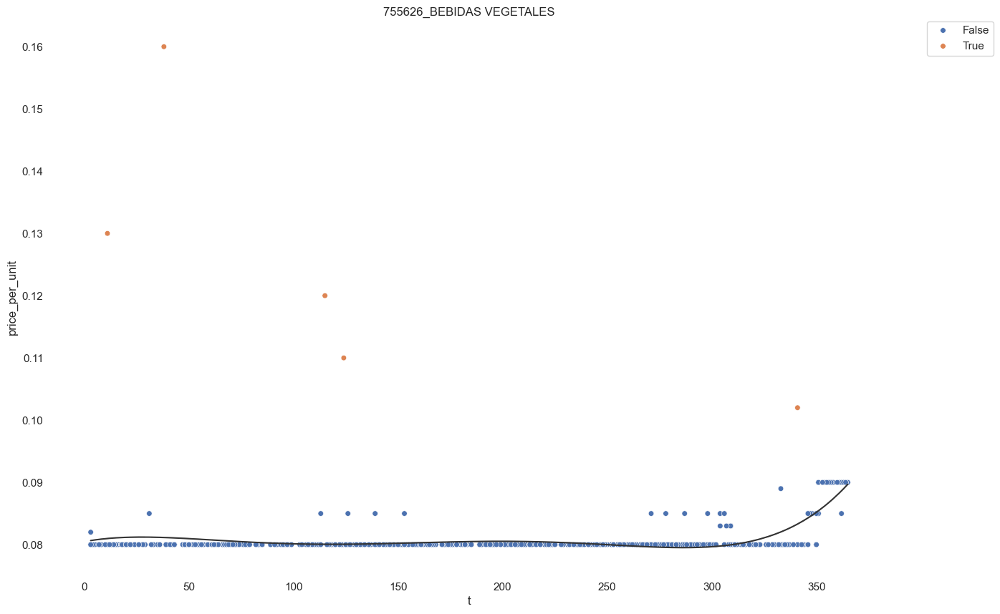

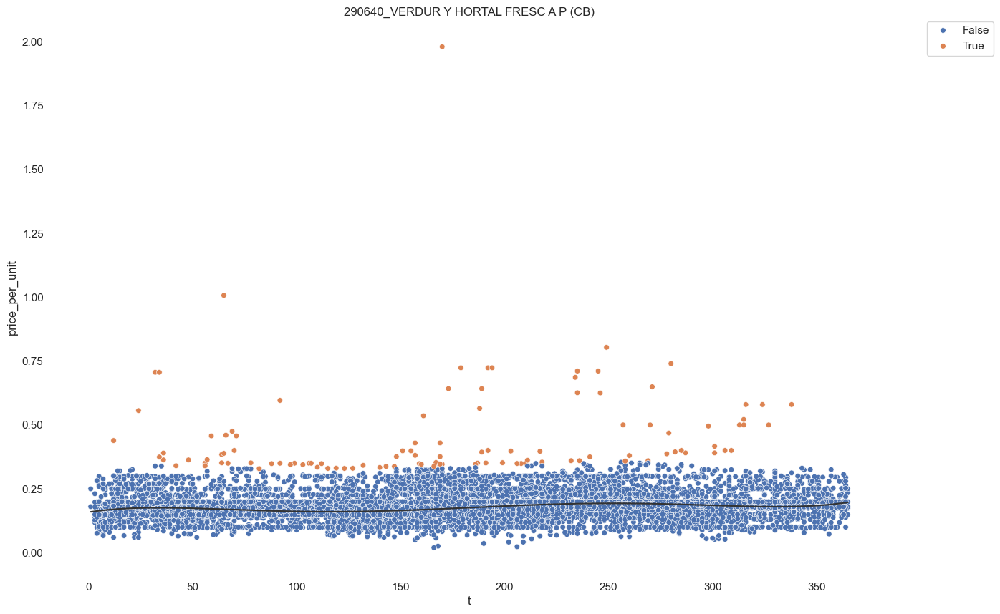

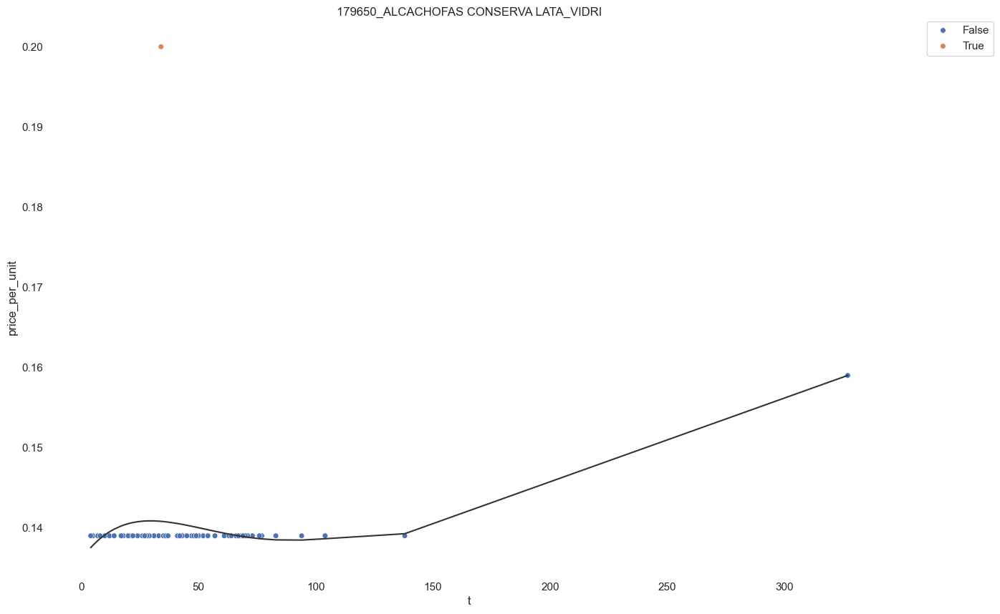

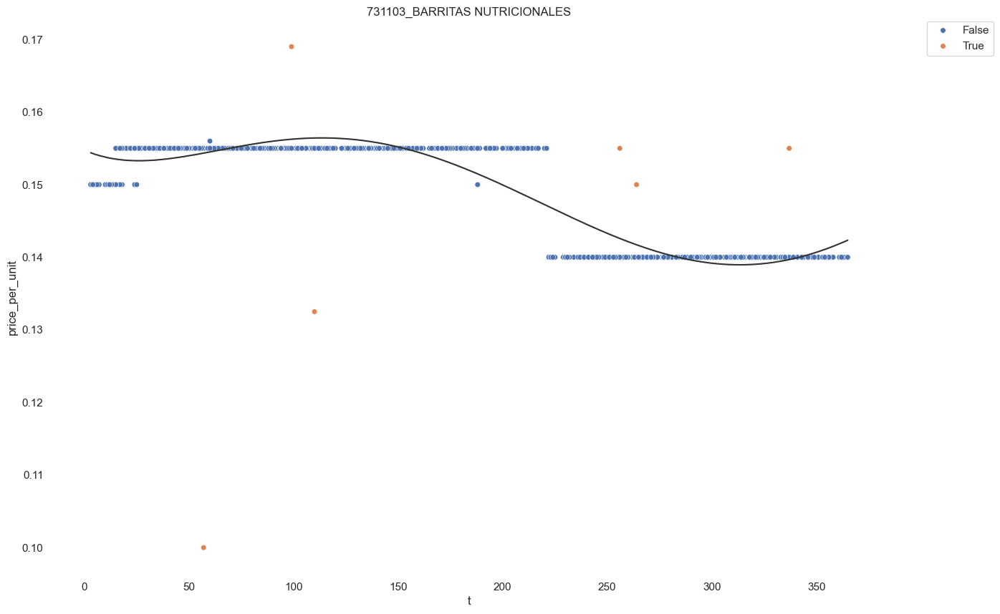

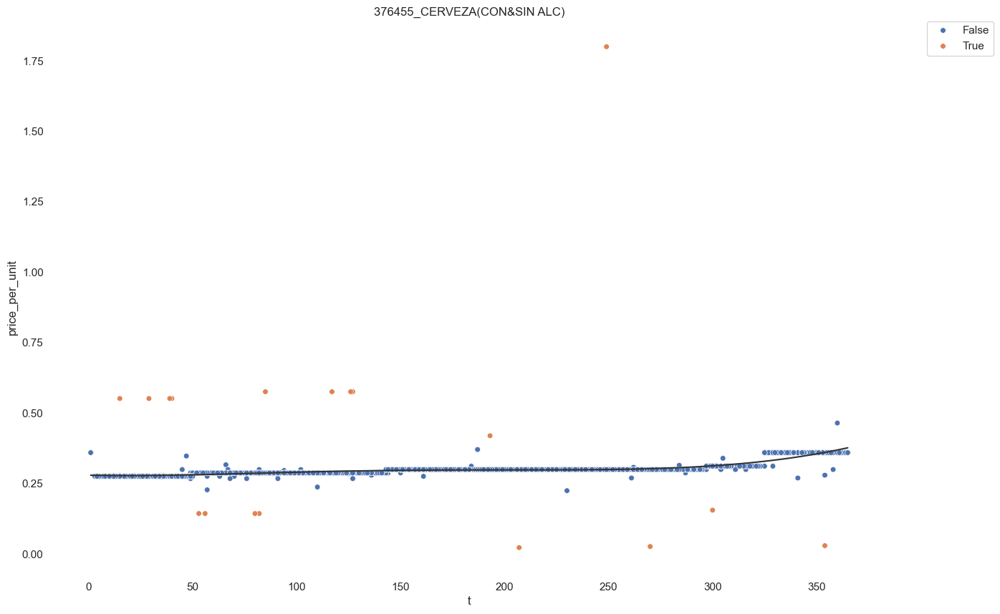

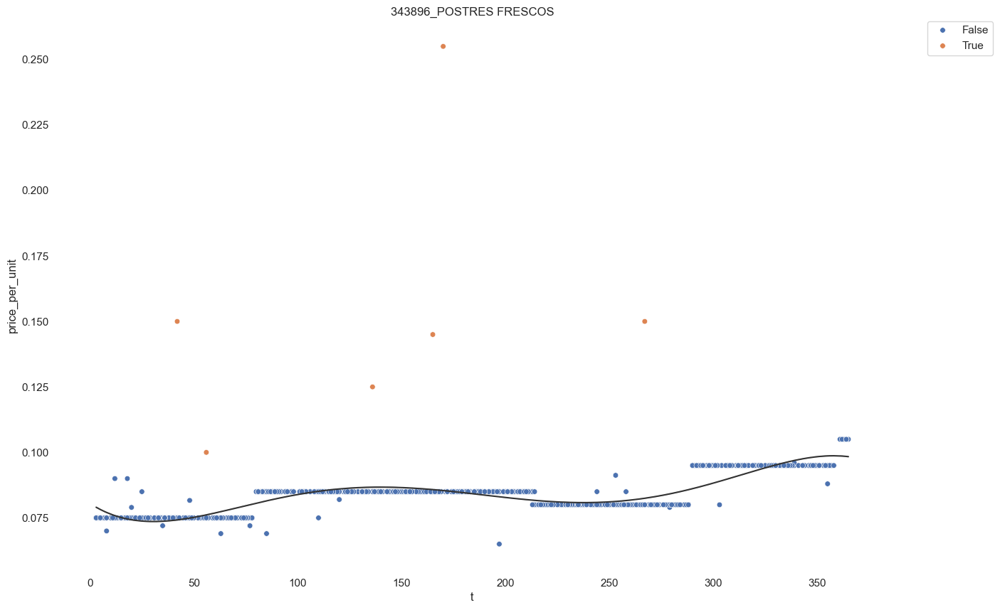

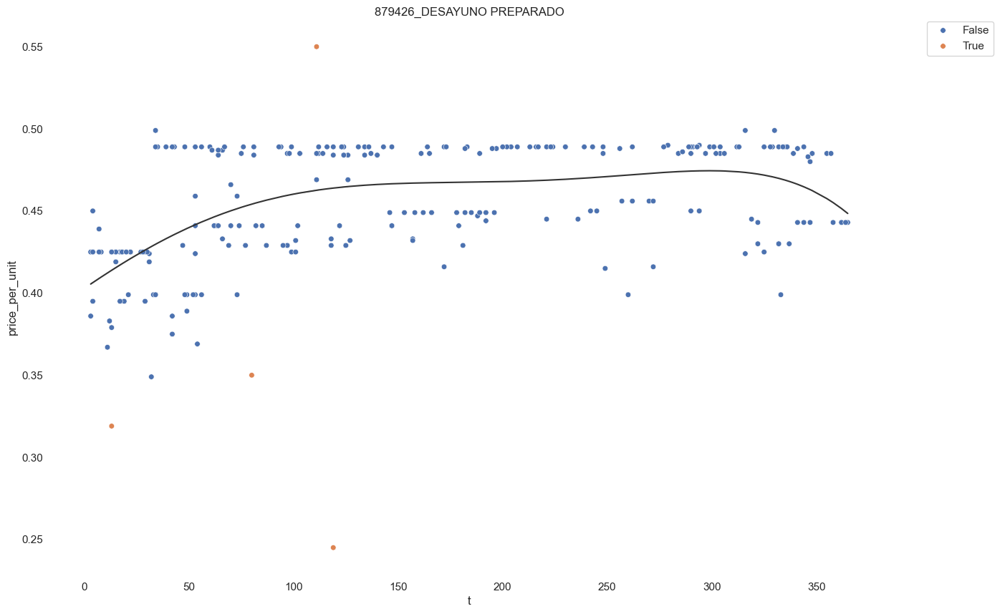

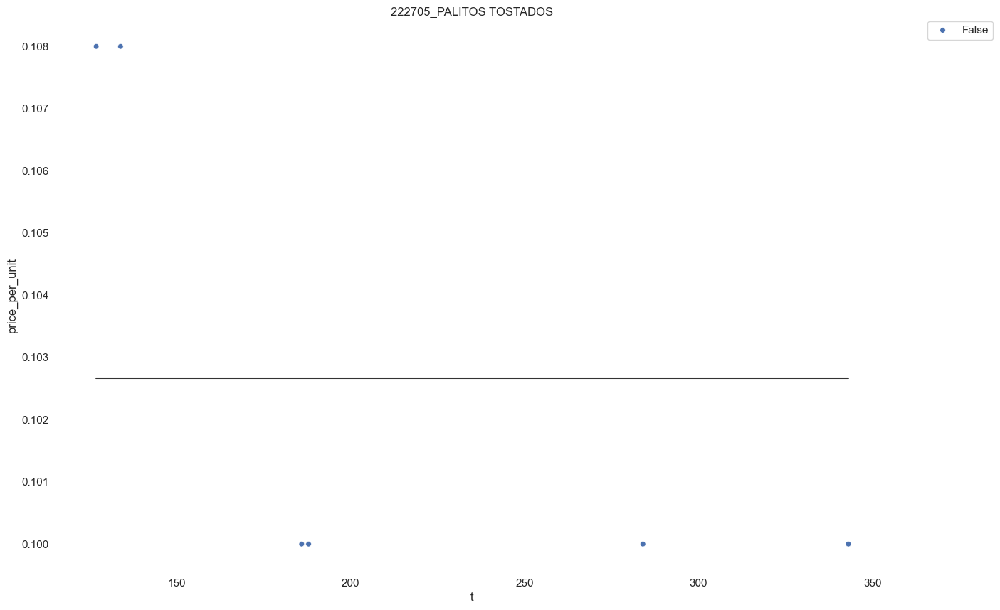

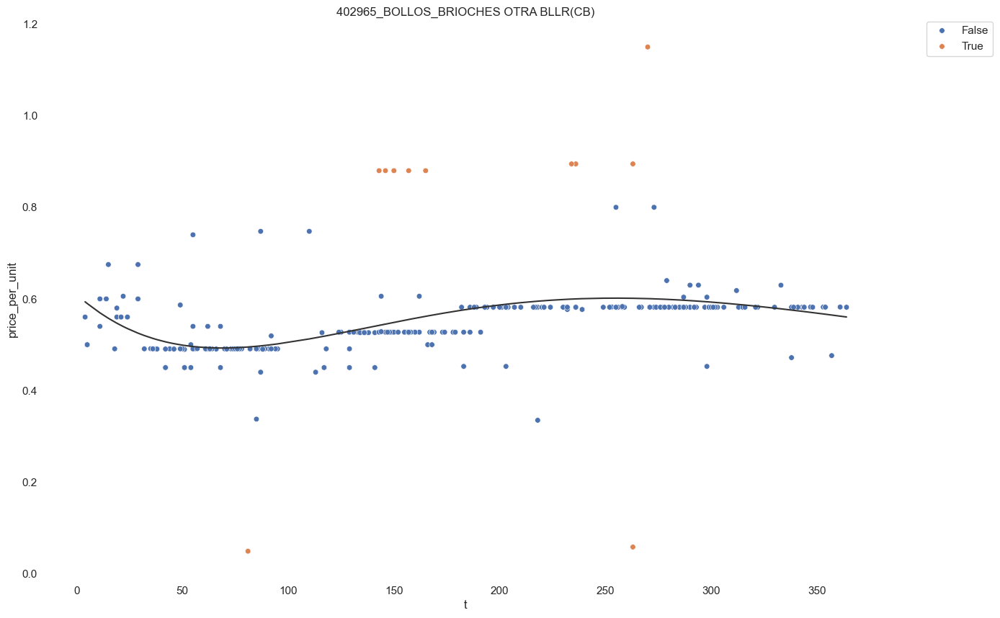

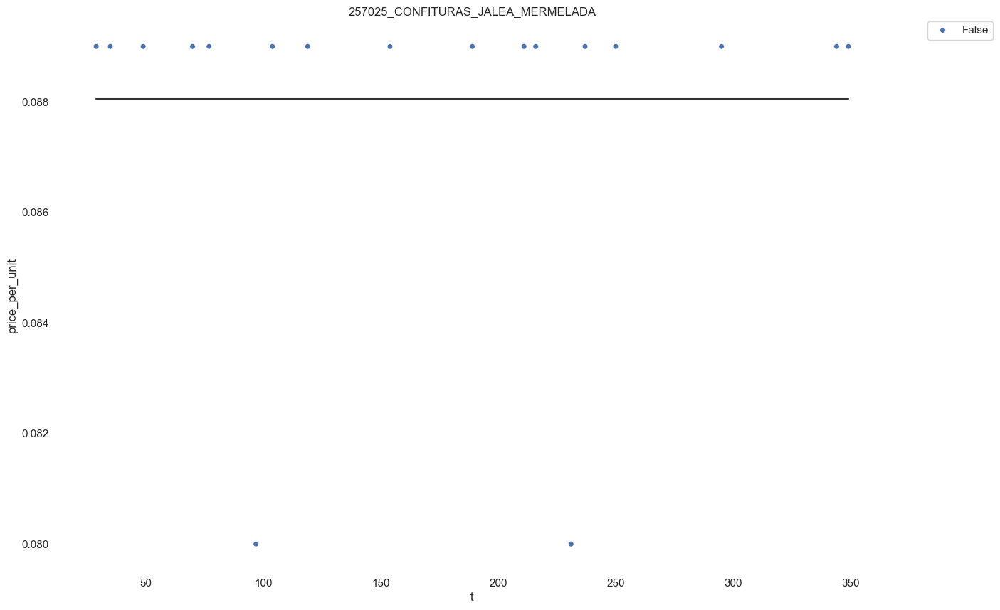

In [30]:
def show_price_data(df,codProd):
    data=df.loc[df['CodProducto']==codProd]
    dataL=data.iloc[0]
    name = (str(dataL['CodProducto'])+"_"+str(dataL['VF'])).replace('.',"_").replace("/","_")
    print(name)    
    fig, ax = plt.subplots()
    sns.scatterplot(data=data, x="t", y="price_per_unit", hue="outlier", s=marker_size,ax=ax)
    sns.lineplot(data=data, x="t", y="predicted",color=".2",ax=ax)
    ax.set_title(name)
    
    
    #ax.set_xticklabels([datetime.fromtimestamp(ts / 1e9).strftime('%Y-%m-%d') for ts in ax.get_xticks()])
    '''
    for ind, label in enumerate(ax.get_xticklabels()):
        if ind % 2 == 0:  # every 10th label is kept
            label.set_visible(True)
        else:
            label.set_visible(False)
    '''
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.savefig(figure_dir+name+".png")
    #plt.show()

for cp in odf1['CodProducto'].sample(n=10):
    show_price_data(odf1,cp)

In [31]:
odf1.head()

,idCompra,CodPanelista,CodProducto,CodigoBarras,FechaCesta,PrecioCompra,Cantidad,Precio,CodLugarCompra,Lugar_Compra,...,Provincia,Region,promo_folleto,promo_envase,promo,t,price_per_unit,predicted,z,outlier
0,191945938,364917,791031,8480000105424,2022-12-12,1650,12000,1716,79,Mercadona,...,Madrid,MDD AM,NaN,NaN,False,346,0.143000,0.143166,0.160957,False
1,190744241,30109,675179,8410702020886,2022-11-06,400,2000,400,28,CONDIS,...,Jaen,Andalucia,NaN,NaN,False,310,0.200000,0.266667,1.414214,False
2,182162741,30109,204305,SSA1410202,2022-01-20,2088,445,56,33,DIA,...,Jaen,Andalucia,NaN,NaN,False,20,0.125843,0.113056,0.077869,False
3,189827808,30109,204305,SSA1410202,2022-10-09,1071,625,87,33,DIA,...,Jaen,Andalucia,NaN,NaN,False,282,0.139200,0.136567,0.426895,False
4,182203652,30109,204305,SSA1410202,2022-01-12,969,935,83,33,DIA,...,Jaen,Andalucia,NaN,NaN,False,12,0.088770,0.109690,0.201687,False


In [ ]:
#save_dta(result_dir+f'Datos_{year}_C.dta',odf1,True)


# separating the tables:
for name, attributes in tables.items():
    if name == 'purchases':
        if not 'outlier' in attributes:
            attributes += ['outlier']
    save_dta(result_dir+f'{year}_{name}.dta',odf1[attributes].drop_duplicates())
    #odf1[attributes].drop_duplicates().to_csv(result_dir + f'{year}_{name}.csv')    

/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/196046809.py:4: InvalidColumnName: 
Not all pandas column names were valid Stata variable names.
The following replacements have been made:

    Presencia_Niños   ->   Presencia_Ni_os

If this is not what you expect, please make sure you have Stata-compliant
column names in your DataFrame (strings only, max 32 characters, only
alphanumerics and underscores, no Stata reserved words)

  df.to_stata(name)
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/196046809.py:4: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column NF contains
non-string labels which will be converted to strings.  Please check that the
Stata data file created has not lost information due to duplicate labels.

  df.to_stata(name)
/var/folders/sp/j3p6g91d6dj8wzlq0vy4dw8r0000gn/T/ipykernel_96617/196046809.py:4: ValueLabelTypeMismatch: 
Stata value labels (pandas categories) must be strings. Column Numero_

In [34]:
#tables['customers']=tables['customers'][:1]

for name, attributes in tables.items():
    print(name, attributes)

customers ['CodPanelista', 'CC_AA', 'Edad_Ama', 'NF', 'Numero_Gatos', 'Numero_Perros', 'Presencia_Niños', 'CodIMC', 'IMC', 'Ponderacion', 'Ciclo_Vida', 'Clase_EGM', 'Clase_Social', 'Habitat_Metropolitano', 'Habitat_Municipal_Std', 'Inmigrante', 'Provincia', 'Region']
purchases ['idCompra', 'CodPanelista', 'CodigoBarras', 'CodProducto', 'FechaCesta', 'PrecioCompra', 'Cantidad', 'Precio', 'CodLugarCompra', 'CodIndividuo', 'TipoMaquina', 'Promo_Folleto', 'Promo_Envase', 'Promo_TPR', 'promo']
products ['CodProducto', 'CodigoBarras', 'CodVF', 'VF', 'SA7_BPL', 'SA4_Fabricante', 'SA3_Marca', 'SA2_Submarca', 'X102_Aditivos', 'X108_Usuario', 'X109_Estado', 'X112_Niv_Calorias', 'X124_Estilo', 'X127_Tipo_Bañado_Choc', 'X129_Tipo_Pasteleria', 'X135_Uso', 'X143_Tipo_Corte', 'X163_Info_Cafeina', 'X167_Grado_Curacion', 'X169_Cont_Materia_Grasa', 'X174_Despiece.Corte', 'X182_Tipo_Queso', 'X188_Tipo_Pan', 'X189_Tipo_Viena', 'X206_Tipo_Pescado', 'X230_Niv_Concentracion', 'X314_Tipo_Cena.Entrante', 'X315

In [40]:
name= 'products'
p1=pd.read_stata(result_dir+f'{year}_{name}.dta')

In [41]:
name= 'products'
p2=pd.read_csv(result_dir+f'{year}_{name}.csv')

/Users/peterkiss/anaconda3/envs/kantar_data_env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (10) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [42]:
p1.shape

(139550, 56)

In [43]:
p2.shape

(139550, 56)